# Import

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow.compat.v1 as tf
tf.disable_eager_execution()
tf.logging.set_verbosity(tf.logging.ERROR)

from sklearn.compose import make_column_transformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.preprocessing import OneHotEncoder

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression

from sklearn.isotonic import IsotonicRegression as IR

from imblearn.over_sampling import RandomOverSampler
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, \
                            average_precision_score, accuracy_score, \
                            balanced_accuracy_score, roc_auc_score, \
                            matthews_corrcoef

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay, PrecisionRecallDisplay, roc_curve, auc

In [37]:
plt.rcParams['font.size'] = 22

In [21]:
# %cd ../../BRFSS Datasets - Cleaned/One hot encoded (Step 3)/
#%cd /raid/home/tanmoysarkar/Trustworthiness/Diabetes - Paper/Gender Disparity in Diabetes/ML4H 23 (Submission files)/Code


/raid/home/tanmoysarkar/Trustworthiness/Diabetes - Paper/Gender Disparity in Diabetes/ML4H 23 (Submission files)/Code


# Data and function Setup

## Load data

In [3]:
brfss_2021_mapped_cat = pd.read_csv('../../BRFSS Datasets - Cleaned/Mapped categories (Step 2)/BRFSS 2021.csv')

brfss_2021_mapped_cat['Race'] = brfss_2021_mapped_cat['Race'].replace({1: 'White', 2: 'Black', 3: 'American Indian',
                                                               4: 'Asian', 5: 'Native Hawaiian', 6: 'Other race',
                                                               7: 'Multiracial', 8: 'Hispanic'})

brfss_2019_mapped_cat = pd.read_csv('../../BRFSS Datasets - Cleaned/Mapped categories (Step 2)/BRFSS 2019.csv')

brfss_2019_mapped_cat['Race'] = brfss_2019_mapped_cat['Race'].replace({1: 'White', 2: 'Black', 3: 'American Indian',
                                                               4: 'Asian', 5: 'Native Hawaiian', 6: 'Other race',
                                                               7: 'Multiracial', 8: 'Hispanic'})

brfss_2017_mapped_cat = pd.read_csv('../../BRFSS Datasets - Cleaned/Mapped categories (Step 2)/BRFSS 2017.csv')

brfss_2017_mapped_cat['Race'] = brfss_2017_mapped_cat['Race'].replace({1: 'White', 2: 'Black', 3: 'American Indian',
                                                               4: 'Asian', 5: 'Native Hawaiian', 6: 'Other race',
                                                               7: 'Multiracial', 8: 'Hispanic'})

brfss_2015_mapped_cat = pd.read_csv('../../BRFSS Datasets - Cleaned/Mapped categories (Step 2)/BRFSS 2015.csv')

brfss_2015_mapped_cat['Race'] = brfss_2015_mapped_cat['Race'].replace({1: 'White', 2: 'Black', 3: 'American Indian',
                                                               4: 'Asian', 5: 'Native Hawaiian', 6: 'Other race',
                                                               7: 'Multiracial', 8: 'Hispanic'})

print(brfss_2021_mapped_cat.shape, brfss_2019_mapped_cat.shape, brfss_2017_mapped_cat.shape, brfss_2015_mapped_cat.shape
)

brfss_2021_one_hot = pd.read_csv('../../BRFSS Datasets - Cleaned/One hot encoded (Step 3)/BRFSS 2021.csv')
brfss_2019_one_hot = pd.read_csv('../../BRFSS Datasets - Cleaned/One hot encoded (Step 3)/BRFSS 2019.csv')
brfss_2017_one_hot = pd.read_csv('../../BRFSS Datasets - Cleaned/One hot encoded (Step 3)/BRFSS 2017.csv')
brfss_2015_one_hot = pd.read_csv('../../BRFSS Datasets - Cleaned/One hot encoded (Step 3)/BRFSS 2015.csv')

print(brfss_2021_one_hot.shape, brfss_2019_one_hot.shape, brfss_2017_one_hot.shape, brfss_2015_one_hot.shape)

brfss_2021_one_hot['Race'] = brfss_2021_mapped_cat['Race'] # this is added to test performance over race
brfss_2019_one_hot['Race'] = brfss_2019_mapped_cat['Race'] # this is added to test performance over race
brfss_2017_one_hot['Race'] = brfss_2017_mapped_cat['Race'] # this is added to test performance over race
brfss_2015_one_hot['Race'] = brfss_2015_mapped_cat['Race'] # this is added to test performance over race

print(brfss_2021_one_hot.shape, brfss_2019_one_hot.shape, brfss_2017_one_hot.shape, brfss_2015_one_hot.shape)

(200136, 30) (210874, 30) (238130, 30) (220390, 30)
(200136, 49) (210874, 49) (238130, 49) (220390, 49)
(200136, 50) (210874, 50) (238130, 50) (220390, 50)


In [4]:
brfss_2021_mapped_cat['Employment status'] = brfss_2021_mapped_cat['Employment status'].replace({1: 'Employed', 2: 'Self-employed',
                                                                                         3: 'No work > 1 y', 4: 'No work < 1 y',
                                                                                         5: 'Homemaker', 6: 'Student', 7: 'Retired',
                                                                                         8: 'Unable to work'})

### Data stats base dataset

In [9]:
brfss_2021_mapped_cat.groupby(['Diabetes','Age', 'Employment status']).size().to_csv('Diabetes-age-emp.csv')

In [14]:
brfss_2021_mapped_cat.groupby(['Diabetes', 'Employment status']).size()

Diabetes  Employment status
0.0       Employed             80427
          Homemaker             5946
          No work < 1 y         2912
          No work > 1 y         3503
          Retired              52388
          Self-employed        16445
          Student                714
          Unable to work        6961
1.0       Employed              8890
          Homemaker              861
          No work < 1 y          452
          No work > 1 y          813
          Retired              14350
          Self-employed         1744
          Student                 60
          Unable to work        3670
dtype: int64

In [12]:
d = brfss_2021_mapped_cat
d[d['Diabetes'] == 1]
d[d['Age'] == 3]
d[d['Employment status'] == 7]

,Blood pressure,Cholesterol,BMI category,Stroke,Heart disease,Consume fruits,Consume vegitables,Alcoholic,Health insurance,Unaffordable healthcare,...,Flu shot,Employment status,Marital status,Kidney disease,Depressive disorder,Own home,Exercise,Difficulty seeing,Difficulty concentrating,Diabetes


In [13]:
brfss_2021_mapped_cat['Marital status'] = brfss_2021_mapped_cat['Marital status'].replace({1: 'Married', 2: 'Divorced', 3: 'Widowed', 4: 'Separated', 5: 'Never married', 6: 'Unmarried couple'})
brfss_2021_mapped_cat.groupby(['Diabetes','Age', 'Marital status']).size().to_csv('Diabetes-age-marital.csv')


In [15]:
brfss_2021_mapped_cat.groupby(['Diabetes', 'Marital status']).size()

Diabetes  Marital status  
0.0       Divorced             23232
          Married             104029
          Never married        17237
          Separated             2839
          Unmarried couple      5447
          Widowed              16512
1.0       Divorced              4949
          Married              16630
          Never married         3189
          Separated              718
          Unmarried couple       724
          Widowed               4630
dtype: int64

In [5]:
brfss_2021_mapped_cat.groupby(['Race', 'Diabetes']).size()

Race             Diabetes
American Indian  0.0           2219
                 1.0            766
Asian            0.0           3633
                 1.0            566
Black            0.0          10551
                 1.0           3257
Hispanic         0.0          11390
                 1.0           2465
Multiracial      0.0           3142
                 1.0            609
Native Hawaiian  0.0            598
                 1.0            174
Other race       0.0           1198
                 1.0            255
White            0.0         136565
                 1.0          22748
dtype: int64

In [17]:
brfss_2021_mapped_cat.groupby(['Age', 'Diabetes']).size()

Age  Diabetes
3    0.0         10864
     1.0           324
4    0.0         13290
     1.0           588
5    0.0         14661
     1.0          1063
6    0.0         14466
     1.0          1611
7    0.0         16836
     1.0          2521
8    0.0         18155
     1.0          3602
9    0.0         20140
     1.0          4532
10   0.0         20422
     1.0          5104
11   0.0         17891
     1.0          5230
12   0.0         11257
     1.0          3483
13   0.0         11314
     1.0          2782
dtype: int64

In [16]:
brfss_2021_mapped_cat.groupby(['Diabetes']).size()

Diabetes
0.0    169296
1.0     30840
dtype: int64

In [16]:
brfss_2021_mapped_cat.groupby(['Diabetes', 'Sex']).size()

Diabetes  Sex
0.0       1      79844
          2      89452
1.0       1      16144
          2      14696
dtype: int64

In [18]:
brfss_2021_mapped_cat.groupby(['Diabetes', 'Age', 'Race']).size()

Diabetes  Age  Race           
0.0       3    American Indian     156
               Asian               531
               Black               804
               Hispanic           1589
               Multiracial         370
                                  ... 
1.0       13   Hispanic            107
               Multiracial          42
               Native Hawaiian       5
               Other race           35
               White              2275
Length: 176, dtype: int64

In [21]:
print(brfss_2021_mapped_cat.groupby(['Diabetes', 'Age', 'Race']).size())

Diabetes  Age  Race           
0.0       3    American Indian     156
               Asian               531
               Black               804
               Hispanic           1589
               Multiracial         370
                                  ... 
1.0       13   Hispanic            107
               Multiracial          42
               Native Hawaiian       5
               Other race           35
               White              2275
Length: 176, dtype: int64


In [36]:
brfss_2021_mapped_cat.groupby(['Diabetes']).size()

Diabetes
0.0    169296
1.0     30840
dtype: int64

In [37]:
brfss_2019_mapped_cat.groupby(['Diabetes']).size()

Diabetes
0.0    178103
1.0     32771
dtype: int64

In [39]:
brfss_2017_mapped_cat.groupby(['Diabetes']).size()

Diabetes
0.0    202117
1.0     36013
dtype: int64

In [40]:
brfss_2015_mapped_cat.groupby(['Diabetes']).size()

Diabetes
0.0    187701
1.0     32689
dtype: int64

## Performance Metrix

This code segment is used to calculate the performance metrics on the train, validation, and test set

In [4]:
def performace_metrix(y_true, y_pred, y_pred_proba, group = "whole"):
  # Assuming you have true labels y_true and predicted labels y_pred
  # For class 0 and class 1

  #y_true, y_pred = y_test_2021, pred_test_2021_lr

  # Calculate precision, recall, and f1-score for each class
  precision_0 = precision_score(y_true, y_pred, pos_label=0)
  precision_1 = precision_score(y_true, y_pred, pos_label=1)

  recall_0 = recall_score(y_true, y_pred, pos_label=0)
  recall_1 = recall_score(y_true, y_pred, pos_label=1)

  f1_0 = f1_score(y_true, y_pred, pos_label=0)
  f1_1 = f1_score(y_true, y_pred, pos_label=1)

  # Calculate Area Under the Precision-Recall Curve for each class
  ap_0 = average_precision_score(y_true, y_pred_proba, pos_label=0)
  ap_1 = average_precision_score(y_true, y_pred_proba, pos_label=1)

  # Calculate overall accuracy
  accuracy = accuracy_score(y_true, y_pred)

  # Calculate balanced accuracy
  balanced_accuracy = balanced_accuracy_score(y_true, y_pred)

  # Calculate Area Under the ROC Curve
  roc_auc = roc_auc_score(y_true, y_pred_proba)

  # Calculate Matthews Correlation Coefficient (MCC)
  mcc = matthews_corrcoef(y_true, y_pred)

  # Print the calculated metrics
  print("Class 1 Recall:", recall_1)
  print("Class 1 Precision:", precision_1)
  print("Class 1 Area Under Precision-Recall Curve:", ap_1)
  print("Class 1 F1-Score:", f1_1)


  print("Class 0 Recall:", recall_0)
  print("Class 0 Precision:", precision_0)
  print("Class 0 Area Under Precision-Recall Curve:", ap_0)
  print("Class 0 F1-Score:", f1_0)

  print("Overall Accuracy:", accuracy)
  print("Balanced Accuracy:", balanced_accuracy)
  print("Area Under ROC Curve:", roc_auc)
  print("Matthews Correlation Coefficient:", mcc)


  # Print the calculated metrics
  print(recall_1)
  print(precision_1)
  print(ap_1)
  print(f1_1)

  print(recall_0)
  print(precision_0)
  print(ap_0)
  print(f1_0)

  print(accuracy)
  print(balanced_accuracy)
  print(roc_auc)
  print(mcc)


  performance = [group, recall_1, precision_1, ap_1, f1_1, recall_0, precision_0, ap_0, f1_0, accuracy, balanced_accuracy, roc_auc, mcc]
  return performance

def inset_performance_dict(performance_dict, performance):
    c = 0
    for k in performance_dict.keys():
        performance_dict[k].append(performance[c])
        c+=1
    return performance_dict

## Model Calibration

Model calibration adjust the probability score

In [5]:
from sklearn.isotonic import IsotonicRegression as IR

def isotonic(preds, labels, test_preds):
    preds = np.array(preds)
    labels = np.array(labels)
    test_preds = np.array(test_preds)

    ir = IR(out_of_bounds='clip')
    ir.fit( preds, labels )

    p_calibrated_v = ir.transform( preds )
    p_calibrated_t = ir.transform( test_preds )   # or ir.fit( p_test ), that's the same thing

    return p_calibrated_v, p_calibrated_t

#### Test Model Calibration 

This segment is just to test the calibration function

In [6]:
random_state = 1
df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)

X_validation = X_validation_2021
y_validation_true = y_validation_2021

X_test = X_test_2021
y_test_ture = y_test_2021

lr = LogisticRegression(solver='liblinear')
lr.fit(X_train_2021, y_train_2021)

pred_prob_test_lr = lr.predict_proba(X_test_2021)[:, 1]
pred_prob_validation_lr = lr.predict_proba(X_validation_2021)[:, 1]

p_calibrated_val, p_calibrated_test = isotonic(pred_prob_validation_lr, y_validation_2021, pred_prob_test_lr)

(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)


In [7]:
pred_prob_validation_lr, p_calibrated_val, y_validation_true

(array([0.04300239, 0.05202501, 0.03779646, ..., 0.09708394, 0.19229497,
        0.25712146]),
 array([0.03246168, 0.04362416, 0.03239741, ..., 0.10196078, 0.22060606,
        0.27104247]),
 array([0., 0., 0., ..., 1., 1., 1.]))

In [10]:
pred_prob_test_lr, p_calibrated_test, y_test_ture

(array([0.11247212, 0.19267521, 0.07826103, ..., 0.02381427, 0.22078907,
        0.09055104]),
 array([0.10945274, 0.22060606, 0.08484848, ..., 0.01604814, 0.23988154,
        0.08484848]),
 array([0., 0., 0., ..., 0., 0., 0.]))

## Threshold Selection

In [12]:
import heapq
from sklearn.metrics import f1_score
from sklearn.metrics import balanced_accuracy_score

def Select_Threshold(df):
    full_threshold_list = []
    for threshold in np.arange(0,1.05,0.05):
        #df.drop(columns = ['y_pred'])
        df['y_pred'] = df['calibrated_prediction_prob'].apply(lambda x: 1 if x >= threshold else 0)
        
        y_pred = df["y_pred"].values
        y_true = df["y_true"].values
        
        f1_C1 = f1_score(y_true, y_pred)
        balanced_accuracy = balanced_accuracy_score(y_true, y_pred)

        
        full_threshold_list.append([threshold, f1_C1, balanced_accuracy])
        
    df_varying_threshold = pd.DataFrame(full_threshold_list, columns = ['threshold', 'f1_score', 'balanced_accuracy'])
    
    # select three highest F1 score and the the highest balanced accuracy
    f1_scores = df_varying_threshold["f1_score"].values
    thresholds = df_varying_threshold["threshold"].values
    bal_acc_values = list(df_varying_threshold["balanced_accuracy"].values)
    
    #print(heapq.nlargest(3, f1_scores))
    list_index = heapq.nlargest(3, range(len(f1_scores)), key=f1_scores.__getitem__)
    opt_threshold = thresholds[bal_acc_values.index(max(bal_acc_values[list_index[0]], bal_acc_values[list_index[1]], bal_acc_values[list_index[2]]))]
    
    
    return opt_threshold, df_varying_threshold

def pred_label_using_threshold(y_pred_p, th = 0.195):
    y_pred_label = []
    for y in y_pred_p:
        if y <= 0.195:
            y_pred_label.append(0)
        else:
            y_pred_label.append(1)
    return np.array(y_pred_label)

#### BRFSS 2021 (random state = 1, .., 10) - 10 Trials

In [76]:
random_state = 10
df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)

lr = LogisticRegression(solver='liblinear')
lr.fit(X_train_2021, y_train_2021)

pred_prob_test_lr = lr.predict_proba(X_test_2021)[:, 1]
pred_prob_validation_lr = lr.predict_proba(X_validation_2021)[:, 1]

p_calibrated_val, p_calibrated_test = isotonic(pred_prob_validation_lr, y_validation_2021, pred_prob_test_lr)

X_validation_2021['y_true'] = y_validation_2021
X_validation_2021['calibrated_prediction_prob'] = p_calibrated_val

th, th_df = Select_Threshold(X_validation_2021)
#th_df.to_csv("Threshold-selection/threshold_moving_trial_"+str(random_state)+".csv", index = False)
print(th)

(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)
0.2


## Selected threshold = 0.195 (selected from 10 trials)

In [40]:
# trial 1: th = 0.2
# trial 2: th = 0.15
# trial 3: th = 0.2
# trial 4: th = 0.2
# trial 5: th = 0.2
# trial 6: th = 0.2
# trial 7: th = 0.2
# trial 8: th = 0.2
# trial 9: th = 0.2
# trial 10: th = 0.2

In [77]:
sum_ = 0
for i in range(9):
    sum_ += 0.2
sum_ += 0.15

sum_/10

0.19499999999999998

#### BRFSS 2015 (random state = 1, .., 10) - 10 Trials

In [13]:


sum_ = 0

for i in range(1, 11):
    
    random_state = i
    
    df_train_2015, df_test_2015 = train_test_split(brfss_2015_one_hot, test_size=0.4, random_state=random_state)
    df_test_2015, df_validation_2015 = train_test_split(df_test_2015, test_size=0.5, random_state=random_state)
    print(brfss_2015_one_hot.shape, df_train_2015.shape, df_test_2015.shape, df_validation_2015.shape)

    X_train_2015 = df_train_2015.drop(['Diabetes', 'Race'],axis=1)
    y_train_2015 = df_train_2015['Diabetes']

    X_test_2015 = df_test_2015.drop(['Diabetes', 'Race'],axis=1)
    y_test_2015 = df_test_2015['Diabetes']
    y_test_2015 = y_test_2015.to_numpy()

    X_validation_2015 = df_validation_2015.drop(['Diabetes', 'Race'],axis=1)
    y_validation_2015 = df_validation_2015['Diabetes']
    y_validation_2015 = y_validation_2015.to_numpy()

    print(X_train_2015.shape, X_test_2015.shape, X_validation_2015.shape)

    lr = LogisticRegression(solver='liblinear')
    lr.fit(X_train_2015, y_train_2015)

    pred_prob_test_lr = lr.predict_proba(X_test_2015)[:, 1]
    pred_prob_validation_lr = lr.predict_proba(X_validation_2015)[:, 1]

    p_calibrated_val, p_calibrated_test = isotonic(pred_prob_validation_lr, y_validation_2015, pred_prob_test_lr)

    X_validation_2015['y_true'] = y_validation_2015
    X_validation_2015['calibrated_prediction_prob'] = p_calibrated_val

    th, th_df = Select_Threshold(X_validation_2015)
    th_df.to_csv("Threshold-selection/2015/threshold_moving_trial_"+str(random_state)+".csv", index = False)

    print(random_state, th)
    sum_ += th

print(sum_/10)

(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)
1 0.2
(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)
2 0.2
(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)
3 0.15000000000000002
(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)
4 0.2
(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)
5 0.15000000000000002
(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)
6 0.2
(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)
7 0.2
(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)
8 0.2
(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)
9 0.15000000000000002
(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)
10 0.15000000000000002
0.18


### Selected threshold for BRFSS 2015: 0.18

## Create training, validation, and test sets for the entire exp

## 2021

In [7]:
random_state = 1
df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)

(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)


## 2015

In [15]:
random_state = 1
df_train_2015, df_test_2015 = train_test_split(brfss_2015_one_hot, test_size=0.4, random_state=random_state)
df_test_2015, df_validation_2015 = train_test_split(df_test_2015, test_size=0.5, random_state=random_state)
print(brfss_2015_one_hot.shape, df_train_2015.shape, df_test_2015.shape, df_validation_2015.shape)

X_train_2015 = df_train_2015.drop(['Diabetes', 'Race'],axis=1)
y_train_2015 = df_train_2015['Diabetes']

X_test_2015 = df_test_2015.drop(['Diabetes', 'Race'],axis=1)
y_test_2015 = df_test_2015['Diabetes']
y_test_2015 = y_test_2015.to_numpy()

X_validation_2015 = df_validation_2015.drop(['Diabetes', 'Race'],axis=1)
y_validation_2015 = df_validation_2015['Diabetes']
y_validation_2015 = y_validation_2015.to_numpy()

print(X_train_2015.shape, X_test_2015.shape, X_validation_2015.shape)

(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)


In [10]:
df_train_2021.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       3       6452
          4       8018
          5       8732
          6       8836
          7      10024
          8      10936
          9      11985
          10     12311
          11     10731
          12      6714
          13      6842
1.0       3        194
          4        355
          5        648
          6        970
          7       1497
          8       2189
          9       2676
          10      3125
          11      3097
          12      2088
          13      1661
dtype: int64

In [17]:
df_train_2021.groupby(['Diabetes', 'Age', 'Sex']).size()

Diabetes  Age  Sex
0.0       3    1      3345
               2      3107
          4    1      4051
               2      3967
          5    1      4188
               2      4544
          6    1      4169
               2      4667
          7    1      4804
               2      5220
          8    1      5071
               2      5865
          9    1      5619
               2      6366
          10   1      5912
               2      6399
          11   1      4833
               2      5898
          12   1      2990
               2      3724
          13   1      2869
               2      3973
1.0       3    1        99
               2        95
          4    1       162
               2       193
          5    1       310
               2       338
          6    1       485
               2       485
          7    1       791
               2       706
          8    1      1155
               2      1034
          9    1      1416
               2      1260
         

In [11]:
df_test_2021.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       3      2146
          4      2703
          5      2943
          6      2813
          7      3393
          8      3605
          9      4039
          10     4060
          11     3596
          12     2283
          13     2245
1.0       3        57
          4       127
          5       201
          6       316
          7       538
          8       735
          9       936
          10     1011
          11     1007
          12      722
          13      551
dtype: int64

In [12]:
df_validation_2021.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       3      2266
          4      2569
          5      2986
          6      2817
          7      3419
          8      3614
          9      4116
          10     4051
          11     3564
          12     2260
          13     2227
1.0       3        73
          4       106
          5       214
          6       325
          7       486
          8       678
          9       920
          10      968
          11     1126
          12      673
          13      570
dtype: int64


## Create DP training set

In [16]:
#Separate the 0(No Diabetes) and 1(Diabetes)
#Get the 1s

def dp(data = df_train_2021, col = "Race", group = "Asian", n = 1):
    
    if n == 0: 
        print("Same training set: ", data.shape)
        return data
    
    print("Original training dataset: ", data.shape)

    data_1 = data[data['Diabetes'] == 1]
    print("Class 1: ", data_1.shape)

    data_0 = data[data['Diabetes'] == 0]
    print("Class 0: ", data_0.shape)

    data_1_group = data[(data['Diabetes'] == 1) & (data[col] == group)]
    print(group, " group class 1: ", data_1_group.shape)
    
    dp_set = []
    for i in range(n):
        dp_set.append(data_1_group)
    data_1_group_n = pd.concat(dp_set)
    
    print(group, " group class 1: ", data_1_group_n.shape, " # of DP units", n)
    
    data_group_DP = pd.concat([data_1, data_0, data_1_group_n])
    data_group_DP = data_group_DP.sample(frac=1).reset_index(drop=True)
    
    print("New training set: ", data_group_DP.shape)
    
    return data_group_DP


#### Test Dp function

In [17]:
df_train_2021_DP = dp(data = df_train_2021, col = "Race", group = "Asian", n = 1)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape,X_train_2021.shape, X_test_2021.shape)

Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
Asian  group class 1:  (327, 50)
Asian  group class 1:  (327, 50)  # of DP units 1
New training set:  (120408, 50)
(120408, 48) (120081, 48) (40027, 48)


In [18]:
df_train_2015_DP = dp(data = df_train_2015, col = "Race", group = "Asian", n = 1)

X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2015_DP = df_train_2015_DP['Diabetes']
print(X_train_2015_DP.shape,X_train_2015.shape, X_test_2015.shape)

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
Asian  group class 1:  (302, 50)
Asian  group class 1:  (302, 50)  # of DP units 1
New training set:  (132536, 50)
(132536, 48) (132234, 48) (44078, 48)


##### Data stats

In [66]:
print(df_train_2021.groupby(['Diabetes']).size())
print("============================ ")
print(df_train_2021.groupby(['Diabetes', 'Sex']).size())
print("============================ ")
print(df_train_2021.groupby(['Diabetes', 'Race']).size())
print("============================ ")
print(df_train_2021.groupby(['Diabetes', 'Age']).size())
print("========================================================")

print(df_train_2021_DP.groupby(['Diabetes']).size())
print("============================ ")
print(df_train_2021_DP.groupby(['Diabetes', 'Sex']).size())
print("============================ ")
print(df_train_2021_DP.groupby(['Diabetes', 'Race']).size())
print("============================ ")
print(df_train_2021_DP.groupby(['Diabetes', 'Age']).size())

Diabetes
0.0    135384
1.0     24724
dtype: int64
Diabetes  Sex
0.0       1      63913
          2      71471
1.0       1      12931
          2      11793
dtype: int64
Diabetes  Race           
0.0       American Indian      1797
          Asian                2874
          Black                8408
          Hispanic             9092
          Multiracial          2489
          Native Hawaiian       487
          Other race            942
          White              109295
1.0       American Indian       621
          Asian                 455
          Black                2626
          Hispanic             1912
          Multiracial           489
          Native Hawaiian       132
          Other race            220
          White               18269
dtype: int64
Diabetes  Age
0.0       3       8589
          4      10687
          5      11640
          6      11648
          7      13426
          8      14523
          9      16055
          10     16387
          11     1

In [19]:
print(df_train_2015.groupby(['Diabetes']).size())
print("============================ ")
print(df_train_2015.groupby(['Diabetes', 'Sex']).size())
print("============================ ")
print(df_train_2015.groupby(['Diabetes', 'Race']).size())
print("============================ ")
print(df_train_2015.groupby(['Diabetes', 'Age']).size())
print("========================================================")

print(df_train_2015_DP.groupby(['Diabetes']).size())
print("============================ ")
print(df_train_2015_DP.groupby(['Diabetes', 'Sex']).size())
print("============================ ")
print(df_train_2015_DP.groupby(['Diabetes', 'Race']).size())
print("============================ ")
print(df_train_2015_DP.groupby(['Diabetes', 'Age']).size())

Diabetes
0.0    112713
1.0     19521
dtype: int64
Diabetes  Sex
0.0       1.0    48735
          2.0    63978
1.0       1.0     9425
          2.0    10096
dtype: int64
Diabetes  Race           
0.0       American Indian     1199
          Asian               2035
          Black               6957
          Hispanic            6428
          Multiracial         1712
          Native Hawaiian      279
          Other race           367
          White              93736
1.0       American Indian      392
          Asian                302
          Black               2225
          Hispanic            1589
          Multiracial          417
          Native Hawaiian       53
          Other race            65
          White              14478
dtype: int64
Diabetes  Age 
0.0       3.0      5687
          4.0      7109
          5.0      8261
          6.0      9962
          7.0     12829
          8.0     14657
          9.0     15267
          10.0    14253
          11.0    10161
 

# Train and Test DP model

In [24]:
def train_LR_test_result(X_train= X_train_2021, y_train = y_train_2021, 
                         X_test = X_test_2021, y_test = y_test_2021, 
                         X_validation = X_validation_2021, y_validation = y_validation_2021,
                         df_test = df_test_2021, state = "org", 
                        save_dir = "Performance/Age_30_34-Validation-Set-Performance-LR-Trial-1/",
                        threshold_val = 0.195):
    
    lr = LogisticRegression(solver='liblinear')
    lr.fit(X_train, y_train)

    pred_prob_test_lr = lr.predict_proba(X_test)[:, 1]
    pred_prob_validation_lr = lr.predict_proba(X_validation)[:, 1]
    
    #pred_prob_validation_lr_calibrated, pred_prob_test_lr_calibrated = isotonic(pred_prob_validation_lr, y_validation, pred_prob_test_lr)
    
    # calibration
    ir = IR(out_of_bounds='clip')
    ir.fit(pred_prob_validation_lr, y_validation )
    pred_prob_validation_lr_calibrated = ir.transform( pred_prob_validation_lr )
    pred_prob_test_lr_calibrated = ir.transform( pred_prob_test_lr )
    
    # thresholding
    pred_test_lr = pred_label_using_threshold(pred_prob_test_lr_calibrated, threshold_val)
    
    print("accuracy", accuracy_score(y_test, pred_test_lr))

    from sklearn.metrics import classification_report
    print(classification_report(y_test, pred_test_lr))
    
#     cm = confusion_matrix(y_test, pred_test_lr)
#     disp = ConfusionMatrixDisplay(cm)
#     disp.plot(cmap=plt.cm.Blues)
#     plt.savefig("Confusion Matrix/cm_lr_" + str(year) +"_" + state + "_trial_" + str(trial) + '.png', bbox_inches='tight', dpi=500)

#     cm = confusion_matrix(y_test, pred_test_lr, normalize = "true")
#     disp = ConfusionMatrixDisplay(cm)
#     disp.plot(cmap=plt.cm.Blues)
#     plt.savefig('Confusion Matrix/cm_lr_' + str(year) +"_" + state + "_trial_" + str(trial) + '_norm.png', bbox_inches='tight', dpi=500)

    performance_dict = {
        "Group ": [],
        "Class 1 Recall": [],
        "Class 1 Precision": [],
        "Class 1 AU_PRC": [],
        "Class 1 F1-Score": [],
        "Class 0 Recall": [],
        "Class 0 Precision": [],
        "Class 0 AU_PRC": [],
        "Class 0 F1-Score": [],
        "Overall Accuracy": [],
        "Balanced Accuracy": [],
        "AU_ROC": [],
        "MCC": []
    }

    print("============================ ", "Over all performance" , "============================ ")
    performance = performace_metrix(y_test, pred_test_lr, pred_prob_test_lr_calibrated, "Whole")
    performance_dict = inset_performance_dict(performance_dict, performance)

    test = df_test.copy()

    for i in range(1,3):
      if (i == 1):
        group = "Male"
        print("============================ ", "Male" , "============================ ")
      else:
        group = "Female"
        print("============================ ", "Female" , "============================ ")

      test_group = test[test.Sex == i]

      X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
      y_test_group = test_group['Diabetes']
      y_test_group = y_test_group.to_numpy()

      #pred_test_group = lr.predict(X_test_group)
      pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]
      
      #calibration
      pred_prob_test_group_calibrated = ir.transform( pred_prob_test_group )
    
      # thresholding
      pred_test_group = pred_label_using_threshold(pred_prob_test_group_calibrated, threshold_val)

      performance = performace_metrix(y_test_group, pred_test_group, pred_prob_test_group, group)
      performance_dict = inset_performance_dict(performance_dict, performance)


    race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
                 'Other race', 'Multiracial', 'Hispanic']

    for i in race_list:
      test_group = test[test.Race == i]
      print("============================ ", i , "============================ ")

      X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
      y_test_group = test_group['Diabetes']
      y_test_group = y_test_group.to_numpy()

      #pred_test_group = lr.predict(X_test_group)
      pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]
    
      #calibration
      pred_prob_test_group_calibrated = ir.transform( pred_prob_test_group )
    
      # thresholding
      pred_test_group = pred_label_using_threshold(pred_prob_test_group_calibrated, threshold_val)

      performance = performace_metrix(y_test_group, pred_test_group, pred_prob_test_group, i)
      performance_dict = inset_performance_dict(performance_dict, performance)


    age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
                 7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
                 11: '70-74', 12: '75-79', 13: '80-99'}

    for i in age_group.keys():
      test_group = test[test.Age == i]
      print("============================ ", age_group[i] , "============================ ")

      X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
      y_test_group = test_group['Diabetes']
      y_test_group = y_test_group.to_numpy()

      #pred_test_group = lr.predict(X_test_group)
      pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]
    
      #calibration
      pred_prob_test_group_calibrated = ir.transform( pred_prob_test_group )
    
      # thresholding
      pred_test_group = pred_label_using_threshold(pred_prob_test_group_calibrated, threshold_val)

      performace = performace_metrix(y_test_group, pred_test_group, pred_prob_test_group, age_group[i])
      performance_dict = inset_performance_dict(performance_dict, performace)

    all_performances = pd.DataFrame(performance_dict)
    all_performances.to_csv(save_dir + state +  ".csv", index=False)

    

## Original Training Dataset - Train LR model

### Validation Set Performance

In [ ]:
n = 0
df_train_2021_DP = df_train_2021 

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_validation_2021, y_validation_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-30_34-DP-" + str(n), "1", df_validation_2021)

### Test Set Performance

(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)
(120081, 48) (120081, 48) (40027, 48)
accuracy 0.7629600019986509
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33826
         1.0       0.36      0.70      0.48      6201

    accuracy                           0.76     40027
   macro avg       0.65      0.74      0.66     40027
weighted avg       0.84      0.76      0.79     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.696339300112885
Class 1 Precision: 0.362157175207582
Class 1 Area Under Precision-Recall Curve: 0.43542083848322694
Class 1 F1-Score: 0.47649525491061573
Class 0 Recall: 0.7751729438893159
Class 0 Precision: 0.9329988613720467
Class 0 Area Under Precision-Recall Curve: 0.7204544575109479
Class 0 F1-Score: 0.8467947682867755
Overall Accuracy: 0.7629600019986509
Balanced Accuracy: 0.7357561220011004
Area Under ROC Curve

Class 1 Recall: 0.2982456140350877
Class 1 Precision: 0.1827956989247312
Class 1 Area Under Precision-Recall Curve: 0.1676465529184858
Class 1 F1-Score: 0.22666666666666668
Class 0 Recall: 0.9645852749301025
Class 0 Precision: 0.981042654028436
Class 0 Area Under Precision-Recall Curve: 0.9351771350981594
Class 0 F1-Score: 0.9727443609022556
Overall Accuracy: 0.9473445301861099
Balanced Accuracy: 0.6314154444825951
Area Under ROC Curve: 0.84390379490198
Matthews Correlation Coefficient: 0.2075133247607814
0.2982456140350877
0.1827956989247312
0.1676465529184858
0.22666666666666668
0.9645852749301025
0.981042654028436
0.9351771350981594
0.9727443609022556
0.9473445301861099
0.6314154444825951
0.84390379490198
0.2075133247607814
============================  35-39 ============================ 
Class 1 Recall: 0.44881889763779526
Class 1 Precision: 0.2878787878787879
Class 1 Area Under Precision-Recall Curve: 0.27913797507533405
Class 1 F1-Score: 0.3507692307692307
Class 0 Recall: 0.94783

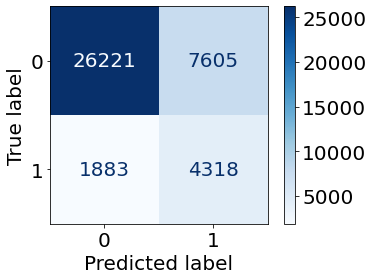

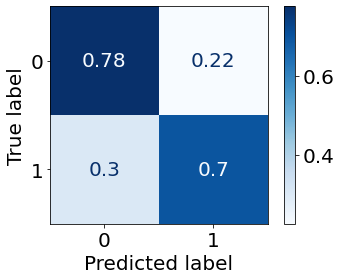

In [65]:
random_state = 1

df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)

n = 0
df_train_2021_DP = df_train_2021 

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     "2021", "Trail-1", "1", df_test_2021,
                    save_dir = "Performance/Test Performance - Original/")

(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)
(120081, 48) (120081, 48) (40027, 48)
accuracy 0.7481450021235666
              precision    recall  f1-score   support

         0.0       0.94      0.75      0.83     33757
         1.0       0.35      0.74      0.48      6270

    accuracy                           0.75     40027
   macro avg       0.65      0.74      0.66     40027
weighted avg       0.85      0.75      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.7382775119617225
Class 1 Precision: 0.35419695462544953
Class 1 Area Under Precision-Recall Curve: 0.4542341707324573
Class 1 F1-Score: 0.4787217539686643
Class 0 Recall: 0.7499777823858755
Class 0 Precision: 0.9391275317160027
Class 0 Area Under Precision-Recall Curve: 0.7149621303071116
Class 0 F1-Score: 0.8339619533887836
Overall Accuracy: 0.7481450021235666
Balanced Accuracy: 0.744127647173799
Area Under ROC Curve

Class 1 Recall: 0.2876712328767123
Class 1 Precision: 0.1891891891891892
Class 1 Area Under Precision-Recall Curve: 0.1857480552065409
Class 1 F1-Score: 0.2282608695652174
Class 0 Recall: 0.9576669802445907
Class 0 Precision: 0.975095785440613
Class 0 Area Under Precision-Recall Curve: 0.9212498176048523
Class 0 F1-Score: 0.9663028001898434
Overall Accuracy: 0.935425193269668
Balanced Accuracy: 0.6226691065606516
Area Under ROC Curve: 0.8213443472209693
Matthews Correlation Coefficient: 0.20076200367189576
0.2876712328767123
0.1891891891891892
0.1857480552065409
0.2282608695652174
0.9576669802445907
0.975095785440613
0.9212498176048523
0.9663028001898434
0.935425193269668
0.6226691065606516
0.8213443472209693
0.20076200367189576
============================  35-39 ============================ 
Class 1 Recall: 0.504
Class 1 Precision: 0.28
Class 1 Area Under Precision-Recall Curve: 0.29286795916232666
Class 1 F1-Score: 0.36000000000000004
Class 0 Recall: 0.9381679389312977
Class 0 Preci

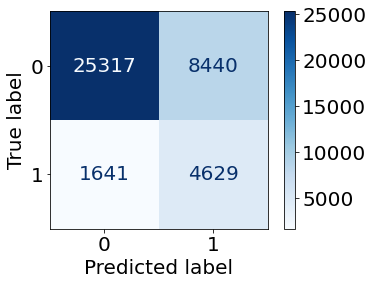

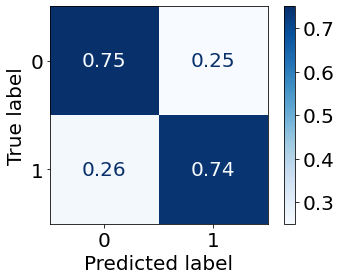

In [66]:
random_state = 2

df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)


n = 0
df_train_2021_DP = df_train_2021 

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     "2021", "Trail-2", "1", df_test_2021,
                    save_dir = "Performance/Test Performance - Original/")



(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)
(120081, 48) (120081, 48) (40027, 48)
accuracy 0.7707047742773627
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     33930
         1.0       0.37      0.69      0.48      6097

    accuracy                           0.77     40027
   macro avg       0.65      0.74      0.67     40027
weighted avg       0.85      0.77      0.80     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6885353452517632
Class 1 Precision: 0.3657750283175046
Class 1 Area Under Precision-Recall Curve: 0.435084562403413
Class 1 F1-Score: 0.4777512233982019
Class 0 Recall: 0.7854700854700855
Class 0 Precision: 0.9334851138353766
Class 0 Area Under Precision-Recall Curve: 0.7230105728795921
Class 0 F1-Score: 0.8531049935979512
Overall Accuracy: 0.7707047742773627
Balanced Accuracy: 0.7370027153609243
Area Under ROC Curve:

Class 1 Recall: 0.23076923076923078
Class 1 Precision: 0.20270270270270271
Class 1 Area Under Precision-Recall Curve: 0.1855781187411733
Class 1 F1-Score: 0.21582733812949642
Class 0 Recall: 0.9731574158325751
Class 0 Precision: 0.9771585198720877
Class 0 Area Under Precision-Recall Curve: 0.9292789252383518
Class 0 F1-Score: 0.9751538636881695
Overall Accuracy: 0.9518338488731772
Balanced Accuracy: 0.601963323300903
Area Under ROC Curve: 0.8463358297753202
Matthews Correlation Coefficient: 0.19151630733015407
0.23076923076923078
0.20270270270270271
0.1855781187411733
0.21582733812949642
0.9731574158325751
0.9771585198720877
0.9292789252383518
0.9751538636881695
0.9518338488731772
0.601963323300903
0.8463358297753202
0.19151630733015407
============================  35-39 ============================ 
Class 1 Recall: 0.44274809160305345
Class 1 Precision: 0.34523809523809523
Class 1 Area Under Precision-Recall Curve: 0.28889545416814716
Class 1 F1-Score: 0.3879598662207358
Class 0 Reca

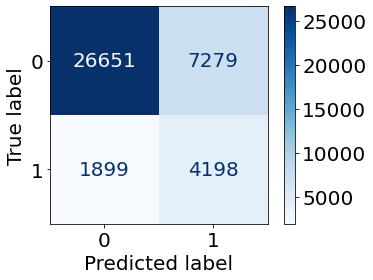

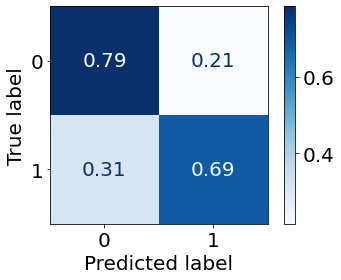

In [67]:
random_state = 3

df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)


n = 0
df_train_2021_DP = df_train_2021 

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     "2021", "Trail-3", "1", df_test_2021,
                    save_dir = "Performance/Test Performance - Original/")



## DP Age (30-34) - Validation Set Performance

## Trial 1

In [ ]:
for n in range(1, 30):
    df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 3, n=n)

    X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2021_DP = df_train_2021_DP['Diabetes']
    print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

    train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                         X_validation_2021, y_validation_2021, 
                         X_validation_2021, y_validation_2021,
                         "2021", "Age-30_34-DP-" + str(n), "1", df_validation_2021)

## Select Best DP model: Age 30-34 (Validation performance)


In [51]:
import os
import pandas as pd

# Specify the directory containing CSV files
directory_path = 'Performance/Age_30_34-Validation-Set-Performance/'

# Get a list of all CSV files in the directory
csv_files = [file for file in os.listdir(directory_path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(directory_path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "30-34"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "30-34"]["Class 1 AU_PRC"].to_list()[0]
    
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv("Performance/Age_30_34-Validation-Set-Performance/ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
19,LR trained on 2021 Age-30_34-DP-20_trial_1.csv,0.740956,0.204825
23,LR trained on 2021 Age-30_34-DP-24_trial_1.csv,0.739200,0.205379
21,LR trained on 2021 Age-30_34-DP-22_trial_1.csv,0.736552,0.205364
24,LR trained on 2021 Age-30_34-DP-25_trial_1.csv,0.735228,0.207981
20,LR trained on 2021 Age-30_34-DP-21_trial_1.csv,0.735219,0.205309
18,LR trained on 2021 Age-30_34-DP-19_trial_1.csv,0.735210,0.205072
25,LR trained on 2021 Age-30_34-DP-26_trial_1.csv,0.731698,0.207840
26,LR trained on 2021 Age-30_34-DP-27_trial_1.csv,0.731680,0.207740
22,LR trained on 2021 Age-30_34-DP-23_trial_1.csv,0.729694,0.205138
27,LR trained on 2021 Age-30_34-DP-28_trial_1.csv,0.728618,0.208144


In [ ]:
# LR trained on 2021 Age-30_34-DP-17_trial_1.csv	0.715536	0.205393


n = 24
df_train_2021_DP = df_train_2021 

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-30_34-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_30_34-Test-Set-Performance/")

## Trial 2

(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (194, 50)  # of DP units 1
New training set:  (120275, 50)
(120275, 48) (120081, 48) (40027, 48)
accuracy 0.7650144898571001
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33889
         1.0       0.36      0.70      0.48      6139

    accuracy                           0.77     40028
   macro avg       0.65      0.74      0.66     40028
weighted avg       0.85      0.77      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.701254275940707
Class 1 Precision: 0.36246526900732506
Class 1 Area Under Precision-Recall Curve: 0.44365855990098496
Class 1 F1-Score: 0.4779085257548845
Class 0 Recall: 0.7765646670010918
Class 0 Precision: 0.9348513374302867


Class 1 Recall: 0.7797619047619048
Class 1 Precision: 0.3961693548387097
Class 1 Area Under Precision-Recall Curve: 0.5097236862758524
Class 1 F1-Score: 0.5254010695187166
Class 0 Recall: 0.7394519356241844
Class 0 Precision: 0.9387078961899503
Class 0 Area Under Precision-Recall Curve: 0.6746760577692812
Class 0 F1-Score: 0.8272506082725061
Overall Accuracy: 0.7466999643239386
Balanced Accuracy: 0.7596069201930447
Area Under ROC Curve: 0.8300468802861147
Matthews Correlation Coefficient: 0.4169806992709938
0.7797619047619048
0.3961693548387097
0.5097236862758524
0.5254010695187166
0.7394519356241844
0.9387078961899503
0.6746760577692812
0.8272506082725061
0.7466999643239386
0.7596069201930447
0.8300468802861147
0.4169806992709938
============================  30-34 ============================ 
Class 1 Recall: 0.3424657534246575
Class 1 Precision: 0.20491803278688525
Class 1 Area Under Precision-Recall Curve: 0.19357154349211897
Class 1 F1-Score: 0.25641025641025644
Class 0 Recall: 0.

Class 1 Recall: 0.756140350877193
Class 1 Precision: 0.3056737588652482
Class 1 Area Under Precision-Recall Curve: 0.38997658335959806
Class 1 F1-Score: 0.4353535353535354
Class 0 Recall: 0.5603951504265828
Class 0 Precision: 0.8997837058399423
Class 0 Area Under Precision-Recall Curve: 0.688347939446702
Class 0 F1-Score: 0.6906474820143884
Overall Accuracy: 0.6002860207365034
Balanced Accuracy: 0.6582677506518879
Area Under ROC Curve: 0.7219530640701439
Matthews Correlation Coefficient: 0.2550187867335666
0.756140350877193
0.3056737588652482
0.38997658335959806
0.4353535353535354
0.5603951504265828
0.8997837058399423
0.688347939446702
0.6906474820143884
0.6002860207365034
0.6582677506518879
0.7219530640701439
0.2550187867335666
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (388, 50)  # of DP units 2
New training set:  (120469, 50)
(120469, 48) (120081, 48) (40027, 48)
accuracy 0.7645398221245129
  

Class 1 Recall: 0.7817460317460317
Class 1 Precision: 0.39087301587301587
Class 1 Area Under Precision-Recall Curve: 0.5095428920992223
Class 1 F1-Score: 0.5211640211640212
Class 0 Recall: 0.732927359721618
Class 0 Precision: 0.9387186629526463
Class 0 Area Under Precision-Recall Curve: 0.6749581787209383
Class 0 F1-Score: 0.8231558378114314
Overall Accuracy: 0.741705315733143
Balanced Accuracy: 0.7573366957338249
Area Under ROC Curve: 0.8287480063795853
Matthews Correlation Coefficient: 0.41186413674987526
0.7817460317460317
0.39087301587301587
0.5095428920992223
0.5211640211640212
0.732927359721618
0.9387186629526463
0.6749581787209383
0.8231558378114314
0.741705315733143
0.7573366957338249
0.8287480063795853
0.41186413674987526
============================  30-34 ============================ 
Class 1 Recall: 0.3424657534246575
Class 1 Precision: 0.17985611510791366
Class 1 Area Under Precision-Recall Curve: 0.19377797229596244
Class 1 F1-Score: 0.23584905660377356
Class 0 Recall: 0.

Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (582, 50)  # of DP units 3
New training set:  (120663, 50)
(120663, 48) (120081, 48) (40027, 48)
accuracy 0.7612920955331268
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     33889
         1.0       0.36      0.70      0.48      6139

    accuracy                           0.76     40028
   macro avg       0.65      0.74      0.66     40028
weighted avg       0.85      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.704837921485584
Class 1 Precision: 0.3584921292460646
Class 1 Area Under Precision-Recall Curve: 0.4432664065742614
Class 1 F1-Score: 0.4752594870668351
Class 0 Recall: 0.771518781905633
Class 0 Precision: 0.9351884970312612
Class 0 Area Under Precision-Recall Curve: 0.7203830269191259
Class 0 F1-Score: 0.8455058450692838
Overall Accuracy: 0.7612920955331268
Balanced Accuracy

Class 1 Recall: 0.7896825396825397
Class 1 Precision: 0.38232468780019213
Class 1 Area Under Precision-Recall Curve: 0.5095156564047358
Class 1 F1-Score: 0.515210355987055
Class 0 Recall: 0.7203131796433232
Class 0 Precision: 0.9398410896708286
Class 0 Area Under Precision-Recall Curve: 0.6752526866381283
Class 0 F1-Score: 0.8155626692932775
Overall Accuracy: 0.7327863003924366
Balanced Accuracy: 0.7549978596629314
Area Under ROC Curve: 0.8273507460110331
Matthews Correlation Coefficient: 0.4053432710968681
0.7896825396825397
0.38232468780019213
0.5095156564047358
0.515210355987055
0.7203131796433232
0.9398410896708286
0.6752526866381283
0.8155626692932775
0.7327863003924366
0.7549978596629314
0.8273507460110331
0.4053432710968681
============================  30-34 ============================ 
Class 1 Recall: 0.3972602739726027
Class 1 Precision: 0.17901234567901234
Class 1 Area Under Precision-Recall Curve: 0.19892539047152089
Class 1 F1-Score: 0.2468085106382979
Class 0 Recall: 0.9

Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (776, 50)  # of DP units 4
New training set:  (120857, 50)
(120857, 48) (120081, 48) (40027, 48)
accuracy 0.7770810432697112
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     33889
         1.0       0.37      0.67      0.48      6139

    accuracy                           0.78     40028
   macro avg       0.65      0.73      0.67     40028
weighted avg       0.84      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.669327251995439
Class 1 Precision: 0.3734775495364479
Class 1 Area Under Precision-Recall Curve: 0.44274217956064593
Class 1 F1-Score: 0.47943527215448334
Class 0 Recall: 0.7966006668830594
Class 0 Precision: 0.9300627024047405
Class 0 Area Under Precision-Recall Curve: 0.7208547514001945
Class 0 F1-Score: 0.8581737264563299
Overall Accuracy: 0.7770810432697112
Balanced Accur

Class 1 Recall: 0.3972602739726027
Class 1 Precision: 0.18831168831168832
Class 1 Area Under Precision-Recall Curve: 0.200569529777189
Class 1 F1-Score: 0.25550660792951546
Class 0 Recall: 0.9448367166813769
Class 0 Precision: 0.9798627002288329
Class 0 Area Under Precision-Recall Curve: 0.9261319348554202
Class 0 F1-Score: 0.9620310042687037
Overall Accuracy: 0.9277469003847798
Balanced Accuracy: 0.6710484953269898
Area Under ROC Curve: 0.8047159317607516
Matthews Correlation Coefficient: 0.23985819190677113
0.3972602739726027
0.18831168831168832
0.200569529777189
0.25550660792951546
0.9448367166813769
0.9798627002288329
0.9261319348554202
0.9620310042687037
0.9277469003847798
0.6710484953269898
0.8047159317607516
0.23985819190677113
============================  35-39 ============================ 
Class 1 Recall: 0.4528301886792453
Class 1 Precision: 0.20869565217391303
Class 1 Area Under Precision-Recall Curve: 0.2338339749084068
Class 1 F1-Score: 0.2857142857142857
Class 0 Recall: 

accuracy 0.7737333866293594
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     33889
         1.0       0.37      0.67      0.48      6139

    accuracy                           0.77     40028
   macro avg       0.65      0.73      0.67     40028
weighted avg       0.84      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6735624694575664
Class 1 Precision: 0.3695924204504827
Class 1 Area Under Precision-Recall Curve: 0.44319340224445186
Class 1 F1-Score: 0.47728977895769614
Class 0 Recall: 0.7918793708873085
Class 0 Precision: 0.9305131761442441
Class 0 Area Under Precision-Recall Curve: 0.7205746837620844
Class 0 F1-Score: 0.8556170192414991
Overall Accuracy: 0.7737333866293594
Balanced Accuracy: 0.7327209201724374
Area Under ROC Curve: 0.8192334636792805
Matthews Correlation Coefficient: 0.3737401519463038
0.6735624694575664
0.3695924204504827
0.443193402

Class 1 Recall: 0.3972602739726027
Class 1 Precision: 0.16477272727272727
Class 1 Area Under Precision-Recall Curve: 0.1998303383505456
Class 1 F1-Score: 0.23293172690763053
Class 0 Recall: 0.9351279788172993
Class 0 Precision: 0.9796578825705039
Class 0 Area Under Precision-Recall Curve: 0.9261544017566208
Class 0 F1-Score: 0.956875141115376
Overall Accuracy: 0.9183411714407866
Balanced Accuracy: 0.666194126394951
Area Under ROC Curve: 0.8049819245789454
Matthews Correlation Coefficient: 0.2191050845032393
0.3972602739726027
0.16477272727272727
0.1998303383505456
0.23293172690763053
0.9351279788172993
0.9796578825705039
0.9261544017566208
0.956875141115376
0.9183411714407866
0.666194126394951
0.8049819245789454
0.2191050845032393
============================  35-39 ============================ 
Class 1 Recall: 0.4716981132075472
Class 1 Precision: 0.18867924528301888
Class 1 Area Under Precision-Recall Curve: 0.23283775292870412
Class 1 F1-Score: 0.2695417789757412
Class 0 Recall: 0.9

accuracy 0.7740081942640152
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     33889
         1.0       0.37      0.67      0.48      6139

    accuracy                           0.77     40028
   macro avg       0.65      0.73      0.67     40028
weighted avg       0.84      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6720964326437531
Class 1 Precision: 0.36974639304597184
Class 1 Area Under Precision-Recall Curve: 0.4412113348182175
Class 1 F1-Score: 0.47704936986934904
Class 0 Recall: 0.7924695328867775
Class 0 Precision: 0.9302712251896498
Class 0 Area Under Precision-Recall Curve: 0.721697943047696
Class 0 F1-Score: 0.8558590139902482
Overall Accuracy: 0.7740081942640152
Balanced Accuracy: 0.7322829827652653
Area Under ROC Curve: 0.8184337360093862
Matthews Correlation Coefficient: 0.3733335967895223
0.6720964326437531
0.36974639304597184
0.441211334

Class 1 Recall: 0.7599206349206349
Class 1 Precision: 0.38109452736318405
Class 1 Area Under Precision-Recall Curve: 0.506080011814622
Class 1 F1-Score: 0.5076209410205434
Class 0 Recall: 0.729447585906916
Class 0 Precision: 0.9327030033370411
Class 0 Area Under Precision-Recall Curve: 0.6766298424303808
Class 0 F1-Score: 0.8186477910666341
Overall Accuracy: 0.7349268640742062
Balanced Accuracy: 0.7446841104137755
Area Under ROC Curve: 0.8223468450741178
Matthews Correlation Coefficient: 0.3918705644710356
0.7599206349206349
0.38109452736318405
0.506080011814622
0.5076209410205434
0.729447585906916
0.9327030033370411
0.6766298424303808
0.8186477910666341
0.7349268640742062
0.7446841104137755
0.8223468450741178
0.3918705644710356
============================  30-34 ============================ 
Class 1 Recall: 0.4383561643835616
Class 1 Precision: 0.16842105263157894
Class 1 Area Under Precision-Recall Curve: 0.2000119274752881
Class 1 F1-Score: 0.24334600760456274
Class 0 Recall: 0.930

Overall Accuracy: 0.6873508353221957
Balanced Accuracy: 0.6959134899867191
Area Under ROC Curve: 0.767227050980289
Matthews Correlation Coefficient: 0.335008110022948
0.711738484398217
0.3985024958402662
0.4863205718125835
0.5109333333333334
0.6800884955752212
0.8879260543038706
0.6353124884522832
0.7702330243046854
0.6873508353221957
0.6959134899867191
0.767227050980289
0.335008110022948
============================  80-99 ============================ 
Class 1 Recall: 0.6807017543859649
Class 1 Precision: 0.3310580204778157
Class 1 Area Under Precision-Recall Curve: 0.3909281717188919
Class 1 F1-Score: 0.4454649827784156
Class 0 Recall: 0.6479568926807364
Class 0 Precision: 0.888
Class 0 Area Under Precision-Recall Curve: 0.6882367542579372
Class 0 F1-Score: 0.7492211838006231
Overall Accuracy: 0.6546299606721487
Balanced Accuracy: 0.6643293235333507
Area Under ROC Curve: 0.7219577907498878
Matthews Correlation Coefficient: 0.268319422776937
0.6807017543859649
0.3310580204778157
0.390

Class 1 Recall: 0.7619047619047619
Class 1 Precision: 0.3764705882352941
Class 1 Area Under Precision-Recall Curve: 0.5043680013305134
Class 1 F1-Score: 0.5039370078740157
Class 0 Recall: 0.7233579817311875
Class 0 Precision: 0.9326977005047672
Class 0 Area Under Precision-Recall Curve: 0.6771770622808005
Class 0 F1-Score: 0.814796668299853
Overall Accuracy: 0.7302889760970389
Balanced Accuracy: 0.7426313718179747
Area Under ROC Curve: 0.8205940125796586
Matthews Correlation Coefficient: 0.3873342897798149
0.7619047619047619
0.3764705882352941
0.5043680013305134
0.5039370078740157
0.7233579817311875
0.9326977005047672
0.6771770622808005
0.814796668299853
0.7302889760970389
0.7426313718179747
0.8205940125796586
0.3873342897798149
============================  30-34 ============================ 
Class 1 Recall: 0.4520547945205479
Class 1 Precision: 0.15639810426540285
Class 1 Area Under Precision-Recall Curve: 0.20004613528234047
Class 1 F1-Score: 0.2323943661971831
Class 0 Recall: 0.921

New training set:  (121633, 50)
(121633, 48) (120081, 48) (40027, 48)
accuracy 0.7667882482262416
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33889
         1.0       0.36      0.68      0.47      6139

    accuracy                           0.77     40028
   macro avg       0.65      0.73      0.66     40028
weighted avg       0.84      0.77      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6794266167128197
Class 1 Precision: 0.3615011267117351
Class 1 Area Under Precision-Recall Curve: 0.44027167320831173
Class 1 F1-Score: 0.4719126548622504
Class 0 Recall: 0.7826138274956476
Class 0 Precision: 0.930923130923131
Class 0 Area Under Precision-Recall Curve: 0.7221016189399277
Class 0 F1-Score: 0.8503502781384762
Overall Accuracy: 0.7667882482262416
Balanced Accuracy: 0.7310202221042337
Area Under ROC Curve: 0.8162473896038365
Matthews Correlation Coefficient: 

Class 1 Recall: 0.7757936507936508
Class 1 Precision: 0.3681732580037665
Class 1 Area Under Precision-Recall Curve: 0.5023537527639497
Class 1 F1-Score: 0.49936143039591313
Class 0 Recall: 0.7081339712918661
Class 0 Precision: 0.9350947731188972
Class 0 Area Under Precision-Recall Curve: 0.6777880288272935
Class 0 F1-Score: 0.8059405940594059
Overall Accuracy: 0.7202996789154478
Balanced Accuracy: 0.7419638110427584
Area Under ROC Curve: 0.8186366398088886
Matthews Correlation Coefficient: 0.3830923872328281
0.7757936507936508
0.3681732580037665
0.5023537527639497
0.49936143039591313
0.7081339712918661
0.9350947731188972
0.6777880288272935
0.8059405940594059
0.7202996789154478
0.7419638110427584
0.8186366398088886
0.3830923872328281
============================  30-34 ============================ 
Class 1 Recall: 0.4657534246575342
Class 1 Precision: 0.14345991561181434
Class 1 Area Under Precision-Recall Curve: 0.20394099330003357
Class 1 F1-Score: 0.2193548387096774
Class 0 Recall: 0

Balanced Accuracy: 0.6952333364015306
Area Under ROC Curve: 0.7667267156701602
Matthews Correlation Coefficient: 0.3342783195213899
0.7072808320950966
0.39932885906040266
0.48575900091592794
0.510455764075067
0.6831858407079646
0.8868466398621482
0.6355055111478146
0.7718070482379404
0.6887146266621207
0.6952333364015306
0.7667267156701602
0.3342783195213899
============================  80-99 ============================ 
Class 1 Recall: 0.6736842105263158
Class 1 Precision: 0.33217993079584773
Class 1 Area Under Precision-Recall Curve: 0.3910078323271038
Class 1 F1-Score: 0.4449594438006952
Class 0 Recall: 0.6533453075886844
Class 0 Precision: 0.886654478976234
Class 0 Area Under Precision-Recall Curve: 0.6882746048316062
Class 0 F1-Score: 0.7523267838676319
Overall Accuracy: 0.6574901680371827
Balanced Accuracy: 0.6635147590575001
Area Under ROC Curve: 0.7218049614381711
Matthews Correlation Coefficient: 0.26751693698669693
0.6736842105263158
0.33217993079584773
0.3910078323271038
0

Class 1 Recall: 0.7976190476190477
Class 1 Precision: 0.3611859838274933
Class 1 Area Under Precision-Recall Curve: 0.5005915748403437
Class 1 F1-Score: 0.4972170686456401
Class 0 Recall: 0.6907351022183558
Class 0 Precision: 0.9396449704142011
Class 0 Area Under Precision-Recall Curve: 0.6784081743728192
Class 0 F1-Score: 0.7961895211832538
Overall Accuracy: 0.7099536211202283
Balanced Accuracy: 0.7441770749187018
Area Under ROC Curve: 0.8166507867464805
Matthews Correlation Coefficient: 0.38329107073277546
0.7976190476190477
0.3611859838274933
0.5005915748403437
0.4972170686456401
0.6907351022183558
0.9396449704142011
0.6784081743728192
0.7961895211832538
0.7099536211202283
0.7441770749187018
0.8166507867464805
0.38329107073277546
============================  30-34 ============================ 
Class 1 Recall: 0.4931506849315068
Class 1 Precision: 0.1323529411764706
Class 1 Area Under Precision-Recall Curve: 0.204013315114298
Class 1 F1-Score: 0.20869565217391306
Class 0 Recall: 0.8

Class 1 Recall: 0.6807017543859649
Class 1 Precision: 0.32523051131601005
Class 1 Area Under Precision-Recall Curve: 0.39084969250220514
Class 1 F1-Score: 0.44015882019285313
Class 0 Recall: 0.6385271665918276
Class 0 Precision: 0.8865336658354115
Class 0 Area Under Precision-Recall Curve: 0.6883289418084291
Class 0 F1-Score: 0.7423649177760376
Overall Accuracy: 0.6471219163389346
Balanced Accuracy: 0.6596144604888963
Area Under ROC Curve: 0.7217230323226116
Matthews Correlation Coefficient: 0.26000240340004244
0.6807017543859649
0.32523051131601005
0.39084969250220514
0.44015882019285313
0.6385271665918276
0.8865336658354115
0.6883289418084291
0.7423649177760376
0.6471219163389346
0.6596144604888963
0.7217230323226116
0.26000240340004244
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (1940, 50)  # of DP units 10
New training set:  (122021, 50)
(122021, 48) (120081, 48) (40027, 48)
accuracy 0.7538972

Class 1 Recall: 0.8015873015873016
Class 1 Precision: 0.35815602836879434
Class 1 Area Under Precision-Recall Curve: 0.4981486553568498
Class 1 F1-Score: 0.4950980392156863
Class 0 Recall: 0.685080469769465
Class 0 Precision: 0.9402985074626866
Class 0 Area Under Precision-Recall Curve: 0.6790536286917135
Class 0 F1-Score: 0.7926522395571214
Overall Accuracy: 0.7060292543703175
Balanced Accuracy: 0.7433338856783833
Area Under ROC Curve: 0.814733113776176
Matthews Correlation Coefficient: 0.38111442350614994
0.8015873015873016
0.35815602836879434
0.4981486553568498
0.4950980392156863
0.685080469769465
0.9402985074626866
0.6790536286917135
0.7926522395571214
0.7060292543703175
0.7433338856783833
0.814733113776176
0.38111442350614994
============================  30-34 ============================ 
Class 1 Recall: 0.5068493150684932
Class 1 Precision: 0.125
Class 1 Area Under Precision-Recall Curve: 0.20452113583769685
Class 1 F1-Score: 0.2005420054200542
Class 0 Recall: 0.885701676963812

Class 1 Recall: 0.6754385964912281
Class 1 Precision: 0.3259949195596952
Class 1 Area Under Precision-Recall Curve: 0.390915360818699
Class 1 F1-Score: 0.4397487150199885
Class 0 Recall: 0.6425684777727885
Class 0 Precision: 0.885519801980198
Class 0 Area Under Precision-Recall Curve: 0.6883456865505092
Class 0 F1-Score: 0.7447306791569087
Overall Accuracy: 0.64926707186271
Balanced Accuracy: 0.6590035371320082
Area Under ROC Curve: 0.7216206209281624
Matthews Correlation Coefficient: 0.2593514560604386
0.6754385964912281
0.3259949195596952
0.390915360818699
0.4397487150199885
0.6425684777727885
0.885519801980198
0.6883456865505092
0.7447306791569087
0.64926707186271
0.6590035371320082
0.7216206209281624
0.2593514560604386
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (2134, 50)  # of DP units 11
New training set:  (122215, 50)
(122215, 48) (120081, 48) (40027, 48)
accuracy 0.7560957329869091
      

/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_plot/confusion_matrix.py:114: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


============================  Over all performance ============================ 
Class 1 Recall: 0.6937611988923278
Class 1 Precision: 0.35076593641904136
Class 1 Area Under Precision-Recall Curve: 0.4352023902190225
Class 1 F1-Score: 0.46594825228379194
Class 0 Recall: 0.7673876479093511
Class 0 Precision: 0.9325826579645701
Class 0 Area Under Precision-Recall Curve: 0.7243169005459981
Class 0 F1-Score: 0.84195872116552
Overall Accuracy: 0.7560957329869091
Balanced Accuracy: 0.7305744234008394
Area Under ROC Curve: 0.8130815439543482
Matthews Correlation Coefficient: 0.3614773541217749
0.6937611988923278
0.35076593641904136
0.4352023902190225
0.46594825228379194
0.7673876479093511
0.9325826579645701
0.7243169005459981
0.84195872116552
0.7560957329869091
0.7305744234008394
0.8130815439543482
0.3614773541217749
============================  Male ============================ 
Class 1 Recall: 0.7158059467918623
Class 1 Precision: 0.3483094730429485
Class 1 Area Under Precision-Recall Curv

Class 1 Recall: 0.5068493150684932
Class 1 Precision: 0.12012987012987013
Class 1 Area Under Precision-Recall Curve: 0.2046051050799687
Class 1 F1-Score: 0.19422572178477693
Class 0 Recall: 0.8804060017652251
Class 0 Precision: 0.982274741506647
Class 0 Area Under Precision-Recall Curve: 0.9259997121937968
Class 0 F1-Score: 0.9285548056783802
Overall Accuracy: 0.8687473279179136
Balanced Accuracy: 0.6936276584168591
Area Under ROC Curve: 0.8060096241037857
Matthews Correlation Coefficient: 0.19913997671119
0.5068493150684932
0.12012987012987013
0.2046051050799687
0.19422572178477693
0.8804060017652251
0.982274741506647
0.9259997121937968
0.9285548056783802
0.8687473279179136
0.6936276584168591
0.8060096241037857
0.19913997671119
============================  35-39 ============================ 
Class 1 Recall: 0.5754716981132075
Class 1 Precision: 0.1412037037037037
Class 1 Area Under Precision-Recall Curve: 0.2301675510691663
Class 1 F1-Score: 0.22676579925650556
Class 0 Recall: 0.8555

accuracy 0.7692115519136604
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     33889
         1.0       0.36      0.66      0.47      6139

    accuracy                           0.77     40028
   macro avg       0.65      0.73      0.66     40028
weighted avg       0.84      0.77      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6637888906988109
Class 1 Precision: 0.3622544226153436
Class 1 Area Under Precision-Recall Curve: 0.43467506905281744
Class 1 F1-Score: 0.4687140556705774
Class 0 Recall: 0.788308890790522
Class 0 Precision: 0.9282810382570624
Class 0 Area Under Precision-Recall Curve: 0.7237171826762298
Class 0 F1-Score: 0.8525882428033446
Overall Accuracy: 0.7692115519136604
Balanced Accuracy: 0.7260488907446665
Area Under ROC Curve: 0.8117890661035322
Matthews Correlation Coefficient: 0.36242300879551737
0.6637888906988109
0.3622544226153436
0.4346750690

Class 1 Recall: 0.5068493150684932
Class 1 Precision: 0.12585034013605442
Class 1 Area Under Precision-Recall Curve: 0.20462682313762073
Class 1 F1-Score: 0.2016348773841962
Class 0 Recall: 0.8865842894969108
Class 0 Precision: 0.9823960880195599
Class 0 Area Under Precision-Recall Curve: 0.9259926905692033
Class 0 F1-Score: 0.9320343307817213
Overall Accuracy: 0.8747327917913639
Balanced Accuracy: 0.6967168022827019
Area Under ROC Curve: 0.8061668016781729
Matthews Correlation Coefficient: 0.206368075076048
0.5068493150684932
0.12585034013605442
0.20462682313762073
0.2016348773841962
0.8865842894969108
0.9823960880195599
0.9259926905692033
0.9320343307817213
0.8747327917913639
0.6967168022827019
0.8061668016781729
0.206368075076048
============================  35-39 ============================ 
Class 1 Recall: 0.5660377358490566
Class 1 Precision: 0.14962593516209477
Class 1 Area Under Precision-Recall Curve: 0.2295042675972751
Class 1 F1-Score: 0.2366863905325444
Class 0 Recall: 0.

New training set:  (122603, 50)
(122603, 48) (120081, 48) (40027, 48)
accuracy 0.7622664135105426
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33889
         1.0       0.36      0.67      0.47      6139

    accuracy                           0.76     40028
   macro avg       0.64      0.73      0.66     40028
weighted avg       0.84      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6748656132920671
Class 1 Precision: 0.3552259281488468
Class 1 Area Under Precision-Recall Curve: 0.4329996234583009
Class 1 F1-Score: 0.465453319851702
Class 0 Recall: 0.7780990881997109
Class 0 Precision: 0.9296315882249251
Class 0 Area Under Precision-Recall Curve: 0.7243984403672624
Class 0 F1-Score: 0.8471423522986474
Overall Accuracy: 0.7622664135105426
Balanced Accuracy: 0.726482350745889
Area Under ROC Curve: 0.8105521724957678
Matthews Correlation Coefficient: 0.

Class 1 Recall: 0.7896825396825397
Class 1 Precision: 0.35504014272970563
Class 1 Area Under Precision-Recall Curve: 0.4914787869299515
Class 1 F1-Score: 0.4898461538461539
Class 0 Recall: 0.6855154414963027
Class 0 Precision: 0.9369797859690844
Class 0 Area Under Precision-Recall Curve: 0.6810013166682491
Class 0 F1-Score: 0.7917608641044963
Overall Accuracy: 0.7042454513021762
Balanced Accuracy: 0.7375989905894211
Area Under ROC Curve: 0.8088351042896498
Matthews Correlation Coefficient: 0.37251480585562574
0.7896825396825397
0.35504014272970563
0.4914787869299515
0.4898461538461539
0.6855154414963027
0.9369797859690844
0.6810013166682491
0.7917608641044963
0.7042454513021762
0.7375989905894211
0.8088351042896498
0.37251480585562574
============================  30-34 ============================ 
Class 1 Recall: 0.5342465753424658
Class 1 Precision: 0.11538461538461539
Class 1 Area Under Precision-Recall Curve: 0.204628721784444
Class 1 F1-Score: 0.1897810218978102
Class 0 Recall: 0

Area Under ROC Curve: 0.7654374153506291
Matthews Correlation Coefficient: 0.33512244055755536
0.6790490341753344
0.40913160250671443
0.4839301450408792
0.5106145251396649
0.7079646017699115
0.8810572687224669
0.6360841313121706
0.7850834151128557
0.7013296965564269
0.6935068179726229
0.7654374153506291
0.33512244055755536
============================  80-99 ============================ 
Class 1 Recall: 0.6333333333333333
Class 1 Precision: 0.3402450518378888
Class 1 Area Under Precision-Recall Curve: 0.3910646277491605
Class 1 F1-Score: 0.44267320662170445
Class 0 Recall: 0.6856757970363718
Class 0 Precision: 0.8796082949308756
Class 0 Area Under Precision-Recall Curve: 0.6883159829216734
Class 0 F1-Score: 0.7706283118849357
Overall Accuracy: 0.6750089381480158
Balanced Accuracy: 0.6595045651848526
Area Under ROC Curve: 0.7213125989648571
Matthews Correlation Coefficient: 0.2648305589647327
0.6333333333333333
0.3402450518378888
0.3910646277491605
0.44267320662170445
0.6856757970363718

Class 1 Recall: 0.7936507936507936
Class 1 Precision: 0.35056967572305
Class 1 Area Under Precision-Recall Curve: 0.4886587541268943
Class 1 F1-Score: 0.48632218844984804
Class 0 Recall: 0.6776859504132231
Class 0 Precision: 0.937424789410349
Class 0 Area Under Precision-Recall Curve: 0.6817344802736418
Class 0 F1-Score: 0.7866700328199948
Overall Accuracy: 0.6985372814841242
Balanced Accuracy: 0.7356683720320083
Area Under ROC Curve: 0.8067784820177164
Matthews Correlation Coefficient: 0.36843231875669413
0.7936507936507936
0.35056967572305
0.4886587541268943
0.48632218844984804
0.6776859504132231
0.937424789410349
0.6817344802736418
0.7866700328199948
0.6985372814841242
0.7356683720320083
0.8067784820177164
0.36843231875669413
============================  30-34 ============================ 
Class 1 Recall: 0.5616438356164384
Class 1 Precision: 0.11141304347826086
Class 1 Area Under Precision-Recall Curve: 0.20457983729880638
Class 1 F1-Score: 0.18594104308390022
Class 0 Recall: 0.85

Class 1:  (18500, 50)
Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (2910, 50)  # of DP units 15
New training set:  (122991, 50)
(122991, 48) (120081, 48) (40027, 48)
accuracy 0.7566953132807035
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     33889
         1.0       0.35      0.68      0.46      6139

    accuracy                           0.76     40028
   macro avg       0.64      0.73      0.65     40028
weighted avg       0.84      0.76      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6810555465059456
Class 1 Precision: 0.3495234910550075
Class 1 Area Under Precision-Recall Curve: 0.4297479802988649
Class 1 F1-Score: 0.4619634274349483
Class 0 Recall: 0.7703974741066423
Class 0 Precision: 0.9302358725860472
Class 0 Area Under Precision-Recall Curve: 0.7243919304463591
Class 0 F1-Score: 0.8428052618836253
Overall Accuracy: 0.75669531

Class 1 Recall: 0.7956349206349206
Class 1 Precision: 0.34748700173310226
Class 1 Area Under Precision-Recall Curve: 0.4857473965030857
Class 1 F1-Score: 0.4837153196622436
Class 0 Recall: 0.6724662896911701
Class 0 Precision: 0.9375379017586416
Class 0 Area Under Precision-Recall Curve: 0.6825098079665722
Class 0 F1-Score: 0.7831813576494429
Overall Accuracy: 0.6946129147342134
Balanced Accuracy: 0.7340506051630453
Area Under ROC Curve: 0.8046364188708686
Matthews Correlation Coefficient: 0.3652677131879609
0.7956349206349206
0.34748700173310226
0.4857473965030857
0.4837153196622436
0.6724662896911701
0.9375379017586416
0.6825098079665722
0.7831813576494429
0.6946129147342134
0.7340506051630453
0.8046364188708686
0.3652677131879609
============================  30-34 ============================ 
Class 1 Recall: 0.5753424657534246
Class 1 Precision: 0.10852713178294573
Class 1 Area Under Precision-Recall Curve: 0.20485369471042725
Class 1 F1-Score: 0.1826086956521739
Class 0 Recall: 0

Class 1:  (18500, 50)
Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (3104, 50)  # of DP units 16
New training set:  (123185, 50)
(123185, 48) (120081, 48) (40027, 48)
accuracy 0.7583941241131208
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     33889
         1.0       0.35      0.67      0.46      6139

    accuracy                           0.76     40028
   macro avg       0.64      0.72      0.65     40028
weighted avg       0.84      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6740511483955042
Class 1 Precision: 0.350440379403794
Class 1 Area Under Precision-Recall Curve: 0.4276442774614903
Class 1 F1-Score: 0.46113556583272963
Class 0 Recall: 0.7736728732036944
Class 0 Precision: 0.9290928419560596
Class 0 Area Under Precision-Recall Curve: 0.7259659616170914
Class 0 F1-Score: 0.8442898774734741
Overall Accuracy: 0.75839412

Class 1 Recall: 0.7896825396825397
Class 1 Precision: 0.34608695652173915
Class 1 Area Under Precision-Recall Curve: 0.4827453117213864
Class 1 F1-Score: 0.48125755743651755
Class 0 Recall: 0.6729012614180079
Class 0 Precision: 0.9358741681790683
Class 0 Area Under Precision-Recall Curve: 0.6832605261313807
Class 0 F1-Score: 0.7828947368421053
Overall Accuracy: 0.6938993935069568
Balanced Accuracy: 0.7312919005502738
Area Under ROC Curve: 0.8026203594385413
Matthews Correlation Coefficient: 0.3611518362499144
0.7896825396825397
0.34608695652173915
0.4827453117213864
0.48125755743651755
0.6729012614180079
0.9358741681790683
0.6832605261313807
0.7828947368421053
0.6938993935069568
0.7312919005502738
0.8026203594385413
0.3611518362499144
============================  30-34 ============================ 
Class 1 Recall: 0.6027397260273972
Class 1 Precision: 0.11027568922305764
Class 1 Area Under Precision-Recall Curve: 0.20486273021225102
Class 1 F1-Score: 0.1864406779661017
Class 0 Recall:

Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (3298, 50)  # of DP units 17
New training set:  (123379, 50)
(123379, 48) (120081, 48) (40027, 48)
accuracy 0.754172079544319
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     33889
         1.0       0.35      0.68      0.46      6139

    accuracy                           0.75     40028
   macro avg       0.64      0.72      0.65     40028
weighted avg       0.84      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6789379377748819
Class 1 Precision: 0.34626568081747944
Class 1 Area Under Precision-Recall Curve: 0.42628742641250644
Class 1 F1-Score: 0.45862676056338036
Class 0 Recall: 0.7678007613089793
Class 0 Precision: 0.9295845093065628
Class 0 Area Under Precision-Recall Curve: 0.7261642399611795
Class 0 F1-Score: 0.8409825468648997
Overall Accuracy: 0.754172079544319
Balanced Acc

Class 1 Recall: 0.7956349206349206
Class 1 Precision: 0.3404074702886248
Class 1 Area Under Precision-Recall Curve: 0.48032175940013044
Class 1 F1-Score: 0.4768133174791915
Class 0 Recall: 0.662026968247064
Class 0 Precision: 0.9366153846153846
Class 0 Area Under Precision-Recall Curve: 0.6839458398058621
Class 0 F1-Score: 0.7757390417940877
Overall Accuracy: 0.6860506600071352
Balanced Accuracy: 0.7288309444409923
Area Under ROC Curve: 0.8006345063761331
Matthews Correlation Coefficient: 0.3560657285373712
0.7956349206349206
0.3404074702886248
0.48032175940013044
0.4768133174791915
0.662026968247064
0.9366153846153846
0.6839458398058621
0.7757390417940877
0.6860506600071352
0.7288309444409923
0.8006345063761331
0.3560657285373712
============================  30-34 ============================ 
Class 1 Recall: 0.6027397260273972
Class 1 Precision: 0.10161662817551963
Class 1 Area Under Precision-Recall Curve: 0.2053936355780923
Class 1 F1-Score: 0.17391304347826086
Class 0 Recall: 0.8

Area Under ROC Curve: 0.7644663309182238
Matthews Correlation Coefficient: 0.3317119124709359
0.6641901931649331
0.41122355105795766
0.48222131463562834
0.5079545454545454
0.7168141592920354
0.8775731310942578
0.6365474414792868
0.789089137847053
0.7047391749062394
0.6905021762284842
0.7644663309182238
0.3317119124709359
============================  80-99 ============================ 
Class 1 Recall: 0.6070175438596491
Class 1 Precision: 0.3415597235932873
Class 1 Area Under Precision-Recall Curve: 0.39076254731599425
Class 1 F1-Score: 0.4371446620341124
Class 0 Recall: 0.7004939380332286
Class 0 Precision: 0.874439461883408
Class 0 Area Under Precision-Recall Curve: 0.6884853945215861
Class 0 F1-Score: 0.7778608825729244
Overall Accuracy: 0.6814444047193422
Balanced Accuracy: 0.6537557409464388
Area Under ROC Curve: 0.7207501240753432
Matthews Correlation Coefficient: 0.2577251047406774
0.6070175438596491
0.3415597235932873
0.39076254731599425
0.4371446620341124
0.7004939380332286
0.

Class 1 Recall: 0.7936507936507936
Class 1 Precision: 0.3401360544217687
Class 1 Area Under Precision-Recall Curve: 0.47789292737244393
Class 1 F1-Score: 0.4761904761904761
Class 0 Recall: 0.6624619399739017
Class 0 Precision: 0.9360786724031961
Class 0 Area Under Precision-Recall Curve: 0.6846646449346362
Class 0 F1-Score: 0.7758532857870606
Overall Accuracy: 0.6860506600071352
Balanced Accuracy: 0.7280563668123476
Area Under ROC Curve: 0.7985649385170916
Matthews Correlation Coefficient: 0.35494373373752236
0.7936507936507936
0.3401360544217687
0.47789292737244393
0.4761904761904761
0.6624619399739017
0.9360786724031961
0.6846646449346362
0.7758532857870606
0.6860506600071352
0.7280563668123476
0.7985649385170916
0.35494373373752236
============================  30-34 ============================ 
Class 1 Recall: 0.6027397260273972
Class 1 Precision: 0.09887640449438202
Class 1 Area Under Precision-Recall Curve: 0.20527704082818904
Class 1 F1-Score: 0.16988416988416988
Class 0 Recall

Area Under ROC Curve: 0.7641938092545597
Matthews Correlation Coefficient: 0.32641073475183807
0.6463595839524517
0.4127134724857685
0.48182783456957884
0.5037637521713955
0.7261061946902655
0.873336881319851
0.6366778387281151
0.7929451558347427
0.7078077054210705
0.6862328893213586
0.7641938092545597
0.32641073475183807
============================  80-99 ============================ 
Class 1 Recall: 0.5842105263157895
Class 1 Precision: 0.344364012409514
Class 1 Area Under Precision-Recall Curve: 0.39049685670936407
Class 1 F1-Score: 0.4333116460637606
Class 0 Recall: 0.7153120790300853
Class 0 Precision: 0.8704918032786885
Class 0 Area Under Precision-Recall Curve: 0.6885790592674674
Class 0 F1-Score: 0.7853093418782351
Overall Accuracy: 0.688594923131927
Balanced Accuracy: 0.6497613026729374
Area Under ROC Curve: 0.7205649957853772
Matthews Correlation Coefficient: 0.25368124425870253
0.5842105263157895
0.344364012409514
0.39049685670936407
0.4333116460637606
0.7153120790300853
0.

Class 1 Recall: 0.7936507936507936
Class 1 Precision: 0.338409475465313
Class 1 Area Under Precision-Recall Curve: 0.47507762422849714
Class 1 F1-Score: 0.4744958481613286
Class 0 Recall: 0.6598521096128752
Class 0 Precision: 0.9358420727945712
Class 0 Area Under Precision-Recall Curve: 0.6854044327029477
Class 0 F1-Score: 0.7739795918367348
Overall Accuracy: 0.6839100963253657
Balanced Accuracy: 0.7267514516318344
Area Under ROC Curve: 0.7965557833978887
Matthews Correlation Coefficient: 0.35266680218077473
0.7936507936507936
0.338409475465313
0.47507762422849714
0.4744958481613286
0.6598521096128752
0.9358420727945712
0.6854044327029477
0.7739795918367348
0.6839100963253657
0.7267514516318344
0.7965557833978887
0.35266680218077473
============================  30-34 ============================ 
Class 1 Recall: 0.6575342465753424
Class 1 Precision: 0.1016949152542373
Class 1 Area Under Precision-Recall Curve: 0.20508372403118694
Class 1 F1-Score: 0.17614678899082573
Class 0 Recall: 0

Matthews Correlation Coefficient: 0.32192734780287374
0.6404160475482912
0.41086749285033364
0.4814722231129362
0.5005807200929152
0.7265486725663717
0.8715498938428875
0.6368012148417235
0.7924710424710425
0.7067848619161269
0.6834823600573314
0.7639127404699602
0.32192734780287374
============================  80-99 ============================ 
Class 1 Recall: 0.5807017543859649
Class 1 Precision: 0.3458725182863114
Class 1 Area Under Precision-Recall Curve: 0.39026734407347
Class 1 F1-Score: 0.4335297969875573
Class 0 Recall: 0.7189043556353839
Class 0 Precision: 0.8701086956521739
Class 0 Area Under Precision-Recall Curve: 0.6886523555270685
Class 0 F1-Score: 0.7873125153675927
Overall Accuracy: 0.6907400786557025
Balanced Accuracy: 0.6498030550106744
Area Under ROC Curve: 0.7204224076131056
Matthews Correlation Coefficient: 0.25438021020865265
0.5807017543859649
0.3458725182863114
0.39026734407347
0.4335297969875573
0.7189043556353839
0.8701086956521739
0.6886523555270685
0.78731

Class 1 Recall: 0.7817460317460317
Class 1 Precision: 0.33907056798623064
Class 1 Area Under Precision-Recall Curve: 0.47228212914513396
Class 1 F1-Score: 0.47298919567827136
Class 0 Recall: 0.6659417137886038
Class 0 Precision: 0.9329677026203534
Class 0 Area Under Precision-Recall Curve: 0.6861335514548812
Class 0 F1-Score: 0.7771573604060914
Overall Accuracy: 0.6867641812343918
Balanced Accuracy: 0.7238438727673178
Area Under ROC Curve: 0.7945759716094645
Matthews Correlation Coefficient: 0.3489816615053042
0.7817460317460317
0.33907056798623064
0.47228212914513396
0.47298919567827136
0.6659417137886038
0.9329677026203534
0.6861335514548812
0.7771573604060914
0.6867641812343918
0.7238438727673178
0.7945759716094645
0.3489816615053042
============================  30-34 ============================ 
Class 1 Recall: 0.6712328767123288
Class 1 Precision: 0.10272536687631027
Class 1 Area Under Precision-Recall Curve: 0.2049803638156468
Class 1 F1-Score: 0.17818181818181816
Class 0 Recal

Class 1 Recall: 0.5543859649122806
Class 1 Precision: 0.34497816593886466
Class 1 Area Under Precision-Recall Curve: 0.39017249962773887
Class 1 F1-Score: 0.4253028263795424
Class 0 Recall: 0.7305792546026044
Class 0 Precision: 0.8649654439128124
Class 0 Area Under Precision-Recall Curve: 0.6887103817537115
Class 0 F1-Score: 0.7921129503407984
Overall Accuracy: 0.6946728637826243
Balanced Accuracy: 0.6424826097574425
Area Under ROC Curve: 0.7202664271815596
Matthews Correlation Coefficient: 0.24459482183220996
0.5543859649122806
0.34497816593886466
0.39017249962773887
0.4253028263795424
0.7305792546026044
0.8649654439128124
0.6887103817537115
0.7921129503407984
0.6946728637826243
0.6424826097574425
0.7202664271815596
0.24459482183220996
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (4074, 50)  # of DP units 21
New training set:  (124155, 50)
(124155, 48) (120081, 48) (40027, 48)
accuracy 0.755096432

Class 1 Recall: 0.7837301587301587
Class 1 Precision: 0.3347457627118644
Class 1 Area Under Precision-Recall Curve: 0.46925576790719536
Class 1 F1-Score: 0.4691211401425177
Class 0 Recall: 0.6585471944323619
Class 0 Precision: 0.9328404189772027
Class 0 Area Under Precision-Recall Curve: 0.6868972329060474
Class 0 F1-Score: 0.7720550739418663
Overall Accuracy: 0.6810560114163396
Balanced Accuracy: 0.7211386765812603
Area Under ROC Curve: 0.7925547339422937
Matthews Correlation Coefficient: 0.34401643591593983
0.7837301587301587
0.3347457627118644
0.46925576790719536
0.4691211401425177
0.6585471944323619
0.9328404189772027
0.6868972329060474
0.7720550739418663
0.6810560114163396
0.7211386765812603
0.7925547339422937
0.34401643591593983
============================  30-34 ============================ 
Class 1 Recall: 0.6712328767123288
Class 1 Precision: 0.09839357429718876
Class 1 Area Under Precision-Recall Curve: 0.20522547000059993
Class 1 F1-Score: 0.17162872154115585
Class 0 Recall

Class 1 Recall: 0.5526315789473685
Class 1 Precision: 0.34501642935377874
Class 1 Area Under Precision-Recall Curve: 0.3900716400895584
Class 1 F1-Score: 0.4248145650708024
Class 0 Recall: 0.731477323753929
Class 0 Precision: 0.8646496815286624
Class 0 Area Under Precision-Recall Curve: 0.6887548161791468
Class 0 F1-Score: 0.7925079056190709
Overall Accuracy: 0.6950303897032535
Balanced Accuracy: 0.6420544513506488
Area Under ROC Curve: 0.72015535020758
Matthews Correlation Coefficient: 0.24406558277737345
0.5526315789473685
0.34501642935377874
0.3900716400895584
0.4248145650708024
0.731477323753929
0.8646496815286624
0.6887548161791468
0.7925079056190709
0.6950303897032535
0.6420544513506488
0.72015535020758
0.24406558277737345
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (4268, 50)  # of DP units 22
New training set:  (124349, 50)
(124349, 48) (120081, 48) (40027, 48)
accuracy 0.751274108124313
 

Class 1 Recall: 0.684931506849315
Class 1 Precision: 0.09398496240601503
Class 1 Area Under Precision-Recall Curve: 0.20532517047384785
Class 1 F1-Score: 0.1652892561983471
Class 0 Recall: 0.7872903795233892
Class 0 Precision: 0.9872717210846708
Class 0 Area Under Precision-Recall Curve: 0.9259570425465762
Class 0 F1-Score: 0.8760127670022096
Overall Accuracy: 0.7840957674219752
Balanced Accuracy: 0.7361109431863522
Area Under ROC Curve: 0.8066746061492702
Matthews Correlation Coefficient: 0.19588564102139136
0.684931506849315
0.09398496240601503
0.20532517047384785
0.1652892561983471
0.7872903795233892
0.9872717210846708
0.9259570425465762
0.8760127670022096
0.7840957674219752
0.7361109431863522
0.8066746061492702
0.19588564102139136
============================  35-39 ============================ 
Class 1 Recall: 0.6886792452830188
Class 1 Precision: 0.12248322147651007
Class 1 Area Under Precision-Recall Curve: 0.22603337055036982
Class 1 F1-Score: 0.207977207977208
Class 0 Recall: 

Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (4462, 50)  # of DP units 23
New training set:  (124543, 50)
(124543, 48) (120081, 48) (40027, 48)
accuracy 0.7643649445388229
              precision    recall  f1-score   support

         0.0       0.92      0.79      0.85     33889
         1.0       0.35      0.63      0.45      6139

    accuracy                           0.76     40028
   macro avg       0.64      0.71      0.65     40028
weighted avg       0.83      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6349568333604821
Class 1 Precision: 0.35151952385246643
Class 1 Area Under Precision-Recall Curve: 0.41616786100943
Class 1 F1-Score: 0.4525191548641746
Class 0 Recall: 0.7878072530909734
Class 0 Precision: 0.9225612495248626
Class 0 Area Under Precision-Recall Curve: 0.7278521208404615
Class 0 F1-Score: 0.8498758515311644
Overall Accuracy: 0.7643649445388229
Balanced Accur

Class 1 Recall: 0.7599206349206349
Class 1 Precision: 0.3371478873239437
Class 1 Area Under Precision-Recall Curve: 0.46391300258432777
Class 1 F1-Score: 0.4670731707317073
Class 0 Recall: 0.6724662896911701
Class 0 Precision: 0.9274145170965807
Class 0 Area Under Precision-Recall Curve: 0.6883492204853643
Class 0 F1-Score: 0.7796268280383258
Overall Accuracy: 0.6881912236889047
Balanced Accuracy: 0.7161934623059025
Area Under ROC Curve: 0.7886805512403599
Matthews Correlation Coefficient: 0.33822082197182235
0.7599206349206349
0.3371478873239437
0.46391300258432777
0.4670731707317073
0.6724662896911701
0.9274145170965807
0.6883492204853643
0.7796268280383258
0.6881912236889047
0.7161934623059025
0.7886805512403599
0.33822082197182235
============================  30-34 ============================ 
Class 1 Recall: 0.6575342465753424
Class 1 Precision: 0.096579476861167
Class 1 Area Under Precision-Recall Curve: 0.20510591175879164
Class 1 F1-Score: 0.16842105263157892
Class 0 Recall: 

============================  80-99 ============================ 
Class 1 Recall: 0.5157894736842106
Class 1 Precision: 0.35251798561151076
Class 1 Area Under Precision-Recall Curve: 0.3904123263281375
Class 1 F1-Score: 0.41880341880341876
Class 0 Recall: 0.7575213291423439
Class 0 Precision: 0.8593988792664289
Class 0 Area Under Precision-Recall Curve: 0.6887816194747447
Class 0 F1-Score: 0.8052505966587112
Overall Accuracy: 0.7082588487665356
Balanced Accuracy: 0.6366554014132773
Area Under ROC Curve: 0.7198110903662389
Matthews Correlation Coefficient: 0.24066401574035984
0.5157894736842106
0.35251798561151076
0.3904123263281375
0.41880341880341876
0.7575213291423439
0.8593988792664289
0.6887816194747447
0.8052505966587112
0.7082588487665356
0.6366554014132773
0.7198110903662389
0.24066401574035984
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (4656, 50)  # of DP units 24
New training set:  (1247

Class 1 Recall: 0.684931506849315
Class 1 Precision: 0.09671179883945841
Class 1 Area Under Precision-Recall Curve: 0.2057682695602214
Class 1 F1-Score: 0.16949152542372878
Class 0 Recall: 0.793909973521624
Class 0 Precision: 0.9873765093304061
Class 0 Area Under Precision-Recall Curve: 0.9259294385192993
Class 0 F1-Score: 0.8801369863013697
Overall Accuracy: 0.7905087644292432
Balanced Accuracy: 0.7394207401854695
Area Under ROC Curve: 0.8068378290149804
Matthews Correlation Coefficient: 0.20066133151642765
0.684931506849315
0.09671179883945841
0.2057682695602214
0.16949152542372878
0.793909973521624
0.9873765093304061
0.9259294385192993
0.8801369863013697
0.7905087644292432
0.7394207401854695
0.8068378290149804
0.20066133151642765
============================  35-39 ============================ 
Class 1 Recall: 0.6792452830188679
Class 1 Precision: 0.12392426850258176
Class 1 Area Under Precision-Recall Curve: 0.22319706320735155
Class 1 F1-Score: 0.2096069868995633
Class 0 Recall: 0

Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (4850, 50)  # of DP units 25
New training set:  (124931, 50)
(124931, 48) (120081, 48) (40027, 48)
accuracy 0.7619916058758869
              precision    recall  f1-score   support

         0.0       0.92      0.79      0.85     33889
         1.0       0.35      0.63      0.45      6139

    accuracy                           0.76     40028
   macro avg       0.64      0.71      0.65     40028
weighted avg       0.83      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6339794754846066
Class 1 Precision: 0.3483709273182957
Class 1 Area Under Precision-Recall Curve: 0.4116895131690873
Class 1 F1-Score: 0.44965628790942175
Class 0 Recall: 0.7851810321933371
Class 0 Precision: 0.9221305794288883
Class 0 Area Under Precision-Recall Curve: 0.7287732945145795
Class 0 F1-Score: 0.8481632002550004
Overall Accuracy: 0.7619916058758869
Balanced Acc

Class 1 Recall: 0.684931506849315
Class 1 Precision: 0.09328358208955224
Class 1 Area Under Precision-Recall Curve: 0.20797541360768151
Class 1 F1-Score: 0.16420361247947454
Class 0 Recall: 0.7855251544571933
Class 0 Precision: 0.9872434830837493
Class 0 Area Under Precision-Recall Curve: 0.9259276683153288
Class 0 F1-Score: 0.8749078397640698
Overall Accuracy: 0.7823856348867038
Balanced Accuracy: 0.7352283306532541
Area Under ROC Curve: 0.8068922366368835
Matthews Correlation Coefficient: 0.19463939536035105
0.684931506849315
0.09328358208955224
0.20797541360768151
0.16420361247947454
0.7855251544571933
0.9872434830837493
0.9259276683153288
0.8749078397640698
0.7823856348867038
0.7352283306532541
0.8068922366368835
0.19463939536035105
============================  35-39 ============================ 
Class 1 Recall: 0.6886792452830188
Class 1 Precision: 0.12289562289562289
Class 1 Area Under Precision-Recall Curve: 0.22323890687866021
Class 1 F1-Score: 0.20857142857142857
Class 0 Reca

accuracy 0.7610172878984711
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.85     33889
         1.0       0.35      0.63      0.45      6139

    accuracy                           0.76     40028
   macro avg       0.63      0.71      0.65     40028
weighted avg       0.83      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6331650105880436
Class 1 Precision: 0.3470225872689938
Class 1 Area Under Precision-Recall Curve: 0.4092639149956829
Class 1 F1-Score: 0.4483275663206459
Class 0 Recall: 0.7841777567942401
Class 0 Precision: 0.9218787941860062
Class 0 Area Under Precision-Recall Curve: 0.7308673254661129
Class 0 F1-Score: 0.8474711397410549
Overall Accuracy: 0.7610172878984711
Balanced Accuracy: 0.7086713836911418
Area Under ROC Curve: 0.793690449148995
Matthews Correlation Coefficient: 0.33499857714526016
0.6331650105880436
0.3470225872689938
0.40926391499

Class 1 Recall: 0.684931506849315
Class 1 Precision: 0.09057971014492754
Class 1 Area Under Precision-Recall Curve: 0.20784622745991987
Class 1 F1-Score: 0.16
Class 0 Recall: 0.7784642541924095
Class 0 Precision: 0.987129266927812
Class 0 Area Under Precision-Recall Curve: 0.9259313521610406
Class 0 F1-Score: 0.8704663212435233
Overall Accuracy: 0.7755451047456178
Balanced Accuracy: 0.7316978805208623
Area Under ROC Curve: 0.8069768707153997
Matthews Correlation Coefficient: 0.1897630379457392
0.684931506849315
0.09057971014492754
0.20784622745991987
0.16
0.7784642541924095
0.987129266927812
0.9259313521610406
0.8704663212435233
0.7755451047456178
0.7316978805208623
0.8069768707153997
0.1897630379457392
============================  35-39 ============================ 
Class 1 Recall: 0.6981132075471698
Class 1 Precision: 0.12211221122112212
Class 1 Area Under Precision-Recall Curve: 0.22321572945719836
Class 1 F1-Score: 0.20786516853932585
Class 0 Recall: 0.7929155313351499
Class 0 Pre

Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (5238, 50)  # of DP units 27
New training set:  (125319, 50)
(125319, 48) (120081, 48) (40027, 48)
accuracy 0.781477965424203
              precision    recall  f1-score   support

         0.0       0.92      0.82      0.86     33889
         1.0       0.37      0.59      0.45      6139

    accuracy                           0.78     40028
   macro avg       0.64      0.70      0.66     40028
weighted avg       0.83      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.5882065482977684
Class 1 Precision: 0.3673448626653103
Class 1 Area Under Precision-Recall Curve: 0.4058392134205939
Class 1 F1-Score: 0.4522512367712443
Class 0 Recall: 0.8164891262651598
Class 0 Precision: 0.9162858467448175
Class 0 Area Under Precision-Recall Curve: 0.7313497848534491
Class 0 F1-Score: 0.8635136611169192
Overall Accuracy: 0.781477965424203
Balanced Accura

Class 1 Recall: 0.6575342465753424
Class 1 Precision: 0.09836065573770492
Class 1 Area Under Precision-Recall Curve: 0.20774520424724666
Class 1 F1-Score: 0.1711229946524064
Class 0 Recall: 0.8058252427184466
Class 0 Precision: 0.9864937871420854
Class 0 Area Under Precision-Recall Curve: 0.9259325595269265
Class 0 F1-Score: 0.8870536798639788
Overall Accuracy: 0.8011970927746901
Balanced Accuracy: 0.7316797446468946
Area Under ROC Curve: 0.8070131424633353
Matthews Correlation Coefficient: 0.19828795050907308
0.6575342465753424
0.09836065573770492
0.20774520424724666
0.1711229946524064
0.8058252427184466
0.9864937871420854
0.9259325595269265
0.8870536798639788
0.8011970927746901
0.7316797446468946
0.8070131424633353
0.19828795050907308
============================  35-39 ============================ 
Class 1 Recall: 0.660377358490566
Class 1 Precision: 0.1289134438305709
Class 1 Area Under Precision-Recall Curve: 0.22325420221227696
Class 1 F1-Score: 0.2157164869029276
Class 0 Recall:

Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (5432, 50)  # of DP units 28
New training set:  (125513, 50)
(125513, 48) (120081, 48) (40027, 48)
accuracy 0.758344159088638
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.85     33889
         1.0       0.34      0.63      0.45      6139

    accuracy                           0.76     40028
   macro avg       0.63      0.71      0.65     40028
weighted avg       0.83      0.76      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.633816582505294
Class 1 Precision: 0.3438494167550371
Class 1 Area Under Precision-Recall Curve: 0.4039467916364848
Class 1 F1-Score: 0.4458321397880264
Class 0 Recall: 0.7809023576971879
Class 0 Precision: 0.9217052103650042
Class 0 Area Under Precision-Recall Curve: 0.7325824350959721
Class 0 F1-Score: 0.8454817015702625
Overall Accuracy: 0.758344159088638
Balanced Accurac

Class 1 Recall: 0.7658730158730159
Class 1 Precision: 0.3238255033557047
Class 1 Area Under Precision-Recall Curve: 0.44974418843028907
Class 1 F1-Score: 0.455188679245283
Class 0 Recall: 0.649412788168769
Class 0 Precision: 0.9267535692116697
Class 0 Area Under Precision-Recall Curve: 0.6920664322895465
Class 0 F1-Score: 0.7636828644501278
Overall Accuracy: 0.670353193007492
Balanced Accuracy: 0.7076429020208925
Area Under ROC Curve: 0.7791715859897678
Matthews Correlation Coefficient: 0.3225863165529295
0.7658730158730159
0.3238255033557047
0.44974418843028907
0.455188679245283
0.649412788168769
0.9267535692116697
0.6920664322895465
0.7636828644501278
0.670353193007492
0.7076429020208925
0.7791715859897678
0.3225863165529295
============================  30-34 ============================ 
Class 1 Recall: 0.6986301369863014
Class 1 Precision: 0.08542713567839195
Class 1 Area Under Precision-Recall Curve: 0.20775021079823253
Class 1 F1-Score: 0.15223880597014924
Class 0 Recall: 0.7590

Class 1 F1-Score: 0.4889170360987967
Class 0 Recall: 0.7699115044247787
Class 0 Precision: 0.8584114454859398
Class 0 Area Under Precision-Recall Curve: 0.6379792762597697
Class 0 F1-Score: 0.8117564730580826
Overall Accuracy: 0.724855097170133
Balanced Accuracy: 0.6717313837131322
Area Under ROC Curve: 0.7614081053005299
Matthews Correlation Coefficient: 0.31257226758832257
0.5735512630014858
0.4260485651214128
0.47737804906638737
0.4889170360987967
0.7699115044247787
0.8584114454859398
0.6379792762597697
0.8117564730580826
0.724855097170133
0.6717313837131322
0.7614081053005299
0.31257226758832257
============================  80-99 ============================ 
Class 1 Recall: 0.48596491228070177
Class 1 Precision: 0.35512820512820514
Class 1 Area Under Precision-Recall Curve: 0.389648121385816
Class 1 F1-Score: 0.4103703703703704
Class 0 Recall: 0.77413560844185
Class 0 Precision: 0.8547347545860189
Class 0 Area Under Precision-Recall Curve: 0.6890045835851792
Class 0 F1-Score: 0.8

============================  30-34 ============================ 
Class 1 Recall: 0.6986301369863014
Class 1 Precision: 0.0816
Class 1 Area Under Precision-Recall Curve: 0.20761805698347888
Class 1 F1-Score: 0.14613180515759314
Class 0 Recall: 0.7466902030008826
Class 0 Precision: 0.9871645274212368
Class 0 Area Under Precision-Recall Curve: 0.9259549337626856
Class 0 F1-Score: 0.850251256281407
Overall Accuracy: 0.7451902522445489
Balanced Accuracy: 0.722660169993592
Area Under ROC Curve: 0.8069164178021738
Matthews Correlation Coefficient: 0.17499212190919694
0.6986301369863014
0.0816
0.20761805698347888
0.14613180515759314
0.7466902030008826
0.9871645274212368
0.9259549337626856
0.850251256281407
0.7451902522445489
0.722660169993592
0.8069164178021738
0.17499212190919694
============================  35-39 ============================ 
Class 1 Recall: 0.7358490566037735
Class 1 Precision: 0.11890243902439024
Class 1 Area Under Precision-Recall Curve: 0.22324318374565016
Class 1 F1-S

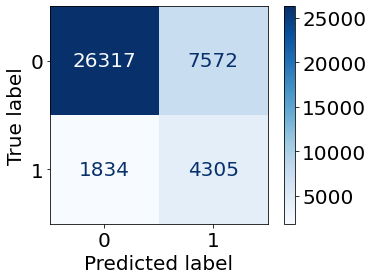

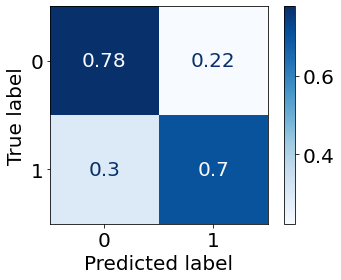

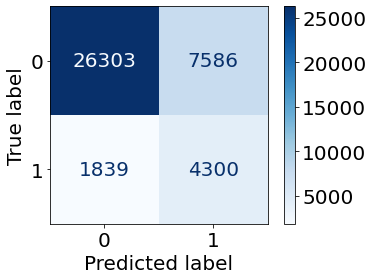

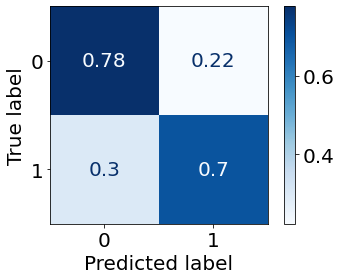

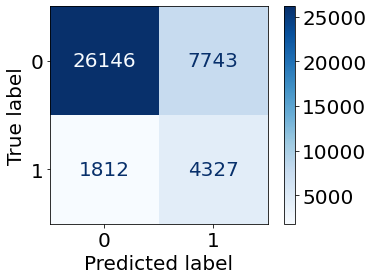

...

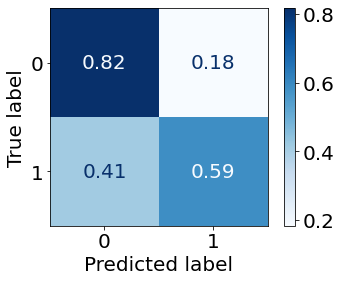

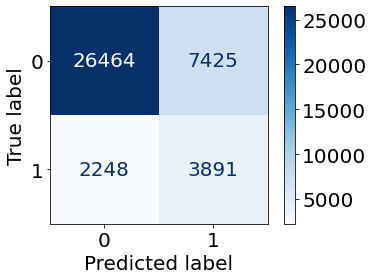

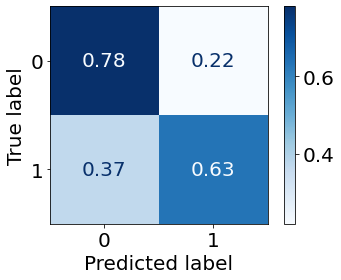

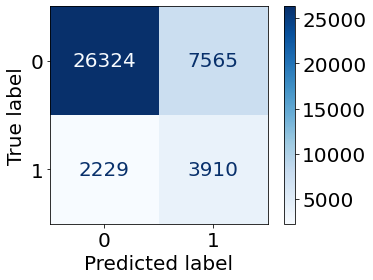

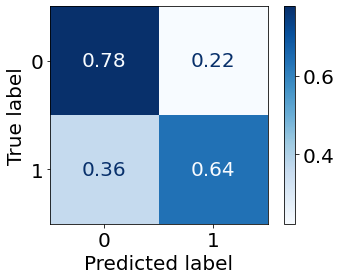

In [41]:
random_state = 1
path = "Performance/Age_30_34-Validation-Set-Performance-LR-Trial-2/"


df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)

for n in range(1, 30):
    df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 3, n=n)

    X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2021_DP = df_train_2021_DP['Diabetes']
    print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

    train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                         X_validation_2021, y_validation_2021, 
                         X_validation_2021, y_validation_2021,
                         "2021", "Age-30_34-DP-" + str(n), "1", df_validation_2021,
                    save_dir = path)

In [42]:
import os
import pandas as pd


# Get a list of all CSV files in the directory
path = "Performance/Age_30_34-Validation-Set-Performance-LR-Trial-2/"

csv_files = [file for file in os.listdir(path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "30-34"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "30-34"]["Class 1 AU_PRC"].to_list()[0]
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv(path + "ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
19,2021 Age-30_34-DP-20.csv,0.741177,0.204980
23,2021 Age-30_34-DP-24.csv,0.739421,0.205768
20,2021 Age-30_34-DP-21.csv,0.736543,0.205225
21,2021 Age-30_34-DP-22.csv,0.736111,0.205325
24,2021 Age-30_34-DP-25.csv,0.735228,0.207975
18,2021 Age-30_34-DP-19.csv,0.735210,0.205084
25,2021 Age-30_34-DP-26.csv,0.731698,0.207846
26,2021 Age-30_34-DP-27.csv,0.731680,0.207745
22,2021 Age-30_34-DP-23.csv,0.729694,0.205106
27,2021 Age-30_34-DP-28.csv,0.728838,0.207750


Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (4752, 50)  # of DP units 24
New training set:  (124833, 50)
(124833, 48) (120081, 48) (40027, 48)
accuracy 0.782172033877133
              precision    recall  f1-score   support

         0.0       0.92      0.82      0.86     33930
         1.0       0.37      0.59      0.45      6097

    accuracy                           0.78     40027
   macro avg       0.64      0.71      0.66     40027
weighted avg       0.83      0.78      0.80     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.5948827292110874
Class 1 Precision: 0.3672539489671932
Class 1 Area Under Precision-Recall Curve: 0.4100150256652534
Class 1 F1-Score: 0.4541413635509923
Class 0 Recall: 0.8158267020335986
Class 0 Precision: 0.9180790023548141
Class 0 Area Under Precision-Recall Curve: 0.7310409936876122
Class 0 F1-Score: 0.86393

Class 1 Recall: 0.7206477732793523
Class 1 Precision: 0.356
Class 1 Area Under Precision-Recall Curve: 0.4408865338021324
Class 1 F1-Score: 0.47657295850066933
Class 0 Recall: 0.7127564674397859
Class 0 Precision: 0.9205069124423964
Class 0 Area Under Precision-Recall Curve: 0.6914531294407081
Class 0 F1-Score: 0.8034188034188035
Overall Accuracy: 0.7141812865497076
Balanced Accuracy: 0.7167021203595692
Area Under ROC Curve: 0.7846892414595124
Matthews Correlation Coefficient: 0.34617808775352893
0.7206477732793523
0.356
0.4408865338021324
0.47657295850066933
0.7127564674397859
0.9205069124423964
0.6914531294407081
0.8034188034188035
0.7141812865497076
0.7167021203595692
0.7846892414595124
0.34617808775352893
============================  30-34 ============================ 
Class 1 Recall: 0.6307692307692307
Class 1 Precision: 0.0951276102088167
Class 1 Area Under Precision-Recall Curve: 0.17514764602763946
Class 1 F1-Score: 0.16532258064516128
Class 0 Recall: 0.8225659690627843
Class 

============================  80-99 ============================ 
Class 1 Recall: 0.4826388888888889
Class 1 Precision: 0.36103896103896105
Class 1 Area Under Precision-Recall Curve: 0.4033131592891285
Class 1 F1-Score: 0.41307578008915313
Class 0 Recall: 0.7842105263157895
Class 0 Precision: 0.8571428571428571
Class 0 Area Under Precision-Recall Curve: 0.6870661570915573
Class 0 F1-Score: 0.8190563444800733
Overall Accuracy: 0.7233893557422969
Balanced Accuracy: 0.6334247076023392
Area Under ROC Curve: 0.7264452363547758
Matthews Correlation Coefficient: 0.2412917126428333
0.4826388888888889
0.36103896103896105
0.4033131592891285
0.41307578008915313
0.7842105263157895
0.8571428571428571
0.6870661570915573
0.8190563444800733
0.7233893557422969
0.6334247076023392
0.7264452363547758
0.2412917126428333


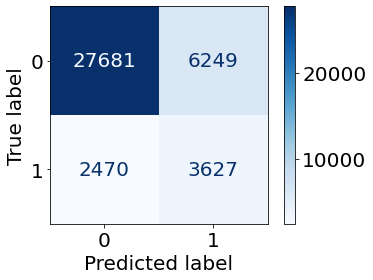

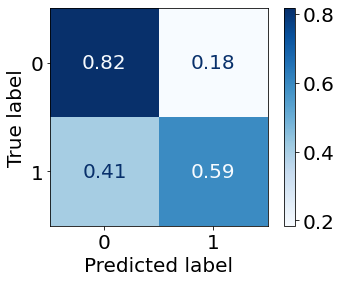

In [68]:
n = 24
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 3, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-30_34-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_30_34-Test-Set-Performance-LR-Trial-2/")

## Trial 3

(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (198, 50)  # of DP units 1
New training set:  (120279, 50)
(120279, 48) (120081, 48) (40027, 48)
accuracy 0.7740331767762566
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     33965
         1.0       0.37      0.69      0.48      6063

    accuracy                           0.77     40028
   macro avg       0.65      0.74      0.67     40028
weighted avg       0.85      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6902523503216229
Class 1 Precision: 0.36865750528541225
Class 1 Area Under Precision-Recall Curve: 0.44009884553812784
Class 1 F1-Score: 0.4806201550387597
Class 0 Recall: 0.788988664802002
Class 0 Precision: 0.9345096945180639


Class 1 Recall: 0.7470588235294118
Class 1 Precision: 0.40618336886993606
Class 1 Area Under Precision-Recall Curve: 0.5225627492604202
Class 1 F1-Score: 0.5262430939226519
Class 0 Recall: 0.7541924095322153
Class 0 Precision: 0.9298150163220892
Class 0 Area Under Precision-Recall Curve: 0.667824793844805
Class 0 F1-Score: 0.8328460038986355
Overall Accuracy: 0.7528818443804035
Balanced Accuracy: 0.7506256165308136
Area Under ROC Curve: 0.8323226554522957
Matthews Correlation Coefficient: 0.4103895769682976
0.7470588235294118
0.40618336886993606
0.5225627492604202
0.5262430939226519
0.7541924095322153
0.9298150163220892
0.667824793844805
0.8328460038986355
0.7528818443804035
0.7506256165308136
0.8323226554522957
0.4103895769682976
============================  30-34 ============================ 
Class 1 Recall: 0.26229508196721313
Class 1 Precision: 0.1702127659574468
Class 1 Area Under Precision-Recall Curve: 0.15765058798993753
Class 1 F1-Score: 0.2064516129032258
Class 0 Recall: 0.9

============================  80-99 ============================ 
Class 1 Recall: 0.7476808905380334
Class 1 Precision: 0.28744650499286734
Class 1 Area Under Precision-Recall Curve: 0.37689395592677766
Class 1 F1-Score: 0.4152498712004121
Class 0 Recall: 0.5571808510638298
Class 0 Precision: 0.9023689877961235
Class 0 Area Under Precision-Recall Curve: 0.701010616160483
Class 0 F1-Score: 0.6889558783228281
Overall Accuracy: 0.59391771019678
Balanced Accuracy: 0.6524308708009317
Area Under ROC Curve: 0.7210904913222542
Matthews Correlation Coefficient: 0.2405566081292876
0.7476808905380334
0.28744650499286734
0.37689395592677766
0.4152498712004121
0.5571808510638298
0.9023689877961235
0.701010616160483
0.6889558783228281
0.59391771019678
0.6524308708009317
0.7210904913222542
0.2405566081292876
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (396, 50)  # of DP units 2
New training set:  (120477, 50)
(1

Class 1 Recall: 0.7490196078431373
Class 1 Precision: 0.40552016985138006
Class 1 Area Under Precision-Recall Curve: 0.5217533439835516
Class 1 F1-Score: 0.5261707988980716
Class 0 Recall: 0.7528684907325685
Class 0 Precision: 0.9302071973827699
Class 0 Area Under Precision-Recall Curve: 0.6680971088931886
Class 0 F1-Score: 0.8321951219512195
Overall Accuracy: 0.7521613832853026
Balanced Accuracy: 0.7509440492878529
Area Under ROC Curve: 0.8312938061367531
Matthews Correlation Coefficient: 0.4104845551064926
0.7490196078431373
0.40552016985138006
0.5217533439835516
0.5261707988980716
0.7528684907325685
0.9302071973827699
0.6680971088931886
0.8321951219512195
0.7521613832853026
0.7509440492878529
0.8312938061367531
0.4104845551064926
============================  30-34 ============================ 
Class 1 Recall: 0.2786885245901639
Class 1 Precision: 0.1559633027522936
Class 1 Area Under Precision-Recall Curve: 0.1566992563708284
Class 1 F1-Score: 0.2
Class 0 Recall: 0.9566650965614696

Class 1 Recall: 0.7309833024118738
Class 1 Precision: 0.29120473022912047
Class 1 Area Under Precision-Recall Curve: 0.37553765352346613
Class 1 F1-Score: 0.4164904862579281
Class 0 Recall: 0.5749113475177305
Class 0 Precision: 0.8994452149791956
Class 0 Area Under Precision-Recall Curve: 0.7013778348664514
Class 0 F1-Score: 0.7014602487831261
Overall Accuracy: 0.6050089445438283
Balanced Accuracy: 0.6529473249648021
Area Under ROC Curve: 0.7208955874419399
Matthews Correlation Coefficient: 0.24149285341101936
0.7309833024118738
0.29120473022912047
0.37553765352346613
0.4164904862579281
0.5749113475177305
0.8994452149791956
0.7013778348664514
0.7014602487831261
0.6050089445438283
0.6529473249648021
0.7208955874419399
0.24149285341101936
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (594, 50)  # of DP units 3
New training set:  (120675, 50)
(120675, 48) (120081, 48) (40027, 48)
accuracy 0.77158489057

Class 1 Recall: 0.7549019607843137
Class 1 Precision: 0.4002079002079002
Class 1 Area Under Precision-Recall Curve: 0.5207143570759878
Class 1 F1-Score: 0.5230978260869565
Class 0 Recall: 0.7453662842012356
Class 0 Precision: 0.9310915104740904
Class 0 Area Under Precision-Recall Curve: 0.6684282334004035
Class 0 F1-Score: 0.8279411764705882
Overall Accuracy: 0.7471181556195965
Balanced Accuracy: 0.7501341224927747
Area Under ROC Curve: 0.8300797812505408
Matthews Correlation Coefficient: 0.40711002781388994
0.7549019607843137
0.4002079002079002
0.5207143570759878
0.5230978260869565
0.7453662842012356
0.9310915104740904
0.6684282334004035
0.8279411764705882
0.7471181556195965
0.7501341224927747
0.8300797812505408
0.40711002781388994
============================  30-34 ============================ 
Class 1 Recall: 0.32786885245901637
Class 1 Precision: 0.15873015873015872
Class 1 Area Under Precision-Recall Curve: 0.154846263499748
Class 1 F1-Score: 0.21390374331550802
Class 0 Recall: 0

============================  80-99 ============================ 
Class 1 Recall: 0.7217068645640075
Class 1 Precision: 0.29138576779026215
Class 1 Area Under Precision-Recall Curve: 0.37498598918182624
Class 1 F1-Score: 0.415154749199573
Class 0 Recall: 0.5806737588652482
Class 0 Precision: 0.8972602739726028
Class 0 Area Under Precision-Recall Curve: 0.7015639744700322
Class 0 F1-Score: 0.7050592034445641
Overall Accuracy: 0.607871198568873
Balanced Accuracy: 0.6511903117146278
Area Under ROC Curve: 0.7206735450466453
Matthews Correlation Coefficient: 0.23883657114377707
0.7217068645640075
0.29138576779026215
0.37498598918182624
0.415154749199573
0.5806737588652482
0.8972602739726028
0.7015639744700322
0.7050592034445641
0.607871198568873
0.6511903117146278
0.7206735450466453
0.23883657114377707
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (792, 50)  # of DP units 4
New training set:  (120873, 50

Class 1 Recall: 0.3442622950819672
Class 1 Precision: 0.14893617021276595
Class 1 Area Under Precision-Recall Curve: 0.15533090365808003
Class 1 F1-Score: 0.2079207920792079
Class 0 Recall: 0.9434762129062647
Class 0 Precision: 0.9804209495839452
Class 0 Area Under Precision-Recall Curve: 0.9338333044912216
Class 0 F1-Score: 0.9615938550168026
Overall Accuracy: 0.9267399267399268
Balanced Accuracy: 0.643869253994116
Area Under ROC Curve: 0.824857339212219
Matthews Correlation Coefficient: 0.1929275113817639
0.3442622950819672
0.14893617021276595
0.15533090365808003
0.2079207920792079
0.9434762129062647
0.9804209495839452
0.9338333044912216
0.9615938550168026
0.9267399267399268
0.643869253994116
0.824857339212219
0.1929275113817639
============================  35-39 ============================ 
Class 1 Recall: 0.47580645161290325
Class 1 Precision: 0.23694779116465864
Class 1 Area Under Precision-Recall Curve: 0.2813838613140337
Class 1 F1-Score: 0.3163538873994638
Class 0 Recall: 0.9

(121071, 48) (120081, 48) (40027, 48)
accuracy 0.774632757070051
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     33965
         1.0       0.37      0.68      0.48      6063

    accuracy                           0.77     40028
   macro avg       0.65      0.73      0.67     40028
weighted avg       0.85      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.677717301665842
Class 1 Precision: 0.3676628489620616
Class 1 Area Under Precision-Recall Curve: 0.4397182381066054
Class 1 F1-Score: 0.47670978595046115
Class 0 Recall: 0.791932872074194
Class 0 Precision: 0.932275058921392
Class 0 Area Under Precision-Recall Curve: 0.7235576829206951
Class 0 F1-Score: 0.8563923778594966
Overall Accuracy: 0.774632757070051
Balanced Accuracy: 0.734825086870018
Area Under ROC Curve: 0.8204505836564349
Matthews Correlation Coefficient: 0.3753210499674736
0.677717301665842


Class 1 Recall: 0.7490196078431373
Class 1 Precision: 0.3942208462332301
Class 1 Area Under Precision-Recall Curve: 0.5173429291262286
Class 1 F1-Score: 0.5165652467883705
Class 0 Recall: 0.7409532215357458
Class 0 Precision: 0.9291643608190371
Class 0 Area Under Precision-Recall Curve: 0.6693435801193719
Class 0 F1-Score: 0.82445371961699
Overall Accuracy: 0.7424351585014409
Balanced Accuracy: 0.7449864146894416
Area Under ROC Curve: 0.8271143762006126
Matthews Correlation Coefficient: 0.39805774063403826
0.7490196078431373
0.3942208462332301
0.5173429291262286
0.5165652467883705
0.7409532215357458
0.9291643608190371
0.6693435801193719
0.82445371961699
0.7424351585014409
0.7449864146894416
0.8271143762006126
0.39805774063403826
============================  30-34 ============================ 
Class 1 Recall: 0.3770491803278688
Class 1 Precision: 0.14935064935064934
Class 1 Area Under Precision-Recall Curve: 0.15468570143878316
Class 1 F1-Score: 0.21395348837209302
Class 0 Recall: 0.93

Class 1 Recall: 0.7050092764378478
Class 1 Precision: 0.30448717948717946
Class 1 Area Under Precision-Recall Curve: 0.37479806866261833
Class 1 F1-Score: 0.4252937884722999
Class 0 Recall: 0.6152482269503546
Class 0 Precision: 0.8972204266321914
Class 0 Area Under Precision-Recall Curve: 0.7016758384619158
Class 0 F1-Score: 0.7299500394425454
Overall Accuracy: 0.6325581395348837
Balanced Accuracy: 0.6601287516941012
Area Under ROC Curve: 0.720214657429703
Matthews Correlation Coefficient: 0.25416210250586263
0.7050092764378478
0.30448717948717946
0.37479806866261833
0.4252937884722999
0.6152482269503546
0.8972204266321914
0.7016758384619158
0.7299500394425454
0.6325581395348837
0.6601287516941012
0.720214657429703
0.25416210250586263
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (1188, 50)  # of DP units 6
New training set:  (121269, 50)
(121269, 48) (120081, 48) (40027, 48)
accuracy 0.769161586889

Class 1 Recall: 0.7568627450980392
Class 1 Precision: 0.3844621513944223
Class 1 Area Under Precision-Recall Curve: 0.51566950331886
Class 1 F1-Score: 0.5099075297225891
Class 0 Recall: 0.7272727272727273
Class 0 Precision: 0.9300225733634312
Class 0 Area Under Precision-Recall Curve: 0.6698277065034184
Class 0 F1-Score: 0.8162456661713718
Overall Accuracy: 0.7327089337175793
Balanced Accuracy: 0.7420677361853832
Area Under ROC Curve: 0.8255282695602513
Matthews Correlation Coefficient: 0.3901963746295368
0.7568627450980392
0.3844621513944223
0.51566950331886
0.5099075297225891
0.7272727272727273
0.9300225733634312
0.6698277065034184
0.8162456661713718
0.7327089337175793
0.7420677361853832
0.8255282695602513
0.3901963746295368
============================  30-34 ============================ 
Class 1 Recall: 0.4262295081967213
Class 1 Precision: 0.14772727272727273
Class 1 Area Under Precision-Recall Curve: 0.15436214125289835
Class 1 F1-Score: 0.21940928270042193
Class 0 Recall: 0.9293

Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (1386, 50)  # of DP units 7
New training set:  (121467, 50)
(121467, 48) (120081, 48) (40027, 48)
accuracy 0.7688118317177975
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33965
         1.0       0.36      0.69      0.47      6063

    accuracy                           0.77     40028
   macro avg       0.65      0.74      0.66     40028
weighted avg       0.85      0.77      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6876133927098796
Class 1 Precision: 0.3616098534131321
Class 1 Area Under Precision-Recall Curve: 0.4365544449808043
Class 1 F1-Score: 0.47396543883583453
Class 0 Recall: 0.7833063447666716
Class 0 Precision: 0.9335415277729043
Class 0 Area Under Precision-Recall Curve: 0.7252687584334567
Class 0 F1-Score: 0.8518506659836066
Overall Accuracy: 0.76881183

Class 1 Recall: 0.7607843137254902
Class 1 Precision: 0.381139489194499
Class 1 Area Under Precision-Recall Curve: 0.5138095637044623
Class 1 F1-Score: 0.5078534031413613
Class 0 Recall: 0.7219770520741394
Class 0 Precision: 0.9306029579067122
Class 0 Area Under Precision-Recall Curve: 0.6703676195176498
Class 0 F1-Score: 0.8131212723658052
Overall Accuracy: 0.729106628242075
Balanced Accuracy: 0.7413806828998148
Area Under ROC Curve: 0.8237786200093453
Matthews Correlation Coefficient: 0.3879396983299073
0.7607843137254902
0.381139489194499
0.5138095637044623
0.5078534031413613
0.7219770520741394
0.9306029579067122
0.6703676195176498
0.8131212723658052
0.729106628242075
0.7413806828998148
0.8237786200093453
0.3879396983299073
============================  30-34 ============================ 
Class 1 Recall: 0.45901639344262296
Class 1 Precision: 0.14507772020725387
Class 1 Area Under Precision-Recall Curve: 0.1534478751913736
Class 1 F1-Score: 0.22047244094488186
Class 0 Recall: 0.9222

============================  80-99 ============================ 
Class 1 Recall: 0.699443413729128
Class 1 Precision: 0.3075040783034258
Class 1 Area Under Precision-Recall Curve: 0.3742473653880849
Class 1 F1-Score: 0.4271954674220963
Class 0 Recall: 0.6236702127659575
Class 0 Precision: 0.8967495219885278
Class 0 Area Under Precision-Recall Curve: 0.7019137345683069
Class 0 F1-Score: 0.7356862745098041
Overall Accuracy: 0.6382826475849732
Balanced Accuracy: 0.6615568132475427
Area Under ROC Curve: 0.7197607040882116
Matthews Correlation Coefficient: 0.25689904926840573
0.699443413729128
0.3075040783034258
0.3742473653880849
0.4271954674220963
0.6236702127659575
0.8967495219885278
0.7019137345683069
0.7356862745098041
0.6382826475849732
0.6615568132475427
0.7197607040882116
0.25689904926840573
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (1584, 50)  # of DP units 8
New training set:  (121665, 50)

Class 1 Recall: 0.7666666666666667
Class 1 Precision: 0.3763233878729548
Class 1 Area Under Precision-Recall Curve: 0.512054624598375
Class 1 F1-Score: 0.5048418334409296
Class 0 Recall: 0.7140335392762577
Class 0 Precision: 0.9314910765687968
Class 0 Area Under Precision-Recall Curve: 0.6709145007968496
Class 0 F1-Score: 0.8083937047214589
Overall Accuracy: 0.7237031700288185
Balanced Accuracy: 0.7403501029714622
Area Under ROC Curve: 0.8219666683972795
Matthews Correlation Coefficient: 0.38466410860562616
0.7666666666666667
0.3763233878729548
0.512054624598375
0.5048418334409296
0.7140335392762577
0.9314910765687968
0.6709145007968496
0.8083937047214589
0.7237031700288185
0.7403501029714622
0.8219666683972795
0.38466410860562616
============================  30-34 ============================ 
Class 1 Recall: 0.47540983606557374
Class 1 Precision: 0.1336405529953917
Class 1 Area Under Precision-Recall Curve: 0.15324047466371812
Class 1 F1-Score: 0.2086330935251799
Class 0 Recall: 0.9

Balanced Accuracy: 0.6921176968537881
Area Under ROC Curve: 0.7586944866830745
Matthews Correlation Coefficient: 0.32899098909369556
0.7275320970042796
0.39504260263361735
0.47622669950952007
0.5120481927710843
0.6567032967032967
0.886646884272997
0.6328035358970082
0.7545454545454545
0.6733870967741935
0.6921176968537881
0.7586944866830745
0.32899098909369556
============================  80-99 ============================ 
Class 1 Recall: 0.6975881261595547
Class 1 Precision: 0.30895645028759244
Class 1 Area Under Precision-Recall Curve: 0.3736163049649631
Class 1 F1-Score: 0.42824601366742593
Class 0 Recall: 0.6272163120567376
Class 0 Precision: 0.8967046894803549
Class 0 Area Under Precision-Recall Curve: 0.7021106117751283
Class 0 F1-Score: 0.7381324986958789
Overall Accuracy: 0.6407871198568873
Balanced Accuracy: 0.6624022191081461
Area Under ROC Curve: 0.7194621804234266
Matthews Correlation Coefficient: 0.2584562844375244
0.6975881261595547
0.30895645028759244
0.373616304964963

Class 1 Recall: 0.7392156862745098
Class 1 Precision: 0.38666666666666666
Class 1 Area Under Precision-Recall Curve: 0.50971701484973
Class 1 F1-Score: 0.5077441077441077
Class 0 Recall: 0.736098852603707
Class 0 Precision: 0.926152137701277
Class 0 Area Under Precision-Recall Curve: 0.6715392264794884
Class 0 F1-Score: 0.8202606343742317
Overall Accuracy: 0.736671469740634
Balanced Accuracy: 0.7376572694391084
Area Under ROC Curve: 0.8200716473703338
Matthews Correlation Coefficient: 0.38559995558944804
0.7392156862745098
0.38666666666666666
0.50971701484973
0.5077441077441077
0.736098852603707
0.926152137701277
0.6715392264794884
0.8202606343742317
0.736671469740634
0.7376572694391084
0.8200716473703338
0.38559995558944804
============================  30-34 ============================ 
Class 1 Recall: 0.45901639344262296
Class 1 Precision: 0.13592233009708737
Class 1 Area Under Precision-Recall Curve: 0.15157080861229424
Class 1 F1-Score: 0.2097378277153558
Class 0 Recall: 0.916156

============================  80-99 ============================ 
Class 1 Recall: 0.6512059369202227
Class 1 Precision: 0.32290708371665133
Class 1 Area Under Precision-Recall Curve: 0.3731042641935455
Class 1 F1-Score: 0.4317343173431734
Class 0 Recall: 0.6737588652482269
Class 0 Precision: 0.8899297423887588
Class 0 Area Under Precision-Recall Curve: 0.7022765241264489
Class 0 F1-Score: 0.7669021190716448
Overall Accuracy: 0.6694096601073345
Balanced Accuracy: 0.6624824010842247
Area Under ROC Curve: 0.7191825714812037
Matthews Correlation Coefficient: 0.2629914011702765
0.6512059369202227
0.32290708371665133
0.3731042641935455
0.4317343173431734
0.6737588652482269
0.8899297423887588
0.7022765241264489
0.7669021190716448
0.6694096601073345
0.6624824010842247
0.7191825714812037
0.2629914011702765
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (1980, 50)  # of DP units 10
New training set:  (122061, 

Class 1 Recall: 0.7431372549019608
Class 1 Precision: 0.3832153690596562
Class 1 Area Under Precision-Recall Curve: 0.5069862104223849
Class 1 F1-Score: 0.505670446964643
Class 0 Recall: 0.7308031774051191
Class 0 Precision: 0.9266927811975377
Class 0 Area Under Precision-Recall Curve: 0.6722037201583102
Class 0 F1-Score: 0.8171724648408586
Overall Accuracy: 0.7330691642651297
Balanced Accuracy: 0.73697021615354
Area Under ROC Curve: 0.8181463406192133
Matthews Correlation Coefficient: 0.3832466604008207
0.7431372549019608
0.3832153690596562
0.5069862104223849
0.505670446964643
0.7308031774051191
0.9266927811975377
0.6722037201583102
0.8171724648408586
0.7330691642651297
0.73697021615354
0.8181463406192133
0.3832466604008207
============================  30-34 ============================ 
Class 1 Recall: 0.47540983606557374
Class 1 Precision: 0.12719298245614036
Class 1 Area Under Precision-Recall Curve: 0.1508803995419486
Class 1 F1-Score: 0.20069204152249137
Class 0 Recall: 0.906264

Class 1 Recall: 0.6493506493506493
Class 1 Precision: 0.3246753246753247
Class 1 Area Under Precision-Recall Curve: 0.372632775991185
Class 1 F1-Score: 0.4329004329004329
Class 0 Recall: 0.6773049645390071
Class 0 Precision: 0.8899242865463017
Class 0 Area Under Precision-Recall Curve: 0.7024408373820463
Class 0 F1-Score: 0.7691920463126102
Overall Accuracy: 0.6719141323792487
Balanced Accuracy: 0.6633278069448283
Area Under ROC Curve: 0.7188618435768892
Matthews Correlation Coefficient: 0.2647643626776118
0.6493506493506493
0.3246753246753247
0.372632775991185
0.4329004329004329
0.6773049645390071
0.8899242865463017
0.7024408373820463
0.7691920463126102
0.6719141323792487
0.6633278069448283
0.7188618435768892
0.2647643626776118
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (2178, 50)  # of DP units 11
New training set:  (122259, 50)
(122259, 48) (120081, 48) (40027, 48)
accuracy 0.7750574597781553


/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_plot/confusion_matrix.py:114: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


============================  Over all performance ============================ 
Class 1 Recall: 0.657100445324097
Class 1 Precision: 0.36520304335869463
Class 1 Area Under Precision-Recall Curve: 0.43246573465529015
Class 1 F1-Score: 0.4694791421164271
Class 0 Recall: 0.7961136464007066
Class 0 Precision: 0.9286033174216147
Class 0 Area Under Precision-Recall Curve: 0.7259139020051487
Class 0 F1-Score: 0.8572696721831208
Overall Accuracy: 0.7750574597781553
Balanced Accuracy: 0.7266070458624018
Area Under ROC Curve: 0.8141178356439388
Matthews Correlation Coefficient: 0.36490708809780315
0.657100445324097
0.36520304335869463
0.43246573465529015
0.4694791421164271
0.7961136464007066
0.9286033174216147
0.7259139020051487
0.8572696721831208
0.7750574597781553
0.7266070458624018
0.8141178356439388
0.36490708809780315
============================  Male ============================ 
Class 1 Recall: 0.6675257731958762
Class 1 Precision: 0.35674931129476584
Class 1 Area Under Precision-Recall

Class 1 Recall: 0.5804878048780487
Class 1 Precision: 0.25
Class 1 Area Under Precision-Recall Curve: 0.30718902620944666
Class 1 F1-Score: 0.34948604992657856
Class 0 Recall: 0.8763422237616904
Class 0 Precision: 0.9671253822629969
Class 0 Area Under Precision-Recall Curve: 0.8508360398151101
Class 0 F1-Score: 0.9194984553879701
Overall Accuracy: 0.8567270375161707
Balanced Accuracy: 0.7284150143198695
Area Under ROC Curve: 0.8466768609494201
Matthews Correlation Coefficient: 0.31494347841734904
0.5804878048780487
0.25
0.30718902620944666
0.34948604992657856
0.8763422237616904
0.9671253822629969
0.8508360398151101
0.9194984553879701
0.8567270375161707
0.7284150143198695
0.8466768609494201
0.31494347841734904
============================  45-49 ============================ 
Class 1 Recall: 0.6270096463022508
Class 1 Precision: 0.33276450511945393
Class 1 Area Under Precision-Recall Curve: 0.37292473306712565
Class 1 F1-Score: 0.4347826086956522
Class 0 Recall: 0.8642832349878514
Class 

Class 1 Recall: 0.6446520618556701
Class 1 Precision: 0.3689839572192513
Class 1 Area Under Precision-Recall Curve: 0.4382778579652061
Class 1 F1-Score: 0.4693327078691217
Class 0 Recall: 0.7870566272557561
Class 0 Precision: 0.9197876518071413
Class 0 Area Under Precision-Recall Curve: 0.7105398491459405
Class 0 F1-Score: 0.8482612923778545
Overall Accuracy: 0.7640033378533431
Balanced Accuracy: 0.7158543445557131
Area Under ROC Curve: 0.7969790771207154
Matthews Correlation Coefficient: 0.3530796125314817
0.6446520618556701
0.3689839572192513
0.4382778579652061
0.4693327078691217
0.7870566272557561
0.9197876518071413
0.7105398491459405
0.8482612923778545
0.7640033378533431
0.7158543445557131
0.7969790771207154
0.3530796125314817
============================  Female ============================ 
Class 1 Recall: 0.6184521797904697
Class 1 Precision: 0.3832460732984293
Class 1 Area Under Precision-Recall Curve: 0.4362766209346115
Class 1 F1-Score: 0.47323506594259124
Class 0 Recall: 0.8

Class 1 Recall: 0.5609756097560976
Class 1 Precision: 0.25555555555555554
Class 1 Area Under Precision-Recall Curve: 0.3062298343561381
Class 1 F1-Score: 0.3511450381679389
Class 0 Recall: 0.8839625909248354
Class 0 Precision: 0.9659348978046934
Class 0 Area Under Precision-Recall Curve: 0.8509860377540683
Class 0 F1-Score: 0.923132573702297
Overall Accuracy: 0.86254851228978
Balanced Accuracy: 0.7224691003404665
Area Under ROC Curve: 0.8464943776559346
Matthews Correlation Coefficient: 0.31392604827588505
0.5609756097560976
0.25555555555555554
0.3062298343561381
0.3511450381679389
0.8839625909248354
0.9659348978046934
0.8509860377540683
0.923132573702297
0.86254851228978
0.7224691003404665
0.8464943776559346
0.31392604827588505
============================  45-49 ============================ 
Class 1 Recall: 0.6109324758842444
Class 1 Precision: 0.34172661870503596
Class 1 Area Under Precision-Recall Curve: 0.37253784681976715
Class 1 F1-Score: 0.4382929642445213
Class 0 Recall: 0.872

Class 1 Recall: 0.647229381443299
Class 1 Precision: 0.3646098003629764
Class 1 Area Under Precision-Recall Curve: 0.4362670928428116
Class 1 F1-Score: 0.46644996517297416
Class 0 Recall: 0.7821406347230865
Class 0 Precision: 0.9198624121779859
Class 0 Area Under Precision-Recall Curve: 0.7110817445319213
Class 0 F1-Score: 0.8454294746754557
Overall Accuracy: 0.7603004068008762
Balanced Accuracy: 0.7146850080831928
Area Under ROC Curve: 0.7954180105241885
Matthews Correlation Coefficient: 0.34949082748707505
0.647229381443299
0.3646098003629764
0.4362670928428116
0.46644996517297416
0.7821406347230865
0.9198624121779859
0.7110817445319213
0.8454294746754557
0.7603004068008762
0.7146850080831928
0.7954180105241885
0.34949082748707505
============================  Female ============================ 
Class 1 Recall: 0.6214937478878
Class 1 Precision: 0.37995867768595043
Class 1 Area Under Precision-Recall Curve: 0.4351159549150903
Class 1 F1-Score: 0.4715989229388383
Class 0 Recall: 0.83

Class 1 Recall: 0.5887096774193549
Class 1 Precision: 0.1994535519125683
Class 1 Area Under Precision-Recall Curve: 0.28017242263975584
Class 1 F1-Score: 0.2979591836734694
Class 0 Recall: 0.8895173453996983
Class 0 Precision: 0.9788381742738589
Class 0 Area Under Precision-Recall Curve: 0.8911519165256261
Class 0 F1-Score: 0.9320426708810745
Overall Accuracy: 0.8760806916426513
Balanced Accuracy: 0.7391135114095266
Area Under ROC Curve: 0.8457494039799544
Matthews Correlation Coefficient: 0.29199986542360756
0.5887096774193549
0.1994535519125683
0.28017242263975584
0.2979591836734694
0.8895173453996983
0.9788381742738589
0.8911519165256261
0.9320426708810745
0.8760806916426513
0.7391135114095266
0.8457494039799544
0.29199986542360756
============================  40-44 ============================ 
Class 1 Recall: 0.5756097560975609
Class 1 Precision: 0.2489451476793249
Class 1 Area Under Precision-Recall Curve: 0.30596728265164125
Class 1 F1-Score: 0.3475699558173785
Class 0 Recall: 

accuracy 0.7823273708404117
              precision    recall  f1-score   support

         0.0       0.92      0.81      0.86     33965
         1.0       0.37      0.63      0.47      6063

    accuracy                           0.78     40028
   macro avg       0.65      0.72      0.67     40028
weighted avg       0.84      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6312056737588653
Class 1 Precision: 0.3714091614906832
Class 1 Area Under Precision-Recall Curve: 0.42619943455932385
Class 1 F1-Score: 0.4676483167348933
Class 0 Recall: 0.8093036949801266
Class 0 Precision: 0.9247745929215448
Class 0 Area Under Precision-Recall Curve: 0.72721804639182
Class 0 F1-Score: 0.8631945861922781
Overall Accuracy: 0.7823273708404117
Balanced Accuracy: 0.7202546843694959
Area Under ROC Curve: 0.8104170647088732
Matthews Correlation Coefficient: 0.36120869132244754
0.6312056737588653
0.3714091614906832
0.42619943455

Class 1 Recall: 0.7313725490196078
Class 1 Precision: 0.382172131147541
Class 1 Area Under Precision-Recall Curve: 0.4959460853018518
Class 1 F1-Score: 0.5020188425302826
Class 0 Recall: 0.733892321270962
Class 0 Precision: 0.9238888888888889
Class 0 Area Under Precision-Recall Curve: 0.6750083046232699
Class 0 F1-Score: 0.8180029513034924
Overall Accuracy: 0.7334293948126801
Balanced Accuracy: 0.7326324351452849
Area Under ROC Curve: 0.8100782236990118
Matthews Correlation Coefficient: 0.3773585043274486
0.7313725490196078
0.382172131147541
0.4959460853018518
0.5020188425302826
0.733892321270962
0.9238888888888889
0.6750083046232699
0.8180029513034924
0.7334293948126801
0.7326324351452849
0.8100782236990118
0.3773585043274486
============================  30-34 ============================ 
Class 1 Recall: 0.5409836065573771
Class 1 Precision: 0.1213235294117647
Class 1 Area Under Precision-Recall Curve: 0.148625469000014
Class 1 F1-Score: 0.1981981981981982
Class 0 Recall: 0.88742345

============================  80-99 ============================ 
Class 1 Recall: 0.601113172541744
Class 1 Precision: 0.34069400630914826
Class 1 Area Under Precision-Recall Curve: 0.370744285986888
Class 1 F1-Score: 0.4348993288590604
Class 0 Recall: 0.7220744680851063
Class 0 Precision: 0.8834056399132321
Class 0 Area Under Precision-Recall Curve: 0.7030639639633057
Class 0 F1-Score: 0.7946341463414635
Overall Accuracy: 0.6987477638640429
Balanced Accuracy: 0.6615938203134252
Area Under ROC Curve: 0.7177105126383243
Matthews Correlation Coefficient: 0.2691212290547198
0.601113172541744
0.34069400630914826
0.370744285986888
0.4348993288590604
0.7220744680851063
0.8834056399132321
0.7030639639633057
0.7946341463414635
0.6987477638640429
0.6615938203134252
0.7177105126383243
0.2691212290547198
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (2970, 50)  # of DP units 15
New training set:  (123051, 50)


Class 1 Recall: 0.7588235294117647
Class 1 Precision: 0.355045871559633
Class 1 Area Under Precision-Recall Curve: 0.4927566069210893
Class 1 F1-Score: 0.48375
Class 0 Recall: 0.6897616946160635
Class 0 Precision: 0.9270462633451957
Class 0 Area Under Precision-Recall Curve: 0.6757958053142836
Class 0 F1-Score: 0.790991902834008
Overall Accuracy: 0.702449567723343
Balanced Accuracy: 0.7242926120139141
Area Under ROC Curve: 0.8079573577003618
Matthews Correlation Coefficient: 0.355727934709619
0.7588235294117647
0.355045871559633
0.4927566069210893
0.48375
0.6897616946160635
0.9270462633451957
0.6757958053142836
0.790991902834008
0.702449567723343
0.7242926120139141
0.8079573577003618
0.355727934709619
============================  30-34 ============================ 
Class 1 Recall: 0.5737704918032787
Class 1 Precision: 0.09915014164305949
Class 1 Area Under Precision-Recall Curve: 0.15100532515987602
Class 1 F1-Score: 0.16908212560386474
Class 0 Recall: 0.8502119642016015
Class 0 Preci

Class 1 Recall: 0.6307977736549165
Class 1 Precision: 0.33073929961089493
Class 1 Area Under Precision-Recall Curve: 0.37043397724111826
Class 1 F1-Score: 0.43395022335673256
Class 0 Recall: 0.6950354609929078
Class 0 Precision: 0.8873797396717601
Class 0 Area Under Precision-Recall Curve: 0.7031915656993537
Class 0 F1-Score: 0.7795177728063634
Overall Accuracy: 0.6826475849731664
Balanced Accuracy: 0.6629166173239122
Area Under ROC Curve: 0.7173790938038659
Matthews Correlation Coefficient: 0.2665903826242487
0.6307977736549165
0.33073929961089493
0.37043397724111826
0.43395022335673256
0.6950354609929078
0.8873797396717601
0.7031915656993537
0.7795177728063634
0.6826475849731664
0.6629166173239122
0.7173790938038659
0.2665903826242487
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (3168, 50)  # of DP units 16
New training set:  (123249, 50)
(123249, 48) (120081, 48) (40027, 48)
accuracy 0.760517637

Class 1 Recall: 0.7627450980392156
Class 1 Precision: 0.35171790235081374
Class 1 Area Under Precision-Recall Curve: 0.49035594935466387
Class 1 F1-Score: 0.4814356435643564
Class 0 Recall: 0.6835834068843778
Class 0 Precision: 0.9275449101796407
Class 0 Area Under Precision-Recall Curve: 0.6764552846794833
Class 0 F1-Score: 0.7870934959349594
Overall Accuracy: 0.6981268011527377
Balanced Accuracy: 0.7231642524617967
Area Under ROC Curve: 0.8060259938044061
Matthews Correlation Coefficient: 0.353048089638615
0.7627450980392156
0.35171790235081374
0.49035594935466387
0.4814356435643564
0.6835834068843778
0.9275449101796407
0.6764552846794833
0.7870934959349594
0.6981268011527377
0.7231642524617967
0.8060259938044061
0.353048089638615
============================  30-34 ============================ 
Class 1 Recall: 0.5901639344262295
Class 1 Precision: 0.0962566844919786
Class 1 Area Under Precision-Recall Curve: 0.15062037662784863
Class 1 F1-Score: 0.16551724137931037
Class 0 Recall: 0

============================  80-99 ============================ 
Class 1 Recall: 0.62708719851577
Class 1 Precision: 0.33235004916420846
Class 1 Area Under Precision-Recall Curve: 0.3700044981946966
Class 1 F1-Score: 0.4344473007712083
Class 0 Recall: 0.6990248226950354
Class 0 Precision: 0.8869516310461192
Class 0 Area Under Precision-Recall Curve: 0.7033425773625568
Class 0 F1-Score: 0.7818542389687655
Overall Accuracy: 0.6851520572450805
Balanced Accuracy: 0.6630560106054026
Area Under ROC Curve: 0.7170764582428717
Matthews Correlation Coefficient: 0.2674264650110674
0.62708719851577
0.33235004916420846
0.3700044981946966
0.4344473007712083
0.6990248226950354
0.8869516310461192
0.7033425773625568
0.7818542389687655
0.6851520572450805
0.6630560106054026
0.7170764582428717
0.2674264650110674
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (3366, 50)  # of DP units 17
New training set:  (123447, 50)


Class 1 Recall: 0.7627450980392156
Class 1 Precision: 0.3491921005385996
Class 1 Area Under Precision-Recall Curve: 0.48701181292973017
Class 1 F1-Score: 0.479064039408867
Class 0 Recall: 0.6800529567519858
Class 0 Precision: 0.9271961492178099
Class 0 Area Under Precision-Recall Curve: 0.6772530516064861
Class 0 F1-Score: 0.7846232179226069
Overall Accuracy: 0.6952449567723343
Balanced Accuracy: 0.7213990273956008
Area Under ROC Curve: 0.803963968641296
Matthews Correlation Coefficient: 0.3498345028142349
0.7627450980392156
0.3491921005385996
0.48701181292973017
0.479064039408867
0.6800529567519858
0.9271961492178099
0.6772530516064861
0.7846232179226069
0.6952449567723343
0.7213990273956008
0.803963968641296
0.3498345028142349
============================  30-34 ============================ 
Class 1 Recall: 0.639344262295082
Class 1 Precision: 0.09974424552429667
Class 1 Area Under Precision-Recall Curve: 0.15025066754996177
Class 1 F1-Score: 0.17256637168141592
Class 0 Recall: 0.834

New training set:  (123645, 50)
(123645, 48) (120081, 48) (40027, 48)
accuracy 0.7577445787948436
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     33965
         1.0       0.35      0.67      0.46      6063

    accuracy                           0.76     40028
   macro avg       0.64      0.72      0.65     40028
weighted avg       0.84      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6707900379350157
Class 1 Precision: 0.3455982324949014
Class 1 Area Under Precision-Recall Curve: 0.42074838965209965
Class 1 F1-Score: 0.4561718355672704
Class 0 Recall: 0.773266597968497
Class 0 Precision: 0.9293701344656758
Class 0 Area Under Precision-Recall Curve: 0.7285358539774742
Class 0 F1-Score: 0.8441623141824025
Overall Accuracy: 0.7577445787948436
Balanced Accuracy: 0.7220283179517564
Area Under ROC Curve: 0.8052081972887896
Matthews Correlation Coefficient: 

Class 1 Recall: 0.6721311475409836
Class 1 Precision: 0.09951456310679611
Class 1 Area Under Precision-Recall Curve: 0.14953255637549695
Class 1 F1-Score: 0.1733615221987315
Class 0 Recall: 0.825247291568535
Class 0 Precision: 0.9887133182844243
Class 0 Area Under Precision-Recall Curve: 0.934900090516448
Class 0 F1-Score: 0.8996148908857509
Overall Accuracy: 0.8209706959706959
Balanced Accuracy: 0.7486892195547593
Area Under ROC Curve: 0.8181856790962372
Matthews Correlation Coefficient: 0.2094818510809588
0.6721311475409836
0.09951456310679611
0.14953255637549695
0.1733615221987315
0.825247291568535
0.9887133182844243
0.934900090516448
0.8996148908857509
0.8209706959706959
0.7486892195547593
0.8181856790962372
0.2094818510809588
============================  35-39 ============================ 
Class 1 Recall: 0.7096774193548387
Class 1 Precision: 0.16206261510128914
Class 1 Area Under Precision-Recall Curve: 0.2774107864375048
Class 1 F1-Score: 0.26386806596701645
Class 0 Recall: 0.8

Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (3762, 50)  # of DP units 19
New training set:  (123843, 50)
(123843, 48) (120081, 48) (40027, 48)
accuracy 0.7611921654841611
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33965
         1.0       0.35      0.66      0.46      6063

    accuracy                           0.76     40028
   macro avg       0.64      0.72      0.65     40028
weighted avg       0.84      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6594095332343725
Class 1 Precision: 0.3478941872607031
Class 1 Area Under Precision-Recall Curve: 0.41860688046930994
Class 1 F1-Score: 0.4554827684420394
Class 0 Recall: 0.7793611070219344
Class 0 Precision: 0.9276352677319877
Class 0 Area Under Precision-Recall Curve: 0.7292756183977815
Class 0 F1-Score: 0.847058447064847
Overall Accuracy: 0.7611921654841611
Balanced Accu

Class 1 Recall: 0.6721311475409836
Class 1 Precision: 0.09903381642512077
Class 1 Area Under Precision-Recall Curve: 0.1493441066614486
Class 1 F1-Score: 0.1726315789473684
Class 0 Recall: 0.8243052284503062
Class 0 Precision: 0.9887005649717514
Class 0 Area Under Precision-Recall Curve: 0.9349395686911919
Class 0 F1-Score: 0.8990495761623427
Overall Accuracy: 0.820054945054945
Balanced Accuracy: 0.7482181879956449
Area Under ROC Curve: 0.8178999714292333
Matthews Correlation Coefficient: 0.20869724087898445
0.6721311475409836
0.09903381642512077
0.1493441066614486
0.1726315789473684
0.8243052284503062
0.9887005649717514
0.9349395686911919
0.8990495761623427
0.820054945054945
0.7482181879956449
0.8178999714292333
0.20869724087898445
============================  35-39 ============================ 
Class 1 Recall: 0.7096774193548387
Class 1 Precision: 0.16236162361623616
Class 1 Area Under Precision-Recall Curve: 0.2767208053767877
Class 1 F1-Score: 0.26426426426426425
Class 0 Recall: 0

Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (3960, 50)  # of DP units 20
New training set:  (124041, 50)
(124041, 48) (120081, 48) (40027, 48)
accuracy 0.75034975517138
              precision    recall  f1-score   support

         0.0       0.93      0.76      0.84     33965
         1.0       0.34      0.68      0.45      6063

    accuracy                           0.75     40028
   macro avg       0.63      0.72      0.65     40028
weighted avg       0.84      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6792017153224477
Class 1 Precision: 0.338484300509617
Class 1 Area Under Precision-Recall Curve: 0.4165360341921643
Class 1 F1-Score: 0.45180755938340006
Class 0 Recall: 0.7630501987339908
Class 0 Precision: 0.9301916588902448
Class 0 Area Under Precision-Recall Curve: 0.7295987726115531
Class 0 F1-Score: 0.838371585229754
Overall Accuracy: 0.75034975517

Class 1 Recall: 0.7686274509803922
Class 1 Precision: 0.33276740237691
Class 1 Area Under Precision-Recall Curve: 0.47812084548032446
Class 1 F1-Score: 0.46445497630331756
Class 0 Recall: 0.6531332744924978
Class 0 Precision: 0.9261576971214017
Class 0 Area Under Precision-Recall Curve: 0.6795291446878212
Class 0 F1-Score: 0.7660455486542443
Overall Accuracy: 0.6743515850144092
Balanced Accuracy: 0.7108803627364451
Area Under ROC Curve: 0.7978730768565149
Matthews Correlation Coefficient: 0.3304609474772294
0.7686274509803922
0.33276740237691
0.47812084548032446
0.46445497630331756
0.6531332744924978
0.9261576971214017
0.6795291446878212
0.7660455486542443
0.6743515850144092
0.7108803627364451
0.7978730768565149
0.3304609474772294
============================  30-34 ============================ 
Class 1 Recall: 0.7213114754098361
Class 1 Precision: 0.09381663113006397
Class 1 Area Under Precision-Recall Curve: 0.148856827153508
Class 1 F1-Score: 0.1660377358490566
Class 0 Recall: 0.799

Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (4158, 50)  # of DP units 21
New training set:  (124239, 50)
(124239, 48) (120081, 48) (40027, 48)
accuracy 0.7785799940041971
              precision    recall  f1-score   support

         0.0       0.92      0.81      0.86     33965
         1.0       0.36      0.62      0.46      6063

    accuracy                           0.78     40028
   macro avg       0.64      0.71      0.66     40028
weighted avg       0.84      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6166914068942767
Class 1 Precision: 0.3637867289355906
Class 1 Area Under Precision-Recall Curve: 0.4138856018511422
Class 1 F1-Score: 0.4576219325622667
Class 0 Recall: 0.8074782864713675
Class 0 Precision: 0.9218823529411765
Class 0 Area Under Precision-Recall Curve: 0.7302996886521566
Class 0 F1-Score: 0.8608961782939654
Overall Accuracy: 0.7785799940041971
Balanced Accu

Class 1 Recall: 0.7196078431372549
Class 1 Precision: 0.35909980430528377
Class 1 Area Under Precision-Recall Curve: 0.47532856359935793
Class 1 F1-Score: 0.4791122715404699
Class 0 Recall: 0.7109443954104149
Class 0 Precision: 0.9184720638540479
Class 0 Area Under Precision-Recall Curve: 0.6802595052549739
Class 0 F1-Score: 0.8014925373134328
Overall Accuracy: 0.712536023054755
Balanced Accuracy: 0.7152761192738348
Area Under ROC Curve: 0.7959174843812193
Matthews Correlation Coefficient: 0.34570101127109665
0.7196078431372549
0.35909980430528377
0.47532856359935793
0.4791122715404699
0.7109443954104149
0.9184720638540479
0.6802595052549739
0.8014925373134328
0.712536023054755
0.7152761192738348
0.7959174843812193
0.34570101127109665
============================  30-34 ============================ 
Class 1 Recall: 0.6229508196721312
Class 1 Precision: 0.09669211195928754
Class 1 Area Under Precision-Recall Curve: 0.14792389705374626
Class 1 F1-Score: 0.16740088105726875
Class 0 Recall

0.3015360733184807
============================  80-99 ============================ 
Class 1 Recall: 0.5473098330241187
Class 1 Precision: 0.3628536285362854
Class 1 Area Under Precision-Recall Curve: 0.36754895827519296
Class 1 F1-Score: 0.4363905325443787
Class 0 Recall: 0.7703900709219859
Class 0 Precision: 0.8768920282542886
Class 0 Area Under Precision-Recall Curve: 0.7042109923239054
Class 0 F1-Score: 0.8201982067012743
Overall Accuracy: 0.7273703041144901
Balanced Accuracy: 0.6588499519730523
Area Under ROC Curve: 0.715541076198371
Matthews Correlation Coefficient: 0.27598400702551784
0.5473098330241187
0.3628536285362854
0.36754895827519296
0.4363905325443787
0.7703900709219859
0.8768920282542886
0.7042109923239054
0.8201982067012743
0.7273703041144901
0.6588499519730523
0.715541076198371
0.27598400702551784
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (4356, 50)  # of DP units 22
New train

Class 1 Recall: 0.7098039215686275
Class 1 Precision: 0.3641851106639839
Class 1 Area Under Precision-Recall Curve: 0.47192994242656244
Class 1 F1-Score: 0.4813829787234043
Class 0 Recall: 0.7210944395410415
Class 0 Precision: 0.9169472502805837
Class 0 Area Under Precision-Recall Curve: 0.6811043611160299
Class 0 F1-Score: 0.807312252964427
Overall Accuracy: 0.7190201729106628
Balanced Accuracy: 0.7154491805548344
Area Under ROC Curve: 0.793927279649724
Matthews Correlation Coefficient: 0.3480509640640377
0.7098039215686275
0.3641851106639839
0.47192994242656244
0.4813829787234043
0.7210944395410415
0.9169472502805837
0.6811043611160299
0.807312252964427
0.7190201729106628
0.7154491805548344
0.793927279649724
0.3480509640640377
============================  30-34 ============================ 
Class 1 Recall: 0.6229508196721312
Class 1 Precision: 0.09743589743589744
Class 1 Area Under Precision-Recall Curve: 0.14756008905603962
Class 1 F1-Score: 0.16851441241685144
Class 0 Recall: 0.83

Class 1 Recall: 0.5343228200371057
Class 1 Precision: 0.3673469387755102
Class 1 Area Under Precision-Recall Curve: 0.36741801168270966
Class 1 F1-Score: 0.435374149659864
Class 0 Recall: 0.7801418439716312
Class 0 Precision: 0.8751864743908503
Class 0 Area Under Precision-Recall Curve: 0.704289181707779
Class 0 F1-Score: 0.824935551910007
Overall Accuracy: 0.732737030411449
Balanced Accuracy: 0.6572323320043685
Area Under ROC Curve: 0.7152976519427888
Matthews Correlation Coefficient: 0.2761669572600092
0.5343228200371057
0.3673469387755102
0.36741801168270966
0.435374149659864
0.7801418439716312
0.8751864743908503
0.704289181707779
0.824935551910007
0.732737030411449
0.6572323320043685
0.7152976519427888
0.2761669572600092
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (4554, 50)  # of DP units 23
New training set:  (124635, 50)
(124635, 48) (120081, 48) (40027, 48)
accuracy 0.7833766363545518
    

Class 1 Recall: 0.7098039215686275
Class 1 Precision: 0.3630892678034102
Class 1 Area Under Precision-Recall Curve: 0.4693811018823023
Class 1 F1-Score: 0.4804246848042469
Class 0 Recall: 0.7197705207413946
Class 0 Precision: 0.9168071950534008
Class 0 Area Under Precision-Recall Curve: 0.6818163704291711
Class 0 F1-Score: 0.8064276885043263
Overall Accuracy: 0.7179394812680115
Balanced Accuracy: 0.714787221155011
Area Under ROC Curve: 0.7920590831213333
Matthews Correlation Coefficient: 0.3467511599638311
0.7098039215686275
0.3630892678034102
0.4693811018823023
0.4804246848042469
0.7197705207413946
0.9168071950534008
0.6818163704291711
0.8064276885043263
0.7179394812680115
0.714787221155011
0.7920590831213333
0.3467511599638311
============================  30-34 ============================ 
Class 1 Recall: 0.6557377049180327
Class 1 Precision: 0.09975062344139651
Class 1 Area Under Precision-Recall Curve: 0.14448933558050933
Class 1 F1-Score: 0.17316017316017318
Class 0 Recall: 0.82

============================  80-99 ============================ 
Class 1 Recall: 0.5287569573283859
Class 1 Precision: 0.36964980544747084
Class 1 Area Under Precision-Recall Curve: 0.36697676962303727
Class 1 F1-Score: 0.4351145038167939
Class 0 Recall: 0.7845744680851063
Class 0 Precision: 0.8745059288537549
Class 0 Area Under Precision-Recall Curve: 0.7044603906685883
Class 0 F1-Score: 0.8271028037383178
Overall Accuracy: 0.7352415026833632
Balanced Accuracy: 0.6566657127067461
Area Under ROC Curve: 0.7148864623218727
Matthews Correlation Coefficient: 0.27658934225938814
0.5287569573283859
0.36964980544747084
0.36697676962303727
0.4351145038167939
0.7845744680851063
0.8745059288537549
0.7044603906685883
0.8271028037383178
0.7352415026833632
0.6566657127067461
0.7148864623218727
0.27658934225938814
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (4752, 50)  # of DP units 24
New training set:  (1248

Class 1 Recall: 0.707843137254902
Class 1 Precision: 0.3584905660377358
Class 1 Area Under Precision-Recall Curve: 0.46628169859892676
Class 1 F1-Score: 0.4759393539881344
Class 0 Recall: 0.7149161518093556
Class 0 Precision: 0.9157716223855286
Class 0 Area Under Precision-Recall Curve: 0.6826333453408071
Class 0 F1-Score: 0.8029739776951673
Overall Accuracy: 0.7136167146974063
Balanced Accuracy: 0.7113796445321288
Area Under ROC Curve: 0.7900247477631829
Matthews Correlation Coefficient: 0.34050974698975467
0.707843137254902
0.3584905660377358
0.46628169859892676
0.4759393539881344
0.7149161518093556
0.9157716223855286
0.6826333453408071
0.8029739776951673
0.7136167146974063
0.7113796445321288
0.7900247477631829
0.34050974698975467
============================  30-34 ============================ 
Class 1 Recall: 0.6557377049180327
Class 1 Precision: 0.09501187648456057
Class 1 Area Under Precision-Recall Curve: 0.14390275808879974
Class 1 F1-Score: 0.16597510373443983
Class 0 Recall: 

============================  80-99 ============================ 
Class 1 Recall: 0.5250463821892394
Class 1 Precision: 0.36993464052287583
Class 1 Area Under Precision-Recall Curve: 0.36651275508865966
Class 1 F1-Score: 0.4340490797546012
Class 0 Recall: 0.7863475177304965
Class 0 Precision: 0.8738916256157635
Class 0 Area Under Precision-Recall Curve: 0.7046163423410461
Class 0 F1-Score: 0.8278114792347177
Overall Accuracy: 0.7359570661896243
Balanced Accuracy: 0.6556969499598679
Area Under ROC Curve: 0.7146348142738721
Matthews Correlation Coefficient: 0.2755467508713872
0.5250463821892394
0.36993464052287583
0.36651275508865966
0.4340490797546012
0.7863475177304965
0.8738916256157635
0.7046163423410461
0.8278114792347177
0.7359570661896243
0.6556969499598679
0.7146348142738721
0.2755467508713872
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (4950, 50)  # of DP units 25
New training set:  (125031

Class 1 Recall: 0.7196078431372549
Class 1 Precision: 0.34720908230842007
Class 1 Area Under Precision-Recall Curve: 0.46356813215318393
Class 1 F1-Score: 0.46841097638800255
Class 0 Recall: 0.6954986760812003
Class 0 Precision: 0.9168121000581734
Class 0 Area Under Precision-Recall Curve: 0.6833726464623704
Class 0 F1-Score: 0.7909661229611041
Overall Accuracy: 0.6999279538904899
Balanced Accuracy: 0.7075532596092275
Area Under ROC Curve: 0.7881375144938823
Matthews Correlation Coefficient: 0.3310542463285097
0.7196078431372549
0.34720908230842007
0.46356813215318393
0.46841097638800255
0.6954986760812003
0.9168121000581734
0.6833726464623704
0.7909661229611041
0.6999279538904899
0.7075532596092275
0.7881375144938823
0.3310542463285097
============================  30-34 ============================ 
Class 1 Recall: 0.7049180327868853
Class 1 Precision: 0.09287257019438445
Class 1 Area Under Precision-Recall Curve: 0.1433978032983048
Class 1 F1-Score: 0.16412213740458015
Class 0 Recal

Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (5148, 50)  # of DP units 26
New training set:  (125229, 50)
(125229, 48) (120081, 48) (40027, 48)
accuracy 0.7778055361247127
              precision    recall  f1-score   support

         0.0       0.92      0.81      0.86     33965
         1.0       0.36      0.60      0.45      6063

    accuracy                           0.78     40028
   macro avg       0.64      0.71      0.66     40028
weighted avg       0.83      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6038264885370279
Class 1 Precision: 0.36058307889293806
Class 1 Area Under Precision-Recall Curve: 0.40571401317942374
Class 1 F1-Score: 0.45152935372471636
Class 0 Recall: 0.8088620638892978
Class 0 Precision: 0.9195983263598326
Class 0 Area Under Precision-Recall Curve: 0.7327681433450277
Class 0 F1-Score: 0.8606829573934838
Overall Accuracy: 0.77780

Class 1 Recall: 0.7137254901960784
Class 1 Precision: 0.3516908212560386
Class 1 Area Under Precision-Recall Curve: 0.4610770015428851
Class 1 F1-Score: 0.47119741100323614
Class 0 Recall: 0.7038834951456311
Class 0 Precision: 0.9161401493394601
Class 0 Area Under Precision-Recall Curve: 0.6840804017565582
Class 0 F1-Score: 0.7961068130771151
Overall Accuracy: 0.7056916426512968
Balanced Accuracy: 0.7088044926708548
Area Under ROC Curve: 0.7862736444975167
Matthews Correlation Coefficient: 0.33443776681689447
0.7137254901960784
0.3516908212560386
0.4610770015428851
0.47119741100323614
0.7038834951456311
0.9161401493394601
0.6840804017565582
0.7961068130771151
0.7056916426512968
0.7088044926708548
0.7862736444975167
0.33443776681689447
============================  30-34 ============================ 
Class 1 Recall: 0.7049180327868853
Class 1 Precision: 0.09227467811158799
Class 1 Area Under Precision-Recall Curve: 0.14251399301373005
Class 1 F1-Score: 0.1631878557874763
Class 0 Recall:

Class 1 Recall: 0.5102040816326531
Class 1 Precision: 0.3671562082777036
Class 1 Area Under Precision-Recall Curve: 0.36535225791908044
Class 1 F1-Score: 0.4270186335403726
Class 0 Recall: 0.7898936170212766
Class 0 Precision: 0.8709677419354839
Class 0 Area Under Precision-Recall Curve: 0.7050077841849417
Class 0 F1-Score: 0.8284518828451883
Overall Accuracy: 0.7359570661896243
Balanced Accuracy: 0.6500488493269648
Area Under ROC Curve: 0.7139777332596482
Matthews Correlation Coefficient: 0.26732087358334083
0.5102040816326531
0.3671562082777036
0.36535225791908044
0.4270186335403726
0.7898936170212766
0.8709677419354839
0.7050077841849417
0.8284518828451883
0.7359570661896243
0.6500488493269648
0.7139777332596482
0.26732087358334083
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (5346, 50)  # of DP units 27
New training set:  (125427, 50)
(125427, 48) (120081, 48) (40027, 48)
accuracy 0.77935445188

Class 1 Recall: 0.7098039215686275
Class 1 Precision: 0.3504356243949661
Class 1 Area Under Precision-Recall Curve: 0.4579244548700799
Class 1 F1-Score: 0.46921581335061574
Class 0 Recall: 0.7038834951456311
Class 0 Precision: 0.9150889271371199
Class 0 Area Under Precision-Recall Curve: 0.6848964684228948
Class 0 F1-Score: 0.7957096532801198
Overall Accuracy: 0.704971181556196
Balanced Accuracy: 0.7068437083571293
Area Under ROC Curve: 0.784398525517886
Matthews Correlation Coefficient: 0.33142746687249786
0.7098039215686275
0.3504356243949661
0.4579244548700799
0.46921581335061574
0.7038834951456311
0.9150889271371199
0.6848964684228948
0.7957096532801198
0.704971181556196
0.7068437083571293
0.784398525517886
0.33142746687249786
============================  30-34 ============================ 
Class 1 Recall: 0.7213114754098361
Class 1 Precision: 0.09302325581395349
Class 1 Area Under Precision-Recall Curve: 0.14223004499109362
Class 1 F1-Score: 0.1647940074906367
Class 0 Recall: 0.7

Class 0 F1-Score: 0.8189870542811719
Overall Accuracy: 0.7321908602150538
Balanced Accuracy: 0.6644520386888433
Area Under ROC Curve: 0.7553567117618473
Matthews Correlation Coefficient: 0.3091969697006637
0.536376604850214
0.44339622641509435
0.46615327840765985
0.4854744996772111
0.7925274725274726
0.8472744360902256
0.6351546177415937
0.8189870542811719
0.7321908602150538
0.6644520386888433
0.7553567117618473
0.3091969697006637
============================  80-99 ============================ 
Class 1 Recall: 0.5009276437847866
Class 1 Precision: 0.3739612188365651
Class 1 Area Under Precision-Recall Curve: 0.36504463584106256
Class 1 F1-Score: 0.4282315622521808
Class 0 Recall: 0.799645390070922
Class 0 Precision: 0.8702363724071394
Class 0 Area Under Precision-Recall Curve: 0.7051177470290976
Class 0 F1-Score: 0.8334488334488334
Overall Accuracy: 0.7420393559928443
Balanced Accuracy: 0.6502865169278542
Area Under ROC Curve: 0.7136306892195949
Matthews Correlation Coefficient: 0.270

Class 1 Recall: 0.7098039215686275
Class 1 Precision: 0.3474088291746641
Class 1 Area Under Precision-Recall Curve: 0.4555256549981708
Class 1 F1-Score: 0.46649484536082475
Class 0 Recall: 0.6999117387466902
Class 0 Precision: 0.9146482122260668
Class 0 Area Under Precision-Recall Curve: 0.6855647339808078
Class 0 F1-Score: 0.7929999999999999
Overall Accuracy: 0.7017291066282421
Balanced Accuracy: 0.7048578301576589
Area Under ROC Curve: 0.7825727290033401
Matthews Correlation Coefficient: 0.3276718995546903
0.7098039215686275
0.3474088291746641
0.4555256549981708
0.46649484536082475
0.6999117387466902
0.9146482122260668
0.6855647339808078
0.7929999999999999
0.7017291066282421
0.7048578301576589
0.7825727290033401
0.3276718995546903
============================  30-34 ============================ 
Class 1 Recall: 0.7213114754098361
Class 1 Precision: 0.08961303462321792
Class 1 Area Under Precision-Recall Curve: 0.14186208228197203
Class 1 F1-Score: 0.15942028985507245
Class 0 Recall: 

Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (5742, 50)  # of DP units 29
New training set:  (125823, 50)
(125823, 48) (120081, 48) (40027, 48)
accuracy 0.7787548715898871
              precision    recall  f1-score   support

         0.0       0.92      0.81      0.86     33965
         1.0       0.36      0.59      0.45      6063

    accuracy                           0.78     40028
   macro avg       0.64      0.70      0.66     40028
weighted avg       0.83      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.5949200065973941
Class 1 Precision: 0.36044768661936644
Class 1 Area Under Precision-Recall Curve: 0.3999124674618421
Class 1 F1-Score: 0.44891101431238334
Class 0 Recall: 0.8115707345797144
Class 0 Precision: 0.9181905999133939
Class 0 Area Under Precision-Recall Curve: 0.7338282348550395
Class 0 F1-Score: 0.8615947238458413
Overall Accuracy: 0.7787548715898871
Balanced Ac

============================  Hispanic ============================ 
Class 1 Recall: 0.707843137254902
Class 1 Precision: 0.3467819404418828
Class 1 Area Under Precision-Recall Curve: 0.4525704947293092
Class 1 F1-Score: 0.46550612508059325
Class 0 Recall: 0.6999117387466902
Class 0 Precision: 0.914121037463977
Class 0 Area Under Precision-Recall Curve: 0.686370345232663
Class 0 F1-Score: 0.7928017995501124
Overall Accuracy: 0.7013688760806917
Balanced Accuracy: 0.7038774380007962
Area Under ROC Curve: 0.7806379038817645
Matthews Correlation Coefficient: 0.326166309425805
0.707843137254902
0.3467819404418828
0.4525704947293092
0.46550612508059325
0.6999117387466902
0.914121037463977
0.686370345232663
0.7928017995501124
0.7013688760806917
0.7038774380007962
0.7806379038817645
0.326166309425805
============================  30-34 ============================ 
Class 1 Recall: 0.7377049180327869
Class 1 Precision: 0.09090909090909091
Class 1 Area Under Precision-Recall Curve: 0.14166519901

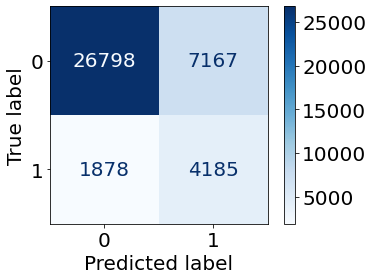

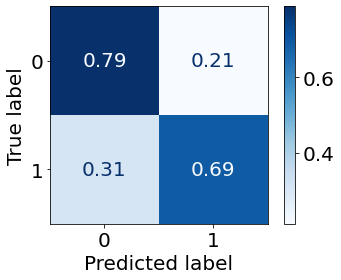

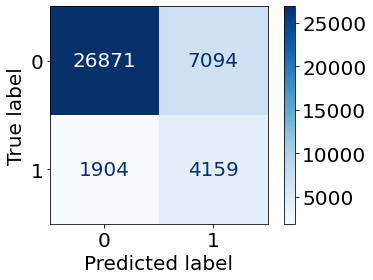

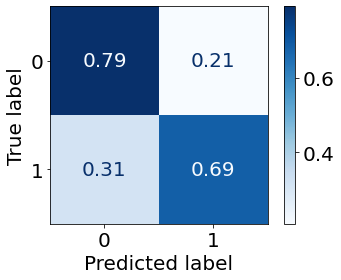

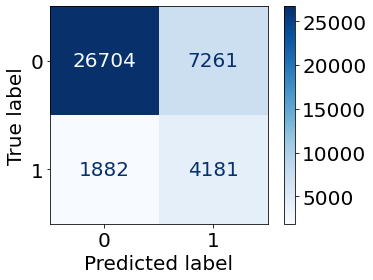

...

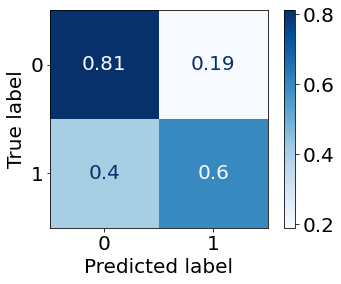

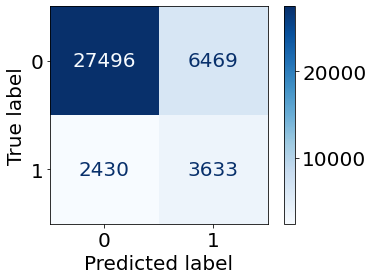

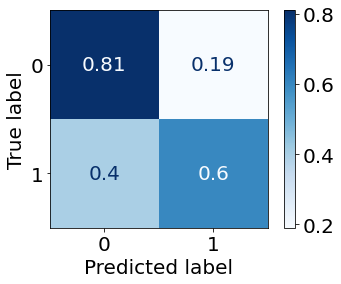

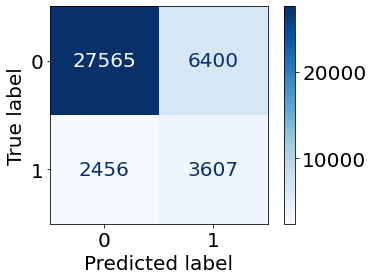

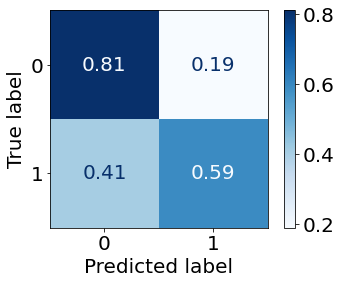

In [32]:
random_state = 3
path = "Performance/Age_30_34-Validation-Set-Performance-LR-Trial-3/"


df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)


for n in range(1, 30):
    df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 3, n=n)

    X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2021_DP = df_train_2021_DP['Diabetes']
    print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

    train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                         X_validation_2021, y_validation_2021, 
                         X_validation_2021, y_validation_2021,
                         "2021", "Age-30_34-DP-" + str(n), "1", df_validation_2021,
                    save_dir = path)

In [33]:
import os
import pandas as pd


# Get a list of all CSV files in the directory

csv_files = [file for file in os.listdir(path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "30-34"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "30-34"]["Class 1 AU_PRC"].to_list()[0]
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv(path + "ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
28,2021 Age-30_34-DP-29.csv,0.762870,0.141665
19,2021 Age-30_34-DP-20.csv,0.760562,0.148857
26,2021 Age-30_34-DP-27.csv,0.759619,0.142230
27,2021 Age-30_34-DP-28.csv,0.755380,0.141862
24,2021 Age-30_34-DP-25.csv,0.753542,0.143398
25,2021 Age-30_34-DP-26.csv,0.752836,0.142514
17,2021 Age-30_34-DP-18.csv,0.748689,0.149533
18,2021 Age-30_34-DP-19.csv,0.748218,0.149344
22,2021 Age-30_34-DP-23.csv,0.742848,0.144489
23,2021 Age-30_34-DP-24.csv,0.738137,0.143903


Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
3  group class 1:  (198, 50)
3  group class 1:  (3960, 50)  # of DP units 20
New training set:  (124041, 50)
(124041, 48) (120081, 48) (40027, 48)
accuracy 0.7523671521722837
              precision    recall  f1-score   support

         0.0       0.93      0.76      0.84     33930
         1.0       0.34      0.68      0.46      6097

    accuracy                           0.75     40027
   macro avg       0.64      0.72      0.65     40027
weighted avg       0.84      0.75      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6821387567656224
Class 1 Precision: 0.3427841424214951
Class 1 Area Under Precision-Recall Curve: 0.4167124961570108
Class 1 F1-Score: 0.4562808557323093
Class 0 Recall: 0.7649867374005305
Class 0 Precision: 0.9305226930522693
Class 0 Area Under Precision-Recall Curve: 0.728581059530728
Class 0 F1-Score: 0.83967

Class 1 Recall: 0.7834008097165992
Class 1 Precision: 0.33917616126205086
Class 1 Area Under Precision-Recall Curve: 0.4498692435918473
Class 1 F1-Score: 0.4733944954128441
Class 0 Recall: 0.6636931311329171
Class 0 Precision: 0.9329153605015674
Class 0 Area Under Precision-Recall Curve: 0.6887235943153491
Class 0 F1-Score: 0.7756059421422986
Overall Accuracy: 0.6853070175438597
Balanced Accuracy: 0.7235469704247581
Area Under ROC Curve: 0.7920640911274274
Matthews Correlation Coefficient: 0.348784275358047
0.7834008097165992
0.33917616126205086
0.4498692435918473
0.4733944954128441
0.6636931311329171
0.9329153605015674
0.6887235943153491
0.7756059421422986
0.6853070175438597
0.7235469704247581
0.7920640911274274
0.348784275358047
============================  30-34 ============================ 
Class 1 Recall: 0.6615384615384615
Class 1 Precision: 0.08921161825726141
Class 1 Area Under Precision-Recall Curve: 0.17542041297634786
Class 1 F1-Score: 0.15722120658135283
Class 0 Recall: 0.

============================  80-99 ============================ 
Class 1 Recall: 0.6232638888888888
Class 1 Precision: 0.3455245428296439
Class 1 Area Under Precision-Recall Curve: 0.40444366710829854
Class 1 F1-Score: 0.4445820433436533
Class 0 Recall: 0.7017543859649122
Class 0 Precision: 0.8805723720418271
Class 0 Area Under Precision-Recall Curve: 0.6866976170541947
Class 0 F1-Score: 0.7810593116914816
Overall Accuracy: 0.6859243697478992
Balanced Accuracy: 0.6625091374269005
Area Under ROC Curve: 0.7272089729532164
Matthews Correlation Coefficient: 0.27108232923097786
0.6232638888888888
0.3455245428296439
0.40444366710829854
0.4445820433436533
0.7017543859649122
0.8805723720418271
0.6866976170541947
0.7810593116914816
0.6859243697478992
0.6625091374269005
0.7272089729532164
0.27108232923097786


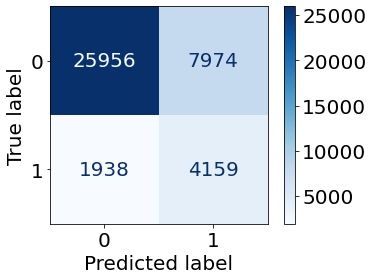

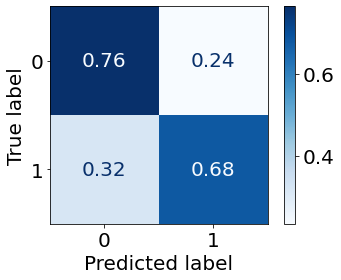

In [69]:
n = 20
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 3, n=n) 

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-30_34-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_30_34-Test-Set-Performance-LR-Trial-3/")

## DP Age: 35-39

## Trial 1

Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (355, 50)  # of DP units 1
New training set:  (120436, 50)
(120436, 48) (120081, 48) (40027, 48)
accuracy 0.7593684420905367
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.84     33889
         1.0       0.36      0.71      0.48      6139

    accuracy                           0.76     40028
   macro avg       0.65      0.74      0.66     40028
weighted avg       0.85      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7133083564098387
Class 1 Precision: 0.35744020896253365
Class 1 Area Under Precision-Recall Curve: 0.44211127090828733
Class 1 F1-Score: 0.47623708537248505
Class 0 Recall: 0.767712237009059
Class 0 Precision: 0.9366382258703244
Class 0 Area Under Precision-Recall Curve: 0.7208815855673277
Class 0 F1-Score: 0.8438

Class 1 Recall: 0.7916666666666666
Class 1 Precision: 0.3877551020408163
Class 1 Area Under Precision-Recall Curve: 0.5098331644070839
Class 1 F1-Score: 0.5205479452054794
Class 0 Recall: 0.7259678120922141
Class 0 Precision: 0.9408117249154453
Class 0 Area Under Precision-Recall Curve: 0.6747575608938972
Class 0 F1-Score: 0.819543334151731
Overall Accuracy: 0.7377809489832322
Balanced Accuracy: 0.7588172393794403
Area Under ROC Curve: 0.8294962613144433
Matthews Correlation Coefficient: 0.41240455648424135
0.7916666666666666
0.3877551020408163
0.5098331644070839
0.5205479452054794
0.7259678120922141
0.9408117249154453
0.6747575608938972
0.819543334151731
0.7377809489832322
0.7588172393794403
0.8294962613144433
0.41240455648424135
============================  30-34 ============================ 
Class 1 Recall: 0.3561643835616438
Class 1 Precision: 0.19117647058823528
Class 1 Area Under Precision-Recall Curve: 0.19442105109836347
Class 1 F1-Score: 0.24880382775119617
Class 0 Recall: 0.

Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (710, 50)  # of DP units 2
New training set:  (120791, 50)
(120791, 48) (120081, 48) (40027, 48)
accuracy 0.7657389827121015
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33889
         1.0       0.36      0.70      0.48      6139

    accuracy                           0.77     40028
   macro avg       0.65      0.74      0.66     40028
weighted avg       0.85      0.77      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6962045935820166
Class 1 Precision: 0.36263363312404545
Class 1 Area Under Precision-Recall Curve: 0.4413975322686698
Class 1 F1-Score: 0.47687587168758716
Class 0 Recall: 0.7783351529994984
Class 0 Precision: 0.9339636003115926
Class 0 Area Under Precision-Recall Curve: 0.7203073559940368
Class 0 F1-Score: 0.8490769503146579
Overall Accuracy: 0.7657389827121015
Balanced Accu

Class 1 Recall: 0.3972602739726027
Class 1 Precision: 0.18831168831168832
Class 1 Area Under Precision-Recall Curve: 0.19783498449673542
Class 1 F1-Score: 0.25550660792951546
Class 0 Recall: 0.9448367166813769
Class 0 Precision: 0.9798627002288329
Class 0 Area Under Precision-Recall Curve: 0.9262217117737966
Class 0 F1-Score: 0.9620310042687037
Overall Accuracy: 0.9277469003847798
Balanced Accuracy: 0.6710484953269898
Area Under ROC Curve: 0.804691750595461
Matthews Correlation Coefficient: 0.23985819190677113
0.3972602739726027
0.18831168831168832
0.19783498449673542
0.25550660792951546
0.9448367166813769
0.9798627002288329
0.9262217117737966
0.9620310042687037
0.9277469003847798
0.6710484953269898
0.804691750595461
0.23985819190677113
============================  35-39 ============================ 
Class 1 Recall: 0.46226415094339623
Class 1 Precision: 0.2094017094017094
Class 1 Area Under Precision-Recall Curve: 0.23423628054252962
Class 1 F1-Score: 0.28823529411764703
Class 0 Reca

Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (1065, 50)  # of DP units 3
New training set:  (121146, 50)
(121146, 48) (120081, 48) (40027, 48)
accuracy 0.7754321974617767
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     33889
         1.0       0.37      0.67      0.48      6139

    accuracy                           0.78     40028
   macro avg       0.65      0.73      0.67     40028
weighted avg       0.84      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6716077537058153
Class 1 Precision: 0.3715753424657534
Class 1 Area Under Precision-Recall Curve: 0.4402407972763207
Class 1 F1-Score: 0.47844502465912386
Class 0 Recall: 0.794240018885184
Class 0 Precision: 0.9303193695562008
Class 0 Area Under Precision-Recall Curve: 0.7220101913932773
Class 0 F1-Score: 0.8569109055888955
Overall Accuracy: 0.7754321974617767
Balanced Accur

Class 1 Recall: 0.7559523809523809
Class 1 Precision: 0.3940020682523268
Class 1 Area Under Precision-Recall Curve: 0.5092072909791924
Class 1 F1-Score: 0.5180149558123726
Class 0 Recall: 0.7451065680730753
Class 0 Precision: 0.9330065359477124
Class 0 Area Under Precision-Recall Curve: 0.6756222999881806
Class 0 F1-Score: 0.8285368802902056
Overall Accuracy: 0.7470567249375669
Balanced Accuracy: 0.7505294745127281
Area Under ROC Curve: 0.8254727728411939
Matthews Correlation Coefficient: 0.4047846187082126
0.7559523809523809
0.3940020682523268
0.5092072909791924
0.5180149558123726
0.7451065680730753
0.9330065359477124
0.6756222999881806
0.8285368802902056
0.7470567249375669
0.7505294745127281
0.8254727728411939
0.4047846187082126
============================  30-34 ============================ 
Class 1 Recall: 0.3972602739726027
Class 1 Precision: 0.18238993710691823
Class 1 Area Under Precision-Recall Curve: 0.19742440005314926
Class 1 F1-Score: 0.24999999999999994
Class 0 Recall: 0.

Class 1 Recall: 0.6859649122807018
Class 1 Precision: 0.32529118136439267
Class 1 Area Under Precision-Recall Curve: 0.3895672516208194
Class 1 F1-Score: 0.44130925507900676
Class 0 Recall: 0.6358329591378536
Class 0 Precision: 0.8877742946708463
Class 0 Area Under Precision-Recall Curve: 0.6886344801734461
Class 0 F1-Score: 0.7409733124018838
Overall Accuracy: 0.6460493385770468
Balanced Accuracy: 0.6608989357092777
Area Under ROC Curve: 0.7213984669802032
Matthews Correlation Coefficient: 0.26184731555034346
0.6859649122807018
0.32529118136439267
0.3895672516208194
0.44130925507900676
0.6358329591378536
0.8877742946708463
0.6886344801734461
0.7409733124018838
0.6460493385770468
0.6608989357092777
0.7213984669802032
0.26184731555034346
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (1420, 50)  # of DP units 4
New training set:  (121501, 50)
(121501, 48) (120081, 48) (40027, 48)
accuracy 0.7780303787

Class 1 Recall: 0.751984126984127
Class 1 Precision: 0.39315352697095435
Class 1 Area Under Precision-Recall Curve: 0.5082917948283453
Class 1 F1-Score: 0.5163487738419619
Class 0 Recall: 0.745541539799913
Class 0 Precision: 0.9320282762370854
Class 0 Area Under Precision-Recall Curve: 0.6762166916812066
Class 0 F1-Score: 0.8284195263412275
Overall Accuracy: 0.7466999643239386
Balanced Accuracy: 0.74876283339202
Area Under ROC Curve: 0.8231322106920194
Matthews Correlation Coefficient: 0.4022266692638822
0.751984126984127
0.39315352697095435
0.5082917948283453
0.5163487738419619
0.745541539799913
0.9320282762370854
0.6762166916812066
0.8284195263412275
0.7466999643239386
0.74876283339202
0.8231322106920194
0.4022266692638822
============================  30-34 ============================ 
Class 1 Recall: 0.3972602739726027
Class 1 Precision: 0.1686046511627907
Class 1 Area Under Precision-Recall Curve: 0.20160906996654665
Class 1 F1-Score: 0.236734693877551
Class 0 Recall: 0.936893203

Class 1 Recall: 0.6631578947368421
Class 1 Precision: 0.33187006145741876
Class 1 Area Under Precision-Recall Curve: 0.38964779457371884
Class 1 F1-Score: 0.44236395552954944
Class 0 Recall: 0.65828468792097
Class 0 Precision: 0.8841978287092883
Class 0 Area Under Precision-Recall Curve: 0.6886891641918389
Class 0 F1-Score: 0.7546975546975546
Overall Accuracy: 0.6592777976403289
Balanced Accuracy: 0.660721291328906
Area Under ROC Curve: 0.7211723741324573
Matthews Correlation Coefficient: 0.26354016893940624
0.6631578947368421
0.33187006145741876
0.38964779457371884
0.44236395552954944
0.65828468792097
0.8841978287092883
0.6886891641918389
0.7546975546975546
0.6592777976403289
0.660721291328906
0.7211723741324573
0.26354016893940624
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (1775, 50)  # of DP units 5
New training set:  (121856, 50)
(121856, 48) (120081, 48) (40027, 48)
accuracy 0.78102828020385

Class 1 Recall: 0.410958904109589
Class 1 Precision: 0.15706806282722513
Class 1 Area Under Precision-Recall Curve: 0.20062851732250478
Class 1 F1-Score: 0.2272727272727273
Class 0 Recall: 0.9289496910856134
Class 0 Precision: 0.9799813780260708
Class 0 Area Under Precision-Recall Curve: 0.9260500731042447
Class 0 F1-Score: 0.9537834164023561
Overall Accuracy: 0.9127832407011544
Balanced Accuracy: 0.6699542975976012
Area Under ROC Curve: 0.8061728469694954
Matthews Correlation Coefficient: 0.21583392437874957
0.410958904109589
0.15706806282722513
0.20062851732250478
0.2272727272727273
0.9289496910856134
0.9799813780260708
0.9260500731042447
0.9537834164023561
0.9127832407011544
0.6699542975976012
0.8061728469694954
0.21583392437874957
============================  35-39 ============================ 
Class 1 Recall: 0.49056603773584906
Class 1 Precision: 0.18055555555555555
Class 1 Area Under Precision-Recall Curve: 0.23484689204157966
Class 1 F1-Score: 0.2639593908629442
Class 0 Recall

New training set:  (122211, 50)
(122211, 48) (120081, 48) (40027, 48)
accuracy 0.7735085440191866
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     33889
         1.0       0.37      0.66      0.47      6139

    accuracy                           0.77     40028
   macro avg       0.65      0.73      0.66     40028
weighted avg       0.84      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6647662485746865
Class 1 Precision: 0.3680223645053657
Class 1 Area Under Precision-Recall Curve: 0.4368088363991388
Class 1 F1-Score: 0.4737636405850941
Class 0 Recall: 0.7932072353861135
Class 0 Precision: 0.9288848958153357
Class 0 Area Under Precision-Recall Curve: 0.7235157391342978
Class 0 F1-Score: 0.8557012796842172
Overall Accuracy: 0.7735085440191866
Balanced Accuracy: 0.7289867419803999
Area Under ROC Curve: 0.8156235064648718
Matthews Correlation Coefficient: 

Class 1 Recall: 0.7638888888888888
Class 1 Precision: 0.37745098039215685
Class 1 Area Under Precision-Recall Curve: 0.5041233272909528
Class 1 F1-Score: 0.5052493438320209
Class 0 Recall: 0.7237929534580252
Class 0 Precision: 0.9332585530005608
Class 0 Area Under Precision-Recall Curve: 0.6776887472947082
Class 0 F1-Score: 0.8152866242038216
Overall Accuracy: 0.7310024973242955
Balanced Accuracy: 0.743840921173457
Area Under ROC Curve: 0.8180955142677631
Matthews Correlation Coefficient: 0.3892652022461173
0.7638888888888888
0.37745098039215685
0.5041233272909528
0.5052493438320209
0.7237929534580252
0.9332585530005608
0.6776887472947082
0.8152866242038216
0.7310024973242955
0.743840921173457
0.8180955142677631
0.3892652022461173
============================  30-34 ============================ 
Class 1 Recall: 0.4931506849315068
Class 1 Precision: 0.1565217391304348
Class 1 Area Under Precision-Recall Curve: 0.20133442107983987
Class 1 F1-Score: 0.23762376237623764
Class 0 Recall: 0.9

Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (2485, 50)  # of DP units 7
New training set:  (122566, 50)
(122566, 48) (120081, 48) (40027, 48)
accuracy 0.7393324672729089
              precision    recall  f1-score   support

         0.0       0.94      0.74      0.83     33889
         1.0       0.34      0.73      0.46      6139

    accuracy                           0.74     40028
   macro avg       0.64      0.74      0.65     40028
weighted avg       0.85      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7304121192376608
Class 1 Precision: 0.33808338988162556
Class 1 Area Under Precision-Recall Curve: 0.434358519026325
Class 1 F1-Score: 0.4622203896505515
Class 0 Recall: 0.7409483903331464
Class 0 Precision: 0.938165514664674
Class 0 Area Under Precision-Recall Curve: 0.7243892434558836
Class 0 F1-Score: 0.8279750717182708
Overall Accuracy: 0.7393324672729089
Balanced Accura

Class 1 Recall: 0.8194444444444444
Class 1 Precision: 0.34852320675105486
Class 1 Area Under Precision-Recall Curve: 0.5015915157639247
Class 1 F1-Score: 0.4890467732386027
Class 0 Recall: 0.6642018268812527
Class 0 Precision: 0.9437577255871447
Class 0 Area Under Precision-Recall Curve: 0.678505784279843
Class 0 F1-Score: 0.779678325248915
Overall Accuracy: 0.6921155904388155
Balanced Accuracy: 0.7418231356628486
Area Under ROC Curve: 0.8154520253802551
Matthews Correlation Coefficient: 0.3759794982508602
0.8194444444444444
0.34852320675105486
0.5015915157639247
0.4890467732386027
0.6642018268812527
0.9437577255871447
0.678505784279843
0.779678325248915
0.6921155904388155
0.7418231356628486
0.8154520253802551
0.3759794982508602
============================  30-34 ============================ 
Class 1 Recall: 0.547945205479452
Class 1 Precision: 0.12012012012012012
Class 1 Area Under Precision-Recall Curve: 0.20042377860736982
Class 1 F1-Score: 0.19704433497536947
Class 0 Recall: 0.870

New training set:  (122921, 50)
(122921, 48) (120081, 48) (40027, 48)
accuracy 0.7411811731787749
              precision    recall  f1-score   support

         0.0       0.94      0.74      0.83     33889
         1.0       0.34      0.72      0.46      6139

    accuracy                           0.74     40028
   macro avg       0.64      0.73      0.65     40028
weighted avg       0.84      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7214530053754683
Class 1 Precision: 0.33863445217524274
Class 1 Area Under Precision-Recall Curve: 0.4326905156211348
Class 1 F1-Score: 0.4609220522426891
Class 0 Recall: 0.7447549352297206
Class 0 Precision: 0.9365468106423244
Class 0 Area Under Precision-Recall Curve: 0.7249715294881084
Class 0 F1-Score: 0.8297116933495513
Overall Accuracy: 0.7411811731787749
Balanced Accuracy: 0.7331039703025944
Area Under ROC Curve: 0.8123609267362232
Matthews Correlation Coefficient:

Class 1 Recall: 0.8095238095238095
Class 1 Precision: 0.3448858833474218
Class 1 Area Under Precision-Recall Curve: 0.499630957758497
Class 1 F1-Score: 0.4836988737403676
Class 0 Recall: 0.6628969117007395
Class 0 Precision: 0.9407407407407408
Class 0 Area Under Precision-Recall Curve: 0.6792823673504542
Class 0 F1-Score: 0.7777494258739475
Overall Accuracy: 0.6892615055297895
Balanced Accuracy: 0.7362103606122745
Area Under ROC Curve: 0.8127498498311896
Matthews Correlation Coefficient: 0.3673362706739737
0.8095238095238095
0.3448858833474218
0.499630957758497
0.4836988737403676
0.6628969117007395
0.9407407407407408
0.6792823673504542
0.7777494258739475
0.6892615055297895
0.7362103606122745
0.8127498498311896
0.3673362706739737
============================  30-34 ============================ 
Class 1 Recall: 0.547945205479452
Class 1 Precision: 0.11267605633802817
Class 1 Area Under Precision-Recall Curve: 0.1997456593845874
Class 1 F1-Score: 0.1869158878504673
Class 0 Recall: 0.86098

============================  80-99 ============================ 
Class 1 Recall: 0.6754385964912281
Class 1 Precision: 0.32710280373831774
Class 1 Area Under Precision-Recall Curve: 0.38949848636447343
Class 1 F1-Score: 0.44075558099599305
Class 0 Recall: 0.6443646160754378
Class 0 Precision: 0.8858024691358025
Class 0 Area Under Precision-Recall Curve: 0.6890724873487195
Class 0 F1-Score: 0.7460358721081363
Overall Accuracy: 0.650697175545227
Balanced Accuracy: 0.6599016062833329
Area Under ROC Curve: 0.7202207359440361
Matthews Correlation Coefficient: 0.2609363720095883
0.6754385964912281
0.32710280373831774
0.38949848636447343
0.44075558099599305
0.6443646160754378
0.8858024691358025
0.6890724873487195
0.7460358721081363
0.650697175545227
0.6599016062833329
0.7202207359440361
0.2609363720095883
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (3195, 50)  # of DP units 9
New training set:  (123276,

Class 1 Recall: 0.8035714285714286
Class 1 Precision: 0.34585824081981215
Class 1 Area Under Precision-Recall Curve: 0.4967639997245616
Class 1 F1-Score: 0.48358208955223886
Class 0 Recall: 0.6668116572422792
Class 0 Precision: 0.9393382352941176
Class 0 Area Under Precision-Recall Curve: 0.6801288626433649
Class 0 F1-Score: 0.7799542101246502
Overall Accuracy: 0.691402069211559
Balanced Accuracy: 0.7351915429068538
Area Under ROC Curve: 0.8101374303527412
Matthews Correlation Coefficient: 0.366267113590158
0.8035714285714286
0.34585824081981215
0.4967639997245616
0.48358208955223886
0.6668116572422792
0.9393382352941176
0.6801288626433649
0.7799542101246502
0.691402069211559
0.7351915429068538
0.8101374303527412
0.366267113590158
============================  30-34 ============================ 
Class 1 Recall: 0.547945205479452
Class 1 Precision: 0.10752688172043011
Class 1 Area Under Precision-Recall Curve: 0.2000904690507028
Class 1 F1-Score: 0.1797752808988764
Class 0 Recall: 0.853

Class 1:  (18500, 50)
Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (3550, 50)  # of DP units 10
New training set:  (123631, 50)
(123631, 48) (120081, 48) (40027, 48)
accuracy 0.752548216248626
              precision    recall  f1-score   support

         0.0       0.93      0.76      0.84     33889
         1.0       0.35      0.69      0.46      6139

    accuracy                           0.75     40028
   macro avg       0.64      0.73      0.65     40028
weighted avg       0.84      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6878970516370745
Class 1 Precision: 0.3458074025548641
Class 1 Area Under Precision-Recall Curve: 0.4284315078438315
Class 1 F1-Score: 0.460247397961964
Class 0 Recall: 0.7642597893121662
Class 0 Precision: 0.9311187805579523
Class 0 Area Under Precision-Recall Curve: 0.7247262294813122
Class 0 F1-Score: 0.8394781622234828
Overall Accuracy: 0.7525482162

Class 1 Recall: 0.7837301587301587
Class 1 Precision: 0.34527972027972026
Class 1 Area Under Precision-Recall Curve: 0.4931379668836652
Class 1 F1-Score: 0.47936893203883496
Class 0 Recall: 0.6742061765985211
Class 0 Precision: 0.9342977697408077
Class 0 Area Under Precision-Recall Curve: 0.681090314697604
Class 0 F1-Score: 0.7832238504295098
Overall Accuracy: 0.6938993935069568
Balanced Accuracy: 0.7289681676643399
Area Under ROC Curve: 0.8073161554022797
Matthews Correlation Coefficient: 0.35781097135273976
0.7837301587301587
0.34527972027972026
0.4931379668836652
0.47936893203883496
0.6742061765985211
0.9342977697408077
0.681090314697604
0.7832238504295098
0.6938993935069568
0.7289681676643399
0.8073161554022797
0.35781097135273976
============================  30-34 ============================ 
Class 1 Recall: 0.547945205479452
Class 1 Precision: 0.10554089709762533
Class 1 Area Under Precision-Recall Curve: 0.1991882799880251
Class 1 F1-Score: 0.17699115044247787
Class 0 Recall: 

New training set:  (123986, 50)
(123986, 48) (120081, 48) (40027, 48)
accuracy 0.764090136904167
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33889
         1.0       0.36      0.66      0.46      6139

    accuracy                           0.76     40028
   macro avg       0.64      0.72      0.66     40028
weighted avg       0.84      0.76      0.79     40028



/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_plot/confusion_matrix.py:114: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


============================  Over all performance ============================ 
Class 1 Recall: 0.6595536732366835
Class 1 Precision: 0.35511313804595684
Class 1 Area Under Precision-Recall Curve: 0.42630216588461084
Class 1 F1-Score: 0.4616612507838778
Class 0 Recall: 0.7830269408952758
Class 0 Precision: 0.9269894501502131
Class 0 Area Under Precision-Recall Curve: 0.7253263449484195
Class 0 F1-Score: 0.8489482524194193
Overall Accuracy: 0.764090136904167
Balanced Accuracy: 0.7212903070659796
Area Under ROC Curve: 0.807223176710533
Matthews Correlation Coefficient: 0.3533456335262629
0.6595536732366835
0.35511313804595684
0.42630216588461084
0.4616612507838778
0.7830269408952758
0.9269894501502131
0.7253263449484195
0.8489482524194193
0.764090136904167
0.7212903070659796
0.807223176710533
0.3533456335262629
============================  Male ============================ 
Class 1 Recall: 0.6710485133020344
Class 1 Precision: 0.3539706125144461
Class 1 Area Under Precision-Recall Curv

Class 1 Recall: 0.6401869158878505
Class 1 Precision: 0.2178060413354531
Class 1 Area Under Precision-Recall Curve: 0.2943853748201204
Class 1 F1-Score: 0.3250296559905101
Class 0 Recall: 0.8352310783657066
Class 0 Precision: 0.970050563982886
Class 0 Area Under Precision-Recall Curve: 0.855835080697207
Class 0 F1-Score: 0.8976066222782076
Overall Accuracy: 0.8221875
Balanced Accuracy: 0.7377089971267785
Area Under ROC Curve: 0.8042758730774768
Matthews Correlation Coefficient: 0.2988484741599443
0.6401869158878505
0.2178060413354531
0.2943853748201204
0.3250296559905101
0.8352310783657066
0.970050563982886
0.855835080697207
0.8976066222782076
0.8221875
0.7377089971267785
0.8042758730774768
0.2988484741599443
============================  45-49 ============================ 
Class 1 Recall: 0.6861538461538461
Class 1 Precision: 0.30758620689655175
Class 1 Area Under Precision-Recall Curve: 0.3887549984656987
Class 1 F1-Score: 0.42476190476190473
Class 0 Recall: 0.8217962371317004
Class 

Class 1 Recall: 0.672926447574335
Class 1 Precision: 0.34965034965034963
Class 1 Area Under Precision-Recall Curve: 0.43773783226537794
Class 1 F1-Score: 0.4601883561643835
Class 0 Recall: 0.7506080449017773
Class 0 Precision: 0.9201131411971561
Class 0 Area Under Precision-Recall Curve: 0.7068181013428151
Class 0 F1-Score: 0.826761917845858
Overall Accuracy: 0.7377015080603224
Balanced Accuracy: 0.7117672462380562
Area Under ROC Curve: 0.7903882010839942
Matthews Correlation Coefficient: 0.3380150043780346
0.672926447574335
0.34965034965034963
0.43773783226537794
0.4601883561643835
0.7506080449017773
0.9201131411971561
0.7068181013428151
0.826761917845858
0.7377015080603224
0.7117672462380562
0.7903882010839942
0.3380150043780346
============================  Female ============================ 
Class 1 Recall: 0.6511548913043478
Class 1 Precision: 0.3516140865737344
Class 1 Area Under Precision-Recall Curve: 0.4228395439685767
Class 1 F1-Score: 0.45664602191519765
Class 0 Recall: 0.8

Class 1 Recall: 0.6495327102803738
Class 1 Precision: 0.2106060606060606
Class 1 Area Under Precision-Recall Curve: 0.2940806561490209
Class 1 F1-Score: 0.3180778032036613
Class 0 Recall: 0.8255190890823845
Class 0 Precision: 0.9704724409448819
Class 0 Area Under Precision-Recall Curve: 0.8558830176260159
Class 0 F1-Score: 0.8921462178791169
Overall Accuracy: 0.81375
Balanced Accuracy: 0.7375258996813792
Area Under ROC Curve: 0.8040129639251083
Matthews Correlation Coefficient: 0.2932945072579561
0.6495327102803738
0.2106060606060606
0.2940806561490209
0.3180778032036613
0.8255190890823845
0.9704724409448819
0.8558830176260159
0.8921462178791169
0.81375
0.7375258996813792
0.8040129639251083
0.2932945072579561
============================  45-49 ============================ 
Class 1 Recall: 0.6953846153846154
Class 1 Precision: 0.30213903743315507
Class 1 Area Under Precision-Recall Curve: 0.38868549044874756
Class 1 F1-Score: 0.4212488350419385
Class 0 Recall: 0.8146964856230032
Class 

Class 1 Recall: 0.6719874804381847
Class 1 Precision: 0.34836930066526045
Class 1 Area Under Precision-Recall Curve: 0.4347157003750712
Class 1 F1-Score: 0.4588587304979697
Class 0 Recall: 0.7495478640473964
Class 0 Precision: 0.9197979643376445
Class 0 Area Under Precision-Recall Curve: 0.7075949892461286
Class 0 F1-Score: 0.8259913408013195
Overall Accuracy: 0.7366614664586584
Balanced Accuracy: 0.7107676722427905
Area Under ROC Curve: 0.7883811673700869
Matthews Correlation Coefficient: 0.3362171626088644
0.6719874804381847
0.34836930066526045
0.4347157003750712
0.4588587304979697
0.7495478640473964
0.9197979643376445
0.7075949892461286
0.8259913408013195
0.7366614664586584
0.7107676722427905
0.7883811673700869
0.3362171626088644
============================  Female ============================ 
Class 1 Recall: 0.6518342391304348
Class 1 Precision: 0.3495446265938069
Class 1 Area Under Precision-Recall Curve: 0.42099623979175693
Class 1 F1-Score: 0.4550628408821437
Class 0 Recall: 0

Class 1 Recall: 0.7015384615384616
Class 1 Precision: 0.2996057818659658
Class 1 Area Under Precision-Recall Curve: 0.3886249119930744
Class 1 F1-Score: 0.4198895027624309
Class 0 Recall: 0.8107916222932198
Class 0 Precision: 0.9592608147837043
Class 0 Area Under Precision-Recall Curve: 0.7860491538502834
Class 0 F1-Score: 0.8787995382839553
Overall Accuracy: 0.7994907702100573
Balanced Accuracy: 0.7561650419158407
Area Under ROC Curve: 0.84040632424019
Matthews Correlation Coefficient: 0.3641773539949286
0.7015384615384616
0.2996057818659658
0.3886249119930744
0.4198895027624309
0.8107916222932198
0.9592608147837043
0.7860491538502834
0.8787995382839553
0.7994907702100573
0.7561650419158407
0.84040632424019
0.3641773539949286
============================  50-54 ============================ 
Class 1 Recall: 0.6584362139917695
Class 1 Precision: 0.32653061224489793
Class 1 Area Under Precision-Recall Curve: 0.42348852289555794
Class 1 F1-Score: 0.4365620736698499
Class 0 Recall: 0.80696

Class 1 Recall: 0.6265725005517546
Class 1 Precision: 0.34391278013325255
Class 1 Area Under Precision-Recall Curve: 0.41003304520860945
Class 1 F1-Score: 0.44407946191146563
Class 0 Recall: 0.8013570511644966
Class 0 Precision: 0.9281253982413661
Class 0 Area Under Precision-Recall Curve: 0.7369060070293092
Class 0 F1-Score: 0.8600952643388575
Overall Accuracy: 0.7764498679079129
Balanced Accuracy: 0.7139647758581256
Area Under ROC Curve: 0.8032309890141645
Matthews Correlation Coefficient: 0.3411937510001556
0.6265725005517546
0.34391278013325255
0.41003304520860945
0.44407946191146563
0.8013570511644966
0.9281253982413661
0.7369060070293092
0.8600952643388575
0.7764498679079129
0.7139647758581256
0.8032309890141645
0.3411937510001556
============================  Black ============================ 
Class 1 Recall: 0.8012422360248447
Class 1 Precision: 0.3510204081632653
Class 1 Area Under Precision-Recall Curve: 0.4730785659186754
Class 1 F1-Score: 0.4881740775780511
Class 0 Recall:

Class 1 Recall: 0.6828908554572272
Class 1 Precision: 0.3665874901029295
Class 1 Area Under Precision-Recall Curve: 0.45491422963875044
Class 1 F1-Score: 0.4770736733642452
Class 0 Recall: 0.7786386275594909
Class 0 Precision: 0.9290194783757015
Class 0 Area Under Precision-Recall Curve: 0.7100610836753494
Class 0 F1-Score: 0.8472075869336143
Overall Accuracy: 0.7635135135135135
Balanced Accuracy: 0.730764741508359
Area Under ROC Curve: 0.815877250548098
Matthews Correlation Coefficient: 0.369366120993902
0.6828908554572272
0.3665874901029295
0.45491422963875044
0.4770736733642452
0.7786386275594909
0.9290194783757015
0.7100610836753494
0.8472075869336143
0.7635135135135135
0.730764741508359
0.815877250548098
0.369366120993902
============================  60-64 ============================ 
Class 1 Recall: 0.7043478260869566
Class 1 Precision: 0.39344262295081966
Class 1 Area Under Precision-Recall Curve: 0.4941630404520668
Class 1 F1-Score: 0.5048694974678614
Class 0 Recall: 0.757288

Class 1 Recall: 0.7894736842105263
Class 1 Precision: 0.4411764705882353
Class 1 Area Under Precision-Recall Curve: 0.5681917467857387
Class 1 F1-Score: 0.5660377358490566
Class 0 Recall: 0.6448598130841121
Class 0 Precision: 0.8961038961038961
Class 0 Area Under Precision-Recall Curve: 0.5921831382883381
Class 0 F1-Score: 0.75
Overall Accuracy: 0.6827586206896552
Balanced Accuracy: 0.7171667486473192
Area Under ROC Curve: 0.8000491883915396
Matthews Correlation Coefficient: 0.38274294406848514
0.7894736842105263
0.4411764705882353
0.5681917467857387
0.5660377358490566
0.6448598130841121
0.8961038961038961
0.5921831382883381
0.75
0.6827586206896552
0.7171667486473192
0.8000491883915396
0.38274294406848514
============================  Other race ============================ 
Class 1 Recall: 0.8048780487804879
Class 1 Precision: 0.2894736842105263
Class 1 Area Under Precision-Recall Curve: 0.45453554124525225
Class 1 F1-Score: 0.42580645161290326
Class 0 Recall: 0.6610878661087866
Class

============================  70-74 ============================ 
Class 1 Recall: 0.6838365896980462
Class 1 Precision: 0.4263565891472868
Class 1 Area Under Precision-Recall Curve: 0.4922055745673021
Class 1 F1-Score: 0.5252387448840382
Class 0 Recall: 0.7093153759820426
Class 0 Precision: 0.8765603328710125
Class 0 Area Under Precision-Recall Curve: 0.6225656737123809
Class 0 F1-Score: 0.7841191066997519
Overall Accuracy: 0.7031982942430703
Balanced Accuracy: 0.6965759828400444
Area Under ROC Curve: 0.7675524237839217
Matthews Correlation Coefficient: 0.34509764318125463
0.6838365896980462
0.4263565891472868
0.4922055745673021
0.5252387448840382
0.7093153759820426
0.8765603328710125
0.6225656737123809
0.7841191066997519
0.7031982942430703
0.6965759828400444
0.7675524237839217
0.34509764318125463
============================  75-79 ============================ 
Class 1 Recall: 0.637444279346211
Class 1 Precision: 0.4201762977473066
Class 1 Area Under Precision-Recall Curve: 0.48266300

Class 1 Recall: 0.7894736842105263
Class 1 Precision: 0.43478260869565216
Class 1 Area Under Precision-Recall Curve: 0.5653504242534788
Class 1 F1-Score: 0.5607476635514019
Class 0 Recall: 0.6355140186915887
Class 0 Precision: 0.8947368421052632
Class 0 Area Under Precision-Recall Curve: 0.5932711558672072
Class 0 F1-Score: 0.7431693989071038
Overall Accuracy: 0.6758620689655173
Balanced Accuracy: 0.7124938514510575
Area Under ROC Curve: 0.7975897688145598
Matthews Correlation Coefficient: 0.374221477814205
0.7894736842105263
0.43478260869565216
0.5653504242534788
0.5607476635514019
0.6355140186915887
0.8947368421052632
0.5932711558672072
0.7431693989071038
0.6758620689655173
0.7124938514510575
0.7975897688145598
0.374221477814205
============================  Other race ============================ 
Class 1 Recall: 0.8048780487804879
Class 1 Precision: 0.28448275862068967
Class 1 Area Under Precision-Recall Curve: 0.45115821388806937
Class 1 F1-Score: 0.42038216560509556
Class 0 Recal

Class 1 Recall: 0.6838365896980462
Class 1 Precision: 0.42706600110926235
Class 1 Area Under Precision-Recall Curve: 0.49199378279086703
Class 1 F1-Score: 0.5257767156025949
Class 0 Recall: 0.7101571268237935
Class 0 Precision: 0.8766886040872879
Class 0 Area Under Precision-Recall Curve: 0.6226380417229607
Class 0 F1-Score: 0.7846845450317781
Overall Accuracy: 0.7038379530916844
Balanced Accuracy: 0.6969968582609198
Area Under ROC Curve: 0.7673921970843226
Matthews Correlation Coefficient: 0.34594422355636023
0.6838365896980462
0.42706600110926235
0.49199378279086703
0.5257767156025949
0.7101571268237935
0.8766886040872879
0.6226380417229607
0.7846845450317781
0.7038379530916844
0.6969968582609198
0.7673921970843226
0.34594422355636023
============================  75-79 ============================ 
Class 1 Recall: 0.6329866270430906
Class 1 Precision: 0.4209486166007905
Class 1 Area Under Precision-Recall Curve: 0.4822469933878651
Class 1 F1-Score: 0.5056379821958457
Class 0 Recall:

Class 1 Recall: 0.7631578947368421
Class 1 Precision: 0.48333333333333334
Class 1 Area Under Precision-Recall Curve: 0.5662655276117349
Class 1 F1-Score: 0.5918367346938777
Class 0 Recall: 0.7102803738317757
Class 0 Precision: 0.8941176470588236
Class 0 Area Under Precision-Recall Curve: 0.5930840024642168
Class 0 F1-Score: 0.7916666666666666
Overall Accuracy: 0.7241379310344828
Balanced Accuracy: 0.7367191342843089
Area Under ROC Curve: 0.7978357107722578
Matthews Correlation Coefficient: 0.42272891860670003
0.7631578947368421
0.48333333333333334
0.5662655276117349
0.5918367346938777
0.7102803738317757
0.8941176470588236
0.5930840024642168
0.7916666666666666
0.7241379310344828
0.7367191342843089
0.7978357107722578
0.42272891860670003
============================  Other race ============================ 
Class 1 Recall: 0.7560975609756098
Class 1 Precision: 0.29523809523809524
Class 1 Area Under Precision-Recall Curve: 0.4424314115528837
Class 1 F1-Score: 0.4246575342465753
Class 0 Rec

Class 1 Recall: 0.6322314049586777
Class 1 Precision: 0.39105431309904154
Class 1 Area Under Precision-Recall Curve: 0.4736938559059206
Class 1 F1-Score: 0.48322147651006714
Class 0 Recall: 0.7647494445815848
Class 0 Precision: 0.8969310943833236
Class 0 Area Under Precision-Recall Curve: 0.6719390646509462
Class 0 F1-Score: 0.825582944703531
Overall Accuracy: 0.7391910739191074
Balanced Accuracy: 0.6984904247701312
Area Under ROC Curve: 0.7895643816137634
Matthews Correlation Coefficient: 0.33811934537607874
0.6322314049586777
0.39105431309904154
0.4736938559059206
0.48322147651006714
0.7647494445815848
0.8969310943833236
0.6719390646509462
0.825582944703531
0.7391910739191074
0.6984904247701312
0.7895643816137634
0.33811934537607874
============================  70-74 ============================ 
Class 1 Recall: 0.633214920071048
Class 1 Precision: 0.44955863808322827
Class 1 Area Under Precision-Recall Curve: 0.49201149130865246
Class 1 F1-Score: 0.5258112094395281
Class 0 Recall: 

0.3084665320890661
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7368421052631579
Class 1 Precision: 0.4745762711864407
Class 1 Area Under Precision-Recall Curve: 0.5624511429832819
Class 1 F1-Score: 0.577319587628866
Class 0 Recall: 0.7102803738317757
Class 0 Precision: 0.8837209302325582
Class 0 Area Under Precision-Recall Curve: 0.5940988271889557
Class 0 F1-Score: 0.7875647668393783
Overall Accuracy: 0.7172413793103448
Balanced Accuracy: 0.7235612395474668
Area Under ROC Curve: 0.7961141170683719
Matthews Correlation Coefficient: 0.40025333596516033
0.7368421052631579
0.4745762711864407
0.5624511429832819
0.577319587628866
0.7102803738317757
0.8837209302325582
0.5940988271889557
0.7875647668393783
0.7172413793103448
0.7235612395474668
0.7961141170683719
0.40025333596516033
============================  Other race ============================ 
Class 1 Recall: 0.7560975609756098
Class 1 Precision: 0.2980769230769231
Class 1 Area Under P

Class 1 Recall: 0.6229338842975206
Class 1 Precision: 0.39644970414201186
Class 1 Area Under Precision-Recall Curve: 0.47315983579288856
Class 1 F1-Score: 0.4845319405383688
Class 0 Recall: 0.7733892865959022
Class 0 Precision: 0.8956546598056032
Class 0 Area Under Precision-Recall Curve: 0.672025049740627
Class 0 F1-Score: 0.8300437143992583
Overall Accuracy: 0.7443713887228531
Balanced Accuracy: 0.6981615854467114
Area Under ROC Curve: 0.7894157090076729
Matthews Correlation Coefficient: 0.3402465690518058
0.6229338842975206
0.39644970414201186
0.47315983579288856
0.4845319405383688
0.7733892865959022
0.8956546598056032
0.672025049740627
0.8300437143992583
0.7443713887228531
0.6981615854467114
0.7894157090076729
0.3402465690518058
============================  70-74 ============================ 
Class 1 Recall: 0.6172291296625222
Class 1 Precision: 0.4527687296416938
Class 1 Area Under Precision-Recall Curve: 0.4917577148761863
Class 1 F1-Score: 0.5223600150319428
Class 0 Recall: 0.7

============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7631578947368421
Class 1 Precision: 0.453125
Class 1 Area Under Precision-Recall Curve: 0.5545353880812829
Class 1 F1-Score: 0.5686274509803922
Class 0 Recall: 0.6728971962616822
Class 0 Precision: 0.8888888888888888
Class 0 Area Under Precision-Recall Curve: 0.5956546537265162
Class 0 F1-Score: 0.7659574468085105
Overall Accuracy: 0.696551724137931
Balanced Accuracy: 0.7180275454992622
Area Under ROC Curve: 0.7936546974913921
Matthews Correlation Coefficient: 0.3861824665131803
0.7631578947368421
0.453125
0.5545353880812829
0.5686274509803922
0.6728971962616822
0.8888888888888888
0.5956546537265162
0.7659574468085105
0.696551724137931
0.7180275454992622
0.7936546974913921
0.3861824665131803
============================  Other race ============================ 
Class 1 Recall: 0.7560975609756098
Class 1 Precision: 0.28703703703703703
Class 1 Area Under Precision-Recall Curve: 0.432969014792441

Class 1 Recall: 0.6425619834710744
Class 1 Precision: 0.3882646691635456
Class 1 Area Under Precision-Recall Curve: 0.4730490742884667
Class 1 F1-Score: 0.48404669260700395
Class 0 Recall: 0.7580844235991113
Class 0 Precision: 0.8987415861867135
Class 0 Area Under Precision-Recall Curve: 0.6720671280662049
Class 0 F1-Score: 0.8224424209962508
Overall Accuracy: 0.735803945008966
Balanced Accuracy: 0.7003232035350928
Area Under ROC Curve: 0.7893019731889483
Matthews Correlation Coefficient: 0.3390988425411528
0.6425619834710744
0.3882646691635456
0.4730490742884667
0.48404669260700395
0.7580844235991113
0.8987415861867135
0.6720671280662049
0.8224424209962508
0.735803945008966
0.7003232035350928
0.7893019731889483
0.3390988425411528
============================  70-74 ============================ 
Class 1 Recall: 0.6394316163410302
Class 1 Precision: 0.44417026526835285
Class 1 Area Under Precision-Recall Curve: 0.49164615480200136
Class 1 F1-Score: 0.5242082271568984
Class 0 Recall: 0.7

0.7798883626522327
0.3174805509580371
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7105263157894737
Class 1 Precision: 0.48214285714285715
Class 1 Area Under Precision-Recall Curve: 0.5534130885552841
Class 1 F1-Score: 0.5744680851063829
Class 0 Recall: 0.7289719626168224
Class 0 Precision: 0.8764044943820225
Class 0 Area Under Precision-Recall Curve: 0.5960613791735108
Class 0 F1-Score: 0.7959183673469389
Overall Accuracy: 0.7241379310344828
Balanced Accuracy: 0.7197491392031481
Area Under ROC Curve: 0.793162813575996
Matthews Correlation Coefficient: 0.39696466306501593
0.7105263157894737
0.48214285714285715
0.5534130885552841
0.5744680851063829
0.7289719626168224
0.8764044943820225
0.5960613791735108
0.7959183673469389
0.7241379310344828
0.7197491392031481
0.793162813575996
0.39696466306501593
============================  Other race ============================ 
Class 1 Recall: 0.7073170731707317
Class 1 Precision: 0.3052631578947368

Class 1 Recall: 0.5971074380165289
Class 1 Precision: 0.41138790035587186
Class 1 Area Under Precision-Recall Curve: 0.4728565903928646
Class 1 F1-Score: 0.4871470712178677
Class 0 Recall: 0.7958528758331276
Class 0 Precision: 0.8920863309352518
Class 0 Area Under Precision-Recall Curve: 0.6721318839741206
Class 0 F1-Score: 0.8412263535551207
Overall Accuracy: 0.7575214186092847
Balanced Accuracy: 0.6964801569248282
Area Under ROC Curve: 0.7891469252566962
Matthews Correlation Coefficient: 0.3453307532981145
0.5971074380165289
0.41138790035587186
0.4728565903928646
0.4871470712178677
0.7958528758331276
0.8920863309352518
0.6721318839741206
0.8412263535551207
0.7575214186092847
0.6964801569248282
0.7891469252566962
0.3453307532981145
============================  70-74 ============================ 
Class 1 Recall: 0.5914742451154529
Class 1 Precision: 0.46769662921348315
Class 1 Area Under Precision-Recall Curve: 0.4914676923522091
Class 1 F1-Score: 0.5223529411764706
Class 0 Recall: 0.

Class 1 Recall: 0.6416666666666667
Class 1 Precision: 0.30078125
Class 1 Area Under Precision-Recall Curve: 0.4244762321847716
Class 1 F1-Score: 0.4095744680851064
Class 0 Recall: 0.7577807848443843
Class 0 Precision: 0.9286898839137645
Class 0 Area Under Precision-Recall Curve: 0.7472942999686056
Class 0 F1-Score: 0.834575260804769
Overall Accuracy: 0.7415599534342259
Balanced Accuracy: 0.6997237257555255
Area Under ROC Curve: 0.7773849797023004
Matthews Correlation Coefficient: 0.30275676645981725
0.6416666666666667
0.30078125
0.4244762321847716
0.4095744680851064
0.7577807848443843
0.9286898839137645
0.7472942999686056
0.834575260804769
0.7415599534342259
0.6997237257555255
0.7773849797023004
0.30275676645981725
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7631578947368421
Class 1 Precision: 0.453125
Class 1 Area Under Precision-Recall Curve: 0.5526932746918399
Class 1 F1-Score: 0.5686274509803922
Class 0 Recall: 0.6728971962616822
Cl

============================  60-64 ============================ 
Class 1 Recall: 0.6826086956521739
Class 1 Precision: 0.4020486555697823
Class 1 Area Under Precision-Recall Curve: 0.4931200696733802
Class 1 F1-Score: 0.5060435132957293
Class 0 Recall: 0.7730806608357629
Class 0 Precision: 0.9159470351180196
Class 0 Area Under Precision-Recall Curve: 0.6764405739979441
Class 0 F1-Score: 0.838471673254282
Overall Accuracy: 0.7565528196981731
Balanced Accuracy: 0.7278446782439684
Area Under ROC Curve: 0.8133449264799089
Matthews Correlation Coefficient: 0.38066685126953387
0.6826086956521739
0.4020486555697823
0.4931200696733802
0.5060435132957293
0.7730806608357629
0.9159470351180196
0.6764405739979441
0.838471673254282
0.7565528196981731
0.7278446782439684
0.8133449264799089
0.38066685126953387
============================  65-69 ============================ 
Class 1 Recall: 0.6446280991735537
Class 1 Precision: 0.3849475632325725
Class 1 Area Under Precision-Recall Curve: 0.472528897

Class 1 Recall: 0.6333333333333333
Class 1 Precision: 0.2992125984251969
Class 1 Area Under Precision-Recall Curve: 0.42092948693856885
Class 1 F1-Score: 0.40641711229946526
Class 0 Recall: 0.7591339648173207
Class 0 Precision: 0.9272727272727272
Class 0 Area Under Precision-Recall Curve: 0.7481043943286211
Class 0 F1-Score: 0.8348214285714286
Overall Accuracy: 0.7415599534342259
Balanced Accuracy: 0.6962336490753269
Area Under ROC Curve: 0.7749154262516914
Matthews Correlation Coefficient: 0.2981410469013537
0.6333333333333333
0.2992125984251969
0.42092948693856885
0.40641711229946526
0.7591339648173207
0.9272727272727272
0.7481043943286211
0.8348214285714286
0.7415599534342259
0.6962336490753269
0.7749154262516914
0.2981410469013537
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7631578947368421
Class 1 Precision: 0.453125
Class 1 Area Under Precision-Recall Curve: 0.5518198298788249
Class 1 F1-Score: 0.5686274509803922
Class 0 Recall: 0

============================  70-74 ============================ 
Class 1 Recall: 0.633214920071048
Class 1 Precision: 0.4498422712933754
Class 1 Area Under Precision-Recall Curve: 0.4910855267258591
Class 1 F1-Score: 0.5260051641460716
Class 0 Recall: 0.755331088664422
Class 0 Precision: 0.8669887278582931
Class 0 Area Under Precision-Recall Curve: 0.6229582836108382
Class 0 F1-Score: 0.8073174388963863
Overall Accuracy: 0.7260127931769723
Balanced Accuracy: 0.694273004367735
Area Under ROC Curve: 0.7666075098727556
Matthews Correlation Coefficient: 0.3508609698499562
0.633214920071048
0.4498422712933754
0.4910855267258591
0.5260051641460716
0.755331088664422
0.8669887278582931
0.6229582836108382
0.8073174388963863
0.7260127931769723
0.694273004367735
0.7666075098727556
0.3508609698499562
============================  75-79 ============================ 
Class 1 Recall: 0.5676077265973254
Class 1 Precision: 0.44110854503464203
Class 1 Area Under Precision-Recall Curve: 0.48052442654856

============================  Hispanic ============================ 
Class 1 Recall: 0.746031746031746
Class 1 Precision: 0.3213675213675214
Class 1 Area Under Precision-Recall Curve: 0.44961131973481944
Class 1 F1-Score: 0.4492234169653525
Class 0 Recall: 0.6546324488908221
Class 0 Precision: 0.9216166564605022
Class 0 Area Under Precision-Recall Curve: 0.6927915040840682
Class 0 F1-Score: 0.7655137334689724
Overall Accuracy: 0.6710667142347485
Balanced Accuracy: 0.7003320974612841
Area Under ROC Curve: 0.7751403301642535
Matthews Correlation Coefficient: 0.31201772383694354
0.746031746031746
0.3213675213675214
0.44961131973481944
0.4492234169653525
0.6546324488908221
0.9216166564605022
0.6927915040840682
0.7655137334689724
0.6710667142347485
0.7003320974612841
0.7751403301642535
0.31201772383694354
============================  30-34 ============================ 
Class 1 Recall: 0.6986301369863014
Class 1 Precision: 0.08121019108280254
Class 1 Area Under Precision-Recall Curve: 0.201

0.4428904428904429
0.48028959936397014
0.49640757674722397
0.7884955752212389
0.8587951807228915
0.6369239477422418
0.8221453287197231
0.7371292192294578
0.6765657668082421
0.7635968257307789
0.32639654859790135
============================  80-99 ============================ 
Class 1 Recall: 0.4543859649122807
Class 1 Precision: 0.3612273361227336
Class 1 Area Under Precision-Recall Curve: 0.3870844318722066
Class 1 F1-Score: 0.4024864024864025
Class 0 Recall: 0.7943421643466547
Class 0 Precision: 0.8504807692307692
Class 0 Area Under Precision-Recall Curve: 0.6901278634202451
Class 0 F1-Score: 0.8214534478755515
Overall Accuracy: 0.7250625670361102
Balanced Accuracy: 0.6243640646294677
Area Under ROC Curve: 0.7175588274683116
Matthews Correlation Coefficient: 0.2294727892224487
0.4543859649122807
0.3612273361227336
0.3870844318722066
0.4024864024864025
0.7943421643466547
0.8504807692307692
0.6901278634202451
0.8214534478755515
0.7250625670361102
0.6243640646294677
0.7175588274683116


Class 1 Recall: 0.7123287671232876
Class 1 Precision: 0.0790273556231003
Class 1 Area Under Precision-Recall Curve: 0.2012582191243457
Class 1 F1-Score: 0.14227086183310533
Class 0 Recall: 0.732568402471315
Class 0 Precision: 0.9875074360499703
Class 0 Area Under Precision-Recall Curve: 0.9257250230427003
Class 0 F1-Score: 0.8411451735495312
Overall Accuracy: 0.731936725096195
Balanced Accuracy: 0.7224485847973013
Area Under ROC Curve: 0.8094191684097256
Matthews Correlation Coefficient: 0.17204981980494963
0.7123287671232876
0.0790273556231003
0.2012582191243457
0.14227086183310533
0.732568402471315
0.9875074360499703
0.9257250230427003
0.8411451735495312
0.731936725096195
0.7224485847973013
0.8094191684097256
0.17204981980494963
============================  35-39 ============================ 
Class 1 Recall: 0.7830188679245284
Class 1 Precision: 0.11823361823361823
Class 1 Area Under Precision-Recall Curve: 0.22770947847589654
Class 1 F1-Score: 0.20544554455445543
Class 0 Recall: 0.

New training set:  (128956, 50)
(128956, 48) (120081, 48) (40027, 48)
accuracy 0.752148496052763
              precision    recall  f1-score   support

         0.0       0.92      0.77      0.84     33889
         1.0       0.34      0.63      0.44      6139

    accuracy                           0.75     40028
   macro avg       0.63      0.70      0.64     40028
weighted avg       0.83      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6300700439811044
Class 1 Precision: 0.3358221913526654
Class 1 Area Under Precision-Recall Curve: 0.3926152356066031
Class 1 F1-Score: 0.43812652205924
Class 0 Recall: 0.7742630352031633
Class 0 Precision: 0.9203437390389337
Class 0 Area Under Precision-Recall Curve: 0.734035415991496
Class 0 F1-Score: 0.8410070674209523
Overall Accuracy: 0.752148496052763
Balanced Accuracy: 0.7021665395921339
Area Under ROC Curve: 0.7842634283400743
Matthews Correlation Coefficient: 0.321

Class 1 Recall: 0.746031746031746
Class 1 Precision: 0.31756756756756754
Class 1 Area Under Precision-Recall Curve: 0.44322822975128645
Class 1 F1-Score: 0.4454976303317535
Class 0 Recall: 0.6485428447150935
Class 0 Precision: 0.9209388511426807
Class 0 Area Under Precision-Recall Curve: 0.6944412540762817
Class 0 F1-Score: 0.7611026033690659
Overall Accuracy: 0.6660720656439529
Balanced Accuracy: 0.6972872953734197
Area Under ROC Curve: 0.7708976297493044
Matthews Correlation Coefficient: 0.3067712055475392
0.746031746031746
0.31756756756756754
0.44322822975128645
0.4454976303317535
0.6485428447150935
0.9209388511426807
0.6944412540762817
0.7611026033690659
0.6660720656439529
0.6972872953734197
0.7708976297493044
0.3067712055475392
============================  30-34 ============================ 
Class 1 Recall: 0.7123287671232876
Class 1 Precision: 0.0783132530120482
Class 1 Area Under Precision-Recall Curve: 0.20123799731641076
Class 1 F1-Score: 0.14111261872455902
Class 0 Recall: 0

Class 1:  (18500, 50)
Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (9230, 50)  # of DP units 26
New training set:  (129311, 50)
(129311, 48) (120081, 48) (40027, 48)
accuracy 0.7500999300489657
              precision    recall  f1-score   support

         0.0       0.92      0.77      0.84     33889
         1.0       0.33      0.63      0.44      6139

    accuracy                           0.75     40028
   macro avg       0.63      0.70      0.64     40028
weighted avg       0.83      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6315360807949177
Class 1 Precision: 0.3337063177827509
Class 1 Area Under Precision-Recall Curve: 0.39013936382799824
Class 1 F1-Score: 0.4366728614067692
Class 0 Recall: 0.77157779810558
Class 0 Precision: 0.9203801478352692
Class 0 Area Under Precision-Recall Curve: 0.7343885874556718
Class 0 F1-Score: 0.8394356249699033
Overall Accuracy: 0.750099930

Class 1 Recall: 0.7440476190476191
Class 1 Precision: 0.3143336127409891
Class 1 Area Under Precision-Recall Curve: 0.4403446055749791
Class 1 F1-Score: 0.44195639363582795
Class 0 Recall: 0.644193127446716
Class 0 Precision: 0.9198757763975155
Class 0 Area Under Precision-Recall Curve: 0.6952532253717574
Class 0 F1-Score: 0.7577385520593501
Overall Accuracy: 0.6621476988940421
Balanced Accuracy: 0.6941203732471675
Area Under ROC Curve: 0.768764196993862
Matthews Correlation Coefficient: 0.3015453996915145
0.7440476190476191
0.3143336127409891
0.4403446055749791
0.44195639363582795
0.644193127446716
0.9198757763975155
0.6952532253717574
0.7577385520593501
0.6621476988940421
0.6941203732471675
0.768764196993862
0.3015453996915145
============================  30-34 ============================ 
Class 1 Recall: 0.726027397260274
Class 1 Precision: 0.07714701601164484
Class 1 Area Under Precision-Recall Curve: 0.20108487957503057
Class 1 F1-Score: 0.13947368421052633
Class 0 Recall: 0.720

Class 1 Recall: 0.4421052631578947
Class 1 Precision: 0.36681222707423583
Class 1 Area Under Precision-Recall Curve: 0.38687019895326635
Class 1 F1-Score: 0.4009546539379475
Class 0 Recall: 0.8046699595868881
Class 0 Precision: 0.8492890995260663
Class 0 Area Under Precision-Recall Curve: 0.6902814349074785
Class 0 F1-Score: 0.8263776804242564
Overall Accuracy: 0.7307829817661781
Balanced Accuracy: 0.6233876113723914
Area Under ROC Curve: 0.717172027509276
Matthews Correlation Coefficient: 0.23092954121816603
0.4421052631578947
0.36681222707423583
0.38687019895326635
0.4009546539379475
0.8046699595868881
0.8492890995260663
0.6902814349074785
0.8263776804242564
0.7307829817661781
0.6233876113723914
0.717172027509276
0.23092954121816603
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (9585, 50)  # of DP units 27
New training set:  (129666, 50)
(129666, 48) (120081, 48) (40027, 48)
accuracy 0.74877585690

Class 1 Recall: 0.7397260273972602
Class 1 Precision: 0.07637906647807638
Class 1 Area Under Precision-Recall Curve: 0.20120985965227794
Class 1 F1-Score: 0.13846153846153847
Class 0 Recall: 0.7118270079435128
Class 0 Precision: 0.9883578431372549
Class 0 Area Under Precision-Recall Curve: 0.9257018786112793
Class 0 F1-Score: 0.8276038994356081
Overall Accuracy: 0.7126977340743907
Balanced Accuracy: 0.7257765176703865
Area Under ROC Curve: 0.8097939764717261
Matthews Correlation Coefficient: 0.17097411510338084
0.7397260273972602
0.07637906647807638
0.20120985965227794
0.13846153846153847
0.7118270079435128
0.9883578431372549
0.9257018786112793
0.8276038994356081
0.7126977340743907
0.7257765176703865
0.8097939764717261
0.17097411510338084
============================  35-39 ============================ 
Class 1 Recall: 0.8113207547169812
Class 1 Precision: 0.11436170212765957
Class 1 Area Under Precision-Recall Curve: 0.22695252499143245
Class 1 F1-Score: 0.20046620046620045
Class 0 Re

New training set:  (130021, 50)
(130021, 48) (120081, 48) (40027, 48)
accuracy 0.7455281303087838
              precision    recall  f1-score   support

         0.0       0.92      0.77      0.84     33889
         1.0       0.33      0.63      0.43      6139

    accuracy                           0.75     40028
   macro avg       0.62      0.70      0.63     40028
weighted avg       0.83      0.75      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6339794754846066
Class 1 Precision: 0.32896627504014875
Class 1 Area Under Precision-Recall Curve: 0.3854481565912197
Class 1 F1-Score: 0.43316638842515304
Class 0 Recall: 0.7657351943108384
Class 0 Precision: 0.9203106713480157
Class 0 Area Under Precision-Recall Curve: 0.7353363605642815
Class 0 F1-Score: 0.8359372483329576
Overall Accuracy: 0.7455281303087838
Balanced Accuracy: 0.6998573348977225
Area Under ROC Curve: 0.7797322911156377
Matthews Correlation Coefficient

Class 1 Recall: 0.7440476190476191
Class 1 Precision: 0.30637254901960786
Class 1 Area Under Precision-Recall Curve: 0.43322385481022413
Class 1 F1-Score: 0.4340277777777778
Class 0 Recall: 0.6307090039147455
Class 0 Precision: 0.9183027232425586
Class 0 Area Under Precision-Recall Curve: 0.6969699361890367
Class 0 F1-Score: 0.7478081485301702
Overall Accuracy: 0.6510881198715662
Balanced Accuracy: 0.6873783114811822
Area Under ROC Curve: 0.7646276503932006
Matthews Correlation Coefficient: 0.2901698576629201
0.7440476190476191
0.30637254901960786
0.43322385481022413
0.4340277777777778
0.6307090039147455
0.9183027232425586
0.6969699361890367
0.7478081485301702
0.6510881198715662
0.6873783114811822
0.7646276503932006
0.2901698576629201
============================  30-34 ============================ 
Class 1 Recall: 0.7671232876712328
Class 1 Precision: 0.0749665327978581
Class 1 Area Under Precision-Recall Curve: 0.20112808495030512
Class 1 F1-Score: 0.13658536585365855
Class 0 Recall:

0.6372720683867854
0.8271604938271605
0.7422434367541766
0.673623913529435
0.7627664400583833
0.3254669140241071
============================  80-99 ============================ 
Class 1 Recall: 0.43859649122807015
Class 1 Precision: 0.37037037037037035
Class 1 Area Under Precision-Recall Curve: 0.3867452479922194
Class 1 F1-Score: 0.4016064257028113
Class 0 Recall: 0.8091603053435115
Class 0 Precision: 0.8491988689915174
Class 0 Area Under Precision-Recall Curve: 0.6903733989313503
Class 0 F1-Score: 0.8286962520119567
Overall Accuracy: 0.733643189131212
Balanced Accuracy: 0.6238783982857908
Area Under ROC Curve: 0.7169183623630248
Matthews Correlation Coefficient: 0.23323758567169262
0.43859649122807015
0.37037037037037035
0.3867452479922194
0.4016064257028113
0.8091603053435115
0.8491988689915174
0.6903733989313503
0.8286962520119567
0.733643189131212
0.6238783982857908
0.7169183623630248
0.23323758567169262
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (10

Class 1 Recall: 0.7440476190476191
Class 1 Precision: 0.30612244897959184
Class 1 Area Under Precision-Recall Curve: 0.4306203769528592
Class 1 F1-Score: 0.4337767495662232
Class 0 Recall: 0.6302740321879078
Class 0 Precision: 0.9182509505703422
Class 0 Area Under Precision-Recall Curve: 0.697727986355973
Class 0 F1-Score: 0.7474851689450607
Overall Accuracy: 0.6507313592579379
Balanced Accuracy: 0.6871608256177635
Area Under ROC Curve: 0.7626668254658685
Matthews Correlation Coefficient: 0.28980652410334024
0.7440476190476191
0.30612244897959184
0.4306203769528592
0.4337767495662232
0.6302740321879078
0.9182509505703422
0.697727986355973
0.7474851689450607
0.6507313592579379
0.6871608256177635
0.7626668254658685
0.28980652410334024
============================  30-34 ============================ 
Class 1 Recall: 0.7808219178082192
Class 1 Precision: 0.07490144546649145
Class 1 Area Under Precision-Recall Curve: 0.20099258210525647
Class 1 F1-Score: 0.13669064748201437
Class 0 Recall: 

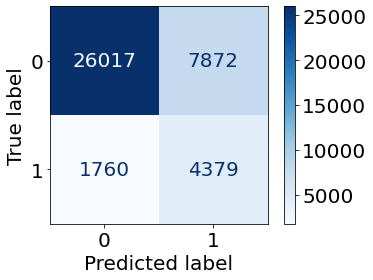

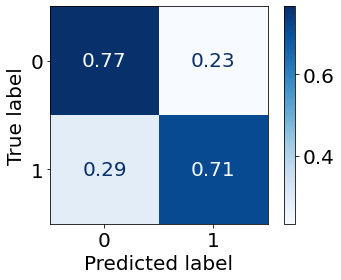

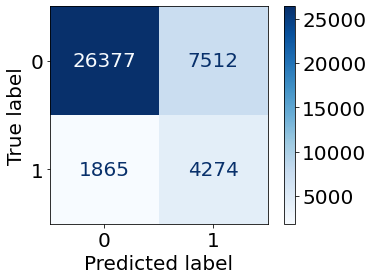

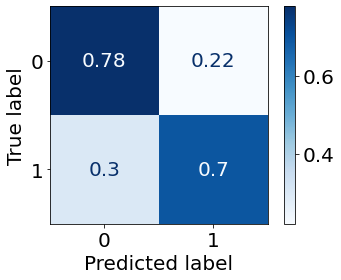

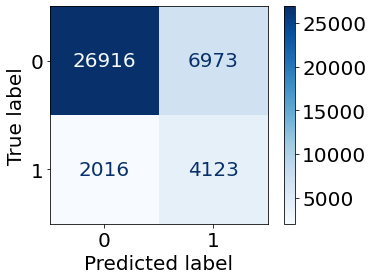

...

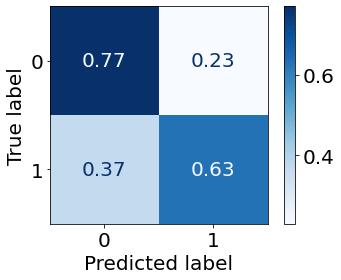

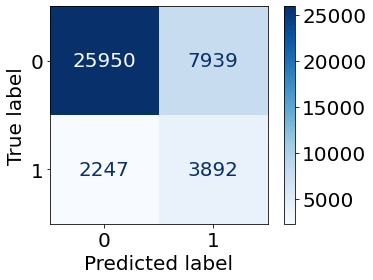

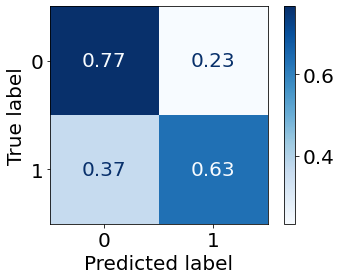

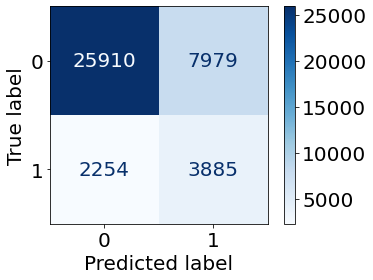

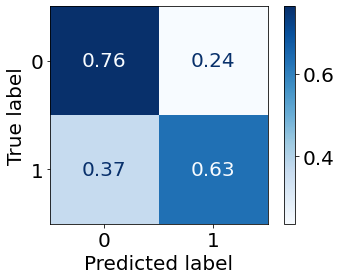

In [52]:
for n in range(1, 30):
    df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 4, n=n)

    X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2021_DP = df_train_2021_DP['Diabetes']
    print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

    train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                         X_validation_2021, y_validation_2021, 
                         X_validation_2021, y_validation_2021,
                         "2021", "Age-35_39-DP-" + str(n), "1", df_validation_2021,
                    save_dir = "Performance/Age_35_39-Validation-Set-Performance/")

In [55]:
import os
import pandas as pd

# Specify the directory containing CSV files
directory_path = 'Performance/Age_35_39-Validation-Set-Performance/'

# Get a list of all CSV files in the directory
csv_files = [file for file in os.listdir(directory_path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(directory_path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "35-39"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "35-39"]["Class 1 AU_PRC"].to_list()[0]
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv("Performance/Age_35_39-Validation-Set-Performance/ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
26,LR trained on 2021 Age-35_39-DP-27_trial_1.csv,0.776038,0.226953
25,LR trained on 2021 Age-35_39-DP-26_trial_1.csv,0.775214,0.227259
24,LR trained on 2021 Age-35_39-DP-25_trial_1.csv,0.773611,0.227437
27,LR trained on 2021 Age-35_39-DP-28_trial_1.csv,0.771951,0.226874
23,LR trained on 2021 Age-35_39-DP-24_trial_1.csv,0.771035,0.227709
28,LR trained on 2021 Age-35_39-DP-29_trial_1.csv,0.768642,0.228667
20,LR trained on 2021 Age-35_39-DP-21_trial_1.csv,0.765642,0.232538
21,LR trained on 2021 Age-35_39-DP-22_trial_1.csv,0.764669,0.227690
22,LR trained on 2021 Age-35_39-DP-23_trial_1.csv,0.760387,0.227605
15,LR trained on 2021 Age-35_39-DP-16_trial_1.csv,0.760055,0.232182


Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (8875, 50)  # of DP units 25
New training set:  (128956, 50)
(128956, 48) (120081, 48) (40027, 48)
accuracy 0.7526169835361132
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.84     33826
         1.0       0.34      0.63      0.44      6201

    accuracy                           0.75     40027
   macro avg       0.63      0.70      0.64     40027
weighted avg       0.83      0.75      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6274794388001935
Class 1 Precision: 0.3388487329095184
Class 1 Area Under Precision-Recall Curve: 0.39215254772962027
Class 1 F1-Score: 0.44005881022393123
Class 0 Recall: 0.7755572636433513
Class 0 Precision: 0.9190723094170403
Class 0 Area Under Precision-Recall Curve: 0.7319364748739892
Class 0 F1-Score: 0.84

Class 1 Recall: 0.7504690431519699
Class 1 Precision: 0.32948929159802304
Class 1 Area Under Precision-Recall Curve: 0.42326998331921417
Class 1 F1-Score: 0.45792787635947335
Class 0 Recall: 0.6451612903225806
Class 0 Precision: 0.9175449473031618
Class 0 Area Under Precision-Recall Curve: 0.6881084962695576
Class 0 F1-Score: 0.7576145380087023
Overall Accuracy: 0.6650159179342059
Balanced Accuracy: 0.6978151667372753
Area Under ROC Curve: 0.7688946284540306
Matthews Correlation Coefficient: 0.31262475640311593
0.7504690431519699
0.32948929159802304
0.42326998331921417
0.45792787635947335
0.6451612903225806
0.9175449473031618
0.6881084962695576
0.7576145380087023
0.6650159179342059
0.6978151667372753
0.7688946284540306
0.31262475640311593
============================  30-34 ============================ 
Class 1 Recall: 0.8421052631578947
Class 1 Precision: 0.07339449541284404
Class 1 Area Under Precision-Recall Curve: 0.16497761081565385
Class 1 F1-Score: 0.1350210970464135
Class 0 Rec

============================  80-99 ============================ 
Class 1 Recall: 0.455535390199637
Class 1 Precision: 0.36063218390804597
Class 1 Area Under Precision-Recall Curve: 0.3642315688742475
Class 1 F1-Score: 0.4025661587810746
Class 0 Recall: 0.8017817371937639
Class 0 Precision: 0.8571428571428571
Class 0 Area Under Precision-Recall Curve: 0.7027004669283234
Class 0 F1-Score: 0.8285385500575373
Overall Accuracy: 0.7335479256080114
Balanced Accuracy: 0.6286585636967005
Area Under ROC Curve: 0.7088690738442759
Matthews Correlation Coefficient: 0.23672187896601013
0.455535390199637
0.36063218390804597
0.3642315688742475
0.4025661587810746
0.8017817371937639
0.8571428571428571
0.7027004669283234
0.8285385500575373
0.7335479256080114
0.6286585636967005
0.7088690738442759
0.23672187896601013


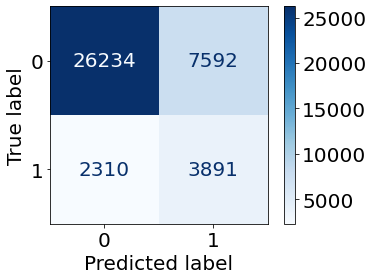

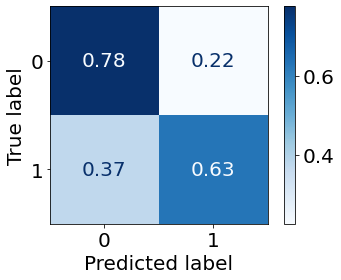

In [57]:
n = 25
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 4, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-35_39-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_35_39-Test-Set-Performance/")

## Trial 2

In [52]:
random_state = 2
path = "Performance/Age_35_39-Validation-Set-Performance-LR-Trial-2/"


df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)


(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)


(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (344, 50)  # of DP units 1
New training set:  (120425, 50)
(120425, 48) (120081, 48) (40027, 48)
accuracy 0.7418057359848106
              precision    recall  f1-score   support

         0.0       0.94      0.74      0.83     33896
         1.0       0.34      0.74      0.47      6132

    accuracy                           0.74     40028
   macro avg       0.64      0.74      0.65     40028
weighted avg       0.85      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7408675799086758
Class 1 Precision: 0.34186169011964784
Class 1 Area Under Precision-Recall Curve: 0.43175673362494216
Class 1 F1-Score: 0.46784408629833685
Class 0 Recall: 0.7419754543308945
Class 0 Precision: 0.940573693855417

Class 1 Recall: 0.766260162601626
Class 1 Precision: 0.3678048780487805
Class 1 Area Under Precision-Recall Curve: 0.47788931723221073
Class 1 F1-Score: 0.4970336189848385
Class 0 Recall: 0.7165354330708661
Class 0 Precision: 0.9343981745579008
Class 0 Area Under Precision-Recall Curve: 0.6836929098001719
Class 0 F1-Score: 0.8110918544194107
Overall Accuracy: 0.7253419726421886
Balanced Accuracy: 0.741397797836246
Area Under ROC Curve: 0.8186993648151705
Matthews Correlation Coefficient: 0.38197159946426407
0.766260162601626
0.3678048780487805
0.47788931723221073
0.4970336189848385
0.7165354330708661
0.9343981745579008
0.6836929098001719
0.8110918544194107
0.7253419726421886
0.741397797836246
0.8186993648151705
0.38197159946426407
============================  30-34 ============================ 
Class 1 Recall: 0.2833333333333333
Class 1 Precision: 0.13178294573643412
Class 1 Area Under Precision-Recall Curve: 0.1330942046349233
Class 1 F1-Score: 0.17989417989417988
Class 0 Recall: 0.9

New training set:  (120769, 50)
(120769, 48) (120081, 48) (40027, 48)
accuracy 0.7412311382032577
              precision    recall  f1-score   support

         0.0       0.94      0.74      0.83     33896
         1.0       0.34      0.74      0.47      6132

    accuracy                           0.74     40028
   macro avg       0.64      0.74      0.65     40028
weighted avg       0.85      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7411937377690803
Class 1 Precision: 0.3413187143286272
Class 1 Area Under Precision-Recall Curve: 0.4321842616250703
Class 1 F1-Score: 0.4674002468120116
Class 0 Recall: 0.741237904177484
Class 0 Precision: 0.9405884995507637
Class 0 Area Under Precision-Recall Curve: 0.7229810288096212
Class 0 F1-Score: 0.8290984688489967
Overall Accuracy: 0.7412311382032577
Balanced Accuracy: 0.7412158209732822
Area Under ROC Curve: 0.8170827435818798
Matthews Correlation Coefficient: 0

Class 1 Recall: 0.7865853658536586
Class 1 Precision: 0.36962750716332377
Class 1 Area Under Precision-Recall Curve: 0.47711613207233766
Class 1 F1-Score: 0.5029239766081872
Class 0 Recall: 0.7112860892388452
Class 0 Precision: 0.9393414211438474
Class 0 Area Under Precision-Recall Curve: 0.6841855658813112
Class 0 F1-Score: 0.8095593726661688
Overall Accuracy: 0.724622030237581
Balanced Accuracy: 0.7489357275462518
Area Under ROC Curve: 0.8165539266941226
Matthews Correlation Coefficient: 0.3922076107301627
0.7865853658536586
0.36962750716332377
0.47711613207233766
0.5029239766081872
0.7112860892388452
0.9393414211438474
0.6841855658813112
0.8095593726661688
0.724622030237581
0.7489357275462518
0.8165539266941226
0.3922076107301627
============================  30-34 ============================ 
Class 1 Recall: 0.4166666666666667
Class 1 Precision: 0.15432098765432098
Class 1 Area Under Precision-Recall Curve: 0.1335934920255002
Class 1 F1-Score: 0.22522522522522523
Class 0 Recall: 0

Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (1032, 50)  # of DP units 3
New training set:  (121113, 50)
(121113, 48) (120081, 48) (40027, 48)
accuracy 0.7719596282602178
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     33896
         1.0       0.37      0.68      0.48      6132

    accuracy                           0.77     40028
   macro avg       0.65      0.73      0.67     40028
weighted avg       0.84      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6761252446183953
Class 1 Precision: 0.3672927002126152
Class 1 Area Under Precision-Recall Curve: 0.4311613110572353
Class 1 F1-Score: 0.4760045924225028
Class 0 Recall: 0.7892966721737078
Class 0 Precision: 0.9308977035490605
Class 0 Area Under Precision-Recall Curve: 0.7239998824864476
Class 0 F1-Score: 0.85426

Class 1 Recall: 0.7215447154471545
Class 1 Precision: 0.38090128755364805
Class 1 Area Under Precision-Recall Curve: 0.47577108707421645
Class 1 F1-Score: 0.4985955056179775
Class 0 Recall: 0.747594050743657
Class 0 Precision: 0.9257854821235103
Class 0 Area Under Precision-Recall Curve: 0.6848283804630895
Class 0 F1-Score: 0.8272023233301065
Overall Accuracy: 0.7429805615550756
Balanced Accuracy: 0.7345693830954058
Area Under ROC Curve: 0.8140821828165787
Matthews Correlation Coefficient: 0.37931339645916495
0.7215447154471545
0.38090128755364805
0.47577108707421645
0.4985955056179775
0.747594050743657
0.9257854821235103
0.6848283804630895
0.8272023233301065
0.7429805615550756
0.7345693830954058
0.8140821828165787
0.37931339645916495
============================  30-34 ============================ 
Class 1 Recall: 0.3
Class 1 Precision: 0.13333333333333333
Class 1 Area Under Precision-Recall Curve: 0.13351471626131528
Class 1 F1-Score: 0.18461538461538463
Class 0 Recall: 0.94637946837

Class 1 Recall: 0.7185314685314685
Class 1 Precision: 0.31835786212238576
Class 1 Area Under Precision-Recall Curve: 0.3791820422396941
Class 1 F1-Score: 0.44122383252818037
Class 0 Recall: 0.6032461677186655
Class 0 Precision: 0.8925950633755837
Class 0 Area Under Precision-Recall Curve: 0.690696248721775
Class 0 F1-Score: 0.7199354317998387
Overall Accuracy: 0.6268817204301075
Balanced Accuracy: 0.660888818125067
Area Under ROC Curve: 0.7126589033148997
Matthews Correlation Coefficient: 0.2605377779263254
0.7185314685314685
0.31835786212238576
0.3791820422396941
0.44122383252818037
0.6032461677186655
0.8925950633755837
0.690696248721775
0.7199354317998387
0.6268817204301075
0.660888818125067
0.7126589033148997
0.2605377779263254
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (1376, 50)  # of DP units 4
New training set:  (121457, 50)
(121457, 48) (120081, 48) (40027, 48)
accuracy 0.7703107824522833

Class 1 Recall: 0.733739837398374
Class 1 Precision: 0.37840670859538783
Class 1 Area Under Precision-Recall Curve: 0.4743952982881048
Class 1 F1-Score: 0.4993084370677731
Class 0 Recall: 0.7405949256342957
Class 0 Precision: 0.9281798245614035
Class 0 Area Under Precision-Recall Curve: 0.6854955042866534
Class 0 F1-Score: 0.8238442822384429
Overall Accuracy: 0.7393808495320374
Balanced Accuracy: 0.7371673815163349
Area Under ROC Curve: 0.8115446443178342
Matthews Correlation Coefficient: 0.3813458411388989
0.733739837398374
0.37840670859538783
0.4743952982881048
0.4993084370677731
0.7405949256342957
0.9281798245614035
0.6854955042866534
0.8238442822384429
0.7393808495320374
0.7371673815163349
0.8115446443178342
0.3813458411388989
============================  30-34 ============================ 
Class 1 Recall: 0.4166666666666667
Class 1 Precision: 0.15060240963855423
Class 1 Area Under Precision-Recall Curve: 0.13356811907080046
Class 1 F1-Score: 0.22123893805309733
Class 0 Recall: 0.

============================  80-99 ============================ 
Class 1 Recall: 0.708041958041958
Class 1 Precision: 0.32066508313539194
Class 1 Area Under Precision-Recall Curve: 0.37867078860772563
Class 1 F1-Score: 0.44141689373297005
Class 0 Recall: 0.6131650135256989
Class 0 Precision: 0.8906352324819908
Class 0 Area Under Precision-Recall Curve: 0.6908672246885119
Class 0 F1-Score: 0.7263017356475301
Overall Accuracy: 0.6326164874551972
Balanced Accuracy: 0.6606034857838284
Area Under ROC Curve: 0.7123956408785085
Matthews Correlation Coefficient: 0.2605208906609019
0.708041958041958
0.32066508313539194
0.37867078860772563
0.44141689373297005
0.6131650135256989
0.8906352324819908
0.6908672246885119
0.7263017356475301
0.6326164874551972
0.6606034857838284
0.7123956408785085
0.2605208906609019
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (1720, 50)  # of DP units 5
New training set:  (121801,

Class 1 Recall: 0.7947154471544715
Class 1 Precision: 0.35577797998180166
Class 1 Area Under Precision-Recall Curve: 0.47212526951976985
Class 1 F1-Score: 0.491514770584538
Class 0 Recall: 0.6902887139107612
Class 0 Precision: 0.9398451459201906
Class 0 Area Under Precision-Recall Curve: 0.6862873127220808
Class 0 F1-Score: 0.7959646910466582
Overall Accuracy: 0.7087832973362131
Balanced Accuracy: 0.7425020805326163
Area Under ROC Curve: 0.8089324200328617
Matthews Correlation Coefficient: 0.37865346448907267
0.7947154471544715
0.35577797998180166
0.47212526951976985
0.491514770584538
0.6902887139107612
0.9398451459201906
0.6862873127220808
0.7959646910466582
0.7087832973362131
0.7425020805326163
0.8089324200328617
0.37865346448907267
============================  30-34 ============================ 
Class 1 Recall: 0.5166666666666667
Class 1 Precision: 0.12350597609561753
Class 1 Area Under Precision-Recall Curve: 0.133783155198048
Class 1 F1-Score: 0.19935691318327975
Class 0 Recall: 

Class 1 Recall: 0.7447552447552448
Class 1 Precision: 0.3036350677120456
Class 1 Area Under Precision-Recall Curve: 0.3783541926113644
Class 1 F1-Score: 0.4313924050632912
Class 0 Recall: 0.5595130748422001
Class 0 Precision: 0.8947368421052632
Class 0 Area Under Precision-Recall Curve: 0.69102530600359
Class 0 F1-Score: 0.688488210818308
Overall Accuracy: 0.5974910394265233
Balanced Accuracy: 0.6521341597987225
Area Under ROC Curve: 0.7120425224009533
Matthews Correlation Coefficient: 0.24567923733080993
0.7447552447552448
0.3036350677120456
0.3783541926113644
0.4313924050632912
0.5595130748422001
0.8947368421052632
0.69102530600359
0.688488210818308
0.5974910394265233
0.6521341597987225
0.7120425224009533
0.24567923733080993
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (2064, 50)  # of DP units 6
New training set:  (122145, 50)
(122145, 48) (120081, 48) (40027, 48)
accuracy 0.7478764864594784
   

Class 1 Recall: 0.774390243902439
Class 1 Precision: 0.3560747663551402
Class 1 Area Under Precision-Recall Curve: 0.4693237254642552
Class 1 F1-Score: 0.48783610755441736
Class 0 Recall: 0.6986001749781278
Class 0 Precision: 0.9350117096018735
Class 0 Area Under Precision-Recall Curve: 0.6871786073067585
Class 0 F1-Score: 0.7996995493239859
Overall Accuracy: 0.7120230381569475
Balanced Accuracy: 0.7364952094402835
Area Under ROC Curve: 0.8061557091948872
Matthews Correlation Coefficient: 0.37105405831681176
0.774390243902439
0.3560747663551402
0.4693237254642552
0.48783610755441736
0.6986001749781278
0.9350117096018735
0.6871786073067585
0.7996995493239859
0.7120230381569475
0.7364952094402835
0.8061557091948872
0.37105405831681176
============================  30-34 ============================ 
Class 1 Recall: 0.5166666666666667
Class 1 Precision: 0.11969111969111969
Class 1 Area Under Precision-Recall Curve: 0.13496419890234213
Class 1 F1-Score: 0.19435736677115986
Class 0 Recall: 

New training set:  (122489, 50)
(122489, 48) (120081, 48) (40027, 48)
accuracy 0.747801538922754
              precision    recall  f1-score   support

         0.0       0.94      0.75      0.83     33896
         1.0       0.34      0.72      0.47      6132

    accuracy                           0.75     40028
   macro avg       0.64      0.73      0.65     40028
weighted avg       0.85      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7160795825179387
Class 1 Precision: 0.3445272655943507
Class 1 Area Under Precision-Recall Curve: 0.42552378911674577
Class 1 F1-Score: 0.4652222281082799
Class 0 Recall: 0.75354024073637
Class 0 Precision: 0.9361873694241836
Class 0 Area Under Precision-Recall Curve: 0.7254411938375729
Class 0 F1-Score: 0.834992399352719
Overall Accuracy: 0.747801538922754
Balanced Accuracy: 0.7348099116271544
Area Under ROC Curve: 0.8113923613244056
Matthews Correlation Coefficient: 0.36

Class 1 Recall: 0.7723577235772358
Class 1 Precision: 0.3528319405756732
Class 1 Area Under Precision-Recall Curve: 0.46636407960614296
Class 1 F1-Score: 0.4843849585723391
Class 0 Recall: 0.6951006124234471
Class 0 Precision: 0.934156378600823
Class 0 Area Under Precision-Recall Curve: 0.6880947007985022
Class 0 F1-Score: 0.7970905442688739
Overall Accuracy: 0.7087832973362131
Balanced Accuracy: 0.7337291680003415
Area Under ROC Curve: 0.8034687991236868
Matthews Correlation Coefficient: 0.3662718691544271
0.7723577235772358
0.3528319405756732
0.46636407960614296
0.4843849585723391
0.6951006124234471
0.934156378600823
0.6880947007985022
0.7970905442688739
0.7087832973362131
0.7337291680003415
0.8034687991236868
0.3662718691544271
============================  30-34 ============================ 
Class 1 Recall: 0.5166666666666667
Class 1 Precision: 0.10877192982456141
Class 1 Area Under Precision-Recall Curve: 0.13403693528241764
Class 1 F1-Score: 0.17971014492753626
Class 0 Recall: 0.

0.7452966714905933
0.3673323823109843
0.45241231512261143
0.49211657907310086
0.616017316017316
0.8899312070043778
0.6457275675595621
0.7280634433358916
0.6457847384205265
0.6806569937539546
0.740967353919597
0.30488183497238835
============================  80-99 ============================ 
Class 1 Recall: 0.7062937062937062
Class 1 Precision: 0.31987331749802056
Class 1 Area Under Precision-Recall Curve: 0.3780407404251564
Class 1 F1-Score: 0.4403269754768392
Class 0 Recall: 0.6127141568981064
Class 0 Precision: 0.8899803536345776
Class 0 Area Under Precision-Recall Curve: 0.6912059722648566
Class 0 F1-Score: 0.7257676902536716
Overall Accuracy: 0.6318996415770609
Balanced Accuracy: 0.6595039315959064
Area Under ROC Curve: 0.7114939276233235
Matthews Correlation Coefficient: 0.2587372628961038
0.7062937062937062
0.31987331749802056
0.3780407404251564
0.4403269754768392
0.6127141568981064
0.8899803536345776
0.6912059722648566
0.7257676902536716
0.6318996415770609
0.6595039315959064


Class 1 Recall: 0.7865853658536586
Class 1 Precision: 0.3446126447016919
Class 1 Area Under Precision-Recall Curve: 0.46366515425204624
Class 1 F1-Score: 0.4792569659442725
Class 0 Recall: 0.6780402449693789
Class 0 Precision: 0.9365558912386707
Class 0 Area Under Precision-Recall Curve: 0.6889796012107876
Class 0 F1-Score: 0.7866023851814261
Overall Accuracy: 0.697264218862491
Balanced Accuracy: 0.7323128054115187
Area Under ROC Curve: 0.8007356549943453
Matthews Correlation Coefficient: 0.3614389336464876
0.7865853658536586
0.3446126447016919
0.46366515425204624
0.4792569659442725
0.6780402449693789
0.9365558912386707
0.6889796012107876
0.7866023851814261
0.697264218862491
0.7323128054115187
0.8007356549943453
0.3614389336464876
============================  30-34 ============================ 
Class 1 Recall: 0.5833333333333334
Class 1 Precision: 0.10542168674698796
Class 1 Area Under Precision-Recall Curve: 0.13296802434417124
Class 1 F1-Score: 0.1785714285714286
Class 0 Recall: 0.8

Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (3096, 50)  # of DP units 9
New training set:  (123177, 50)
(123177, 48) (120081, 48) (40027, 48)
accuracy 0.739107624662736
              precision    recall  f1-score   support

         0.0       0.94      0.74      0.83     33896
         1.0       0.34      0.73      0.46      6132

    accuracy                           0.74     40028
   macro avg       0.64      0.73      0.64     40028
weighted avg       0.85      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7270058708414873
Class 1 Precision: 0.3370378770696303
Class 1 Area Under Precision-Recall Curve: 0.4252574680511695
Class 1 F1-Score: 0.4605609793894313
Class 0 Recall: 0.7412969081897569
Class 0 Precision: 0.9375396440431327
Class 0 Area Under Precision-Recall Curve: 0.7252932523747756
Class 0 F1-Score: 0.8279486630311217
Overall Accuracy: 0.739107624662736
Balanced Accurac

Class 1 Recall: 0.6166666666666667
Class 1 Precision: 0.10306406685236769
Class 1 Area Under Precision-Recall Curve: 0.13288462903959414
Class 1 F1-Score: 0.1766109785202864
Class 0 Recall: 0.8524289642529789
Class 0 Precision: 0.9877854487519915
Class 0 Area Under Precision-Recall Curve: 0.9382527409681904
Class 0 F1-Score: 0.915129151291513
Overall Accuracy: 0.8461195361284567
Balanced Accuracy: 0.7345478154598228
Area Under ROC Curve: 0.8297280782157042
Matthews Correlation Coefficient: 0.2064391213921699
0.6166666666666667
0.10306406685236769
0.13288462903959414
0.1766109785202864
0.8524289642529789
0.9877854487519915
0.9382527409681904
0.915129151291513
0.8461195361284567
0.7345478154598228
0.8297280782157042
0.2064391213921699
============================  35-39 ============================ 
Class 1 Recall: 0.6890756302521008
Class 1 Precision: 0.1733615221987315
Class 1 Area Under Precision-Recall Curve: 0.2813402990472244
Class 1 F1-Score: 0.27702702702702703
Class 0 Recall: 0.

4  group class 1:  (3440, 50)  # of DP units 10
New training set:  (123521, 50)
(123521, 48) (120081, 48) (40027, 48)
accuracy 0.7331118217247926
              precision    recall  f1-score   support

         0.0       0.94      0.73      0.82     33896
         1.0       0.33      0.73      0.46      6132

    accuracy                           0.73     40028
   macro avg       0.64      0.73      0.64     40028
weighted avg       0.85      0.73      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7349967384213959
Class 1 Precision: 0.3322521194249908
Class 1 Area Under Precision-Recall Curve: 0.4231974406128025
Class 1 F1-Score: 0.4576331421028583
Class 0 Recall: 0.7327708284163323
Class 0 Precision: 0.9385935079167139
Class 0 Area Under Precision-Recall Curve: 0.7262390574853183
Class 0 F1-Score: 0.8230089961728988
Overall Accuracy: 0.7331118217247926
Balanced Accuracy: 0.7338837834188641
Area Under ROC Curve: 0.806

Class 1 Recall: 0.790650406504065
Class 1 Precision: 0.3319112627986348
Class 1 Area Under Precision-Recall Curve: 0.4575725875501876
Class 1 F1-Score: 0.4675480769230769
Class 0 Recall: 0.65748031496063
Class 0 Precision: 0.935865504358655
Class 0 Area Under Precision-Recall Curve: 0.690846098531572
Class 0 F1-Score: 0.7723535457348407
Overall Accuracy: 0.6810655147588193
Balanced Accuracy: 0.7240653607323475
Area Under ROC Curve: 0.7951359992602549
Matthews Correlation Coefficient: 0.3464087121561465
0.790650406504065
0.3319112627986348
0.4575725875501876
0.4675480769230769
0.65748031496063
0.935865504358655
0.690846098531572
0.7723535457348407
0.6810655147588193
0.7240653607323475
0.7951359992602549
0.3464087121561465
============================  30-34 ============================ 
Class 1 Recall: 0.7
Class 1 Precision: 0.1044776119402985
Class 1 Area Under Precision-Recall Curve: 0.1328533745139264
Class 1 F1-Score: 0.18181818181818182
Class 0 Recall: 0.8350137488542622
Class 0 Pr

Class 1 Recall: 0.6818181818181818
Class 1 Precision: 0.3207236842105263
Class 1 Area Under Precision-Recall Curve: 0.3767310823110932
Class 1 F1-Score: 0.436241610738255
Class 0 Recall: 0.6275924256086565
Class 0 Precision: 0.8843710292249047
Class 0 Area Under Precision-Recall Curve: 0.6916628586827225
Class 0 F1-Score: 0.7341772151898734
Overall Accuracy: 0.6387096774193548
Balanced Accuracy: 0.6547053037134192
Area Under ROC Curve: 0.7106552712391306
Matthews Correlation Coefficient: 0.25190966607911264
0.6818181818181818
0.3207236842105263
0.3767310823110932
0.436241610738255
0.6275924256086565
0.8843710292249047
0.6916628586827225
0.7341772151898734
0.6387096774193548
0.6547053037134192
0.7106552712391306
0.25190966607911264
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (3784, 50)  # of DP units 11
New training set:  (123865, 50)
(123865, 48) (120081, 48) (40027, 48)
accuracy 0.747526731288098

/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_plot/confusion_matrix.py:114: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


============================  Over all performance ============================ 
Class 1 Recall: 0.7009132420091324
Class 1 Precision: 0.34192521877486076
Class 1 Area Under Precision-Recall Curve: 0.42005130534607305
Class 1 F1-Score: 0.4596299860977436
Class 0 Recall: 0.7559594052395563
Class 0 Precision: 0.9332070799038532
Class 0 Area Under Precision-Recall Curve: 0.7275429044120244
Class 0 F1-Score: 0.8352837630798318
Overall Accuracy: 0.7475267312880983
Balanced Accuracy: 0.7284363236243443
Area Under ROC Curve: 0.8051779888938513
Matthews Correlation Coefficient: 0.3545425526519503
0.7009132420091324
0.34192521877486076
0.42005130534607305
0.4596299860977436
0.7559594052395563
0.9332070799038532
0.7275429044120244
0.8352837630798318
0.7475267312880983
0.7284363236243443
0.8051779888938513
0.3545425526519503
============================  Male ============================ 
Class 1 Recall: 0.6985871271585558
Class 1 Precision: 0.3436293436293436
Class 1 Area Under Precision-Recall 

Class 1 Recall: 0.7682926829268293
Class 1 Precision: 0.33810375670840787
Class 1 Area Under Precision-Recall Curve: 0.4547801637327875
Class 1 F1-Score: 0.4695652173913043
Class 0 Recall: 0.6762904636920385
Class 0 Precision: 0.9313253012048193
Class 0 Area Under Precision-Recall Curve: 0.6917757227434921
Class 0 F1-Score: 0.7835783071464774
Overall Accuracy: 0.6925845932325414
Balanced Accuracy: 0.7222915733094339
Area Under ROC Curve: 0.7923806272183458
Matthews Correlation Coefficient: 0.34609770059568395
0.7682926829268293
0.33810375670840787
0.4547801637327875
0.4695652173913043
0.6762904636920385
0.9313253012048193
0.6917757227434921
0.7835783071464774
0.6925845932325414
0.7222915733094339
0.7923806272183458
0.34609770059568395
============================  30-34 ============================ 
Class 1 Recall: 0.6833333333333333
Class 1 Precision: 0.10732984293193717
Class 1 Area Under Precision-Recall Curve: 0.13246116464129903
Class 1 F1-Score: 0.18552036199095023
Class 0 Recall

Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (4128, 50)  # of DP units 12
New training set:  (124209, 50)
(124209, 48) (120081, 48) (40027, 48)
accuracy 0.7462526231637854
              precision    recall  f1-score   support

         0.0       0.93      0.75      0.83     33896
         1.0       0.34      0.70      0.46      6132

    accuracy                           0.75     40028
   macro avg       0.64      0.73      0.65     40028
weighted avg       0.84      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7000978473581213
Class 1 Precision: 0.34041709618586946
Class 1 Area Under Precision-Recall Curve: 0.4188900107181626
Class 1 F1-Score: 0.4580910206477084
Class 0 Recall: 0.7546023129572811
Class 0 Precision: 0.9329248276616697
Class 0 Area Under Precision-Recall Curve: 0.7270864916392804
Class 0 F1-Score: 0.834

Class 1 Recall: 0.7723577235772358
Class 1 Precision: 0.33568904593639576
Class 1 Area Under Precision-Recall Curve: 0.451464472438313
Class 1 F1-Score: 0.46798029556650245
Class 0 Recall: 0.6710411198600175
Class 0 Precision: 0.9319562575941677
Class 0 Area Under Precision-Recall Curve: 0.6927645554653545
Class 0 F1-Score: 0.780264496439471
Overall Accuracy: 0.6889848812095032
Balanced Accuracy: 0.7216994217186266
Area Under ROC Curve: 0.789588801399825
Matthews Correlation Coefficient: 0.3444903743747631
0.7723577235772358
0.33568904593639576
0.451464472438313
0.46798029556650245
0.6710411198600175
0.9319562575941677
0.6927645554653545
0.780264496439471
0.6889848812095032
0.7216994217186266
0.789588801399825
0.3444903743747631
============================  30-34 ============================ 
Class 1 Recall: 0.7
Class 1 Precision: 0.10194174757281553
Class 1 Area Under Precision-Recall Curve: 0.13253657960444326
Class 1 F1-Score: 0.17796610169491528
Class 0 Recall: 0.8304307974335472


Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (4472, 50)  # of DP units 13
New training set:  (124553, 50)
(124553, 48) (120081, 48) (40027, 48)
accuracy 0.7433546517437793
              precision    recall  f1-score   support

         0.0       0.93      0.75      0.83     33896
         1.0       0.34      0.70      0.46      6132

    accuracy                           0.74     40028
   macro avg       0.64      0.73      0.64     40028
weighted avg       0.84      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7015655577299413
Class 1 Precision: 0.3375441349548843
Class 1 Area Under Precision-Recall Curve: 0.4155797168284887
Class 1 F1-Score: 0.4557927636806696
Class 0 Recall: 0.7509145621902289
Class 0 Precision: 0.932925264816919
Class 0 Area Under Precision-Recall Curve: 0.7280277187725204
Class 0 F1-Score: 0.8320829042645352
Overall Accuracy: 0.7433546517437793
Balanced Accur

Class 1 Recall: 0.7723577235772358
Class 1 Precision: 0.3318777292576419
Class 1 Area Under Precision-Recall Curve: 0.4478075836315156
Class 1 F1-Score: 0.46426389737324375
Class 0 Recall: 0.6653543307086615
Class 0 Precision: 0.9314145744029394
Class 0 Area Under Precision-Recall Curve: 0.6937875560740628
Class 0 F1-Score: 0.7762184230671091
Overall Accuracy: 0.6843052555795537
Balanced Accuracy: 0.7188560271429486
Area Under ROC Curve: 0.7868654375520133
Matthews Correlation Coefficient: 0.339479329433972
0.7723577235772358
0.3318777292576419
0.4478075836315156
0.46426389737324375
0.6653543307086615
0.9314145744029394
0.6937875560740628
0.7762184230671091
0.6843052555795537
0.7188560271429486
0.7868654375520133
0.339479329433972
============================  30-34 ============================ 
Class 1 Recall: 0.7
Class 1 Precision: 0.09523809523809523
Class 1 Area Under Precision-Recall Curve: 0.1324939811433232
Class 1 F1-Score: 0.1676646706586826
Class 0 Recall: 0.8171402383134739


============================  80-99 ============================ 
Class 1 Recall: 0.6293706293706294
Class 1 Precision: 0.33707865168539325
Class 1 Area Under Precision-Recall Curve: 0.37609987878282164
Class 1 F1-Score: 0.43902439024390244
Class 0 Recall: 0.6807935076645627
Class 0 Precision: 0.8768873403019745
Class 0 Area Under Precision-Recall Curve: 0.6919765042453104
Class 0 F1-Score: 0.7664974619289341
Overall Accuracy: 0.6702508960573477
Balanced Accuracy: 0.655082068517596
Area Under ROC Curve: 0.7098197676984872
Matthews Correlation Coefficient: 0.25761323191878305
0.6293706293706294
0.33707865168539325
0.37609987878282164
0.43902439024390244
0.6807935076645627
0.8768873403019745
0.6919765042453104
0.7664974619289341
0.6702508960573477
0.655082068517596
0.7098197676984872
0.25761323191878305
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (4816, 50)  # of DP units 14
New training set:  (1248

============================  Hispanic ============================ 
Class 1 Recall: 0.782520325203252
Class 1 Precision: 0.3246205733558179
Class 1 Area Under Precision-Recall Curve: 0.4441279160813747
Class 1 F1-Score: 0.45887961859356385
Class 0 Recall: 0.6496062992125984
Class 0 Precision: 0.9327889447236181
Class 0 Area Under Precision-Recall Curve: 0.6948128483707712
Class 0 F1-Score: 0.7658586900464156
Overall Accuracy: 0.6731461483081354
Balanced Accuracy: 0.7160633122079252
Area Under ROC Curve: 0.7841127328596121
Matthews Correlation Coefficient: 0.3335168753454276
0.782520325203252
0.3246205733558179
0.4441279160813747
0.45887961859356385
0.6496062992125984
0.9327889447236181
0.6948128483707712
0.7658586900464156
0.6731461483081354
0.7160633122079252
0.7841127328596121
0.3335168753454276
============================  30-34 ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.09034907597535935
Class 1 Area Under Precision-Recall Curve: 0.13369

Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (5160, 50)  # of DP units 15
New training set:  (125241, 50)
(125241, 48) (120081, 48) (40027, 48)
accuracy 0.7396572399320476
              precision    recall  f1-score   support

         0.0       0.93      0.75      0.83     33896
         1.0       0.33      0.70      0.45      6132

    accuracy                           0.74     40028
   macro avg       0.63      0.72      0.64     40028
weighted avg       0.84      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7000978473581213
Class 1 Precision: 0.3334368932038835
Class 1 Area Under Precision-Recall Curve: 0.41185986406515523
Class 1 F1-Score: 0.45172831062240226
Class 0 Recall: 0.7468137833372669
Class 0 Precision: 0.9322726770522595
Class 0 Area Under Precision-Recall Curve: 0.7290398473091547
Class 0 F1-Score: 0.8293010532523055
Overall Accuracy: 0.7396572399320476
Balanced Ac

Class 1 Recall: 0.7723577235772358
Class 1 Precision: 0.32506415739948674
Class 1 Area Under Precision-Recall Curve: 0.4408210387708041
Class 1 F1-Score: 0.45755568934376883
Class 0 Recall: 0.6548556430446194
Class 0 Precision: 0.930391547545059
Class 0 Area Under Precision-Recall Curve: 0.6957902000060052
Class 0 F1-Score: 0.7686777920410783
Overall Accuracy: 0.6756659467242621
Balanced Accuracy: 0.7136066833109276
Area Under ROC Curve: 0.7814427160019631
Matthews Correlation Coefficient: 0.33035449403953737
0.7723577235772358
0.32506415739948674
0.4408210387708041
0.45755568934376883
0.6548556430446194
0.930391547545059
0.6957902000060052
0.7686777920410783
0.6756659467242621
0.7136066833109276
0.7814427160019631
0.33035449403953737
============================  30-34 ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.08943089430894309
Class 1 Area Under Precision-Recall Curve: 0.1337147156376417
Class 1 F1-Score: 0.15942028985507245
Class 0 Recall:

Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (5504, 50)  # of DP units 16
New training set:  (125585, 50)
(125585, 48) (120081, 48) (40027, 48)
accuracy 0.7413310682522234
              precision    recall  f1-score   support

         0.0       0.93      0.75      0.83     33896
         1.0       0.33      0.69      0.45      6132

    accuracy                           0.74     40028
   macro avg       0.63      0.72      0.64     40028
weighted avg       0.84      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.693085453359426
Class 1 Precision: 0.3340669706021066
Class 1 Area Under Precision-Recall Curve: 0.40982945896036793
Class 1 F1-Score: 0.45083271454333296
Class 0 Recall: 0.7500590040122729
Class 0 Precision: 0.9310774188822969
Class 0 Area Under Precision-Recall Curve: 0.730228904362056
Class 0 F1-Score: 0.8308225221397993
Overall Accuracy: 0.74133106

Class 1 Recall: 0.7723577235772358
Class 1 Precision: 0.32506415739948674
Class 1 Area Under Precision-Recall Curve: 0.4372296322896255
Class 1 F1-Score: 0.45755568934376883
Class 0 Recall: 0.6548556430446194
Class 0 Precision: 0.930391547545059
Class 0 Area Under Precision-Recall Curve: 0.6967636634493344
Class 0 F1-Score: 0.7686777920410783
Overall Accuracy: 0.6756659467242621
Balanced Accuracy: 0.7136066833109276
Area Under ROC Curve: 0.778981641522452
Matthews Correlation Coefficient: 0.33035449403953737
0.7723577235772358
0.32506415739948674
0.4372296322896255
0.45755568934376883
0.6548556430446194
0.930391547545059
0.6967636634493344
0.7686777920410783
0.6756659467242621
0.7136066833109276
0.778981641522452
0.33035449403953737
============================  30-34 ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.08661417322834646
Class 1 Area Under Precision-Recall Curve: 0.13364592114407664
Class 1 F1-Score: 0.15492957746478875
Class 0 Recall: 

============================  80-99 ============================ 
Class 1 Recall: 0.5979020979020979
Class 1 Precision: 0.34615384615384615
Class 1 Area Under Precision-Recall Curve: 0.37573824664080885
Class 1 F1-Score: 0.43846153846153846
Class 0 Recall: 0.7087466185752931
Class 0 Precision: 0.8723640399556049
Class 0 Area Under Precision-Recall Curve: 0.6922094726042288
Class 0 F1-Score: 0.7820895522388059
Overall Accuracy: 0.6860215053763441
Balanced Accuracy: 0.6533243582386955
Area Under ROC Curve: 0.7091237774849135
Matthews Correlation Coefficient: 0.2588594779080261
0.5979020979020979
0.34615384615384615
0.37573824664080885
0.43846153846153846
0.7087466185752931
0.8723640399556049
0.6922094726042288
0.7820895522388059
0.6860215053763441
0.6533243582386955
0.7091237774849135
0.2588594779080261
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (5848, 50)  # of DP units 17
New training set:  (1259

Class 1 Recall: 0.7621951219512195
Class 1 Precision: 0.3246753246753247
Class 1 Area Under Precision-Recall Curve: 0.434019143185715
Class 1 F1-Score: 0.4553734061930783
Class 0 Recall: 0.6587926509186351
Class 0 Precision: 0.9279112754158965
Class 0 Area Under Precision-Recall Curve: 0.6977258803621735
Class 0 F1-Score: 0.770529547198772
Overall Accuracy: 0.6771058315334774
Balanced Accuracy: 0.7104938864349273
Area Under ROC Curve: 0.7763863104510311
Matthews Correlation Coefficient: 0.3260918125761084
0.7621951219512195
0.3246753246753247
0.434019143185715
0.4553734061930783
0.6587926509186351
0.9279112754158965
0.6977258803621735
0.770529547198772
0.6771058315334774
0.7104938864349273
0.7763863104510311
0.3260918125761084
============================  30-34 ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.08461538461538462
Class 1 Area Under Precision-Recall Curve: 0.13300108994207574
Class 1 F1-Score: 0.15172413793103448
Class 0 Recall: 0.7818

Overall Accuracy: 0.6877707430856381
Balanced Accuracy: 0.6663443406569312
Area Under ROC Curve: 0.7390703604162359
Matthews Correlation Coefficient: 0.29001113077703067
0.6266280752532561
0.3893884892086331
0.4511764106149578
0.4803105934553522
0.706060606060606
0.8634197988353626
0.646370384408798
0.7768516313407953
0.6877707430856381
0.6663443406569312
0.7390703604162359
0.29001113077703067
============================  80-99 ============================ 
Class 1 Recall: 0.5786713286713286
Class 1 Precision: 0.3517534537725824
Class 1 Area Under Precision-Recall Curve: 0.3753814859985849
Class 1 F1-Score: 0.43754130865829477
Class 0 Recall: 0.7249774571686204
Class 0 Precision: 0.8696592752839373
Class 0 Area Under Precision-Recall Curve: 0.6923402197219809
Class 0 F1-Score: 0.7907548561593313
Overall Accuracy: 0.6949820788530466
Balanced Accuracy: 0.6518243929199745
Area Under ROC Curve: 0.7088841613751443
Matthews Correlation Coefficient: 0.2592907756699451
0.5786713286713286
0.35

Class 1 Recall: 0.717479674796748
Class 1 Precision: 0.3339640491958373
Class 1 Area Under Precision-Recall Curve: 0.4306812934987026
Class 1 F1-Score: 0.45577792123950933
Class 0 Recall: 0.6920384951881015
Class 0 Precision: 0.9192330040674027
Class 0 Area Under Precision-Recall Curve: 0.6986861735618433
Class 0 F1-Score: 0.7896181682056402
Overall Accuracy: 0.6965442764578834
Balanced Accuracy: 0.7047590849924248
Area Under ROC Curve: 0.7739145665734873
Matthews Correlation Coefficient: 0.3220074438548253
0.717479674796748
0.3339640491958373
0.4306812934987026
0.45577792123950933
0.6920384951881015
0.9192330040674027
0.6986861735618433
0.7896181682056402
0.6965442764578834
0.7047590849924248
0.7739145665734873
0.3220074438548253
============================  30-34 ============================ 
Class 1 Recall: 0.7
Class 1 Precision: 0.08955223880597014
Class 1 Area Under Precision-Recall Curve: 0.13246779982228946
Class 1 F1-Score: 0.15879017013232513
Class 0 Recall: 0.804307974335472

============================  80-99 ============================ 
Class 1 Recall: 0.5104895104895105
Class 1 Precision: 0.36228287841191065
Class 1 Area Under Precision-Recall Curve: 0.37514312321696364
Class 1 F1-Score: 0.42380261248185774
Class 0 Recall: 0.7682596934174932
Class 0 Precision: 0.8588709677419355
Class 0 Area Under Precision-Recall Curve: 0.6924276800385056
Class 0 F1-Score: 0.8110423607805807
Overall Accuracy: 0.7154121863799283
Balanced Accuracy: 0.6393746019535018
Area Under ROC Curve: 0.7087044492928173
Matthews Correlation Coefficient: 0.24828704870845877
0.5104895104895105
0.36228287841191065
0.37514312321696364
0.42380261248185774
0.7682596934174932
0.8588709677419355
0.6924276800385056
0.8110423607805807
0.7154121863799283
0.6393746019535018
0.7087044492928173
0.24828704870845877
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (6536, 50)  # of DP units 19
New training set:  (12

Class 1 Recall: 0.709349593495935
Class 1 Precision: 0.33080568720379144
Class 1 Area Under Precision-Recall Curve: 0.42729339514210807
Class 1 F1-Score: 0.45119586296056874
Class 0 Recall: 0.6911636045494314
Class 0 Precision: 0.9170052234474754
Class 0 Area Under Precision-Recall Curve: 0.6996481645439061
Class 0 F1-Score: 0.7882264903966076
Overall Accuracy: 0.6943844492440605
Balanced Accuracy: 0.7002565990226832
Area Under ROC Curve: 0.7714926132200954
Matthews Correlation Coefficient: 0.31504212469997306
0.709349593495935
0.33080568720379144
0.42729339514210807
0.45119586296056874
0.6911636045494314
0.9170052234474754
0.6996481645439061
0.7882264903966076
0.6943844492440605
0.7002565990226832
0.7714926132200954
0.31504212469997306
============================  30-34 ============================ 
Class 1 Recall: 0.7
Class 1 Precision: 0.08731808731808732
Class 1 Area Under Precision-Recall Curve: 0.13250300231583537
Class 1 F1-Score: 0.15526802218114602
Class 0 Recall: 0.798808432

Class 1 Recall: 0.4965034965034965
Class 1 Precision: 0.3604060913705584
Class 1 Area Under Precision-Recall Curve: 0.37498079708143617
Class 1 F1-Score: 0.4176470588235294
Class 0 Recall: 0.7727682596934174
Class 0 Precision: 0.8561438561438561
Class 0 Area Under Precision-Recall Curve: 0.69251264579542
Class 0 F1-Score: 0.8123222748815164
Overall Accuracy: 0.7161290322580646
Balanced Accuracy: 0.634635878098457
Area Under ROC Curve: 0.7084585274959485
Matthews Correlation Coefficient: 0.2414762610932096
0.4965034965034965
0.3604060913705584
0.37498079708143617
0.4176470588235294
0.7727682596934174
0.8561438561438561
0.69251264579542
0.8123222748815164
0.7161290322580646
0.634635878098457
0.7084585274959485
0.2414762610932096
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (6880, 50)  # of DP units 20
New training set:  (126961, 50)
(126961, 48) (120081, 48) (40027, 48)
accuracy 0.756145698011392
   

Class 1 Recall: 0.7235772357723578
Class 1 Precision: 0.3245214220601641
Class 1 Area Under Precision-Recall Curve: 0.4241391572764412
Class 1 F1-Score: 0.4480805538074262
Class 0 Recall: 0.6758530183727034
Class 0 Precision: 0.9190957763236169
Class 0 Area Under Precision-Recall Curve: 0.7005787677238005
Class 0 F1-Score: 0.7789261406604486
Overall Accuracy: 0.6843052555795537
Balanced Accuracy: 0.6997151270725306
Area Under ROC Curve: 0.7691053354103093
Matthews Correlation Coefficient: 0.31194242972789293
0.7235772357723578
0.3245214220601641
0.4241391572764412
0.4480805538074262
0.6758530183727034
0.9190957763236169
0.7005787677238005
0.7789261406604486
0.6843052555795537
0.6997151270725306
0.7691053354103093
0.31194242972789293
============================  30-34 ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.08193668528864059
Class 1 Area Under Precision-Recall Curve: 0.13264155906601427
Class 1 F1-Score: 0.14740368509212728
Class 0 Recall: 

Area Under ROC Curve: 0.7385842088447008
Matthews Correlation Coefficient: 0.29467921363984906
0.5832127351664255
0.4070707070707071
0.4509202626027953
0.479476502082094
0.7458874458874459
0.8567876678269518
0.646511611615376
0.7975005785697755
0.7084305231589471
0.6645500905269357
0.7385842088447008
0.29467921363984906
============================  80-99 ============================ 
Class 1 Recall: 0.5122377622377622
Class 1 Precision: 0.36128236744759556
Class 1 Area Under Precision-Recall Curve: 0.37461187640884885
Class 1 F1-Score: 0.4237165582067968
Class 0 Recall: 0.7664562669071235
Class 0 Precision: 0.8590197069226883
Class 0 Area Under Precision-Recall Curve: 0.6926433926999571
Class 0 F1-Score: 0.8101024541339051
Overall Accuracy: 0.714336917562724
Balanced Accuracy: 0.6393470145724429
Area Under ROC Curve: 0.7082472869781256
Matthews Correlation Coefficient: 0.24778392348017794
0.5122377622377622
0.36128236744759556
0.37461187640884885
0.4237165582067968
0.7664562669071235


Class 1 Recall: 0.7134146341463414
Class 1 Precision: 0.32590529247910865
Class 1 Area Under Precision-Recall Curve: 0.4207207121464459
Class 1 F1-Score: 0.4474187380497132
Class 0 Recall: 0.6824146981627297
Class 0 Precision: 0.9171075837742504
Class 0 Area Under Precision-Recall Curve: 0.7015549057523571
Class 0 F1-Score: 0.782543265613243
Overall Accuracy: 0.6879049676025918
Balanced Accuracy: 0.6979146661545356
Area Under ROC Curve: 0.7667465093286103
Matthews Correlation Coefficient: 0.3101477463240287
0.7134146341463414
0.32590529247910865
0.4207207121464459
0.4474187380497132
0.6824146981627297
0.9171075837742504
0.7015549057523571
0.782543265613243
0.6879049676025918
0.6979146661545356
0.7667465093286103
0.3101477463240287
============================  30-34 ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.08286252354048965
Class 1 Area Under Precision-Recall Curve: 0.13249422645590764
Class 1 F1-Score: 0.14890016920473775
Class 0 Recall: 0.

Class 1 Recall: 0.4825174825174825
Class 1 Precision: 0.36220472440944884
Class 1 Area Under Precision-Recall Curve: 0.37471277698409555
Class 1 F1-Score: 0.41379310344827586
Class 0 Recall: 0.7808836789900812
Class 0 Precision: 0.854043392504931
Class 0 Area Under Precision-Recall Curve: 0.6926540026684236
Class 0 F1-Score: 0.8158266603862458
Overall Accuracy: 0.7197132616487455
Balanced Accuracy: 0.6317005807537819
Area Under ROC Curve: 0.7081061972292811
Matthews Correlation Coefficient: 0.238662953072049
0.4825174825174825
0.36220472440944884
0.37471277698409555
0.41379310344827586
0.7808836789900812
0.854043392504931
0.6926540026684236
0.8158266603862458
0.7197132616487455
0.6317005807537819
0.7081061972292811
0.238662953072049
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (7568, 50)  # of DP units 22
New training set:  (127649, 50)
(127649, 48) (120081, 48) (40027, 48)
accuracy 0.7605176376536

Class 1 Recall: 0.7113821138211383
Class 1 Precision: 0.3243744207599629
Class 1 Area Under Precision-Recall Curve: 0.4176464053810161
Class 1 F1-Score: 0.44557606619987267
Class 0 Recall: 0.6811023622047244
Class 0 Precision: 0.9164214243672749
Class 0 Area Under Precision-Recall Curve: 0.7024654830077905
Class 0 F1-Score: 0.7814303638644918
Overall Accuracy: 0.6864650827933765
Balanced Accuracy: 0.6962422380129314
Area Under ROC Curve: 0.7644241370235224
Matthews Correlation Coefficient: 0.3074225611499076
0.7113821138211383
0.3243744207599629
0.4176464053810161
0.44557606619987267
0.6811023622047244
0.9164214243672749
0.7024654830077905
0.7814303638644918
0.6864650827933765
0.6962422380129314
0.7644241370235224
0.3074225611499076
============================  30-34 ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.0784313725490196
Class 1 Area Under Precision-Recall Curve: 0.13251415105893166
Class 1 F1-Score: 0.14170692431561996
Class 0 Recall: 0

4  group class 1:  (7912, 50)  # of DP units 23
New training set:  (127993, 50)
(127993, 48) (120081, 48) (40027, 48)
accuracy 0.7595183371639852
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.85     33896
         1.0       0.34      0.63      0.44      6132

    accuracy                           0.76     40028
   macro avg       0.63      0.71      0.65     40028
weighted avg       0.83      0.76      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6278538812785388
Class 1 Precision: 0.34393425049133464
Class 1 Area Under Precision-Recall Curve: 0.3946477420543886
Class 1 F1-Score: 0.44441879256608563
Class 0 Recall: 0.7833372669341515
Class 0 Precision: 0.9208573212180066
Class 0 Area Under Precision-Recall Curve: 0.7333266198336796
Class 0 F1-Score: 0.8465487007811254
Overall Accuracy: 0.7595183371639852
Balanced Accuracy: 0.7055955741063451
Area Under ROC Curve: 0.7

Class 1 Recall: 0.7073170731707317
Class 1 Precision: 0.32252085264133457
Class 1 Area Under Precision-Recall Curve: 0.41473584758110327
Class 1 F1-Score: 0.4430299172501591
Class 0 Recall: 0.6802274715660542
Class 0 Precision: 0.9152442613301942
Class 0 Area Under Precision-Recall Curve: 0.7033756289436213
Class 0 F1-Score: 0.7804265997490589
Overall Accuracy: 0.6850251979841613
Balanced Accuracy: 0.693772272368393
Area Under ROC Curve: 0.76205108507778
Matthews Correlation Coefficient: 0.3035532454914395
0.7073170731707317
0.32252085264133457
0.41473584758110327
0.4430299172501591
0.6802274715660542
0.9152442613301942
0.7033756289436213
0.7804265997490589
0.6850251979841613
0.693772272368393
0.76205108507778
0.3035532454914395
============================  30-34 ============================ 
Class 1 Recall: 0.75
Class 1 Precision: 0.0774526678141136
Class 1 Area Under Precision-Recall Curve: 0.13248075800164313
Class 1 F1-Score: 0.14040561622464898
Class 0 Recall: 0.7543538038496792


Class 1 Recall: 0.46678321678321677
Class 1 Precision: 0.36425648021828105
Class 1 Area Under Precision-Recall Curve: 0.3744294080682532
Class 1 F1-Score: 0.4091954022988506
Class 0 Recall: 0.7899008115419297
Class 0 Precision: 0.8517258142926593
Class 0 Area Under Precision-Recall Curve: 0.6927940058636564
Class 0 F1-Score: 0.8196491228070176
Overall Accuracy: 0.7236559139784946
Balanced Accuracy: 0.6283420141625733
Area Under ROC Curve: 0.7077381027448656
Matthews Correlation Coefficient: 0.23545531508542403
0.46678321678321677
0.36425648021828105
0.3744294080682532
0.4091954022988506
0.7899008115419297
0.8517258142926593
0.6927940058636564
0.8196491228070176
0.7236559139784946
0.6283420141625733
0.7077381027448656
0.23545531508542403
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (8256, 50)  # of DP units 24
New training set:  (128337, 50)
(128337, 48) (120081, 48) (40027, 48)
accuracy 0.750999300

Class 1 Recall: 0.725609756097561
Class 1 Precision: 0.31370826010544817
Class 1 Area Under Precision-Recall Curve: 0.4121483115206436
Class 1 F1-Score: 0.43803680981595094
Class 0 Recall: 0.6583552055993
Class 0 Precision: 0.9176829268292683
Class 0 Area Under Precision-Recall Curve: 0.7042314191953083
Class 0 F1-Score: 0.7666836474783495
Overall Accuracy: 0.6702663786897048
Balanced Accuracy: 0.6919824808484305
Area Under ROC Curve: 0.759747384219249
Matthews Correlation Coefficient: 0.2980706430166843
0.725609756097561
0.31370826010544817
0.4121483115206436
0.43803680981595094
0.6583552055993
0.9176829268292683
0.7042314191953083
0.7666836474783495
0.6702663786897048
0.6919824808484305
0.759747384219249
0.2980706430166843
============================  30-34 ============================ 
Class 1 Recall: 0.7833333333333333
Class 1 Precision: 0.0746031746031746
Class 1 Area Under Precision-Recall Curve: 0.13259477476406087
Class 1 F1-Score: 0.13623188405797101
Class 0 Recall: 0.7328139

New training set:  (128681, 50)
(128681, 48) (120081, 48) (40027, 48)
accuracy 0.7500999300489657
              precision    recall  f1-score   support

         0.0       0.92      0.77      0.84     33896
         1.0       0.33      0.64      0.44      6132

    accuracy                           0.75     40028
   macro avg       0.63      0.71      0.64     40028
weighted avg       0.83      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6407371167645141
Class 1 Precision: 0.3349816693665274
Class 1 Area Under Precision-Recall Curve: 0.3901936626833516
Class 1 F1-Score: 0.4399529701584458
Class 0 Recall: 0.7698843521359452
Class 0 Precision: 0.9221527262447436
Class 0 Area Under Precision-Recall Curve: 0.7341574267946631
Class 0 F1-Score: 0.8391671356218345
Overall Accuracy: 0.7500999300489657
Balanced Accuracy: 0.7053107344502296
Area Under ROC Curve: 0.7833834732725294
Matthews Correlation Coefficient: 

Class 1 Recall: 0.7235772357723578
Class 1 Precision: 0.3109170305676856
Class 1 Area Under Precision-Recall Curve: 0.40913339560417383
Class 1 F1-Score: 0.4349419670128284
Class 0 Recall: 0.6548556430446194
Class 0 Precision: 0.9167176974892836
Class 0 Area Under Precision-Recall Curve: 0.7051402438333211
Class 0 F1-Score: 0.7639704006124012
Overall Accuracy: 0.6670266378689704
Balanced Accuracy: 0.6892164394084885
Area Under ROC Curve: 0.7574819153703348
Matthews Correlation Coefficient: 0.2935037741790019
0.7235772357723578
0.3109170305676856
0.40913339560417383
0.4349419670128284
0.6548556430446194
0.9167176974892836
0.7051402438333211
0.7639704006124012
0.6670266378689704
0.6892164394084885
0.7574819153703348
0.2935037741790019
============================  30-34 ============================ 
Class 1 Recall: 0.8
Class 1 Precision: 0.07384615384615385
Class 1 Area Under Precision-Recall Curve: 0.13261148431917574
Class 1 F1-Score: 0.1352112676056338
Class 0 Recall: 0.72410632447296

Class 1 Recall: 0.46853146853146854
Class 1 Precision: 0.36314363143631434
Class 1 Area Under Precision-Recall Curve: 0.374084924571194
Class 1 F1-Score: 0.40916030534351144
Class 0 Recall: 0.78809738503156
Class 0 Precision: 0.8518518518518519
Class 0 Area Under Precision-Recall Curve: 0.6929493251708314
Class 0 F1-Score: 0.818735362997658
Overall Accuracy: 0.7225806451612903
Balanced Accuracy: 0.6283144267815143
Area Under ROC Curve: 0.7073660672060131
Matthews Correlation Coefficient: 0.2348915588042094
0.46853146853146854
0.36314363143631434
0.374084924571194
0.40916030534351144
0.78809738503156
0.8518518518518519
0.6929493251708314
0.818735362997658
0.7225806451612903
0.6283144267815143
0.7073660672060131
0.2348915588042094
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (8944, 50)  # of DP units 26
New training set:  (129025, 50)
(129025, 48) (120081, 48) (40027, 48)
accuracy 0.7486009793144799


Class 1 Recall: 0.7215447154471545
Class 1 Precision: 0.30842745438748914
Class 1 Area Under Precision-Recall Curve: 0.40611933706208814
Class 1 F1-Score: 0.43213633597078516
Class 0 Recall: 0.6517935258092739
Class 0 Precision: 0.9157959434542102
Class 0 Area Under Precision-Recall Curve: 0.7060380506281234
Class 0 F1-Score: 0.761564017377971
Overall Accuracy: 0.6641468682505399
Balanced Accuracy: 0.6866691206282142
Area Under ROC Curve: 0.7553186949192325
Matthews Correlation Coefficient: 0.2893288250395395
0.7215447154471545
0.30842745438748914
0.40611933706208814
0.43213633597078516
0.6517935258092739
0.9157959434542102
0.7060380506281234
0.761564017377971
0.6641468682505399
0.6866691206282142
0.7553186949192325
0.2893288250395395
============================  30-34 ============================ 
Class 1 Recall: 0.8166666666666667
Class 1 Precision: 0.07324364723467862
Class 1 Area Under Precision-Recall Curve: 0.13260896632241825
Class 1 F1-Score: 0.13443072702331962
Class 0 Recall

Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (9288, 50)  # of DP units 27
New training set:  (129369, 50)
(129369, 48) (120081, 48) (40027, 48)
accuracy 0.7477765564105127
              precision    recall  f1-score   support

         0.0       0.92      0.77      0.84     33896
         1.0       0.33      0.64      0.44      6132

    accuracy                           0.75     40028
   macro avg       0.63      0.70      0.64     40028
weighted avg       0.83      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6371493803000652
Class 1 Precision: 0.33172015622346746
Class 1 Area Under Precision-Recall Curve: 0.38565108868647624
Class 1 F1-Score: 0.4362925739810161
Class 0 Recall: 0.7677897097002596
Class 0 Precision: 0.9212389380530973
Class 0 Area Under Precision-Recall Curve: 0.7354000481755655
Class 0 F1-Score: 0.8375438483570946
Overall Accuracy: 0.747776

Class 1 Recall: 0.7215447154471545
Class 1 Precision: 0.30682800345721695
Class 1 Area Under Precision-Recall Curve: 0.40332264792808303
Class 1 F1-Score: 0.430563978168587
Class 0 Recall: 0.6491688538932633
Class 0 Precision: 0.9154842689697718
Class 0 Area Under Precision-Recall Curve: 0.7069104790816871
Class 0 F1-Score: 0.7596621448681853
Overall Accuracy: 0.661987041036717
Balanced Accuracy: 0.6853567846702089
Area Under ROC Curve: 0.7531839261962173
Matthews Correlation Coefficient: 0.28707869307837586
0.7215447154471545
0.30682800345721695
0.40332264792808303
0.430563978168587
0.6491688538932633
0.9154842689697718
0.7069104790816871
0.7596621448681853
0.661987041036717
0.6853567846702089
0.7531839261962173
0.28707869307837586
============================  30-34 ============================ 
Class 1 Recall: 0.8166666666666667
Class 1 Precision: 0.07101449275362319
Class 1 Area Under Precision-Recall Curve: 0.13248837849783446
Class 1 F1-Score: 0.13066666666666668
Class 0 Recall: 

Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (9632, 50)  # of DP units 28
New training set:  (129713, 50)
(129713, 48) (120081, 48) (40027, 48)
accuracy 0.7461526931148196
              precision    recall  f1-score   support

         0.0       0.92      0.77      0.84     33896
         1.0       0.33      0.64      0.43      6132

    accuracy                           0.75     40028
   macro avg       0.63      0.70      0.64     40028
weighted avg       0.83      0.75      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6360078277886497
Class 1 Precision: 0.3296981993406036
Class 1 Area Under Precision-Recall Curve: 0.3836936897540691
Class 1 F1-Score: 0.43427426089861365
Class 0 Recall: 0.7660785933443475
Class 0 Precision: 0.9208482570303912
Class 0 Area Under Precision-Recall Curve: 0.73569236863647
Class 0 F1-Score: 0.8363636363636363
Overall Accuracy: 0.7461526931148196
Balanced Accur

Class 1 Recall: 0.7215447154471545
Class 1 Precision: 0.3041988003427592
Class 1 Area Under Precision-Recall Curve: 0.40045401919629786
Class 1 F1-Score: 0.4279686558167571
Class 0 Recall: 0.6447944006999126
Class 0 Precision: 0.91495965238982
Class 0 Area Under Precision-Recall Curve: 0.7077777599046933
Class 0 F1-Score: 0.7564793430844241
Overall Accuracy: 0.6583873290136789
Balanced Accuracy: 0.6831695580735335
Area Under ROC Curve: 0.7511229541429274
Matthews Correlation Coefficient: 0.2833483966254473
0.7215447154471545
0.3041988003427592
0.40045401919629786
0.4279686558167571
0.6447944006999126
0.91495965238982
0.7077777599046933
0.7564793430844241
0.6583873290136789
0.6831695580735335
0.7511229541429274
0.2833483966254473
============================  30-34 ============================ 
Class 1 Recall: 0.8166666666666667
Class 1 Precision: 0.0692090395480226
Class 1 Area Under Precision-Recall Curve: 0.1319952360439626
Class 1 F1-Score: 0.12760416666666666
Class 0 Recall: 0.6979

Class 1 Recall: 0.4388111888111888
Class 1 Precision: 0.35959885386819485
Class 1 Area Under Precision-Recall Curve: 0.37366220046229864
Class 1 F1-Score: 0.3952755905511811
Class 0 Recall: 0.7984670874661858
Class 0 Precision: 0.8465583173996176
Class 0 Area Under Precision-Recall Curve: 0.693143705812252
Class 0 F1-Score: 0.8218097447795824
Overall Accuracy: 0.7247311827956989
Balanced Accuracy: 0.6186391381386873
Area Under ROC Curve: 0.7069065402586593
Matthews Correlation Coefficient: 0.22117101582405868
0.4388111888111888
0.35959885386819485
0.37366220046229864
0.3952755905511811
0.7984670874661858
0.8465583173996176
0.693143705812252
0.8218097447795824
0.7247311827956989
0.6186391381386873
0.7069065402586593
0.22117101582405868
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (9976, 50)  # of DP units 29
New training set:  (130057, 50)
(130057, 48) (120081, 48) (40027, 48)
accuracy 0.74457879484

Class 1 Recall: 0.7215447154471545
Class 1 Precision: 0.3023850085178876
Class 1 Area Under Precision-Recall Curve: 0.39746539908952877
Class 1 F1-Score: 0.42617046818727494
Class 0 Recall: 0.6417322834645669
Class 0 Precision: 0.9145885286783042
Class 0 Area Under Precision-Recall Curve: 0.7086834308230455
Class 0 F1-Score: 0.754241645244216
Overall Accuracy: 0.6558675305975522
Balanced Accuracy: 0.6816384994558606
Area Under ROC Curve: 0.7490175262645014
Matthews Correlation Coefficient: 0.2807516615015721
0.7215447154471545
0.3023850085178876
0.39746539908952877
0.42617046818727494
0.6417322834645669
0.9145885286783042
0.7086834308230455
0.754241645244216
0.6558675305975522
0.6816384994558606
0.7490175262645014
0.2807516615015721
============================  30-34 ============================ 
Class 1 Recall: 0.8333333333333334
Class 1 Precision: 0.06839945280437756
Class 1 Area Under Precision-Recall Curve: 0.13195189535458277
Class 1 F1-Score: 0.1264222503160556
Class 0 Recall: 0

Class 1 Recall: 0.43006993006993005
Class 1 Precision: 0.35755813953488375
Class 1 Area Under Precision-Recall Curve: 0.3736377523720582
Class 1 F1-Score: 0.3904761904761905
Class 0 Recall: 0.8007213706041478
Class 0 Precision: 0.8449096098953378
Class 0 Area Under Precision-Recall Curve: 0.6931785222959428
Class 0 F1-Score: 0.8222222222222222
Overall Accuracy: 0.7247311827956989
Balanced Accuracy: 0.6153956503370389
Area Under ROC Curve: 0.7067741208295761
Matthews Correlation Coefficient: 0.21616612878884175
0.43006993006993005
0.35755813953488375
0.3736377523720582
0.3904761904761905
0.8007213706041478
0.8449096098953378
0.6931785222959428
0.8222222222222222
0.7247311827956989
0.6153956503370389
0.7067741208295761
0.21616612878884175


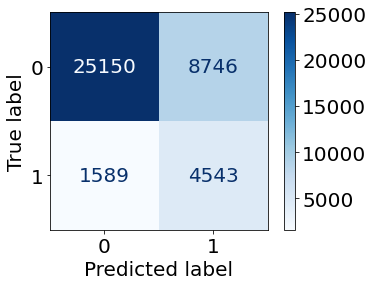

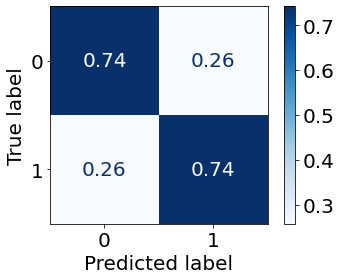

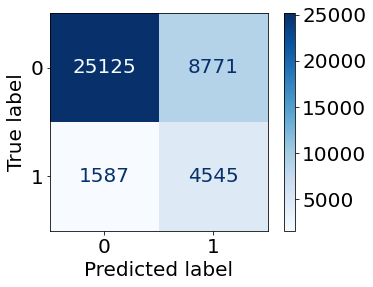

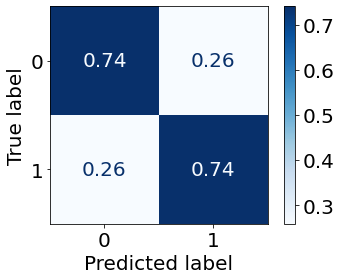

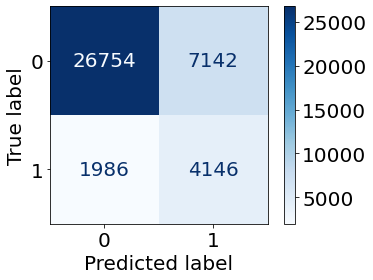

...

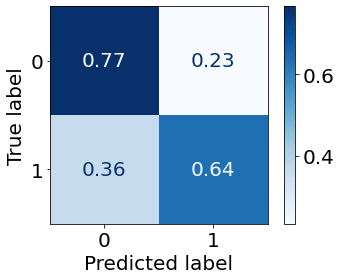

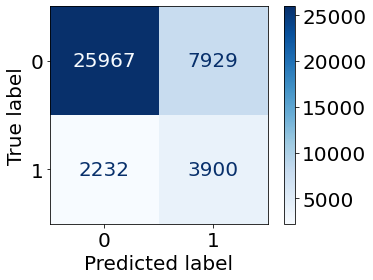

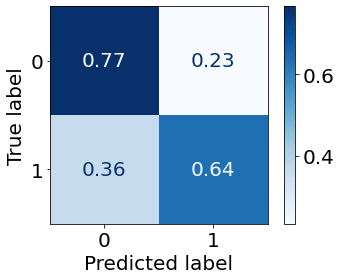

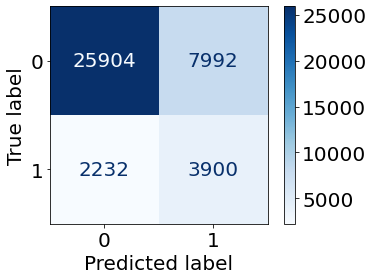

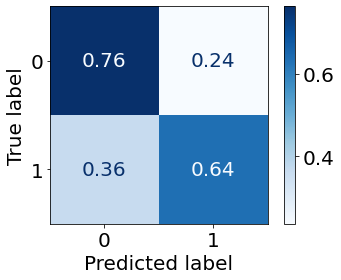

In [22]:
for n in range(1, 30):
    df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 4, n=n)

    X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2021_DP = df_train_2021_DP['Diabetes']
    print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

    train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                         X_validation_2021, y_validation_2021, 
                         X_validation_2021, y_validation_2021,
                         "2021", "Age-35_39-DP-" + str(n), "1", df_validation_2021,
                    save_dir = path)

In [24]:
import os
import pandas as pd


# Get a list of all CSV files in the directory

csv_files = [file for file in os.listdir(path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "35-39"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "35-39"]["Class 1 AU_PRC"].to_list()[0]
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv(path + "ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
20,2021 Age-35_39-DP-21.csv,0.806455,0.282070
19,2021 Age-35_39-DP-20.csv,0.804964,0.283100
21,2021 Age-35_39-DP-22.csv,0.802541,0.281846
15,2021 Age-35_39-DP-16.csv,0.800762,0.283079
22,2021 Age-35_39-DP-23.csv,0.800491,0.281190
16,2021 Age-35_39-DP-17.csv,0.800390,0.282941
14,2021 Age-35_39-DP-15.csv,0.798611,0.281809
13,2021 Age-35_39-DP-14.csv,0.798424,0.282377
23,2021 Age-35_39-DP-24.csv,0.794816,0.281019
24,2021 Age-35_39-DP-25.csv,0.794732,0.281125


Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
4  group class 1:  (344, 50)
4  group class 1:  (6880, 50)  # of DP units 20
New training set:  (126961, 50)
(126961, 48) (120081, 48) (40027, 48)
accuracy 0.7558398081295126
              precision    recall  f1-score   support

         0.0       0.92      0.77      0.84     33757
         1.0       0.35      0.66      0.46      6270

    accuracy                           0.76     40027
   macro avg       0.64      0.72      0.65     40027
weighted avg       0.83      0.76      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6580542264752791
Class 1 Precision: 0.3509995746490855
Class 1 Area Under Precision-Recall Curve: 0.420181586363494
Class 1 F1-Score: 0.45780859916782246
Class 0 Recall: 0.774002429125811
Class 0 Precision: 0.9241652518392756
Class 0 Area Under Precision-Recall Curve: 0.7239437362388408
Class 0 F1-Score: 0.84244

Class 1 Recall: 0.7297830374753451
Class 1 Precision: 0.32976827094474154
Class 1 Area Under Precision-Recall Curve: 0.44225307476777914
Class 1 F1-Score: 0.4542664211172498
Class 0 Recall: 0.6681376875551632
Class 0 Precision: 0.9170199878861296
Class 0 Area Under Precision-Recall Curve: 0.6896248280919736
Class 0 F1-Score: 0.7730405922900179
Overall Accuracy: 0.6794085827623513
Balanced Accuracy: 0.6989603625152542
Area Under ROC Curve: 0.7780377451774017
Matthews Correlation Coefficient: 0.3133722433193422
0.7297830374753451
0.32976827094474154
0.44225307476777914
0.4542664211172498
0.6681376875551632
0.9170199878861296
0.6896248280919736
0.7730405922900179
0.6794085827623513
0.6989603625152542
0.7780377451774017
0.3133722433193422
============================  30-34 ============================ 
Class 1 Recall: 0.7808219178082192
Class 1 Precision: 0.10575139146567718
Class 1 Area Under Precision-Recall Curve: 0.17714558079455223
Class 1 F1-Score: 0.18627450980392157
Class 0 Recall

Class 1 Recall: 0.5245009074410163
Class 1 Precision: 0.3748378728923476
Class 1 Area Under Precision-Recall Curve: 0.42672204932332686
Class 1 F1-Score: 0.43721633888048406
Class 0 Recall: 0.7836624775583483
Class 0 Precision: 0.8695219123505976
Class 0 Area Under Precision-Recall Curve: 0.6856910998259762
Class 0 F1-Score: 0.8243626062322945
Overall Accuracy: 0.7322777977689816
Balanced Accuracy: 0.6540816924996823
Area Under ROC Curve: 0.7306211653693139
Matthews Correlation Coefficient: 0.2744134446017246
0.5245009074410163
0.3748378728923476
0.42672204932332686
0.43721633888048406
0.7836624775583483
0.8695219123505976
0.6856910998259762
0.8243626062322945
0.7322777977689816
0.6540816924996823
0.7306211653693139
0.2744134446017246


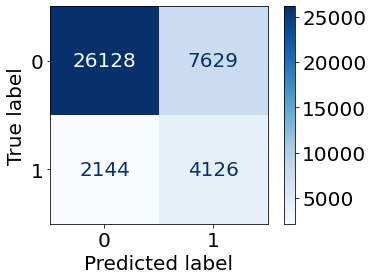

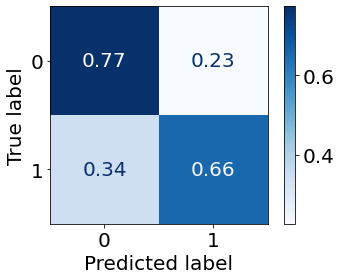

In [25]:
n = 20
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 4, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-35_39-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_35_39-Test-Set-Performance-LR-Trial-2/")

Same training set:  (120081, 50)
(120081, 48) (120081, 48) (40027, 48)
accuracy 0.7481450021235666
              precision    recall  f1-score   support

         0.0       0.94      0.75      0.83     33757
         1.0       0.35      0.74      0.48      6270

    accuracy                           0.75     40027
   macro avg       0.65      0.74      0.66     40027
weighted avg       0.85      0.75      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.7382775119617225
Class 1 Precision: 0.35419695462544953
Class 1 Area Under Precision-Recall Curve: 0.4542341707324573
Class 1 F1-Score: 0.4787217539686643
Class 0 Recall: 0.7499777823858755
Class 0 Precision: 0.9391275317160027
Class 0 Area Under Precision-Recall Curve: 0.7149621303071116
Class 0 F1-Score: 0.8339619533887836
Overall Accuracy: 0.7481450021235666
Balanced Accuracy: 0.744127647173799
Area Under ROC Curve: 0.823999896719395
Matthews Correlation Coefficient: 

Class 1 Recall: 0.7731755424063116
Class 1 Precision: 0.3904382470119522
Class 1 Area Under Precision-Recall Curve: 0.4970897048864892
Class 1 F1-Score: 0.5188616810059562
Class 0 Recall: 0.7299205648720212
Class 0 Precision: 0.9349915206331261
Class 0 Area Under Precision-Recall Curve: 0.6732160162136633
Class 0 F1-Score: 0.8198265179677819
Overall Accuracy: 0.7378290659935088
Balanced Accuracy: 0.7515480536391663
Area Under ROC Curve: 0.8253462992073897
Matthews Correlation Coefficient: 0.4046263082088598
0.7731755424063116
0.3904382470119522
0.4970897048864892
0.5188616810059562
0.7299205648720212
0.9349915206331261
0.6732160162136633
0.8198265179677819
0.7378290659935088
0.7515480536391663
0.8253462992073897
0.4046263082088598
============================  30-34 ============================ 
Class 1 Recall: 0.2876712328767123
Class 1 Precision: 0.1891891891891892
Class 1 Area Under Precision-Recall Curve: 0.1857480552065409
Class 1 F1-Score: 0.2282608695652174
Class 0 Recall: 0.957

Class 1 Recall: 0.7894736842105263
Class 1 Precision: 0.28010302640051515
Class 1 Area Under Precision-Recall Curve: 0.42853639305741204
Class 1 F1-Score: 0.4134980988593156
Class 0 Recall: 0.4982046678635548
Class 0 Precision: 0.9053833605220228
Class 0 Area Under Precision-Recall Curve: 0.6842619179426023
Class 0 F1-Score: 0.6427330631152287
Overall Accuracy: 0.5559553796329615
Balanced Accuracy: 0.6438391760370406
Area Under ROC Curve: 0.7352202784556885
Matthews Correlation Coefficient: 0.23099874052048663
0.7894736842105263
0.28010302640051515
0.42853639305741204
0.4134980988593156
0.4982046678635548
0.9053833605220228
0.6842619179426023
0.6427330631152287
0.5559553796329615
0.6438391760370406
0.7352202784556885
0.23099874052048663


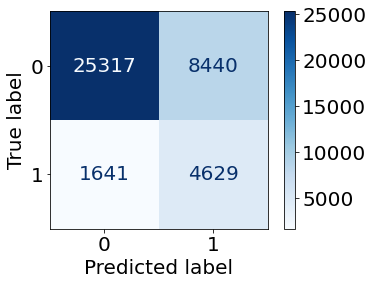

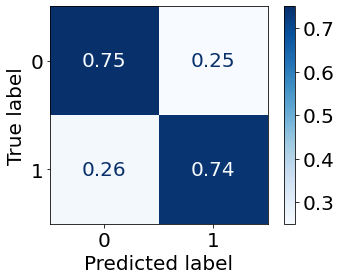

In [53]:
n = 0
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 4, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-35_39-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_35_39-Test-Set-Performance-LR-Trial-2/")

## Trial 3

In [54]:
random_state = 3
path = "Performance/Age_35_39-Validation-Set-Performance-LR-Trial-3/"


df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)



(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)


(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
4  group class 1:  (333, 50)
4  group class 1:  (333, 50)  # of DP units 1
New training set:  (120414, 50)
(120414, 48) (120081, 48) (40027, 48)
accuracy 0.778055361247127
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     33965
         1.0       0.37      0.68      0.48      6063

    accuracy                           0.78     40028
   macro avg       0.65      0.74      0.67     40028
weighted avg       0.85      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6806861289790532
Class 1 Precision: 0.3726410835214447
Class 1 Area Under Precision-Recall Curve: 0.4405090289442658
Class 1 F1-Score: 0.4816197922744777
Class 0 Recall: 0.7954364787281024
Class 0 Precision: 0.9331330086692226
Cl

Class 1 Recall: 0.26229508196721313
Class 1 Precision: 0.17204301075268819
Class 1 Area Under Precision-Recall Curve: 0.15840465743265733
Class 1 F1-Score: 0.2077922077922078
Class 0 Recall: 0.9637305699481865
Class 0 Precision: 0.9784791965566715
Class 0 Area Under Precision-Recall Curve: 0.9333890898440914
Class 0 F1-Score: 0.9710488846701472
Overall Accuracy: 0.9441391941391941
Balanced Accuracy: 0.6130128259576998
Area Under ROC Curve: 0.8278456869725026
Matthews Correlation Coefficient: 0.1844502101783648
0.26229508196721313
0.17204301075268819
0.15840465743265733
0.2077922077922078
0.9637305699481865
0.9784791965566715
0.9333890898440914
0.9710488846701472
0.9441391941391941
0.6130128259576998
0.8278456869725026
0.1844502101783648
============================  35-39 ============================ 
Class 1 Recall: 0.4112903225806452
Class 1 Precision: 0.2897727272727273
Class 1 Area Under Precision-Recall Curve: 0.2808699494465745
Class 1 F1-Score: 0.34
Class 0 Recall: 0.95286576168

accuracy 0.7805036474467872
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     33965
         1.0       0.37      0.67      0.48      6063

    accuracy                           0.78     40028
   macro avg       0.65      0.74      0.67     40028
weighted avg       0.85      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6717796470394194
Class 1 Precision: 0.37473548624528474
Class 1 Area Under Precision-Recall Curve: 0.4401731883475625
Class 1 F1-Score: 0.4811008740845736
Class 0 Recall: 0.7999116737818343
Class 0 Precision: 0.9317534894886655
Class 0 Area Under Precision-Recall Curve: 0.7235429430496352
Class 0 F1-Score: 0.8608136366516697
Overall Accuracy: 0.7805036474467872
Balanced Accuracy: 0.7358456604106268
Area Under ROC Curve: 0.8223474097082455
Matthews Correlation Coefficient: 0.38022123794062346
0.6717796470394194
0.37473548624528474
0.44017318

Class 1 Recall: 0.7392156862745098
Class 1 Precision: 0.4088937093275488
Class 1 Area Under Precision-Recall Curve: 0.520457831753461
Class 1 F1-Score: 0.526536312849162
Class 0 Recall: 0.7594880847308032
Class 0 Precision: 0.9282632146709816
Class 0 Area Under Precision-Recall Curve: 0.668443571119695
Class 0 F1-Score: 0.8354368932038835
Overall Accuracy: 0.7557636887608069
Balanced Accuracy: 0.7493518855026565
Area Under ROC Curve: 0.830833463129294
Matthews Correlation Coefficient: 0.41005052056864755
0.7392156862745098
0.4088937093275488
0.520457831753461
0.526536312849162
0.7594880847308032
0.9282632146709816
0.668443571119695
0.8354368932038835
0.7557636887608069
0.7493518855026565
0.830833463129294
0.41005052056864755
============================  30-34 ============================ 
Class 1 Recall: 0.2786885245901639
Class 1 Precision: 0.15454545454545454
Class 1 Area Under Precision-Recall Curve: 0.1580388751573312
Class 1 F1-Score: 0.19883040935672514
Class 0 Recall: 0.9561940

Class 1 Recall: 0.7105751391465677
Class 1 Precision: 0.3011006289308176
Class 1 Area Under Precision-Recall Curve: 0.374790920408089
Class 1 F1-Score: 0.42297073440088345
Class 0 Recall: 0.6059397163120568
Class 0 Precision: 0.8975705843729481
Class 0 Area Under Precision-Recall Curve: 0.701596007444928
Class 0 F1-Score: 0.7234718179412545
Overall Accuracy: 0.6261180679785331
Balanced Accuracy: 0.6582574277293123
Area Under ROC Curve: 0.7205970637771549
Matthews Correlation Coefficient: 0.25076361451101903
0.7105751391465677
0.3011006289308176
0.374790920408089
0.42297073440088345
0.6059397163120568
0.8975705843729481
0.701596007444928
0.7234718179412545
0.6261180679785331
0.6582574277293123
0.7205970637771549
0.25076361451101903
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
4  group class 1:  (333, 50)
4  group class 1:  (999, 50)  # of DP units 3
New training set:  (121080, 50)
(121080, 48) (120081, 48) (40027, 48)
accuracy 0.7707354851603877


Class 1 Recall: 0.7529411764705882
Class 1 Precision: 0.39344262295081966
Class 1 Area Under Precision-Recall Curve: 0.5190071432998692
Class 1 F1-Score: 0.5168236877523553
Class 0 Recall: 0.7387466902030009
Class 0 Precision: 0.93
Class 0 Area Under Precision-Recall Curve: 0.6689207116875563
Class 0 F1-Score: 0.823413674372848
Overall Accuracy: 0.7413544668587896
Balanced Accuracy: 0.7458439333367946
Area Under ROC Curve: 0.8291443850267379
Matthews Correlation Coefficient: 0.3987891839932455
0.7529411764705882
0.39344262295081966
0.5190071432998692
0.5168236877523553
0.7387466902030009
0.93
0.6689207116875563
0.823413674372848
0.7413544668587896
0.7458439333367946
0.8291443850267379
0.3987891839932455
============================  30-34 ============================ 
Class 1 Recall: 0.36065573770491804
Class 1 Precision: 0.16058394160583941
Class 1 Area Under Precision-Recall Curve: 0.15762653665505277
Class 1 F1-Score: 0.22222222222222224
Class 0 Recall: 0.945831370701837
Class 0 Pre

============================  80-99 ============================ 
Class 1 Recall: 0.712430426716141
Class 1 Precision: 0.29698375870069604
Class 1 Area Under Precision-Recall Curve: 0.374098696417294
Class 1 F1-Score: 0.4192139737991266
Class 0 Recall: 0.5970744680851063
Class 0 Precision: 0.8968042609853528
Class 0 Area Under Precision-Recall Curve: 0.7018140637368921
Class 0 F1-Score: 0.7168706758914316
Overall Accuracy: 0.6193202146690518
Balanced Accuracy: 0.6547524474006237
Area Under ROC Curve: 0.7203248562481085
Matthews Correlation Coefficient: 0.24490475831774405
0.712430426716141
0.29698375870069604
0.374098696417294
0.4192139737991266
0.5970744680851063
0.8968042609853528
0.7018140637368921
0.7168706758914316
0.6193202146690518
0.6547524474006237
0.7203248562481085
0.24490475831774405
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
4  group class 1:  (333, 50)
4  group class 1:  (1332, 50)  # of DP units 4
New training set:  (121413, 50)

Class 1 Recall: 0.7764705882352941
Class 1 Precision: 0.3815028901734104
Class 1 Area Under Precision-Recall Curve: 0.5169011604126702
Class 1 F1-Score: 0.5116279069767441
Class 0 Recall: 0.7166813768755517
Class 0 Precision: 0.9344073647871116
Class 0 Area Under Precision-Recall Curve: 0.6695024625776804
Class 0 F1-Score: 0.8111888111888113
Overall Accuracy: 0.7276657060518732
Balanced Accuracy: 0.7465759825554229
Area Under ROC Curve: 0.8272718619663223
Matthews Correlation Coefficient: 0.39470465291461887
0.7764705882352941
0.3815028901734104
0.5169011604126702
0.5116279069767441
0.7166813768755517
0.9344073647871116
0.6695024625776804
0.8111888111888113
0.7276657060518732
0.7465759825554229
0.8272718619663223
0.39470465291461887
============================  30-34 ============================ 
Class 1 Recall: 0.4262295081967213
Class 1 Precision: 0.14772727272727273
Class 1 Area Under Precision-Recall Curve: 0.1574614693229902
Class 1 F1-Score: 0.21940928270042193
Class 0 Recall: 0

============================  80-99 ============================ 
Class 1 Recall: 0.7198515769944341
Class 1 Precision: 0.2930513595166163
Class 1 Area Under Precision-Recall Curve: 0.3736988515218769
Class 1 F1-Score: 0.416532474503489
Class 0 Recall: 0.5851063829787234
Class 0 Precision: 0.8973487423521413
Class 0 Area Under Precision-Recall Curve: 0.7019640988474103
Class 0 F1-Score: 0.7083445130131473
Overall Accuracy: 0.6110912343470483
Balanced Accuracy: 0.6524789799865788
Area Under ROC Curve: 0.7200139968946959
Matthews Correlation Coefficient: 0.24096478299655685
0.7198515769944341
0.2930513595166163
0.3736988515218769
0.416532474503489
0.5851063829787234
0.8973487423521413
0.7019640988474103
0.7083445130131473
0.6110912343470483
0.6524789799865788
0.7200139968946959
0.24096478299655685
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
4  group class 1:  (333, 50)
4  group class 1:  (1665, 50)  # of DP units 5
New training set:  (121746, 50)

Class 1 Recall: 0.7549019607843137
Class 1 Precision: 0.3811881188118812
Class 1 Area Under Precision-Recall Curve: 0.5151140284396875
Class 1 F1-Score: 0.5065789473684211
Class 0 Recall: 0.7241835834068844
Class 0 Precision: 0.9292185730464326
Class 0 Area Under Precision-Recall Curve: 0.6700601697799479
Class 0 F1-Score: 0.8139880952380953
Overall Accuracy: 0.7298270893371758
Balanced Accuracy: 0.739542772095599
Area Under ROC Curve: 0.8253889552290465
Matthews Correlation Coefficient: 0.38563111763644004
0.7549019607843137
0.3811881188118812
0.5151140284396875
0.5065789473684211
0.7241835834068844
0.9292185730464326
0.6700601697799479
0.8139880952380953
0.7298270893371758
0.739542772095599
0.8253889552290465
0.38563111763644004
============================  30-34 ============================ 
Class 1 Recall: 0.4262295081967213
Class 1 Precision: 0.14285714285714285
Class 1 Area Under Precision-Recall Curve: 0.15660115107615113
Class 1 F1-Score: 0.21399176954732507
Class 0 Recall: 0.

Class 1 Recall: 0.699443413729128
Class 1 Precision: 0.30800653594771243
Class 1 Area Under Precision-Recall Curve: 0.3730453426941951
Class 1 F1-Score: 0.4276800907543959
Class 0 Recall: 0.6245567375886525
Class 0 Precision: 0.8968809675366008
Class 0 Area Under Precision-Recall Curve: 0.7021756637992094
Class 0 F1-Score: 0.7363470081003396
Overall Accuracy: 0.6389982110912343
Balanced Accuracy: 0.6620000756588902
Area Under ROC Curve: 0.719671064750852
Matthews Correlation Coefficient: 0.2576501157229311
0.699443413729128
0.30800653594771243
0.3730453426941951
0.4276800907543959
0.6245567375886525
0.8968809675366008
0.7021756637992094
0.7363470081003396
0.6389982110912343
0.6620000756588902
0.719671064750852
0.2576501157229311
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
4  group class 1:  (333, 50)
4  group class 1:  (1998, 50)  # of DP units 6
New training set:  (122079, 50)
(122079, 48) (120081, 48) (40027, 48)
accuracy 0.7843509543319677
 

Class 1 Recall: 0.4262295081967213
Class 1 Precision: 0.1511627906976744
Class 1 Area Under Precision-Recall Curve: 0.15636869271669016
Class 1 F1-Score: 0.223175965665236
Class 0 Recall: 0.9312293923692887
Class 0 Precision: 0.9826043737574552
Class 0 Area Under Precision-Recall Curve: 0.9335521818353658
Class 0 F1-Score: 0.9562273276904474
Overall Accuracy: 0.9171245421245421
Balanced Accuracy: 0.678729450283005
Area Under ROC Curve: 0.8274055427287399
Matthews Correlation Coefficient: 0.21866930177316457
0.4262295081967213
0.1511627906976744
0.15636869271669016
0.223175965665236
0.9312293923692887
0.9826043737574552
0.9335521818353658
0.9562273276904474
0.9171245421245421
0.678729450283005
0.8274055427287399
0.21866930177316457
============================  35-39 ============================ 
Class 1 Recall: 0.5080645161290323
Class 1 Precision: 0.21724137931034482
Class 1 Area Under Precision-Recall Curve: 0.2866220493553618
Class 1 F1-Score: 0.3043478260869565
Class 0 Recall: 0.91

accuracy 0.7819776156690317
              precision    recall  f1-score   support

         0.0       0.93      0.81      0.86     33965
         1.0       0.37      0.65      0.47      6063

    accuracy                           0.78     40028
   macro avg       0.65      0.73      0.67     40028
weighted avg       0.84      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.648688767936665
Class 1 Precision: 0.3735042735042735
Class 1 Area Under Precision-Recall Curve: 0.43449393390770574
Class 1 F1-Score: 0.4740553245344423
Class 0 Recall: 0.8057706462534963
Class 0 Precision: 0.9277917146925215
Class 0 Area Under Precision-Recall Curve: 0.7254808387808934
Class 0 F1-Score: 0.8624868033342262
Overall Accuracy: 0.7819776156690317
Balanced Accuracy: 0.7272297070950806
Area Under ROC Curve: 0.8167926331398523
Matthews Correlation Coefficient: 0.37003621213843546
0.648688767936665
0.3735042735042735
0.43449393390

Class 1 Recall: 0.7313725490196078
Class 1 Precision: 0.3918067226890756
Class 1 Area Under Precision-Recall Curve: 0.5095236836704424
Class 1 F1-Score: 0.5102599179206566
Class 0 Recall: 0.7444836716681377
Class 0 Precision: 0.924890350877193
Class 0 Area Under Precision-Recall Curve: 0.6715106413900782
Class 0 F1-Score: 0.8249388753056235
Overall Accuracy: 0.7420749279538905
Balanced Accuracy: 0.7379281103438727
Area Under ROC Curve: 0.8210295415606667
Matthews Correlation Coefficient: 0.38820390586663794
0.7313725490196078
0.3918067226890756
0.5095236836704424
0.5102599179206566
0.7444836716681377
0.924890350877193
0.6715106413900782
0.8249388753056235
0.7420749279538905
0.7379281103438727
0.8210295415606667
0.38820390586663794
============================  30-34 ============================ 
Class 1 Recall: 0.4426229508196721
Class 1 Precision: 0.13846153846153847
Class 1 Area Under Precision-Recall Curve: 0.15592307524018326
Class 1 F1-Score: 0.2109375
Class 0 Recall: 0.9208666980

0.300702648205443
============================  80-99 ============================ 
Class 1 Recall: 0.6326530612244898
Class 1 Precision: 0.3272552783109405
Class 1 Area Under Precision-Recall Curve: 0.3722082316107864
Class 1 F1-Score: 0.4313725490196078
Class 0 Recall: 0.68927304964539
Class 0 Precision: 0.8870507701083856
Class 0 Area Under Precision-Recall Curve: 0.7024913091351304
Class 0 F1-Score: 0.7757545522574208
Overall Accuracy: 0.6783542039355993
Balanced Accuracy: 0.6609630554349399
Area Under ROC Curve: 0.7190493460440268
Matthews Correlation Coefficient: 0.2626608320696594
0.6326530612244898
0.3272552783109405
0.3722082316107864
0.4313725490196078
0.68927304964539
0.8870507701083856
0.7024913091351304
0.7757545522574208
0.6783542039355993
0.6609630554349399
0.7190493460440268
0.2626608320696594
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
4  group class 1:  (333, 50)
4  group class 1:  (2664, 50)  # of DP units 8
New training set:

Class 1 Recall: 0.7313725490196078
Class 1 Precision: 0.3893528183716075
Class 1 Area Under Precision-Recall Curve: 0.5070661731953782
Class 1 F1-Score: 0.5081743869209808
Class 0 Recall: 0.7418358340688438
Class 0 Precision: 0.9246424642464246
Class 0 Area Under Precision-Recall Curve: 0.6722225947778153
Class 0 F1-Score: 0.8232125367286973
Overall Accuracy: 0.7399135446685879
Balanced Accuracy: 0.7366041915442259
Area Under ROC Curve: 0.8187641693923818
Matthews Correlation Coefficient: 0.3854675083390044
0.7313725490196078
0.3893528183716075
0.5070661731953782
0.5081743869209808
0.7418358340688438
0.9246424642464246
0.6722225947778153
0.8232125367286973
0.7399135446685879
0.7366041915442259
0.8187641693923818
0.3854675083390044
============================  30-34 ============================ 
Class 1 Recall: 0.47540983606557374
Class 1 Precision: 0.13615023474178403
Class 1 Area Under Precision-Recall Curve: 0.155377728243723
Class 1 F1-Score: 0.2116788321167883
Class 0 Recall: 0.91

============================  80-99 ============================ 
Class 1 Recall: 0.62708719851577
Class 1 Precision: 0.334322453016815
Class 1 Area Under Precision-Recall Curve: 0.37194393750984006
Class 1 F1-Score: 0.43612903225806454
Class 0 Recall: 0.7016843971631206
Class 0 Precision: 0.8873318385650224
Class 0 Area Under Precision-Recall Curve: 0.7025935685705083
Class 0 F1-Score: 0.7836633663366337
Overall Accuracy: 0.687298747763864
Balanced Accuracy: 0.6643857978394453
Area Under ROC Curve: 0.7187911189620917
Matthews Correlation Coefficient: 0.2699511717559951
0.62708719851577
0.334322453016815
0.37194393750984006
0.43612903225806454
0.7016843971631206
0.8873318385650224
0.7025935685705083
0.7836633663366337
0.687298747763864
0.6643857978394453
0.7187911189620917
0.2699511717559951
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
4  group class 1:  (333, 50)
4  group class 1:  (2997, 50)  # of DP units 9
New training set:  (123078, 50)
(12

Class 1 Recall: 0.7392156862745098
Class 1 Precision: 0.38391038696537677
Class 1 Area Under Precision-Recall Curve: 0.5033765367893628
Class 1 F1-Score: 0.5053619302949061
Class 0 Recall: 0.7330097087378641
Class 0 Precision: 0.9258639910813824
Class 0 Area Under Precision-Recall Curve: 0.6730600255062722
Class 0 F1-Score: 0.8182266009852218
Overall Accuracy: 0.734149855907781
Balanced Accuracy: 0.7361126975061869
Area Under ROC Curve: 0.8164667808871122
Matthews Correlation Coefficient: 0.3824700354770858
0.7392156862745098
0.38391038696537677
0.5033765367893628
0.5053619302949061
0.7330097087378641
0.9258639910813824
0.6730600255062722
0.8182266009852218
0.734149855907781
0.7361126975061869
0.8164667808871122
0.3824700354770858
============================  30-34 ============================ 
Class 1 Recall: 0.5245901639344263
Class 1 Precision: 0.13278008298755187
Class 1 Area Under Precision-Recall Curve: 0.15468677648081428
Class 1 F1-Score: 0.2119205298013245
Class 0 Recall: 0.9

Class 1 F1-Score: 0.4916387959866221
Class 0 Recall: 0.7134065934065934
Class 0 Precision: 0.8619224641529474
Class 0 Area Under Precision-Recall Curve: 0.6333643445507607
Class 0 F1-Score: 0.7806637806637806
Overall Accuracy: 0.6935483870967742
Balanced Accuracy: 0.6712539386433822
Area Under ROC Curve: 0.7570227775077989
Matthews Correlation Coefficient: 0.3014984145486144
0.6291012838801712
0.40347666971637697
0.4754405351133472
0.4916387959866221
0.7134065934065934
0.8619224641529474
0.6333643445507607
0.7806637806637806
0.6935483870967742
0.6712539386433822
0.7570227775077989
0.3014984145486144
============================  80-99 ============================ 
Class 1 Recall: 0.6196660482374768
Class 1 Precision: 0.34046890927624873
Class 1 Area Under Precision-Recall Curve: 0.37140047752762384
Class 1 F1-Score: 0.43947368421052635
Class 0 Recall: 0.713209219858156
Class 0 Precision: 0.8869900771775082
Class 0 Area Under Precision-Recall Curve: 0.702779767901248
Class 0 F1-Score: 0

Class 1 Recall: 0.7156862745098039
Class 1 Precision: 0.3989071038251366
Class 1 Area Under Precision-Recall Curve: 0.49985232232507976
Class 1 F1-Score: 0.512280701754386
Class 0 Recall: 0.7572815533980582
Class 0 Precision: 0.9220849005910801
Class 0 Area Under Precision-Recall Curve: 0.6738988907546103
Class 0 F1-Score: 0.8315968015507633
Overall Accuracy: 0.7496397694524496
Balanced Accuracy: 0.7364839139539311
Area Under ROC Curve: 0.8141313189000224
Matthews Correlation Coefficient: 0.3896394373065038
0.7156862745098039
0.3989071038251366
0.49985232232507976
0.512280701754386
0.7572815533980582
0.9220849005910801
0.6738988907546103
0.8315968015507633
0.7496397694524496
0.7364839139539311
0.8141313189000224
0.3896394373065038
============================  30-34 ============================ 
Class 1 Recall: 0.5245901639344263
Class 1 Precision: 0.1391304347826087
Class 1 Area Under Precision-Recall Curve: 0.15477231914903272
Class 1 F1-Score: 0.21993127147766325
Class 0 Recall: 0.9

============================  80-99 ============================ 
Class 1 Recall: 0.575139146567718
Class 1 Precision: 0.35147392290249435
Class 1 Area Under Precision-Recall Curve: 0.3708492819553867
Class 1 F1-Score: 0.43631245601688956
Class 0 Recall: 0.7464539007092199
Class 0 Precision: 0.880292733925771
Class 0 Area Under Precision-Recall Curve: 0.7029622252912444
Class 0 F1-Score: 0.8078675941472775
Overall Accuracy: 0.7134168157423971
Balanced Accuracy: 0.660796523638469
Area Under ROC Curve: 0.7180509776444427
Matthews Correlation Coefficient: 0.2730101562700373
0.575139146567718
0.35147392290249435
0.3708492819553867
0.43631245601688956
0.7464539007092199
0.880292733925771
0.7029622252912444
0.8078675941472775
0.7134168157423971
0.660796523638469
0.7180509776444427
0.2730101562700373
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
4  group class 1:  (333, 50)
4  group class 1:  (3663, 50)  # of DP units 11
New training set:  (123744, 50)


/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_plot/confusion_matrix.py:114: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


============================  Over all performance ============================ 
Class 1 Recall: 0.6145472538347353
Class 1 Precision: 0.3842029284388534
Class 1 Area Under Precision-Recall Curve: 0.42707083612417646
Class 1 F1-Score: 0.47281263879195484
Class 0 Recall: 0.824171941704696
Class 0 Precision: 0.9229475766567755
Class 0 Area Under Precision-Recall Curve: 0.7282659113623499
Class 0 F1-Score: 0.8707675557974959
Overall Accuracy: 0.7924203057859498
Balanced Accuracy: 0.7193595977697156
Area Under ROC Curve: 0.8111212537263003
Matthews Correlation Coefficient: 0.3670869413437153
0.6145472538347353
0.3842029284388534
0.42707083612417646
0.47281263879195484
0.824171941704696
0.9229475766567755
0.7282659113623499
0.8707675557974959
0.7924203057859498
0.7193595977697156
0.8111212537263003
0.3670869413437153
============================  Male ============================ 
Class 1 Recall: 0.6201675257731959
Class 1 Precision: 0.3793103448275862
Class 1 Area Under Precision-Recall Cu

Class 1 Recall: 0.5804878048780487
Class 1 Precision: 0.259825327510917
Class 1 Area Under Precision-Recall Curve: 0.3071427625186974
Class 1 F1-Score: 0.358974358974359
Class 0 Recall: 0.8825770696224454
Class 0 Precision: 0.9673500379650721
Class 0 Area Under Precision-Recall Curve: 0.8507688329083622
Class 0 F1-Score: 0.9230211918130773
Overall Accuracy: 0.86254851228978
Balanced Accuracy: 0.7315324372502471
Area Under ROC Curve: 0.8472969662152459
Matthews Correlation Coefficient: 0.32434076540537243
0.5804878048780487
0.259825327510917
0.3071427625186974
0.358974358974359
0.8825770696224454
0.9673500379650721
0.8507688329083622
0.9230211918130773
0.86254851228978
0.7315324372502471
0.8472969662152459
0.32434076540537243
============================  45-49 ============================ 
Class 1 Recall: 0.6045016077170418
Class 1 Precision: 0.3363148479427549
Class 1 Area Under Precision-Recall Curve: 0.3750102318040422
Class 1 F1-Score: 0.432183908045977
Class 0 Recall: 0.8712252690

Class 1 Recall: 0.617590206185567
Class 1 Precision: 0.3782557221783741
Class 1 Area Under Precision-Recall Curve: 0.43169123749374966
Class 1 F1-Score: 0.4691629955947137
Class 0 Recall: 0.80392034847542
Class 0 Precision: 0.9158514107471998
Class 0 Area Under Precision-Recall Curve: 0.7122598650012297
Class 0 F1-Score: 0.8562433722163308
Overall Accuracy: 0.7737561280901221
Balanced Accuracy: 0.7107552773304935
Area Under ROC Curve: 0.7919950029349688
Matthews Correlation Coefficient: 0.35209268769631
0.617590206185567
0.3782557221783741
0.43169123749374966
0.4691629955947137
0.80392034847542
0.9158514107471998
0.7122598650012297
0.8562433722163308
0.7737561280901221
0.7107552773304935
0.7919950029349688
0.35209268769631
============================  Female ============================ 
Class 1 Recall: 0.6069618114227779
Class 1 Precision: 0.38798876647224023
Class 1 Area Under Precision-Recall Curve: 0.433609354849257
Class 1 F1-Score: 0.4733790195044808
Class 0 Recall: 0.8416876222

Class 1 Recall: 0.5902439024390244
Class 1 Precision: 0.25260960334029225
Class 1 Area Under Precision-Recall Curve: 0.3066430582862126
Class 1 F1-Score: 0.3538011695906433
Class 0 Recall: 0.8759958434360928
Class 0 Precision: 0.9678530424799081
Class 0 Area Under Precision-Recall Curve: 0.850826493411931
Class 0 F1-Score: 0.9196363636363636
Overall Accuracy: 0.8570504527813713
Balanced Accuracy: 0.7331198729375585
Area Under ROC Curve: 0.8472040349083783
Matthews Correlation Coefficient: 0.3206063754234563
0.5902439024390244
0.25260960334029225
0.3066430582862126
0.3538011695906433
0.8759958434360928
0.9678530424799081
0.850826493411931
0.9196363636363636
0.8570504527813713
0.7331198729375585
0.8472040349083783
0.3206063754234563
============================  45-49 ============================ 
Class 1 Recall: 0.617363344051447
Class 1 Precision: 0.3339130434782609
Class 1 Area Under Precision-Recall Curve: 0.3750674953891709
Class 1 F1-Score: 0.4334085778781039
Class 0 Recall: 0.8670

Class 1 Recall: 0.6111469072164949
Class 1 Precision: 0.3789452656811826
Class 1 Area Under Precision-Recall Curve: 0.4291472185902226
Class 1 F1-Score: 0.4678175092478422
Class 0 Recall: 0.8065339141257001
Class 0 Precision: 0.9148080180688877
Class 0 Area Under Precision-Recall Curve: 0.7129342797780708
Class 0 F1-Score: 0.8572656921754085
Overall Accuracy: 0.7749035151768019
Balanced Accuracy: 0.7088404106710975
Area Under ROC Curve: 0.7901158611005973
Matthews Correlation Coefficient: 0.3502786217123394
0.6111469072164949
0.3789452656811826
0.4291472185902226
0.4678175092478422
0.8065339141257001
0.9148080180688877
0.7129342797780708
0.8572656921754085
0.7749035151768019
0.7088404106710975
0.7901158611005973
0.3502786217123394
============================  Female ============================ 
Class 1 Recall: 0.60256843528219
Class 1 Precision: 0.3869357638888889
Class 1 Area Under Precision-Recall Curve: 0.4320399211524063
Class 1 F1-Score: 0.47125677282939077
Class 0 Recall: 0.842

Class 1 Recall: 0.6
Class 1 Precision: 0.24798387096774194
Class 1 Area Under Precision-Recall Curve: 0.3062950376424888
Class 1 F1-Score: 0.3509272467902996
Class 0 Recall: 0.8708001385521302
Class 0 Precision: 0.9684129429892142
Class 0 Area Under Precision-Recall Curve: 0.8508758982083224
Class 0 F1-Score: 0.9170162319897867
Overall Accuracy: 0.8528460543337646
Balanced Accuracy: 0.7354000692760652
Area Under ROC Curve: 0.8470519654971402
Matthews Correlation Coefficient: 0.31918591759846565
0.6
0.24798387096774194
0.3062950376424888
0.3509272467902996
0.8708001385521302
0.9684129429892142
0.8508758982083224
0.9170162319897867
0.8528460543337646
0.7354000692760652
0.8470519654971402
0.31918591759846565
============================  45-49 ============================ 
Class 1 Recall: 0.617363344051447
Class 1 Precision: 0.32989690721649484
Class 1 Area Under Precision-Recall Curve: 0.3747757821003035
Class 1 F1-Score: 0.4300111982082867
Class 0 Recall: 0.8646303366886497
Class 0 Prec

Class 1 Recall: 0.6166237113402062
Class 1 Precision: 0.37222870478413067
Class 1 Area Under Precision-Recall Curve: 0.4264423016813234
Class 1 F1-Score: 0.46422507882609754
Class 0 Recall: 0.7991288114499067
Class 0 Precision: 0.915193842645382
Class 0 Area Under Precision-Recall Curve: 0.7136350319228155
Class 0 F1-Score: 0.8532323433658893
Overall Accuracy: 0.7695838114112861
Balanced Accuracy: 0.7078762613950564
Area Under ROC Curve: 0.7882249513244247
Matthews Correlation Coefficient: 0.34568287374496987
0.6166237113402062
0.37222870478413067
0.4264423016813234
0.46422507882609754
0.7991288114499067
0.915193842645382
0.7136350319228155
0.8532323433658893
0.7695838114112861
0.7078762613950564
0.7882249513244247
0.34568287374496987
============================  Female ============================ 
Class 1 Recall: 0.6100033795201082
Class 1 Precision: 0.38217234808384504
Class 1 Area Under Precision-Recall Curve: 0.43045520749588195
Class 1 F1-Score: 0.4699297058057798
Class 0 Recall

Class 1 Recall: 0.6195121951219512
Class 1 Precision: 0.23962264150943396
Class 1 Area Under Precision-Recall Curve: 0.305923802446643
Class 1 F1-Score: 0.3455782312925171
Class 0 Recall: 0.860408728784205
Class 0 Precision: 0.9695550351288056
Class 0 Area Under Precision-Recall Curve: 0.8509655682953103
Class 0 F1-Score: 0.9117269223710772
Overall Accuracy: 0.8444372574385511
Balanced Accuracy: 0.7399604619530782
Area Under ROC Curve: 0.8469590341902726
Matthews Correlation Coefficient: 0.31684182778283415
0.6195121951219512
0.23962264150943396
0.305923802446643
0.3455782312925171
0.860408728784205
0.9695550351288056
0.8509655682953103
0.9117269223710772
0.8444372574385511
0.7399604619530782
0.8469590341902726
0.31684182778283415
============================  45-49 ============================ 
Class 1 Recall: 0.6302250803858521
Class 1 Precision: 0.31921824104234525
Class 1 Area Under Precision-Recall Curve: 0.37466598490727476
Class 1 F1-Score: 0.42378378378378373
Class 0 Recall: 0.

Class 1 Recall: 0.6108247422680413
Class 1 Precision: 0.3747776240363708
Class 1 Area Under Precision-Recall Curve: 0.4238945800307647
Class 1 F1-Score: 0.46453509739066523
Class 0 Recall: 0.8031736154324829
Class 0 Precision: 0.9144172865745661
Class 0 Area Under Precision-Recall Curve: 0.7143133928709232
Class 0 F1-Score: 0.8551929766440285
Overall Accuracy: 0.7720350474601022
Balanced Accuracy: 0.7069991788502621
Area Under ROC Curve: 0.7863577177650614
Matthews Correlation Coefficient: 0.3460147656506551
0.6108247422680413
0.3747776240363708
0.4238945800307647
0.46453509739066523
0.8031736154324829
0.9144172865745661
0.7143133928709232
0.8551929766440285
0.7720350474601022
0.7069991788502621
0.7863577177650614
0.3460147656506551
============================  Female ============================ 
Class 1 Recall: 0.601892531260561
Class 1 Precision: 0.38358819728623733
Class 1 Area Under Precision-Recall Curve: 0.4287145013783481
Class 1 F1-Score: 0.46856090502499337
Class 0 Recall: 0

Class 1 Recall: 0.6292682926829268
Class 1 Precision: 0.24202626641651032
Class 1 Area Under Precision-Recall Curve: 0.3059309645280107
Class 1 F1-Score: 0.3495934959349593
Class 0 Recall: 0.8600623484586075
Class 0 Precision: 0.9703008987885893
Class 0 Area Under Precision-Recall Curve: 0.8509609868469263
Class 0 F1-Score: 0.9118619170033051
Overall Accuracy: 0.8447606727037517
Balanced Accuracy: 0.7446653205707672
Area Under ROC Curve: 0.8469573445301477
Matthews Correlation Coefficient: 0.3223324182913904
0.6292682926829268
0.24202626641651032
0.3059309645280107
0.3495934959349593
0.8600623484586075
0.9703008987885893
0.8509609868469263
0.9118619170033051
0.8447606727037517
0.7446653205707672
0.8469573445301477
0.3223324182913904
============================  45-49 ============================ 
Class 1 Recall: 0.6302250803858521
Class 1 Precision: 0.3197389885807504
Class 1 Area Under Precision-Recall Curve: 0.37458685704387434
Class 1 F1-Score: 0.42424242424242425
Class 0 Recall: 0

Class 1 Recall: 0.6301546391752577
Class 1 Precision: 0.36121883656509696
Class 1 Area Under Precision-Recall Curve: 0.42137458669522654
Class 1 F1-Score: 0.459208827327151
Class 0 Recall: 0.7847542003733665
Class 0 Precision: 0.9165637037575405
Class 0 Area Under Precision-Recall Curve: 0.714996436251424
Class 0 F1-Score: 0.8455529853498273
Overall Accuracy: 0.7597267132575363
Balanced Accuracy: 0.7074544197743121
Area Under ROC Curve: 0.7844696547482343
Matthews Correlation Coefficient: 0.3394914306019144
0.6301546391752577
0.36121883656509696
0.42137458669522654
0.459208827327151
0.7847542003733665
0.9165637037575405
0.714996436251424
0.8455529853498273
0.7597267132575363
0.7074544197743121
0.7844696547482343
0.3394914306019144
============================  Female ============================ 
Class 1 Recall: 0.6225076039202433
Class 1 Precision: 0.37077294685990336
Class 1 Area Under Precision-Recall Curve: 0.4268935360226824
Class 1 F1-Score: 0.46474075942979687
Class 0 Recall: 0.

Class 1 Recall: 0.6559485530546624
Class 1 Precision: 0.3067669172932331
Class 1 Area Under Precision-Recall Curve: 0.37427725705287107
Class 1 F1-Score: 0.4180327868852459
Class 0 Recall: 0.839986115931968
Class 0 Precision: 0.9576573011476058
Class 0 Area Under Precision-Recall Curve: 0.7954078566395137
Class 0 F1-Score: 0.8949704142011834
Overall Accuracy: 0.8220551378446115
Balanced Accuracy: 0.7479673344933152
Area Under ROC Curve: 0.8468600689069421
Matthews Correlation Coefficient: 0.36212861975340466
0.6559485530546624
0.3067669172932331
0.37427725705287107
0.4180327868852459
0.839986115931968
0.9576573011476058
0.7954078566395137
0.8949704142011834
0.8220551378446115
0.7479673344933152
0.8468600689069421
0.36212861975340466
============================  50-54 ============================ 
Class 1 Recall: 0.6357894736842106
Class 1 Precision: 0.33186813186813185
Class 1 Area Under Precision-Recall Curve: 0.4026887069047153
Class 1 F1-Score: 0.43610108303249095
Class 0 Recall: 0

Class 1 Recall: 0.5770617395223073
Class 1 Precision: 0.3605011261261261
Class 1 Area Under Precision-Recall Curve: 0.401446900666755
Class 1 F1-Score: 0.4437705770230463
Class 0 Recall: 0.8343059304106791
Class 0 Precision: 0.9241677440206852
Class 0 Area Under Precision-Recall Curve: 0.7426536358857209
Class 0 F1-Score: 0.8769407705577917
Overall Accuracy: 0.7984681064791562
Balanced Accuracy: 0.7056838349664932
Area Under ROC Curve: 0.8001772485853266
Matthews Correlation Coefficient: 0.34220398860146223
0.5770617395223073
0.3605011261261261
0.401446900666755
0.4437705770230463
0.8343059304106791
0.9241677440206852
0.7426536358857209
0.8769407705577917
0.7984681064791562
0.7056838349664932
0.8001772485853266
0.34220398860146223
============================  Black ============================ 
Class 1 Recall: 0.7680722891566265
Class 1 Precision: 0.39504260263361735
Class 1 Area Under Precision-Recall Curve: 0.4774134674427106
Class 1 F1-Score: 0.5217391304347826
Class 0 Recall: 0.63

Class 1 Recall: 0.6644295302013423
Class 1 Precision: 0.4289428076256499
Class 1 Area Under Precision-Recall Curve: 0.49332075364292916
Class 1 F1-Score: 0.5213270142180094
Class 0 Recall: 0.8211668928086838
Class 0 Precision: 0.9236874236874237
Class 0 Area Under Precision-Recall Curve: 0.6915138721010811
Class 0 F1-Score: 0.8694153138916821
Overall Accuracy: 0.7948081264108352
Balanced Accuracy: 0.7427982115050131
Area Under ROC Curve: 0.8232792110223744
Matthews Correlation Coefficient: 0.4138066927574114
0.6644295302013423
0.4289428076256499
0.49332075364292916
0.5213270142180094
0.8211668928086838
0.9236874236874237
0.6915138721010811
0.8694153138916821
0.7948081264108352
0.7427982115050131
0.8232792110223744
0.4138066927574114
============================  60-64 ============================ 
Class 1 Recall: 0.633769322235434
Class 1 Precision: 0.3887673231218089
Class 1 Area Under Precision-Recall Curve: 0.47272545269482164
Class 1 F1-Score: 0.48191681735985537
Class 0 Recall: 0.

Class 1 Recall: 0.8
Class 1 Precision: 0.49230769230769234
Class 1 Area Under Precision-Recall Curve: 0.6376520524199788
Class 1 F1-Score: 0.6095238095238096
Class 0 Recall: 0.7
Class 0 Precision: 0.9058823529411765
Class 0 Area Under Precision-Recall Curve: 0.5725333716661407
Class 0 F1-Score: 0.7897435897435896
Overall Accuracy: 0.7266666666666667
Balanced Accuracy: 0.75
Area Under ROC Curve: 0.8188636363636365
Matthews Correlation Coefficient: 0.4462006528731602
0.8
0.49230769230769234
0.6376520524199788
0.6095238095238096
0.7
0.9058823529411765
0.5725333716661407
0.7897435897435896
0.7266666666666667
0.75
0.8188636363636365
0.4462006528731602
============================  Other race ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.38372093023255816
Class 1 Area Under Precision-Recall Curve: 0.46463173994644247
Class 1 F1-Score: 0.5038167938931298
Class 0 Recall: 0.7725321888412017
Class 0 Precision: 0.9375
Class 0 Area Under Precision-Recall Cur

============================  70-74 ============================ 
Class 1 Recall: 0.6147934678194045
Class 1 Precision: 0.42953020134228187
Class 1 Area Under Precision-Recall Curve: 0.47910617068832473
Class 1 F1-Score: 0.5057289608850257
Class 0 Recall: 0.764281752634498
Class 0 Precision: 0.8729806778587267
Class 0 Area Under Precision-Recall Curve: 0.6405718881343094
Class 0 F1-Score: 0.8150229188230076
Overall Accuracy: 0.7307940606843124
Balanced Accuracy: 0.6895376102269513
Area Under ROC Curve: 0.7710063225822262
Matthews Correlation Coefficient: 0.3386360557040939
0.6147934678194045
0.42953020134228187
0.47910617068832473
0.5057289608850257
0.764281752634498
0.8729806778587267
0.6405718881343094
0.8150229188230076
0.7307940606843124
0.6895376102269513
0.7710063225822262
0.3386360557040939
============================  75-79 ============================ 
Class 1 Recall: 0.5620542082738944
Class 1 Precision: 0.43392070484581496
Class 1 Area Under Precision-Recall Curve: 0.471512

Class 1 Recall: 0.775
Class 1 Precision: 0.49206349206349204
Class 1 Area Under Precision-Recall Curve: 0.6424313919218703
Class 1 F1-Score: 0.6019417475728155
Class 0 Recall: 0.7090909090909091
Class 0 Precision: 0.896551724137931
Class 0 Area Under Precision-Recall Curve: 0.5717276512522668
Class 0 F1-Score: 0.7918781725888325
Overall Accuracy: 0.7266666666666667
Balanced Accuracy: 0.7420454545454546
Area Under ROC Curve: 0.8188636363636363
Matthews Correlation Coefficient: 0.4337338968740016
0.775
0.49206349206349204
0.6424313919218703
0.6019417475728155
0.7090909090909091
0.896551724137931
0.5717276512522668
0.7918781725888325
0.7266666666666667
0.7420454545454546
0.8188636363636363
0.4337338968740016
============================  Other race ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.39285714285714285
Class 1 Area Under Precision-Recall Curve: 0.4611772305712584
Class 1 F1-Score: 0.5116279069767441
Class 0 Recall: 0.7811158798283262
Class 

Class 1 Recall: 0.6392156862745098
Class 1 Precision: 0.42670157068062825
Class 1 Area Under Precision-Recall Curve: 0.4839988393451476
Class 1 F1-Score: 0.5117739403453688
Class 0 Recall: 0.7891696750902527
Class 0 Precision: 0.8990951466959145
Class 0 Area Under Precision-Recall Curve: 0.664543105562426
Class 0 F1-Score: 0.8405537041784157
Overall Accuracy: 0.7596135265700483
Balanced Accuracy: 0.7141926806823813
Area Under ROC Curve: 0.7934189849224887
Matthews Correlation Coefficient: 0.3735860603727121
0.6392156862745098
0.42670157068062825
0.4839988393451476
0.5117739403453688
0.7891696750902527
0.8990951466959145
0.664543105562426
0.8405537041784157
0.7596135265700483
0.7141926806823813
0.7934189849224887
0.3735860603727121
============================  70-74 ============================ 
Class 1 Recall: 0.6051873198847262
Class 1 Precision: 0.43448275862068964
Class 1 Area Under Precision-Recall Curve: 0.4788689917843531
Class 1 F1-Score: 0.5058209554395825
Class 0 Recall: 0.77

============================  Native Hawaiian ============================ 
Class 1 Recall: 0.775
Class 1 Precision: 0.49206349206349204
Class 1 Area Under Precision-Recall Curve: 0.635420393884923
Class 1 F1-Score: 0.6019417475728155
Class 0 Recall: 0.7090909090909091
Class 0 Precision: 0.896551724137931
Class 0 Area Under Precision-Recall Curve: 0.5731140953841827
Class 0 F1-Score: 0.7918781725888325
Overall Accuracy: 0.7266666666666667
Balanced Accuracy: 0.7420454545454546
Area Under ROC Curve: 0.8154545454545454
Matthews Correlation Coefficient: 0.4337338968740016
0.775
0.49206349206349204
0.635420393884923
0.6019417475728155
0.7090909090909091
0.896551724137931
0.5731140953841827
0.7918781725888325
0.7266666666666667
0.7420454545454546
0.8154545454545454
0.4337338968740016
============================  Other race ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.38372093023255816
Class 1 Area Under Precision-Recall Curve: 0.4553900238927829
Clas

Class 1 Recall: 0.6392156862745098
Class 1 Precision: 0.4303630363036304
Class 1 Area Under Precision-Recall Curve: 0.4837976014365545
Class 1 F1-Score: 0.5143984220907298
Class 0 Recall: 0.7922984356197352
Class 0 Precision: 0.8994535519125683
Class 0 Area Under Precision-Recall Curve: 0.6646140193387935
Class 0 F1-Score: 0.8424824056301984
Overall Accuracy: 0.7621256038647343
Balanced Accuracy: 0.7157570609471224
Area Under ROC Curve: 0.7931882211368302
Matthews Correlation Coefficient: 0.37725391376401757
0.6392156862745098
0.4303630363036304
0.4837976014365545
0.5143984220907298
0.7922984356197352
0.8994535519125683
0.6646140193387935
0.8424824056301984
0.7621256038647343
0.7157570609471224
0.7931882211368302
0.37725391376401757
============================  70-74 ============================ 
Class 1 Recall: 0.5975024015369836
Class 1 Precision: 0.43466107617051014
Class 1 Area Under Precision-Recall Curve: 0.4785434089935566
Class 1 F1-Score: 0.5032362459546925
Class 0 Recall: 0.

============================  Native Hawaiian ============================ 
Class 1 Recall: 0.775
Class 1 Precision: 0.49206349206349204
Class 1 Area Under Precision-Recall Curve: 0.6342078542579951
Class 1 F1-Score: 0.6019417475728155
Class 0 Recall: 0.7090909090909091
Class 0 Precision: 0.896551724137931
Class 0 Area Under Precision-Recall Curve: 0.5736503480815521
Class 0 F1-Score: 0.7918781725888325
Overall Accuracy: 0.7266666666666667
Balanced Accuracy: 0.7420454545454546
Area Under ROC Curve: 0.8136363636363637
Matthews Correlation Coefficient: 0.4337338968740016
0.775
0.49206349206349204
0.6342078542579951
0.6019417475728155
0.7090909090909091
0.896551724137931
0.5736503480815521
0.7918781725888325
0.7266666666666667
0.7420454545454546
0.8136363636363637
0.4337338968740016
============================  Other race ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.39285714285714285
Class 1 Area Under Precision-Recall Curve: 0.4500499927129446
Cl

Class 1 Recall: 0.6392156862745098
Class 1 Precision: 0.4297956493078444
Class 1 Area Under Precision-Recall Curve: 0.4834255576053121
Class 1 F1-Score: 0.5139929050059125
Class 0 Recall: 0.7918170878459687
Class 0 Precision: 0.8993985784581738
Class 0 Area Under Precision-Recall Curve: 0.6647081838781983
Class 0 F1-Score: 0.8421861000895943
Overall Accuracy: 0.7617391304347826
Balanced Accuracy: 0.7155163870602392
Area Under ROC Curve: 0.7929430641089168
Matthews Correlation Coefficient: 0.37668753791230675
0.6392156862745098
0.4297956493078444
0.4834255576053121
0.5139929050059125
0.7918170878459687
0.8993985784581738
0.6647081838781983
0.8421861000895943
0.7617391304347826
0.7155163870602392
0.7929430641089168
0.37668753791230675
============================  70-74 ============================ 
Class 1 Recall: 0.5965417867435159
Class 1 Precision: 0.43487394957983194
Class 1 Area Under Precision-Recall Curve: 0.4782788293747692
Class 1 F1-Score: 0.503037667071689
Class 0 Recall: 0.7

Class 1 Recall: 0.775
Class 1 Precision: 0.49206349206349204
Class 1 Area Under Precision-Recall Curve: 0.6259648559275665
Class 1 F1-Score: 0.6019417475728155
Class 0 Recall: 0.7090909090909091
Class 0 Precision: 0.896551724137931
Class 0 Area Under Precision-Recall Curve: 0.575555608357007
Class 0 F1-Score: 0.7918781725888325
Overall Accuracy: 0.7266666666666667
Balanced Accuracy: 0.7420454545454546
Area Under ROC Curve: 0.8118181818181818
Matthews Correlation Coefficient: 0.4337338968740016
0.775
0.49206349206349204
0.6259648559275665
0.6019417475728155
0.7090909090909091
0.896551724137931
0.575555608357007
0.7918781725888325
0.7266666666666667
0.7420454545454546
0.8118181818181818
0.4337338968740016
============================  Other race ============================ 
Class 1 Recall: 0.7111111111111111
Class 1 Precision: 0.4
Class 1 Area Under Precision-Recall Curve: 0.44706277861072263
Class 1 F1-Score: 0.512
Class 0 Recall: 0.7939914163090128
Class 0 Precision: 0.934343434343434

Class 1 Recall: 0.5840537944284342
Class 1 Precision: 0.44153957879448075
Class 1 Area Under Precision-Recall Curve: 0.47791868052227543
Class 1 F1-Score: 0.5028949545078577
Class 0 Recall: 0.7867443150305047
Class 0 Precision: 0.8675840978593272
Class 0 Area Under Precision-Recall Curve: 0.6409313583461367
Class 0 F1-Score: 0.8251890634089587
Overall Accuracy: 0.7413384979556703
Balanced Accuracy: 0.6853990547294695
Area Under ROC Curve: 0.7701914250078452
Matthews Correlation Coefficient: 0.33855941117066635
0.5840537944284342
0.44153957879448075
0.47791868052227543
0.5028949545078577
0.7867443150305047
0.8675840978593272
0.6409313583461367
0.8251890634089587
0.7413384979556703
0.6853990547294695
0.7701914250078452
0.33855941117066635
============================  75-79 ============================ 
Class 1 Recall: 0.5263908701854494
Class 1 Precision: 0.44945188794153473
Class 1 Area Under Precision-Recall Curve: 0.4701049196044238
Class 1 F1-Score: 0.4848883048620236
Class 0 Recall

Class 1 Recall: 0.775
Class 1 Precision: 0.4696969696969697
Class 1 Area Under Precision-Recall Curve: 0.6218082840455499
Class 1 F1-Score: 0.5849056603773586
Class 0 Recall: 0.6818181818181818
Class 0 Precision: 0.8928571428571429
Class 0 Area Under Precision-Recall Curve: 0.5766037671941878
Class 0 F1-Score: 0.7731958762886597
Overall Accuracy: 0.7066666666666667
Balanced Accuracy: 0.7284090909090909
Area Under ROC Curve: 0.8093181818181818
Matthews Correlation Coefficient: 0.4069659820030099
0.775
0.4696969696969697
0.6218082840455499
0.5849056603773586
0.6818181818181818
0.8928571428571429
0.5766037671941878
0.7731958762886597
0.7066666666666667
0.7284090909090909
0.8093181818181818
0.4069659820030099
============================  Other race ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.34375
Class 1 Area Under Precision-Recall Curve: 0.4451349199244031
Class 1 F1-Score: 0.4680851063829787
Class 0 Recall: 0.7296137339055794
Class 0 Precision:

Class 1 Recall: 0.6568627450980392
Class 1 Precision: 0.41563275434243174
Class 1 Area Under Precision-Recall Curve: 0.482874775415079
Class 1 F1-Score: 0.5091185410334346
Class 0 Recall: 0.7732851985559567
Class 0 Precision: 0.9017681728880157
Class 0 Area Under Precision-Recall Curve: 0.6648706510152684
Class 0 F1-Score: 0.8325991189427313
Overall Accuracy: 0.7503381642512077
Balanced Accuracy: 0.715073971826998
Area Under ROC Curve: 0.792498761237347
Matthews Correlation Coefficient: 0.3694987904744055
0.6568627450980392
0.41563275434243174
0.482874775415079
0.5091185410334346
0.7732851985559567
0.9017681728880157
0.6648706510152684
0.8325991189427313
0.7503381642512077
0.715073971826998
0.792498761237347
0.3694987904744055
============================  70-74 ============================ 
Class 1 Recall: 0.6147934678194045
Class 1 Precision: 0.42780748663101603
Class 1 Area Under Precision-Recall Curve: 0.4776232377202466
Class 1 F1-Score: 0.5045329128892393
Class 0 Recall: 0.762617

Class 1 Recall: 0.7142857142857143
Class 1 Precision: 0.34334763948497854
Class 1 Area Under Precision-Recall Curve: 0.4176966894032111
Class 1 F1-Score: 0.46376811594202905
Class 0 Recall: 0.7769679300291545
Class 0 Precision: 0.9433628318584071
Class 0 Area Under Precision-Recall Curve: 0.7429477666000159
Class 0 F1-Score: 0.8521183053557155
Overall Accuracy: 0.768170426065163
Balanced Accuracy: 0.7456268221574345
Area Under ROC Curve: 0.7912588504789672
Matthews Correlation Coefficient: 0.3752966345581478
0.7142857142857143
0.34334763948497854
0.4176966894032111
0.46376811594202905
0.7769679300291545
0.9433628318584071
0.7429477666000159
0.8521183053557155
0.768170426065163
0.7456268221574345
0.7912588504789672
0.3752966345581478
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.775
Class 1 Precision: 0.484375
Class 1 Area Under Precision-Recall Curve: 0.6200623227383303
Class 1 F1-Score: 0.5961538461538463
Class 0 Recall: 0.7
Class 0 Prec

Class 1 Recall: 0.6470588235294118
Class 1 Precision: 0.4230769230769231
Class 1 Area Under Precision-Recall Curve: 0.4823207018224683
Class 1 F1-Score: 0.5116279069767442
Class 0 Recall: 0.7833935018050542
Class 0 Precision: 0.9004149377593361
Class 0 Area Under Precision-Recall Curve: 0.664986446576737
Class 0 F1-Score: 0.8378378378378379
Overall Accuracy: 0.7565217391304347
Balanced Accuracy: 0.7152261626672329
Area Under ROC Curve: 0.7922750760954201
Matthews Correlation Coefficient: 0.37315924713685067
0.6470588235294118
0.4230769230769231
0.4823207018224683
0.5116279069767442
0.7833935018050542
0.9004149377593361
0.664986446576737
0.8378378378378379
0.7565217391304347
0.7152261626672329
0.7922750760954201
0.37315924713685067
============================  70-74 ============================ 
Class 1 Recall: 0.6051873198847262
Class 1 Precision: 0.4341833218470021
Class 1 Area Under Precision-Recall Curve: 0.4772915802111988
Class 1 F1-Score: 0.5056179775280898
Class 0 Recall: 0.772

============================  Native Hawaiian ============================ 
Class 1 Recall: 0.775
Class 1 Precision: 0.47692307692307695
Class 1 Area Under Precision-Recall Curve: 0.6193254704645239
Class 1 F1-Score: 0.5904761904761905
Class 0 Recall: 0.6909090909090909
Class 0 Precision: 0.8941176470588236
Class 0 Area Under Precision-Recall Curve: 0.5771746102113815
Class 0 F1-Score: 0.7794871794871796
Overall Accuracy: 0.7133333333333334
Balanced Accuracy: 0.7329545454545454
Area Under ROC Curve: 0.8079545454545455
Matthews Correlation Coefficient: 0.41577788108635383
0.775
0.47692307692307695
0.6193254704645239
0.5904761904761905
0.6909090909090909
0.8941176470588236
0.5771746102113815
0.7794871794871796
0.7133333333333334
0.7329545454545454
0.8079545454545455
0.41577788108635383
============================  Other race ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.3473684210526316
Class 1 Area Under Precision-Recall Curve: 0.4365431940848779

Class 1 Recall: 0.6558823529411765
Class 1 Precision: 0.41578620261031696
Class 1 Area Under Precision-Recall Curve: 0.4819557987147271
Class 1 F1-Score: 0.508938759984785
Class 0 Recall: 0.7737665463297232
Class 0 Precision: 0.9015703869882221
Class 0 Area Under Precision-Recall Curve: 0.6650755045309241
Class 0 F1-Score: 0.8327936795751846
Overall Accuracy: 0.7505314009661835
Balanced Accuracy: 0.7148244496354499
Area Under ROC Curve: 0.7920596493711805
Matthews Correlation Coefficient: 0.36925859420923296
0.6558823529411765
0.41578620261031696
0.4819557987147271
0.508938759984785
0.7737665463297232
0.9015703869882221
0.6650755045309241
0.8327936795751846
0.7505314009661835
0.7148244496354499
0.7920596493711805
0.36925859420923296
============================  70-74 ============================ 
Class 1 Recall: 0.6128722382324687
Class 1 Precision: 0.42962962962962964
Class 1 Area Under Precision-Recall Curve: 0.4768714944818486
Class 1 F1-Score: 0.5051464766429137
Class 0 Recall: 0.

============================  Native Hawaiian ============================ 
Class 1 Recall: 0.775
Class 1 Precision: 0.47692307692307695
Class 1 Area Under Precision-Recall Curve: 0.61597092738231
Class 1 F1-Score: 0.5904761904761905
Class 0 Recall: 0.6909090909090909
Class 0 Precision: 0.8941176470588236
Class 0 Area Under Precision-Recall Curve: 0.5778832402021952
Class 0 F1-Score: 0.7794871794871796
Overall Accuracy: 0.7133333333333334
Balanced Accuracy: 0.7329545454545454
Area Under ROC Curve: 0.8061363636363637
Matthews Correlation Coefficient: 0.41577788108635383
0.775
0.47692307692307695
0.61597092738231
0.5904761904761905
0.6909090909090909
0.8941176470588236
0.5778832402021952
0.7794871794871796
0.7133333333333334
0.7329545454545454
0.8061363636363637
0.41577788108635383
============================  Other race ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.358695652173913
Class 1 Area Under Precision-Recall Curve: 0.4326066999336438
Clas

Class 1 Recall: 0.6490196078431373
Class 1 Precision: 0.420584498094028
Class 1 Area Under Precision-Recall Curve: 0.4815251296599735
Class 1 F1-Score: 0.5104086353122591
Class 0 Recall: 0.7805054151624549
Class 0 Precision: 0.9005831713412941
Class 0 Area Under Precision-Recall Curve: 0.6651591277039446
Class 0 F1-Score: 0.8362558019597729
Overall Accuracy: 0.7545893719806763
Balanced Accuracy: 0.714762511502796
Area Under ROC Curve: 0.7918569642056583
Matthews Correlation Coefficient: 0.371415603607144
0.6490196078431373
0.420584498094028
0.4815251296599735
0.5104086353122591
0.7805054151624549
0.9005831713412941
0.6651591277039446
0.8362558019597729
0.7545893719806763
0.714762511502796
0.7918569642056583
0.371415603607144
============================  70-74 ============================ 
Class 1 Recall: 0.6042267050912584
Class 1 Precision: 0.43499308437067774
Class 1 Area Under Precision-Recall Curve: 0.47651697996681747
Class 1 F1-Score: 0.5058303176517893
Class 0 Recall: 0.7734331

Class 1 Recall: 0.7232142857142857
Class 1 Precision: 0.32270916334661354
Class 1 Area Under Precision-Recall Curve: 0.40695087796080226
Class 1 F1-Score: 0.44628099173553715
Class 0 Recall: 0.7521865889212828
Class 0 Precision: 0.943327239488117
Class 0 Area Under Precision-Recall Curve: 0.7452879011732358
Class 0 F1-Score: 0.8369829683698297
Overall Accuracy: 0.7481203007518797
Balanced Accuracy: 0.7377004373177842
Area Under ROC Curve: 0.7844517909204498
Matthews Correlation Coefficient: 0.35563174576031786
0.7232142857142857
0.32270916334661354
0.40695087796080226
0.44628099173553715
0.7521865889212828
0.943327239488117
0.7452879011732358
0.8369829683698297
0.7481203007518797
0.7377004373177842
0.7844517909204498
0.35563174576031786
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.775
Class 1 Precision: 0.4696969696969697
Class 1 Area Under Precision-Recall Curve: 0.6135856916960699
Class 1 F1-Score: 0.5849056603773586
Class 0 Recall: 0.

Class 1 Recall: 0.653921568627451
Class 1 Precision: 0.418706842435656
Class 1 Area Under Precision-Recall Curve: 0.48107412198412197
Class 1 F1-Score: 0.5105243015690776
Class 0 Recall: 0.777135980746089
Class 0 Precision: 0.9014517029592406
Class 0 Area Under Precision-Recall Curve: 0.6652670229379469
Class 0 F1-Score: 0.8346904484942484
Overall Accuracy: 0.7528502415458938
Balanced Accuracy: 0.71552877468677
Area Under ROC Curve: 0.7916037847148487
Matthews Correlation Coefficient: 0.3714926082561017
0.653921568627451
0.418706842435656
0.48107412198412197
0.5105243015690776
0.777135980746089
0.9014517029592406
0.6652670229379469
0.8346904484942484
0.7528502415458938
0.71552877468677
0.7916037847148487
0.3714926082561017
============================  70-74 ============================ 
Class 1 Recall: 0.6061479346781941
Class 1 Precision: 0.4316005471956224
Class 1 Area Under Precision-Recall Curve: 0.4763360816127495
Class 1 F1-Score: 0.5041949660407511
Class 0 Recall: 0.76955074875

Class 1 Recall: 0.775
Class 1 Precision: 0.4696969696969697
Class 1 Area Under Precision-Recall Curve: 0.6116232461816086
Class 1 F1-Score: 0.5849056603773586
Class 0 Recall: 0.6818181818181818
Class 0 Precision: 0.8928571428571429
Class 0 Area Under Precision-Recall Curve: 0.57892199299819
Class 0 F1-Score: 0.7731958762886597
Overall Accuracy: 0.7066666666666667
Balanced Accuracy: 0.7284090909090909
Area Under ROC Curve: 0.8036363636363637
Matthews Correlation Coefficient: 0.4069659820030099
0.775
0.4696969696969697
0.6116232461816086
0.5849056603773586
0.6818181818181818
0.8928571428571429
0.57892199299819
0.7731958762886597
0.7066666666666667
0.7284090909090909
0.8036363636363637
0.4069659820030099
============================  Other race ============================ 
Class 1 Recall: 0.7333333333333333
Class 1 Precision: 0.3548387096774194
Class 1 Area Under Precision-Recall Curve: 0.42359063851680756
Class 1 F1-Score: 0.47826086956521735
Class 0 Recall: 0.7424892703862661
Class 0 P

Class 1 Recall: 0.6549019607843137
Class 1 Precision: 0.41723922548407244
Class 1 Area Under Precision-Recall Curve: 0.4806821988052352
Class 1 F1-Score: 0.5097291110263258
Class 0 Recall: 0.7754512635379062
Class 0 Precision: 0.9015109121432568
Class 0 Area Under Precision-Recall Curve: 0.6653544426378709
Class 0 F1-Score: 0.833743045672144
Overall Accuracy: 0.7516908212560387
Balanced Accuracy: 0.71517661216111
Area Under ROC Curve: 0.7913815153016682
Matthews Correlation Coefficient: 0.3703716369824673
0.6549019607843137
0.41723922548407244
0.4806821988052352
0.5097291110263258
0.7754512635379062
0.9015109121432568
0.6653544426378709
0.833743045672144
0.7516908212560387
0.71517661216111
0.7913815153016682
0.3703716369824673
============================  70-74 ============================ 
Class 1 Recall: 0.6061479346781941
Class 1 Precision: 0.431895961670089
Class 1 Area Under Precision-Recall Curve: 0.47606580531793347
Class 1 F1-Score: 0.504396482813749
Class 0 Recall: 0.76982806

Class 1 Recall: 0.7053571428571429
Class 1 Precision: 0.30859375
Class 1 Area Under Precision-Recall Curve: 0.40240139318622514
Class 1 F1-Score: 0.4293478260869566
Class 0 Recall: 0.7419825072886297
Class 0 Precision: 0.9391143911439115
Class 0 Area Under Precision-Recall Curve: 0.7465951574175137
Class 0 F1-Score: 0.8289902280130294
Overall Accuracy: 0.7368421052631579
Balanced Accuracy: 0.7236698250728864
Area Under ROC Curve: 0.7800005206164099
Matthews Correlation Coefficient: 0.3328808693775853
0.7053571428571429
0.30859375
0.40240139318622514
0.4293478260869566
0.7419825072886297
0.9391143911439115
0.7465951574175137
0.8289902280130294
0.7368421052631579
0.7236698250728864
0.7800005206164099
0.3328808693775853
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.775
Class 1 Precision: 0.4696969696969697
Class 1 Area Under Precision-Recall Curve: 0.6108048467405219
Class 1 F1-Score: 0.5849056603773586
Class 0 Recall: 0.6818181818181818
Cla

Class 1 Recall: 0.6529411764705882
Class 1 Precision: 0.4178168130489335
Class 1 Area Under Precision-Recall Curve: 0.4803953186463855
Class 1 F1-Score: 0.5095638867635807
Class 0 Recall: 0.7766546329723225
Class 0 Precision: 0.9011449315833566
Class 0 Area Under Precision-Recall Curve: 0.6654268666432022
Class 0 F1-Score: 0.8342812823164426
Overall Accuracy: 0.7522705314009662
Balanced Accuracy: 0.7147979047214554
Area Under ROC Curve: 0.7911854368702956
Matthews Correlation Coefficient: 0.370168379074485
0.6529411764705882
0.4178168130489335
0.4803953186463855
0.5095638867635807
0.7766546329723225
0.9011449315833566
0.6654268666432022
0.8342812823164426
0.7522705314009662
0.7147979047214554
0.7911854368702956
0.370168379074485
============================  70-74 ============================ 
Class 1 Recall: 0.6023054755043228
Class 1 Precision: 0.4339100346020761
Class 1 Area Under Precision-Recall Curve: 0.4758650201374163
Class 1 F1-Score: 0.5044247787610621
Class 0 Recall: 0.77315

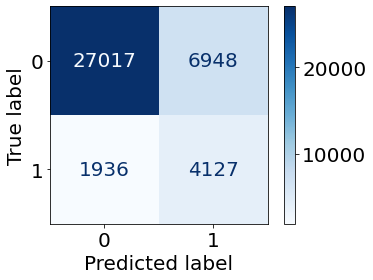

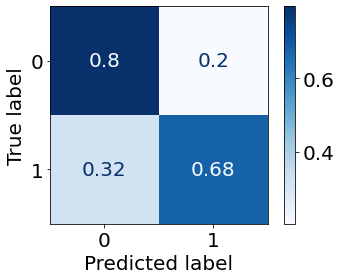

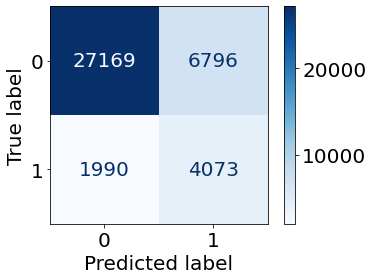

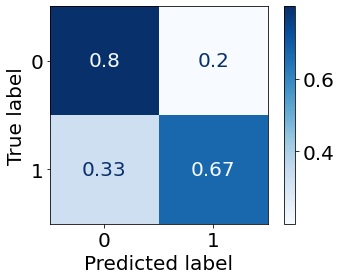

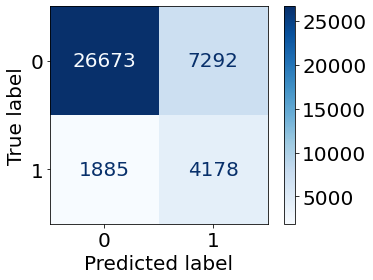

...

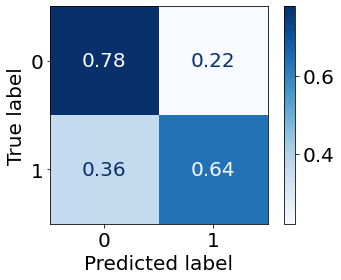

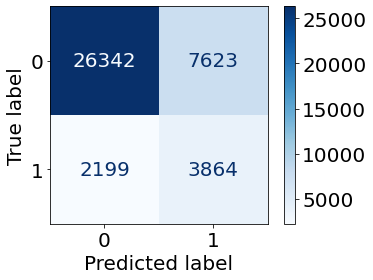

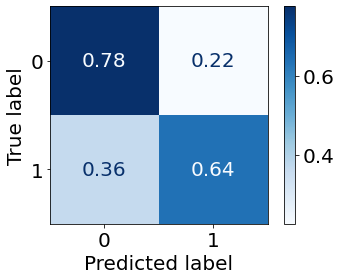

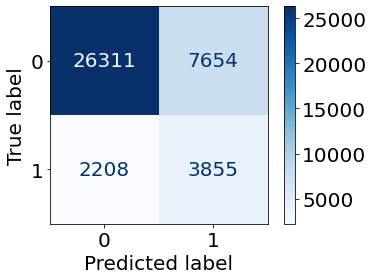

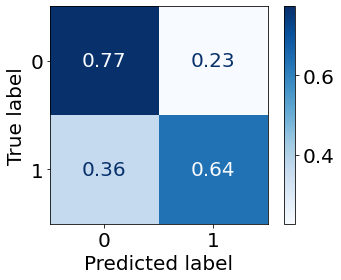

In [26]:


for n in range(1, 30):
    df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 4, n=n)

    X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2021_DP = df_train_2021_DP['Diabetes']
    print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

    train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                         X_validation_2021, y_validation_2021, 
                         X_validation_2021, y_validation_2021,
                         "2021", "Age-35_39-DP-" + str(n), "1", df_validation_2021,
                    save_dir = path)

In [27]:
import os
import pandas as pd


# Get a list of all CSV files in the directory

csv_files = [file for file in os.listdir(path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "35-39"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "35-39"]["Class 1 AU_PRC"].to_list()[0]
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv(path + "ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
23,2021 Age-35_39-DP-24.csv,0.776237,0.289879
22,2021 Age-35_39-DP-23.csv,0.775294,0.290068
27,2021 Age-35_39-DP-28.csv,0.773701,0.290341
18,2021 Age-35_39-DP-19.csv,0.771955,0.290181
28,2021 Age-35_39-DP-29.csv,0.771627,0.290483
20,2021 Age-35_39-DP-21.csv,0.769012,0.290238
19,2021 Age-35_39-DP-20.csv,0.768939,0.288511
21,2021 Age-35_39-DP-22.csv,0.768446,0.290502
25,2021 Age-35_39-DP-26.csv,0.767941,0.289536
24,2021 Age-35_39-DP-25.csv,0.767753,0.289874


Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
4  group class 1:  (333, 50)
4  group class 1:  (9324, 50)  # of DP units 28
New training set:  (129405, 50)
(129405, 48) (120081, 48) (40027, 48)
accuracy 0.7576385939490844
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.85     33930
         1.0       0.34      0.63      0.44      6097

    accuracy                           0.76     40027
   macro avg       0.63      0.70      0.64     40027
weighted avg       0.83      0.76      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6283418074462851
Class 1 Precision: 0.3400497070832594
Class 1 Area Under Precision-Recall Curve: 0.393589946285137
Class 1 F1-Score: 0.44128318838910324
Class 0 Recall: 0.7808723843206602
Class 0 Precision: 0.921212753381315
Class 0 Area Under Precision-Recall Curve: 0.7345074607783391
Class 0 F1-Score: 0.84525

Class 1 Recall: 0.7327935222672065
Class 1 Precision: 0.3220640569395018
Class 1 Area Under Precision-Recall Curve: 0.4230147673456665
Class 1 F1-Score: 0.4474660074165637
Class 0 Recall: 0.6601248884924175
Class 0 Precision: 0.9181141439205955
Class 0 Area Under Precision-Recall Curve: 0.6971472252404032
Class 0 F1-Score: 0.7680332122470159
Overall Accuracy: 0.6732456140350878
Balanced Accuracy: 0.696459205379812
Area Under ROC Curve: 0.769125130468386
Matthews Correlation Coefficient: 0.3071977164320321
0.7327935222672065
0.3220640569395018
0.4230147673456665
0.4474660074165637
0.6601248884924175
0.9181141439205955
0.6971472252404032
0.7680332122470159
0.6732456140350878
0.696459205379812
0.769125130468386
0.3071977164320321
============================  30-34 ============================ 
Class 1 Recall: 0.8
Class 1 Precision: 0.08125
Class 1 Area Under Precision-Recall Curve: 0.18764679616092134
Class 1 F1-Score: 0.1475177304964539
Class 0 Recall: 0.732484076433121
Class 0 Precisio

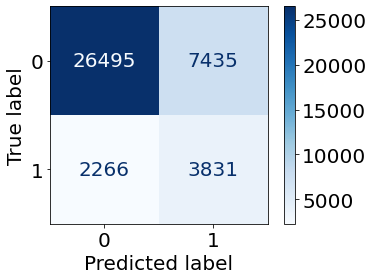

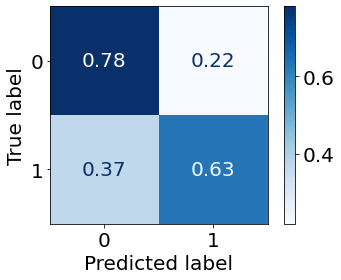

In [28]:
n = 28
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 4, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-35_39-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_35_39-Test-Set-Performance-LR-Trial-3/")

Same training set:  (120081, 50)
(120081, 48) (120081, 48) (40027, 48)
accuracy 0.7707047742773627
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     33930
         1.0       0.37      0.69      0.48      6097

    accuracy                           0.77     40027
   macro avg       0.65      0.74      0.67     40027
weighted avg       0.85      0.77      0.80     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6885353452517632
Class 1 Precision: 0.3657750283175046
Class 1 Area Under Precision-Recall Curve: 0.435084562403413
Class 1 F1-Score: 0.4777512233982019
Class 0 Recall: 0.7854700854700855
Class 0 Precision: 0.9334851138353766
Class 0 Area Under Precision-Recall Curve: 0.7230105728795921
Class 0 F1-Score: 0.8531049935979512
Overall Accuracy: 0.7707047742773627
Balanced Accuracy: 0.7370027153609243
Area Under ROC Curve: 0.8197075610472817
Matthews Correlation Coefficient: 

Class 1 Recall: 0.7226720647773279
Class 1 Precision: 0.40202702702702703
Class 1 Area Under Precision-Recall Curve: 0.4771618985109886
Class 1 F1-Score: 0.5166425470332852
Class 0 Recall: 0.7631578947368421
Class 0 Precision: 0.9258658008658008
Class 0 Area Under Precision-Recall Curve: 0.6794053666938735
Class 0 F1-Score: 0.8366748166259169
Overall Accuracy: 0.7558479532163743
Balanced Accuracy: 0.7429149797570851
Area Under ROC Curve: 0.8220654996442592
Matthews Correlation Coefficient: 0.3991242404316723
0.7226720647773279
0.40202702702702703
0.4771618985109886
0.5166425470332852
0.7631578947368421
0.9258658008658008
0.6794053666938735
0.8366748166259169
0.7558479532163743
0.7429149797570851
0.8220654996442592
0.3991242404316723
============================  30-34 ============================ 
Class 1 Recall: 0.23076923076923078
Class 1 Precision: 0.20270270270270271
Class 1 Area Under Precision-Recall Curve: 0.1855781187411733
Class 1 F1-Score: 0.21582733812949642
Class 0 Recall: 

============================  80-99 ============================ 
Class 1 Recall: 0.7847222222222222
Class 1 Precision: 0.29815303430079154
Class 1 Area Under Precision-Recall Curve: 0.40880347728737
Class 1 F1-Score: 0.4321223709369025
Class 0 Recall: 0.5333333333333333
Class 0 Precision: 0.9074626865671642
Class 0 Area Under Precision-Recall Curve: 0.6859798454052315
Class 0 F1-Score: 0.6718232044198896
Overall Accuracy: 0.5840336134453782
Balanced Accuracy: 0.6590277777777778
Area Under ROC Curve: 0.7283869395711501
Matthews Correlation Coefficient: 0.25572880622177413
0.7847222222222222
0.29815303430079154
0.40880347728737
0.4321223709369025
0.5333333333333333
0.9074626865671642
0.6859798454052315
0.6718232044198896
0.5840336134453782
0.6590277777777778
0.7283869395711501
0.25572880622177413


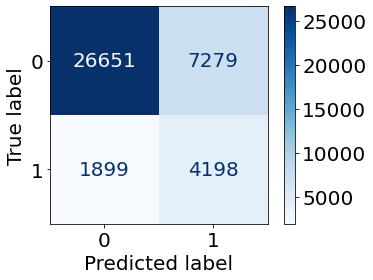

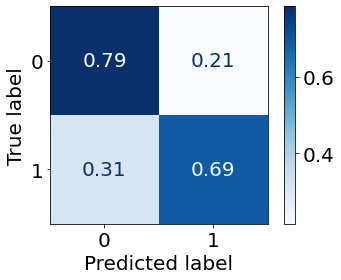

In [55]:
n = 0
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 4, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-35_39-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_35_39-Test-Set-Performance-LR-Trial-3/")

## DP Age 40-44

## Trail 1

### Train model on dp 1-30 and evaluate performance on validation set

Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (648, 50)  # of DP units 1
New training set:  (120729, 50)
(120729, 48) (120081, 48) (40027, 48)
accuracy 0.7573948236234636
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.84     33889
         1.0       0.36      0.72      0.47      6139

    accuracy                           0.76     40028
   macro avg       0.65      0.74      0.66     40028
weighted avg       0.85      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7152630721615898
Class 1 Precision: 0.3554314392099725
Class 1 Area Under Precision-Recall Curve: 0.44356410357037485
Class 1 F1-Score: 0.4748823879305683
Class 0 Recall: 0.7650269999114757
Class 0 Precision: 0.9368360193683601
Class 0 Area Under Precision-Recall Curve: 0.7197594468494676
Class 0 F1-Score: 0.84225

Class 1 Recall: 0.7916666666666666
Class 1 Precision: 0.382183908045977
Class 1 Area Under Precision-Recall Curve: 0.5104135949403001
Class 1 F1-Score: 0.5155038759689923
Class 0 Recall: 0.7194432361896477
Class 0 Precision: 0.9403069926094372
Class 0 Area Under Precision-Recall Curve: 0.6747728728251301
Class 0 F1-Score: 0.815179891572203
Overall Accuracy: 0.7324295397788084
Balanced Accuracy: 0.7555549514281572
Area Under ROC Curve: 0.8291847041847044
Matthews Correlation Coefficient: 0.40599050839401907
0.7916666666666666
0.382183908045977
0.5104135949403001
0.5155038759689923
0.7194432361896477
0.9403069926094372
0.6747728728251301
0.815179891572203
0.7324295397788084
0.7555549514281572
0.8291847041847044
0.40599050839401907
============================  30-34 ============================ 
Class 1 Recall: 0.3835616438356164
Class 1 Precision: 0.1917808219178082
Class 1 Area Under Precision-Recall Curve: 0.1939662627593186
Class 1 F1-Score: 0.2557077625570776
Class 0 Recall: 0.94792

New training set:  (121377, 50)
(121377, 48) (120081, 48) (40027, 48)
accuracy 0.7765064454881583
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     33889
         1.0       0.37      0.67      0.48      6139

    accuracy                           0.78     40028
   macro avg       0.65      0.73      0.67     40028
weighted avg       0.84      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6706303958299398
Class 1 Precision: 0.372882891042478
Class 1 Area Under Precision-Recall Curve: 0.4438170191802992
Class 1 F1-Score: 0.4792782305005821
Class 0 Recall: 0.7956859157838827
Class 0 Precision: 0.9302445924034912
Class 0 Area Under Precision-Recall Curve: 0.7208664038691714
Class 0 F1-Score: 0.8577199567402507
Overall Accuracy: 0.7765064454881583
Balanced Accuracy: 0.7331581558069112
Area Under ROC Curve: 0.8198868164649199
Matthews Correlation Coefficient: 0

Class 1 Recall: 0.7599206349206349
Class 1 Precision: 0.3960703205791106
Class 1 Area Under Precision-Recall Curve: 0.5102746430025118
Class 1 F1-Score: 0.5207341944255608
Class 0 Recall: 0.7459765115267507
Class 0 Precision: 0.9340958605664488
Class 0 Area Under Precision-Recall Curve: 0.6753045133402443
Class 0 F1-Score: 0.8295042321644498
Overall Accuracy: 0.7484837673920799
Balanced Accuracy: 0.7529485732236928
Area Under ROC Curve: 0.826664629894295
Matthews Correlation Coefficient: 0.4086931965361904
0.7599206349206349
0.3960703205791106
0.5102746430025118
0.5207341944255608
0.7459765115267507
0.9340958605664488
0.6753045133402443
0.8295042321644498
0.7484837673920799
0.7529485732236928
0.826664629894295
0.4086931965361904
============================  30-34 ============================ 
Class 1 Recall: 0.3972602739726027
Class 1 Precision: 0.19463087248322147
Class 1 Area Under Precision-Recall Curve: 0.19449151619168836
Class 1 F1-Score: 0.26126126126126126
Class 0 Recall: 0.94

============================  80-99 ============================ 
Class 1 Recall: 0.6824561403508772
Class 1 Precision: 0.3257956448911223
Class 1 Area Under Precision-Recall Curve: 0.38919198825734125
Class 1 F1-Score: 0.4410430839002268
Class 0 Recall: 0.6385271665918276
Class 0 Precision: 0.8870867124142233
Class 0 Area Under Precision-Recall Curve: 0.6886013527201962
Class 0 F1-Score: 0.7425587467362924
Overall Accuracy: 0.6474794422595638
Balanced Accuracy: 0.6604916534713524
Area Under ROC Curve: 0.7214717305162323
Matthews Correlation Coefficient: 0.26140329576657656
0.6824561403508772
0.3257956448911223
0.38919198825734125
0.4410430839002268
0.6385271665918276
0.8870867124142233
0.6886013527201962
0.7425587467362924
0.6474794422595638
0.6604916534713524
0.7214717305162323
0.26140329576657656
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (1944, 50)  # of DP units 3
New training set:  (122025,

Class 1 Recall: 0.75
Class 1 Precision: 0.38571428571428573
Class 1 Area Under Precision-Recall Curve: 0.5089002184752038
Class 1 F1-Score: 0.509433962264151
Class 0 Recall: 0.7381470204436712
Class 0 Precision: 0.9308831596269885
Class 0 Area Under Precision-Recall Curve: 0.6759926052311324
Class 0 F1-Score: 0.8233867054827754
Overall Accuracy: 0.74027827327863
Balanced Accuracy: 0.7440735102218357
Area Under ROC Curve: 0.8239667695409322
Matthews Correlation Coefficient: 0.39312351700632336
0.75
0.38571428571428573
0.5089002184752038
0.509433962264151
0.7381470204436712
0.9308831596269885
0.6759926052311324
0.8233867054827754
0.74027827327863
0.7440735102218357
0.8239667695409322
0.39312351700632336
============================  30-34 ============================ 
Class 1 Recall: 0.3972602739726027
Class 1 Precision: 0.1746987951807229
Class 1 Area Under Precision-Recall Curve: 0.19527309780265031
Class 1 F1-Score: 0.24267782426778242
Class 0 Recall: 0.939541041482789
Class 0 Precisi

Class 1 Recall: 0.6578947368421053
Class 1 Precision: 0.336322869955157
Class 1 Area Under Precision-Recall Curve: 0.38867359016563807
Class 1 F1-Score: 0.44510385756676557
Class 0 Recall: 0.6677144140098787
Class 0 Precision: 0.8840665873959572
Class 0 Area Under Precision-Recall Curve: 0.6887773531247936
Class 0 F1-Score: 0.7608083908928115
Overall Accuracy: 0.6657132642116553
Balanced Accuracy: 0.662804575425992
Area Under ROC Curve: 0.7212936922458819
Matthews Correlation Coefficient: 0.26788210851944894
0.6578947368421053
0.336322869955157
0.38867359016563807
0.44510385756676557
0.6677144140098787
0.8840665873959572
0.6887773531247936
0.7608083908928115
0.6657132642116553
0.662804575425992
0.7212936922458819
0.26788210851944894
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (2592, 50)  # of DP units 4
New training set:  (122673, 50)
(122673, 48) (120081, 48) (40027, 48)
accuracy 0.76176676326571

Class 1 Recall: 0.7896825396825397
Class 1 Precision: 0.36446886446886445
Class 1 Area Under Precision-Recall Curve: 0.5068845161854412
Class 1 F1-Score: 0.4987468671679198
Class 0 Recall: 0.6981296215745977
Class 0 Precision: 0.9380479251899474
Class 0 Area Under Precision-Recall Curve: 0.6768464304124638
Class 0 F1-Score: 0.800498753117207
Overall Accuracy: 0.7145915090973957
Balanced Accuracy: 0.7439060806285687
Area Under ROC Curve: 0.8209487216664251
Matthews Correlation Coefficient: 0.3841501906546915
0.7896825396825397
0.36446886446886445
0.5068845161854412
0.4987468671679198
0.6981296215745977
0.9380479251899474
0.6768464304124638
0.800498753117207
0.7145915090973957
0.7439060806285687
0.8209487216664251
0.3841501906546915
============================  30-34 ============================ 
Class 1 Recall: 0.4931506849315068
Class 1 Precision: 0.15517241379310345
Class 1 Area Under Precision-Recall Curve: 0.19624971238554156
Class 1 F1-Score: 0.23606557377049184
Class 0 Recall: 0.

Class 1 Recall: 0.6684210526315789
Class 1 Precision: 0.333041958041958
Class 1 Area Under Precision-Recall Curve: 0.3881304810281101
Class 1 F1-Score: 0.44457409568261375
Class 0 Recall: 0.6573866187696452
Class 0 Precision: 0.8856624319419237
Class 0 Area Under Precision-Recall Curve: 0.6889306973584548
Class 0 F1-Score: 0.7546391752577318
Overall Accuracy: 0.6596353235609582
Balanced Accuracy: 0.6629038357006121
Area Under ROC Curve: 0.7210833549972822
Matthews Correlation Coefficient: 0.26693738596508687
0.6684210526315789
0.333041958041958
0.3881304810281101
0.44457409568261375
0.6573866187696452
0.8856624319419237
0.6889306973584548
0.7546391752577318
0.6596353235609582
0.6629038357006121
0.7210833549972822
0.26693738596508687
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (3240, 50)  # of DP units 5
New training set:  (123321, 50)
(123321, 48) (120081, 48) (40027, 48)
accuracy 0.75544618766863

Class 1 Recall: 0.7976190476190477
Class 1 Precision: 0.3579697239536955
Class 1 Area Under Precision-Recall Curve: 0.504054181250803
Class 1 F1-Score: 0.494161032575292
Class 0 Recall: 0.6863853849499783
Class 0 Precision: 0.9392857142857143
Class 0 Area Under Precision-Recall Curve: 0.6777273810625986
Class 0 F1-Score: 0.7931641115858256
Overall Accuracy: 0.7063860149839458
Balanced Accuracy: 0.742002216284513
Area Under ROC Curve: 0.8180057581971458
Matthews Correlation Coefficient: 0.3793058788275271
0.7976190476190477
0.3579697239536955
0.504054181250803
0.494161032575292
0.6863853849499783
0.9392857142857143
0.6777273810625986
0.7931641115858256
0.7063860149839458
0.742002216284513
0.8180057581971458
0.3793058788275271
============================  30-34 ============================ 
Class 1 Recall: 0.5205479452054794
Class 1 Precision: 0.14074074074074075
Class 1 Area Under Precision-Recall Curve: 0.19692371985075863
Class 1 F1-Score: 0.22157434402332363
Class 0 Recall: 0.897616

============================  80-99 ============================ 
Class 1 Recall: 0.656140350877193
Class 1 Precision: 0.33363068688670827
Class 1 Area Under Precision-Recall Curve: 0.38773804766513226
Class 1 F1-Score: 0.4423418095801301
Class 0 Recall: 0.6645711719802425
Class 0 Precision: 0.883054892601432
Class 0 Area Under Precision-Recall Curve: 0.6890726850663599
Class 0 F1-Score: 0.7583909812964387
Overall Accuracy: 0.6628530568466213
Balanced Accuracy: 0.6603557614287178
Area Under ROC Curve: 0.7208296898510308
Matthews Correlation Coefficient: 0.2636163162228153
0.656140350877193
0.33363068688670827
0.38773804766513226
0.4423418095801301
0.6645711719802425
0.883054892601432
0.6890726850663599
0.7583909812964387
0.6628530568466213
0.6603557614287178
0.7208296898510308
0.2636163162228153
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (3888, 50)  # of DP units 6
New training set:  (123969, 50)

Class 1 Recall: 0.5205479452054794
Class 1 Precision: 0.14339622641509434
Class 1 Area Under Precision-Recall Curve: 0.19674764251653326
Class 1 F1-Score: 0.22485207100591717
Class 0 Recall: 0.8998234774933804
Class 0 Precision: 0.9831243972999035
Class 0 Area Under Precision-Recall Curve: 0.9259973175734486
Class 0 F1-Score: 0.93963133640553
Overall Accuracy: 0.8879863189397178
Balanced Accuracy: 0.7101857113494299
Area Under ROC Curve: 0.8061788922608181
Matthews Correlation Coefficient: 0.2306201521806383
0.5205479452054794
0.14339622641509434
0.19674764251653326
0.22485207100591717
0.8998234774933804
0.9831243972999035
0.9259973175734486
0.93963133640553
0.8879863189397178
0.7101857113494299
0.8061788922608181
0.2306201521806383
============================  35-39 ============================ 
Class 1 Recall: 0.5377358490566038
Class 1 Precision: 0.15079365079365079
Class 1 Area Under Precision-Recall Curve: 0.23799639067153971
Class 1 F1-Score: 0.23553719008264462
Class 0 Recall: 

New training set:  (124617, 50)
(124617, 48) (120081, 48) (40027, 48)
accuracy 0.770460677525732
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     33889
         1.0       0.36      0.65      0.47      6139

    accuracy                           0.77     40028
   macro avg       0.64      0.72      0.66     40028
weighted avg       0.84      0.77      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6530379540641799
Class 1 Precision: 0.3622481250564742
Class 1 Area Under Precision-Recall Curve: 0.4311414161901745
Class 1 F1-Score: 0.46600023247704286
Class 0 Recall: 0.7917318303874413
Class 0 Precision: 0.9264528158558061
Class 0 Area Under Precision-Recall Curve: 0.7245398596249333
Class 0 F1-Score: 0.8538106603023071
Overall Accuracy: 0.770460677525732
Balanced Accuracy: 0.7223848922258106
Area Under ROC Curve: 0.8100011823908637
Matthews Correlation Coefficient: 0

Class 1 Recall: 0.7698412698412699
Class 1 Precision: 0.35959221501390176
Class 1 Area Under Precision-Recall Curve: 0.49680745737726895
Class 1 F1-Score: 0.4902084649399873
Class 0 Recall: 0.6994345367551109
Class 0 Precision: 0.9327146171693735
Class 0 Area Under Precision-Recall Curve: 0.6798178874489025
Class 0 F1-Score: 0.7994034302759135
Overall Accuracy: 0.7120941848019978
Balanced Accuracy: 0.7346379032981905
Area Under ROC Curve: 0.8114544280812224
Matthews Correlation Coefficient: 0.3703680931808779
0.7698412698412699
0.35959221501390176
0.49680745737726895
0.4902084649399873
0.6994345367551109
0.9327146171693735
0.6798178874489025
0.7994034302759135
0.7120941848019978
0.7346379032981905
0.8114544280812224
0.3703680931808779
============================  30-34 ============================ 
Class 1 Recall: 0.5342465753424658
Class 1 Precision: 0.13636363636363635
Class 1 Area Under Precision-Recall Curve: 0.19648863031349428
Class 1 F1-Score: 0.21727019498607242
Class 0 Recall

Class 1 Recall: 0.5719298245614035
Class 1 Precision: 0.34717784877529284
Class 1 Area Under Precision-Recall Curve: 0.38685881623477775
Class 1 F1-Score: 0.4320742213386348
Class 0 Recall: 0.7247418051189941
Class 0 Precision: 0.868675995694295
Class 0 Area Under Precision-Recall Curve: 0.6893880291791401
Class 0 F1-Score: 0.7902080783353732
Overall Accuracy: 0.6936002860207365
Balanced Accuracy: 0.6483358148401988
Area Under ROC Curve: 0.7203964108745147
Matthews Correlation Coefficient: 0.25305673634892967
0.5719298245614035
0.34717784877529284
0.38685881623477775
0.4320742213386348
0.7247418051189941
0.868675995694295
0.6893880291791401
0.7902080783353732
0.6936002860207365
0.6483358148401988
0.7203964108745147
0.25305673634892967
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (5184, 50)  # of DP units 8
New training set:  (125265, 50)
(125265, 48) (120081, 48) (40027, 48)
accuracy 0.761392025582

Class 1 Recall: 0.547945205479452
Class 1 Precision: 0.11764705882352941
Class 1 Area Under Precision-Recall Curve: 0.1972425776786674
Class 1 F1-Score: 0.1937046004842615
Class 0 Recall: 0.8676081200353045
Class 0 Precision: 0.9834917458729364
Class 0 Area Under Precision-Recall Curve: 0.925901617061281
Class 0 F1-Score: 0.9219226260257913
Overall Accuracy: 0.857631466438649
Balanced Accuracy: 0.7077766627573783
Area Under ROC Curve: 0.8068317837236577
Matthews Correlation Coefficient: 0.2050086989134946
0.547945205479452
0.11764705882352941
0.1972425776786674
0.1937046004842615
0.8676081200353045
0.9834917458729364
0.925901617061281
0.9219226260257913
0.857631466438649
0.7077766627573783
0.8068317837236577
0.2050086989134946
============================  35-39 ============================ 
Class 1 Recall: 0.6226415094339622
Class 1 Precision: 0.14442013129102846
Class 1 Area Under Precision-Recall Curve: 0.2390758934523849
Class 1 F1-Score: 0.2344582593250444
Class 0 Recall: 0.847800

New training set:  (125913, 50)
(125913, 48) (120081, 48) (40027, 48)
accuracy 0.7669881083241731
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     33889
         1.0       0.36      0.65      0.46      6139

    accuracy                           0.77     40028
   macro avg       0.64      0.72      0.66     40028
weighted avg       0.84      0.77      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6473366997882392
Class 1 Precision: 0.35686063218390807
Class 1 Area Under Precision-Recall Curve: 0.42560845449054785
Class 1 F1-Score: 0.46008683068017375
Class 0 Recall: 0.7886629879902033
Class 0 Precision: 0.9250657621486916
Class 0 Area Under Precision-Recall Curve: 0.7260287694802504
Class 0 F1-Score: 0.8514359439957949
Overall Accuracy: 0.7669881083241731
Balanced Accuracy: 0.7179998438892212
Area Under ROC Curve: 0.8052932104630599
Matthews Correlation Coefficien

Class 1 Recall: 0.7777777777777778
Class 1 Precision: 0.3515695067264574
Class 1 Area Under Precision-Recall Curve: 0.49016670787919914
Class 1 F1-Score: 0.484249536751081
Class 0 Recall: 0.6855154414963027
Class 0 Precision: 0.933649289099526
Class 0 Area Under Precision-Recall Curve: 0.6818654312079562
Class 0 F1-Score: 0.7905693503887635
Overall Accuracy: 0.7021048876204067
Balanced Accuracy: 0.7316466096370402
Area Under ROC Curve: 0.8051680509814481
Matthews Correlation Coefficient: 0.3635105694690274
0.7777777777777778
0.3515695067264574
0.49016670787919914
0.484249536751081
0.6855154414963027
0.933649289099526
0.6818654312079562
0.7905693503887635
0.7021048876204067
0.7316466096370402
0.8051680509814481
0.3635105694690274
============================  30-34 ============================ 
Class 1 Recall: 0.5616438356164384
Class 1 Precision: 0.11849710982658959
Class 1 Area Under Precision-Recall Curve: 0.19680731151333467
Class 1 F1-Score: 0.19570405727923626
Class 0 Recall: 0.86

Matthews Correlation Coefficient: 0.32732112175688105
0.6166419019316494
0.42390194075587334
0.4860866418187502
0.5024213075060533
0.7504424778761062
0.8679631525076765
0.6355875214390834
0.804935927859516
0.7197408796454142
0.6835421899038778
0.7662096148535813
0.32732112175688105
============================  80-99 ============================ 
Class 1 Recall: 0.5228070175438596
Class 1 Precision: 0.3485380116959064
Class 1 Area Under Precision-Recall Curve: 0.38653303150423535
Class 1 F1-Score: 0.4182456140350877
Class 0 Recall: 0.7498877413560844
Class 0 Precision: 0.8599382080329557
Class 0 Area Under Precision-Recall Curve: 0.6895560891882413
Class 0 F1-Score: 0.801151355241065
Overall Accuracy: 0.7036110117983554
Balanced Accuracy: 0.636347379449972
Area Under ROC Curve: 0.7199710096975712
Matthews Correlation Coefficient: 0.23843316144222437
0.5228070175438596
0.3485380116959064
0.38653303150423535
0.4182456140350877
0.7498877413560844
0.8599382080329557
0.6895560891882413
0.80

Class 1 Recall: 0.5616438356164384
Class 1 Precision: 0.11388888888888889
Class 1 Area Under Precision-Recall Curve: 0.19542184299317894
Class 1 F1-Score: 0.18937644341801382
Class 0 Recall: 0.8592233009708737
Class 0 Precision: 0.9838302172814553
Class 0 Area Under Precision-Recall Curve: 0.9259269540116473
Class 0 F1-Score: 0.9173144876325089
Overall Accuracy: 0.8499358700299273
Balanced Accuracy: 0.710433568293656
Area Under ROC Curve: 0.8072912258641743
Matthews Correlation Coefficient: 0.20279733825616225
0.5616438356164384
0.11388888888888889
0.19542184299317894
0.18937644341801382
0.8592233009708737
0.9838302172814553
0.9259269540116473
0.9173144876325089
0.8499358700299273
0.710433568293656
0.8072912258641743
0.20279733825616225
============================  35-39 ============================ 
Class 1 Recall: 0.6320754716981132
Class 1 Precision: 0.14225053078556263
Class 1 Area Under Precision-Recall Curve: 0.2388054473628843
Class 1 F1-Score: 0.2322357019064125
Class 0 Recall

accuracy 0.7730838413110822
              precision    recall  f1-score   support

         0.0       0.92      0.80      0.86     33889
         1.0       0.36      0.62      0.46      6139

    accuracy                           0.77     40028
   macro avg       0.64      0.71      0.66     40028
weighted avg       0.84      0.77      0.80     40028



/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_plot/confusion_matrix.py:114: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


============================  Over all performance ============================ 
Class 1 Recall: 0.6240430037465385
Class 1 Precision: 0.3612106354893457
Class 1 Area Under Precision-Recall Curve: 0.4200030850968826
Class 1 F1-Score: 0.4575694237085698
Class 0 Recall: 0.8000826226799257
Class 0 Precision: 0.9215552987560329
Class 0 Area Under Precision-Recall Curve: 0.7269149527074195
Class 0 F1-Score: 0.8565336197501225
Overall Accuracy: 0.7730838413110822
Balanced Accuracy: 0.7120628132132321
Area Under ROC Curve: 0.8006544568759739
Matthews Correlation Coefficient: 0.3463066256858011
0.6240430037465385
0.3612106354893457
0.4200030850968826
0.4575694237085698
0.8000826226799257
0.9215552987560329
0.7269149527074195
0.8565336197501225
0.7730838413110822
0.7120628132132321
0.8006544568759739
0.3463066256858011
============================  Male ============================ 
Class 1 Recall: 0.637245696400626
Class 1 Precision: 0.3604815864022663
Class 1 Area Under Precision-Recall Curve

Class 1 Recall: 0.5753424657534246
Class 1 Precision: 0.11081794195250659
Class 1 Area Under Precision-Recall Curve: 0.1970368236887769
Class 1 F1-Score: 0.18584070796460175
Class 0 Recall: 0.8512797881729921
Class 0 Precision: 0.9841836734693877
Class 0 Area Under Precision-Recall Curve: 0.9258459948793798
Class 0 F1-Score: 0.9129200189304307
Overall Accuracy: 0.8426678067550235
Balanced Accuracy: 0.7133111269632084
Area Under ROC Curve: 0.8075753545563361
Matthews Correlation Coefficient: 0.20132015124656347
0.5753424657534246
0.11081794195250659
0.1970368236887769
0.18584070796460175
0.8512797881729921
0.9841836734693877
0.9258459948793798
0.9129200189304307
0.8426678067550235
0.7133111269632084
0.8075753545563361
0.20132015124656347
============================  35-39 ============================ 
Class 1 Recall: 0.6509433962264151
Class 1 Precision: 0.14168377823408623
Class 1 Area Under Precision-Recall Curve: 0.23899578047814787
Class 1 F1-Score: 0.23271500843170317
Class 0 Reca

accuracy 0.7839762166483462
              precision    recall  f1-score   support

         0.0       0.92      0.82      0.87     33889
         1.0       0.37      0.60      0.46      6139

    accuracy                           0.78     40028
   macro avg       0.65      0.71      0.66     40028
weighted avg       0.83      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.5979801270565238
Class 1 Precision: 0.37269035532994926
Class 1 Area Under Precision-Recall Curve: 0.41717410089422297
Class 1 F1-Score: 0.4591906936018512
Class 0 Recall: 0.8176694502640975
Class 0 Precision: 0.9182185698190735
Class 0 Area Under Precision-Recall Curve: 0.7278954825112067
Class 0 F1-Score: 0.8650319197090546
Overall Accuracy: 0.7839762166483462
Balanced Accuracy: 0.7078247886603106
Area Under ROC Curve: 0.7984241343168719
Matthews Correlation Coefficient: 0.34773002714316686
0.5979801270565238
0.37269035532994926
0.4171741

Class 1 Recall: 0.7440476190476191
Class 1 Precision: 0.3547776726584674
Class 1 Area Under Precision-Recall Curve: 0.47745670787178573
Class 1 F1-Score: 0.48046124279308133
Class 0 Recall: 0.7033492822966507
Class 0 Precision: 0.9261168384879725
Class 0 Area Under Precision-Recall Curve: 0.6851999052150695
Class 0 F1-Score: 0.7995055624227442
Overall Accuracy: 0.7106671423474848
Balanced Accuracy: 0.7236984506721349
Area Under ROC Curve: 0.7959343952166918
Matthews Correlation Coefficient: 0.35450152875767776
0.7440476190476191
0.3547776726584674
0.47745670787178573
0.48046124279308133
0.7033492822966507
0.9261168384879725
0.6851999052150695
0.7995055624227442
0.7106671423474848
0.7236984506721349
0.7959343952166918
0.35450152875767776
============================  30-34 ============================ 
Class 1 Recall: 0.5753424657534246
Class 1 Precision: 0.11506849315068493
Class 1 Area Under Precision-Recall Curve: 0.1952696903435098
Class 1 F1-Score: 0.1917808219178082
Class 0 Recall

Class 1 Recall: 0.43859649122807015
Class 1 Precision: 0.37147102526002973
Class 1 Area Under Precision-Recall Curve: 0.3861364242271824
Class 1 F1-Score: 0.40225261464199513
Class 0 Recall: 0.8100583744948361
Class 0 Precision: 0.8493408662900188
Class 0 Area Under Precision-Recall Curve: 0.6897665147049339
Class 0 F1-Score: 0.8292346586991497
Overall Accuracy: 0.7343582409724705
Balanced Accuracy: 0.6243274328614531
Area Under ROC Curve: 0.7194321682067765
Matthews Correlation Coefficient: 0.2343201895769937
0.43859649122807015
0.37147102526002973
0.3861364242271824
0.40225261464199513
0.8100583744948361
0.8493408662900188
0.6897665147049339
0.8292346586991497
0.7343582409724705
0.6243274328614531
0.7194321682067765
0.2343201895769937
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (8424, 50)  # of DP units 13
New training set:  (128505, 50)
(128505, 48) (120081, 48) (40027, 48)
accuracy 0.781003297

Class 1 Recall: 0.751984126984127
Class 1 Precision: 0.3496309963099631
Class 1 Area Under Precision-Recall Curve: 0.4738508358158191
Class 1 F1-Score: 0.4773299748110831
Class 0 Recall: 0.6933449325793823
Class 0 Precision: 0.9272833042466551
Class 0 Area Under Precision-Recall Curve: 0.6862046325730876
Class 0 F1-Score: 0.7934295669487307
Overall Accuracy: 0.703888690688548
Balanced Accuracy: 0.7226645297817547
Area Under ROC Curve: 0.7931252028141981
Matthews Correlation Coefficient: 0.3511666058248787
0.751984126984127
0.3496309963099631
0.4738508358158191
0.4773299748110831
0.6933449325793823
0.9272833042466551
0.6862046325730876
0.7934295669487307
0.703888690688548
0.7226645297817547
0.7931252028141981
0.3511666058248787
============================  30-34 ============================ 
Class 1 Recall: 0.6027397260273972
Class 1 Precision: 0.10891089108910891
Class 1 Area Under Precision-Recall Curve: 0.19533587912771017
Class 1 F1-Score: 0.18448637316561844
Class 0 Recall: 0.8411

Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (9072, 50)  # of DP units 14
New training set:  (129153, 50)
(129153, 48) (120081, 48) (40027, 48)
accuracy 0.7757819526331567
              precision    recall  f1-score   support

         0.0       0.92      0.81      0.86     33889
         1.0       0.36      0.61      0.45      6139

    accuracy                           0.78     40028
   macro avg       0.64      0.71      0.66     40028
weighted avg       0.83      0.78      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6059618830428408
Class 1 Precision: 0.36200856364344103
Class 1 Area Under Precision-Recall Curve: 0.40936241720669403
Class 1 F1-Score: 0.4532439841608285
Class 0 Recall: 0.8065448965741095
Class 0 Precision: 0.9186945415434257
Class 0 Area Under Precision-Recall Curve: 0.7306973000972646
Class 0 F1-Score: 0.8589745604248833
Overall Accuracy: 0.7757819526331567
Balanced Ac

Class 1 Recall: 0.7658730158730159
Class 1 Precision: 0.34341637010676157
Class 1 Area Under Precision-Recall Curve: 0.4698075205425888
Class 1 F1-Score: 0.4742014742014742
Class 0 Recall: 0.6789908655937364
Class 0 Precision: 0.9297200714711138
Class 0 Area Under Precision-Recall Curve: 0.6873015978501256
Class 0 F1-Score: 0.7848164906988436
Overall Accuracy: 0.6946129147342134
Balanced Accuracy: 0.7224319407333761
Area Under ROC Curve: 0.7900976615091446
Matthews Correlation Coefficient: 0.3485807475612364
0.7658730158730159
0.34341637010676157
0.4698075205425888
0.4742014742014742
0.6789908655937364
0.9297200714711138
0.6873015978501256
0.7848164906988436
0.6946129147342134
0.7224319407333761
0.7900976615091446
0.3485807475612364
============================  30-34 ============================ 
Class 1 Recall: 0.6164383561643836
Class 1 Precision: 0.10044642857142858
Class 1 Area Under Precision-Recall Curve: 0.19543078575604078
Class 1 F1-Score: 0.1727447216890595
Class 0 Recall: 0

Class 1 Recall: 0.43508771929824563
Class 1 Precision: 0.38095238095238093
Class 1 Area Under Precision-Recall Curve: 0.3858121555905484
Class 1 F1-Score: 0.4062244062244062
Class 0 Recall: 0.8190390660080826
Class 0 Precision: 0.8499534016775396
Class 0 Area Under Precision-Recall Curve: 0.6899230305486038
Class 0 F1-Score: 0.8342099245369311
Overall Accuracy: 0.7407937075437969
Balanced Accuracy: 0.6270633926531641
Area Under ROC Curve: 0.7190626994068016
Matthews Correlation Coefficient: 0.24223819733556373
0.43508771929824563
0.38095238095238093
0.3858121555905484
0.4062244062244062
0.8190390660080826
0.8499534016775396
0.6899230305486038
0.8342099245369311
0.7407937075437969
0.6270633926531641
0.7190626994068016
0.24223819733556373
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (9720, 50)  # of DP units 15
New training set:  (129801, 50)
(129801, 48) (120081, 48) (40027, 48)
accuracy 0.771534925

Class 1 Recall: 0.7698412698412699
Class 1 Precision: 0.33856893542757416
Class 1 Area Under Precision-Recall Curve: 0.4661337254488984
Class 1 F1-Score: 0.4703030303030303
Class 0 Recall: 0.6702914310569813
Class 0 Precision: 0.9299939649969825
Class 0 Area Under Precision-Recall Curve: 0.6883279071530143
Class 0 F1-Score: 0.7790697674418605
Overall Accuracy: 0.6881912236889047
Balanced Accuracy: 0.7200663504491256
Area Under ROC Curve: 0.7873445666507867
Matthews Correlation Coefficient: 0.3438070894046954
0.7698412698412699
0.33856893542757416
0.4661337254488984
0.4703030303030303
0.6702914310569813
0.9299939649969825
0.6883279071530143
0.7790697674418605
0.6881912236889047
0.7200663504491256
0.7873445666507867
0.3438070894046954
============================  30-34 ============================ 
Class 1 Recall: 0.6301369863013698
Class 1 Precision: 0.0942622950819672
Class 1 Area Under Precision-Recall Curve: 0.1958905653591433
Class 1 F1-Score: 0.1639928698752228
Class 0 Recall: 0.8

Class 1 Recall: 0.4298245614035088
Class 1 Precision: 0.3810264385692068
Class 1 Area Under Precision-Recall Curve: 0.3854507957435784
Class 1 F1-Score: 0.403957131079967
Class 0 Recall: 0.8212842388863942
Class 0 Precision: 0.8491179201485608
Class 0 Area Under Precision-Recall Curve: 0.6900377025147667
Class 0 F1-Score: 0.834969185117553
Overall Accuracy: 0.7415087593850554
Balanced Accuracy: 0.6255544001449516
Area Under ROC Curve: 0.7188303043193974
Matthews Correlation Coefficient: 0.24039815683800014
0.4298245614035088
0.3810264385692068
0.3854507957435784
0.403957131079967
0.8212842388863942
0.8491179201485608
0.6900377025147667
0.834969185117553
0.7415087593850554
0.6255544001449516
0.7188303043193974
0.24039815683800014
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (10368, 50)  # of DP units 16
New training set:  (130449, 50)
(130449, 48) (120081, 48) (40027, 48)
accuracy 0.7667632657140002

Class 1 Recall: 0.7738095238095238
Class 1 Precision: 0.33163265306122447
Class 1 Area Under Precision-Recall Curve: 0.4618780899864529
Class 1 F1-Score: 0.4642857142857143
Class 0 Recall: 0.6581122227055242
Class 0 Precision: 0.9299323909035033
Class 0 Area Under Precision-Recall Curve: 0.6894494242532802
Class 0 F1-Score: 0.7707590422822211
Overall Accuracy: 0.6789154477345701
Balanced Accuracy: 0.715960873257524
Area Under ROC Curve: 0.7844041922989292
Matthews Correlation Coefficient: 0.33611847705315245
0.7738095238095238
0.33163265306122447
0.4618780899864529
0.4642857142857143
0.6581122227055242
0.9299323909035033
0.6894494242532802
0.7707590422822211
0.6789154477345701
0.715960873257524
0.7844041922989292
0.33611847705315245
============================  30-34 ============================ 
Class 1 Recall: 0.6575342465753424
Class 1 Precision: 0.09142857142857143
Class 1 Area Under Precision-Recall Curve: 0.19598355950746432
Class 1 F1-Score: 0.1605351170568562
Class 0 Recall: 0

Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (11016, 50)  # of DP units 17
New training set:  (131097, 50)
(131097, 48) (120081, 48) (40027, 48)
accuracy 0.7630908364145098
              precision    recall  f1-score   support

         0.0       0.92      0.79      0.85     33889
         1.0       0.35      0.62      0.44      6139

    accuracy                           0.76     40028
   macro avg       0.63      0.70      0.65     40028
weighted avg       0.83      0.76      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6175272845740348
Class 1 Precision: 0.3469705290133626
Class 1 Area Under Precision-Recall Curve: 0.4008106930800814
Class 1 F1-Score: 0.44430120128918843
Class 0 Recall: 0.7894597066894863
Class 0 Precision: 0.919318259913408
Class 0 Area Under Precision-Recall Curve: 0.7318370635964375
Class 0 F1-Score: 0.8494546840024767
Overall Accuracy: 0.7630908

Class 1 Recall: 0.7777777777777778
Class 1 Precision: 0.3263946711074105
Class 1 Area Under Precision-Recall Curve: 0.4582764723880201
Class 1 F1-Score: 0.4598240469208211
Class 0 Recall: 0.6481078729882558
Class 0 Precision: 0.9300873907615481
Class 0 Area Under Precision-Recall Curve: 0.6904520361430373
Class 0 F1-Score: 0.763906690592156
Overall Accuracy: 0.6714234748483767
Balanced Accuracy: 0.7129428253830168
Area Under ROC Curve: 0.7816873450844741
Matthews Correlation Coefficient: 0.33050269261970544
0.7777777777777778
0.3263946711074105
0.4582764723880201
0.4598240469208211
0.6481078729882558
0.9300873907615481
0.6904520361430373
0.763906690592156
0.6714234748483767
0.7129428253830168
0.7816873450844741
0.33050269261970544
============================  30-34 ============================ 
Class 1 Recall: 0.6712328767123288
Class 1 Precision: 0.08812949640287769
Class 1 Area Under Precision-Recall Curve: 0.19613438438708775
Class 1 F1-Score: 0.15580286168521462
Class 0 Recall: 0.

0.3387992950621289
============================  80-99 ============================ 
Class 1 Recall: 0.4192982456140351
Class 1 Precision: 0.38057324840764334
Class 1 Area Under Precision-Recall Curve: 0.3847591046076838
Class 1 F1-Score: 0.39899833055091827
Class 0 Recall: 0.8253255500673552
Class 0 Precision: 0.8473951129552789
Class 0 Area Under Precision-Recall Curve: 0.6902349331244966
Class 0 F1-Score: 0.8362147406733393
Overall Accuracy: 0.7425813371469432
Balanced Accuracy: 0.6223118978406952
Area Under ROC Curve: 0.7185317357155798
Matthews Correlation Coefficient: 0.2361492872143908
0.4192982456140351
0.38057324840764334
0.3847591046076838
0.39899833055091827
0.8253255500673552
0.8473951129552789
0.6902349331244966
0.8362147406733393
0.7425813371469432
0.6223118978406952
0.7185317357155798
0.2361492872143908
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (11664, 50)  # of DP units 18
New tr

Class 1 Recall: 0.7797619047619048
Class 1 Precision: 0.32425742574257427
Class 1 Area Under Precision-Recall Curve: 0.4544310532785213
Class 1 F1-Score: 0.4580419580419581
Class 0 Recall: 0.6437581557198782
Class 0 Precision: 0.9302325581395349
Class 0 Area Under Precision-Recall Curve: 0.6914745881800376
Class 0 F1-Score: 0.7609254498714652
Overall Accuracy: 0.6682126293257225
Balanced Accuracy: 0.7117600302408915
Area Under ROC Curve: 0.7790110607096253
Matthews Correlation Coefficient: 0.3283011016822192
0.7797619047619048
0.32425742574257427
0.4544310532785213
0.4580419580419581
0.6437581557198782
0.9302325581395349
0.6914745881800376
0.7609254498714652
0.6682126293257225
0.7117600302408915
0.7790110607096253
0.3283011016822192
============================  30-34 ============================ 
Class 1 Recall: 0.6712328767123288
Class 1 Precision: 0.08566433566433566
Class 1 Area Under Precision-Recall Curve: 0.19680596385058421
Class 1 F1-Score: 0.15193798449612403
Class 0 Recall: 

Area Under ROC Curve: 0.7649426685426501
Matthews Correlation Coefficient: 0.3376607355703978
0.5274888558692422
0.4708222811671088
0.4842515696514764
0.49754730203223546
0.8234513274336284
0.8540614960991281
0.6361382111866938
0.83847713448975
0.7555404023184453
0.6754700916514353
0.7649426685426501
0.3376607355703978
============================  80-99 ============================ 
Class 1 Recall: 0.4087719298245614
Class 1 Precision: 0.380718954248366
Class 1 Area Under Precision-Recall Curve: 0.38447527909422097
Class 1 F1-Score: 0.39424703891708973
Class 0 Recall: 0.8298158958239784
Class 0 Precision: 0.845766590389016
Class 0 Area Under Precision-Recall Curve: 0.6903236293993569
Class 0 F1-Score: 0.8377153218495014
Overall Accuracy: 0.7440114408294601
Balanced Accuracy: 0.6192939128242699
Area Under ROC Curve: 0.7183552730051441
Matthews Correlation Coefficient: 0.23245793949843546
0.4087719298245614
0.380718954248366
0.38447527909422097
0.39424703891708973
0.8298158958239784
0.8

Class 1 Recall: 0.7837301587301587
Class 1 Precision: 0.3193209377526273
Class 1 Area Under Precision-Recall Curve: 0.45098514602184336
Class 1 F1-Score: 0.45376220562894887
Class 0 Recall: 0.6337538060026098
Class 0 Precision: 0.9303959131545338
Class 0 Area Under Precision-Recall Curve: 0.6924446941576734
Class 0 F1-Score: 0.7539456662354462
Overall Accuracy: 0.660720656439529
Balanced Accuracy: 0.7087419823663843
Area Under ROC Curve: 0.7763960521137554
Matthews Correlation Coefficient: 0.3228819923397762
0.7837301587301587
0.3193209377526273
0.45098514602184336
0.45376220562894887
0.6337538060026098
0.9303959131545338
0.6924446941576734
0.7539456662354462
0.660720656439529
0.7087419823663843
0.7763960521137554
0.3228819923397762
============================  30-34 ============================ 
Class 1 Recall: 0.684931506849315
Class 1 Precision: 0.08156606851549755
Class 1 Area Under Precision-Recall Curve: 0.19982243931616492
Class 1 F1-Score: 0.1457725947521866
Class 0 Recall: 0.

Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (12960, 50)  # of DP units 20
New training set:  (133041, 50)
(133041, 48) (120081, 48) (40027, 48)
accuracy 0.7569451384031178
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.85     33889
         1.0       0.34      0.62      0.44      6139

    accuracy                           0.76     40028
   macro avg       0.63      0.70      0.64     40028
weighted avg       0.83      0.76      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6154096758429711
Class 1 Precision: 0.3389556791674143
Class 1 Area Under Precision-Recall Curve: 0.3910574801658674
Class 1 F1-Score: 0.437142030662424
Class 0 Recall: 0.7825843193956741
Class 0 Precision: 0.9182535835468458
Class 0 Area Under Precision-Recall Curve: 0.7345553708028169
Class 0 F1-Score: 0.8450

Class 1 Recall: 0.7817460317460317
Class 1 Precision: 0.3149480415667466
Class 1 Area Under Precision-Recall Curve: 0.4481393002939991
Class 1 F1-Score: 0.449002849002849
Class 0 Recall: 0.6272292301000435
Class 0 Precision: 0.9291237113402062
Class 0 Area Under Precision-Recall Curve: 0.6933197458443306
Class 0 F1-Score: 0.7488963905479096
Overall Accuracy: 0.655012486621477
Balanced Accuracy: 0.7044876309230377
Area Under ROC Curve: 0.7739182667412332
Matthews Correlation Coefficient: 0.31594193937233406
0.7817460317460317
0.3149480415667466
0.4481393002939991
0.449002849002849
0.6272292301000435
0.9291237113402062
0.6933197458443306
0.7488963905479096
0.655012486621477
0.7044876309230377
0.7739182667412332
0.31594193937233406
============================  30-34 ============================ 
Class 1 Recall: 0.684931506849315
Class 1 Precision: 0.0778816199376947
Class 1 Area Under Precision-Recall Curve: 0.20064432814879338
Class 1 F1-Score: 0.13986013986013984
Class 0 Recall: 0.7387

Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (13608, 50)  # of DP units 21
New training set:  (133689, 50)
(133689, 48) (120081, 48) (40027, 48)
accuracy 0.7577945438193264
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.85     33889
         1.0       0.34      0.61      0.44      6139

    accuracy                           0.76     40028
   macro avg       0.63      0.70      0.64     40028
weighted avg       0.83      0.76      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6082423847532171
Class 1 Precision: 0.3387155297532656
Class 1 Area Under Precision-Recall Curve: 0.3882982968535371
Class 1 F1-Score: 0.4351220649070675
Class 0 Recall: 0.7848859511936026
Class 0 Precision: 0.9170804027030754
Class 0 Area Under Precision-Recall Curve: 0.7355010783886808
Class 0 F1-Score: 0.8458492996040895
Overall Accuracy: 0.7577945438193264
Balanced Acc

Class 1 Recall: 0.7797619047619048
Class 1 Precision: 0.31490384615384615
Class 1 Area Under Precision-Recall Curve: 0.44490337964747095
Class 1 F1-Score: 0.4486301369863014
Class 0 Recall: 0.628099173553719
Class 0 Precision: 0.9286173633440514
Class 0 Area Under Precision-Recall Curve: 0.6942641556563824
Class 0 F1-Score: 0.749351323300467
Overall Accuracy: 0.6553692472351053
Balanced Accuracy: 0.7039305391578119
Area Under ROC Curve: 0.7713705751983264
Matthews Correlation Coefficient: 0.31515523650819677
0.7797619047619048
0.31490384615384615
0.44490337964747095
0.4486301369863014
0.628099173553719
0.9286173633440514
0.6942641556563824
0.749351323300467
0.6553692472351053
0.7039305391578119
0.7713705751983264
0.31515523650819677
============================  30-34 ============================ 
Class 1 Recall: 0.684931506849315
Class 1 Precision: 0.07680491551459294
Class 1 Area Under Precision-Recall Curve: 0.19974220694635272
Class 1 F1-Score: 0.13812154696132597
Class 0 Recall: 0

Class 1 Recall: 0.3736842105263158
Class 1 Precision: 0.3844765342960289
Class 1 Area Under Precision-Recall Curve: 0.3838987060269517
Class 1 F1-Score: 0.3790035587188612
Class 0 Recall: 0.8468792096991469
Class 0 Precision: 0.8408381631743201
Class 0 Area Under Precision-Recall Curve: 0.6905482123272371
Class 0 F1-Score: 0.843847874720358
Overall Accuracy: 0.7504469074007866
Balanced Accuracy: 0.6102817101127314
Area Under ROC Curve: 0.7179243573684999
Matthews Correlation Coefficient: 0.22292640108593142
0.3736842105263158
0.3844765342960289
0.3838987060269517
0.3790035587188612
0.8468792096991469
0.8408381631743201
0.6905482123272371
0.843847874720358
0.7504469074007866
0.6102817101127314
0.7179243573684999
0.22292640108593142
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (14256, 50)  # of DP units 22
New training set:  (134337, 50)
(134337, 48) (120081, 48) (40027, 48)
accuracy 0.75657040071949

Class 1 Recall: 0.7797619047619048
Class 1 Precision: 0.3124006359300477
Class 1 Area Under Precision-Recall Curve: 0.4414706771222017
Class 1 F1-Score: 0.4460839954597049
Class 0 Recall: 0.6237494562853415
Class 0 Precision: 0.9281553398058252
Class 0 Area Under Precision-Recall Curve: 0.695206380505059
Class 0 F1-Score: 0.7460978147762747
Overall Accuracy: 0.6518016410988227
Balanced Accuracy: 0.7017556805236231
Area Under ROC Curve: 0.7689247222740045
Matthews Correlation Coefficient: 0.3115558845170966
0.7797619047619048
0.3124006359300477
0.4414706771222017
0.4460839954597049
0.6237494562853415
0.9281553398058252
0.695206380505059
0.7460978147762747
0.6518016410988227
0.7017556805236231
0.7689247222740045
0.3115558845170966
============================  30-34 ============================ 
Class 1 Recall: 0.684931506849315
Class 1 Precision: 0.0744047619047619
Class 1 Area Under Precision-Recall Curve: 0.19926043342512267
Class 1 F1-Score: 0.1342281879194631
Class 0 Recall: 0.72550

Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (14904, 50)  # of DP units 23
New training set:  (134985, 50)
(134985, 48) (120081, 48) (40027, 48)
accuracy 0.7537973418606975
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.84     33889
         1.0       0.33      0.61      0.43      6139

    accuracy                           0.75     40028
   macro avg       0.63      0.69      0.64     40028
weighted avg       0.83      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6080794917739045
Class 1 Precision: 0.333840100160973
Class 1 Area Under Precision-Recall Curve: 0.3830423073121132
Class 1 F1-Score: 0.43103746896830436
Class 0 Recall: 0.7801941632978252
Class 0 Precision: 0.9165915551549608
Class 0 Area Under Precision-Recall Curve: 0.7371122738075424
Class 0 F1-Score: 0.8429106559336894
Overall Accuracy: 0.7537973418606975
Balanced Acc

Class 1 Recall: 0.7817460317460317
Class 1 Precision: 0.30877742946708464
Class 1 Area Under Precision-Recall Curve: 0.43848976151493513
Class 1 F1-Score: 0.4426966292134832
Class 0 Recall: 0.6163549369290996
Class 0 Precision: 0.9279633267845449
Class 0 Area Under Precision-Recall Curve: 0.6960903643140808
Class 0 F1-Score: 0.7407213800313643
Overall Accuracy: 0.6460934712807705
Balanced Accuracy: 0.6990504843375657
Area Under ROC Curve: 0.7665651732637379
Matthews Correlation Coefficient: 0.3069962937702292
0.7817460317460317
0.30877742946708464
0.43848976151493513
0.4426966292134832
0.6163549369290996
0.9279633267845449
0.6960903643140808
0.7407213800313643
0.6460934712807705
0.6990504843375657
0.7665651732637379
0.3069962937702292
============================  30-34 ============================ 
Class 1 Recall: 0.6986301369863014
Class 1 Precision: 0.07380607814761216
Class 1 Area Under Precision-Recall Curve: 0.19922785064611737
Class 1 F1-Score: 0.13350785340314136
Class 0 Recall

Class 1 Recall: 0.3649122807017544
Class 1 Precision: 0.3895131086142322
Class 1 Area Under Precision-Recall Curve: 0.38369609345134337
Class 1 F1-Score: 0.3768115942028985
Class 0 Recall: 0.8536147283340817
Class 0 Precision: 0.8400353513035793
Class 0 Area Under Precision-Recall Curve: 0.6906372152908278
Class 0 F1-Score: 0.8467706013363029
Overall Accuracy: 0.754022166607079
Balanced Accuracy: 0.609263504517918
Area Under ROC Curve: 0.7177179590196867
Matthews Correlation Coefficient: 0.22396994971339765
0.3649122807017544
0.3895131086142322
0.38369609345134337
0.3768115942028985
0.8536147283340817
0.8400353513035793
0.6906372152908278
0.8467706013363029
0.754022166607079
0.609263504517918
0.7177179590196867
0.22396994971339765
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (15552, 50)  # of DP units 24
New training set:  (135633, 50)
(135633, 48) (120081, 48) (40027, 48)
accuracy 0.75147396822224

Class 1 Recall: 0.7857142857142857
Class 1 Precision: 0.30697674418604654
Class 1 Area Under Precision-Recall Curve: 0.43514421880742143
Class 1 F1-Score: 0.4414715719063545
Class 0 Recall: 0.6111352762070466
Class 0 Precision: 0.9286186384666226
Class 0 Area Under Precision-Recall Curve: 0.6969961911875282
Class 0 F1-Score: 0.7371458551941238
Overall Accuracy: 0.6425258651444881
Balanced Accuracy: 0.6984247809606661
Area Under ROC Curve: 0.7642953803240885
Matthews Correlation Coefficient: 0.30577103263128175
0.7857142857142857
0.30697674418604654
0.43514421880742143
0.4414715719063545
0.6111352762070466
0.9286186384666226
0.6969961911875282
0.7371458551941238
0.6425258651444881
0.6984247809606661
0.7642953803240885
0.30577103263128175
============================  30-34 ============================ 
Class 1 Recall: 0.7534246575342466
Class 1 Precision: 0.07703081232492998
Class 1 Area Under Precision-Recall Curve: 0.19950346951029993
Class 1 F1-Score: 0.1397712833545108
Class 0 Recal

New training set:  (136281, 50)
(136281, 48) (120081, 48) (40027, 48)
accuracy 0.7399320475667033
              precision    recall  f1-score   support

         0.0       0.92      0.76      0.83     33889
         1.0       0.32      0.63      0.43      6139

    accuracy                           0.74     40028
   macro avg       0.62      0.69      0.63     40028
weighted avg       0.83      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6290926861052288
Class 1 Precision: 0.32196748645268863
Class 1 Area Under Precision-Recall Curve: 0.37801745606776693
Class 1 F1-Score: 0.42594022278592697
Class 0 Recall: 0.7600106229159904
Class 0 Precision: 0.918774301715835
Class 0 Area Under Precision-Recall Curve: 0.7379181008620981
Class 0 F1-Score: 0.8318852750234166
Overall Accuracy: 0.7399320475667033
Balanced Accuracy: 0.6945516545106096
Area Under ROC Curve: 0.7717493454803972
Matthews Correlation Coefficient

Class 1 Recall: 0.8075396825396826
Class 1 Precision: 0.3021529324424647
Class 1 Area Under Precision-Recall Curve: 0.43197251849664686
Class 1 F1-Score: 0.43976229065370065
Class 0 Recall: 0.5911265767725098
Class 0 Precision: 0.9333791208791209
Class 0 Area Under Precision-Recall Curve: 0.6979031225838633
Class 0 F1-Score: 0.7238348868175766
Overall Accuracy: 0.6300392436674991
Balanced Accuracy: 0.6993331296560962
Area Under ROC Curve: 0.7619755311142871
Matthews Correlation Coefficient: 0.306428919401933
0.8075396825396826
0.3021529324424647
0.43197251849664686
0.43976229065370065
0.5911265767725098
0.9333791208791209
0.6979031225838633
0.7238348868175766
0.6300392436674991
0.6993331296560962
0.7619755311142871
0.306428919401933
============================  30-34 ============================ 
Class 1 Recall: 0.7945205479452054
Class 1 Precision: 0.07483870967741936
Class 1 Area Under Precision-Recall Curve: 0.19966135966690052
Class 1 F1-Score: 0.1367924528301887
Class 0 Recall: 0

============================  80-99 ============================ 
Class 1 Recall: 0.37543859649122807
Class 1 Precision: 0.38838475499092556
Class 1 Area Under Precision-Recall Curve: 0.38347838853884847
Class 1 F1-Score: 0.3818019625334522
Class 0 Recall: 0.8486753480017961
Class 0 Precision: 0.8414959928762245
Class 0 Area Under Precision-Recall Curve: 0.6907116616920586
Class 0 F1-Score: 0.8450704225352113
Overall Accuracy: 0.7522345370039328
Balanced Accuracy: 0.6120569722465121
Area Under ROC Curve: 0.7175320429497632
Matthews Correlation Coefficient: 0.22697903244025283
0.37543859649122807
0.38838475499092556
0.38347838853884847
0.3818019625334522
0.8486753480017961
0.8414959928762245
0.6907116616920586
0.8450704225352113
0.7522345370039328
0.6120569722465121
0.7175320429497632
0.22697903244025283
Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (16848, 50)  # of DP units 26
New training set:  (1

Class 1 Recall: 0.7407407407407407
Class 1 Precision: 0.2952029520295203
Class 1 Area Under Precision-Recall Curve: 0.37949486023883444
Class 1 F1-Score: 0.4221635883905013
Class 0 Recall: 0.7052469135802469
Class 0 Precision: 0.9422680412371134
Class 0 Area Under Precision-Recall Curve: 0.745562723113296
Class 0 F1-Score: 0.8067078552515445
Overall Accuracy: 0.7103174603174603
Balanced Accuracy: 0.7229938271604939
Area Under ROC Curve: 0.78849451303155
Matthews Correlation Coefficient: 0.32543683143777846
0.7407407407407407
0.2952029520295203
0.37949486023883444
0.4221635883905013
0.7052469135802469
0.9422680412371134
0.745562723113296
0.8067078552515445
0.7103174603174603
0.7229938271604939
0.78849451303155
0.32543683143777846
============================  Hispanic ============================ 
Class 1 Recall: 0.8015873015873016
Class 1 Precision: 0.3023952095808383
Class 1 Area Under Precision-Recall Curve: 0.4290989445018338
Class 1 F1-Score: 0.43913043478260866
Class 0 Recall: 0.5

Class 1 Recall: 0.4933135215453195
Class 1 Precision: 0.47564469914040114
Class 1 Area Under Precision-Recall Curve: 0.48300161087130894
Class 1 F1-Score: 0.4843180160466813
Class 0 Recall: 0.8380530973451328
Class 0 Precision: 0.847427293064877
Class 0 Area Under Precision-Recall Curve: 0.6365138893063688
Class 0 F1-Score: 0.842714126807564
Overall Accuracy: 0.7589498806682577
Balanced Accuracy: 0.6656833094452261
Area Under ROC Curve: 0.7640919012741786
Matthews Correlation Coefficient: 0.32719302210662365
0.4933135215453195
0.47564469914040114
0.48300161087130894
0.4843180160466813
0.8380530973451328
0.847427293064877
0.6365138893063688
0.842714126807564
0.7589498806682577
0.6656833094452261
0.7640919012741786
0.32719302210662365
============================  80-99 ============================ 
Class 1 Recall: 0.35964912280701755
Class 1 Precision: 0.3904761904761905
Class 1 Area Under Precision-Recall Curve: 0.3833270779169771
Class 1 F1-Score: 0.37442922374429227
Class 0 Recall: 0

Class 1 Recall: 0.75
Class 1 Precision: 0.3053311793214863
Class 1 Area Under Precision-Recall Curve: 0.42644740954047616
Class 1 F1-Score: 0.4339839265212399
Class 0 Recall: 0.6259243149195303
Class 0 Precision: 0.9194888178913738
Class 0 Area Under Precision-Recall Curve: 0.6995355287925688
Class 0 F1-Score: 0.744824016563147
Overall Accuracy: 0.6482340349625402
Balanced Accuracy: 0.6879621574597652
Area Under ROC Curve: 0.757709528642543
Matthews Correlation Coefficient: 0.29071515858732777
0.75
0.3053311793214863
0.42644740954047616
0.4339839265212399
0.6259243149195303
0.9194888178913738
0.6995355287925688
0.744824016563147
0.6482340349625402
0.6879621574597652
0.757709528642543
0.29071515858732777
============================  30-34 ============================ 
Class 1 Recall: 0.7534246575342466
Class 1 Precision: 0.07724719101123595
Class 1 Area Under Precision-Recall Curve: 0.19834615625284507
Class 1 F1-Score: 0.14012738853503184
Class 0 Recall: 0.7100617828773168
Class 0 Pre

Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (18144, 50)  # of DP units 28
New training set:  (138225, 50)
(138225, 48) (120081, 48) (40027, 48)
accuracy 0.757244928550015
              precision    recall  f1-score   support

         0.0       0.91      0.79      0.85     33889
         1.0       0.33      0.58      0.42      6139

    accuracy                           0.76     40028
   macro avg       0.62      0.69      0.64     40028
weighted avg       0.82      0.76      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.5833197589183906
Class 1 Precision: 0.33342644320297954
Class 1 Area Under Precision-Recall Curve: 0.3709749464397138
Class 1 F1-Score: 0.42431423662539247
Class 0 Recall: 0.7887515122901236
Class 0 Precision: 0.9126604752799782
Class 0 Area Under Precision-Recall Curve: 0.7402424531588068
Class 0 F1-Score: 0.8461940263070421
Overall Accuracy: 0.757244

Class 1 Recall: 0.7579365079365079
Class 1 Precision: 0.3038981702466189
Class 1 Area Under Precision-Recall Curve: 0.4235234198397526
Class 1 F1-Score: 0.43384440658716644
Class 0 Recall: 0.6193997390169639
Class 0 Precision: 0.9210866752910737
Class 0 Area Under Precision-Recall Curve: 0.7003689442290746
Class 0 F1-Score: 0.740702210663199
Overall Accuracy: 0.6443096682126294
Balanced Accuracy: 0.6886681234767359
Area Under ROC Curve: 0.755648591174907
Matthews Correlation Coefficient: 0.29136735787764473
0.7579365079365079
0.3038981702466189
0.4235234198397526
0.43384440658716644
0.6193997390169639
0.9210866752910737
0.7003689442290746
0.740702210663199
0.6443096682126294
0.6886681234767359
0.755648591174907
0.29136735787764473
============================  30-34 ============================ 
Class 1 Recall: 0.7671232876712328
Class 1 Precision: 0.07557354925775979
Class 1 Area Under Precision-Recall Curve: 0.19766960641865272
Class 1 F1-Score: 0.1375921375921376
Class 0 Recall: 0.6

Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (18792, 50)  # of DP units 29
New training set:  (138873, 50)
(138873, 48) (120081, 48) (40027, 48)
accuracy 0.7595183371639852
              precision    recall  f1-score   support

         0.0       0.91      0.79      0.85     33889
         1.0       0.33      0.58      0.42      6139

    accuracy                           0.76     40028
   macro avg       0.62      0.68      0.64     40028
weighted avg       0.82      0.76      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.5758266818700114
Class 1 Precision: 0.33484891541157524
Class 1 Area Under Precision-Recall Curve: 0.3692509311844994
Class 1 F1-Score: 0.4234547196933397
Class 0 Recall: 0.7927941219864852
Class 0 Precision: 0.9116419531064436
Class 0 Area Under Precision-Recall Curve: 0.7404274686448878
Class 0 F1-Score: 0.8480744949494949
Overall Accuracy: 0.759518

Class 1 Recall: 0.75
Class 1 Precision: 0.30288461538461536
Class 1 Area Under Precision-Recall Curve: 0.42070524240953194
Class 1 F1-Score: 0.43150684931506844
Class 0 Recall: 0.6215745976511526
Class 0 Precision: 0.9189710610932476
Class 0 Area Under Precision-Recall Curve: 0.7011970461872574
Class 0 F1-Score: 0.7415672029060715
Overall Accuracy: 0.6446664288262576
Balanced Accuracy: 0.6857872988255763
Area Under ROC Curve: 0.753579886355006
Matthews Correlation Coefficient: 0.28711658559527037
0.75
0.30288461538461536
0.42070524240953194
0.43150684931506844
0.6215745976511526
0.9189710610932476
0.7011970461872574
0.7415672029060715
0.6446664288262576
0.6857872988255763
0.753579886355006
0.28711658559527037
============================  30-34 ============================ 
Class 1 Recall: 0.7671232876712328
Class 1 Precision: 0.07557354925775979
Class 1 Area Under Precision-Recall Curve: 0.1981048398076115
Class 1 F1-Score: 0.1375921375921376
Class 0 Recall: 0.6977052074139453
Class 0

0.4826961377755486
0.45919999999999994
0.8716814159292036
0.8361629881154499
0.6366151700844851
0.8535528596187175
0.7695192635526764
0.6490650764638588
0.7638765795736958
0.31534946962995436
============================  80-99 ============================ 
Class 1 Recall: 0.3175438596491228
Class 1 Precision: 0.43719806763285024
Class 1 Area Under Precision-Recall Curve: 0.38285518555151377
Class 1 F1-Score: 0.3678861788617886
Class 0 Recall: 0.8953749438706781
Class 0 Precision: 0.8367603860679815
Class 0 Area Under Precision-Recall Curve: 0.6909592056447067
Class 0 F1-Score: 0.8650759219088938
Overall Accuracy: 0.7776188773686092
Balanced Accuracy: 0.6064594017599004
Area Under ROC Curve: 0.7170601627553392
Matthews Correlation Coefficient: 0.24151792102474684
0.3175438596491228
0.43719806763285024
0.38285518555151377
0.3678861788617886
0.8953749438706781
0.8367603860679815
0.6909592056447067
0.8650759219088938
0.7776188773686092
0.6064594017599004
0.7170601627553392
0.2415179210247

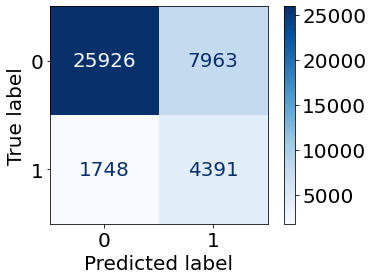

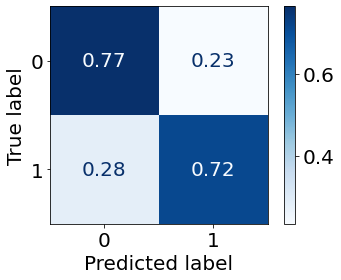

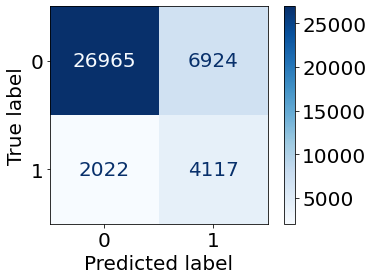

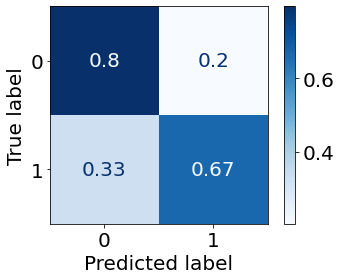

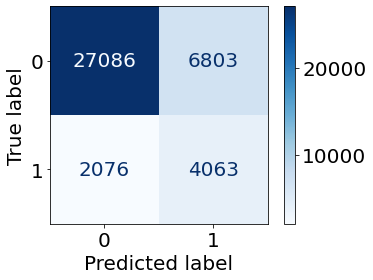

...

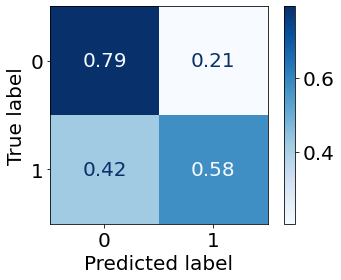

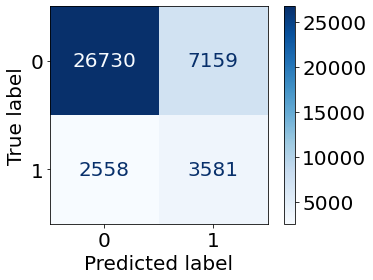

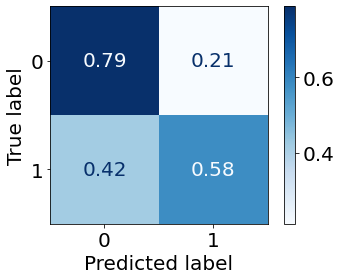

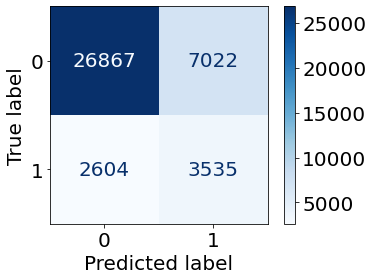

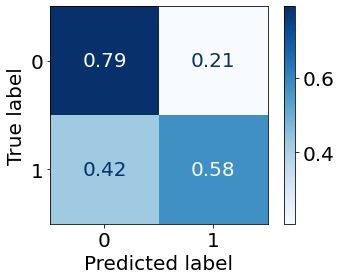

In [58]:
for n in range(1, 30):
    df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 5, n=n)

    X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2021_DP = df_train_2021_DP['Diabetes']
    print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

    train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                         X_validation_2021, y_validation_2021, 
                         X_validation_2021, y_validation_2021,
                         "2021", "Age-40_44-DP-" + str(n), "1", df_validation_2021,
                        save_dir = "Performance/Age_40_44-Validation-Set-Performance/")

### Analyze the performance and select best model using Bal_acc & AU_PRC_C1

In [59]:
import os
import pandas as pd

# Specify the directory containing CSV files
directory_path = 'Performance/Age_40_44-Validation-Set-Performance/'

# Get a list of all CSV files in the directory
csv_files = [file for file in os.listdir(directory_path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(directory_path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "40-44"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "40-44"]["Class 1 AU_PRC"].to_list()[0]
    
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv("Performance/Age_40_44-Validation-Set-Performance/ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
12,LR trained on 2021 Age-40_44-DP-13_trial_1.csv,0.739368,0.301058
10,LR trained on 2021 Age-40_44-DP-11_trial_1.csv,0.739033,0.300274
7,LR trained on 2021 Age-40_44-DP-8_trial_1.csv,0.738706,0.300592
8,LR trained on 2021 Age-40_44-DP-9_trial_1.csv,0.738706,0.300313
9,LR trained on 2021 Age-40_44-DP-10_trial_1.csv,0.738538,0.300351
11,LR trained on 2021 Age-40_44-DP-12_trial_1.csv,0.737542,0.300599
14,LR trained on 2021 Age-40_44-DP-15_trial_1.csv,0.737327,0.301321
18,LR trained on 2021 Age-40_44-DP-19_trial_1.csv,0.736268,0.302881
15,LR trained on 2021 Age-40_44-DP-16_trial_1.csv,0.735143,0.302491
13,LR trained on 2021 Age-40_44-DP-14_trial_1.csv,0.735006,0.301213


### Report test performance using selected DP model

Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (8424, 50)  # of DP units 13
New training set:  (128505, 50)
(128505, 48) (120081, 48) (40027, 48)
accuracy 0.7799735178754341
              precision    recall  f1-score   support

         0.0       0.92      0.81      0.86     33826
         1.0       0.37      0.60      0.46      6201

    accuracy                           0.78     40027
   macro avg       0.64      0.71      0.66     40027
weighted avg       0.83      0.78      0.80     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.5971617481051443
Class 1 Precision: 0.36985617259288855
Class 1 Area Under Precision-Recall Curve: 0.4108873387396803
Class 1 F1-Score: 0.45679393079627456
Class 0 Recall: 0.8134866670608407
Class 0 Precision: 0.9167749458604031
Class 0 Area Under Precision-Recall Curve: 0.7277932432575303
Class 0 F1-Score: 0.86

============================  30-34 ============================ 
Class 1 Recall: 0.6842105263157895
Class 1 Precision: 0.09848484848484848
Class 1 Area Under Precision-Recall Curve: 0.1680534186291417
Class 1 F1-Score: 0.17218543046357615
Class 0 Recall: 0.8336439888164026
Class 0 Precision: 0.9900387382401771
Class 0 Area Under Precision-Recall Curve: 0.9352705616105825
Class 0 F1-Score: 0.905135340247913
Overall Accuracy: 0.8297775760326827
Balanced Accuracy: 0.758927257566096
Area Under ROC Curve: 0.8434132862445022
Matthews Correlation Coefficient: 0.214108241507072
0.6842105263157895
0.09848484848484848
0.1680534186291417
0.17218543046357615
0.8336439888164026
0.9900387382401771
0.9352705616105825
0.905135340247913
0.8297775760326827
0.758927257566096
0.8434132862445022
0.214108241507072
============================  35-39 ============================ 
Class 1 Recall: 0.7322834645669292
Class 1 Precision: 0.18093385214007782
Class 1 Area Under Precision-Recall Curve: 0.2775489563

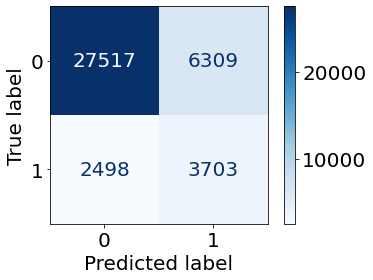

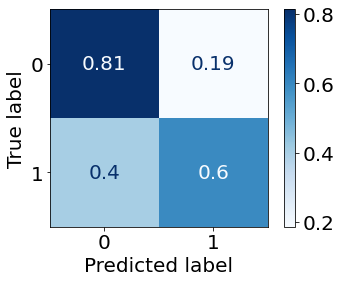

In [61]:
n = 13
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 5, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-40_44-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_40_44-Test-Set-Performance/")

## Trial 2

In [56]:
random_state = 2
df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)

(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)


Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
5  group class 1:  (647, 50)
5  group class 1:  (647, 50)  # of DP units 1
New training set:  (120728, 50)
(120728, 48) (120081, 48) (40027, 48)
accuracy 0.765938842810033
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33896
         1.0       0.36      0.69      0.47      6132

    accuracy                           0.77     40028
   macro avg       0.65      0.73      0.66     40028
weighted avg       0.85      0.77      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6890084801043705
Class 1 Precision: 0.3615127919911012
Class 1 Area Under Precision-Recall Curve: 0.43231047867702854
Class 1 F1-Score: 0.47421291879454514
Class 0 Recall: 0.7798560302100542
Class 0 Precision: 0.9327123249003211
Class 0 Area Under Precision-Recall Curve: 0.7225181862562549
Class 0 F1-Score: 0.84946

Class 1 Recall: 0.25
Class 1 Precision: 0.14150943396226415
Class 1 Area Under Precision-Recall Curve: 0.12631188582581906
Class 1 F1-Score: 0.18072289156626506
Class 0 Recall: 0.958295142071494
Class 0 Precision: 0.9789325842696629
Class 0 Area Under Precision-Recall Curve: 0.9380403182761254
Class 0 F1-Score: 0.9685039370078738
Overall Accuracy: 0.9393398751115076
Balanced Accuracy: 0.604147571035747
Area Under ROC Curve: 0.8304078826764436
Matthews Correlation Coefficient: 0.1583903005205708
0.25
0.14150943396226415
0.12631188582581906
0.18072289156626506
0.958295142071494
0.9789325842696629
0.9380403182761254
0.9685039370078738
0.9393398751115076
0.604147571035747
0.8304078826764436
0.1583903005205708
============================  35-39 ============================ 
Class 1 Recall: 0.48739495798319327
Class 1 Precision: 0.27488151658767773
Class 1 Area Under Precision-Recall Curve: 0.27728884037380036
Class 1 F1-Score: 0.3515151515151515
Class 0 Recall: 0.9429742825195676
Class 0 P

Class 1:  (18438, 50)
Class 0:  (101643, 50)
5  group class 1:  (647, 50)
5  group class 1:  (1294, 50)  # of DP units 2
New training set:  (121375, 50)
(121375, 48) (120081, 48) (40027, 48)
accuracy 0.7672878984710703
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33896
         1.0       0.36      0.69      0.47      6132

    accuracy                           0.77     40028
   macro avg       0.65      0.73      0.66     40028
weighted avg       0.84      0.77      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6852576647097195
Class 1 Precision: 0.36264779494260807
Class 1 Area Under Precision-Recall Curve: 0.4306462881112814
Class 1 F1-Score: 0.4742931316665726
Class 0 Recall: 0.7821276846825584
Class 0 Precision: 0.9321402201047783
Class 0 Area Under Precision-Recall Curve: 0.7236278934634738
Class 0 F1-Score: 0.8505702873093027
Overall Accuracy: 0.76728789

Class 1 Recall: 0.7357723577235772
Class 1 Precision: 0.37435367114788004
Class 1 Area Under Precision-Recall Curve: 0.4751957253976281
Class 1 F1-Score: 0.4962302947224126
Class 0 Recall: 0.7353455818022747
Class 0 Precision: 0.9282164549972391
Class 0 Area Under Precision-Recall Curve: 0.6848921357678442
Class 0 F1-Score: 0.8206004393458628
Overall Accuracy: 0.7354211663066955
Balanced Accuracy: 0.7355589697629259
Area Under ROC Curve: 0.8142208849910021
Matthews Correlation Coefficient: 0.3775529292583566
0.7357723577235772
0.37435367114788004
0.4751957253976281
0.4962302947224126
0.7353455818022747
0.9282164549972391
0.6848921357678442
0.8206004393458628
0.7354211663066955
0.7355589697629259
0.8142208849910021
0.3775529292583566
============================  30-34 ============================ 
Class 1 Recall: 0.31666666666666665
Class 1 Precision: 0.1386861313868613
Class 1 Area Under Precision-Recall Curve: 0.12688335869728368
Class 1 F1-Score: 0.19289340101522842
Class 0 Recall: 

Class 1 Recall: 0.7290209790209791
Class 1 Precision: 0.31662870159453305
Class 1 Area Under Precision-Recall Curve: 0.3793255353907994
Class 1 F1-Score: 0.44150344097406047
Class 0 Recall: 0.5942290351668169
Class 0 Precision: 0.8947725729803123
Class 0 Area Under Precision-Recall Curve: 0.6905844470807829
Class 0 F1-Score: 0.7141696017339475
Overall Accuracy: 0.6218637992831542
Balanced Accuracy: 0.661625007093898
Area Under ROC Curve: 0.7130238449557657
Matthews Correlation Coefficient: 0.26141052963803296
0.7290209790209791
0.31662870159453305
0.3793255353907994
0.44150344097406047
0.5942290351668169
0.8947725729803123
0.6905844470807829
0.7141696017339475
0.6218637992831542
0.661625007093898
0.7130238449557657
0.26141052963803296
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
5  group class 1:  (647, 50)
5  group class 1:  (1941, 50)  # of DP units 3
New training set:  (122022, 50)
(122022, 48) (120081, 48) (40027, 48)
accuracy 0.768112321375

Class 1 Recall: 0.7520325203252033
Class 1 Precision: 0.3722334004024145
Class 1 Area Under Precision-Recall Curve: 0.4728090069332138
Class 1 F1-Score: 0.4979811574697174
Class 0 Recall: 0.7270341207349081
Class 0 Precision: 0.9316143497757847
Class 0 Area Under Precision-Recall Curve: 0.6858987704095292
Class 0 F1-Score: 0.8167076167076166
Overall Accuracy: 0.7314614830813535
Balanced Accuracy: 0.7395333205300557
Area Under ROC Curve: 0.8106937598247373
Matthews Correlation Coefficient: 0.38152761508381244
0.7520325203252033
0.3722334004024145
0.4728090069332138
0.4979811574697174
0.7270341207349081
0.9316143497757847
0.6858987704095292
0.8167076167076166
0.7314614830813535
0.7395333205300557
0.8106937598247373
0.38152761508381244
============================  30-34 ============================ 
Class 1 Recall: 0.4
Class 1 Precision: 0.14545454545454545
Class 1 Area Under Precision-Recall Curve: 0.12651082729608168
Class 1 F1-Score: 0.21333333333333335
Class 0 Recall: 0.9353803849679

Class 0 F1-Score: 0.7443495730788549
Overall Accuracy: 0.6607797400866378
Balanced Accuracy: 0.683297310504257
Area Under ROC Curve: 0.7408602251583438
Matthews Correlation Coefficient: 0.31070659738598766
0.7250361794500724
0.37697516930022573
0.4523399701498461
0.49603960396039604
0.6415584415584416
0.8863636363636364
0.6458635925572102
0.7443495730788549
0.6607797400866378
0.683297310504257
0.7408602251583438
0.31070659738598766
============================  80-99 ============================ 
Class 1 Recall: 0.7062937062937062
Class 1 Precision: 0.32345876701361087
Class 1 Area Under Precision-Recall Curve: 0.37937112459481287
Class 1 F1-Score: 0.44371224601867104
Class 0 Recall: 0.6190261496844004
Class 0 Precision: 0.890979883192732
Class 0 Area Under Precision-Recall Curve: 0.6906131015180643
Class 0 F1-Score: 0.730513434424049
Overall Accuracy: 0.6369175627240143
Balanced Accuracy: 0.6626599279890533
Area Under ROC Curve: 0.7128977312137817
Matthews Correlation Coefficient: 0.2

Class 1 Recall: 0.7886178861788617
Class 1 Precision: 0.38492063492063494
Class 1 Area Under Precision-Recall Curve: 0.46828212801790914
Class 1 F1-Score: 0.5173333333333333
Class 0 Recall: 0.7483766233766234
Class 0 Precision: 0.946611909650924
Class 0 Area Under Precision-Recall Curve: 0.6962599466289787
Class 0 F1-Score: 0.8359020852221215
Overall Accuracy: 0.7550744248985115
Balanced Accuracy: 0.7684972547777426
Area Under ROC Curve: 0.8375831485587583
Matthews Correlation Coefficient: 0.4219373841861922
0.7886178861788617
0.38492063492063494
0.46828212801790914
0.5173333333333333
0.7483766233766234
0.946611909650924
0.6962599466289787
0.8359020852221215
0.7550744248985115
0.7684972547777426
0.8375831485587583
0.4219373841861922
============================  Hispanic ============================ 
Class 1 Recall: 0.7987804878048781
Class 1 Precision: 0.35152057245080504
Class 1 Area Under Precision-Recall Curve: 0.4694649116430064
Class 1 F1-Score: 0.48819875776397514
Class 0 Recall

0.6004329004329004
0.8908156711624919
0.6459784857525307
0.717351952417895
0.6357880706431189
0.6772063199704299
0.7405751749456524
0.2986251033823987
============================  80-99 ============================ 
Class 1 Recall: 0.7307692307692307
Class 1 Precision: 0.31357839459864967
Class 1 Area Under Precision-Recall Curve: 0.3793205901059794
Class 1 F1-Score: 0.43884514435695543
Class 0 Recall: 0.5874661857529305
Class 0 Precision: 0.8943033630748113
Class 0 Area Under Precision-Recall Curve: 0.6906561476648834
Class 0 F1-Score: 0.7091156462585033
Overall Accuracy: 0.6168458781362007
Balanced Accuracy: 0.6591177082610806
Area Under ROC Curve: 0.712766099995586
Matthews Correlation Coefficient: 0.2572067995613118
0.7307692307692307
0.31357839459864967
0.3793205901059794
0.43884514435695543
0.5874661857529305
0.8943033630748113
0.6906561476648834
0.7091156462585033
0.6168458781362007
0.6591177082610806
0.712766099995586
0.2572067995613118
Original training dataset:  (120081, 50)

Class 1 Recall: 0.7967479674796748
Class 1 Precision: 0.34416154521510095
Class 1 Area Under Precision-Recall Curve: 0.46491729221577693
Class 1 F1-Score: 0.4806866952789699
Class 0 Recall: 0.6732283464566929
Class 0 Precision: 0.938987187309335
Class 0 Area Under Precision-Recall Curve: 0.6882313129309631
Class 0 F1-Score: 0.784203821656051
Overall Accuracy: 0.6951043916486681
Balanced Accuracy: 0.7349881569681839
Area Under ROC Curve: 0.8036919673658679
Matthews Correlation Coefficient: 0.3647919922470734
0.7967479674796748
0.34416154521510095
0.46491729221577693
0.4806866952789699
0.6732283464566929
0.938987187309335
0.6882313129309631
0.784203821656051
0.6951043916486681
0.7349881569681839
0.8036919673658679
0.3647919922470734
============================  30-34 ============================ 
Class 1 Recall: 0.5333333333333333
Class 1 Precision: 0.11188811188811189
Class 1 Area Under Precision-Recall Curve: 0.1265025608181806
Class 1 F1-Score: 0.18497109826589597
Class 0 Recall: 0.8

Class 1 Recall: 0.7132867132867133
Class 1 Precision: 0.3185011709601874
Class 1 Area Under Precision-Recall Curve: 0.37880402201039964
Class 1 F1-Score: 0.4403669724770643
Class 0 Recall: 0.6064021641118125
Class 0 Precision: 0.8913187541418157
Class 0 Area Under Precision-Recall Curve: 0.6908187073822314
Class 0 F1-Score: 0.7217601287899115
Overall Accuracy: 0.6283154121863799
Balanced Accuracy: 0.6598444386992629
Area Under ROC Curve: 0.7125643180084117
Matthews Correlation Coefficient: 0.2589924638125637
0.7132867132867133
0.3185011709601874
0.37880402201039964
0.4403669724770643
0.6064021641118125
0.8913187541418157
0.6908187073822314
0.7217601287899115
0.6283154121863799
0.6598444386992629
0.7125643180084117
0.2589924638125637
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
5  group class 1:  (647, 50)
5  group class 1:  (3882, 50)  # of DP units 6
New training set:  (123963, 50)
(123963, 48) (120081, 48) (40027, 48)
accuracy 0.73628460077945

Class 1 Recall: 0.806910569105691
Class 1 Precision: 0.33530405405405406
Class 1 Area Under Precision-Recall Curve: 0.4616059240283084
Class 1 F1-Score: 0.47374701670644387
Class 0 Recall: 0.6557305336832896
Class 0 Precision: 0.9404015056461732
Class 0 Area Under Precision-Recall Curve: 0.6893911516902393
Class 0 F1-Score: 0.772680412371134
Overall Accuracy: 0.6825053995680346
Balanced Accuracy: 0.7313205513944903
Area Under ROC Curve: 0.8000617046852884
Matthews Correlation Coefficient: 0.35714524242213597
0.806910569105691
0.33530405405405406
0.4616059240283084
0.47374701670644387
0.6557305336832896
0.9404015056461732
0.6893911516902393
0.772680412371134
0.6825053995680346
0.7313205513944903
0.8000617046852884
0.35714524242213597
============================  30-34 ============================ 
Class 1 Recall: 0.5833333333333334
Class 1 Precision: 0.1044776119402985
Class 1 Area Under Precision-Recall Curve: 0.12600958241911012
Class 1 F1-Score: 0.17721518987341772
Class 0 Recall: 0

Class 0:  (101643, 50)
5  group class 1:  (647, 50)
5  group class 1:  (4529, 50)  # of DP units 7
New training set:  (124610, 50)
(124610, 48) (120081, 48) (40027, 48)
accuracy 0.7531727790546617
              precision    recall  f1-score   support

         0.0       0.93      0.76      0.84     33896
         1.0       0.35      0.69      0.46      6132

    accuracy                           0.75     40028
   macro avg       0.64      0.73      0.65     40028
weighted avg       0.84      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6937377690802349
Class 1 Precision: 0.3470953002610966
Class 1 Area Under Precision-Recall Curve: 0.4228589320129394
Class 1 F1-Score: 0.4626930606917555
Class 0 Recall: 0.7639249468963889
Class 0 Precision: 0.932377934610399
Class 0 Area Under Precision-Recall Curve: 0.7261186639417191
Class 0 F1-Score: 0.8397872478432898
Overall Accuracy: 0.7531727790546617
Balanced Accura

Class 1 Recall: 0.782520325203252
Class 1 Precision: 0.34252669039145905
Class 1 Area Under Precision-Recall Curve: 0.4572936226160471
Class 1 F1-Score: 0.47648514851485146
Class 0 Recall: 0.6767279090113736
Class 0 Precision: 0.9353083434099153
Class 0 Area Under Precision-Recall Curve: 0.6906481545453151
Class 0 F1-Score: 0.7852791878172588
Overall Accuracy: 0.6954643628509719
Balanced Accuracy: 0.7296241171073128
Area Under ROC Curve: 0.7965523618490776
Matthews Correlation Coefficient: 0.3572047713514505
0.782520325203252
0.34252669039145905
0.4572936226160471
0.47648514851485146
0.6767279090113736
0.9353083434099153
0.6906481545453151
0.7852791878172588
0.6954643628509719
0.7296241171073128
0.7965523618490776
0.3572047713514505
============================  30-34 ============================ 
Class 1 Recall: 0.5833333333333334
Class 1 Precision: 0.10802469135802469
Class 1 Area Under Precision-Recall Curve: 0.12598031888468403
Class 1 F1-Score: 0.18229166666666663
Class 0 Recall: 

============================  80-99 ============================ 
Class 1 Recall: 0.6433566433566433
Class 1 Precision: 0.336996336996337
Class 1 Area Under Precision-Recall Curve: 0.37840459373865676
Class 1 F1-Score: 0.44230769230769235
Class 0 Recall: 0.6735798016230838
Class 0 Precision: 0.8798586572438163
Class 0 Area Under Precision-Recall Curve: 0.6909882056995454
Class 0 F1-Score: 0.763023493360572
Overall Accuracy: 0.6673835125448029
Balanced Accuracy: 0.6584682224898636
Area Under ROC Curve: 0.7122403633336907
Matthews Correlation Coefficient: 0.2621626421719414
0.6433566433566433
0.336996336996337
0.37840459373865676
0.44230769230769235
0.6735798016230838
0.8798586572438163
0.6909882056995454
0.763023493360572
0.6673835125448029
0.6584682224898636
0.7122403633336907
0.2621626421719414
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
5  group class 1:  (647, 50)
5  group class 1:  (5176, 50)  # of DP units 8
New training set:  (125257, 50)

Class 1 Recall: 0.7926829268292683
Class 1 Precision: 0.3333333333333333
Class 1 Area Under Precision-Recall Curve: 0.45359183601884867
Class 1 F1-Score: 0.4693140794223827
Class 0 Recall: 0.6587926509186351
Class 0 Precision: 0.9365671641791045
Class 0 Area Under Precision-Recall Curve: 0.6918306521799094
Class 0 F1-Score: 0.773497688751926
Overall Accuracy: 0.6825053995680346
Balanced Accuracy: 0.7257377888739518
Area Under ROC Curve: 0.7930616904594241
Matthews Correlation Coefficient: 0.3490751825164236
0.7926829268292683
0.3333333333333333
0.45359183601884867
0.4693140794223827
0.6587926509186351
0.9365671641791045
0.6918306521799094
0.773497688751926
0.6825053995680346
0.7257377888739518
0.7930616904594241
0.3490751825164236
============================  30-34 ============================ 
Class 1 Recall: 0.6333333333333333
Class 1 Precision: 0.10326086956521739
Class 1 Area Under Precision-Recall Curve: 0.1260605864595222
Class 1 F1-Score: 0.17757009345794394
Class 0 Recall: 0.8

Class 1 Recall: 0.6363636363636364
Class 1 Precision: 0.3364140480591497
Class 1 Area Under Precision-Recall Curve: 0.3781484966719205
Class 1 F1-Score: 0.44014510278113667
Class 0 Recall: 0.6762849413886384
Class 0 Precision: 0.8782201405152225
Class 0 Area Under Precision-Recall Curve: 0.6910842384001641
Class 0 F1-Score: 0.7641365257259297
Overall Accuracy: 0.668100358422939
Balanced Accuracy: 0.6563242888761374
Area Under ROC Curve: 0.7120708979928998
Matthews Correlation Coefficient: 0.25904647033841444
0.6363636363636364
0.3364140480591497
0.3781484966719205
0.44014510278113667
0.6762849413886384
0.8782201405152225
0.6910842384001641
0.7641365257259297
0.668100358422939
0.6563242888761374
0.7120708979928998
0.25904647033841444
Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
5  group class 1:  (647, 50)
5  group class 1:  (5823, 50)  # of DP units 9
New training set:  (125904, 50)
(125904, 48) (120081, 48) (40027, 48)
accuracy 0.74170580593584

Class 1 Recall: 0.7
Class 1 Precision: 0.10194174757281553
Class 1 Area Under Precision-Recall Curve: 0.1262480764079401
Class 1 F1-Score: 0.17796610169491528
Class 0 Recall: 0.8304307974335472
Class 0 Precision: 0.9901639344262295
Class 0 Area Under Precision-Recall Curve: 0.9377994876822093
Class 0 F1-Score: 0.9032901296111666
Overall Accuracy: 0.8269402319357716
Balanced Accuracy: 0.7652153987167736
Area Under ROC Curve: 0.833188206538344
Matthews Correlation Coefficient: 0.22103323358923696
0.7
0.10194174757281553
0.1262480764079401
0.17796610169491528
0.8304307974335472
0.9901639344262295
0.9377994876822093
0.9032901296111666
0.8269402319357716
0.7652153987167736
0.833188206538344
0.22103323358923696
============================  35-39 ============================ 
Class 1 Recall: 0.7058823529411765
Class 1 Precision: 0.1575984990619137
Class 1 Area Under Precision-Recall Curve: 0.27440600882466165
Class 1 F1-Score: 0.25766871165644173
Class 0 Recall: 0.8326500186358554
Class 0 Pr

accuracy 0.7358598980713501
              precision    recall  f1-score   support

         0.0       0.93      0.74      0.83     33896
         1.0       0.33      0.71      0.45      6132

    accuracy                           0.74     40028
   macro avg       0.63      0.73      0.64     40028
weighted avg       0.84      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.7131441617742987
Class 1 Precision: 0.33161446879502543
Class 1 Area Under Precision-Recall Curve: 0.41549443263422686
Class 1 F1-Score: 0.4527149438376728
Class 0 Recall: 0.7399693179136181
Class 0 Precision: 0.9344659289892329
Class 0 Area Under Precision-Recall Curve: 0.7286556813785413
Class 0 F1-Score: 0.8259215963909973
Overall Accuracy: 0.7358598980713501
Balanced Accuracy: 0.7265567398439584
Area Under ROC Curve: 0.8009365919906036
Matthews Correlation Coefficient: 0.3472241565858723
0.7131441617742987
0.33161446879502543
0.41549443

Class 1 Recall: 0.8028455284552846
Class 1 Precision: 0.31803542673107893
Class 1 Area Under Precision-Recall Curve: 0.4445226692583245
Class 1 F1-Score: 0.4555940023068051
Class 0 Recall: 0.6294838145231846
Class 0 Precision: 0.9368489583333334
Class 0 Area Under Precision-Recall Curve: 0.6943724039033501
Class 0 F1-Score: 0.7530088958660387
Overall Accuracy: 0.660187185025198
Balanced Accuracy: 0.7161646714892346
Area Under ROC Curve: 0.7861790396119185
Matthews Correlation Coefficient: 0.3319548142900905
0.8028455284552846
0.31803542673107893
0.4445226692583245
0.4555940023068051
0.6294838145231846
0.9368489583333334
0.6943724039033501
0.7530088958660387
0.660187185025198
0.7161646714892346
0.7861790396119185
0.3319548142900905
============================  30-34 ============================ 
Class 1 Recall: 0.7166666666666667
Class 1 Precision: 0.09641255605381166
Class 1 Area Under Precision-Recall Curve: 0.1263487320633689
Class 1 F1-Score: 0.16996047430830039
Class 0 Recall: 0.8

Class 0:  (101643, 50)
5  group class 1:  (647, 50)
5  group class 1:  (7117, 50)  # of DP units 11
New training set:  (127198, 50)
(127198, 48) (120081, 48) (40027, 48)
accuracy 0.747626661337064
              precision    recall  f1-score   support

         0.0       0.93      0.76      0.84     33896
         1.0       0.34      0.68      0.45      6132

    accuracy                           0.75     40028
   macro avg       0.63      0.72      0.64     40028
weighted avg       0.84      0.75      0.78     40028



/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_plot/confusion_matrix.py:114: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


============================  Over all performance ============================ 
Class 1 Recall: 0.6811806914546641
Class 1 Precision: 0.338932164881532
Class 1 Area Under Precision-Recall Curve: 0.41300961097906075
Class 1 F1-Score: 0.45264412657130476
Class 0 Recall: 0.7596471560066085
Class 0 Precision: 0.9294325729136587
Class 0 Area Under Precision-Recall Curve: 0.7290758270023764
Class 0 F1-Score: 0.8360064935064935
Overall Accuracy: 0.747626661337064
Balanced Accuracy: 0.7204139237306363
Area Under ROC Curve: 0.798658456891507
Matthews Correlation Coefficient: 0.343951522306215
0.6811806914546641
0.338932164881532
0.41300961097906075
0.45264412657130476
0.7596471560066085
0.9294325729136587
0.7290758270023764
0.8360064935064935
0.747626661337064
0.7204139237306363
0.798658456891507
0.343951522306215
============================  Male ============================ 
Class 1 Recall: 0.6857142857142857
Class 1 Precision: 0.3385521624554333
Class 1 Area Under Precision-Recall Curve: 0

Class 1 Recall: 0.7487684729064039
Class 1 Precision: 0.20994475138121546
Class 1 Area Under Precision-Recall Curve: 0.3207936491093257
Class 1 F1-Score: 0.3279395900755124
Class 0 Recall: 0.8060359443879281
Class 0 Precision: 0.978995057660626
Class 0 Area Under Precision-Recall Curve: 0.8516363510375305
Class 0 F1-Score: 0.8841361353914822
Overall Accuracy: 0.8023477157360406
Balanced Accuracy: 0.777402208647166
Area Under ROC Curve: 0.8521683061971412
Matthews Correlation Coefficient: 0.3237663365131731
0.7487684729064039
0.20994475138121546
0.3207936491093257
0.3279395900755124
0.8060359443879281
0.978995057660626
0.8516363510375305
0.8841361353914822
0.8023477157360406
0.777402208647166
0.8521683061971412
0.3237663365131731
============================  45-49 ============================ 
Class 1 Recall: 0.7160493827160493
Class 1 Precision: 0.2703962703962704
Class 1 Area Under Precision-Recall Curve: 0.36304200025752575
Class 1 F1-Score: 0.39255499153976314
Class 0 Recall: 0.776

Class 1 Recall: 0.7124018838304552
Class 1 Precision: 0.3246994848311391
Class 1 Area Under Precision-Recall Curve: 0.4138729696661144
Class 1 F1-Score: 0.4460827681116681
Class 0 Recall: 0.7016312594840668
Class 0 Precision: 0.923749271622409
Class 0 Area Under Precision-Recall Curve: 0.7109473523206342
Class 0 F1-Score: 0.7975133853174745
Overall Accuracy: 0.7034366612283564
Balanced Accuracy: 0.707016571657261
Area Under ROC Curve: 0.7764799213720739
Matthews Correlation Coefficient: 0.3207273290305126
0.7124018838304552
0.3246994848311391
0.4138729696661144
0.4460827681116681
0.7016312594840668
0.923749271622409
0.7109473523206342
0.7975133853174745
0.7034366612283564
0.707016571657261
0.7764799213720739
0.3207273290305126
============================  Female ============================ 
Class 1 Recall: 0.7105531048523923
Class 1 Precision: 0.3270342027174762
Class 1 Area Under Precision-Recall Curve: 0.4182103849644661
Class 1 F1-Score: 0.4479144385026738
Class 0 Recall: 0.761670

Class 1 Recall: 0.7931034482758621
Class 1 Precision: 0.19281437125748502
Class 1 Area Under Precision-Recall Curve: 0.3209276381830261
Class 1 F1-Score: 0.31021194605009633
Class 0 Recall: 0.7714479484571041
Class 0 Precision: 0.9818731117824774
Class 0 Area Under Precision-Recall Curve: 0.8516234105704403
Class 0 F1-Score: 0.8640334219521458
Overall Accuracy: 0.7728426395939086
Balanced Accuracy: 0.7822756983664831
Area Under ROC Curve: 0.8522033853005193
Matthews Correlation Coefficient: 0.3140383138121479
0.7931034482758621
0.19281437125748502
0.3209276381830261
0.31021194605009633
0.7714479484571041
0.9818731117824774
0.8516234105704403
0.8640334219521458
0.7728426395939086
0.7822756983664831
0.8522033853005193
0.3140383138121479
============================  45-49 ============================ 
Class 1 Recall: 0.7438271604938271
Class 1 Precision: 0.2552966101694915
Class 1 Area Under Precision-Recall Curve: 0.3631104305436159
Class 1 F1-Score: 0.38012618296529965
Class 0 Recall: 

Class 1 Recall: 0.7070643642072213
Class 1 Precision: 0.3237958303378864
Class 1 Area Under Precision-Recall Curve: 0.41043148416371256
Class 1 F1-Score: 0.4441814595660749
Class 0 Recall: 0.7026428932726353
Class 0 Precision: 0.9225469035364436
Class 0 Area Under Precision-Recall Curve: 0.7119453162406576
Class 0 F1-Score: 0.7977173210824778
Overall Accuracy: 0.7033840324193463
Balanced Accuracy: 0.7048536287399283
Area Under ROC Curve: 0.7737904564183559
Matthews Correlation Coefficient: 0.3176923132462319
0.7070643642072213
0.3237958303378864
0.41043148416371256
0.4441814595660749
0.7026428932726353
0.9225469035364436
0.7119453162406576
0.7977173210824778
0.7033840324193463
0.7048536287399283
0.7737904564183559
0.3176923132462319
============================  Female ============================ 
Class 1 Recall: 0.7061418391584663
Class 1 Precision: 0.3258180679505245
Class 1 Area Under Precision-Recall Curve: 0.41564611626308534
Class 1 F1-Score: 0.4458967216627384
Class 0 Recall: 0

Class 1 Recall: 0.8029556650246306
Class 1 Precision: 0.18997668997668998
Class 1 Area Under Precision-Recall Curve: 0.32109397984142873
Class 1 F1-Score: 0.3072573044297833
Class 0 Recall: 0.7643268904713462
Class 0 Precision: 0.9825632083696599
Class 0 Area Under Precision-Recall Curve: 0.8516018790783766
Class 0 F1-Score: 0.8598130841121494
Overall Accuracy: 0.7668147208121827
Balanced Accuracy: 0.7836412777479884
Area Under ROC Curve: 0.8522551687388396
Matthews Correlation Coefficient: 0.3128559963608392
0.8029556650246306
0.18997668997668998
0.32109397984142873
0.3072573044297833
0.7643268904713462
0.9825632083696599
0.8516018790783766
0.8598130841121494
0.7668147208121827
0.7836412777479884
0.8522551687388396
0.3128559963608392
============================  45-49 ============================ 
Class 1 Recall: 0.75
Class 1 Precision: 0.25418410041841005
Class 1 Area Under Precision-Recall Curve: 0.36285433259113753
Class 1 F1-Score: 0.37968750000000007
Class 0 Recall: 0.7450840185

Class 1 Recall: 0.61287284144427
Class 1 Precision: 0.35279233688776435
Class 1 Area Under Precision-Recall Curve: 0.4069236490384036
Class 1 F1-Score: 0.44780913053452626
Class 0 Recall: 0.773583712696004
Class 0 Precision: 0.9084496584496584
Class 0 Area Under Precision-Recall Curve: 0.7129501121643574
Class 0 F1-Score: 0.8356098893593772
Overall Accuracy: 0.7466449134256091
Balanced Accuracy: 0.693228277070137
Area Under ROC Curve: 0.7711326745008731
Matthews Correlation Coefficient: 0.317739958637295
0.61287284144427
0.35279233688776435
0.4069236490384036
0.44780913053452626
0.773583712696004
0.9084496584496584
0.7129501121643574
0.8356098893593772
0.7466449134256091
0.693228277070137
0.7711326745008731
0.317739958637295
============================  Female ============================ 
Class 1 Recall: 0.6223277909738717
Class 1 Precision: 0.3577140628047591
Class 1 Area Under Precision-Recall Curve: 0.4129675227319012
Class 1 F1-Score: 0.4542977458508793
Class 0 Recall: 0.81786504

Class 1 Recall: 0.7389162561576355
Class 1 Precision: 0.22026431718061673
Class 1 Area Under Precision-Recall Curve: 0.32123062156079263
Class 1 F1-Score: 0.3393665158371041
Class 0 Recall: 0.8199389623601221
Class 0 Precision: 0.9785511938486443
Class 0 Area Under Precision-Recall Curve: 0.8515784955799411
Class 0 F1-Score: 0.892250922509225
Overall Accuracy: 0.8147208121827412
Balanced Accuracy: 0.7794276092588788
Area Under ROC Curve: 0.8523236565121015
Matthews Correlation Coefficient: 0.33333029544428944
0.7389162561576355
0.22026431718061673
0.32123062156079263
0.3393665158371041
0.8199389623601221
0.9785511938486443
0.8515784955799411
0.892250922509225
0.8147208121827412
0.7794276092588788
0.8523236565121015
0.33333029544428944
============================  45-49 ============================ 
Class 1 Recall: 0.691358024691358
Class 1 Precision: 0.2846251588310038
Class 1 Area Under Precision-Recall Curve: 0.362722010077689
Class 1 F1-Score: 0.40324032403240323
Class 0 Recall: 0.

Class 1 Recall: 0.6125588697017268
Class 1 Precision: 0.34995515695067264
Class 1 Area Under Precision-Recall Curve: 0.40354700379428204
Class 1 F1-Score: 0.44543378995433786
Class 0 Recall: 0.7708649468892261
Class 0 Precision: 0.9080887829584389
Class 0 Area Under Precision-Recall Curve: 0.7139356514470334
Class 0 F1-Score: 0.8338690924013407
Overall Accuracy: 0.7443292458291669
Balanced Accuracy: 0.6917119082954765
Area Under ROC Curve: 0.7685467352576609
Matthews Correlation Coefficient: 0.31454759939970617
0.6125588697017268
0.34995515695067264
0.40354700379428204
0.44543378995433786
0.7708649468892261
0.9080887829584389
0.7139356514470334
0.8338690924013407
0.7443292458291669
0.6917119082954765
0.7685467352576609
0.31454759939970617
============================  Female ============================ 
Class 1 Recall: 0.6226671191041737
Class 1 Precision: 0.35424710424710426
Class 1 Area Under Precision-Recall Curve: 0.4101804518831651
Class 1 F1-Score: 0.45158114925556786
Class 0 Re

Class 1 Recall: 0.7438423645320197
Class 1 Precision: 0.21388101983002833
Class 1 Area Under Precision-Recall Curve: 0.32113502782859144
Class 1 F1-Score: 0.33223322332233224
Class 0 Recall: 0.8118006103763988
Class 0 Precision: 0.9787408013082584
Class 0 Area Under Precision-Recall Curve: 0.8515838775915686
Class 0 F1-Score: 0.8874884151992586
Overall Accuracy: 0.8074238578680203
Balanced Accuracy: 0.7778214874542093
Area Under ROC Curve: 0.8523420312805376
Matthews Correlation Coefficient: 0.3271528109760864
0.7438423645320197
0.21388101983002833
0.32113502782859144
0.33223322332233224
0.8118006103763988
0.9787408013082584
0.8515838775915686
0.8874884151992586
0.8074238578680203
0.7778214874542093
0.8523420312805376
0.3271528109760864
============================  45-49 ============================ 
Class 1 Recall: 0.7006172839506173
Class 1 Precision: 0.2819875776397516
Class 1 Area Under Precision-Recall Curve: 0.36237116014197884
Class 1 F1-Score: 0.4021257750221435
Class 0 Recall

Class 1 Recall: 0.6050235478806908
Class 1 Precision: 0.34953745692000726
Class 1 Area Under Precision-Recall Curve: 0.40019816455846957
Class 1 F1-Score: 0.4430903656012877
Class 0 Recall: 0.7732675771370764
Class 0 Precision: 0.9067319098457889
Class 0 Area Under Precision-Recall Curve: 0.7149223659073898
Class 0 F1-Score: 0.8346983346983349
Overall Accuracy: 0.7450660491553076
Balanced Accuracy: 0.6891455625088836
Area Under ROC Curve: 0.7659527164431781
Matthews Correlation Coefficient: 0.31135900028973595
0.6050235478806908
0.34953745692000726
0.40019816455846957
0.4430903656012877
0.7732675771370764
0.9067319098457889
0.7149223659073898
0.8346983346983349
0.7450660491553076
0.6891455625088836
0.7659527164431781
0.31135900028973595
============================  Female ============================ 
Class 1 Recall: 0.6172378690193417
Class 1 Precision: 0.35485758876316814
Class 1 Area Under Precision-Recall Curve: 0.4075062668869588
Class 1 F1-Score: 0.4506379288987985
Class 0 Recal

Class 1 Recall: 0.7438423645320197
Class 1 Precision: 0.21237693389592124
Class 1 Area Under Precision-Recall Curve: 0.32106549852279115
Class 1 F1-Score: 0.3304157549234136
Class 0 Recall: 0.8101051203797898
Class 0 Precision: 0.9786972552232691
Class 0 Area Under Precision-Recall Curve: 0.8515858368733882
Class 0 F1-Score: 0.886456400742115
Overall Accuracy: 0.8058375634517766
Balanced Accuracy: 0.7769737424559047
Area Under ROC Curve: 0.8523386904135491
Matthews Correlation Coefficient: 0.32533838767372497
0.7438423645320197
0.21237693389592124
0.32106549852279115
0.3304157549234136
0.8101051203797898
0.9786972552232691
0.8515858368733882
0.886456400742115
0.8058375634517766
0.7769737424559047
0.8523386904135491
0.32533838767372497
============================  45-49 ============================ 
Class 1 Recall: 0.7006172839506173
Class 1 Precision: 0.2802469135802469
Class 1 Area Under Precision-Recall Curve: 0.3625933315285065
Class 1 F1-Score: 0.400352733686067
Class 0 Recall: 0.

Class 1 Recall: 0.5987441130298273
Class 1 Precision: 0.3499724720132134
Class 1 Area Under Precision-Recall Curve: 0.3969319920599603
Class 1 F1-Score: 0.4417419504285383
Class 0 Recall: 0.7760495700556399
Class 0 Precision: 0.9056965761511216
Class 0 Area Under Precision-Recall Curve: 0.7158873490771527
Class 0 F1-Score: 0.83587578316535
Overall Accuracy: 0.7463291405715489
Balanced Accuracy: 0.6873968415427336
Area Under ROC Curve: 0.7634620049724102
Matthews Correlation Coefficient: 0.3095531363311747
0.5987441130298273
0.3499724720132134
0.3969319920599603
0.4417419504285383
0.7760495700556399
0.9056965761511216
0.7158873490771527
0.83587578316535
0.7463291405715489
0.6873968415427336
0.7634620049724102
0.3095531363311747
============================  Female ============================ 
Class 1 Recall: 0.6121479470648117
Class 1 Precision: 0.3531714956930305
Class 1 Area Under Precision-Recall Curve: 0.40482761417400676
Class 1 F1-Score: 0.4479205462445686
Class 0 Recall: 0.81725

Class 1 Recall: 0.7487684729064039
Class 1 Precision: 0.21199442119944212
Class 1 Area Under Precision-Recall Curve: 0.3211000145130953
Class 1 F1-Score: 0.3304347826086957
Class 0 Recall: 0.8084096303831807
Class 0 Precision: 0.9790554414784394
Class 0 Area Under Precision-Recall Curve: 0.8515747084531229
Class 0 F1-Score: 0.8855869242199108
Overall Accuracy: 0.8045685279187818
Balanced Accuracy: 0.7785890516447923
Area Under ROC Curve: 0.8524055077533171
Matthews Correlation Coefficient: 0.3262649232151652
0.7487684729064039
0.21199442119944212
0.3211000145130953
0.3304347826086957
0.8084096303831807
0.9790554414784394
0.8515747084531229
0.8855869242199108
0.8045685279187818
0.7785890516447923
0.8524055077533171
0.3262649232151652
============================  45-49 ============================ 
Class 1 Recall: 0.7006172839506173
Class 1 Precision: 0.27682926829268295
Class 1 Area Under Precision-Recall Curve: 0.36247180248959626
Class 1 F1-Score: 0.39685314685314693
Class 0 Recall: 

Class 1 Recall: 0.6053375196232339
Class 1 Precision: 0.34367201426024957
Class 1 Area Under Precision-Recall Curve: 0.3935904373621514
Class 1 F1-Score: 0.43843092666287664
Class 0 Recall: 0.7671977744056652
Class 0 Precision: 0.9061309834963782
Class 0 Area Under Precision-Recall Curve: 0.7168605616830511
Class 0 F1-Score: 0.8308967028452083
Overall Accuracy: 0.7400663122993527
Balanced Accuracy: 0.6862676470144495
Area Under ROC Curve: 0.7609854476400107
Matthews Correlation Coefficient: 0.3050580817132464
0.6053375196232339
0.34367201426024957
0.3935904373621514
0.43843092666287664
0.7671977744056652
0.9061309834963782
0.7168605616830511
0.8308967028452083
0.7400663122993527
0.6862676470144495
0.7609854476400107
0.3050580817132464
============================  Female ============================ 
Class 1 Recall: 0.6199524940617577
Class 1 Precision: 0.3473384030418251
Class 1 Area Under Precision-Recall Curve: 0.40203100523442425
Class 1 F1-Score: 0.44522968197879864
Class 0 Recall

Class 1 Recall: 0.7098765432098766
Class 1 Precision: 0.2693208430913349
Class 1 Area Under Precision-Recall Curve: 0.3624964225083177
Class 1 F1-Score: 0.3904923599320883
Class 0 Recall: 0.7769038255273507
Class 0 Precision: 0.9585355094838994
Class 0 Area Under Precision-Recall Curve: 0.7924808570127573
Class 0 F1-Score: 0.858214849921011
Overall Accuracy: 0.7699455302787568
Balanced Accuracy: 0.7433901843686137
Area Under ROC Curve: 0.8162002277572532
Matthews Correlation Coefficient: 0.3330405370607191
0.7098765432098766
0.2693208430913349
0.3624964225083177
0.3904923599320883
0.7769038255273507
0.9585355094838994
0.7924808570127573
0.858214849921011
0.7699455302787568
0.7433901843686137
0.8162002277572532
0.3330405370607191
============================  50-54 ============================ 
Class 1 Recall: 0.7034764826175869
Class 1 Precision: 0.3242224316682375
Class 1 Area Under Precision-Recall Curve: 0.45517242903946376
Class 1 F1-Score: 0.44387096774193546
Class 0 Recall: 0.788

Class 1 Recall: 0.5658040256580402
Class 1 Precision: 0.3453956251687821
Class 1 Area Under Precision-Recall Curve: 0.3801807315711364
Class 1 F1-Score: 0.428942734971074
Class 0 Recall: 0.8226903664691683
Class 0 Precision: 0.9197366807049107
Class 0 Area Under Precision-Recall Curve: 0.7448605190647309
Class 0 F1-Score: 0.8685109751153497
Overall Accuracy: 0.7862410946866272
Balanced Accuracy: 0.6942471960636043
Area Under ROC Curve: 0.7839732011752599
Matthews Correlation Coefficient: 0.32093989157424074
0.5658040256580402
0.3453956251687821
0.3801807315711364
0.428942734971074
0.8226903664691683
0.9197366807049107
0.7448605190647309
0.8685109751153497
0.7862410946866272
0.6942471960636043
0.7839732011752599
0.32093989157424074
============================  Black ============================ 
Class 1 Recall: 0.7603053435114504
Class 1 Precision: 0.3519434628975265
Class 1 Area Under Precision-Recall Curve: 0.4610816266321026
Class 1 F1-Score: 0.48115942028985503
Class 0 Recall: 0.57

Class 1 Recall: 0.7160493827160493
Class 1 Precision: 0.2678983833718245
Class 1 Area Under Precision-Recall Curve: 0.3623271626829857
Class 1 F1-Score: 0.3899159663865546
Class 0 Recall: 0.7733285663210583
Class 0 Precision: 0.9592017738359202
Class 0 Area Under Precision-Recall Curve: 0.7925036938781941
Class 0 F1-Score: 0.8562945368171022
Overall Accuracy: 0.7673822492790772
Balanced Accuracy: 0.7446889745185539
Area Under ROC Curve: 0.8161494679043242
Matthews Correlation Coefficient: 0.33337337800179967
0.7160493827160493
0.2678983833718245
0.3623271626829857
0.3899159663865546
0.7733285663210583
0.9592017738359202
0.7925036938781941
0.8562945368171022
0.7673822492790772
0.7446889745185539
0.8161494679043242
0.33337337800179967
============================  50-54 ============================ 
Class 1 Recall: 0.7075664621676891
Class 1 Precision: 0.32397003745318353
Class 1 Area Under Precision-Recall Curve: 0.455031763813352
Class 1 F1-Score: 0.4444444444444444
Class 0 Recall: 0.7

Class 1 Recall: 0.572882105728821
Class 1 Precision: 0.3390940036658811
Class 1 Area Under Precision-Recall Curve: 0.3774396161967065
Class 1 F1-Score: 0.4260218767990789
Class 0 Recall: 0.8153756126106356
Class 0 Precision: 0.9202889576883385
Class 0 Area Under Precision-Recall Curve: 0.7455604855301556
Class 0 F1-Score: 0.86466150832897
Overall Accuracy: 0.7809685214825973
Balanced Accuracy: 0.6941288591697283
Area Under ROC Curve: 0.7821021224095663
Matthews Correlation Coefficient: 0.31734435043265036
0.572882105728821
0.3390940036658811
0.3774396161967065
0.4260218767990789
0.8153756126106356
0.9202889576883385
0.7455604855301556
0.86466150832897
0.7809685214825973
0.6941288591697283
0.7821021224095663
0.31734435043265036
============================  Black ============================ 
Class 1 Recall: 0.7694656488549618
Class 1 Precision: 0.34782608695652173
Class 1 Area Under Precision-Recall Curve: 0.45770412034473623
Class 1 F1-Score: 0.4790874524714828
Class 0 Recall: 0.55820

Class 1 Recall: 0.7198364008179959
Class 1 Precision: 0.3179765130984643
Class 1 Area Under Precision-Recall Curve: 0.45504147851012583
Class 1 F1-Score: 0.44110275689223055
Class 0 Recall: 0.7774830533451224
Class 0 Precision: 0.9506306306306306
Class 0 Area Under Precision-Recall Curve: 0.7510818229845944
Class 0 F1-Score: 0.8553826199740596
Overall Accuracy: 0.7702215352910871
Balanced Accuracy: 0.7486597270815591
Area Under ROC Curve: 0.8300084921620778
Matthews Correlation Coefficient: 0.3654908454444074
0.7198364008179959
0.3179765130984643
0.45504147851012583
0.44110275689223055
0.7774830533451224
0.9506306306306306
0.7510818229845944
0.8553826199740596
0.7702215352910871
0.7486597270815591
0.8300084921620778
0.3654908454444074
============================  55-59 ============================ 
Class 1 Recall: 0.680327868852459
Class 1 Precision: 0.37870722433460074
Class 1 Area Under Precision-Recall Curve: 0.45369298601008584
Class 1 F1-Score: 0.48656570591108933
Class 0 Recall:

Class 1 Recall: 0.5711125857111259
Class 1 Precision: 0.33738403240559256
Class 1 Area Under Precision-Recall Curve: 0.3747010452206817
Class 1 F1-Score: 0.42418268440939705
Class 0 Recall: 0.8145344159169043
Class 0 Precision: 0.9199091284593144
Class 0 Area Under Precision-Recall Curve: 0.7462548147530144
Class 0 F1-Score: 0.8640207945375543
Overall Accuracy: 0.7799956061889967
Balanced Accuracy: 0.6928235008140151
Area Under ROC Curve: 0.7802753026776706
Matthews Correlation Coefficient: 0.3149989460727604
0.5711125857111259
0.33738403240559256
0.3747010452206817
0.42418268440939705
0.8145344159169043
0.9199091284593144
0.7462548147530144
0.8640207945375543
0.7799956061889967
0.6928235008140151
0.7802753026776706
0.3149989460727604
============================  Black ============================ 
Class 1 Recall: 0.766412213740458
Class 1 Precision: 0.3454920853406745
Class 1 Area Under Precision-Recall Curve: 0.45518422323974844
Class 1 F1-Score: 0.47628083491461104
Class 0 Recall: 

Class 1 Recall: 0.6816939890710383
Class 1 Precision: 0.37803030303030305
Class 1 Area Under Precision-Recall Curve: 0.45353014184212387
Class 1 F1-Score: 0.48635477582846004
Class 0 Recall: 0.7745124965668773
Class 0 Precision: 0.92368162463151
Class 0 Area Under Precision-Recall Curve: 0.7000303858009156
Class 0 F1-Score: 0.8425455631909173
Overall Accuracy: 0.7589755316716214
Balanced Accuracy: 0.7281032428189578
Area Under ROC Curve: 0.8090356414424069
Matthews Correlation Coefficient: 0.3710026121116086
0.6816939890710383
0.37803030303030305
0.45353014184212387
0.48635477582846004
0.7745124965668773
0.92368162463151
0.7000303858009156
0.8425455631909173
0.7589755316716214
0.7281032428189578
0.8090356414424069
0.3710026121116086
============================  60-64 ============================ 
Class 1 Recall: 0.6448390677025527
Class 1 Precision: 0.4023545706371191
Class 1 Area Under Precision-Recall Curve: 0.4600859078989934
Class 1 F1-Score: 0.4955223880597015
Class 0 Recall: 0.7

Class 1 Recall: 0.5636363636363636
Class 1 Precision: 0.2897196261682243
Class 1 Area Under Precision-Recall Curve: 0.35028411184320896
Class 1 F1-Score: 0.382716049382716
Class 0 Recall: 0.7920656634746922
Class 0 Precision: 0.9234449760765551
Class 0 Area Under Precision-Recall Curve: 0.7697170081681259
Class 0 F1-Score: 0.8527245949926363
Overall Accuracy: 0.7621878715814506
Balanced Accuracy: 0.6778510135555279
Area Under ROC Curve: 0.7644198482775775
Matthews Correlation Coefficient: 0.27535991198210014
0.5636363636363636
0.2897196261682243
0.35028411184320896
0.382716049382716
0.7920656634746922
0.9234449760765551
0.7697170081681259
0.8527245949926363
0.7621878715814506
0.6778510135555279
0.7644198482775775
0.27535991198210014
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7777777777777778
Class 1 Precision: 0.25925925925925924
Class 1 Area Under Precision-Recall Curve: 0.4081969518972003
Class 1 F1-Score: 0.3888888888888889
Class 0 

Class 1 Recall: 0.6426193118756937
Class 1 Precision: 0.40264255910987484
Class 1 Area Under Precision-Recall Curve: 0.45982157824492503
Class 1 F1-Score: 0.49508336896109445
Class 0 Recall: 0.786530815109344
Class 0 Precision: 0.9076570117579581
Class 0 Area Under Precision-Recall Curve: 0.6839977449646846
Class 0 F1-Score: 0.8427639462122221
Overall Accuracy: 0.7602030456852792
Balanced Accuracy: 0.7145750634925188
Area Under ROC Curve: 0.7943144407693683
Matthews Correlation Coefficient: 0.36491793631080016
0.6426193118756937
0.40264255910987484
0.45982157824492503
0.49508336896109445
0.786530815109344
0.9076570117579581
0.6839977449646846
0.8427639462122221
0.7602030456852792
0.7145750634925188
0.7943144407693683
0.36491793631080016
============================  65-69 ============================ 
Class 1 Recall: 0.6179337231968811
Class 1 Precision: 0.4229486324216144
Class 1 Area Under Precision-Recall Curve: 0.4665225386826055
Class 1 F1-Score: 0.5021782178217823
Class 0 Recall:

Class 1 Recall: 0.5636363636363636
Class 1 Precision: 0.28440366972477066
Class 1 Area Under Precision-Recall Curve: 0.3479949553327304
Class 1 F1-Score: 0.3780487804878049
Class 0 Recall: 0.786593707250342
Class 0 Precision: 0.9229534510433387
Class 0 Area Under Precision-Recall Curve: 0.7708687295183475
Class 0 F1-Score: 0.8493353028064993
Overall Accuracy: 0.7574316290130797
Balanced Accuracy: 0.6751150354433528
Area Under ROC Curve: 0.7608008954110186
Matthews Correlation Coefficient: 0.26948599055512723
0.5636363636363636
0.28440366972477066
0.3479949553327304
0.3780487804878049
0.786593707250342
0.9229534510433387
0.7708687295183475
0.8493353028064993
0.7574316290130797
0.6751150354433528
0.7608008954110186
0.26948599055512723
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7777777777777778
Class 1 Precision: 0.25609756097560976
Class 1 Area Under Precision-Recall Curve: 0.40520446206600913
Class 1 F1-Score: 0.38532110091743116
Class 

Class 1 Recall: 0.6179337231968811
Class 1 Precision: 0.4226666666666667
Class 1 Area Under Precision-Recall Curve: 0.4658115718894678
Class 1 F1-Score: 0.5019794140934283
Class 0 Recall: 0.7917267917267917
Class 0 Precision: 0.8935939196525515
Class 0 Area Under Precision-Recall Curve: 0.6669373858551833
Class 0 F1-Score: 0.839581739352206
Overall Accuracy: 0.7573302469135802
Balanced Accuracy: 0.7048302574618364
Area Under ROC Curve: 0.7893481599621951
Matthews Correlation Coefficient: 0.359943710379267
0.6179337231968811
0.4226666666666667
0.4658115718894678
0.5019794140934283
0.7917267917267917
0.8935939196525515
0.6669373858551833
0.839581739352206
0.7573302469135802
0.7048302574618364
0.7893481599621951
0.359943710379267
============================  70-74 ============================ 
Class 1 Recall: 0.5684729064039409
Class 1 Precision: 0.44521604938271603
Class 1 Area Under Precision-Recall Curve: 0.4905348812958877
Class 1 F1-Score: 0.4993509303331891
Class 0 Recall: 0.796950

Class 1 Recall: 0.5727272727272728
Class 1 Precision: 0.28125
Class 1 Area Under Precision-Recall Curve: 0.3434530862998151
Class 1 F1-Score: 0.3772455089820359
Class 0 Recall: 0.7797537619699042
Class 0 Precision: 0.9238249594813615
Class 0 Area Under Precision-Recall Curve: 0.7721475178722652
Class 0 F1-Score: 0.8456973293768546
Overall Accuracy: 0.7526753864447087
Balanced Accuracy: 0.6762405173485885
Area Under ROC Curve: 0.757194378808606
Matthews Correlation Coefficient: 0.2688587620079954
0.5727272727272728
0.28125
0.3434530862998151
0.3772455089820359
0.7797537619699042
0.9238249594813615
0.7721475178722652
0.8456973293768546
0.7526753864447087
0.6762405173485885
0.757194378808606
0.2688587620079954
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7777777777777778
Class 1 Precision: 0.25301204819277107
Class 1 Area Under Precision-Recall Curve: 0.40499408427757244
Class 1 F1-Score: 0.3818181818181818
Class 0 Recall: 0.491803278688524

Class 1 Recall: 0.6470588235294118
Class 1 Precision: 0.3987688098495212
Class 1 Area Under Precision-Recall Curve: 0.4593969097310978
Class 1 F1-Score: 0.4934405416842996
Class 0 Recall: 0.7815606361829026
Class 0 Precision: 0.9081721051111753
Class 0 Area Under Precision-Recall Curve: 0.6840762132054108
Class 0 F1-Score: 0.840122879658074
Overall Accuracy: 0.7569543147208122
Balanced Accuracy: 0.7143097298561571
Area Under ROC Curve: 0.7941679832216467
Matthews Correlation Coefficient: 0.3627131775026338
0.6470588235294118
0.3987688098495212
0.4593969097310978
0.4934405416842996
0.7815606361829026
0.9081721051111753
0.6840762132054108
0.840122879658074
0.7569543147208122
0.7143097298561571
0.7941679832216467
0.3627131775026338
============================  65-69 ============================ 
Class 1 Recall: 0.6179337231968811
Class 1 Precision: 0.419035029742234
Class 1 Area Under Precision-Recall Curve: 0.4657796746207896
Class 1 F1-Score: 0.49940921622686096
Class 0 Recall: 0.78860

Class 1 Recall: 0.6090909090909091
Class 1 Precision: 0.2791666666666667
Class 1 Area Under Precision-Recall Curve: 0.3392300054033775
Class 1 F1-Score: 0.38285714285714284
Class 0 Recall: 0.7633378932968536
Class 0 Precision: 0.9284525790349417
Class 0 Area Under Precision-Recall Curve: 0.7733830012430907
Class 0 F1-Score: 0.8378378378378378
Overall Accuracy: 0.7431629013079667
Balanced Accuracy: 0.6862144011938813
Area Under ROC Curve: 0.753824151224972
Matthews Correlation Coefficient: 0.27807083095733126
0.6090909090909091
0.2791666666666667
0.3392300054033775
0.38285714285714284
0.7633378932968536
0.9284525790349417
0.7733830012430907
0.8378378378378378
0.7431629013079667
0.6862144011938813
0.753824151224972
0.27807083095733126
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.8148148148148148
Class 1 Precision: 0.2619047619047619
Class 1 Area Under Precision-Recall Curve: 0.401550102369831
Class 1 F1-Score: 0.39639639639639634
Class 0 R

Class 1 Recall: 0.6625971143174251
Class 1 Precision: 0.39019607843137255
Class 1 Area Under Precision-Recall Curve: 0.45923579038642043
Class 1 F1-Score: 0.49115590292060873
Class 0 Recall: 0.768141153081511
Class 0 Precision: 0.9104565537555228
Class 0 Area Under Precision-Recall Curve: 0.6841138673355993
Class 0 F1-Score: 0.833265938805769
Overall Accuracy: 0.7488324873096447
Balanced Accuracy: 0.7153691336994681
Area Under ROC Curve: 0.7940874453611296
Matthews Correlation Coefficient: 0.3598646882886857
0.6625971143174251
0.39019607843137255
0.45923579038642043
0.49115590292060873
0.768141153081511
0.9104565537555228
0.6841138673355993
0.833265938805769
0.7488324873096447
0.7153691336994681
0.7940874453611296
0.3598646882886857
============================  65-69 ============================ 
Class 1 Recall: 0.6306042884990254
Class 1 Precision: 0.41447789878283153
Class 1 Area Under Precision-Recall Curve: 0.4658063791553814
Class 1 F1-Score: 0.5001932740626208
Class 0 Recall: 0.

Class 1 Recall: 0.6
Class 1 Precision: 0.27385892116182575
Class 1 Area Under Precision-Recall Curve: 0.3353301640464981
Class 1 F1-Score: 0.37606837606837606
Class 0 Recall: 0.7606019151846786
Class 0 Precision: 0.9266666666666666
Class 0 Area Under Precision-Recall Curve: 0.7746312433647158
Class 0 F1-Score: 0.8354620586025544
Overall Accuracy: 0.7395957193816884
Balanced Accuracy: 0.6803009575923393
Area Under ROC Curve: 0.7501181445093894
Matthews Correlation Coefficient: 0.2689050222931655
0.6
0.27385892116182575
0.3353301640464981
0.37606837606837606
0.7606019151846786
0.9266666666666666
0.7746312433647158
0.8354620586025544
0.7395957193816884
0.6803009575923393
0.7501181445093894
0.2689050222931655
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.8148148148148148
Class 1 Precision: 0.2619047619047619
Class 1 Area Under Precision-Recall Curve: 0.3980899615891656
Class 1 F1-Score: 0.39639639639639634
Class 0 Recall: 0.4918032786885246
C

Class 1 Recall: 0.6614872364039955
Class 1 Precision: 0.3900523560209424
Class 1 Area Under Precision-Recall Curve: 0.4590556945288953
Class 1 F1-Score: 0.49073692877727454
Class 0 Recall: 0.768389662027833
Class 0 Precision: 0.9102148954960259
Class 0 Area Under Precision-Recall Curve: 0.6841545022255187
Class 0 F1-Score: 0.8333108745452095
Overall Accuracy: 0.7488324873096447
Balanced Accuracy: 0.7149384492159143
Area Under ROC Curve: 0.7939983572482971
Matthews Correlation Coefficient: 0.3592742055627764
0.6614872364039955
0.3900523560209424
0.4590556945288953
0.49073692877727454
0.768389662027833
0.9102148954960259
0.6841545022255187
0.8333108745452095
0.7488324873096447
0.7149384492159143
0.7939983572482971
0.3592742055627764
============================  65-69 ============================ 
Class 1 Recall: 0.6296296296296297
Class 1 Precision: 0.4165054803352676
Class 1 Area Under Precision-Recall Curve: 0.46585603039898854
Class 1 F1-Score: 0.5013581684128832
Class 0 Recall: 0.78

Class 1 Recall: 0.4909090909090909
Class 1 Precision: 0.27835051546391754
Class 1 Area Under Precision-Recall Curve: 0.331692091126317
Class 1 F1-Score: 0.35526315789473684
Class 0 Recall: 0.8084815321477428
Class 0 Precision: 0.9134466769706336
Class 0 Area Under Precision-Recall Curve: 0.7758563283303932
Class 0 F1-Score: 0.8577648766328011
Overall Accuracy: 0.7669441141498217
Balanced Accuracy: 0.6496953115284169
Area Under ROC Curve: 0.7465489366994155
Matthews Correlation Coefficient: 0.2396294659334109
0.4909090909090909
0.27835051546391754
0.331692091126317
0.35526315789473684
0.8084815321477428
0.9134466769706336
0.7758563283303932
0.8577648766328011
0.7669441141498217
0.6496953115284169
0.7465489366994155
0.2396294659334109
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7037037037037037
Class 1 Precision: 0.25
Class 1 Area Under Precision-Recall Curve: 0.3956539095986257
Class 1 F1-Score: 0.36893203883495146
Class 0 Recall: 0.5327

Class 1 Recall: 0.557504873294347
Class 1 Precision: 0.4447900466562986
Class 1 Area Under Precision-Recall Curve: 0.46570085099145053
Class 1 F1-Score: 0.4948096885813149
Class 0 Recall: 0.8282828282828283
Class 0 Precision: 0.883530015392509
Class 0 Area Under Precision-Recall Curve: 0.6670049719523745
Class 0 F1-Score: 0.8550148957298909
Overall Accuracy: 0.7746913580246914
Balanced Accuracy: 0.6928938507885876
Area Under ROC Curve: 0.7890921889459901
Matthews Correlation Coefficient: 0.35589583043284595
0.557504873294347
0.4447900466562986
0.46570085099145053
0.4948096885813149
0.8282828282828283
0.883530015392509
0.6670049719523745
0.8550148957298909
0.7746913580246914
0.6928938507885876
0.7890921889459901
0.35589583043284595
============================  70-74 ============================ 
Class 1 Recall: 0.5064039408866995
Class 1 Precision: 0.47769516728624534
Class 1 Area Under Precision-Recall Curve: 0.49042099409445244
Class 1 F1-Score: 0.4916307986609278
Class 0 Recall: 0.8

============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7407407407407407
Class 1 Precision: 0.25
Class 1 Area Under Precision-Recall Curve: 0.39326936636430276
Class 1 F1-Score: 0.37383177570093457
Class 0 Recall: 0.5081967213114754
Class 0 Precision: 0.8985507246376812
Class 0 Area Under Precision-Recall Curve: 0.7282160436248617
Class 0 F1-Score: 0.6492146596858639
Overall Accuracy: 0.5503355704697986
Balanced Accuracy: 0.6244687310261081
Area Under ROC Curve: 0.6948998178506375
Matthews Correlation Coefficient: 0.192301431032954
0.7407407407407407
0.25
0.39326936636430276
0.37383177570093457
0.5081967213114754
0.8985507246376812
0.7282160436248617
0.6492146596858639
0.5503355704697986
0.6244687310261081
0.6948998178506375
0.192301431032954
============================  Other race ============================ 
Class 1 Recall: 0.6274509803921569
Class 1 Precision: 0.4050632911392405
Class 1 Area Under Precision-Recall Curve: 0.4338020201178773
Cla

Class 1 Recall: 0.5916179337231969
Class 1 Precision: 0.42836979534227243
Class 1 Area Under Precision-Recall Curve: 0.4655804983714699
Class 1 F1-Score: 0.49693000409332794
Class 0 Recall: 0.8051948051948052
Class 0 Precision: 0.8887709052296257
Class 0 Area Under Precision-Recall Curve: 0.6670285780871879
Class 0 F1-Score: 0.8449211356466877
Overall Accuracy: 0.7629243827160493
Balanced Accuracy: 0.698406369459001
Area Under ROC Curve: 0.7890356971740987
Matthews Correlation Coefficient: 0.3547470507506847
0.5916179337231969
0.42836979534227243
0.4655804983714699
0.49693000409332794
0.8051948051948052
0.8887709052296257
0.6670285780871879
0.8449211356466877
0.7629243827160493
0.698406369459001
0.7890356971740987
0.3547470507506847
============================  70-74 ============================ 
Class 1 Recall: 0.5349753694581281
Class 1 Precision: 0.45977984758679086
Class 1 Area Under Precision-Recall Curve: 0.4903624413329764
Class 1 F1-Score: 0.49453551912568305
Class 0 Recall: 0

Class 1 Recall: 0.5181818181818182
Class 1 Precision: 0.26635514018691586
Class 1 Area Under Precision-Recall Curve: 0.3256172578363889
Class 1 F1-Score: 0.3518518518518518
Class 0 Recall: 0.7852257181942545
Class 0 Precision: 0.9154704944178629
Class 0 Area Under Precision-Recall Curve: 0.7776247394177707
Class 0 F1-Score: 0.845360824742268
Overall Accuracy: 0.7502972651605232
Balanced Accuracy: 0.6517037681880363
Area Under ROC Curve: 0.740965054097749
Matthews Correlation Coefficient: 0.23487713350910064
0.5181818181818182
0.26635514018691586
0.3256172578363889
0.3518518518518518
0.7852257181942545
0.9154704944178629
0.7776247394177707
0.845360824742268
0.7502972651605232
0.6517037681880363
0.740965054097749
0.23487713350910064
============================  Native Hawaiian ============================ 
Class 1 Recall: 0.7407407407407407
Class 1 Precision: 0.25
Class 1 Area Under Precision-Recall Curve: 0.39172475276235424
Class 1 F1-Score: 0.37383177570093457
Class 0 Recall: 0.50819

Class 1 Recall: 0.6148723640399556
Class 1 Precision: 0.41529235382308843
Class 1 Area Under Precision-Recall Curve: 0.4585071210737637
Class 1 F1-Score: 0.49574944071588367
Class 0 Recall: 0.8061630218687873
Class 0 Precision: 0.9033695349484823
Class 0 Area Under Precision-Recall Curve: 0.6842532600202467
Class 0 F1-Score: 0.8520026263952725
Overall Accuracy: 0.7711675126903553
Balanced Accuracy: 0.7105176929543715
Area Under ROC Curve: 0.7938265247582209
Matthews Correlation Coefficient: 0.3662894092290237
0.6148723640399556
0.41529235382308843
0.4585071210737637
0.49574944071588367
0.8061630218687873
0.9033695349484823
0.6842532600202467
0.8520026263952725
0.7711675126903553
0.7105176929543715
0.7938265247582209
0.3662894092290237
============================  65-69 ============================ 
Class 1 Recall: 0.5750487329434698
Class 1 Precision: 0.4328686720469552
Class 1 Area Under Precision-Recall Curve: 0.46550496297820726
Class 1 F1-Score: 0.4939305148597739
Class 0 Recall: 

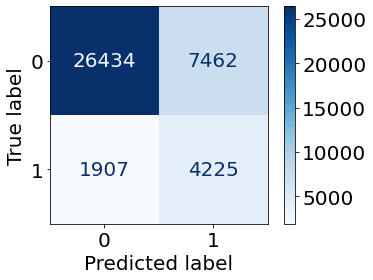

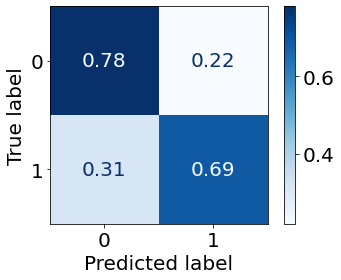

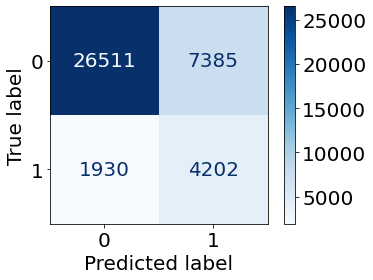

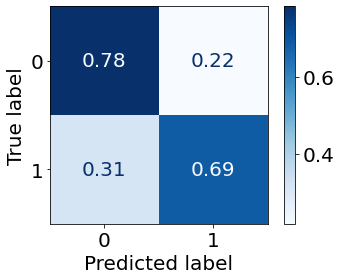

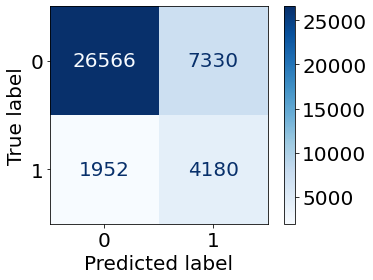

...

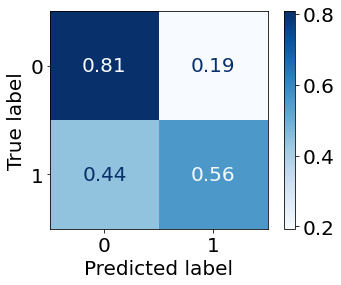

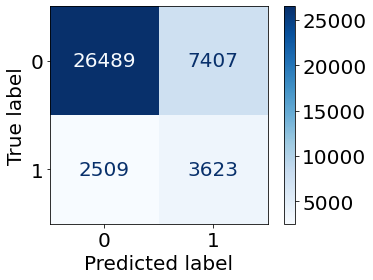

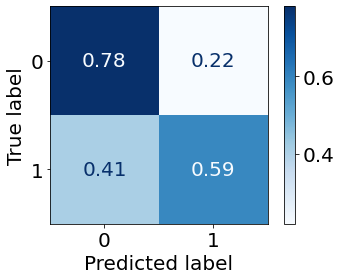

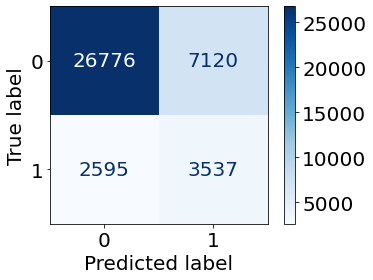

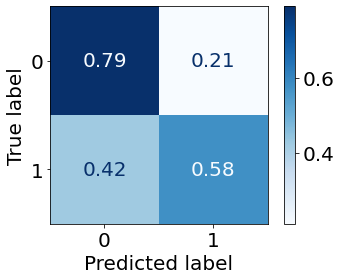

In [15]:
for n in range(1, 30):
    df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 5, n=n)

    X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2021_DP = df_train_2021_DP['Diabetes']
    print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

    train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                         X_validation_2021, y_validation_2021, 
                         X_validation_2021, y_validation_2021,
                         "2021", "Age-40_44-DP-" + str(n), "1", df_validation_2021,
                        save_dir = "Performance/Age_40_44-Validation-Set-Performance-LR-Trial-2/")

In [16]:
import os
import pandas as pd

# Specify the directory containing CSV files
directory_path = 'Performance/Age_40_44-Validation-Set-Performance-LR-Trial-2/'

# Get a list of all CSV files in the directory
csv_files = [file for file in os.listdir(directory_path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(directory_path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "40-44"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "40-44"]["Class 1 AU_PRC"].to_list()[0]
    
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv("Performance/Age_40_44-Validation-Set-Performance-LR-Trial-2/ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
26,2021 Age-40_44-DP-27.csv,0.787202,0.320111
21,2021 Age-40_44-DP-22.csv,0.785596,0.320654
19,2021 Age-40_44-DP-20.csv,0.784908,0.320574
20,2021 Age-40_44-DP-21.csv,0.784319,0.320634
28,2021 Age-40_44-DP-29.csv,0.784168,0.320165
23,2021 Age-40_44-DP-24.csv,0.783660,0.320508
12,2021 Age-40_44-DP-13.csv,0.783641,0.321094
27,2021 Age-40_44-DP-28.csv,0.783240,0.320021
24,2021 Age-40_44-DP-25.csv,0.783080,0.319992
18,2021 Age-40_44-DP-19.csv,0.783025,0.321666


Original training dataset:  (120081, 50)
Class 1:  (18438, 50)
Class 0:  (101643, 50)
5  group class 1:  (647, 50)
5  group class 1:  (14234, 50)  # of DP units 22
New training set:  (134315, 50)
(134315, 48) (120081, 48) (40027, 48)
accuracy 0.7541409548554725
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.84     33757
         1.0       0.34      0.63      0.45      6270

    accuracy                           0.75     40027
   macro avg       0.63      0.70      0.64     40027
weighted avg       0.83      0.75      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.630622009569378
Class 1 Precision: 0.34445509190696055
Class 1 Area Under Precision-Recall Curve: 0.3967550507348444
Class 1 F1-Score: 0.4455462279565046
Class 0 Recall: 0.7770832716177385
Class 0 Precision: 0.9188734762505254
Class 0 Area Under Precision-Recall Curve: 0.7303473520940705
Class 0 F1-Score: 0.842

============================  Hispanic ============================ 
Class 1 Recall: 0.7751479289940828
Class 1 Precision: 0.31389776357827476
Class 1 Area Under Precision-Recall Curve: 0.4291892026778022
Class 1 F1-Score: 0.44684479818078454
Class 0 Recall: 0.6209179170344219
Class 0 Precision: 0.9250493096646942
Class 0 Area Under Precision-Recall Curve: 0.6946786389799139
Class 0 F1-Score: 0.7430683918669132
Overall Accuracy: 0.6491164803461954
Balanced Accuracy: 0.6980329230142523
Area Under ROC Curve: 0.761839106872714
Matthews Correlation Coefficient: 0.30763415727128157
0.7751479289940828
0.31389776357827476
0.4291892026778022
0.44684479818078454
0.6209179170344219
0.9250493096646942
0.6946786389799139
0.7430683918669132
0.6491164803461954
0.6980329230142523
0.761839106872714
0.30763415727128157
============================  30-34 ============================ 
Class 1 Recall: 0.8082191780821918
Class 1 Precision: 0.09190031152647975
Class 1 Area Under Precision-Recall Curve: 0.1

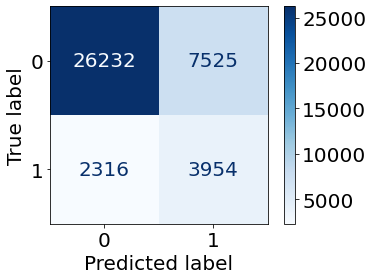

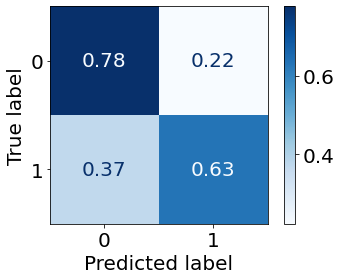

In [17]:
n = 22
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 5, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-40_44-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_40_44-Test-Set-Performance-LR-Trial-2/")

Same training set:  (120081, 50)
(120081, 48) (120081, 48) (40027, 48)
accuracy 0.7481450021235666
              precision    recall  f1-score   support

         0.0       0.94      0.75      0.83     33757
         1.0       0.35      0.74      0.48      6270

    accuracy                           0.75     40027
   macro avg       0.65      0.74      0.66     40027
weighted avg       0.85      0.75      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.7382775119617225
Class 1 Precision: 0.35419695462544953
Class 1 Area Under Precision-Recall Curve: 0.4542341707324573
Class 1 F1-Score: 0.4787217539686643
Class 0 Recall: 0.7499777823858755
Class 0 Precision: 0.9391275317160027
Class 0 Area Under Precision-Recall Curve: 0.7149621303071116
Class 0 F1-Score: 0.8339619533887836
Overall Accuracy: 0.7481450021235666
Balanced Accuracy: 0.744127647173799
Area Under ROC Curve: 0.823999896719395
Matthews Correlation Coefficient: 

Class 1 Recall: 0.7731755424063116
Class 1 Precision: 0.3904382470119522
Class 1 Area Under Precision-Recall Curve: 0.4970897048864892
Class 1 F1-Score: 0.5188616810059562
Class 0 Recall: 0.7299205648720212
Class 0 Precision: 0.9349915206331261
Class 0 Area Under Precision-Recall Curve: 0.6732160162136633
Class 0 F1-Score: 0.8198265179677819
Overall Accuracy: 0.7378290659935088
Balanced Accuracy: 0.7515480536391663
Area Under ROC Curve: 0.8253462992073897
Matthews Correlation Coefficient: 0.4046263082088598
0.7731755424063116
0.3904382470119522
0.4970897048864892
0.5188616810059562
0.7299205648720212
0.9349915206331261
0.6732160162136633
0.8198265179677819
0.7378290659935088
0.7515480536391663
0.8253462992073897
0.4046263082088598
============================  30-34 ============================ 
Class 1 Recall: 0.2876712328767123
Class 1 Precision: 0.1891891891891892
Class 1 Area Under Precision-Recall Curve: 0.1857480552065409
Class 1 F1-Score: 0.2282608695652174
Class 0 Recall: 0.957

Class 1 Recall: 0.7894736842105263
Class 1 Precision: 0.28010302640051515
Class 1 Area Under Precision-Recall Curve: 0.42853639305741204
Class 1 F1-Score: 0.4134980988593156
Class 0 Recall: 0.4982046678635548
Class 0 Precision: 0.9053833605220228
Class 0 Area Under Precision-Recall Curve: 0.6842619179426023
Class 0 F1-Score: 0.6427330631152287
Overall Accuracy: 0.5559553796329615
Balanced Accuracy: 0.6438391760370406
Area Under ROC Curve: 0.7352202784556885
Matthews Correlation Coefficient: 0.23099874052048663
0.7894736842105263
0.28010302640051515
0.42853639305741204
0.4134980988593156
0.4982046678635548
0.9053833605220228
0.6842619179426023
0.6427330631152287
0.5559553796329615
0.6438391760370406
0.7352202784556885
0.23099874052048663


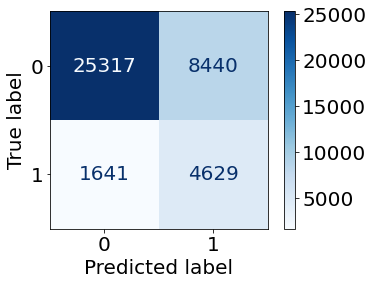

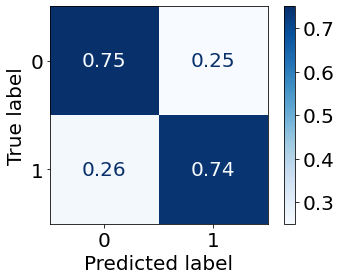

In [57]:
n = 0
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 5, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-40_44-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_40_44-Test-Set-Performance-LR-Trial-2/")

## Trail 3

In [58]:
random_state = 3
df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)


(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)


(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (630, 50)  # of DP units 1
New training set:  (120711, 50)
(120711, 48) (120081, 48) (40027, 48)
accuracy 0.772834016188668
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     33965
         1.0       0.37      0.69      0.48      6063

    accuracy                           0.77     40028
   macro avg       0.65      0.74      0.67     40028
weighted avg       0.85      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6905822200230909
Class 1 Precision: 0.3671518765345493
Class 1 Area Under Precision-Recall Curve: 0.43948451129727956
Class 1 F1-Score: 0.4794183317112269
Class 0 Recall: 0.7875165611659061
Class 0 Precision: 0.934460592509782
Cl

Class 1 Recall: 0.7588235294117647
Class 1 Precision: 0.4022869022869023
Class 1 Area Under Precision-Recall Curve: 0.5205453754221752
Class 1 F1-Score: 0.5258152173913044
Class 0 Recall: 0.7462488967343336
Class 0 Precision: 0.9321940463065049
Class 0 Area Under Precision-Recall Curve: 0.6682622279904146
Class 0 F1-Score: 0.8289215686274509
Overall Accuracy: 0.7485590778097982
Balanced Accuracy: 0.7525362130730491
Area Under ROC Curve: 0.8317385736289221
Matthews Correlation Coefficient: 0.4110195910242243
0.7588235294117647
0.4022869022869023
0.5205453754221752
0.5258152173913044
0.7462488967343336
0.9321940463065049
0.6682622279904146
0.8289215686274509
0.7485590778097982
0.7525362130730491
0.8317385736289221
0.4110195910242243
============================  30-34 ============================ 
Class 1 Recall: 0.2786885245901639
Class 1 Precision: 0.1574074074074074
Class 1 Area Under Precision-Recall Curve: 0.16058400933385086
Class 1 F1-Score: 0.20118343195266272
Class 0 Recall: 0.9

Class 1 Recall: 0.7346938775510204
Class 1 Precision: 0.2918201915991157
Class 1 Area Under Precision-Recall Curve: 0.37686315753529115
Class 1 F1-Score: 0.4177215189873418
Class 0 Recall: 0.5740248226950354
Class 0 Precision: 0.9005563282336578
Class 0 Area Under Precision-Recall Curve: 0.7010402947451124
Class 0 F1-Score: 0.7011369788846777
Overall Accuracy: 0.6050089445438283
Balanced Accuracy: 0.6543593501230279
Area Under ROC Curve: 0.7210008519848945
Matthews Correlation Coefficient: 0.24370110619493182
0.7346938775510204
0.2918201915991157
0.37686315753529115
0.4177215189873418
0.5740248226950354
0.9005563282336578
0.7010402947451124
0.7011369788846777
0.6050089445438283
0.6543593501230279
0.7210008519848945
0.24370110619493182
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (1260, 50)  # of DP units 2
New training set:  (121341, 50)
(121341, 48) (120081, 48) (40027, 48)
accuracy 0.773783351653

Class 1 Recall: 0.7647058823529411
Class 1 Precision: 0.3971486761710794
Class 1 Area Under Precision-Recall Curve: 0.5200619651342719
Class 1 F1-Score: 0.5227882037533512
Class 0 Recall: 0.7387466902030009
Class 0 Precision: 0.9331103678929766
Class 0 Area Under Precision-Recall Curve: 0.6685665533023211
Class 0 F1-Score: 0.8246305418719212
Overall Accuracy: 0.7435158501440923
Balanced Accuracy: 0.751726286277971
Area Under ROC Curve: 0.8298106709585864
Matthews Correlation Coefficient: 0.40776189785696654
0.7647058823529411
0.3971486761710794
0.5200619651342719
0.5227882037533512
0.7387466902030009
0.9331103678929766
0.6685665533023211
0.8246305418719212
0.7435158501440923
0.751726286277971
0.8298106709585864
0.40776189785696654
============================  30-34 ============================ 
Class 1 Recall: 0.32786885245901637
Class 1 Precision: 0.15267175572519084
Class 1 Area Under Precision-Recall Curve: 0.16006997237877627
Class 1 F1-Score: 0.20833333333333334
Class 0 Recall: 0

Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (1890, 50)  # of DP units 3
New training set:  (121971, 50)
(121971, 48) (120081, 48) (40027, 48)
accuracy 0.7722094533826321
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     33965
         1.0       0.37      0.68      0.48      6063

    accuracy                           0.77     40028
   macro avg       0.65      0.74      0.67     40028
weighted avg       0.85      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6821705426356589
Class 1 Precision: 0.3651452282157676
Class 1 Area Under Precision-Recall Curve: 0.44025479734208406
Class 1 F1-Score: 0.47567567567567565
Class 0 Recall: 0.788282055056676
Class 0 Precision: 0.9328594822480053
Class 0 Area Under Precision-Recall Curve: 0.7237775856677773
Class 0 F1-Score: 0.8544984521111926
Overall Accuracy: 0.77220945

Class 1 Recall: 0.7745098039215687
Class 1 Precision: 0.3914767096134787
Class 1 Area Under Precision-Recall Curve: 0.517639494384415
Class 1 F1-Score: 0.5200789993416721
Class 0 Recall: 0.7290379523389232
Class 0 Precision: 0.9349179400113187
Class 0 Area Under Precision-Recall Curve: 0.6692708286863744
Class 0 F1-Score: 0.8192412596082321
Overall Accuracy: 0.7373919308357348
Balanced Accuracy: 0.7517738781302459
Area Under ROC Curve: 0.8274553069241819
Matthews Correlation Coefficient: 0.40540756464821426
0.7745098039215687
0.3914767096134787
0.517639494384415
0.5200789993416721
0.7290379523389232
0.9349179400113187
0.6692708286863744
0.8192412596082321
0.7373919308357348
0.7517738781302459
0.8274553069241819
0.40540756464821426
============================  30-34 ============================ 
Class 1 Recall: 0.39344262295081966
Class 1 Precision: 0.15483870967741936
Class 1 Area Under Precision-Recall Curve: 0.1599226563568894
Class 1 F1-Score: 0.22222222222222224
Class 0 Recall: 0.

Area Under ROC Curve: 0.7580862504115
Matthews Correlation Coefficient: 0.3214925722419275
0.7161198288159771
0.39280125195618154
0.47881542356649437
0.5073269327943405
0.6589010989010989
0.8828032979976443
0.6326154774647356
0.7545935061666248
0.6723790322580645
0.6875104638585381
0.7580862504115
0.3214925722419275
============================  80-99 ============================ 
Class 1 Recall: 0.699443413729128
Class 1 Precision: 0.31338320864505403
Class 1 Area Under Precision-Recall Curve: 0.3751445598561988
Class 1 F1-Score: 0.4328358208955224
Class 0 Recall: 0.6338652482269503
Class 0 Precision: 0.8982412060301508
Class 0 Area Under Precision-Recall Curve: 0.7015537563091866
Class 0 F1-Score: 0.7432432432432433
Overall Accuracy: 0.6465116279069767
Balanced Accuracy: 0.6666543309780392
Area Under ROC Curve: 0.7206316037053119
Matthews Correlation Coefficient: 0.2655866158010053
0.699443413729128
0.31338320864505403
0.3751445598561988
0.4328358208955224
0.6338652482269503
0.898241

============================  Hispanic ============================ 
Class 1 Recall: 0.7764705882352941
Class 1 Precision: 0.375
Class 1 Area Under Precision-Recall Curve: 0.5144725017760521
Class 1 F1-Score: 0.5057471264367817
Class 0 Recall: 0.7087378640776699
Class 0 Precision: 0.9337209302325581
Class 0 Area Under Precision-Recall Curve: 0.670117947433547
Class 0 F1-Score: 0.8058203712995484
Overall Accuracy: 0.7211815561959655
Balanced Accuracy: 0.742604226156482
Area Under ROC Curve: 0.824855926483568
Matthews Correlation Coefficient: 0.38703230453640186
0.7764705882352941
0.375
0.5144725017760521
0.5057471264367817
0.7087378640776699
0.9337209302325581
0.670117947433547
0.8058203712995484
0.7211815561959655
0.742604226156482
0.824855926483568
0.38703230453640186
============================  30-34 ============================ 
Class 1 Recall: 0.45901639344262296
Class 1 Precision: 0.1497326203208556
Class 1 Area Under Precision-Recall Curve: 0.15960611025995916
Class 1 F1-Score:

Class 1 Recall: 0.6846011131725418
Class 1 Precision: 0.31810344827586207
Class 1 Area Under Precision-Recall Curve: 0.37519470041464076
Class 1 F1-Score: 0.4343731606827546
Class 0 Recall: 0.6493794326241135
Class 0 Precision: 0.8960244648318043
Class 0 Area Under Precision-Recall Curve: 0.7015823906594489
Class 0 F1-Score: 0.7530197892572602
Overall Accuracy: 0.6561717352415026
Balanced Accuracy: 0.6669902728983277
Area Under ROC Curve: 0.7203774885195857
Matthews Correlation Coefficient: 0.2674220583459733
0.6846011131725418
0.31810344827586207
0.37519470041464076
0.4343731606827546
0.6493794326241135
0.8960244648318043
0.7015823906594489
0.7530197892572602
0.6561717352415026
0.6669902728983277
0.7203774885195857
0.2674220583459733
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (3150, 50)  # of DP units 5
New training set:  (123231, 50)
(123231, 48) (120081, 48) (40027, 48)
accuracy 0.786624362945

Class 1 Recall: 0.7450980392156863
Class 1 Precision: 0.3889457523029683
Class 1 Area Under Precision-Recall Curve: 0.511096807335288
Class 1 F1-Score: 0.5110961667787493
Class 0 Recall: 0.7365401588702559
Class 0 Precision: 0.9277376320177877
Class 0 Area Under Precision-Recall Curve: 0.6710149498492016
Class 0 F1-Score: 0.8211562115621155
Overall Accuracy: 0.7381123919308358
Balanced Accuracy: 0.740819099042971
Area Under ROC Curve: 0.8221077133412942
Matthews Correlation Coefficient: 0.3905468148481137
0.7450980392156863
0.3889457523029683
0.511096807335288
0.5110961667787493
0.7365401588702559
0.9277376320177877
0.6710149498492016
0.8211562115621155
0.7381123919308358
0.740819099042971
0.8221077133412942
0.3905468148481137
============================  30-34 ============================ 
Class 1 Recall: 0.4262295081967213
Class 1 Precision: 0.14689265536723164
Class 1 Area Under Precision-Recall Curve: 0.15942253072505239
Class 1 F1-Score: 0.2184873949579832
Class 0 Recall: 0.92887

Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (3780, 50)  # of DP units 6
New training set:  (123861, 50)
(123861, 48) (120081, 48) (40027, 48)
accuracy 0.7905466173678425
              precision    recall  f1-score   support

         0.0       0.93      0.82      0.87     33965
         1.0       0.38      0.63      0.48      6063

    accuracy                           0.79     40028
   macro avg       0.65      0.72      0.67     40028
weighted avg       0.84      0.79      0.81     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6277420418934521
Class 1 Precision: 0.3831672203765227
Class 1 Area Under Precision-Recall Curve: 0.43397193627591446
Class 1 F1-Score: 0.47586896724181044
Class 0 Recall: 0.8196084204327985
Class 0 Precision: 0.9250041535138728
Class 0 Area Under Precision-Recall Curve: 0.7254878522929725
Class 0 F1-Score: 0.8691226974711208
Overall Accuracy: 0.7905466

Class 1 Recall: 0.7431372549019608
Class 1 Precision: 0.389917695473251
Class 1 Area Under Precision-Recall Curve: 0.5075014440559042
Class 1 F1-Score: 0.5114709851551956
Class 0 Recall: 0.7383053839364518
Class 0 Precision: 0.9273835920177383
Class 0 Area Under Precision-Recall Curve: 0.6719617198091282
Class 0 F1-Score: 0.8221130221130221
Overall Accuracy: 0.739193083573487
Balanced Accuracy: 0.7407213194192064
Area Under ROC Curve: 0.8193041205891006
Matthews Correlation Coefficient: 0.3908482687136886
0.7431372549019608
0.389917695473251
0.5075014440559042
0.5114709851551956
0.7383053839364518
0.9273835920177383
0.6719617198091282
0.8221130221130221
0.739193083573487
0.7407213194192064
0.8193041205891006
0.3908482687136886
============================  30-34 ============================ 
Class 1 Recall: 0.45901639344262296
Class 1 Precision: 0.14507772020725387
Class 1 Area Under Precision-Recall Curve: 0.1596686593460093
Class 1 F1-Score: 0.22047244094488186
Class 0 Recall: 0.9222

Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (4410, 50)  # of DP units 7
New training set:  (124491, 50)
(124491, 48) (120081, 48) (40027, 48)
accuracy 0.7880483661436994
              precision    recall  f1-score   support

         0.0       0.92      0.82      0.87     33965
         1.0       0.38      0.63      0.47      6063

    accuracy                           0.79     40028
   macro avg       0.65      0.72      0.67     40028
weighted avg       0.84      0.79      0.81     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6277420418934521
Class 1 Precision: 0.3793481511013655
Class 1 Area Under Precision-Recall Curve: 0.4304825510921119
Class 1 F1-Score: 0.47291252485089463
Class 0 Recall: 0.8166642131606066
Class 0 Precision: 0.9247541256876146
Class 0 Area Under Precision-Recall Curve: 0.7268247017320393
Class 0 F1-Score: 0.8673545966228894
Overall Accuracy: 0.78804836

Class 1 Recall: 0.7470588235294118
Class 1 Precision: 0.3829145728643216
Class 1 Area Under Precision-Recall Curve: 0.5026541621140334
Class 1 F1-Score: 0.506312292358804
Class 0 Recall: 0.7290379523389232
Class 0 Precision: 0.9275687815833801
Class 0 Area Under Precision-Recall Curve: 0.6730260440938085
Class 0 F1-Score: 0.8164072152211514
Overall Accuracy: 0.7323487031700289
Balanced Accuracy: 0.7380483879341675
Area Under ROC Curve: 0.8164503400654172
Matthews Correlation Coefficient: 0.3844738274750783
0.7470588235294118
0.3829145728643216
0.5026541621140334
0.506312292358804
0.7290379523389232
0.9275687815833801
0.6730260440938085
0.8164072152211514
0.7323487031700289
0.7380483879341675
0.8164503400654172
0.3844738274750783
============================  30-34 ============================ 
Class 1 Recall: 0.5081967213114754
Class 1 Precision: 0.13839285714285715
Class 1 Area Under Precision-Recall Curve: 0.15957056481357865
Class 1 F1-Score: 0.21754385964912282
Class 0 Recall: 0.90

============================  80-99 ============================ 
Class 1 Recall: 0.5844155844155844
Class 1 Precision: 0.35195530726256985
Class 1 Area Under Precision-Recall Curve: 0.37491489898054486
Class 1 F1-Score: 0.4393305439330544
Class 0 Recall: 0.7429078014184397
Class 0 Precision: 0.8821052631578947
Class 0 Area Under Precision-Recall Curve: 0.7017495867342748
Class 0 F1-Score: 0.8065447545717035
Overall Accuracy: 0.7123434704830054
Balanced Accuracy: 0.663661692917012
Area Under ROC Curve: 0.7199630093817023
Matthews Correlation Coefficient: 0.27679143483906704
0.5844155844155844
0.35195530726256985
0.37491489898054486
0.4393305439330544
0.7429078014184397
0.8821052631578947
0.7017495867342748
0.8065447545717035
0.7123434704830054
0.663661692917012
0.7199630093817023
0.27679143483906704
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (5040, 50)  # of DP units 8
New training set:  (125121,

Class 1 Recall: 0.7549019607843137
Class 1 Precision: 0.3694817658349328
Class 1 Area Under Precision-Recall Curve: 0.4976984518457215
Class 1 F1-Score: 0.4961340206185567
Class 0 Recall: 0.7100617828773168
Class 0 Precision: 0.9279123414071511
Class 0 Area Under Precision-Recall Curve: 0.6741861233230606
Class 0 F1-Score: 0.8045
Overall Accuracy: 0.718299711815562
Balanced Accuracy: 0.7324818718308153
Area Under ROC Curve: 0.8133136043472994
Matthews Correlation Coefficient: 0.3718567969611256
0.7549019607843137
0.3694817658349328
0.4976984518457215
0.4961340206185567
0.7100617828773168
0.9279123414071511
0.6741861233230606
0.8045
0.718299711815562
0.7324818718308153
0.8133136043472994
0.3718567969611256
============================  30-34 ============================ 
Class 1 Recall: 0.5081967213114754
Class 1 Precision: 0.11610486891385768
Class 1 Area Under Precision-Recall Curve: 0.160014852248028
Class 1 F1-Score: 0.18902439024390247
Class 0 Recall: 0.8888365520489873
Class 0 Pre

Class 1 Recall: 0.5844155844155844
Class 1 Precision: 0.3567383918459796
Class 1 Area Under Precision-Recall Curve: 0.37470569319668506
Class 1 F1-Score: 0.44303797468354433
Class 0 Recall: 0.74822695035461
Class 0 Precision: 0.8828451882845189
Class 0 Area Under Precision-Recall Curve: 0.7018413101948671
Class 0 F1-Score: 0.8099808061420346
Overall Accuracy: 0.7166368515205724
Balanced Accuracy: 0.6663212673850971
Area Under ROC Curve: 0.7197911321201594
Matthews Correlation Coefficient: 0.2823042496738704
0.5844155844155844
0.3567383918459796
0.37470569319668506
0.44303797468354433
0.74822695035461
0.8828451882845189
0.7018413101948671
0.8099808061420346
0.7166368515205724
0.6663212673850971
0.7197911321201594
0.2823042496738704
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (5670, 50)  # of DP units 9
New training set:  (125751, 50)
(125751, 48) (120081, 48) (40027, 48)
accuracy 0.7755820925352254

Class 1 Recall: 0.7666666666666667
Class 1 Precision: 0.3590449954086318
Class 1 Area Under Precision-Recall Curve: 0.49293408778805414
Class 1 F1-Score: 0.48905565978736715
Class 0 Recall: 0.6919682259488085
Class 0 Precision: 0.9294605809128631
Class 0 Area Under Precision-Recall Curve: 0.6753569321739011
Class 0 F1-Score: 0.7933215279534531
Overall Accuracy: 0.7056916426512968
Balanced Accuracy: 0.7293174463077376
Area Under ROC Curve: 0.8101985012893066
Matthews Correlation Coefficient: 0.36375640752456107
0.7666666666666667
0.3590449954086318
0.49293408778805414
0.48905565978736715
0.6919682259488085
0.9294605809128631
0.6753569321739011
0.7933215279534531
0.7056916426512968
0.7293174463077376
0.8101985012893066
0.36375640752456107
============================  30-34 ============================ 
Class 1 Recall: 0.5573770491803278
Class 1 Precision: 0.11221122112211221
Class 1 Area Under Precision-Recall Curve: 0.1599693588892144
Class 1 F1-Score: 0.1868131868131868
Class 0 Recall

Class 1 Recall: 0.5788497217068646
Class 1 Precision: 0.3577981651376147
Class 1 Area Under Precision-Recall Curve: 0.3744047041778718
Class 1 F1-Score: 0.44223954642097807
Class 0 Recall: 0.75177304964539
Class 0 Precision: 0.8819552782111284
Class 0 Area Under Precision-Recall Curve: 0.7019463500247134
Class 0 F1-Score: 0.8116774347930127
Overall Accuracy: 0.7184257602862254
Balanced Accuracy: 0.6653113856761272
Area Under ROC Curve: 0.7196291234095187
Matthews Correlation Coefficient: 0.28154564084923644
0.5788497217068646
0.3577981651376147
0.3744047041778718
0.44223954642097807
0.75177304964539
0.8819552782111284
0.7019463500247134
0.8116774347930127
0.7184257602862254
0.6653113856761272
0.7196291234095187
0.28154564084923644
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (6300, 50)  # of DP units 10
New training set:  (126381, 50)
(126381, 48) (120081, 48) (40027, 48)
accuracy 0.780378734885580

Class 1 Recall: 0.7588235294117647
Class 1 Precision: 0.3586654309545876
Class 1 Area Under Precision-Recall Curve: 0.48905501165386417
Class 1 F1-Score: 0.48709880427942104
Class 0 Recall: 0.6946160635481023
Class 0 Precision: 0.9275191514437242
Class 0 Area Under Precision-Recall Curve: 0.6763810162404771
Class 0 F1-Score: 0.7943477163764824
Overall Accuracy: 0.7064121037463977
Balanced Accuracy: 0.7267197964799335
Area Under ROC Curve: 0.8072616513507433
Matthews Correlation Coefficient: 0.36023245349923716
0.7588235294117647
0.3586654309545876
0.48905501165386417
0.48709880427942104
0.6946160635481023
0.9275191514437242
0.6763810162404771
0.7943477163764824
0.7064121037463977
0.7267197964799335
0.8072616513507433
0.36023245349923716
============================  30-34 ============================ 
Class 1 Recall: 0.5901639344262295
Class 1 Precision: 0.1157556270096463
Class 1 Area Under Precision-Recall Curve: 0.16002089004625297
Class 1 F1-Score: 0.1935483870967742
Class 0 Recall

Class 1 Recall: 0.5547309833024119
Class 1 Precision: 0.3686806411837238
Class 1 Area Under Precision-Recall Curve: 0.3741680865684486
Class 1 F1-Score: 0.442962962962963
Class 0 Recall: 0.7730496453900709
Class 0 Precision: 0.8790322580645161
Class 0 Area Under Precision-Recall Curve: 0.7020390083455904
Class 0 F1-Score: 0.8226415094339623
Overall Accuracy: 0.730948121645796
Balanced Accuracy: 0.6638903143462414
Area Under ROC Curve: 0.7193865215331782
Matthews Correlation Coefficient: 0.28494822310522616
0.5547309833024119
0.3686806411837238
0.3741680865684486
0.442962962962963
0.7730496453900709
0.8790322580645161
0.7020390083455904
0.8226415094339623
0.730948121645796
0.6638903143462414
0.7193865215331782
0.28494822310522616
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (6930, 50)  # of DP units 11
New training set:  (127011, 50)
(127011, 48) (120081, 48) (40027, 48)
accuracy 0.7714100129909064


/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_plot/confusion_matrix.py:114: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


============================  Over all performance ============================ 
Class 1 Recall: 0.6429160481609764
Class 1 Precision: 0.3581732978039144
Class 1 Area Under Precision-Recall Curve: 0.4199220979759345
Class 1 F1-Score: 0.4600495692198749
Class 0 Recall: 0.7943471220373914
Class 0 Precision: 0.9257162463544347
Class 0 Area Under Precision-Recall Curve: 0.7298411010094163
Class 0 F1-Score: 0.8550150530819205
Overall Accuracy: 0.7714100129909064
Balanced Accuracy: 0.7186315850991839
Area Under ROC Curve: 0.8043680396030113
Matthews Correlation Coefficient: 0.35232718042303984
0.6429160481609764
0.3581732978039144
0.4199220979759345
0.4600495692198749
0.7943471220373914
0.9257162463544347
0.7298411010094163
0.8550150530819205
0.7714100129909064
0.7186315850991839
0.8043680396030113
0.35232718042303984
============================  Male ============================ 
Class 1 Recall: 0.6498067010309279
Class 1 Precision: 0.34962731842607037
Class 1 Area Under Precision-Recall C

Class 1 Recall: 0.6229508196721312
Class 1 Precision: 0.10888252148997135
Class 1 Area Under Precision-Recall Curve: 0.16281163369795873
Class 1 F1-Score: 0.18536585365853658
Class 0 Recall: 0.8535091851154027
Class 0 Precision: 0.987465940054496
Class 0 Area Under Precision-Recall Curve: 0.9331247009635674
Class 0 F1-Score: 0.9156139464375948
Overall Accuracy: 0.8470695970695971
Balanced Accuracy: 0.7382300023937669
Area Under ROC Curve: 0.8289267430098145
Matthews Correlation Coefficient: 0.2142572949720695
0.6229508196721312
0.10888252148997135
0.16281163369795873
0.18536585365853658
0.8535091851154027
0.987465940054496
0.9331247009635674
0.9156139464375948
0.8470695970695971
0.7382300023937669
0.8289267430098145
0.2142572949720695
============================  35-39 ============================ 
Class 1 Recall: 0.6612903225806451
Class 1 Precision: 0.1607843137254902
Class 1 Area Under Precision-Recall Curve: 0.27531822479767076
Class 1 F1-Score: 0.2586750788643533
Class 0 Recall: 

Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (7560, 50)  # of DP units 12
New training set:  (127641, 50)
(127641, 48) (120081, 48) (40027, 48)
accuracy 0.7736084740681523
              precision    recall  f1-score   support

         0.0       0.92      0.80      0.86     33965
         1.0       0.36      0.63      0.46      6063

    accuracy                           0.77     40028
   macro avg       0.64      0.72      0.66     40028
weighted avg       0.84      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6328550222662048
Class 1 Precision: 0.3595052937318467
Class 1 Area Under Precision-Recall Curve: 0.4176076510197902
Class 1 F1-Score: 0.4585325047801147
Class 0 Recall: 0.7987339908729575
Class 0 Precision: 0.9241696474195197
Class 0 Area Under Precision-Recall Curve: 0.729530035808723
Class 0 F1-Score: 0.8568856601389766
Overall Accuracy: 0.7736084740681523
Balanced Accur

Class 1 Recall: 0.7627450980392156
Class 1 Precision: 0.340630472854641
Class 1 Area Under Precision-Recall Curve: 0.4807623538333803
Class 1 F1-Score: 0.4709443099273608
Class 0 Recall: 0.6676963812886143
Class 0 Precision: 0.9259485924112607
Class 0 Area Under Precision-Recall Curve: 0.6785363222967418
Class 0 F1-Score: 0.7758974358974359
Overall Accuracy: 0.6851585014409222
Balanced Accuracy: 0.715220739663915
Area Under ROC Curve: 0.8012417146911721
Matthews Correlation Coefficient: 0.3387428039248728
0.7627450980392156
0.340630472854641
0.4807623538333803
0.4709443099273608
0.6676963812886143
0.9259485924112607
0.6785363222967418
0.7758974358974359
0.6851585014409222
0.715220739663915
0.8012417146911721
0.3387428039248728
============================  30-34 ============================ 
Class 1 Recall: 0.639344262295082
Class 1 Precision: 0.10684931506849316
Class 1 Area Under Precision-Recall Curve: 0.16215585469413105
Class 1 F1-Score: 0.18309859154929578
Class 0 Recall: 0.84644

New training set:  (128271, 50)
(128271, 48) (120081, 48) (40027, 48)
accuracy 0.7738582991905666
              precision    recall  f1-score   support

         0.0       0.92      0.80      0.86     33965
         1.0       0.36      0.63      0.46      6063

    accuracy                           0.77     40028
   macro avg       0.64      0.71      0.66     40028
weighted avg       0.84      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6275771070427181
Class 1 Precision: 0.35899613171053874
Class 1 Area Under Precision-Recall Curve: 0.41349921959443753
Class 1 F1-Score: 0.45672788380746604
Class 0 Recall: 0.7999705579272781
Class 0 Precision: 0.923272962044242
Class 0 Area Under Precision-Recall Curve: 0.7305284309315563
Class 0 F1-Score: 0.8572104615578762
Overall Accuracy: 0.7738582991905666
Balanced Accuracy: 0.713773832484998
Area Under ROC Curve: 0.7998482735341916
Matthews Correlation Coefficient:

Class 1 Recall: 0.7607843137254902
Class 1 Precision: 0.33797909407665505
Class 1 Area Under Precision-Recall Curve: 0.4758539455384547
Class 1 F1-Score: 0.46803377563329307
Class 0 Recall: 0.6646072374227714
Class 0 Precision: 0.9250614250614251
Class 0 Area Under Precision-Recall Curve: 0.6797206105163871
Class 0 F1-Score: 0.773497688751926
Overall Accuracy: 0.6822766570605188
Balanced Accuracy: 0.7126957755741308
Area Under ROC Curve: 0.798276309641244
Matthews Correlation Coefficient: 0.3345074206217134
0.7607843137254902
0.33797909407665505
0.4758539455384547
0.46803377563329307
0.6646072374227714
0.9250614250614251
0.6797206105163871
0.773497688751926
0.6822766570605188
0.7126957755741308
0.798276309641244
0.3345074206217134
============================  30-34 ============================ 
Class 1 Recall: 0.6721311475409836
Class 1 Precision: 0.1056701030927835
Class 1 Area Under Precision-Recall Curve: 0.167501370500399
Class 1 F1-Score: 0.18262806236080179
Class 0 Recall: 0.836

Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (8820, 50)  # of DP units 14
New training set:  (128901, 50)
(128901, 48) (120081, 48) (40027, 48)
accuracy 0.7724842610172878
              precision    recall  f1-score   support

         0.0       0.92      0.80      0.86     33965
         1.0       0.36      0.63      0.45      6063

    accuracy                           0.77     40028
   macro avg       0.64      0.71      0.66     40028
weighted avg       0.84      0.77      0.80     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6264225630875804
Class 1 Precision: 0.35695488721804514
Class 1 Area Under Precision-Recall Curve: 0.4100361328968962
Class 1 F1-Score: 0.45476860444231576
Class 0 Recall: 0.7985573384366259
Class 0 Precision: 0.9229277256022866
Class 0 Area Under Precision-Recall Curve: 0.731769492728835
Class 0 F1-Score: 0.856249901346424
Overall Accuracy: 0.7724842610172878
Balanced Accu

Class 1 Recall: 0.7627450980392156
Class 1 Precision: 0.3367965367965368
Class 1 Area Under Precision-Recall Curve: 0.47177794826728475
Class 1 F1-Score: 0.46726726726726725
Class 0 Recall: 0.6619593998234775
Class 0 Precision: 0.9253547193090684
Class 0 Area Under Precision-Recall Curve: 0.6807922592615971
Class 0 F1-Score: 0.7718034473887317
Overall Accuracy: 0.6804755043227666
Balanced Accuracy: 0.7123522489313465
Area Under ROC Curve: 0.7953463821539207
Matthews Correlation Coefficient: 0.3336717212896612
0.7627450980392156
0.3367965367965368
0.47177794826728475
0.46726726726726725
0.6619593998234775
0.9253547193090684
0.6807922592615971
0.7718034473887317
0.6804755043227666
0.7123522489313465
0.7953463821539207
0.3336717212896612
============================  30-34 ============================ 
Class 1 Recall: 0.6885245901639344
Class 1 Precision: 0.1016949152542373
Class 1 Area Under Precision-Recall Curve: 0.16749110342772922
Class 1 F1-Score: 0.17721518987341772
Class 0 Recall:

Class 1 Recall: 0.5009276437847866
Class 1 Precision: 0.37604456824512533
Class 1 Area Under Precision-Recall Curve: 0.3739109796182829
Class 1 F1-Score: 0.4295942720763723
Class 0 Recall: 0.8014184397163121
Class 0 Precision: 0.8704862782859895
Class 0 Area Under Precision-Recall Curve: 0.7021944267541378
Class 0 F1-Score: 0.8345257327486729
Overall Accuracy: 0.7434704830053668
Balanced Accuracy: 0.6511730417505494
Area Under ROC Curve: 0.7187976979960263
Matthews Correlation Coefficient: 0.2730158162284613
0.5009276437847866
0.37604456824512533
0.3739109796182829
0.4295942720763723
0.8014184397163121
0.8704862782859895
0.7021944267541378
0.8345257327486729
0.7434704830053668
0.6511730417505494
0.7187976979960263
0.2730158162284613
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (9450, 50)  # of DP units 15
New training set:  (129531, 50)
(129531, 48) (120081, 48) (40027, 48)
accuracy 0.7737833516538

Class 1 Recall: 0.7213114754098361
Class 1 Precision: 0.10208816705336426
Class 1 Area Under Precision-Recall Curve: 0.16755386081638818
Class 1 F1-Score: 0.17886178861788618
Class 0 Recall: 0.8177107866227037
Class 0 Precision: 0.9903023388476897
Class 0 Area Under Precision-Recall Curve: 0.9330892916942971
Class 0 F1-Score: 0.8957688338493291
Overall Accuracy: 0.815018315018315
Balanced Accuracy: 0.7695111310162699
Area Under ROC Curve: 0.8291506760461147
Matthews Correlation Coefficient: 0.22316034477728522
0.7213114754098361
0.10208816705336426
0.16755386081638818
0.17886178861788618
0.8177107866227037
0.9903023388476897
0.9330892916942971
0.8957688338493291
0.815018315018315
0.7695111310162699
0.8291506760461147
0.22316034477728522
============================  35-39 ============================ 
Class 1 Recall: 0.6854838709677419
Class 1 Precision: 0.14731369150779897
Class 1 Area Under Precision-Recall Curve: 0.27453868232607753
Class 1 F1-Score: 0.24251069900142655
Class 0 Reca

New training set:  (130161, 50)
(130161, 48) (120081, 48) (40027, 48)
accuracy 0.7702358349155591
              precision    recall  f1-score   support

         0.0       0.92      0.80      0.85     33965
         1.0       0.35      0.62      0.45      6063

    accuracy                           0.77     40028
   macro avg       0.64      0.71      0.65     40028
weighted avg       0.84      0.77      0.79     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6226290615206993
Class 1 Precision: 0.3533320853612879
Class 1 Area Under Precision-Recall Curve: 0.4053543304651044
Class 1 F1-Score: 0.45082701379351525
Class 0 Recall: 0.7965847195642574
Class 0 Precision: 0.9220283533260633
Class 0 Area Under Precision-Recall Curve: 0.7324353426868926
Class 0 F1-Score: 0.8547283956467486
Overall Accuracy: 0.7702358349155591
Balanced Accuracy: 0.7096068905424784
Area Under ROC Curve: 0.7934239069193461
Matthews Correlation Coefficient:

Class 1 Recall: 0.7686274509803922
Class 1 Precision: 0.33447098976109213
Class 1 Area Under Precision-Recall Curve: 0.4637733660542091
Class 1 F1-Score: 0.4661117717003567
Class 0 Recall: 0.6557811120917917
Class 0 Precision: 0.92643391521197
Class 0 Area Under Precision-Recall Curve: 0.6829105750851495
Class 0 F1-Score: 0.7679586563307493
Overall Accuracy: 0.6765129682997119
Balanced Accuracy: 0.7122042815360919
Area Under ROC Curve: 0.7897288129726736
Matthews Correlation Coefficient: 0.33276159005826084
0.7686274509803922
0.33447098976109213
0.4637733660542091
0.4661117717003567
0.6557811120917917
0.92643391521197
0.6829105750851495
0.7679586563307493
0.6765129682997119
0.7122042815360919
0.7897288129726736
0.33276159005826084
============================  30-34 ============================ 
Class 1 Recall: 0.7377049180327869
Class 1 Precision: 0.09635974304068523
Class 1 Area Under Precision-Recall Curve: 0.16837731274230247
Class 1 F1-Score: 0.17045454545454547
Class 0 Recall: 0.

============================  80-99 ============================ 
Class 1 Recall: 0.4805194805194805
Class 1 Precision: 0.38772455089820357
Class 1 Area Under Precision-Recall Curve: 0.37362939273600027
Class 1 F1-Score: 0.4291632145816073
Class 0 Recall: 0.8187056737588653
Class 0 Precision: 0.8683591913493183
Class 0 Area Under Precision-Recall Curve: 0.7022942267125762
Class 0 F1-Score: 0.8428017339721652
Overall Accuracy: 0.7534883720930232
Balanced Accuracy: 0.6496125771391729
Area Under ROC Curve: 0.7185550961196857
Matthews Correlation Coefficient: 0.2768152764610199
0.4805194805194805
0.38772455089820357
0.37362939273600027
0.4291632145816073
0.8187056737588653
0.8683591913493183
0.7022942267125762
0.8428017339721652
0.7534883720930232
0.6496125771391729
0.7185550961196857
0.2768152764610199
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (10710, 50)  # of DP units 17
New training set:  (13079

Class 1 Recall: 0.7725490196078432
Class 1 Precision: 0.3272425249169435
Class 1 Area Under Precision-Recall Curve: 0.459598508890741
Class 1 F1-Score: 0.4597432905484247
Class 0 Recall: 0.6425419240953222
Class 0 Precision: 0.926208651399491
Class 0 Area Under Precision-Recall Curve: 0.6840148475154264
Class 0 F1-Score: 0.7587285044293903
Overall Accuracy: 0.6664265129682997
Balanced Accuracy: 0.7075454718515827
Area Under ROC Curve: 0.7868888773514702
Matthews Correlation Coefficient: 0.3243536464414516
0.7725490196078432
0.3272425249169435
0.459598508890741
0.4597432905484247
0.6425419240953222
0.926208651399491
0.6840148475154264
0.7587285044293903
0.6664265129682997
0.7075454718515827
0.7868888773514702
0.3243536464414516
============================  30-34 ============================ 
Class 1 Recall: 0.7868852459016393
Class 1 Precision: 0.09486166007905138
Class 1 Area Under Precision-Recall Curve: 0.1680369942560616
Class 1 F1-Score: 0.1693121693121693
Class 0 Recall: 0.784267

Class 1 Recall: 0.47680890538033394
Class 1 Precision: 0.38763197586727
Class 1 Area Under Precision-Recall Curve: 0.3735573503536931
Class 1 F1-Score: 0.4276206322795341
Class 0 Recall: 0.8200354609929078
Class 0 Precision: 0.8677298311444653
Class 0 Area Under Precision-Recall Curve: 0.7023221790055942
Class 0 F1-Score: 0.8432087511394714
Overall Accuracy: 0.7538461538461538
Balanced Accuracy: 0.6484221831866208
Area Under ROC Curve: 0.7184769700917116
Matthews Correlation Coefficient: 0.2753229263943063
0.47680890538033394
0.38763197586727
0.3735573503536931
0.4276206322795341
0.8200354609929078
0.8677298311444653
0.7023221790055942
0.8432087511394714
0.7538461538461538
0.6484221831866208
0.7184769700917116
0.2753229263943063
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (11340, 50)  # of DP units 18
New training set:  (131421, 50)
(131421, 48) (120081, 48) (40027, 48)
accuracy 0.76466473468572
 

Class 1 Recall: 0.7764705882352941
Class 1 Precision: 0.3235294117647059
Class 1 Area Under Precision-Recall Curve: 0.4550530115932287
Class 1 F1-Score: 0.45674740484429066
Class 0 Recall: 0.6345984112974404
Class 0 Precision: 0.9265463917525774
Class 0 Area Under Precision-Recall Curve: 0.68514973211864
Class 0 F1-Score: 0.7532739654269252
Overall Accuracy: 0.6606628242074928
Balanced Accuracy: 0.7055344997663673
Area Under ROC Curve: 0.7842133499472164
Matthews Correlation Coefficient: 0.32062191185131794
0.7764705882352941
0.3235294117647059
0.4550530115932287
0.45674740484429066
0.6345984112974404
0.9265463917525774
0.68514973211864
0.7532739654269252
0.6606628242074928
0.7055344997663673
0.7842133499472164
0.32062191185131794
============================  30-34 ============================ 
Class 1 Recall: 0.7868852459016393
Class 1 Precision: 0.09022556390977443
Class 1 Area Under Precision-Recall Curve: 0.16809110429902624
Class 1 F1-Score: 0.16188870151770657
Class 0 Recall: 0.

Class 1 Recall: 0.4712430426716141
Class 1 Precision: 0.3956386292834891
Class 1 Area Under Precision-Recall Curve: 0.3734774688002198
Class 1 F1-Score: 0.43014394580863674
Class 0 Recall: 0.8280141843971631
Class 0 Precision: 0.8676265675801208
Class 0 Area Under Precision-Recall Curve: 0.7023545909080771
Class 0 F1-Score: 0.8473576774778862
Overall Accuracy: 0.7592128801431127
Balanced Accuracy: 0.6496286135343886
Area Under ROC Curve: 0.7184070678561559
Matthews Correlation Coefficient: 0.2806848994818204
0.4712430426716141
0.3956386292834891
0.3734774688002198
0.43014394580863674
0.8280141843971631
0.8676265675801208
0.7023545909080771
0.8473576774778862
0.7592128801431127
0.6496286135343886
0.7184070678561559
0.2806848994818204
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (11970, 50)  # of DP units 19
New training set:  (132051, 50)
(132051, 48) (120081, 48) (40027, 48)
accuracy 0.756645348256

0.4520471116096466
0.6160635481023831
0.9288090485695276
0.6861930751753135
0.740780047758026
0.6480547550432276
0.7031298132668777
0.7814928266099026
0.3157366622797983
============================  30-34 ============================ 
Class 1 Recall: 0.7868852459016393
Class 1 Precision: 0.08290155440414508
Class 1 Area Under Precision-Recall Curve: 0.16790258259320387
Class 1 F1-Score: 0.15
Class 0 Recall: 0.7498822421102214
Class 0 Precision: 0.9919003115264797
Class 0 Area Under Precision-Recall Curve: 0.9330937588508499
Class 0 F1-Score: 0.8540772532188841
Overall Accuracy: 0.7509157509157509
Balanced Accuracy: 0.7683837440059303
Area Under ROC Curve: 0.8290580141000594
Matthews Correlation Coefficient: 0.20037766760340703
0.7868852459016393
0.08290155440414508
0.16790258259320387
0.15
0.7498822421102214
0.9919003115264797
0.9330937588508499
0.8540772532188841
0.7509157509157509
0.7683837440059303
0.8290580141000594
0.20037766760340703
============================  35-39 =========

New training set:  (132681, 50)
(132681, 48) (120081, 48) (40027, 48)
accuracy 0.7514240031977616
              precision    recall  f1-score   support

         0.0       0.92      0.77      0.84     33965
         1.0       0.33      0.64      0.44      6063

    accuracy                           0.75     40028
   macro avg       0.63      0.71      0.64     40028
weighted avg       0.83      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6432459178624443
Class 1 Precision: 0.3337041156840934
Class 1 Area Under Precision-Recall Curve: 0.3925146087083695
Class 1 F1-Score: 0.43943661971830983
Class 0 Recall: 0.770734579714412
Class 0 Precision: 0.9236794749655975
Class 0 Area Under Precision-Recall Curve: 0.7360187110987038
Class 0 F1-Score: 0.8403043045613585
Overall Accuracy: 0.7514240031977616
Balanced Accuracy: 0.7069902487884281
Area Under ROC Curve: 0.7852317485189553
Matthews Correlation Coefficient: 

Class 1 Recall: 0.7941176470588235
Class 1 Precision: 0.30845392231530844
Class 1 Area Under Precision-Recall Curve: 0.447251437020933
Class 1 F1-Score: 0.444322545255074
Class 0 Recall: 0.5992939099735216
Class 0 Precision: 0.9282296650717703
Class 0 Area Under Precision-Recall Curve: 0.6872762415094787
Class 0 F1-Score: 0.7283454009117727
Overall Accuracy: 0.6350864553314121
Balanced Accuracy: 0.6967057785161725
Area Under ROC Curve: 0.7788086461415988
Matthews Correlation Coefficient: 0.30514596284065726
0.7941176470588235
0.30845392231530844
0.447251437020933
0.444322545255074
0.5992939099735216
0.9282296650717703
0.6872762415094787
0.7283454009117727
0.6350864553314121
0.6967057785161725
0.7788086461415988
0.30514596284065726
============================  30-34 ============================ 
Class 1 Recall: 0.8032786885245902
Class 1 Precision: 0.08099173553719008
Class 1 Area Under Precision-Recall Curve: 0.16772378912618932
Class 1 F1-Score: 0.14714714714714716
Class 0 Recall: 0.

Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (13230, 50)  # of DP units 21
New training set:  (133311, 50)
(133311, 48) (120081, 48) (40027, 48)
accuracy 0.7443539522334366
              precision    recall  f1-score   support

         0.0       0.92      0.76      0.83     33965
         1.0       0.33      0.65      0.44      6063

    accuracy                           0.74     40028
   macro avg       0.63      0.71      0.64     40028
weighted avg       0.83      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6508329209962065
Class 1 Precision: 0.32714309401425967
Class 1 Area Under Precision-Recall Curve: 0.390714240619682
Class 1 F1-Score: 0.43542068965517244
Class 0 Recall: 0.7610481377889003
Class 0 Precision: 0.9243009368518916
Class 0 Area Under Precision-Recall Curve: 0.7356965513807822
Class 0 F1-Score: 0.8347677253717848
Overall Accuracy: 0.744353

Class 1 Recall: 0.7980392156862746
Class 1 Precision: 0.29926470588235293
Class 1 Area Under Precision-Recall Curve: 0.4438002378832393
Class 1 F1-Score: 0.4352941176470588
Class 0 Recall: 0.5794351279788172
Class 0 Precision: 0.9272598870056498
Class 0 Area Under Precision-Recall Curve: 0.6882604420764225
Class 0 F1-Score: 0.7131993481803367
Overall Accuracy: 0.6195965417867435
Balanced Accuracy: 0.6887371718325459
Area Under ROC Curve: 0.7762326289739196
Matthews Correlation Coefficient: 0.2924161794846532
0.7980392156862746
0.29926470588235293
0.4438002378832393
0.4352941176470588
0.5794351279788172
0.9272598870056498
0.6882604420764225
0.7131993481803367
0.6195965417867435
0.6887371718325459
0.7762326289739196
0.2924161794846532
============================  30-34 ============================ 
Class 1 Recall: 0.8032786885245902
Class 1 Precision: 0.07561728395061729
Class 1 Area Under Precision-Recall Curve: 0.16768533703648936
Class 1 F1-Score: 0.1382228490832158
Class 0 Recall: 0

0.4469879518072289
0.4732397485758421
0.48465055519268446
0.7982417582417582
0.8462255358807083
0.6341859095360969
0.8215335896855914
0.7348790322580645
0.6637428477371417
0.7556971986643884
0.3098761412853921
============================  80-99 ============================ 
Class 1 Recall: 0.4749536178107607
Class 1 Precision: 0.39143730886850153
Class 1 Area Under Precision-Recall Curve: 0.37377538830361323
Class 1 F1-Score: 0.4291701592623638
Class 0 Recall: 0.8235815602836879
Class 0 Precision: 0.8678187762727697
Class 0 Area Under Precision-Recall Curve: 0.7023214484973983
Class 0 F1-Score: 0.8451216738685466
Overall Accuracy: 0.756350626118068
Balanced Accuracy: 0.6492675890472243
Area Under ROC Curve: 0.7181513079119461
Matthews Correlation Coefficient: 0.27820327379403526
0.4749536178107607
0.39143730886850153
0.37377538830361323
0.4291701592623638
0.8235815602836879
0.8678187762727697
0.7023214484973983
0.8451216738685466
0.756350626118068
0.6492675890472243
0.7181513079119461

Class 1 Recall: 0.7980392156862746
Class 1 Precision: 0.2972972972972973
Class 1 Area Under Precision-Recall Curve: 0.4398612402670328
Class 1 F1-Score: 0.4332091538052155
Class 0 Recall: 0.5754633715798765
Class 0 Precision: 0.9267945984363894
Class 0 Area Under Precision-Recall Curve: 0.689323432631901
Class 0 F1-Score: 0.7100462836918051
Overall Accuracy: 0.6163544668587896
Balanced Accuracy: 0.6867512936330755
Area Under ROC Curve: 0.7736341138397107
Matthews Correlation Coefficient: 0.2893076266570042
0.7980392156862746
0.2972972972972973
0.4398612402670328
0.4332091538052155
0.5754633715798765
0.9267945984363894
0.689323432631901
0.7100462836918051
0.6163544668587896
0.6867512936330755
0.7736341138397107
0.2893076266570042
============================  30-34 ============================ 
Class 1 Recall: 0.8032786885245902
Class 1 Precision: 0.07270029673590504
Class 1 Area Under Precision-Recall Curve: 0.16777255802744045
Class 1 F1-Score: 0.13333333333333333
Class 0 Recall: 0.70

Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (14490, 50)  # of DP units 23
New training set:  (134571, 50)
(134571, 48) (120081, 48) (40027, 48)
accuracy 0.7396322574198061
              precision    recall  f1-score   support

         0.0       0.92      0.76      0.83     33965
         1.0       0.32      0.65      0.43      6063

    accuracy                           0.74     40028
   macro avg       0.62      0.70      0.63     40028
weighted avg       0.83      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6506679861454725
Class 1 Precision: 0.32206710751898115
Class 1 Area Under Precision-Recall Curve: 0.3859968524949292
Class 1 F1-Score: 0.43086500655307997
Class 0 Recall: 0.7555130281171795
Class 0 Precision: 0.9237553547643904
Class 0 Area Under Precision-Recall Curve: 0.7367885347784748
Class 0 F1-Score: 0.8312062710546774
Overall Accuracy: 0.73963

Class 1 Recall: 0.8
Class 1 Precision: 0.2950108459869848
Class 1 Area Under Precision-Recall Curve: 0.436662017305421
Class 1 F1-Score: 0.43106180665610144
Class 0 Recall: 0.5697263901147396
Class 0 Precision: 0.9267767408470926
Class 0 Area Under Precision-Recall Curve: 0.6902440771926366
Class 0 F1-Score: 0.7056572834107679
Overall Accuracy: 0.6120317002881844
Balanced Accuracy: 0.6848631950573698
Area Under ROC Curve: 0.7712519253067511
Matthews Correlation Coefficient: 0.28635768516389215
0.8
0.2950108459869848
0.436662017305421
0.43106180665610144
0.5697263901147396
0.9267767408470926
0.6902440771926366
0.7056572834107679
0.6120317002881844
0.6848631950573698
0.7712519253067511
0.28635768516389215
============================  30-34 ============================ 
Class 1 Recall: 0.8032786885245902
Class 1 Precision: 0.07060518731988473
Class 1 Area Under Precision-Recall Curve: 0.16777404229185072
Class 1 F1-Score: 0.12980132450331125
Class 0 Recall: 0.6961846443711729
Class 0 Pre

Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (15120, 50)  # of DP units 24
New training set:  (135201, 50)
(135201, 48) (120081, 48) (40027, 48)
accuracy 0.7552213450584591
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.84     33965
         1.0       0.33      0.61      0.43      6063

    accuracy                           0.76     40028
   macro avg       0.63      0.70      0.64     40028
weighted avg       0.83      0.76      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6130628401781296
Class 1 Precision: 0.33279613215149073
Class 1 Area Under Precision-Recall Curve: 0.38291624697497323
Class 1 F1-Score: 0.4314066852367688
Class 0 Recall: 0.780597674076255
Class 0 Precision: 0.9187082019473994
Class 0 Area Under Precision-Recall Curve: 0.7381173107908159
Class 0 F1-Score: 0.8440404940786962
Overall Accuracy: 0.755221

Class 1 Recall: 0.7843137254901961
Class 1 Precision: 0.3067484662576687
Class 1 Area Under Precision-Recall Curve: 0.43299416297750987
Class 1 F1-Score: 0.44101433296582143
Class 0 Recall: 0.6010591350397175
Class 0 Precision: 0.9252717391304348
Class 0 Area Under Precision-Recall Curve: 0.6912652844184064
Class 0 F1-Score: 0.7287319422150883
Overall Accuracy: 0.6347262247838616
Balanced Accuracy: 0.6926864302649568
Area Under ROC Curve: 0.7688143571638718
Matthews Correlation Coefficient: 0.2990222236743475
0.7843137254901961
0.3067484662576687
0.43299416297750987
0.44101433296582143
0.6010591350397175
0.9252717391304348
0.6912652844184064
0.7287319422150883
0.6347262247838616
0.6926864302649568
0.7688143571638718
0.2990222236743475
============================  30-34 ============================ 
Class 1 Recall: 0.8032786885245902
Class 1 Precision: 0.07526881720430108
Class 1 Area Under Precision-Recall Curve: 0.16785403906281457
Class 1 F1-Score: 0.13764044943820225
Class 0 Recall

============================  80-99 ============================ 
Class 1 Recall: 0.3970315398886827
Class 1 Precision: 0.3948339483394834
Class 1 Area Under Precision-Recall Curve: 0.3733969853035135
Class 1 F1-Score: 0.3959296947271045
Class 0 Recall: 0.8546099290780141
Class 0 Precision: 0.8557478916999556
Class 0 Area Under Precision-Recall Curve: 0.7024419885421089
Class 0 F1-Score: 0.8551785318252384
Overall Accuracy: 0.7663685152057245
Balanced Accuracy: 0.6258207344833484
Area Under ROC Curve: 0.717951469756181
Matthews Correlation Coefficient: 0.2511110955810243
0.3970315398886827
0.3948339483394834
0.3733969853035135
0.3959296947271045
0.8546099290780141
0.8557478916999556
0.7024419885421089
0.8551785318252384
0.7663685152057245
0.6258207344833484
0.717951469756181
0.2511110955810243
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (15750, 50)  # of DP units 25
New training set:  (135831, 50)

Class 1 Recall: 0.7980392156862746
Class 1 Precision: 0.29557007988380535
Class 1 Area Under Precision-Recall Curve: 0.42963856627295566
Class 1 F1-Score: 0.43137254901960786
Class 0 Recall: 0.5719329214474845
Class 0 Precision: 0.9263759828448892
Class 0 Area Under Precision-Recall Curve: 0.6922313117223439
Class 0 F1-Score: 0.7072305593451569
Overall Accuracy: 0.6134726224783862
Balanced Accuracy: 0.6849860685668796
Area Under ROC Curve: 0.7664771645639721
Matthews Correlation Coefficient: 0.2865551590115915
0.7980392156862746
0.29557007988380535
0.42963856627295566
0.43137254901960786
0.5719329214474845
0.9263759828448892
0.6922313117223439
0.7072305593451569
0.6134726224783862
0.6849860685668796
0.7664771645639721
0.2865551590115915
============================  30-34 ============================ 
Class 1 Recall: 0.8360655737704918
Class 1 Precision: 0.07093184979137691
Class 1 Area Under Precision-Recall Curve: 0.16686055484305073
Class 1 F1-Score: 0.13076923076923078
Class 0 Reca

Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (16380, 50)  # of DP units 26
New training set:  (136461, 50)
(136461, 48) (120081, 48) (40027, 48)
accuracy 0.7486009793144799
              precision    recall  f1-score   support

         0.0       0.92      0.77      0.84     33965
         1.0       0.33      0.62      0.43      6063

    accuracy                           0.75     40028
   macro avg       0.62      0.70      0.63     40028
weighted avg       0.83      0.75      0.78     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6181758205508824
Class 1 Precision: 0.32602644398051495
Class 1 Area Under Precision-Recall Curve: 0.3775206822701805
Class 1 F1-Score: 0.426903582208554
Class 0 Recall: 0.7718828205505668
Class 0 Precision: 0.9188630309827562
Class 0 Area Under Precision-Recall Curve: 0.7394407176945407
Class 0 F1-Score: 0.8389842712450197
Overall Accuracy: 0.7486009793144799
Balanced Acc

Class 1 Recall: 0.788235294117647
Class 1 Precision: 0.30134932533733133
Class 1 Area Under Precision-Recall Curve: 0.42682444596454644
Class 1 F1-Score: 0.4360086767895879
Class 0 Recall: 0.588702559576346
Class 0 Precision: 0.9251040221914009
Class 0 Area Under Precision-Recall Curve: 0.69310213858164
Class 0 F1-Score: 0.7195253505933118
Overall Accuracy: 0.6253602305475504
Balanced Accuracy: 0.6884689268469966
Area Under ROC Curve: 0.7641650658498174
Matthews Correlation Coefficient: 0.29216235003726987
0.788235294117647
0.30134932533733133
0.42682444596454644
0.4360086767895879
0.588702559576346
0.9251040221914009
0.69310213858164
0.7195253505933118
0.6253602305475504
0.6884689268469966
0.7641650658498174
0.29216235003726987
============================  30-34 ============================ 
Class 1 Recall: 0.8032786885245902
Class 1 Precision: 0.07010014306151645
Class 1 Area Under Precision-Recall Curve: 0.1668167752111599
Class 1 F1-Score: 0.12894736842105262
Class 0 Recall: 0.693

Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (17010, 50)  # of DP units 27
New training set:  (137091, 50)
(137091, 48) (120081, 48) (40027, 48)
accuracy 0.7441540921355051
              precision    recall  f1-score   support

         0.0       0.92      0.77      0.84     33965
         1.0       0.32      0.62      0.42      6063

    accuracy                           0.74     40028
   macro avg       0.62      0.69      0.63     40028
weighted avg       0.83      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6229589312221673
Class 1 Precision: 0.3219399931810433
Class 1 Area Under Precision-Recall Curve: 0.37476960090652905
Class 1 F1-Score: 0.42450126440011243
Class 0 Recall: 0.7657883114971294
Class 0 Precision: 0.9192111959287532
Class 0 Area Under Precision-Recall Curve: 0.740441168022397
Class 0 F1-Score: 0.83

Class 1 Recall: 0.7941176470588235
Class 1 Precision: 0.2956204379562044
Class 1 Area Under Precision-Recall Curve: 0.423751049402411
Class 1 F1-Score: 0.4308510638297872
Class 0 Recall: 0.5741394527802295
Class 0 Precision: 0.9253200568990043
Class 0 Area Under Precision-Recall Curve: 0.6940170980039884
Class 0 F1-Score: 0.7086056644880174
Overall Accuracy: 0.6145533141210374
Balanced Accuracy: 0.6841285499195264
Area Under ROC Curve: 0.7618849834726478
Matthews Correlation Coefficient: 0.2852418375210487
0.7941176470588235
0.2956204379562044
0.423751049402411
0.4308510638297872
0.5741394527802295
0.9253200568990043
0.6940170980039884
0.7086056644880174
0.6145533141210374
0.6841285499195264
0.7618849834726478
0.2852418375210487
============================  30-34 ============================ 
Class 1 Recall: 0.8524590163934426
Class 1 Precision: 0.0697986577181208
Class 1 Area Under Precision-Recall Curve: 0.1674639983127142
Class 1 F1-Score: 0.12903225806451613
Class 0 Recall: 0.6735

============================  80-99 ============================ 
Class 1 Recall: 0.39332096474953615
Class 1 Precision: 0.3992467043314501
Class 1 Area Under Precision-Recall Curve: 0.37328287394499254
Class 1 F1-Score: 0.39626168224299063
Class 0 Recall: 0.8585992907801419
Class 0 Precision: 0.855565371024735
Class 0 Area Under Precision-Recall Curve: 0.7024962987330743
Class 0 F1-Score: 0.857079646017699
Overall Accuracy: 0.7688729874776387
Balanced Accuracy: 0.625960127764839
Area Under ROC Curve: 0.717779592494638
Matthews Correlation Coefficient: 0.25336203965033455
0.39332096474953615
0.3992467043314501
0.37328287394499254
0.39626168224299063
0.8585992907801419
0.855565371024735
0.7024962987330743
0.857079646017699
0.7688729874776387
0.625960127764839
0.717779592494638
0.25336203965033455
Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (17640, 50)  # of DP units 28
New training set:  (137721, 5

============================  30-34 ============================ 
Class 1 Recall: 0.8524590163934426
Class 1 Precision: 0.06779661016949153
Class 1 Area Under Precision-Recall Curve: 0.16756545834614167
Class 1 F1-Score: 0.12560386473429952
Class 0 Recall: 0.6632124352331606
Class 0 Precision: 0.9936485532815809
Class 0 Area Under Precision-Recall Curve: 0.9330911639596471
Class 0 F1-Score: 0.7954802259887006
Overall Accuracy: 0.6684981684981685
Balanced Accuracy: 0.7578357258133016
Area Under ROC Curve: 0.8292124506768183
Matthews Correlation Coefficient: 0.17800426015196483
0.8524590163934426
0.06779661016949153
0.16756545834614167
0.12560386473429952
0.6632124352331606
0.9936485532815809
0.9330911639596471
0.7954802259887006
0.6684981684981685
0.7578357258133016
0.8292124506768183
0.17800426015196483
============================  35-39 ============================ 
Class 1 Recall: 0.8387096774193549
Class 1 Precision: 0.10993657505285412
Class 1 Area Under Precision-Recall Curve: 0.

(138351, 48) (120081, 48) (40027, 48)
accuracy 0.740956330568602
              precision    recall  f1-score   support

         0.0       0.92      0.76      0.83     33965
         1.0       0.32      0.62      0.42      6063

    accuracy                           0.74     40028
   macro avg       0.62      0.69      0.63     40028
weighted avg       0.83      0.74      0.77     40028

============================  Over all performance ============================ 
Class 1 Recall: 0.6231238660729012
Class 1 Precision: 0.31849603776766144
Class 1 Area Under Precision-Recall Curve: 0.3681698330665926
Class 1 F1-Score: 0.421534170153417
Class 0 Recall: 0.7619902841160018
Class 0 Precision: 0.9188738194986864
Class 0 Area Under Precision-Recall Curve: 0.743183701955109
Class 0 F1-Score: 0.833110685487116
Overall Accuracy: 0.740956330568602
Balanced Accuracy: 0.6925570750944514
Area Under ROC Curve: 0.7687017679981666
Matthews Correlation Coefficient: 0.30234829396176643
0.62312386607290

Class 1 Recall: 0.8
Class 1 Precision: 0.2926829268292683
Class 1 Area Under Precision-Recall Curve: 0.418506510180039
Class 1 F1-Score: 0.4285714285714285
Class 0 Recall: 0.5648720211827007
Class 0 Precision: 0.9261939218523878
Class 0 Area Under Precision-Recall Curve: 0.6957567681633599
Class 0 F1-Score: 0.7017543859649122
Overall Accuracy: 0.6080691642651297
Balanced Accuracy: 0.6824360105913504
Area Under ROC Curve: 0.7573360677015731
Matthews Correlation Coefficient: 0.28259872287145255
0.8
0.2926829268292683
0.418506510180039
0.4285714285714285
0.5648720211827007
0.9261939218523878
0.6957567681633599
0.7017543859649122
0.6080691642651297
0.6824360105913504
0.7573360677015731
0.28259872287145255
============================  30-34 ============================ 
Class 1 Recall: 0.8688524590163934
Class 1 Precision: 0.06717363751584284
Class 1 Area Under Precision-Recall Curve: 0.16742702361191966
Class 1 F1-Score: 0.12470588235294118
Class 0 Recall: 0.6533207724917569
Class 0 Preci

Class 1 Recall: 0.3821892393320965
Class 1 Precision: 0.4015594541910331
Class 1 Area Under Precision-Recall Curve: 0.3731737746841853
Class 1 F1-Score: 0.3916349809885932
Class 0 Recall: 0.8639184397163121
Class 0 Precision: 0.8540753724802804
Class 0 Area Under Precision-Recall Curve: 0.702541044133125
Class 0 F1-Score: 0.858968708682239
Overall Accuracy: 0.7710196779964222
Balanced Accuracy: 0.6230538395242042
Area Under ROC Curve: 0.7176332089895919
Matthews Correlation Coefficient: 0.25082602312363683
0.3821892393320965
0.4015594541910331
0.3731737746841853
0.3916349809885932
0.8639184397163121
0.8540753724802804
0.702541044133125
0.858968708682239
0.7710196779964222
0.6230538395242042
0.7176332089895919
0.25082602312363683


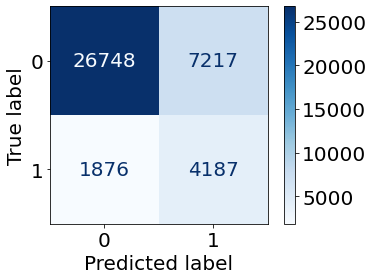

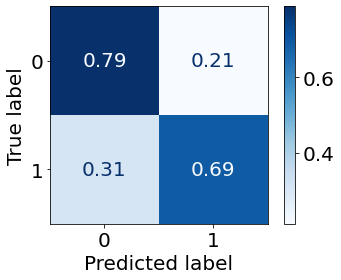

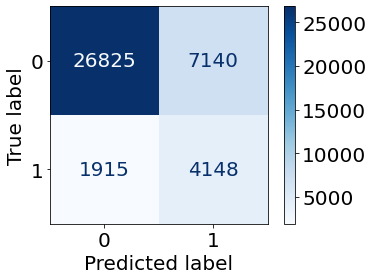

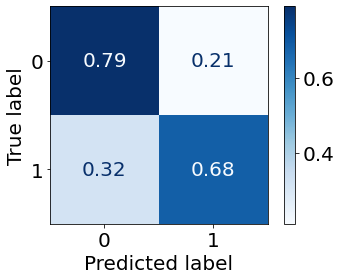

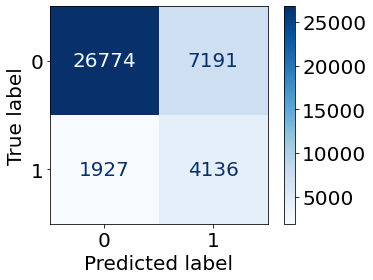

...

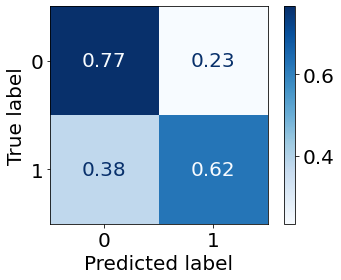

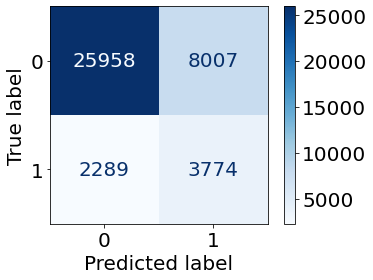

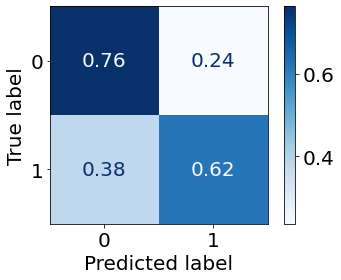

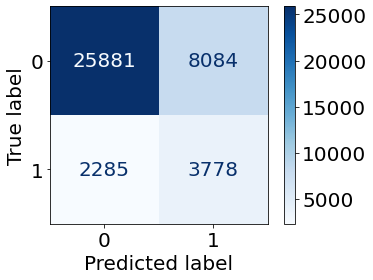

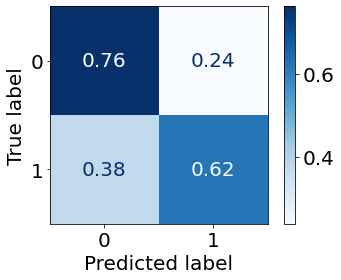

In [18]:



for n in range(1, 30):
    df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 5, n=n)

    X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2021_DP = df_train_2021_DP['Diabetes']
    print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

    train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                         X_validation_2021, y_validation_2021, 
                         X_validation_2021, y_validation_2021,
                         "2021", "Age-40_44-DP-" + str(n), "1", df_validation_2021,
                        save_dir = "Performance/Age_40_44-Validation-Set-Performance-LR-Trial-3/")

In [19]:
import os
import pandas as pd

# Specify the directory containing CSV files
directory_path = 'Performance/Age_40_44-Validation-Set-Performance-LR-Trial-3/'

# Get a list of all CSV files in the directory
csv_files = [file for file in os.listdir(directory_path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(directory_path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "40-44"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "40-44"]["Class 1 AU_PRC"].to_list()[0]
    
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv("Performance/Age_40_44-Validation-Set-Performance-LR-Trial-3/ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
28,2021 Age-40_44-DP-29.csv,0.770742,0.305946
17,2021 Age-40_44-DP-18.csv,0.766312,0.307574
27,2021 Age-40_44-DP-28.csv,0.765503,0.306112
25,2021 Age-40_44-DP-26.csv,0.764580,0.306353
21,2021 Age-40_44-DP-22.csv,0.764219,0.306974
22,2021 Age-40_44-DP-23.csv,0.763901,0.306730
18,2021 Age-40_44-DP-19.csv,0.763584,0.307381
24,2021 Age-40_44-DP-25.csv,0.762862,0.306693
19,2021 Age-40_44-DP-20.csv,0.762228,0.307382
23,2021 Age-40_44-DP-24.csv,0.760871,0.306783


Original training dataset:  (120081, 50)
Class 1:  (18680, 50)
Class 0:  (101401, 50)
5  group class 1:  (630, 50)
5  group class 1:  (11340, 50)  # of DP units 18
New training set:  (131421, 50)
(131421, 48) (120081, 48) (40027, 48)
accuracy 0.7664826242286457
              precision    recall  f1-score   support

         0.0       0.92      0.79      0.85     33930
         1.0       0.35      0.62      0.45      6097

    accuracy                           0.77     40027
   macro avg       0.63      0.70      0.65     40027
weighted avg       0.83      0.77      0.79     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.616532721010333
Class 1 Precision: 0.3490898959881129
Class 1 Area Under Precision-Recall Curve: 0.39948420773735055
Class 1 F1-Score: 0.4457752742365846
Class 0 Recall: 0.7934276451517831
Class 0 Precision: 0.9200929628490379
Class 0 Area Under Precision-Recall Curve: 0.7334404896563196
Class 0 F1-Score: 0.852

Class 1 Recall: 0.7813765182186235
Class 1 Precision: 0.3251895534962089
Class 1 Area Under Precision-Recall Curve: 0.4303281892262534
Class 1 F1-Score: 0.4592504461629982
Class 0 Recall: 0.6427297056199821
Class 0 Precision: 0.9302775984506133
Class 0 Area Under Precision-Recall Curve: 0.6946868940063767
Class 0 F1-Score: 0.7602215774202058
Overall Accuracy: 0.6677631578947368
Balanced Accuracy: 0.7120531119193028
Area Under ROC Curve: 0.7765704059778898
Matthews Correlation Coefficient: 0.3291583344334001
0.7813765182186235
0.3251895534962089
0.4303281892262534
0.4592504461629982
0.6427297056199821
0.9302775984506133
0.6946868940063767
0.7602215774202058
0.6677631578947368
0.7120531119193028
0.7765704059778898
0.3291583344334001
============================  30-34 ============================ 
Class 1 Recall: 0.7384615384615385
Class 1 Precision: 0.09022556390977443
Class 1 Area Under Precision-Recall Curve: 0.18800475464724056
Class 1 F1-Score: 0.16080402010050251
Class 0 Recall: 0.

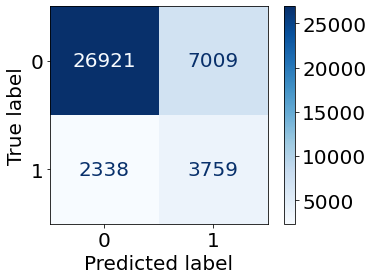

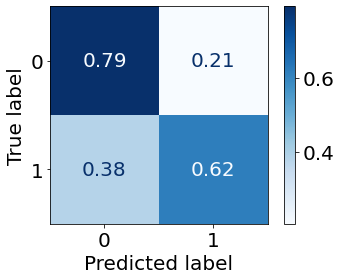

In [21]:
n = 18
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 5, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-40_44-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_40_44-Test-Set-Performance-LR-Trial-3/")

Same training set:  (120081, 50)
(120081, 48) (120081, 48) (40027, 48)
accuracy 0.7707047742773627
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     33930
         1.0       0.37      0.69      0.48      6097

    accuracy                           0.77     40027
   macro avg       0.65      0.74      0.67     40027
weighted avg       0.85      0.77      0.80     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6885353452517632
Class 1 Precision: 0.3657750283175046
Class 1 Area Under Precision-Recall Curve: 0.435084562403413
Class 1 F1-Score: 0.4777512233982019
Class 0 Recall: 0.7854700854700855
Class 0 Precision: 0.9334851138353766
Class 0 Area Under Precision-Recall Curve: 0.7230105728795921
Class 0 F1-Score: 0.8531049935979512
Overall Accuracy: 0.7707047742773627
Balanced Accuracy: 0.7370027153609243
Area Under ROC Curve: 0.8197075610472817
Matthews Correlation Coefficient: 

Class 1 Recall: 0.7226720647773279
Class 1 Precision: 0.40202702702702703
Class 1 Area Under Precision-Recall Curve: 0.4771618985109886
Class 1 F1-Score: 0.5166425470332852
Class 0 Recall: 0.7631578947368421
Class 0 Precision: 0.9258658008658008
Class 0 Area Under Precision-Recall Curve: 0.6794053666938735
Class 0 F1-Score: 0.8366748166259169
Overall Accuracy: 0.7558479532163743
Balanced Accuracy: 0.7429149797570851
Area Under ROC Curve: 0.8220654996442592
Matthews Correlation Coefficient: 0.3991242404316723
0.7226720647773279
0.40202702702702703
0.4771618985109886
0.5166425470332852
0.7631578947368421
0.9258658008658008
0.6794053666938735
0.8366748166259169
0.7558479532163743
0.7429149797570851
0.8220654996442592
0.3991242404316723
============================  30-34 ============================ 
Class 1 Recall: 0.23076923076923078
Class 1 Precision: 0.20270270270270271
Class 1 Area Under Precision-Recall Curve: 0.1855781187411733
Class 1 F1-Score: 0.21582733812949642
Class 0 Recall: 

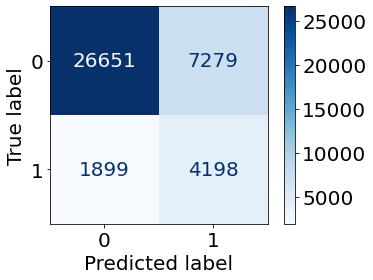

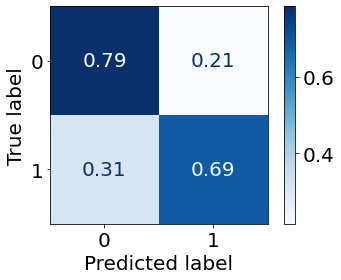

In [59]:
n = 0
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 5, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021, 
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-40_44-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/Age_40_44-Test-Set-Performance-LR-Trial-3/")

# DP 2015

In [21]:
random_state = 1
df_train_2015, df_test_2015 = train_test_split(brfss_2015_one_hot, test_size=0.4, random_state=random_state)
df_test_2015, df_validation_2015 = train_test_split(df_test_2015, test_size=0.5, random_state=random_state)
print(brfss_2015_one_hot.shape, df_train_2015.shape, df_test_2015.shape, df_validation_2015.shape)

X_train_2015 = df_train_2015.drop(['Diabetes', 'Race'],axis=1)
y_train_2015 = df_train_2015['Diabetes']

X_test_2015 = df_test_2015.drop(['Diabetes', 'Race'],axis=1)
y_test_2015 = df_test_2015['Diabetes']
y_test_2015 = y_test_2015.to_numpy()

X_validation_2015 = df_validation_2015.drop(['Diabetes', 'Race'],axis=1)
y_validation_2015 = df_validation_2015['Diabetes']
y_validation_2015 = y_validation_2015.to_numpy()

print(X_train_2015.shape, X_test_2015.shape, X_validation_2015.shape)


(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)


In [38]:
random_state = 2
df_train_2015, df_test_2015 = train_test_split(brfss_2015_one_hot, test_size=0.4, random_state=random_state)
df_test_2015, df_validation_2015 = train_test_split(df_test_2015, test_size=0.5, random_state=random_state)
print(brfss_2015_one_hot.shape, df_train_2015.shape, df_test_2015.shape, df_validation_2015.shape)

X_train_2015 = df_train_2015.drop(['Diabetes', 'Race'],axis=1)
y_train_2015 = df_train_2015['Diabetes']

X_test_2015 = df_test_2015.drop(['Diabetes', 'Race'],axis=1)
y_test_2015 = df_test_2015['Diabetes']
y_test_2015 = y_test_2015.to_numpy()

X_validation_2015 = df_validation_2015.drop(['Diabetes', 'Race'],axis=1)
y_validation_2015 = df_validation_2015['Diabetes']
y_validation_2015 = y_validation_2015.to_numpy()

print(X_train_2015.shape, X_test_2015.shape, X_validation_2015.shape)


(220390, 50) (132234, 50) (44078, 50) (44078, 50)
(132234, 48) (44078, 48) (44078, 48)


## 40-44

In [25]:
for n in range(1, 30):
    df_train_2015_DP = dp(data = df_train_2015, col = "Age", group = 5, n=n)

    X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2015_DP = df_train_2015_DP['Diabetes']
    print(X_train_2015_DP.shape, X_train_2015.shape, X_test_2015.shape)

    train_LR_test_result(X_train_2015_DP, y_train_2015_DP, 
                         X_validation_2015, y_validation_2015, 
                         X_validation_2015, y_validation_2015,
                         df_validation_2015, str(n),
                        save_dir = "Performance-LR-2015/DP/Age_40_44-Validation-Set-Trial-1/",
                        threshold_val = 0.18)

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (563, 50)  # of DP units 1
New training set:  (132797, 50)
(132797, 48) (132234, 48) (44078, 48)
accuracy 0.7601751440627977
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.84     37526
         1.0       0.35      0.73      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.65      0.75      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.726037851037851
Class 1 Precision: 0.3515111209635705
Class 1 Area Under Precision-Recall Curve: 0.44076558610517297
Class 1 F1-Score: 0.4736868309683844
Class 0 Recall: 0.7661354794009487
Class 0 Precision: 0.9412342445572107
Class 0 Area Under Precision-Recall Curve: 0.7255307056604584
Class 0 F1-Score: 0.844706

Class 1 Recall: 0.8173431734317343
Class 1 Precision: 0.4030937215650591
Class 1 Area Under Precision-Recall Curve: 0.5222838074833003
Class 1 F1-Score: 0.5399146861669714
Class 0 Recall: 0.688656858092074
Class 0 Precision: 0.9361290322580645
Class 0 Area Under Precision-Recall Curve: 0.6435516133019105
Class 0 F1-Score: 0.7935466229149575
Overall Accuracy: 0.7149867874669686
Balanced Accuracy: 0.7530000157619041
Area Under ROC Curve: 0.8319203078124754
Matthews Correlation Coefficient: 0.414302696259744
0.8173431734317343
0.4030937215650591
0.5222838074833003
0.5399146861669714
0.688656858092074
0.9361290322580645
0.6435516133019105
0.7935466229149575
0.7149867874669686
0.7530000157619041
0.8319203078124754
0.414302696259744
============================  30-34 ============================ 
Class 1 Recall: 0.34545454545454546
Class 1 Precision: 0.19
Class 1 Area Under Precision-Recall Curve: 0.1682682908731315
Class 1 F1-Score: 0.24516129032258066
Class 0 Recall: 0.9609638554216867
Cl

(133360, 48) (132234, 48) (44078, 48)
accuracy 0.7541857616044285
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.35      0.74      0.47      6552

    accuracy                           0.75     44078
   macro avg       0.64      0.75      0.66     44078
weighted avg       0.85      0.75      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7367216117216118
Class 1 Precision: 0.3463442634713353
Class 1 Area Under Precision-Recall Curve: 0.4413407714907407
Class 1 F1-Score: 0.47117965737712925
Class 0 Recall: 0.7572349837446037
Class 0 Precision: 0.9427689857668956
Class 0 Area Under Precision-Recall Curve: 0.7260475824513156
Class 0 F1-Score: 0.8398776360707584
Overall Accuracy: 0.7541857616044285
Balanced Accuracy: 0.7469782977331078
Area Under ROC Curve: 0.8274198936356507
Matthews Correlation Coefficient: 0.3779013049698187
0.7367216117

Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.14788732394366197
Class 1 Area Under Precision-Recall Curve: 0.16729687550095604
Class 1 F1-Score: 0.21319796954314718
Class 0 Recall: 0.9416867469879519
Class 0 Precision: 0.9828973843058351
Class 0 Area Under Precision-Recall Curve: 0.9369083909855869
Class 0 F1-Score: 0.9618508491262615
Overall Accuracy: 0.9272300469483568
Balanced Accuracy: 0.6617524644030668
Area Under ROC Curve: 0.816433734939759
Matthews Correlation Coefficient: 0.20569272649071596
0.38181818181818183
0.14788732394366197
0.16729687550095604
0.21319796954314718
0.9416867469879519
0.9828973843058351
0.9369083909855869
0.9618508491262615
0.9272300469483568
0.6617524644030668
0.816433734939759
0.20569272649071596
============================  35-39 ============================ 
Class 1 Recall: 0.5234375
Class 1 Precision: 0.25868725868725867
Class 1 Area Under Precision-Recall Curve: 0.27507892482317237
Class 1 F1-Score: 0.34625322997416025
Class 0 Recall: 0.9

Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (1689, 50)  # of DP units 3
New training set:  (133923, 50)
(133923, 48) (132234, 48) (44078, 48)
accuracy 0.7613548709106583
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     37526
         1.0       0.35      0.72      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7165750915750916
Class 1 Precision: 0.3515010855731077
Class 1 Area Under Precision-Recall Curve: 0.4400286529462281
Class 1 F1-Score: 0.47164598925109247
Class 0 Recall: 0.7691733731279646
Class 0 Precision: 0.939552748933954
Class 0 Area Under Precision-Recall Curve: 0.7259446867506796
Class 0 F1-Score: 0.8458686828725072
Overall Accuracy: 0.7613548709106583
Balanced Accur

Class 1 Recall: 0.8136531365313653
Class 1 Precision: 0.3902654867256637
Class 1 Area Under Precision-Recall Curve: 0.5184044575776067
Class 1 F1-Score: 0.527511961722488
Class 0 Recall: 0.6729947793070716
Class 0 Precision: 0.9335088874259381
Class 0 Area Under Precision-Recall Curve: 0.6449383775308182
Class 0 F1-Score: 0.7821290678433536
Overall Accuracy: 0.7017742544356361
Balanced Accuracy: 0.7433239579192185
Area Under ROC Curve: 0.827064765664268
Matthews Correlation Coefficient: 0.3969434775667328
0.8136531365313653
0.3902654867256637
0.5184044575776067
0.527511961722488
0.6729947793070716
0.9335088874259381
0.6449383775308182
0.7821290678433536
0.7017742544356361
0.7433239579192185
0.827064765664268
0.3969434775667328
============================  30-34 ============================ 
Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.13548387096774195
Class 1 Area Under Precision-Recall Curve: 0.16793803774777968
Class 1 F1-Score: 0.2
Class 0 Recall: 0.935421686746988
Cla

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (2252, 50)  # of DP units 4
New training set:  (134486, 50)
(134486, 48) (132234, 48) (44078, 48)
accuracy 0.7829302599936476
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.37      0.67      0.48      6552

    accuracy                           0.78     44078
   macro avg       0.65      0.74      0.67     44078
weighted avg       0.85      0.78      0.81     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6678876678876678
Class 1 Precision: 0.37185588035350103
Class 1 Area Under Precision-Recall Curve: 0.4417859400341003
Class 1 F1-Score: 0.4777292576419213
Class 0 Recall: 0.8030165751745456
Class 0 Precision: 0.9326524295883627
Class 0 Area Under Precision-Recall Curve: 0.7256063630248575
Class 0 F1-Score: 0.8629932985852568
Overall Accuracy: 0.78293025

Class 1 Recall: 0.7933579335793358
Class 1 Precision: 0.4079696394686907
Class 1 Area Under Precision-Recall Curve: 0.5155613244834392
Class 1 F1-Score: 0.5388471177944862
Class 0 Recall: 0.703844328429046
Class 0 Precision: 0.9297805642633229
Class 0 Area Under Precision-Recall Curve: 0.645878579315811
Class 0 F1-Score: 0.8011885467314965
Overall Accuracy: 0.7221593053982635
Balanced Accuracy: 0.7486011310041909
Area Under ROC Curve: 0.8241260461963897
Matthews Correlation Coefficient: 0.4097928321595547
0.7933579335793358
0.4079696394686907
0.5155613244834392
0.5388471177944862
0.703844328429046
0.9297805642633229
0.645878579315811
0.8011885467314965
0.7221593053982635
0.7486011310041909
0.8241260461963897
0.4097928321595547
============================  30-34 ============================ 
Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.14383561643835616
Class 1 Area Under Precision-Recall Curve: 0.16835876822081922
Class 1 F1-Score: 0.208955223880597
Class 0 Recall: 0.93975

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (2815, 50)  # of DP units 5
New training set:  (135049, 50)
(135049, 48) (132234, 48) (44078, 48)
accuracy 0.7821815871863514
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.37      0.67      0.48      6552

    accuracy                           0.78     44078
   macro avg       0.65      0.74      0.67     44078
weighted avg       0.85      0.78      0.81     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6683455433455433
Class 1 Precision: 0.370881680359109
Class 1 Area Under Precision-Recall Curve: 0.43923169675925045
Class 1 F1-Score: 0.47704123318263525
Class 0 Recall: 0.8020572403133828
Class 0 Precision: 0.9326640017353042
Class 0 Area Under Precision-Recall Curve: 0.726775221900604
Class 0 F1-Score: 0.8624439445821456
Overall Accuracy: 0.782181587

Class 1 Recall: 0.7933579335793358
Class 1 Precision: 0.40149393090569563
Class 1 Area Under Precision-Recall Curve: 0.5128916187205346
Class 1 F1-Score: 0.5331680099194048
Class 0 Recall: 0.6957759848125297
Class 0 Precision: 0.9290240811153359
Class 0 Area Under Precision-Recall Curve: 0.6467810221619821
Class 0 F1-Score: 0.7956580732700136
Overall Accuracy: 0.7157417893544734
Balanced Accuracy: 0.7445669591959327
Area Under ROC Curve: 0.8212442447158216
Matthews Correlation Coefficient: 0.40207905978667535
0.7933579335793358
0.40149393090569563
0.5128916187205346
0.5331680099194048
0.6957759848125297
0.9290240811153359
0.6467810221619821
0.7956580732700136
0.7157417893544734
0.7445669591959327
0.8212442447158216
0.40207905978667535
============================  30-34 ============================ 
Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.12574850299401197
Class 1 Area Under Precision-Recall Curve: 0.16816338974416362
Class 1 F1-Score: 0.18918918918918917
Class 0 Recal

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (3378, 50)  # of DP units 6
New training set:  (135612, 50)
(135612, 48) (132234, 48) (44078, 48)
accuracy 0.7562502835881846
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.35      0.72      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.64      0.74      0.65     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7194749694749695
Class 1 Precision: 0.3461086637298091
Class 1 Area Under Precision-Recall Curve: 0.43786559467375735
Class 1 F1-Score: 0.4673805274638112
Class 0 Recall: 0.762671214624527
Class 0 Precision: 0.9396546063431611
Class 0 Area Under Precision-Recall Curve: 0.7272590320479686
Class 0 F1-Score: 0.8419628147799483
Overall Accuracy: 0.756250283

Class 1 Recall: 0.509090909090909
Class 1 Precision: 0.11290322580645161
Class 1 Area Under Precision-Recall Curve: 0.16963688340335445
Class 1 F1-Score: 0.1848184818481848
Class 0 Recall: 0.8939759036144578
Class 0 Precision: 0.9856535600425079
Class 0 Area Under Precision-Recall Curve: 0.9367464467486976
Class 0 F1-Score: 0.9375789739701793
Overall Accuracy: 0.884037558685446
Balanced Accuracy: 0.7015334063526835
Area Under ROC Curve: 0.8162059145673604
Matthews Correlation Coefficient: 0.19931123787339627
0.509090909090909
0.11290322580645161
0.16963688340335445
0.1848184818481848
0.8939759036144578
0.9856535600425079
0.9367464467486976
0.9375789739701793
0.884037558685446
0.7015334063526835
0.8162059145673604
0.19931123787339627
============================  35-39 ============================ 
Class 1 Recall: 0.609375
Class 1 Precision: 0.2074468085106383
Class 1 Area Under Precision-Recall Curve: 0.27650072552555965
Class 1 F1-Score: 0.3095238095238096
Class 0 Recall: 0.8731375053

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (3941, 50)  # of DP units 7
New training set:  (136175, 50)
(136175, 48) (132234, 48) (44078, 48)
accuracy 0.7573846363265121
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.35      0.71      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.64      0.74      0.65     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7147435897435898
Class 1 Precision: 0.3466834468463133
Class 1 Area Under Precision-Recall Curve: 0.435916355839475
Class 1 F1-Score: 0.4668993020937189
Class 0 Recall: 0.7648297180621436
Class 0 Precision: 0.9388616290480863
Class 0 Area Under Precision-Recall Curve: 0.7277459412542943
Class 0 F1-Score: 0.8429570018796992
Overall Accuracy: 0.7573846363

Class 1 Recall: 0.8247232472324724
Class 1 Precision: 0.3669950738916256
Class 1 Area Under Precision-Recall Curve: 0.5050338279982349
Class 1 F1-Score: 0.5079545454545454
Class 0 Recall: 0.634076886568581
Class 0 Precision: 0.93361285814116
Class 0 Area Under Precision-Recall Curve: 0.6489960907965437
Class 0 F1-Score: 0.7552289429055964
Overall Accuracy: 0.6730841827104568
Balanced Accuracy: 0.7294000669005267
Area Under ROC Curve: 0.8151312528787367
Matthews Correlation Coefficient: 0.3713744194721817
0.8247232472324724
0.3669950738916256
0.5050338279982349
0.5079545454545454
0.634076886568581
0.93361285814116
0.6489960907965437
0.7552289429055964
0.6730841827104568
0.7294000669005267
0.8151312528787367
0.3713744194721817
============================  30-34 ============================ 
Class 1 Recall: 0.509090909090909
Class 1 Precision: 0.1044776119402985
Class 1 Area Under Precision-Recall Curve: 0.16938458723811847
Class 1 F1-Score: 0.17337461300309598
Class 0 Recall: 0.88433734

New training set:  (136738, 50)
(136738, 48) (132234, 48) (44078, 48)
accuracy 0.7700666999410136
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.36      0.68      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.684981684981685
Class 1 Precision: 0.35735329245959074
Class 1 Area Under Precision-Recall Curve: 0.4329829223976643
Class 1 F1-Score: 0.46967714928575166
Class 0 Recall: 0.7849224537653894
Class 0 Precision: 0.9345156889495225
Class 0 Area Under Precision-Recall Curve: 0.7284587978454196
Class 0 F1-Score: 0.853211673546238
Overall Accuracy: 0.7700666999410136
Balanced Accuracy: 0.7349520693735372
Area Under ROC Curve: 0.8199336494218707
Matthews Correlation Coefficient: 

============================  30-34 ============================ 
Class 1 Recall: 0.509090909090909
Class 1 Precision: 0.10646387832699619
Class 1 Area Under Precision-Recall Curve: 0.16841761839005767
Class 1 F1-Score: 0.1761006289308176
Class 0 Recall: 0.8867469879518072
Class 0 Precision: 0.9855382967327263
Class 0 Area Under Precision-Recall Curve: 0.936815503561663
Class 0 F1-Score: 0.9335362760020294
Overall Accuracy: 0.8769953051643192
Balanced Accuracy: 0.6979189485213582
Area Under ROC Curve: 0.8163110624315444
Matthews Correlation Coefficient: 0.19083486971462107
0.509090909090909
0.10646387832699619
0.16841761839005767
0.1761006289308176
0.8867469879518072
0.9855382967327263
0.936815503561663
0.9335362760020294
0.8769953051643192
0.6979189485213582
0.8163110624315444
0.19083486971462107
============================  35-39 ============================ 
Class 1 Recall: 0.6328125
Class 1 Precision: 0.20610687022900764
Class 1 Area Under Precision-Recall Curve: 0.277034202989222

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (5067, 50)  # of DP units 9
New training set:  (137301, 50)
(137301, 48) (132234, 48) (44078, 48)
accuracy 0.7699305776124143
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.36      0.68      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6825396825396826
Class 1 Precision: 0.35681800047873613
Class 1 Area Under Precision-Recall Curve: 0.4314018312190791
Class 1 F1-Score: 0.46864029342415514
Class 0 Recall: 0.7851889356712679
Class 0 Precision: 0.934062450467586
Class 0 Area Under Precision-Recall Curve: 0.7283199353708473
Class 0 F1-Score: 0.8531800610965529
Overall Accuracy: 0.76993057

Class 1 Recall: 0.8228782287822878
Class 1 Precision: 0.37353433835845895
Class 1 Area Under Precision-Recall Curve: 0.49791695264138564
Class 1 F1-Score: 0.5138248847926267
Class 0 Recall: 0.6449928808732796
Class 0 Precision: 0.934020618556701
Class 0 Area Under Precision-Recall Curve: 0.6512284030311244
Class 0 F1-Score: 0.7630544637843908
Overall Accuracy: 0.6813892034730087
Balanced Accuracy: 0.7339355548277837
Area Under ROC Curve: 0.8088054753352469
Matthews Correlation Coefficient: 0.3793363665297148
0.8228782287822878
0.37353433835845895
0.49791695264138564
0.5138248847926267
0.6449928808732796
0.934020618556701
0.6512284030311244
0.7630544637843908
0.6813892034730087
0.7339355548277837
0.8088054753352469
0.3793363665297148
============================  30-34 ============================ 
Class 1 Recall: 0.5636363636363636
Class 1 Precision: 0.10726643598615918
Class 1 Area Under Precision-Recall Curve: 0.16859676446975058
Class 1 F1-Score: 0.1802325581395349
Class 0 Recall: 0

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (5630, 50)  # of DP units 10
New training set:  (137864, 50)
(137864, 48) (132234, 48) (44078, 48)
accuracy 0.7715867326103725
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.36      0.68      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6750610500610501
Class 1 Precision: 0.3577900016178612
Class 1 Area Under Precision-Recall Curve: 0.42927542084935094
Class 1 F1-Score: 0.4676958866448134
Class 0 Recall: 0.7884400149229868
Class 0 Precision: 0.9328729978559718
Class 0 Area Under Precision-Recall Curve: 0.7287255998908011
Class 0 F1-Score: 0.8545969209439358
Overall Accuracy: 0.7715867

Class 1 Recall: 0.8173431734317343
Class 1 Precision: 0.3716442953020134
Class 1 Area Under Precision-Recall Curve: 0.4947138674825553
Class 1 F1-Score: 0.510957324106113
Class 0 Recall: 0.6445182724252492
Class 0 Precision: 0.9320521619766644
Class 0 Area Under Precision-Recall Curve: 0.6522862199063291
Class 0 F1-Score: 0.7620650953984288
Overall Accuracy: 0.6798791996979993
Balanced Accuracy: 0.7309307229284918
Area Under ROC Curve: 0.8056811156626043
Matthews Correlation Coefficient: 0.37452060672328
0.8173431734317343
0.3716442953020134
0.4947138674825553
0.510957324106113
0.6445182724252492
0.9320521619766644
0.6522862199063291
0.7620650953984288
0.6798791996979993
0.7309307229284918
0.8056811156626043
0.37452060672328
============================  30-34 ============================ 
Class 1 Recall: 0.6
Class 1 Precision: 0.1064516129032258
Class 1 Area Under Precision-Recall Curve: 0.1689785551464021
Class 1 F1-Score: 0.18082191780821916
Class 0 Recall: 0.8665060240963856
Class 

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (6193, 50)  # of DP units 11
New training set:  (138427, 50)
(138427, 48) (132234, 48) (44078, 48)
accuracy 0.7767140069876128
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.36      0.66      0.47      6552

    accuracy                           0.78     44078
   macro avg       0.65      0.73      0.66     44078
weighted avg       0.85      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6584249084249084
Class 1 Precision: 0.36197348548414165
Class 1 Area Under Precision-Recall Curve: 0.4272144518784546
Class 1 F1-Score: 0.46713589604764494
Class 0 Recall: 0.7973671587699195
Class 0 Precision: 0.9304104477611941
Class 0 Area Under Precision-Recall Curve: 0.7293832845526806
Class 0 F1-Score: 0.8587664667221537
Overall Accuracy: 0.776714

Class 1 Recall: 0.6
Class 1 Precision: 0.10476190476190476
Class 1 Area Under Precision-Recall Curve: 0.17015490816371368
Class 1 F1-Score: 0.17837837837837842
Class 0 Recall: 0.8640963855421687
Class 0 Precision: 0.9878787878787879
Class 0 Area Under Precision-Recall Curve: 0.9367434935791041
Class 0 F1-Score: 0.9218508997429307
Overall Accuracy: 0.8572769953051643
Balanced Accuracy: 0.7320481927710843
Area Under ROC Curve: 0.8162847754654983
Matthews Correlation Coefficient: 0.20735045360130863
0.6
0.10476190476190476
0.17015490816371368
0.17837837837837842
0.8640963855421687
0.9878787878787879
0.9367434935791041
0.9218508997429307
0.8572769953051643
0.7320481927710843
0.8162847754654983
0.20735045360130863
============================  35-39 ============================ 
Class 1 Recall: 0.671875
Class 1 Precision: 0.19815668202764977
Class 1 Area Under Precision-Recall Curve: 0.277774494829783
Class 1 F1-Score: 0.3060498220640569
Class 0 Recall: 0.8518518518518519
Class 0 Precision:

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (6756, 50)  # of DP units 12
New training set:  (138990, 50)
(138990, 48) (132234, 48) (44078, 48)
accuracy 0.7657561595353691
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.35      0.68      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6781135531135531
Class 1 Precision: 0.3509755904889802
Class 1 Area Under Precision-Recall Curve: 0.4241241386527969
Class 1 F1-Score: 0.46254749882879603
Class 0 Recall: 0.7810584661301497
Class 0 Precision: 0.9328750119354531
Class 0 Area Under Precision-Recall Curve: 0.7303369663677903
Class 0 F1-Score: 0.850

============================  30-34 ============================ 
Class 1 Recall: 0.6727272727272727
Class 1 Precision: 0.09585492227979274
Class 1 Area Under Precision-Recall Curve: 0.17283858284316053
Class 1 F1-Score: 0.1678004535147392
Class 0 Recall: 0.8318072289156626
Class 0 Precision: 0.9896788990825688
Class 0 Area Under Precision-Recall Curve: 0.9366392865945354
Class 0 F1-Score: 0.9039015449070438
Overall Accuracy: 0.827699530516432
Balanced Accuracy: 0.7522672508214676
Area Under ROC Curve: 0.8163723986856516
Matthews Correlation Coefficient: 0.20773724734547472
0.6727272727272727
0.09585492227979274
0.17283858284316053
0.1678004535147392
0.8318072289156626
0.9896788990825688
0.9366392865945354
0.9039015449070438
0.827699530516432
0.7522672508214676
0.8163723986856516
0.20773724734547472
============================  35-39 ============================ 
Class 1 Recall: 0.6953125
Class 1 Precision: 0.17835671342685372
Class 1 Area Under Precision-Recall Curve: 0.2773432218818

Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (7319, 50)  # of DP units 13
New training set:  (139553, 50)
(139553, 48) (132234, 48) (44078, 48)
accuracy 0.7706792504197105
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.35      0.66      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6643772893772893
Class 1 Precision: 0.3549991844723536
Class 1 Area Under Precision-Recall Curve: 0.4223358578222345
Class 1 F1-Score: 0.4627405123843946
Class 0 Recall: 0.7892394606406224
Class 0 Precision: 0.9308838320341967
Class 0 Area Under Precision-Recall Curve: 0.7307602755581246
Class 0 F1-Score: 0.8542297597415708
Overall Accuracy: 0.7706792504197105
Balanced Accu

Class 1 Recall: 0.6909090909090909
Class 1 Precision: 0.09523809523809523
Class 1 Area Under Precision-Recall Curve: 0.17290283817106405
Class 1 F1-Score: 0.16740088105726872
Class 0 Recall: 0.8260240963855422
Class 0 Precision: 0.9901790872328134
Class 0 Area Under Precision-Recall Curve: 0.9366464230116011
Class 0 F1-Score: 0.9006831318970048
Overall Accuracy: 0.8225352112676056
Balanced Accuracy: 0.7584665936473165
Area Under ROC Curve: 0.8162497261774371
Matthews Correlation Coefficient: 0.21013085538400608
0.6909090909090909
0.09523809523809523
0.17290283817106405
0.16740088105726872
0.8260240963855422
0.9901790872328134
0.9366464230116011
0.9006831318970048
0.8225352112676056
0.7584665936473165
0.8162497261774371
0.21013085538400608
============================  35-39 ============================ 
Class 1 Recall: 0.6953125
Class 1 Precision: 0.17729083665338646
Class 1 Area Under Precision-Recall Curve: 0.2769902198701155
Class 1 F1-Score: 0.28253968253968254
Class 0 Recall: 0.82

accuracy 0.7743999274014247
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.36      0.65      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6527777777777778
Class 1 Precision: 0.3580277917294492
Class 1 Area Under Precision-Recall Curve: 0.41950831593912297
Class 1 F1-Score: 0.46242837063466313
Class 0 Recall: 0.7956350263817087
Class 0 Precision: 0.9291983069836923
Class 0 Area Under Precision-Recall Curve: 0.7311965821949076
Class 0 F1-Score: 0.8572453989491516
Overall Accuracy: 0.7743999274014247
Balanced Accuracy: 0.7242064020797432
Area Under ROC Curve: 0.8100370373244514
Matthews Correlation Coefficient: 0.358881401512741
0.6527777777777778
0.3580277917294492
0.4195083159

Class 1 Recall: 0.7952029520295203
Class 1 Precision: 0.3597662771285476
Class 1 Area Under Precision-Recall Curve: 0.4790566267188379
Class 1 F1-Score: 0.4954022988505747
Class 0 Recall: 0.6359753203607024
Class 0 Precision: 0.923501033769814
Class 0 Area Under Precision-Recall Curve: 0.6569686172621574
Class 0 F1-Score: 0.7532321528948848
Overall Accuracy: 0.6685541713854285
Balanced Accuracy: 0.7155891361951113
Area Under ROC Curve: 0.7935295632026088
Matthews Correlation Coefficient: 0.3494834899359047
0.7952029520295203
0.3597662771285476
0.4790566267188379
0.4954022988505747
0.6359753203607024
0.923501033769814
0.6569686172621574
0.7532321528948848
0.6685541713854285
0.7155891361951113
0.7935295632026088
0.3494834899359047
============================  30-34 ============================ 
Class 1 Recall: 0.6909090909090909
Class 1 Precision: 0.09290953545232274
Class 1 Area Under Precision-Recall Curve: 0.17274802553128735
Class 1 F1-Score: 0.16379310344827586
Class 0 Recall: 0.82

Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (8445, 50)  # of DP units 15
New training set:  (140679, 50)
(140679, 48) (132234, 48) (44078, 48)
accuracy 0.7715867326103725
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     37526
         1.0       0.35      0.66      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6550671550671551
Class 1 Precision: 0.3547107438016529
Class 1 Area Under Precision-Recall Curve: 0.41726144116584735
Class 1 F1-Score: 0.4602187432983058
Class 0 Recall: 0.7919309278899963
Class 0 Precision: 0.9293264119081869
Class 0 Area Under Precision-Recall Curve: 0.731601103430013
Class 0 F1-Score: 0.8551450276243094
Overall Accuracy: 0.7715867326103725
Balanced Accu

Class 1 Recall: 0.7988929889298892
Class 1 Precision: 0.3563786008230453
Class 1 Area Under Precision-Recall Curve: 0.4753850808166805
Class 1 F1-Score: 0.49288560045532165
Class 0 Recall: 0.6288561936402468
Class 0 Precision: 0.9239888423988842
Class 0 Area Under Precision-Recall Curve: 0.658096352709062
Class 0 F1-Score: 0.7483761649251623
Overall Accuracy: 0.6636466591166478
Balanced Accuracy: 0.713874591285068
Area Under ROC Curve: 0.7905190395045858
Matthews Correlation Coefficient: 0.34630469915590145
0.7988929889298892
0.3563786008230453
0.4753850808166805
0.49288560045532165
0.6288561936402468
0.9239888423988842
0.658096352709062
0.7483761649251623
0.6636466591166478
0.713874591285068
0.7905190395045858
0.34630469915590145
============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.08744394618834081
Class 1 Area Under Precision-Recall Curve: 0.17305720922369713
Class 1 F1-Score: 0.15568862275449102
Class 0 Recall: 0.

Class 1 Recall: 0.4827586206896552
Class 1 Precision: 0.3469640644361834
Class 1 Area Under Precision-Recall Curve: 0.3610775503022456
Class 1 F1-Score: 0.4037490987743331
Class 0 Recall: 0.7956572314850717
Class 0 Precision: 0.8724489795918368
Class 0 Area Under Precision-Recall Curve: 0.7152617695492027
Class 0 F1-Score: 0.8322855404583248
Overall Accuracy: 0.7382082937638493
Balanced Accuracy: 0.6392079260873634
Area Under ROC Curve: 0.7182779345108369
Matthews Correlation Coefficient: 0.24716000815526792
0.4827586206896552
0.3469640644361834
0.3610775503022456
0.4037490987743331
0.7956572314850717
0.8724489795918368
0.7152617695492027
0.8322855404583248
0.7382082937638493
0.6392079260873634
0.7182779345108369
0.24716000815526792
Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (9008, 50)  # of DP units 16
New training set:  (141242, 50)
(141242, 48) (132234, 48) (44078, 48)
accuracy 0.7715186714460

============================  30-34 ============================ 
Class 1 Recall: 0.7454545454545455
Class 1 Precision: 0.08798283261802575
Class 1 Area Under Precision-Recall Curve: 0.17284887790511824
Class 1 F1-Score: 0.15738963531669864
Class 0 Recall: 0.7951807228915663
Class 0 Precision: 0.9915865384615384
Class 0 Area Under Precision-Recall Curve: 0.9366311563789151
Class 0 F1-Score: 0.8825889275207274
Overall Accuracy: 0.7938967136150235
Balanced Accuracy: 0.7703176341730559
Area Under ROC Curve: 0.8165739320920044
Matthews Correlation Coefficient: 0.20740783082066003
0.7454545454545455
0.08798283261802575
0.17284887790511824
0.15738963531669864
0.7951807228915663
0.9915865384615384
0.9366311563789151
0.8825889275207274
0.7938967136150235
0.7703176341730559
0.8165739320920044
0.20740783082066003
============================  35-39 ============================ 
Class 1 Recall: 0.7265625
Class 1 Precision: 0.16489361702127658
Class 1 Area Under Precision-Recall Curve: 0.277143896

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (9571, 50)  # of DP units 17
New training set:  (141805, 50)
(141805, 48) (132234, 48) (44078, 48)
accuracy 0.7648713643994737
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.35      0.66      0.46      6552

    accuracy                           0.76     44078
   macro avg       0.64      0.72      0.65     44078
weighted avg       0.84      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6604090354090354
Class 1 Precision: 0.3471041232151452
Class 1 Area Under Precision-Recall Curve: 0.4125811725906189
Class 1 F1-Score: 0.45504259122936175
Class 0 Recall: 0.783110376805415
Class 0 Precision: 0.9296153359483741
Class 0 Area Under Precision-Recall Curve: 0.7324946211164594
Class 0 F1-Score: 0.8500969076340072
Overall Accuracy: 0.76487136

Class 1 Recall: 0.8025830258302583
Class 1 Precision: 0.3463375796178344
Class 1 Area Under Precision-Recall Curve: 0.4682640793003152
Class 1 F1-Score: 0.48387096774193544
Class 0 Recall: 0.6103464641670622
Class 0 Precision: 0.9231873653984207
Class 0 Area Under Precision-Recall Curve: 0.6603456016261685
Class 0 F1-Score: 0.734857142857143
Overall Accuracy: 0.6496791241978105
Balanced Accuracy: 0.7064647449986603
Area Under ROC Curve: 0.7846407249074863
Matthews Correlation Coefficient: 0.33360875001582024
0.8025830258302583
0.3463375796178344
0.4682640793003152
0.48387096774193544
0.6103464641670622
0.9231873653984207
0.6603456016261685
0.734857142857143
0.6496791241978105
0.7064647449986603
0.7846407249074863
0.33360875001582024
============================  30-34 ============================ 
Class 1 Recall: 0.7636363636363637
Class 1 Precision: 0.08092485549132948
Class 1 Area Under Precision-Recall Curve: 0.17306466885457852
Class 1 F1-Score: 0.14634146341463417
Class 0 Recall: 

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (10134, 50)  # of DP units 18
New training set:  (142368, 50)
(142368, 48) (132234, 48) (44078, 48)
accuracy 0.7650982349471391
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.35      0.66      0.45      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.65     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6558302808302808
Class 1 Precision: 0.34664407873507586
Class 1 Area Under Precision-Recall Curve: 0.4106781650273676
Class 1 F1-Score: 0.4535571036521005
Class 0 Recall: 0.7841763044289293
Class 0 Precision: 0.9288239378827094
Class 0 Area Under Precision-Recall Curve: 0.7329446956011603
Class 0 F1-Score: 0.850393018148191
Overall Accuracy: 0.7650982

Class 1 Recall: 0.7952029520295203
Class 1 Precision: 0.34233518665607626
Class 1 Area Under Precision-Recall Curve: 0.46490392001779424
Class 1 F1-Score: 0.4786229872293171
Class 0 Recall: 0.6070242050308495
Class 0 Precision: 0.9201438848920863
Class 0 Area Under Precision-Recall Curve: 0.6614298452578815
Class 0 F1-Score: 0.731484129253646
Overall Accuracy: 0.6455266138165345
Balanced Accuracy: 0.701113578530185
Area Under ROC Curve: 0.7818088361234823
Matthews Correlation Coefficient: 0.3249249309250721
0.7952029520295203
0.34233518665607626
0.46490392001779424
0.4786229872293171
0.6070242050308495
0.9201438848920863
0.6614298452578815
0.731484129253646
0.6455266138165345
0.701113578530185
0.7818088361234823
0.3249249309250721
============================  30-34 ============================ 
Class 1 Recall: 0.7818181818181819
Class 1 Precision: 0.07992565055762081
Class 1 Area Under Precision-Recall Curve: 0.1734120052970619
Class 1 F1-Score: 0.14502529510961212
Class 0 Recall: 0.7

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (10697, 50)  # of DP units 19
New training set:  (142931, 50)
(142931, 48) (132234, 48) (44078, 48)
accuracy 0.7690004083669858
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.35      0.64      0.45      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.65     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6437728937728938
Class 1 Precision: 0.3495773247140726
Class 1 Area Under Precision-Recall Curve: 0.40745764783954397
Class 1 F1-Score: 0.45310989365130516
Class 0 Recall: 0.7908650002664819
Class 0 Precision: 0.9270898413095089
Class 0 Area Under Precision-Recall Curve: 0.7337203844547683
Class 0 F1-Score: 0.8535764617906755
Overall Accuracy: 0.76900

Class 1 Recall: 0.7952029520295203
Class 1 Precision: 0.3467417538213998
Class 1 Area Under Precision-Recall Curve: 0.46138828512073926
Class 1 F1-Score: 0.48291316526610645
Class 0 Recall: 0.6146179401993356
Class 0 Precision: 0.9210526315789473
Class 0 Area Under Precision-Recall Curve: 0.6625347704662893
Class 0 F1-Score: 0.7372615997722745
Overall Accuracy: 0.6515666289165722
Balanced Accuracy: 0.704910446114428
Area Under ROC Curve: 0.7790259843746989
Matthews Correlation Coefficient: 0.3312819553773618
0.7952029520295203
0.3467417538213998
0.46138828512073926
0.48291316526610645
0.6146179401993356
0.9210526315789473
0.6625347704662893
0.7372615997722745
0.6515666289165722
0.704910446114428
0.7790259843746989
0.3312819553773618
============================  30-34 ============================ 
Class 1 Recall: 0.7818181818181819
Class 1 Precision: 0.07933579335793357
Class 1 Area Under Precision-Recall Curve: 0.17373382660624118
Class 1 F1-Score: 0.14405360134003348
Class 0 Recall: 

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (11260, 50)  # of DP units 20
New training set:  (143494, 50)
(143494, 48) (132234, 48) (44078, 48)
accuracy 0.7659830300830346
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.35      0.65      0.45      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.65     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6465201465201466
Class 1 Precision: 0.34621986105435226
Class 1 Area Under Precision-Recall Curve: 0.40577929275358654
Class 1 F1-Score: 0.450950125086496
Class 0 Recall: 0.7868411234877152
Class 0 Precision: 0.9272681594070911
Class 0 Area Under Precision-Recall Curve: 0.7344526058254326
Class 0 F1-Score: 0.851302454987098
Overall Accuracy: 0.7659830

============================  30-34 ============================ 
Class 1 Recall: 0.8
Class 1 Precision: 0.07678883071553229
Class 1 Area Under Precision-Recall Curve: 0.1736772005465519
Class 1 F1-Score: 0.14012738853503184
Class 0 Recall: 0.7450602409638554
Class 0 Precision: 0.9929351316634554
Class 0 Area Under Precision-Recall Curve: 0.9365542887253653
Class 0 F1-Score: 0.8513215859030837
Overall Accuracy: 0.7464788732394366
Balanced Accuracy: 0.7725301204819277
Area Under ROC Curve: 0.8167579408543264
Matthews Correlation Coefficient: 0.1949455301750871
0.8
0.07678883071553229
0.1736772005465519
0.14012738853503184
0.7450602409638554
0.9929351316634554
0.9365542887253653
0.8513215859030837
0.7464788732394366
0.7725301204819277
0.8167579408543264
0.1949455301750871
============================  35-39 ============================ 
Class 1 Recall: 0.78125
Class 1 Precision: 0.15625
Class 1 Area Under Precision-Recall Curve: 0.27727502186459296
Class 1 F1-Score: 0.2604166666666667
Cl

(144057, 48) (132234, 48) (44078, 48)
accuracy 0.758904668995871
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.34      0.66      0.45      6552

    accuracy                           0.76     44078
   macro avg       0.63      0.72      0.65     44078
weighted avg       0.84      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6576617826617827
Class 1 Precision: 0.3394784526904593
Class 1 Area Under Precision-Recall Curve: 0.40358107083163
Class 1 F1-Score: 0.4478046245778124
Class 0 Recall: 0.7765815701113894
Class 0 Precision: 0.9285327385693802
Class 0 Area Under Precision-Recall Curve: 0.7351231481582121
Class 0 F1-Score: 0.8457865943027963
Overall Accuracy: 0.758904668995871
Balanced Accuracy: 0.717121676386586
Area Under ROC Curve: 0.7986790656239837
Matthews Correlation Coefficient: 0.34114817641811396
0.657661782661782

============================  30-34 ============================ 
Class 1 Recall: 0.8
Class 1 Precision: 0.07213114754098361
Class 1 Area Under Precision-Recall Curve: 0.17380455706940162
Class 1 F1-Score: 0.1323308270676692
Class 0 Recall: 0.7272289156626506
Class 0 Precision: 0.9927631578947368
Class 0 Area Under Precision-Recall Curve: 0.9365345877925466
Class 0 F1-Score: 0.839499304589708
Overall Accuracy: 0.7291079812206572
Balanced Accuracy: 0.7636144578313253
Area Under ROC Curve: 0.8168630887185104
Matthews Correlation Coefficient: 0.1849706849410353
0.8
0.07213114754098361
0.17380455706940162
0.1323308270676692
0.7272289156626506
0.9927631578947368
0.9365345877925466
0.839499304589708
0.7291079812206572
0.7636144578313253
0.8168630887185104
0.1849706849410353
============================  35-39 ============================ 
Class 1 Recall: 0.78125
Class 1 Precision: 0.14641288433382138
Class 1 Area Under Precision-Recall Curve: 0.27740329792702795
Class 1 F1-Score: 0.246609124

Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (12386, 50)  # of DP units 22
New training set:  (144620, 50)
(144620, 48) (132234, 48) (44078, 48)
accuracy 0.7611506874177594
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.34      0.65      0.45      6552

    accuracy                           0.76     44078
   macro avg       0.63      0.71      0.65     44078
weighted avg       0.84      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6488095238095238
Class 1 Precision: 0.34067959608911685
Class 1 Area Under Precision-Recall Curve: 0.4017033325789718
Class 1 F1-Score: 0.44676826064109304
Class 0 Recall: 0.7807653360336834
Class 0 Precision: 0.9271835443037975
Class 0 Area Under Precision-Recall Curve: 0.7353069366682528
Class 0 F1-Score: 0.8476984058096809
Overall Accuracy: 0.7611506874177594
Balanced A

0.33593141075604055
0.4514637239154384
0.4723287671232877
0.5956336022781206
0.9187408491947291
0.6657488279096158
0.7227181111431039
0.636466591166478
0.6954182771538204
0.7709418788540044
0.3154920419866381
============================  30-34 ============================ 
Class 1 Recall: 0.8
Class 1 Precision: 0.07177814029363784
Class 1 Area Under Precision-Recall Curve: 0.17438892677817805
Class 1 F1-Score: 0.13173652694610777
Class 0 Recall: 0.7257831325301205
Class 0 Precision: 0.992748846407383
Class 0 Area Under Precision-Recall Curve: 0.9364954008236523
Class 0 F1-Score: 0.8385300668151449
Overall Accuracy: 0.7276995305164319
Balanced Accuracy: 0.7628915662650603
Area Under ROC Curve: 0.8168630887185104
Matthews Correlation Coefficient: 0.18419337990381782
0.8
0.07177814029363784
0.17438892677817805
0.13173652694610777
0.7257831325301205
0.992748846407383
0.9364954008236523
0.8385300668151449
0.7276995305164319
0.7628915662650603
0.8168630887185104
0.18419337990381782
========

New training set:  (145183, 50)
(145183, 48) (132234, 48) (44078, 48)
accuracy 0.7683424837787558
              precision    recall  f1-score   support

         0.0       0.92      0.79      0.85     37526
         1.0       0.35      0.63      0.45      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.71      0.65     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6285103785103785
Class 1 Precision: 0.34619588062211015
Class 1 Area Under Precision-Recall Curve: 0.3986984331121239
Class 1 F1-Score: 0.4464682604217488
Class 0 Recall: 0.7927570217982199
Class 0 Precision: 0.9243700090109686
Class 0 Area Under Precision-Recall Curve: 0.7362049407044208
Class 0 F1-Score: 0.8535196316114131
Overall Accuracy: 0.7683424837787558
Balanced Accuracy: 0.7106337001542993
Area Under ROC Curve: 0.7956410986876532
Matthews Correlation Coefficient:

Class 1 Recall: 0.8
Class 1 Precision: 0.07296849087893864
Class 1 Area Under Precision-Recall Curve: 0.17485577123794435
Class 1 F1-Score: 0.1337386018237082
Class 0 Recall: 0.7306024096385542
Class 0 Precision: 0.9927963326784545
Class 0 Area Under Precision-Recall Curve: 0.9364770412749484
Class 0 F1-Score: 0.8417545807884507
Overall Accuracy: 0.7323943661971831
Balanced Accuracy: 0.7653012048192771
Area Under ROC Curve: 0.8168893756845563
Matthews Correlation Coefficient: 0.18680196425361045
0.8
0.07296849087893864
0.17485577123794435
0.1337386018237082
0.7306024096385542
0.9927963326784545
0.9364770412749484
0.8417545807884507
0.7323943661971831
0.7653012048192771
0.8168893756845563
0.18680196425361045
============================  35-39 ============================ 
Class 1 Recall: 0.78125
Class 1 Precision: 0.15037593984962405
Class 1 Area Under Precision-Recall Curve: 0.27739389635009415
Class 1 F1-Score: 0.25220680958385877
Class 0 Recall: 0.7594721157939549
Class 0 Precision:

Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (13512, 50)  # of DP units 24
New training set:  (145746, 50)
(145746, 48) (132234, 48) (44078, 48)
accuracy 0.7677753074095921
              precision    recall  f1-score   support

         0.0       0.92      0.79      0.85     37526
         1.0       0.35      0.63      0.45      6552

    accuracy                           0.77     44078
   macro avg       0.63      0.71      0.65     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6266788766788767
Class 1 Precision: 0.34515803631472763
Class 1 Area Under Precision-Recall Curve: 0.39740492785480563
Class 1 F1-Score: 0.4451431049436253
Class 0 Recall: 0.7924105953205778
Class 0 Precision: 0.9239947796905102
Class 0 Area Under Precision-Recall Curve: 0.7364514745477511
Class 0 F1-Score: 0.853158891375452
Overall Accuracy: 0.7677753074095921
Balanced Ac

Class 1 Recall: 0.7896678966789668
Class 1 Precision: 0.3396825396825397
Class 1 Area Under Precision-Recall Curve: 0.4448951514072884
Class 1 F1-Score: 0.4750277469478357
Class 0 Recall: 0.605125771238728
Class 0 Precision: 0.91792656587473
Class 0 Area Under Precision-Recall Curve: 0.6679099022430184
Class 0 F1-Score: 0.7294050343249427
Overall Accuracy: 0.642884107210268
Balanced Accuracy: 0.6973968339588474
Area Under ROC Curve: 0.7656196092098558
Matthews Correlation Coefficient: 0.3189082057143578
0.7896678966789668
0.3396825396825397
0.4448951514072884
0.4750277469478357
0.605125771238728
0.91792656587473
0.6679099022430184
0.7294050343249427
0.642884107210268
0.6973968339588474
0.7656196092098558
0.3189082057143578
============================  30-34 ============================ 
Class 1 Recall: 0.8
Class 1 Precision: 0.07119741100323625
Class 1 Area Under Precision-Recall Curve: 0.1750277106066603
Class 1 F1-Score: 0.13075780089153047
Class 0 Recall: 0.7233734939759037
Class 0

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (14075, 50)  # of DP units 25
New training set:  (146309, 50)
(146309, 48) (132234, 48) (44078, 48)
accuracy 0.7676845591905259
              precision    recall  f1-score   support

         0.0       0.92      0.79      0.85     37526
         1.0       0.34      0.62      0.44      6552

    accuracy                           0.77     44078
   macro avg       0.63      0.71      0.65     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.623015873015873
Class 1 Precision: 0.3444144448194398
Class 1 Area Under Precision-Recall Curve: 0.39520847289276406
Class 1 F1-Score: 0.44359921756139975
Class 0 Recall: 0.7929435591323349
Class 0 Precision: 0.9233538136908087
Class 0 Area Under Precision-Recall Curve: 0.7369611379788368
Class 0 F1-Score: 0.8531941736437665
Overall Accuracy: 0.767684

============================  30-34 ============================ 
Class 1 Recall: 0.8
Class 1 Precision: 0.06973058637083994
Class 1 Area Under Precision-Recall Curve: 0.17519177579537204
Class 1 F1-Score: 0.1282798833819242
Class 0 Recall: 0.7171084337349397
Class 0 Precision: 0.9926617745163442
Class 0 Area Under Precision-Recall Curve: 0.9364227166023067
Class 0 F1-Score: 0.8326804700615555
Overall Accuracy: 0.7192488262910798
Balanced Accuracy: 0.7585542168674699
Area Under ROC Curve: 0.8175115005476451
Matthews Correlation Coefficient: 0.1796207560817984
0.8
0.06973058637083994
0.17519177579537204
0.1282798833819242
0.7171084337349397
0.9926617745163442
0.9364227166023067
0.8326804700615555
0.7192488262910798
0.7585542168674699
0.8175115005476451
0.1796207560817984
============================  35-39 ============================ 
Class 1 Recall: 0.7890625
Class 1 Precision: 0.14449213161659513
Class 1 Area Under Precision-Recall Curve: 0.27784385394768585
Class 1 F1-Score: 0.24425

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (14638, 50)  # of DP units 26
New training set:  (146872, 50)
(146872, 48) (132234, 48) (44078, 48)
accuracy 0.7551613049593902
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     37526
         1.0       0.33      0.65      0.44      6552

    accuracy                           0.76     44078
   macro avg       0.63      0.71      0.64     44078
weighted avg       0.84      0.76      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6474358974358975
Class 1 Precision: 0.3333857277585665
Class 1 Area Under Precision-Recall Curve: 0.3926778965132779
Class 1 F1-Score: 0.44013280763643914
Class 0 Recall: 0.7739700474337793
Class 0 Precision: 0.9263251897684506
Class 0 Area Under Precision-Recall Curve: 0.7373524619558497
Class 0 F1-Score: 0.843321718931475
Overall Accuracy: 0.7551613

Class 1 Recall: 0.7952029520295203
Class 1 Precision: 0.32725892179195143
Class 1 Area Under Precision-Recall Curve: 0.43862952316500314
Class 1 F1-Score: 0.4636901559978483
Class 0 Recall: 0.5794969150450878
Class 0 Precision: 0.9166666666666666
Class 0 Area Under Precision-Recall Curve: 0.6699631327042452
Class 0 F1-Score: 0.7100901424832801
Overall Accuracy: 0.6236315590788977
Balanced Accuracy: 0.6873499335373041
Area Under ROC Curve: 0.7606476041029989
Matthews Correlation Coefficient: 0.3023224860501444
0.7952029520295203
0.32725892179195143
0.43862952316500314
0.4636901559978483
0.5794969150450878
0.9166666666666666
0.6699631327042452
0.7100901424832801
0.6236315590788977
0.6873499335373041
0.7606476041029989
0.3023224860501444
============================  30-34 ============================ 
Class 1 Recall: 0.8181818181818182
Class 1 Precision: 0.06598240469208211
Class 1 Area Under Precision-Recall Curve: 0.17496867141081127
Class 1 F1-Score: 0.12211668928086837
Class 0 Recall

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (15201, 50)  # of DP units 27
New training set:  (147435, 50)
(147435, 48) (132234, 48) (44078, 48)
accuracy 0.7547302509188257
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     37526
         1.0       0.33      0.65      0.44      6552

    accuracy                           0.75     44078
   macro avg       0.63      0.71      0.64     44078
weighted avg       0.84      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6452991452991453
Class 1 Precision: 0.3325206449075895
Class 1 Area Under Precision-Recall Curve: 0.38893944336229497
Class 1 F1-Score: 0.4388851403954949
Class 0 Recall: 0.77383680648084
Class 0 Precision: 0.9258999457960017
Class 0 Area Under Precision-Recall Curve: 0.7388230423998241
Class 0 F1-Score: 0.8430

Class 1 Recall: 0.7952029520295203
Class 1 Precision: 0.32725892179195143
Class 1 Area Under Precision-Recall Curve: 0.43578294122213496
Class 1 F1-Score: 0.4636901559978483
Class 0 Recall: 0.5794969150450878
Class 0 Precision: 0.9166666666666666
Class 0 Area Under Precision-Recall Curve: 0.670942787541287
Class 0 F1-Score: 0.7100901424832801
Overall Accuracy: 0.6236315590788977
Balanced Accuracy: 0.6873499335373041
Area Under ROC Curve: 0.7582018819713588
Matthews Correlation Coefficient: 0.3023224860501444
0.7952029520295203
0.32725892179195143
0.43578294122213496
0.4636901559978483
0.5794969150450878
0.9166666666666666
0.670942787541287
0.7100901424832801
0.6236315590788977
0.6873499335373041
0.7582018819713588
0.3023224860501444
============================  30-34 ============================ 
Class 1 Recall: 0.8181818181818182
Class 1 Precision: 0.06474820143884892
Class 1 Area Under Precision-Recall Curve: 0.1746277387156585
Class 1 F1-Score: 0.12
Class 0 Recall: 0.68674698795180

Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (15764, 50)  # of DP units 28
New training set:  (147998, 50)
(147998, 48) (132234, 48) (44078, 48)
accuracy 0.7520531784563728
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     37526
         1.0       0.33      0.65      0.44      6552

    accuracy                           0.75     44078
   macro avg       0.63      0.71      0.64     44078
weighted avg       0.84      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6483516483516484
Class 1 Precision: 0.32999300862269865
Class 1 Area Under Precision-Recall Curve: 0.387338061119888
Class 1 F1-Score: 0.4373745173745174
Class 0 Recall: 0.7701593561797154
Class 0 Precision: 0.9261656785771512
Class 0 Area Under Precision-Recall Curve: 0.7385829883303145
Class 0 F1-Score: 0.8409887823543961
Overall Accuracy: 0.7520531

Class 1 Recall: 0.7970479704797048
Class 1 Precision: 0.3235955056179775
Class 1 Area Under Precision-Recall Curve: 0.43287441191194737
Class 1 F1-Score: 0.4603090037293553
Class 0 Recall: 0.5714285714285714
Class 0 Precision: 0.9162861491628614
Class 0 Area Under Precision-Recall Curve: 0.6719059858695755
Class 0 F1-Score: 0.7038877521192635
Overall Accuracy: 0.61759154397886
Balanced Accuracy: 0.6842382709541381
Area Under ROC Curve: 0.7559601889326915
Matthews Correlation Coefficient: 0.2973058402064757
0.7970479704797048
0.3235955056179775
0.43287441191194737
0.4603090037293553
0.5714285714285714
0.9162861491628614
0.6719059858695755
0.7038877521192635
0.61759154397886
0.6842382709541381
0.7559601889326915
0.2973058402064757
============================  30-34 ============================ 
Class 1 Recall: 0.8181818181818182
Class 1 Precision: 0.06320224719101124
Class 1 Area Under Precision-Recall Curve: 0.17481502354759992
Class 1 F1-Score: 0.11734028683181227
Class 0 Recall: 0.67

Class 1 Recall: 0.38275862068965516
Class 1 Precision: 0.3712374581939799
Class 1 Area Under Precision-Recall Curve: 0.35942977162781403
Class 1 F1-Score: 0.3769100169779287
Class 0 Recall: 0.8542070569988368
Class 0 Precision: 0.860210855134713
Class 0 Area Under Precision-Recall Curve: 0.7159514950998185
Class 0 F1-Score: 0.8571984435797666
Overall Accuracy: 0.7676479898702121
Balanced Accuracy: 0.618482838844246
Area Under ROC Curve: 0.71635925445575
Matthews Correlation Coefficient: 0.23419074793379893
0.38275862068965516
0.3712374581939799
0.35942977162781403
0.3769100169779287
0.8542070569988368
0.860210855134713
0.7159514950998185
0.8571984435797666
0.7676479898702121
0.618482838844246
0.71635925445575
0.23419074793379893
Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (16327, 50)  # of DP units 29
New training set:  (148561, 50)
(148561, 48) (132234, 48) (44078, 48)
accuracy 0.7530060347565679

Class 1 Recall: 0.7970479704797048
Class 1 Precision: 0.32408102025506375
Class 1 Area Under Precision-Recall Curve: 0.4302348109244404
Class 1 F1-Score: 0.46079999999999993
Class 0 Recall: 0.5723777883246322
Class 0 Precision: 0.9164133738601824
Class 0 Area Under Precision-Recall Curve: 0.6728206065433302
Class 0 F1-Score: 0.7046450482033304
Overall Accuracy: 0.6183465458663646
Balanced Accuracy: 0.6847128794021684
Area Under ROC Curve: 0.7537088636192486
Matthews Correlation Coefficient: 0.2980684888313659
0.7970479704797048
0.32408102025506375
0.4302348109244404
0.46079999999999993
0.5723777883246322
0.9164133738601824
0.6728206065433302
0.7046450482033304
0.6183465458663646
0.6847128794021684
0.7537088636192486
0.2980684888313659
============================  30-34 ============================ 
Class 1 Recall: 0.8181818181818182
Class 1 Precision: 0.062154696132596686
Class 1 Area Under Precision-Recall Curve: 0.17783325436434289
Class 1 F1-Score: 0.11553273427471115
Class 0 Recal

In [27]:
import os
import pandas as pd

# Specify the directory containing CSV files
directory_path = 'Performance-LR-2015/DP/Age_40_44-Validation-Set-Trial-1/'

# Get a list of all CSV files in the directory
csv_files = [file for file in os.listdir(directory_path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(directory_path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "40-44"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "40-44"]["Class 1 AU_PRC"].to_list()[0]
    
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv("Performance-LR-2015/DP/Age_40_44-Validation-Set-Trial-1/ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
19,20.csv,0.772530,0.173677
17,18.csv,0.771632,0.173412
18,19.csv,0.770668,0.173734
15,16.csv,0.770318,0.172849
16,17.csv,0.766878,0.173065
22,23.csv,0.765301,0.174856
20,21.csv,0.763614,0.173805
21,22.csv,0.762892,0.174389
23,24.csv,0.761687,0.175028
24,25.csv,0.758554,0.175192


In [28]:
n = 20
df_train_2015_DP = dp(data = df_train_2015, col = "Age", group = 5, n=n)

X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2015_DP = df_train_2015_DP['Diabetes']
print(X_train_2015_DP.shape, X_train_2015.shape, X_test_2015.shape)

train_LR_test_result(X_train_2015_DP, y_train_2015_DP, 
                         X_validation_2015, y_validation_2015, 
                         X_validation_2015, y_validation_2015,
                         df_test_2015, str(n),
                        save_dir = "Performance-LR-2015/DP/Age_40_44-Test-Set-Trial-1/",
                        threshold_val = 0.18)

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
5  group class 1:  (563, 50)
5  group class 1:  (11260, 50)  # of DP units 20
New training set:  (143494, 50)
(143494, 48) (132234, 48) (44078, 48)
accuracy 0.7662099006307002
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.35      0.65      0.45      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.65     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6460622710622711
Class 1 Precision: 0.34642769457402406
Class 1 Area Under Precision-Recall Curve: 0.4060222112035861
Class 1 F1-Score: 0.45101486335304464
Class 0 Recall: 0.7871875499653573
Class 0 Precision: 0.9272105213597414
Class 0 Area Under Precision-Recall Curve: 0.7343855572856121
Class 0 F1-Score: 0.8

Class 1 Recall: 0.7847866419294991
Class 1 Precision: 0.3248847926267281
Class 1 Area Under Precision-Recall Curve: 0.4590065209203527
Class 1 F1-Score: 0.4595328625746877
Class 0 Recall: 0.5988133272478321
Class 0 Precision: 0.9187675070028011
Class 0 Area Under Precision-Recall Curve: 0.6738243088679754
Class 0 F1-Score: 0.7250621718706824
Overall Accuracy: 0.6355311355311355
Balanced Accuracy: 0.6917999845886655
Area Under ROC Curve: 0.7670898573943499
Matthews Correlation Coefficient: 0.3057204844753999
0.7847866419294991
0.3248847926267281
0.4590065209203527
0.4595328625746877
0.5988133272478321
0.9187675070028011
0.6738243088679754
0.7250621718706824
0.6355311355311355
0.6917999845886655
0.7670898573943499
0.3057204844753999
============================  30-34 ============================ 
Class 1 Recall: 0.7419354838709677
Class 1 Precision: 0.08984375
Class 1 Area Under Precision-Recall Curve: 0.20433273949748423
Class 1 F1-Score: 0.16027874564459932
Class 0 Recall: 0.761148129

In [29]:
n = 0
df_train_2015_DP = dp(data = df_train_2015, col = "Age", group = 5, n=n)

X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2015_DP = df_train_2015_DP['Diabetes']
print(X_train_2015_DP.shape, X_train_2015.shape, X_test_2015.shape)

train_LR_test_result(X_train_2015_DP, y_train_2015_DP, 
                         X_validation_2015, y_validation_2015, 
                         X_validation_2015, y_validation_2015,
                         df_test_2015, str(n),
                        save_dir = "Performance-LR-2015/DP/Age_40_44-Test-Set-Trial-1/",
                        threshold_val = 0.18)

Same training set:  (132234, 50)
(132234, 48) (132234, 48) (44078, 48)
accuracy 0.763895821044512
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     37526
         1.0       0.35      0.72      0.48      6552

    accuracy                           0.76     44078
   macro avg       0.65      0.75      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7199328449328449
Class 1 Precision: 0.35495522612687186
Class 1 Area Under Precision-Recall Curve: 0.4403839965173685
Class 1 F1-Score: 0.47548006652890473
Class 0 Recall: 0.7715717102808719
Class 0 Precision: 0.9404007924908246
Class 0 Area Under Precision-Recall Curve: 0.7253051926270802
Class 0 F1-Score: 0.8476615677376856
Overall Accuracy: 0.763895821044512
Balanced Accuracy: 0.7457522776068584
Area Under ROC Curve: 0.8281810468144609
Matthews Correlation Coefficient:

============================  30-34 ============================ 
Class 1 Recall: 0.3064516129032258
Class 1 Precision: 0.24050632911392406
Class 1 Area Under Precision-Recall Curve: 0.19492884146279635
Class 1 F1-Score: 0.2695035460992908
Class 0 Recall: 0.9692465402357765
Class 0 Precision: 0.9777662874870734
Class 0 Area Under Precision-Recall Curve: 0.9236633206806615
Class 0 F1-Score: 0.9734877734877735
Overall Accuracy: 0.9488325881768505
Balanced Accuracy: 0.6378490765695012
Area Under ROC Curve: 0.8496883318728197
Matthews Correlation Coefficient: 0.24531073616479274
0.3064516129032258
0.24050632911392406
0.19492884146279635
0.2695035460992908
0.9692465402357765
0.9777662874870734
0.9236633206806615
0.9734877734877735
0.9488325881768505
0.6378490765695012
0.8496883318728197
0.24531073616479274
============================  35-39 ============================ 
Class 1 Recall: 0.4224137931034483
Class 1 Precision: 0.2552083333333333
Class 1 Area Under Precision-Recall Curve: 0.262

### Age 35-39

In [30]:
for n in range(1, 30):
    df_train_2015_DP = dp(data = df_train_2015, col = "Age", group = 4, n=n)

    X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2015_DP = df_train_2015_DP['Diabetes']
    print(X_train_2015_DP.shape, X_train_2015.shape, X_test_2015.shape)

    train_LR_test_result(X_train_2015_DP, y_train_2015_DP, 
                         X_validation_2015, y_validation_2015, 
                         X_validation_2015, y_validation_2015,
                         df_validation_2015, str(n),
                        save_dir = "Performance-LR-2015/DP/Age_35_39-Validation-Set-Trial-1/",
                        threshold_val = 0.18)

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (309, 50)  # of DP units 1
New training set:  (132543, 50)
(132543, 48) (132234, 48) (44078, 48)
accuracy 0.7540723263305957
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.35      0.74      0.47      6552

    accuracy                           0.75     44078
   macro avg       0.64      0.75      0.66     44078
weighted avg       0.85      0.75      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7393162393162394
Class 1 Precision: 0.34659416141957644
Class 1 Area Under Precision-Recall Curve: 0.44104365862744865
Class 1 F1-Score: 0.4719407638347623
Class 0 Recall: 0.7566487235516708
Class 0 Precision: 0.943259584080792
Class 0 Area Under Precision-Recall Curve: 0.7249365930895754
Class 0 F1-Score: 0.83971

Class 1 Recall: 0.34545454545454546
Class 1 Precision: 0.19
Class 1 Area Under Precision-Recall Curve: 0.1697543397488091
Class 1 F1-Score: 0.24516129032258066
Class 0 Recall: 0.9609638554216867
Class 0 Precision: 0.9822660098522168
Class 0 Area Under Precision-Recall Curve: 0.93671051946525
Class 0 F1-Score: 0.9714981729598052
Overall Accuracy: 0.9450704225352112
Balanced Accuracy: 0.653209200438116
Area Under ROC Curve: 0.8164162102957283
Matthews Correlation Coefficient: 0.22975089828822326
0.34545454545454546
0.19
0.1697543397488091
0.24516129032258066
0.9609638554216867
0.9822660098522168
0.93671051946525
0.9714981729598052
0.9450704225352112
0.653209200438116
0.8164162102957283
0.22975089828822326
============================  35-39 ============================ 
Class 1 Recall: 0.453125
Class 1 Precision: 0.26976744186046514
Class 1 Area Under Precision-Recall Curve: 0.27245195347935924
Class 1 F1-Score: 0.33819241982507287
Class 0 Recall: 0.9331630481055768
Class 0 Precision: 0.

Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (618, 50)  # of DP units 2
New training set:  (132852, 50)
(132852, 48) (132234, 48) (44078, 48)
accuracy 0.7542991968782613
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.35      0.74      0.47      6552

    accuracy                           0.75     44078
   macro avg       0.64      0.75      0.66     44078
weighted avg       0.85      0.75      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7382478632478633
Class 1 Precision: 0.3466886467889908
Class 1 Area Under Precision-Recall Curve: 0.4405958203758379
Class 1 F1-Score: 0.47181037846273904
Class 0 Recall: 0.7571017427916644
Class 0 Precision: 0.9430724291309832
Class 0 Area Under Precision-Recall Curve: 0.7252526773874127
Class 0 F1-Score: 0.8399160409152722
Overall Accuracy: 0.7542991968782613
Balanced Accur

============================  30-34 ============================ 
Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.16279069767441862
Class 1 Area Under Precision-Recall Curve: 0.1695241675174799
Class 1 F1-Score: 0.22826086956521738
Class 0 Recall: 0.9479518072289157
Class 0 Precision: 0.9830084957521239
Class 0 Area Under Precision-Recall Curve: 0.9367310056142233
Class 0 F1-Score: 0.965161923454367
Overall Accuracy: 0.9333333333333333
Balanced Accuracy: 0.6648849945235488
Area Under ROC Curve: 0.8159693318729463
Matthews Correlation Coefficient: 0.2192719736294326
0.38181818181818183
0.16279069767441862
0.1695241675174799
0.22826086956521738
0.9479518072289157
0.9830084957521239
0.9367310056142233
0.965161923454367
0.9333333333333333
0.6648849945235488
0.8159693318729463
0.2192719736294326
============================  35-39 ============================ 
Class 1 Recall: 0.4921875
Class 1 Precision: 0.26141078838174275
Class 1 Area Under Precision-Recall Curve: 0.2731720499330

Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (927, 50)  # of DP units 3
New training set:  (133161, 50)
(133161, 48) (132234, 48) (44078, 48)
accuracy 0.7610599391986932
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     37526
         1.0       0.35      0.72      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7220695970695971
Class 1 Precision: 0.35195655408421367
Class 1 Area Under Precision-Recall Curve: 0.4410214921702922
Class 1 F1-Score: 0.4732419725917775
Class 0 Recall: 0.7678676117891595
Class 0 Precision: 0.940560125342734
Class 0 Area Under Precision-Recall Curve: 0.725349725049551
Class 0 F1-Score: 0.8454857545259822
Overall Accuracy: 0.7610599391986932
Balanced Accurac

============================  30-34 ============================ 
Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.14893617021276595
Class 1 Area Under Precision-Recall Curve: 0.17170598382629504
Class 1 F1-Score: 0.2142857142857143
Class 0 Recall: 0.9421686746987952
Class 0 Precision: 0.9829059829059829
Class 0 Area Under Precision-Recall Curve: 0.9366172844056364
Class 0 F1-Score: 0.9621062992125983
Overall Accuracy: 0.927699530516432
Balanced Accuracy: 0.6619934282584885
Area Under ROC Curve: 0.815829134720701
Matthews Correlation Coefficient: 0.2066763768440249
0.38181818181818183
0.14893617021276595
0.17170598382629504
0.2142857142857143
0.9421686746987952
0.9829059829059829
0.9366172844056364
0.9621062992125983
0.927699530516432
0.6619934282584885
0.815829134720701
0.2066763768440249
============================  35-39 ============================ 
Class 1 Recall: 0.515625
Class 1 Precision: 0.26294820717131473
Class 1 Area Under Precision-Recall Curve: 0.2755810512253369

Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (1236, 50)  # of DP units 4
New training set:  (133470, 50)
(133470, 48) (132234, 48) (44078, 48)
accuracy 0.7610145650891601
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     37526
         1.0       0.35      0.72      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7191697191697192
Class 1 Precision: 0.35148440996568703
Class 1 Area Under Precision-Recall Curve: 0.4392772035194574
Class 1 F1-Score: 0.4721916023649665
Class 0 Recall: 0.7683206310291532
Class 0 Precision: 0.9400104329681794
Class 0 Area Under Precision-Recall Curve: 0.7253246435354331
Class 0 F1-Score: 0.8455379923164902
Overall Accuracy: 0.76101456

============================  30-34 ============================ 
Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.13125
Class 1 Area Under Precision-Recall Curve: 0.17346231618002578
Class 1 F1-Score: 0.19534883720930235
Class 0 Recall: 0.9330120481927711
Class 0 Precision: 0.9827411167512691
Class 0 Area Under Precision-Recall Curve: 0.9365884551038158
Class 0 F1-Score: 0.9572311495673671
Overall Accuracy: 0.9187793427230047
Balanced Accuracy: 0.6574151150054764
Area Under ROC Curve: 0.8154786418400876
Matthews Correlation Coefficient: 0.1894408865741697
0.38181818181818183
0.13125
0.17346231618002578
0.19534883720930235
0.9330120481927711
0.9827411167512691
0.9365884551038158
0.9572311495673671
0.9187793427230047
0.6574151150054764
0.8154786418400876
0.1894408865741697
============================  35-39 ============================ 
Class 1 Recall: 0.5390625
Class 1 Precision: 0.25
Class 1 Area Under Precision-Recall Curve: 0.27729215501479504
Class 1 F1-Score: 0.3415841584

Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (1545, 50)  # of DP units 5
New training set:  (133779, 50)
(133779, 48) (132234, 48) (44078, 48)
accuracy 0.7719043513771042
              precision    recall  f1-score   support

         0.0       0.94      0.79      0.85     37526
         1.0       0.36      0.69      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6936813186813187
Class 1 Precision: 0.36094345616264295
Class 1 Area Under Precision-Recall Curve: 0.44052740777343485
Class 1 F1-Score: 0.4748223986627664
Class 0 Recall: 0.7855620103394979
Class 0 Precision: 0.9362573842342629
Class 0 Area Under Precision-Recall Curve: 0.7257965930752953
Class 0 F1-Score: 0.8543151915608879
Overall Accuracy: 0.7719043513771042
Balanced Acc

Class 1 Recall: 0.8007380073800738
Class 1 Precision: 0.3927601809954751
Class 1 Area Under Precision-Recall Curve: 0.5133506142257768
Class 1 F1-Score: 0.5270188221007893
Class 0 Recall: 0.6815377313716184
Class 0 Precision: 0.9300518134715026
Class 0 Area Under Precision-Recall Curve: 0.6461340168166827
Class 0 F1-Score: 0.7866337989591893
Overall Accuracy: 0.7059267648169121
Balanced Accuracy: 0.7411378693758461
Area Under ROC Curve: 0.82440538216488
Matthews Correlation Coefficient: 0.39456861647813407
0.8007380073800738
0.3927601809954751
0.5133506142257768
0.5270188221007893
0.6815377313716184
0.9300518134715026
0.6461340168166827
0.7866337989591893
0.7059267648169121
0.7411378693758461
0.82440538216488
0.39456861647813407
============================  30-34 ============================ 
Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.12883435582822086
Class 1 Area Under Precision-Recall Curve: 0.17360619011966635
Class 1 F1-Score: 0.1926605504587156
Class 0 Recall: 0.93

New training set:  (134088, 50)
(134088, 48) (132234, 48) (44078, 48)
accuracy 0.7734470711012297
              precision    recall  f1-score   support

         0.0       0.94      0.79      0.86     37526
         1.0       0.36      0.69      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.67     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.688034188034188
Class 1 Precision: 0.36208835341365464
Class 1 Area Under Precision-Recall Curve: 0.4385816013649047
Class 1 F1-Score: 0.4744763709083255
Class 0 Recall: 0.7883600703512231
Class 0 Precision: 0.9353737194890603
Class 0 Area Under Precision-Recall Curve: 0.7264289219095732
Class 0 F1-Score: 0.8555976516181276
Overall Accuracy: 0.7734470711012297
Balanced Accuracy: 0.7381971291927056
Area Under ROC Curve: 0.8248411626302955
Matthews Correlation Coefficient: 

Class 1 Recall: 0.41818181818181815
Class 1 Precision: 0.12432432432432433
Class 1 Area Under Precision-Recall Curve: 0.17582122528680394
Class 1 F1-Score: 0.19166666666666665
Class 0 Recall: 0.9219277108433735
Class 0 Precision: 0.983547557840617
Class 0 Area Under Precision-Recall Curve: 0.9364386854070957
Class 0 F1-Score: 0.9517412935323384
Overall Accuracy: 0.9089201877934272
Balanced Accuracy: 0.6700547645125958
Area Under ROC Curve: 0.8152332968236583
Matthews Correlation Coefficient: 0.1915417840529297
0.41818181818181815
0.12432432432432433
0.17582122528680394
0.19166666666666665
0.9219277108433735
0.983547557840617
0.9364386854070957
0.9517412935323384
0.9089201877934272
0.6700547645125958
0.8152332968236583
0.1915417840529297
============================  35-39 ============================ 
Class 1 Recall: 0.5625
Class 1 Precision: 0.2482758620689655
Class 1 Area Under Precision-Recall Curve: 0.2784283176854287
Class 1 F1-Score: 0.34449760765550236
Class 0 Recall: 0.90719455

accuracy 0.7724942148010345
              precision    recall  f1-score   support

         0.0       0.94      0.79      0.85     37526
         1.0       0.36      0.69      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6886446886446886
Class 1 Precision: 0.36096
Class 1 Area Under Precision-Recall Curve: 0.436958652678903
Class 1 F1-Score: 0.4736510602561411
Class 0 Recall: 0.7871342535841817
Class 0 Precision: 0.9353980619418583
Class 0 Area Under Precision-Recall Curve: 0.7272894153562739
Class 0 F1-Score: 0.8548853901366057
Overall Accuracy: 0.7724942148010345
Balanced Accuracy: 0.7378894711144351
Area Under ROC Curve: 0.8239206998817002
Matthews Correlation Coefficient: 0.3755008991090372
0.6886446886446886
0.36096
0.436958652678903
0.4736510602561411

Class 1 Recall: 0.8081180811808119
Class 1 Precision: 0.3862433862433862
Class 1 Area Under Precision-Recall Curve: 0.5078321979889895
Class 1 F1-Score: 0.522673031026253
Class 0 Recall: 0.669672520170859
Class 0 Precision: 0.9313531353135314
Class 0 Area Under Precision-Recall Curve: 0.6477521021014574
Class 0 F1-Score: 0.7791275538376589
Overall Accuracy: 0.6979992449981125
Balanced Accuracy: 0.7388953006758354
Area Under ROC Curve: 0.819750366464272
Matthews Correlation Coefficient: 0.3895441348831716
0.8081180811808119
0.3862433862433862
0.5078321979889895
0.522673031026253
0.669672520170859
0.9313531353135314
0.6477521021014574
0.7791275538376589
0.6979992449981125
0.7388953006758354
0.819750366464272
0.3895441348831716
============================  30-34 ============================ 
Class 1 Recall: 0.45454545454545453
Class 1 Precision: 0.12562814070351758
Class 1 Area Under Precision-Recall Curve: 0.17552022175563153
Class 1 F1-Score: 0.19685039370078738
Class 0 Recall: 0.91614

Class 1 Recall: 0.6362068965517241
Class 1 Precision: 0.29193037974683544
Class 1 Area Under Precision-Recall Curve: 0.36155766586009724
Class 1 F1-Score: 0.4002169197396963
Class 0 Recall: 0.6529662659945715
Class 0 Precision: 0.8886543535620053
Class 0 Area Under Precision-Recall Curve: 0.7149818038389516
Class 0 F1-Score: 0.7527939204291463
Overall Accuracy: 0.649889205444761
Balanced Accuracy: 0.6445865812731478
Area Under ROC Curve: 0.7194752710887674
Matthews Correlation Coefficient: 0.22851752326352753
0.6362068965517241
0.29193037974683544
0.36155766586009724
0.4002169197396963
0.6529662659945715
0.8886543535620053
0.7149818038389516
0.7527939204291463
0.649889205444761
0.6445865812731478
0.7194752710887674
0.22851752326352753
Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (2472, 50)  # of DP units 8
New training set:  (134706, 50)
(134706, 48) (132234, 48) (44078, 48)
accuracy 0.773923499251

Overall Accuracy: 0.6942242355605889
Balanced Accuracy: 0.7358370534346065
Area Under ROC Curve: 0.8172433480386061
Matthews Correlation Coefficient: 0.38422380516705845
0.8062730627306273
0.38266199649737304
0.504877782933774
0.5190023752969121
0.6654010441385857
0.9303251493032515
0.6486263240870875
0.7758716104039846
0.6942242355605889
0.7358370534346065
0.8172433480386061
0.38422380516705845
============================  30-34 ============================ 
Class 1 Recall: 0.4727272727272727
Class 1 Precision: 0.11764705882352941
Class 1 Area Under Precision-Recall Curve: 0.17537060317820619
Class 1 F1-Score: 0.18840579710144928
Class 0 Recall: 0.9060240963855422
Class 0 Precision: 0.9848088004190676
Class 0 Area Under Precision-Recall Curve: 0.9364961196401911
Class 0 F1-Score: 0.9437751004016064
Overall Accuracy: 0.8948356807511737
Balanced Accuracy: 0.6893756845564074
Area Under ROC Curve: 0.8147075575027382
Matthews Correlation Coefficient: 0.19699060120158896
0.4727272727272727

Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (2781, 50)  # of DP units 9
New training set:  (135015, 50)
(135015, 48) (132234, 48) (44078, 48)
accuracy 0.7765778846590136
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     37526
         1.0       0.36      0.67      0.47      6552

    accuracy                           0.78     44078
   macro avg       0.65      0.73      0.67     44078
weighted avg       0.85      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6735347985347986
Class 1 Precision: 0.36404883682560635
Class 1 Area Under Precision-Recall Curve: 0.43493899124059915
Class 1 F1-Score: 0.4726357502409768
Class 0 Recall: 0.7945690987581944
Class 0 Precision: 0.9330642132932783
Class 0 Area Under Precision-Recall Curve: 0.7268857133878666
Class 0 F1-Score: 0.858265450044616
Overall Accuracy: 0.7765778846590136
Balanced Accu

Class 1 Recall: 0.8025830258302583
Class 1 Precision: 0.3832599118942731
Class 1 Area Under Precision-Recall Curve: 0.5017673743655743
Class 1 F1-Score: 0.518783542039356
Class 0 Recall: 0.6677740863787376
Class 0 Precision: 0.929326287978864
Class 0 Area Under Precision-Recall Curve: 0.6495213647579706
Class 0 F1-Score: 0.7771333885666943
Overall Accuracy: 0.695356738391846
Balanced Accuracy: 0.7351785561044979
Area Under ROC Curve: 0.8147407079196561
Matthews Correlation Coefficient: 0.38344118491460033
0.8025830258302583
0.3832599118942731
0.5017673743655743
0.518783542039356
0.6677740863787376
0.929326287978864
0.6495213647579706
0.7771333885666943
0.695356738391846
0.7351785561044979
0.8147407079196561
0.38344118491460033
============================  30-34 ============================ 
Class 1 Recall: 0.4909090909090909
Class 1 Precision: 0.1134453781512605
Class 1 Area Under Precision-Recall Curve: 0.17518249516411544
Class 1 F1-Score: 0.18430034129692832
Class 0 Recall: 0.89831

New training set:  (135324, 50)
(135324, 48) (132234, 48) (44078, 48)
accuracy 0.7752620354825537
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     37526
         1.0       0.36      0.67      0.47      6552

    accuracy                           0.78     44078
   macro avg       0.65      0.73      0.66     44078
weighted avg       0.85      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.673992673992674
Class 1 Precision: 0.362383062530773
Class 1 Area Under Precision-Recall Curve: 0.4323121947841416
Class 1 F1-Score: 0.4713416586615434
Class 0 Recall: 0.7929435591323349
Class 0 Precision: 0.9330239558509971
Class 0 Area Under Precision-Recall Curve: 0.7277457754453273
Class 0 F1-Score: 0.8572992595580398
Overall Accuracy: 0.7752620354825537
Balanced Accuracy: 0.7334681165625045
Area Under ROC Curve: 0.8204652181894627
Matthews Correlation Coefficient: 0.

Class 1 Recall: 0.5272727272727272
Class 1 Precision: 0.11196911196911197
Class 1 Area Under Precision-Recall Curve: 0.17371182888847897
Class 1 F1-Score: 0.18471337579617833
Class 0 Recall: 0.8891566265060241
Class 0 Precision: 0.9861036878674505
Class 0 Area Under Precision-Recall Curve: 0.9365501315086011
Class 0 F1-Score: 0.9351241763811454
Overall Accuracy: 0.8798122065727699
Balanced Accuracy: 0.7082146768893757
Area Under ROC Curve: 0.8144709748083241
Matthews Correlation Coefficient: 0.20209006076304833
0.5272727272727272
0.11196911196911197
0.17371182888847897
0.18471337579617833
0.8891566265060241
0.9861036878674505
0.9365501315086011
0.9351241763811454
0.8798122065727699
0.7082146768893757
0.8144709748083241
0.20209006076304833
============================  35-39 ============================ 
Class 1 Recall: 0.6171875
Class 1 Precision: 0.21763085399449036
Class 1 Area Under Precision-Recall Curve: 0.2791107056972414
Class 1 F1-Score: 0.3217922606924644
Class 0 Recall: 0.879

accuracy 0.7694995235718499
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.36      0.68      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.684981684981685
Class 1 Precision: 0.35664335664335667
Class 1 Area Under Precision-Recall Curve: 0.43144460525609324
Class 1 F1-Score: 0.4690635451505017
Class 0 Recall: 0.7842562490006929
Class 0 Precision: 0.9344637073728329
Class 0 Area Under Precision-Recall Curve: 0.727997707282332
Class 0 F1-Score: 0.8527962909301653
Overall Accuracy: 0.7694995235718499
Balanced Accuracy: 0.7346189669911889
Area Under ROC Curve: 0.8191916303109211
Matthews Correlation Coefficient: 0.36959231226668204
0.684981684981685
0.35664335664335667
0.4314446052

============================  30-34 ============================ 
Class 1 Recall: 0.5818181818181818
Class 1 Precision: 0.1111111111111111
Class 1 Area Under Precision-Recall Curve: 0.17459410571915468
Class 1 F1-Score: 0.18658892128279883
Class 0 Recall: 0.8766265060240964
Class 0 Precision: 0.987513572204126
Class 0 Area Under Precision-Recall Curve: 0.936490503237934
Class 0 F1-Score: 0.928772019402604
Overall Accuracy: 0.8690140845070422
Balanced Accuracy: 0.7292223439211392
Area Under ROC Curve: 0.8144096385542169
Matthews Correlation Coefficient: 0.21263574994811527
0.5818181818181818
0.1111111111111111
0.17459410571915468
0.18658892128279883
0.8766265060240964
0.987513572204126
0.936490503237934
0.928772019402604
0.8690140845070422
0.7292223439211392
0.8144096385542169
0.21263574994811527
============================  35-39 ============================ 
Class 1 Recall: 0.625
Class 1 Precision: 0.2035623409669211
Class 1 Area Under Precision-Recall Curve: 0.27935010101277163
Clas

Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (3708, 50)  # of DP units 12
New training set:  (135942, 50)
(135942, 48) (132234, 48) (44078, 48)
accuracy 0.7704750669268116
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.36      0.68      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6793345543345544
Class 1 Precision: 0.3570225395042913
Class 1 Area Under Precision-Recall Curve: 0.43062633326099464
Class 1 F1-Score: 0.46805825753194163
Class 0 Recall: 0.7863881042477215
Class 0 Precision: 0.9335357945019139
Class 0 Area Under Precision-Recall Curve: 0.7280771714619887
Class 0 F1-Score: 0.85366735611901
Overall Accuracy: 0.77047506

Class 1 Recall: 0.8228782287822878
Class 1 Precision: 0.3685950413223141
Class 1 Area Under Precision-Recall Curve: 0.4926649324453774
Class 1 F1-Score: 0.5091324200913242
Class 0 Recall: 0.6373991457047935
Class 0 Precision: 0.9332870048644892
Class 0 Area Under Precision-Recall Curve: 0.6523032694062127
Class 0 F1-Score: 0.7574732092498591
Overall Accuracy: 0.675349188372971
Balanced Accuracy: 0.7301386872435407
Area Under ROC Curve: 0.8071767452368401
Matthews Correlation Coefficient: 0.37275927302167766
0.8228782287822878
0.3685950413223141
0.4926649324453774
0.5091324200913242
0.6373991457047935
0.9332870048644892
0.6523032694062127
0.7574732092498591
0.675349188372971
0.7301386872435407
0.8071767452368401
0.37275927302167766
============================  30-34 ============================ 
Class 1 Recall: 0.5818181818181818
Class 1 Precision: 0.10491803278688525
Class 1 Area Under Precision-Recall Curve: 0.17446190868907038
Class 1 F1-Score: 0.17777777777777778
Class 0 Recall: 0.

Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (4017, 50)  # of DP units 13
New training set:  (136251, 50)
(136251, 48) (132234, 48) (44078, 48)
accuracy 0.7689777213122192
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.36      0.68      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.679945054945055
Class 1 Precision: 0.3552348297583925
Class 1 Area Under Precision-Recall Curve: 0.42761310985207224
Class 1 F1-Score: 0.46666317498559684
Class 0 Recall: 0.7845227309065714
Class 0 Precision: 0.9335066746995593
Class 0 Area Under Precision-Recall Curve: 0.7291653266642827
Class 0 F1-Score: 0.8525549136295846
Overall Accuracy: 0.7689777

Class 1 Recall: 0.8247232472324724
Class 1 Precision: 0.3643031784841076
Class 1 Area Under Precision-Recall Curve: 0.49001191833046376
Class 1 F1-Score: 0.5053702656868287
Class 0 Recall: 0.6298054105363076
Class 0 Precision: 0.9331926863572433
Class 0 Area Under Precision-Recall Curve: 0.6531683105688355
Class 0 F1-Score: 0.7520544063474072
Overall Accuracy: 0.6696866742166856
Balanced Accuracy: 0.72726432888439
Area Under ROC Curve: 0.8046714781338608
Matthews Correlation Coefficient: 0.36772326026252616
0.8247232472324724
0.3643031784841076
0.49001191833046376
0.5053702656868287
0.6298054105363076
0.9331926863572433
0.6531683105688355
0.7520544063474072
0.6696866742166856
0.72726432888439
0.8046714781338608
0.36772326026252616
============================  30-34 ============================ 
Class 1 Recall: 0.6363636363636364
Class 1 Precision: 0.10385756676557864
Class 1 Area Under Precision-Recall Curve: 0.17489684520893398
Class 1 F1-Score: 0.17857142857142858
Class 0 Recall: 0.

Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (4326, 50)  # of DP units 14
New training set:  (136560, 50)
(136560, 48) (132234, 48) (44078, 48)
accuracy 0.772925268841599
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     37526
         1.0       0.36      0.67      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6678876678876678
Class 1 Precision: 0.3584241133589975
Class 1 Area Under Precision-Recall Curve: 0.4263251193457824
Class 1 F1-Score: 0.4664996535365919
Class 0 Recall: 0.7912647231252998
Class 0 Precision: 0.9317204807179391
Class 0 Area Under Precision-Recall Curve: 0.7293691902288384
Class 0 F1-Score: 0.8557677066071043
Overall Accuracy: 0.772925268841599
Balanced Accura

============================  30-34 ============================ 
Class 1 Recall: 0.6363636363636364
Class 1 Precision: 0.10057471264367816
Class 1 Area Under Precision-Recall Curve: 0.17614539640582677
Class 1 F1-Score: 0.17369727047146402
Class 0 Recall: 0.8491566265060241
Class 0 Precision: 0.9887766554433222
Class 0 Area Under Precision-Recall Curve: 0.9363681736103315
Class 0 F1-Score: 0.913663469017371
Overall Accuracy: 0.8436619718309859
Balanced Accuracy: 0.7427601314348302
Area Under ROC Curve: 0.8145585980284775
Matthews Correlation Coefficient: 0.20828321997070276
0.6363636363636364
0.10057471264367816
0.17614539640582677
0.17369727047146402
0.8491566265060241
0.9887766554433222
0.9363681736103315
0.913663469017371
0.8436619718309859
0.7427601314348302
0.8145585980284775
0.20828321997070276
============================  35-39 ============================ 
Class 1 Recall: 0.6640625
Class 1 Precision: 0.19406392694063926
Class 1 Area Under Precision-Recall Curve: 0.27950772535

Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (4635, 50)  # of DP units 15
New training set:  (136869, 50)
(136869, 48) (132234, 48) (44078, 48)
accuracy 0.767276192204728
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.35      0.68      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6764346764346765
Class 1 Precision: 0.35258552108194113
Class 1 Area Under Precision-Recall Curve: 0.42505541152762116
Class 1 F1-Score: 0.4635498378830667
Class 0 Recall: 0.7831370249960028
Class 0 Precision: 0.9327155008251873
Class 0 Area Under Precision-Recall Curve: 0.7297037267533151
Class 0 F1-Score: 0.8514065532925805
Overall Accuracy: 0.767276192204728
Balanced Accu

Class 1 Recall: 0.8210332103321033
Class 1 Precision: 0.357429718875502
Class 1 Area Under Precision-Recall Curve: 0.48420899253173916
Class 1 F1-Score: 0.4980414101846671
Class 0 Recall: 0.6203132415757
Class 0 Precision: 0.9309116809116809
Class 0 Area Under Precision-Recall Curve: 0.6550018080103075
Class 0 F1-Score: 0.7445172315579607
Overall Accuracy: 0.6613816534541337
Balanced Accuracy: 0.7206732259539017
Area Under ROC Curve: 0.7994840603365692
Matthews Correlation Coefficient: 0.35673302865616835
0.8210332103321033
0.357429718875502
0.48420899253173916
0.4980414101846671
0.6203132415757
0.9309116809116809
0.6550018080103075
0.7445172315579607
0.6613816534541337
0.7206732259539017
0.7994840603365692
0.35673302865616835
============================  30-34 ============================ 
Class 1 Recall: 0.6727272727272727
Class 1 Precision: 0.09438775510204081
Class 1 Area Under Precision-Recall Curve: 0.17659546085598674
Class 1 F1-Score: 0.16554809843400448
Class 0 Recall: 0.8289

Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (4944, 50)  # of DP units 16
New training set:  (137178, 50)
(137178, 48) (132234, 48) (44078, 48)
accuracy 0.7535505240709651
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.34      0.70      0.46      6552

    accuracy                           0.75     44078
   macro avg       0.64      0.73      0.65     44078
weighted avg       0.85      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7029914529914529
Class 1 Precision: 0.34060489536345484
Class 1 Area Under Precision-Recall Curve: 0.4228049111803323
Class 1 F1-Score: 0.458879202988792
Class 0 Recall: 0.7623780845280606
Class 0 Precision: 0.93631156930126
Class 0 Area Under Precision-Recall Curve: 0.7300031614489613
Class 0 F1-Score: 0.8404400640413625
Overall Accuracy: 0.7535505240709651
Balanced Accura

0.3464255675467082
============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.08405172413793104
Class 1 Area Under Precision-Recall Curve: 0.176799968583773
Class 1 F1-Score: 0.15028901734104047
Class 0 Recall: 0.7951807228915663
Class 0 Precision: 0.9903961584633854
Class 0 Area Under Precision-Recall Curve: 0.9363110122560572
Class 0 F1-Score: 0.8821170809943866
Overall Accuracy: 0.7929577464788733
Balanced Accuracy: 0.7521358159912377
Area Under ROC Curve: 0.8146549835706461
Matthews Correlation Coefficient: 0.19375746503555819
0.7090909090909091
0.08405172413793104
0.176799968583773
0.15028901734104047
0.7951807228915663
0.9903961584633854
0.9363110122560572
0.8821170809943866
0.7929577464788733
0.7521358159912377
0.8146549835706461
0.19375746503555819
============================  35-39 ============================ 
Class 1 Recall: 0.7265625
Class 1 Precision: 0.17415730337078653
Class 1 Area Under Precision-Recall Cur

Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (5253, 50)  # of DP units 17
New training set:  (137487, 50)
(137487, 48) (132234, 48) (44078, 48)
accuracy 0.7539588910567631
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.34      0.70      0.46      6552

    accuracy                           0.75     44078
   macro avg       0.64      0.73      0.65     44078
weighted avg       0.85      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6991758241758241
Class 1 Precision: 0.34046822742474914
Class 1 Area Under Precision-Recall Curve: 0.42099707828527877
Class 1 F1-Score: 0.4579397210976159
Class 0 Recall: 0.7635239567233385
Class 0 Precision: 0.9356366130032981
Class 0 Area Under Precision-Recall Curve: 0.7304060547864626
Class 0 F1-Score: 0.8408634022509502
Overall Accuracy: 0.753958

Class 1 Recall: 0.8394833948339483
Class 1 Precision: 0.34236267870579384
Class 1 Area Under Precision-Recall Curve: 0.4780907225027597
Class 1 F1-Score: 0.48637092463923043
Class 0 Recall: 0.5851922164214522
Class 0 Precision: 0.9340909090909091
Class 0 Area Under Precision-Recall Curve: 0.6569059728194473
Class 0 F1-Score: 0.7195798074117303
Overall Accuracy: 0.6372215930539826
Balanced Accuracy: 0.7123378056277003
Area Under ROC Curve: 0.7944551372424024
Matthews Correlation Coefficient: 0.342641352409941
0.8394833948339483
0.34236267870579384
0.4780907225027597
0.48637092463923043
0.5851922164214522
0.9340909090909091
0.6569059728194473
0.7195798074117303
0.6372215930539826
0.7123378056277003
0.7944551372424024
0.342641352409941
============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.07942973523421588
Class 1 Area Under Precision-Recall Curve: 0.17347317284348318
Class 1 F1-Score: 0.14285714285714285
Class 0 Recall: 

Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (5562, 50)  # of DP units 18
New training set:  (137796, 50)
(137796, 48) (132234, 48) (44078, 48)
accuracy 0.7519170561277735
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.34      0.70      0.46      6552

    accuracy                           0.75     44078
   macro avg       0.64      0.73      0.65     44078
weighted avg       0.85      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6993284493284493
Class 1 Precision: 0.3382298663910829
Class 1 Area Under Precision-Recall Curve: 0.4184943415158463
Class 1 F1-Score: 0.45594308174536047
Class 0 Recall: 0.7610989713798433
Class 0 Precision: 0.9354754184271724
Class 0 Area Under Precision-Recall Curve: 0.7317508004563764
Class 0 F1-Score: 0.8393258592062536
Overall Accuracy: 0.7519170561277735
Balanced Acc

Class 1 Recall: 0.8394833948339483
Class 1 Precision: 0.3385416666666667
Class 1 Area Under Precision-Recall Curve: 0.4748449315700739
Class 1 F1-Score: 0.48250265111346774
Class 0 Recall: 0.5780730897009967
Class 0 Precision: 0.9333333333333333
Class 0 Area Under Precision-Recall Curve: 0.6578789621817696
Class 0 F1-Score: 0.7139507620164127
Overall Accuracy: 0.6315590788976972
Balanced Accuracy: 0.7087782422674724
Area Under ROC Curve: 0.7919060870722613
Matthews Correlation Coefficient: 0.33693199496773557
0.8394833948339483
0.3385416666666667
0.4748449315700739
0.48250265111346774
0.5780730897009967
0.9333333333333333
0.6578789621817696
0.7139507620164127
0.6315590788976972
0.7087782422674724
0.7919060870722613
0.33693199496773557
============================  30-34 ============================ 
Class 1 Recall: 0.7454545454545455
Class 1 Precision: 0.07992202729044834
Class 1 Area Under Precision-Recall Curve: 0.1741875945900821
Class 1 F1-Score: 0.1443661971830986
Class 0 Recall: 

Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (5871, 50)  # of DP units 19
New training set:  (138105, 50)
(138105, 48) (132234, 48) (44078, 48)
accuracy 0.7677072462452924
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.35      0.66      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6617826617826618
Class 1 Precision: 0.3508374463953394
Class 1 Area Under Precision-Recall Curve: 0.4165423374219655
Class 1 F1-Score: 0.45856908677489283
Class 0 Recall: 0.7862015669136065
Class 0 Precision: 0.9301365112393203
Class 0 Area Under Precision-Recall Curve: 0.7319580950450314
Class 0 F1-Score: 0.8521337280670085
Overall Accuracy: 0.7677072

Class 1 Recall: 0.8136531365313653
Class 1 Precision: 0.3491686460807601
Class 1 Area Under Precision-Recall Curve: 0.471255873997663
Class 1 F1-Score: 0.48864265927977835
Class 0 Recall: 0.6098718557190318
Class 0 Precision: 0.9271284271284271
Class 0 Area Under Precision-Recall Curve: 0.6590227070584198
Class 0 F1-Score: 0.7357572287432006
Overall Accuracy: 0.6515666289165722
Balanced Accuracy: 0.7117624961251985
Area Under ROC Curve: 0.7893587882248068
Matthews Correlation Coefficient: 0.3420799844915344
0.8136531365313653
0.3491686460807601
0.471255873997663
0.48864265927977835
0.6098718557190318
0.9271284271284271
0.6590227070584198
0.7357572287432006
0.6515666289165722
0.7117624961251985
0.7893587882248068
0.3420799844915344
============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.0824524312896406
Class 1 Area Under Precision-Recall Curve: 0.17391161124446664
Class 1 F1-Score: 0.1477272727272727
Class 0 Recall: 0.79

Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (6180, 50)  # of DP units 20
New training set:  (138414, 50)
(138414, 48) (132234, 48) (44078, 48)
accuracy 0.7744679885657244
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.36      0.64      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6442307692307693
Class 1 Precision: 0.35677457526836276
Class 1 Area Under Precision-Recall Curve: 0.4136024159160234
Class 1 F1-Score: 0.45922863515204265
Class 0 Recall: 0.7972072696263923
Class 0 Precision: 0.9277142059726486
Class 0 Area Under Precision-Recall Curve: 0.7328246818492695
Class 0 F1-Score: 0.8575236839465122
Overall Accuracy: 0.774467

Class 1 Recall: 0.7952029520295203
Class 1 Precision: 0.35012185215272135
Class 1 Area Under Precision-Recall Curve: 0.4685088148448442
Class 1 F1-Score: 0.4861816130851664
Class 0 Recall: 0.6203132415757
Class 0 Precision: 0.9217207334273625
Class 0 Area Under Precision-Recall Curve: 0.6599623031989303
Class 0 F1-Score: 0.7415602836879432
Overall Accuracy: 0.6560966402416006
Balanced Accuracy: 0.7077580968026101
Area Under ROC Curve: 0.7868316295882465
Matthews Correlation Coefficient: 0.3360877808252448
0.7952029520295203
0.35012185215272135
0.4685088148448442
0.4861816130851664
0.6203132415757
0.9217207334273625
0.6599623031989303
0.7415602836879432
0.6560966402416006
0.7077580968026101
0.7868316295882465
0.3360877808252448
============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.08333333333333333
Class 1 Area Under Precision-Recall Curve: 0.17412700516868815
Class 1 F1-Score: 0.14913957934990438
Class 0 Recall: 0.7932

Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (6489, 50)  # of DP units 21
New training set:  (138723, 50)
(138723, 48) (132234, 48) (44078, 48)
accuracy 0.7738781251417941
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.36      0.64      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6440781440781441
Class 1 Precision: 0.35596794601433995
Class 1 Area Under Precision-Recall Curve: 0.4107717116804004
Class 1 F1-Score: 0.45852121475525615
Class 0 Recall: 0.7965410648616958
Class 0 Precision: 0.9276293330850635
Class 0 Area Under Precision-Recall Curve: 0.7342086330415765
Class 0 F1-Score: 0.8571018939339632
Overall Accuracy: 0.7738781251417941
Balanced Ac

============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.07991803278688525
Class 1 Area Under Precision-Recall Curve: 0.17410637783225802
Class 1 F1-Score: 0.143646408839779
Class 0 Recall: 0.7836144578313253
Class 0 Precision: 0.9902557856272838
Class 0 Area Under Precision-Recall Curve: 0.9364413885430223
Class 0 F1-Score: 0.8748991121872477
Overall Accuracy: 0.7816901408450704
Balanced Accuracy: 0.7463526834611172
Area Under ROC Curve: 0.8143570646221248
Matthews Correlation Coefficient: 0.1859435853964514
0.7090909090909091
0.07991803278688525
0.17410637783225802
0.143646408839779
0.7836144578313253
0.9902557856272838
0.9364413885430223
0.8748991121872477
0.7816901408450704
0.7463526834611172
0.8143570646221248
0.1859435853964514
============================  35-39 ============================ 
Class 1 Recall: 0.7265625
Class 1 Precision: 0.1725417439703154
Class 1 Area Under Precision-Recall Curve: 0.2784007757219069

Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (6798, 50)  # of DP units 22
New training set:  (139032, 50)
(139032, 48) (132234, 48) (44078, 48)
accuracy 0.7786197195880031
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.36      0.63      0.46      6552

    accuracy                           0.78     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6304945054945055
Class 1 Precision: 0.36021974189047784
Class 1 Area Under Precision-Recall Curve: 0.4110394125402864
Class 1 F1-Score: 0.45849056603773586
Class 0 Recall: 0.8044822256568779
Class 0 Precision: 0.9257589696412144
Class 0 Area Under Precision-Recall Curve: 0.73326575689021
Class 0 F1-Score: 0.8608703091137219
Overall Accuracy: 0.77861971

Class 1 Recall: 0.7878228782287823
Class 1 Precision: 0.3520197856553998
Class 1 Area Under Precision-Recall Curve: 0.462960003658063
Class 1 F1-Score: 0.4866096866096866
Class 0 Recall: 0.6269577598481253
Class 0 Precision: 0.91991643454039
Class 0 Area Under Precision-Recall Curve: 0.6617610295399572
Class 0 F1-Score: 0.7456957380750775
Overall Accuracy: 0.6598716496791242
Balanced Accuracy: 0.7073903190384538
Area Under ROC Curve: 0.7821013070121209
Matthews Correlation Coefficient: 0.33584799973951335
0.7878228782287823
0.3520197856553998
0.462960003658063
0.4866096866096866
0.6269577598481253
0.91991643454039
0.6617610295399572
0.7456957380750775
0.6598716496791242
0.7073903190384538
0.7821013070121209
0.33584799973951335
============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.08024691358024691
Class 1 Area Under Precision-Recall Curve: 0.17421186639750041
Class 1 F1-Score: 0.14417744916820702
Class 0 Recall: 0.7845

Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (7107, 50)  # of DP units 23
New training set:  (139341, 50)
(139341, 48) (132234, 48) (44078, 48)
accuracy 0.7779617949997731
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.36      0.63      0.46      6552

    accuracy                           0.78     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.63003663003663
Class 1 Precision: 0.3592376642589853
Class 1 Area Under Precision-Recall Curve: 0.40769776732005764
Class 1 F1-Score: 0.45757357423931716
Class 0 Recall: 0.8037893727015936
Class 0 Precision: 0.9256145088532237
Class 0 Area Under Precision-Recall Curve: 0.7346161869925443
Class 0 F1-Score: 0.8604110507323892
Overall Accuracy: 0.77796179

Class 1 Recall: 0.7859778597785978
Class 1 Precision: 0.35004108463434674
Class 1 Area Under Precision-Recall Curve: 0.4600424654976284
Class 1 F1-Score: 0.48436611711199545
Class 0 Recall: 0.6245847176079734
Class 0 Precision: 0.9189944134078212
Class 0 Area Under Precision-Recall Curve: 0.6627021070540793
Class 0 F1-Score: 0.7437129132523312
Overall Accuracy: 0.6576066440166101
Balanced Accuracy: 0.7052812886932855
Area Under ROC Curve: 0.7796862330274938
Matthews Correlation Coefficient: 0.3323490747462257
0.7859778597785978
0.35004108463434674
0.4600424654976284
0.48436611711199545
0.6245847176079734
0.9189944134078212
0.6627021070540793
0.7437129132523312
0.6576066440166101
0.7052812886932855
0.7796862330274938
0.3323490747462257
============================  30-34 ============================ 
Class 1 Recall: 0.7272727272727273
Class 1 Precision: 0.07905138339920949
Class 1 Area Under Precision-Recall Curve: 0.17440643593676186
Class 1 F1-Score: 0.14260249554367202
Class 0 Recall

============================  80-99 ============================ 
Class 1 Recall: 0.45689655172413796
Class 1 Precision: 0.3523936170212766
Class 1 Area Under Precision-Recall Curve: 0.35597385728272785
Class 1 F1-Score: 0.39789789789789787
Class 0 Recall: 0.811167119038387
Class 0 Precision: 0.8691316992106356
Class 0 Area Under Precision-Recall Curve: 0.7172166991638346
Class 0 F1-Score: 0.8391496189330123
Overall Accuracy: 0.746122190566635
Balanced Accuracy: 0.6340318353812625
Area Under ROC Curve: 0.7134538246580471
Matthews Correlation Coefficient: 0.243686046863491
0.45689655172413796
0.3523936170212766
0.35597385728272785
0.39789789789789787
0.811167119038387
0.8691316992106356
0.7172166991638346
0.8391496189330123
0.746122190566635
0.6340318353812625
0.7134538246580471
0.243686046863491
Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (7416, 50)  # of DP units 24
New training set:  (139650, 50

============================  30-34 ============================ 
Class 1 Recall: 0.7454545454545455
Class 1 Precision: 0.07839388145315487
Class 1 Area Under Precision-Recall Curve: 0.17415429320848236
Class 1 F1-Score: 0.14186851211072665
Class 0 Recall: 0.7677108433734939
Class 0 Precision: 0.9912881144990666
Class 0 Area Under Precision-Recall Curve: 0.9364353942457868
Class 0 F1-Score: 0.8652906029331885
Overall Accuracy: 0.7671361502347418
Balanced Accuracy: 0.7565826944140197
Area Under ROC Curve: 0.8144008762322015
Matthews Correlation Coefficient: 0.1890988856316599
0.7454545454545455
0.07839388145315487
0.17415429320848236
0.14186851211072665
0.7677108433734939
0.9912881144990666
0.9364353942457868
0.8652906029331885
0.7671361502347418
0.7565826944140197
0.8144008762322015
0.1890988856316599
============================  35-39 ============================ 
Class 1 Recall: 0.7265625
Class 1 Precision: 0.16431095406360424
Class 1 Area Under Precision-Recall Curve: 0.27789061750

Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (7725, 50)  # of DP units 25
New training set:  (139959, 50)
(139959, 48) (132234, 48) (44078, 48)
accuracy 0.7764417623304143
              precision    recall  f1-score   support

         0.0       0.92      0.80      0.86     37526
         1.0       0.36      0.63      0.45      6552

    accuracy                           0.78     44078
   macro avg       0.64      0.71      0.66     44078
weighted avg       0.84      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6268315018315018
Class 1 Precision: 0.35663424800277876
Class 1 Area Under Precision-Recall Curve: 0.4058702909072226
Class 1 F1-Score: 0.45461589550586673
Class 0 Recall: 0.8025635559345521
Class 0 Precision: 0.9249124746637184
Class 0 Area Under Precision-Recall Curve: 0.7341582472923562
Class 0 F1-Score: 0.8594053190275083
Overall Accuracy: 0.7764417623304143
Balanced Ac

Class 1 Recall: 0.7841328413284133
Class 1 Precision: 0.34609120521172637
Class 1 Area Under Precision-Recall Curve: 0.4544911361255627
Class 1 F1-Score: 0.480225988700565
Class 0 Recall: 0.6188894162316089
Class 0 Precision: 0.9176636171710063
Class 0 Area Under Precision-Recall Curve: 0.6645112150397445
Class 0 F1-Score: 0.7392290249433107
Overall Accuracy: 0.6526991317478293
Balanced Accuracy: 0.7015111287800111
Area Under ROC Curve: 0.7750390982789752
Matthews Correlation Coefficient: 0.3260353722512814
0.7841328413284133
0.34609120521172637
0.4544911361255627
0.480225988700565
0.6188894162316089
0.9176636171710063
0.6645112150397445
0.7392290249433107
0.6526991317478293
0.7015111287800111
0.7750390982789752
0.3260353722512814
============================  30-34 ============================ 
Class 1 Recall: 0.7636363636363637
Class 1 Precision: 0.07678244972577697
Class 1 Area Under Precision-Recall Curve: 0.17482241906598858
Class 1 F1-Score: 0.13953488372093023
Class 0 Recall: 0.

(140268, 48) (132234, 48) (44078, 48)
accuracy 0.7725169018558011
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.35      0.63      0.45      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.71      0.65     44078
weighted avg       0.84      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6315628815628815
Class 1 Precision: 0.35214024338354183
Class 1 Area Under Precision-Recall Curve: 0.40438037650475256
Class 1 F1-Score: 0.45216631153362835
Class 0 Recall: 0.7971273250546288
Class 0 Precision: 0.9253255792371702
Class 0 Area Under Precision-Recall Curve: 0.7343631657659745
Class 0 F1-Score: 0.8564556998267792
Overall Accuracy: 0.7725169018558011
Balanced Accuracy: 0.7143451033087551
Area Under ROC Curve: 0.7997902223689011
Matthews Correlation Coefficient: 0.34488676522674877
0.6315628

Class 1 Recall: 0.7636363636363637
Class 1 Precision: 0.07317073170731707
Class 1 Area Under Precision-Recall Curve: 0.17375137496554524
Class 1 F1-Score: 0.13354531001589826
Class 0 Recall: 0.7436144578313253
Class 0 Precision: 0.9916452442159382
Class 0 Area Under Precision-Recall Curve: 0.9364328861841847
Class 0 F1-Score: 0.8499036078215367
Overall Accuracy: 0.744131455399061
Balanced Accuracy: 0.7536254107338445
Area Under ROC Curve: 0.8145585980284775
Matthews Correlation Coefficient: 0.18132279788074426
0.7636363636363637
0.07317073170731707
0.17375137496554524
0.13354531001589826
0.7436144578313253
0.9916452442159382
0.9364328861841847
0.8499036078215367
0.744131455399061
0.7536254107338445
0.8145585980284775
0.18132279788074426
============================  35-39 ============================ 
Class 1 Recall: 0.734375
Class 1 Precision: 0.15309446254071662
Class 1 Area Under Precision-Recall Curve: 0.27841359402863974
Class 1 F1-Score: 0.2533692722371968
Class 0 Recall: 0.77862

New training set:  (140577, 50)
(140577, 48) (132234, 48) (44078, 48)
accuracy 0.7737193157584282
              precision    recall  f1-score   support

         0.0       0.92      0.80      0.86     37526
         1.0       0.35      0.63      0.45      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.71      0.65     44078
weighted avg       0.84      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6259157509157509
Class 1 Precision: 0.3528045423262216
Class 1 Area Under Precision-Recall Curve: 0.40238620715386375
Class 1 F1-Score: 0.4512544014084507
Class 0 Recall: 0.7995256622075361
Class 0 Precision: 0.9244777223146607
Class 0 Area Under Precision-Recall Curve: 0.7352064091322178
Class 0 F1-Score: 0.8574735638753929
Overall Accuracy: 0.7737193157584282
Balanced Accuracy: 0.7127207065616434
Area Under ROC Curve: 0.7985585244535706
Matthews Correlation Coefficient:

Class 1 Recall: 0.7859778597785978
Class 1 Precision: 0.3421686746987952
Class 1 Area Under Precision-Recall Curve: 0.44902235359688053
Class 1 F1-Score: 0.476776720761052
Class 0 Recall: 0.6112956810631229
Class 0 Precision: 0.9173789173789174
Class 0 Area Under Precision-Recall Curve: 0.6663089194565648
Class 0 F1-Score: 0.7336941042438052
Overall Accuracy: 0.647036617591544
Balanced Accuracy: 0.6986367704208604
Area Under ROC Curve: 0.7704339952749314
Matthews Correlation Coefficient: 0.3211096244612662
0.7859778597785978
0.3421686746987952
0.44902235359688053
0.476776720761052
0.6112956810631229
0.9173789173789174
0.6663089194565648
0.7336941042438052
0.647036617591544
0.6986367704208604
0.7704339952749314
0.3211096244612662
============================  30-34 ============================ 
Class 1 Recall: 0.7636363636363637
Class 1 Precision: 0.07179487179487179
Class 1 Area Under Precision-Recall Curve: 0.17435059973008918
Class 1 F1-Score: 0.13125
Class 0 Recall: 0.73831325301204

New training set:  (140886, 50)
(140886, 48) (132234, 48) (44078, 48)
accuracy 0.7665502064521984
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.35      0.64      0.45      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.71      0.65     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6396520146520146
Class 1 Precision: 0.34579207920792077
Class 1 Area Under Precision-Recall Curve: 0.4010026047765425
Class 1 F1-Score: 0.44890745501285345
Class 0 Recall: 0.7887064968288653
Class 0 Precision: 0.9261217848426059
Class 0 Area Under Precision-Recall Curve: 0.7355160163910072
Class 0 F1-Score: 0.8519083530021299
Overall Accuracy: 0.7665502064521984
Balanced Accuracy: 0.7141792557404399
Area Under ROC Curve: 0.7973573222850391
Matthews Correlation Coefficient

Balanced Accuracy: 0.6900136953434082
Area Under ROC Curve: 0.768215069431188
Matthews Correlation Coefficient: 0.3066870314149219
0.7915129151291513
0.33101851851851855
0.446060178138931
0.46681175190424373
0.5885144755576649
0.9164818920916482
0.6672342586617795
0.7167630057803468
0.6300490751226878
0.6900136953434082
0.768215069431188
0.3066870314149219
============================  30-34 ============================ 
Class 1 Recall: 0.7818181818181819
Class 1 Precision: 0.06891025641025642
Class 1 Area Under Precision-Recall Curve: 0.17393672199446075
Class 1 F1-Score: 0.12665684830633286
Class 0 Recall: 0.72
Class 0 Precision: 0.9920318725099602
Class 0 Area Under Precision-Recall Curve: 0.93639833693246
Class 0 F1-Score: 0.8344037978218375
Overall Accuracy: 0.7215962441314554
Balanced Accuracy: 0.750909090909091
Area Under ROC Curve: 0.8147688937568454
Matthews Correlation Coefficient: 0.17487672323917872
0.7818181818181819
0.06891025641025642
0.17393672199446075
0.12665684830633

Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (8961, 50)  # of DP units 29
New training set:  (141195, 50)
(141195, 48) (132234, 48) (44078, 48)
accuracy 0.7653704796043378
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.34      0.64      0.45      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.71      0.65     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6388888888888888
Class 1 Precision: 0.3441868113797073
Class 1 Area Under Precision-Recall Curve: 0.3988985313663914
Class 1 F1-Score: 0.4473656086352464
Class 0 Recall: 0.787454031871236
Class 0 Precision: 0.9258679032460208
Class 0 Area Under Precision-Recall Curve: 0.7365702998047208
Class 0 F1-Score: 0.8510699576625098
Overall Accuracy: 0.765370479

Class 1 Recall: 0.7933579335793358
Class 1 Precision: 0.32924961715160794
Class 1 Area Under Precision-Recall Curve: 0.44332342777719735
Class 1 F1-Score: 0.4653679653679653
Class 0 Recall: 0.5842429995253916
Class 0 Precision: 0.9166046165301563
Class 0 Area Under Precision-Recall Curve: 0.6681187337661048
Class 0 F1-Score: 0.7136231884057971
Overall Accuracy: 0.627029067572669
Balanced Accuracy: 0.6888004665523637
Area Under ROC Curve: 0.7660495589293814
Matthews Correlation Coefficient: 0.3046880175621974
0.7933579335793358
0.32924961715160794
0.44332342777719735
0.4653679653679653
0.5842429995253916
0.9166046165301563
0.6681187337661048
0.7136231884057971
0.627029067572669
0.6888004665523637
0.7660495589293814
0.3046880175621974
============================  30-34 ============================ 
Class 1 Recall: 0.7818181818181819
Class 1 Precision: 0.06739811912225706
Class 1 Area Under Precision-Recall Curve: 0.17421908287710108
Class 1 F1-Score: 0.12409812409812411
Class 0 Recall: 

In [31]:
import os
import pandas as pd

# Specify the directory containing CSV files
directory_path = 'Performance-LR-2015/DP/Age_35_39-Validation-Set-Trial-1/'

# Get a list of all CSV files in the directory
csv_files = [file for file in os.listdir(directory_path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(directory_path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "35-39"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "35-39"]["Class 1 AU_PRC"].to_list()[0]
    
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv("Performance-LR-2015/DP/Age_35_39-Validation-Set-Trial-1/ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
15,16.csv,0.769412,0.278951
20,21.csv,0.768347,0.278401
18,19.csv,0.766570,0.278695
22,23.csv,0.766006,0.278013
27,28.csv,0.765816,0.279348
21,22.csv,0.765505,0.278281
16,17.csv,0.765154,0.279198
19,20.csv,0.764579,0.278680
26,27.csv,0.763250,0.279252
23,24.csv,0.762600,0.277891


In [32]:
n = 16
df_train_2015_DP = dp(data = df_train_2015, col = "Age", group = 4, n=n)

X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2015_DP = df_train_2015_DP['Diabetes']
print(X_train_2015_DP.shape, X_train_2015.shape, X_test_2015.shape)

train_LR_test_result(X_train_2015_DP, y_train_2015_DP, 
                         X_validation_2015, y_validation_2015, 
                         X_validation_2015, y_validation_2015,
                         df_test_2015, str(n),
                        save_dir = "Performance-LR-2015/DP/Age_35_39-Test-Set-Trial-1/",
                        threshold_val = 0.18)

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
4  group class 1:  (309, 50)
4  group class 1:  (4944, 50)  # of DP units 16
New training set:  (137178, 50)
(137178, 48) (132234, 48) (44078, 48)
accuracy 0.7535732111257316
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.34      0.70      0.46      6552

    accuracy                           0.75     44078
   macro avg       0.64      0.73      0.65     44078
weighted avg       0.85      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7029914529914529
Class 1 Precision: 0.34063008430705516
Class 1 Area Under Precision-Recall Curve: 0.42288002222410415
Class 1 F1-Score: 0.4589020623692338
Class 0 Recall: 0.7624047327186484
Class 0 Precision: 0.9363136536195837
Class 0 Area Under Precision-Recall Curve: 0.7299637363180151
Class 0 F1-Score: 0.84

Class 1 Recall: 0.8311688311688312
Class 1 Precision: 0.328928046989721
Class 1 Area Under Precision-Recall Curve: 0.49252850963892975
Class 1 F1-Score: 0.4713308784850079
Class 0 Recall: 0.5828388863532633
Class 0 Precision: 0.9334795321637427
Class 0 Area Under Precision-Recall Curve: 0.6651859523064747
Class 0 F1-Score: 0.7176173082326496
Overall Accuracy: 0.6318681318681318
Balanced Accuracy: 0.7070038587610472
Area Under ROC Curve: 0.7871017292025311
Matthews Correlation Coefficient: 0.32960394855921227
0.8311688311688312
0.328928046989721
0.49252850963892975
0.4713308784850079
0.5828388863532633
0.9334795321637427
0.6651859523064747
0.7176173082326496
0.6318681318681318
0.7070038587610472
0.7871017292025311
0.32960394855921227
============================  30-34 ============================ 
Class 1 Recall: 0.6935483870967742
Class 1 Precision: 0.10287081339712918
Class 1 Area Under Precision-Recall Curve: 0.19553449049702717
Class 1 F1-Score: 0.17916666666666664
Class 0 Recall: 

### 30-34

In [33]:
for n in range(1, 30):
    df_train_2015_DP = dp(data = df_train_2015, col = "Age", group = 3, n=n)

    X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2015_DP = df_train_2015_DP['Diabetes']
    print(X_train_2015_DP.shape, X_train_2015.shape, X_test_2015.shape)

    train_LR_test_result(X_train_2015_DP, y_train_2015_DP, 
                         X_validation_2015, y_validation_2015, 
                         X_validation_2015, y_validation_2015,
                         df_validation_2015, str(n),
                        save_dir = "Performance-LR-2015/DP/Age_30_34-Validation-Set-Trial-1/",
                        threshold_val = 0.18)

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (167, 50)  # of DP units 1
New training set:  (132401, 50)
(132401, 48) (132234, 48) (44078, 48)
accuracy 0.7622396660465538
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     37526
         1.0       0.35      0.72      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.65      0.75      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7226800976800977
Class 1 Precision: 0.35341095685923274
Class 1 Area Under Precision-Recall Curve: 0.4395968162389559
Class 1 F1-Score: 0.47468671679198
Class 0 Recall: 0.7691467249373768
Class 0 Precision: 0.9407757496740548
Class 0 Area Under Precision-Recall Curve: 0.7254049553872013
Class 0 F1-Score: 0.8463478

Class 1 Recall: 0.8099630996309963
Class 1 Precision: 0.40875232774674114
Class 1 Area Under Precision-Recall Curve: 0.5233131687152515
Class 1 F1-Score: 0.5433168316831684
Class 0 Recall: 0.6986236355007119
Class 0 Precision: 0.9346031746031747
Class 0 Area Under Precision-Recall Curve: 0.6432458547622876
Class 0 F1-Score: 0.799565453557849
Overall Accuracy: 0.7214043035107588
Balanced Accuracy: 0.7542933675658541
Area Under ROC Curve: 0.8329343236479352
Matthews Correlation Coefficient: 0.41788282320484443
0.8099630996309963
0.40875232774674114
0.5233131687152515
0.5433168316831684
0.6986236355007119
0.9346031746031747
0.6432458547622876
0.799565453557849
0.7214043035107588
0.7542933675658541
0.8329343236479352
0.41788282320484443
============================  30-34 ============================ 
Class 1 Recall: 0.32727272727272727
Class 1 Precision: 0.21686746987951808
Class 1 Area Under Precision-Recall Curve: 0.16820857053769758
Class 1 F1-Score: 0.2608695652173913
Class 0 Recall: 

New training set:  (132568, 50)
(132568, 48) (132234, 48) (44078, 48)
accuracy 0.7632152094015155
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     37526
         1.0       0.35      0.72      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.65      0.75      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7202380952380952
Class 1 Precision: 0.35419950461607747
Class 1 Area Under Precision-Recall Curve: 0.44085528252411704
Class 1 F1-Score: 0.4748679245283019
Class 0 Recall: 0.7707189681820604
Class 0 Precision: 0.9403999349699236
Class 0 Area Under Precision-Recall Curve: 0.7250211431093647
Class 0 F1-Score: 0.8471463511079217
Overall Accuracy: 0.7632152094015155
Balanced Accuracy: 0.7454785317100778
Area Under ROC Curve: 0.8279007893558472
Matthews Correlation Coefficient

Class 1 Recall: 0.34545454545454546
Class 1 Precision: 0.2
Class 1 Area Under Precision-Recall Curve: 0.16837811169258685
Class 1 F1-Score: 0.25333333333333335
Class 0 Recall: 0.9633734939759037
Class 0 Precision: 0.9823095823095823
Class 0 Area Under Precision-Recall Curve: 0.936861543114339
Class 0 F1-Score: 0.972749391727494
Overall Accuracy: 0.9474178403755869
Balanced Accuracy: 0.6544140197152246
Area Under ROC Curve: 0.8160131434830231
Matthews Correlation Coefficient: 0.2372810798906065
0.34545454545454546
0.2
0.16837811169258685
0.25333333333333335
0.9633734939759037
0.9823095823095823
0.936861543114339
0.972749391727494
0.9474178403755869
0.6544140197152246
0.8160131434830231
0.2372810798906065
============================  35-39 ============================ 
Class 1 Recall: 0.4453125
Class 1 Precision: 0.27403846153846156
Class 1 Area Under Precision-Recall Curve: 0.2735018585374737
Class 1 F1-Score: 0.3392857142857143
Class 0 Recall: 0.9357173265219242
Class 0 Precision: 0.9

accuracy 0.7577022550932438
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.35      0.73      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.65      0.75      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7313797313797313
Class 1 Precision: 0.34947491248541424
Class 1 Area Under Precision-Recall Curve: 0.4409233586632567
Class 1 F1-Score: 0.4729569680221081
Class 0 Recall: 0.7622981399562969
Class 0 Precision: 0.9420404399657512
Class 0 Area Under Precision-Recall Curve: 0.7251523428677802
Class 0 F1-Score: 0.8426913332940552
Overall Accuracy: 0.7577022550932438
Balanced Accuracy: 0.7468389356680141
Area Under ROC Curve: 0.827640147926416
Matthews Correlation Coefficient: 0.3793608818260831
0.7313797313797313
0.34947491248541424
0.4409233586

============================  30-34 ============================ 
Class 1 Recall: 0.36363636363636365
Class 1 Precision: 0.1652892561983471
Class 1 Area Under Precision-Recall Curve: 0.1684781387028036
Class 1 F1-Score: 0.2272727272727273
Class 0 Recall: 0.9513253012048193
Class 0 Precision: 0.9825783972125436
Class 0 Area Under Precision-Recall Curve: 0.9368751752286394
Class 0 F1-Score: 0.9666993143976492
Overall Accuracy: 0.936150234741784
Balanced Accuracy: 0.6574808324205914
Area Under ROC Curve: 0.8155750273822563
Matthews Correlation Coefficient: 0.21580695608449033
0.36363636363636365
0.1652892561983471
0.1684781387028036
0.2272727272727273
0.9513253012048193
0.9825783972125436
0.9368751752286394
0.9666993143976492
0.936150234741784
0.6574808324205914
0.8155750273822563
0.21580695608449033
============================  35-39 ============================ 
Class 1 Recall: 0.46875
Class 1 Precision: 0.25862068965517243
Class 1 Area Under Precision-Recall Curve: 0.27438670342937976

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (668, 50)  # of DP units 4
New training set:  (132902, 50)
(132902, 48) (132234, 48) (44078, 48)
accuracy 0.7579518126956758
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.35      0.73      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.65      0.75      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7309218559218559
Class 1 Precision: 0.3496896677619569
Class 1 Area Under Precision-Recall Curve: 0.4403845019593983
Class 1 F1-Score: 0.4730577369486838
Class 0 Recall: 0.762671214624527
Class 0 Precision: 0.9419741302702169
Class 0 Area Under Precision-Recall Curve: 0.7253069231121198
Class 0 F1-Score: 0.8428926

Class 1 Recall: 0.8228782287822878
Class 1 Precision: 0.3936451897616946
Class 1 Area Under Precision-Recall Curve: 0.5195367474028603
Class 1 F1-Score: 0.5325373134328357
Class 0 Recall: 0.6739439962031324
Class 0 Precision: 0.9366754617414248
Class 0 Area Under Precision-Recall Curve: 0.6443521509691892
Class 0 F1-Score: 0.7838807617996135
Overall Accuracy: 0.7044167610419027
Balanced Accuracy: 0.7484111124927101
Area Under ROC Curve: 0.8294745856808354
Matthews Correlation Coefficient: 0.40510571587971134
0.8228782287822878
0.3936451897616946
0.5195367474028603
0.5325373134328357
0.6739439962031324
0.9366754617414248
0.6443521509691892
0.7838807617996135
0.7044167610419027
0.7484111124927101
0.8294745856808354
0.40510571587971134
============================  30-34 ============================ 
Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.15328467153284672
Class 1 Area Under Precision-Recall Curve: 0.16738334431476595
Class 1 F1-Score: 0.21875
Class 0 Recall: 0.944096385

Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (835, 50)  # of DP units 5
New training set:  (133069, 50)
(133069, 48) (132234, 48) (44078, 48)
accuracy 0.7585870502291393
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.35      0.73      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.65      0.75      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7269536019536019
Class 1 Precision: 0.3498347410943812
Class 1 Area Under Precision-Recall Curve: 0.44020148295738554
Class 1 F1-Score: 0.4723558288292756
Class 0 Recall: 0.7641102169162713
Class 0 Precision: 0.9412730197288514
Class 0 Area Under Precision-Recall Curve: 0.72564312439515
Class 0 F1-Score: 0.8434893879892335
Overall Accuracy: 0.75858705022

Class 1 Recall: 0.8210332103321033
Class 1 Precision: 0.3906935908691835
Class 1 Area Under Precision-Recall Curve: 0.5188788550712247
Class 1 F1-Score: 0.529446757882213
Class 0 Recall: 0.6706217370669197
Class 0 Precision: 0.9357615894039735
Class 0 Area Under Precision-Recall Curve: 0.6446940510581765
Class 0 F1-Score: 0.7813104782969311
Overall Accuracy: 0.7013967534918837
Balanced Accuracy: 0.7458274736995115
Area Under ROC Curve: 0.8280989217106218
Matthews Correlation Coefficient: 0.4006286366266615
0.8210332103321033
0.3906935908691835
0.5188788550712247
0.529446757882213
0.6706217370669197
0.9357615894039735
0.6446940510581765
0.7813104782969311
0.7013967534918837
0.7458274736995115
0.8280989217106218
0.4006286366266615
============================  30-34 ============================ 
Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.1390728476821192
Class 1 Area Under Precision-Recall Curve: 0.16733522861008557
Class 1 F1-Score: 0.20388349514563106
Class 0 Recall: 0.93

Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (1002, 50)  # of DP units 6
New training set:  (133236, 50)
(133236, 48) (132234, 48) (44078, 48)
accuracy 0.7575207586551114
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37526
         1.0       0.35      0.73      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.64      0.74      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7266483516483516
Class 1 Precision: 0.348586908771416
Class 1 Area Under Precision-Recall Curve: 0.43931799236864527
Class 1 F1-Score: 0.4711528946066304
Class 0 Recall: 0.7629110483398177
Class 0 Precision: 0.9411242603550296
Class 0 Area Under Precision-Recall Curve: 0.726279805961424
Class 0 F1-Score: 0.8426986136049216
Overall Accuracy: 0.7575207586

Class 1 Recall: 0.41818181818181815
Class 1 Precision: 0.13372093023255813
Class 1 Area Under Precision-Recall Curve: 0.16656237220098796
Class 1 F1-Score: 0.2026431718061674
Class 0 Recall: 0.9281927710843374
Class 0 Precision: 0.9836567926455567
Class 0 Area Under Precision-Recall Curve: 0.9370300143975638
Class 0 F1-Score: 0.9551202578725516
Overall Accuracy: 0.9150234741784038
Balanced Accuracy: 0.6731872946330778
Area Under ROC Curve: 0.8150668127053668
Matthews Correlation Coefficient: 0.20163496857168317
0.41818181818181815
0.13372093023255813
0.16656237220098796
0.2026431718061674
0.9281927710843374
0.9836567926455567
0.9370300143975638
0.9551202578725516
0.9150234741784038
0.6731872946330778
0.8150668127053668
0.20163496857168317
============================  35-39 ============================ 
Class 1 Recall: 0.546875
Class 1 Precision: 0.24561403508771928
Class 1 Area Under Precision-Recall Curve: 0.2754738720294112
Class 1 F1-Score: 0.3389830508474576
Class 0 Recall: 0.9084

Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (1169, 50)  # of DP units 7
New training set:  (133403, 50)
(133403, 48) (132234, 48) (44078, 48)
accuracy 0.776056082399383
              precision    recall  f1-score   support

         0.0       0.94      0.79      0.86     37526
         1.0       0.36      0.68      0.48      6552

    accuracy                           0.78     44078
   macro avg       0.65      0.74      0.67     44078
weighted avg       0.85      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6846764346764347
Class 1 Precision: 0.3649825075258319
Class 1 Area Under Precision-Recall Curve: 0.4398549662013557
Class 1 F1-Score: 0.47614498752852513
Class 0 Recall: 0.7920108724617598
Class 0 Precision: 0.9350048762072546
Class 0 Area Under Precision-Recall Curve: 0.7252180497526962
Class 0 F1-Score: 0.8575880426471225
Overall Accuracy: 0.776056082399383
Balanced Accura

Class 1 Recall: 0.7915129151291513
Class 1 Precision: 0.4028169014084507
Class 1 Area Under Precision-Recall Curve: 0.5161032193375802
Class 1 F1-Score: 0.5339141257000622
Class 0 Recall: 0.6981490270526816
Class 0 Precision: 0.9286616161616161
Class 0 Area Under Precision-Recall Curve: 0.6456062155348468
Class 0 F1-Score: 0.7970739636954756
Overall Accuracy: 0.7172517931294828
Balanced Accuracy: 0.7448309710909164
Area Under ROC Curve: 0.8252320064728886
Matthews Correlation Coefficient: 0.40288014930611027
0.7915129151291513
0.4028169014084507
0.5161032193375802
0.5339141257000622
0.6981490270526816
0.9286616161616161
0.6456062155348468
0.7970739636954756
0.7172517931294828
0.7448309710909164
0.8252320064728886
0.40288014930611027
============================  30-34 ============================ 
Class 1 Recall: 0.38181818181818183
Class 1 Precision: 0.14093959731543623
Class 1 Area Under Precision-Recall Curve: 0.16567701475161384
Class 1 F1-Score: 0.20588235294117643
Class 0 Recall:

Class 1 Recall: 0.6758620689655173
Class 1 Precision: 0.2923191648023863
Class 1 Area Under Precision-Recall Curve: 0.3647626487765251
Class 1 F1-Score: 0.4081207704320666
Class 0 Recall: 0.6320279177975959
Class 0 Precision: 0.8965896589658966
Class 0 Area Under Precision-Recall Curve: 0.7142357321231558
Class 0 F1-Score: 0.7414146008642255
Overall Accuracy: 0.6400759734093068
Balanced Accuracy: 0.6539449933815566
Area Under ROC Curve: 0.7200762792314583
Matthews Correlation Coefficient: 0.2411703448798212
0.6758620689655173
0.2923191648023863
0.3647626487765251
0.4081207704320666
0.6320279177975959
0.8965896589658966
0.7142357321231558
0.7414146008642255
0.6400759734093068
0.6539449933815566
0.7200762792314583
0.2411703448798212
Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (1336, 50)  # of DP units 8
New training set:  (133570, 50)
(133570, 48) (132234, 48) (44078, 48)
accuracy 0.7731975134987976

============================  Hispanic ============================ 
Class 1 Recall: 0.7988929889298892
Class 1 Precision: 0.3994464944649446
Class 1 Area Under Precision-Recall Curve: 0.5141188321064469
Class 1 F1-Score: 0.5325953259532595
Class 0 Recall: 0.6910299003322259
Class 0 Precision: 0.9303514376996805
Class 0 Area Under Precision-Recall Curve: 0.646164191709011
Class 0 F1-Score: 0.7930283224400871
Overall Accuracy: 0.7130992827482069
Balanced Accuracy: 0.7449614446310575
Area Under ROC Curve: 0.82361903827866
Matthews Correlation Coefficient: 0.4019646200833653
0.7988929889298892
0.3994464944649446
0.5141188321064469
0.5325953259532595
0.6910299003322259
0.9303514376996805
0.646164191709011
0.7930283224400871
0.7130992827482069
0.7449614446310575
0.82361903827866
0.4019646200833653
============================  30-34 ============================ 
Class 1 Recall: 0.41818181818181815
Class 1 Precision: 0.13372093023255813
Class 1 Area Under Precision-Recall Curve: 0.1649792678

Class 1 Recall: 0.6741379310344827
Class 1 Precision: 0.29310344827586204
Class 1 Area Under Precision-Recall Curve: 0.36443329533210295
Class 1 F1-Score: 0.4085684430512017
Class 0 Recall: 0.6343544009305933
Class 0 Precision: 0.8964383561643836
Class 0 Area Under Precision-Recall Curve: 0.7143703910658916
Class 0 F1-Score: 0.7429609445958221
Overall Accuracy: 0.6416587527698638
Balanced Accuracy: 0.654246165982538
Area Under ROC Curve: 0.7197032396946156
Matthews Correlation Coefficient: 0.24181024224924752
0.6741379310344827
0.29310344827586204
0.36443329533210295
0.4085684430512017
0.6343544009305933
0.8964383561643836
0.7143703910658916
0.7429609445958221
0.6416587527698638
0.654246165982538
0.7197032396946156
0.24181024224924752
Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (1503, 50)  # of DP units 9
New training set:  (133737, 50)
(133737, 48) (132234, 48) (44078, 48)
accuracy 0.772925268841

Class 1 Recall: 0.7988929889298892
Class 1 Precision: 0.39724770642201834
Class 1 Area Under Precision-Recall Curve: 0.5127863041910035
Class 1 F1-Score: 0.5306372549019608
Class 0 Recall: 0.6881822496440436
Class 0 Precision: 0.9300833867864016
Class 0 Area Under Precision-Recall Curve: 0.6466186276349406
Class 0 F1-Score: 0.7910529187124931
Overall Accuracy: 0.7108342770856927
Balanced Accuracy: 0.7435376192869665
Area Under ROC Curve: 0.8220463505062199
Matthews Correlation Coefficient: 0.3992929630198326
0.7988929889298892
0.39724770642201834
0.5127863041910035
0.5306372549019608
0.6881822496440436
0.9300833867864016
0.6466186276349406
0.7910529187124931
0.7108342770856927
0.7435376192869665
0.8220463505062199
0.3992929630198326
============================  30-34 ============================ 
Class 1 Recall: 0.41818181818181815
Class 1 Precision: 0.12169312169312169
Class 1 Area Under Precision-Recall Curve: 0.1649995133647889
Class 1 F1-Score: 0.1885245901639344
Class 0 Recall: 0

New training set:  (133904, 50)
(133904, 48) (132234, 48) (44078, 48)
accuracy 0.7669131993284631
              precision    recall  f1-score   support

         0.0       0.94      0.78      0.85     37526
         1.0       0.36      0.70      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.701007326007326
Class 1 Precision: 0.3558258444375581
Class 1 Area Under Precision-Recall Curve: 0.4359089231794565
Class 1 F1-Score: 0.4720452209660842
Class 0 Recall: 0.7784202952619517
Class 0 Precision: 0.9371511068334938
Class 0 Area Under Precision-Recall Curve: 0.7268868395734195
Class 0 F1-Score: 0.8504425294049144
Overall Accuracy: 0.7669131993284631
Balanced Accuracy: 0.7397138106346388
Area Under ROC Curve: 0.8237001324177549
Matthews Correlation Coefficient: 0

Class 1 Recall: 0.8081180811808119
Class 1 Precision: 0.3859030837004405
Class 1 Area Under Precision-Recall Curve: 0.5107460547768973
Class 1 F1-Score: 0.5223613595706619
Class 0 Recall: 0.6691979117228287
Class 0 Precision: 0.9313077939233818
Class 0 Area Under Precision-Recall Curve: 0.6472024342661371
Class 0 F1-Score: 0.7787903893951947
Overall Accuracy: 0.6976217440543602
Balanced Accuracy: 0.7386579964518203
Area Under ROC Curve: 0.8204500198775125
Matthews Correlation Coefficient: 0.38911415421807766
0.8081180811808119
0.3859030837004405
0.5107460547768973
0.5223613595706619
0.6691979117228287
0.9313077939233818
0.6472024342661371
0.7787903893951947
0.6976217440543602
0.7386579964518203
0.8204500198775125
0.38911415421807766
============================  30-34 ============================ 
Class 1 Recall: 0.45454545454545453
Class 1 Precision: 0.11627906976744186
Class 1 Area Under Precision-Recall Curve: 0.16505668374128876
Class 1 F1-Score: 0.18518518518518515
Class 0 Recall:

New training set:  (134071, 50)
(134071, 48) (132234, 48) (44078, 48)
accuracy 0.7659376559735015
              precision    recall  f1-score   support

         0.0       0.94      0.78      0.85     37526
         1.0       0.35      0.70      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7019230769230769
Class 1 Precision: 0.3547789863457533
Class 1 Area Under Precision-Recall Curve: 0.43570775078824087
Class 1 F1-Score: 0.4713297463489623
Class 0 Recall: 0.7771145339231467
Class 0 Precision: 0.9372328458942633
Class 0 Area Under Precision-Recall Curve: 0.7268397580321019
Class 0 F1-Score: 0.8496962456840663
Overall Accuracy: 0.7659376559735015
Balanced Accuracy: 0.7395188054231118
Area Under ROC Curve: 0.8229892638702531
Matthews Correlation Coefficient:

============================  30-34 ============================ 
Class 1 Recall: 0.4727272727272727
Class 1 Precision: 0.11403508771929824
Class 1 Area Under Precision-Recall Curve: 0.16485903671956365
Class 1 F1-Score: 0.18374558303886926
Class 0 Recall: 0.9026506024096386
Class 0 Precision: 0.9847528916929548
Class 0 Area Under Precision-Recall Curve: 0.9372235899354222
Class 0 F1-Score: 0.9419160170983153
Overall Accuracy: 0.8915492957746479
Balanced Accuracy: 0.6876889375684556
Area Under ROC Curve: 0.8135859802847754
Matthews Correlation Coefficient: 0.19256900529638846
0.4727272727272727
0.11403508771929824
0.16485903671956365
0.18374558303886926
0.9026506024096386
0.9847528916929548
0.9372235899354222
0.9419160170983153
0.8915492957746479
0.6876889375684556
0.8135859802847754
0.19256900529638846
============================  35-39 ============================ 
Class 1 Recall: 0.59375
Class 1 Precision: 0.22418879056047197
Class 1 Area Under Precision-Recall Curve: 0.27864449203

accuracy 0.7605381369390626
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     37526
         1.0       0.35      0.71      0.47      6552

    accuracy                           0.76     44078
   macro avg       0.64      0.74      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7118437118437119
Class 1 Precision: 0.3498612257145
Class 1 Area Under Precision-Recall Curve: 0.4355706784013469
Class 1 F1-Score: 0.4691444952974903
Class 0 Recall: 0.7690401321750253
Class 0 Precision: 0.9385956353465379
Class 0 Area Under Precision-Recall Curve: 0.7269711033657643
Class 0 F1-Score: 0.8454000849530561
Overall Accuracy: 0.7605381369390626
Balanced Accuracy: 0.7404419220093685
Area Under ROC Curve: 0.8221389437796062
Matthews Correlation Coefficient: 0.3724436120818972
0.7118437118437119
0.3498612257145
0.4355706784013469


Class 1 Recall: 0.8228782287822878
Class 1 Precision: 0.3766891891891892
Class 1 Area Under Precision-Recall Curve: 0.5063423767210347
Class 1 F1-Score: 0.5168018539976825
Class 0 Recall: 0.6497389653535833
Class 0 Precision: 0.9344709897610921
Class 0 Area Under Precision-Recall Curve: 0.648454393610721
Class 0 F1-Score: 0.7665173572228443
Overall Accuracy: 0.6851642129105323
Balanced Accuracy: 0.7363085970679355
Area Under ROC Curve: 0.8169070940828062
Matthews Correlation Coefficient: 0.38348357292366186
0.8228782287822878
0.3766891891891892
0.5063423767210347
0.5168018539976825
0.6497389653535833
0.9344709897610921
0.648454393610721
0.7665173572228443
0.6851642129105323
0.7363085970679355
0.8169070940828062
0.38348357292366186
============================  30-34 ============================ 
Class 1 Recall: 0.509090909090909
Class 1 Precision: 0.11067193675889328
Class 1 Area Under Precision-Recall Curve: 0.16427450552067116
Class 1 F1-Score: 0.1818181818181818
Class 0 Recall: 0.89

Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (2171, 50)  # of DP units 13
New training set:  (134405, 50)
(134405, 48) (132234, 48) (44078, 48)
accuracy 0.771359862062707
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.36      0.69      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6866605616605617
Class 1 Precision: 0.3592302778664963
Class 1 Area Under Precision-Recall Curve: 0.43367494855671
Class 1 F1-Score: 0.47169217865380575
Class 0 Recall: 0.7861482705324309
Class 0 Precision: 0.9349369335108069
Class 0 Area Under Precision-Recall Curve: 0.7275236243409469
Class 0 F1-Score: 0.854111175448755
Overall Accuracy: 0.77135986206

Class 1 Recall: 0.8081180811808119
Class 1 Precision: 0.3862433862433862
Class 1 Area Under Precision-Recall Curve: 0.50383243466341
Class 1 F1-Score: 0.522673031026253
Class 0 Recall: 0.669672520170859
Class 0 Precision: 0.9313531353135314
Class 0 Area Under Precision-Recall Curve: 0.649161516028849
Class 0 F1-Score: 0.7791275538376589
Overall Accuracy: 0.6979992449981125
Balanced Accuracy: 0.7388953006758354
Area Under ROC Curve: 0.8150226708721763
Matthews Correlation Coefficient: 0.3895441348831716
0.8081180811808119
0.3862433862433862
0.50383243466341
0.522673031026253
0.669672520170859
0.9313531353135314
0.649161516028849
0.7791275538376589
0.6979992449981125
0.7388953006758354
0.8150226708721763
0.3895441348831716
============================  30-34 ============================ 
Class 1 Recall: 0.509090909090909
Class 1 Precision: 0.11428571428571428
Class 1 Area Under Precision-Recall Curve: 0.16308651554292516
Class 1 F1-Score: 0.18666666666666665
Class 0 Recall: 0.89542168674

(134572, 48) (132234, 48) (44078, 48)
accuracy 0.7676618721357593
              precision    recall  f1-score   support

         0.0       0.94      0.78      0.85     37526
         1.0       0.36      0.69      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6933760683760684
Class 1 Precision: 0.3556164383561644
Class 1 Area Under Precision-Recall Curve: 0.43277982876643667
Class 1 F1-Score: 0.4701195219123506
Class 0 Recall: 0.780632095080744
Class 0 Precision: 0.9358208478420599
Class 0 Area Under Precision-Recall Curve: 0.7283009661067648
Class 0 F1-Score: 0.8512109721193103
Overall Accuracy: 0.7676618721357593
Balanced Accuracy: 0.7370040817284063
Area Under ROC Curve: 0.8204449107389736
Matthews Correlation Coefficient: 0.3716768122894643
0.69337606837

Class 1 Recall: 0.5272727272727272
Class 1 Precision: 0.10902255639097744
Class 1 Area Under Precision-Recall Curve: 0.1618903621105025
Class 1 F1-Score: 0.1806853582554517
Class 0 Recall: 0.8857831325301205
Class 0 Precision: 0.9860515021459227
Class 0 Area Under Precision-Recall Curve: 0.9374192406649404
Class 0 F1-Score: 0.9332317847169332
Overall Accuracy: 0.8765258215962441
Balanced Accuracy: 0.7065279299014239
Area Under ROC Curve: 0.8126746987951806
Matthews Correlation Coefficient: 0.19816885979867166
0.5272727272727272
0.10902255639097744
0.1618903621105025
0.1806853582554517
0.8857831325301205
0.9860515021459227
0.9374192406649404
0.9332317847169332
0.8765258215962441
0.7065279299014239
0.8126746987951806
0.19816885979867166
============================  35-39 ============================ 
Class 1 Recall: 0.6484375
Class 1 Precision: 0.22015915119363394
Class 1 Area Under Precision-Recall Curve: 0.2803297911043148
Class 1 F1-Score: 0.32871287128712867
Class 0 Recall: 0.874840

accuracy 0.7701120740505467
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.36      0.69      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6863553113553114
Class 1 Precision: 0.35761431411530814
Class 1 Area Under Precision-Recall Curve: 0.43225219429141404
Class 1 F1-Score: 0.4702253359125843
Class 0 Recall: 0.7847359164312743
Class 0 Precision: 0.9347681173221598
Class 0 Area Under Precision-Recall Curve: 0.7279449944381299
Class 0 F1-Score: 0.8532066233032494
Overall Accuracy: 0.7701120740505467
Balanced Accuracy: 0.7355456138932928
Area Under ROC Curve: 0.819534630185912
Matthews Correlation Coefficient: 0.3711317806508949
0.6863553113553114
0.35761431411530814
0.432252194

============================  30-34 ============================ 
Class 1 Recall: 0.5454545454545454
Class 1 Precision: 0.10752688172043011
Class 1 Area Under Precision-Recall Curve: 0.16073114836027877
Class 1 F1-Score: 0.17964071856287425
Class 0 Recall: 0.88
Class 0 Precision: 0.9864937871420854
Class 0 Area Under Precision-Recall Curve: 0.9374785140168824
Class 0 F1-Score: 0.9302088639836984
Overall Accuracy: 0.8713615023474178
Balanced Accuracy: 0.7127272727272727
Area Under ROC Curve: 0.8126308871851039
Matthews Correlation Coefficient: 0.20000380229944092
0.5454545454545454
0.10752688172043011
0.16073114836027877
0.17964071856287425
0.88
0.9864937871420854
0.9374785140168824
0.9302088639836984
0.8713615023474178
0.7127272727272727
0.8126308871851039
0.20000380229944092
============================  35-39 ============================ 
Class 1 Recall: 0.65625
Class 1 Precision: 0.21428571428571427
Class 1 Area Under Precision-Recall Curve: 0.27946794873569525
Class 1 F1-Score: 0.3

Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (2672, 50)  # of DP units 16
New training set:  (134906, 50)
(134906, 48) (132234, 48) (44078, 48)
accuracy 0.770202822269613
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.36      0.68      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.65      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6839133089133089
Class 1 Precision: 0.3573650211340617
Class 1 Area Under Precision-Recall Curve: 0.43055407688896047
Class 1 F1-Score: 0.46943585982923886
Class 0 Recall: 0.7852688802430315
Class 0 Precision: 0.9343352674466533
Class 0 Area Under Precision-Recall Curve: 0.729417989282623
Class 0 F1-Score: 0.8533410555274017
Overall Accuracy: 0.77020282

============================  30-34 ============================ 
Class 1 Recall: 0.5636363636363636
Class 1 Precision: 0.10508474576271186
Class 1 Area Under Precision-Recall Curve: 0.16191850795410012
Class 1 F1-Score: 0.17714285714285713
Class 0 Recall: 0.8727710843373494
Class 0 Precision: 0.9869209809264305
Class 0 Area Under Precision-Recall Curve: 0.9374450219169175
Class 0 F1-Score: 0.9263427109974425
Overall Accuracy: 0.8647887323943662
Balanced Accuracy: 0.7182037239868565
Area Under ROC Curve: 0.812315443592552
Matthews Correlation Coefficient: 0.20037960071667865
0.5636363636363636
0.10508474576271186
0.16191850795410012
0.17714285714285713
0.8727710843373494
0.9869209809264305
0.9374450219169175
0.9263427109974425
0.8647887323943662
0.7182037239868565
0.812315443592552
0.20037960071667865
============================  35-39 ============================ 
Class 1 Recall: 0.65625
Class 1 Precision: 0.208955223880597
Class 1 Area Under Precision-Recall Curve: 0.280124778984171

Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (2839, 50)  # of DP units 17
New training set:  (135073, 50)
(135073, 48) (132234, 48) (44078, 48)
accuracy 0.768138300285857
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.36      0.69      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6855921855921856
Class 1 Precision: 0.3550426809990515
Class 1 Area Under Precision-Recall Curve: 0.42821342020018166
Class 1 F1-Score: 0.46781920433243074
Class 0 Recall: 0.7825507648030698
Class 0 Precision: 0.9344491822058169
Class 0 Area Under Precision-Recall Curve: 0.7300689540644016
Class 0 F1-Score: 0.8517809490660169
Overall Accuracy: 0.7681383

============================  30-34 ============================ 
Class 1 Recall: 0.6
Class 1 Precision: 0.10122699386503067
Class 1 Area Under Precision-Recall Curve: 0.16145690300736906
Class 1 F1-Score: 0.1732283464566929
Class 0 Recall: 0.8587951807228915
Class 0 Precision: 0.9878048780487805
Class 0 Area Under Precision-Recall Curve: 0.9374883386662178
Class 0 F1-Score: 0.9187935034802783
Overall Accuracy: 0.852112676056338
Balanced Accuracy: 0.7293975903614458
Area Under ROC Curve: 0.812078860898138
Matthews Correlation Coefficient: 0.20210738176720394
0.6
0.10122699386503067
0.16145690300736906
0.1732283464566929
0.8587951807228915
0.9878048780487805
0.9374883386662178
0.9187935034802783
0.852112676056338
0.7293975903614458
0.812078860898138
0.20210738176720394
============================  35-39 ============================ 
Class 1 Recall: 0.65625
Class 1 Precision: 0.1976470588235294
Class 1 Area Under Precision-Recall Curve: 0.2804518759688129
Class 1 F1-Score: 0.30379746835

(135240, 48) (132234, 48) (44078, 48)
accuracy 0.7684105449430555
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.36      0.68      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6836080586080586
Class 1 Precision: 0.3550816553036309
Class 1 Area Under Precision-Recall Curve: 0.42740710708489393
Class 1 F1-Score: 0.4673901700928728
Class 0 Recall: 0.7832169695677663
Class 0 Precision: 0.934115179252479
Class 0 Area Under Precision-Recall Curve: 0.7295163391901909
Class 0 F1-Score: 0.8520365270329033
Overall Accuracy: 0.7684105449430555
Balanced Accuracy: 0.7334125140879124
Area Under ROC Curve: 0.8167240900196051
Matthews Correlation Coefficient: 0.3674293407446055
0.68360805860

Class 1 Recall: 0.6
Class 1 Precision: 0.0967741935483871
Class 1 Area Under Precision-Recall Curve: 0.16178815083634385
Class 1 F1-Score: 0.16666666666666666
Class 0 Recall: 0.8515662650602409
Class 0 Precision: 0.9877026271660145
Class 0 Area Under Precision-Recall Curve: 0.9374838117555205
Class 0 F1-Score: 0.9145962732919255
Overall Accuracy: 0.8450704225352113
Balanced Accuracy: 0.7257831325301205
Area Under ROC Curve: 0.81173713033954
Matthews Correlation Coefficient: 0.19531226898012818
0.6
0.0967741935483871
0.16178815083634385
0.16666666666666666
0.8515662650602409
0.9877026271660145
0.9374838117555205
0.9145962732919255
0.8450704225352113
0.7257831325301205
0.81173713033954
0.19531226898012818
============================  35-39 ============================ 
Class 1 Recall: 0.65625
Class 1 Precision: 0.19489559164733178
Class 1 Area Under Precision-Recall Curve: 0.28082698118143773
Class 1 F1-Score: 0.30053667262969586
Class 0 Recall: 0.8522775649212431
Class 0 Precision: 0.9

accuracy 0.7682290485049231
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.35      0.68      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6811660561660562
Class 1 Precision: 0.3544876886417792
Class 1 Area Under Precision-Recall Curve: 0.4266219490096188
Class 1 F1-Score: 0.4663044613937938
Class 0 Recall: 0.7834301550924693
Class 0 Precision: 0.9336572662601627
Class 0 Area Under Precision-Recall Curve: 0.7295035492854763
Class 0 F1-Score: 0.8519720636392617
Overall Accuracy: 0.7682290485049231
Balanced Accuracy: 0.7322981056292628
Area Under ROC Curve: 0.8158063421164338
Matthews Correlation Coefficient: 0.36588393561442517
0.6811660561660562
0.3544876886417792
0.4266219490

Class 1 Recall: 0.6
Class 1 Precision: 0.09116022099447514
Class 1 Area Under Precision-Recall Curve: 0.16210062823193921
Class 1 F1-Score: 0.15827338129496402
Class 0 Recall: 0.8414457831325302
Class 0 Precision: 0.9875565610859729
Class 0 Area Under Precision-Recall Curve: 0.9374546771055893
Class 0 F1-Score: 0.9086651053864169
Overall Accuracy: 0.8352112676056338
Balanced Accuracy: 0.7207228915662651
Area Under ROC Curve: 0.8117020810514786
Matthews Correlation Coefficient: 0.18641135027453687
0.6
0.09116022099447514
0.16210062823193921
0.15827338129496402
0.8414457831325302
0.9875565610859729
0.9374546771055893
0.9086651053864169
0.8352112676056338
0.7207228915662651
0.8117020810514786
0.18641135027453687
============================  35-39 ============================ 
Class 1 Recall: 0.6640625
Class 1 Precision: 0.18930957683741648
Class 1 Area Under Precision-Recall Curve: 0.28140306391740194
Class 1 F1-Score: 0.2946273830155979
Class 0 Recall: 0.8450404427415922
Class 0 Precisi

accuracy 0.7689550342574527
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.35      0.68      0.47      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6773504273504274
Class 1 Precision: 0.3548129197313719
Class 1 Area Under Precision-Recall Curve: 0.424315021063502
Class 1 F1-Score: 0.46568730325288565
Class 0 Recall: 0.7849491019559772
Class 0 Precision: 0.9330376940133037
Class 0 Area Under Precision-Recall Curve: 0.7306393115776079
Class 0 F1-Score: 0.8526108602524024
Overall Accuracy: 0.7689550342574527
Balanced Accuracy: 0.7311497646532024
Area Under ROC Curve: 0.8148549382643744
Matthews Correlation Coefficient: 0.3647919999735785
0.6773504273504274
0.3548129197313719
0.42431502106

Class 1 Recall: 0.6727272727272727
Class 1 Precision: 0.09736842105263158
Class 1 Area Under Precision-Recall Curve: 0.16177377555781927
Class 1 F1-Score: 0.17011494252873563
Class 0 Recall: 0.8346987951807229
Class 0 Precision: 0.9897142857142858
Class 0 Area Under Precision-Recall Curve: 0.9374863142045295
Class 0 F1-Score: 0.9056209150326797
Overall Accuracy: 0.8305164319248827
Balanced Accuracy: 0.7537130339539978
Area Under ROC Curve: 0.8115180722891566
Matthews Correlation Coefficient: 0.21020950377545217
0.6727272727272727
0.09736842105263158
0.16177377555781927
0.17011494252873563
0.8346987951807229
0.9897142857142858
0.9374863142045295
0.9056209150326797
0.8305164319248827
0.7537130339539978
0.8115180722891566
0.21020950377545217
============================  35-39 ============================ 
Class 1 Recall: 0.6640625
Class 1 Precision: 0.185589519650655
Class 1 Area Under Precision-Recall Curve: 0.2822829801713197
Class 1 F1-Score: 0.2901023890784983
Class 0 Recall: 0.84120

accuracy 0.7678433685738917
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.35      0.68      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6765873015873016
Class 1 Precision: 0.35331154857734914
Class 1 Area Under Precision-Recall Curve: 0.42383926862957844
Class 1 F1-Score: 0.46421278600973864
Class 0 Recall: 0.7837765815701114
Class 0 Precision: 0.9327962957089848
Class 0 Area Under Precision-Recall Curve: 0.730113837061829
Class 0 F1-Score: 0.8518180633389809
Overall Accuracy: 0.7678433685738917
Balanced Accuracy: 0.7301819415787065
Area Under ROC Curve: 0.8137977408516501
Matthews Correlation Coefficient: 0.3629238462783248
0.6765873015873016
0.35331154857734914
0.42383926

============================  30-34 ============================ 
Class 1 Recall: 0.6909090909090909
Class 1 Precision: 0.095
Class 1 Area Under Precision-Recall Curve: 0.160688489513718
Class 1 F1-Score: 0.16703296703296702
Class 0 Recall: 0.8255421686746988
Class 0 Precision: 0.9901734104046243
Class 0 Area Under Precision-Recall Curve: 0.9375659230110774
Class 0 F1-Score: 0.9003942181340341
Overall Accuracy: 0.8220657276995306
Balanced Accuracy: 0.7582256297918948
Area Under ROC Curve: 0.8112990142387733
Matthews Correlation Coefficient: 0.20973296137354105
0.6909090909090909
0.095
0.160688489513718
0.16703296703296702
0.8255421686746988
0.9901734104046243
0.9375659230110774
0.9003942181340341
0.8220657276995306
0.7582256297918948
0.8112990142387733
0.20973296137354105
============================  35-39 ============================ 
Class 1 Recall: 0.6640625
Class 1 Precision: 0.18085106382978725
Class 1 Area Under Precision-Recall Curve: 0.28234374888819364
Class 1 F1-Score: 0.284

(135908, 48) (132234, 48) (44078, 48)
accuracy 0.7660964653568674
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.35      0.68      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6771978021978022
Class 1 Precision: 0.35125079164027867
Class 1 Area Under Precision-Recall Curve: 0.4214895517525162
Class 1 F1-Score: 0.4625729774812344
Class 0 Recall: 0.7816180781324948
Class 0 Precision: 0.9327418431597023
Class 0 Area Under Precision-Recall Curve: 0.730871419553336
Class 0 F1-Score: 0.8505190512091864
Overall Accuracy: 0.7660964653568674
Balanced Accuracy: 0.7294079401651485
Area Under ROC Curve: 0.8127864904183322
Matthews Correlation Coefficient: 0.36097137108512334
0.6771978021

============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.09330143540669857
Class 1 Area Under Precision-Recall Curve: 0.16118819220335318
Class 1 F1-Score: 0.1649048625792812
Class 0 Recall: 0.8173493975903614
Class 0 Precision: 0.9906542056074766
Class 0 Area Under Precision-Recall Curve: 0.9375338996368885
Class 0 F1-Score: 0.8956958014259307
Overall Accuracy: 0.8145539906103286
Balanced Accuracy: 0.7632201533406353
Area Under ROC Curve: 0.8110711938663746
Matthews Correlation Coefficient: 0.21023233196424626
0.7090909090909091
0.09330143540669857
0.16118819220335318
0.1649048625792812
0.8173493975903614
0.9906542056074766
0.9375338996368885
0.8956958014259307
0.8145539906103286
0.7632201533406353
0.8110711938663746
0.21023233196424626
============================  35-39 ============================ 
Class 1 Recall: 0.6796875
Class 1 Precision: 0.17540322580645162
Class 1 Area Under Precision-Recall Curve: 0.28222064725

Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (3841, 50)  # of DP units 23
New training set:  (136075, 50)
(136075, 48) (132234, 48) (44078, 48)
accuracy 0.7635328281682472
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.35      0.68      0.46      6552

    accuracy                           0.76     44078
   macro avg       0.64      0.73      0.65     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6776556776556777
Class 1 Precision: 0.3482079836875539
Class 1 Area Under Precision-Recall Curve: 0.4218171002930546
Class 1 F1-Score: 0.4600321193596851
Class 0 Recall: 0.7785268880243031
Class 0 Precision: 0.9325821176620807
Class 0 Area Under Precision-Recall Curve: 0.7302662223585439
Class 0 F1-Score: 0.8486195227513689
Overall Accuracy: 0.7635328281682472
Balanced Accu

Class 1 Recall: 0.8081180811808119
Class 1 Precision: 0.3581357318070319
Class 1 Area Under Precision-Recall Curve: 0.4826546803091918
Class 1 F1-Score: 0.49631728045325785
Class 0 Recall: 0.6274323682961557
Class 0 Precision: 0.9270687237026648
Class 0 Area Under Precision-Recall Curve: 0.6557684705511249
Class 0 F1-Score: 0.7483724879705633
Overall Accuracy: 0.6644016610041525
Balanced Accuracy: 0.7177752247384838
Area Under ROC Curve: 0.7966162694374925
Matthews Correlation Coefficient: 0.3524498954320772
0.8081180811808119
0.3581357318070319
0.4826546803091918
0.49631728045325785
0.6274323682961557
0.9270687237026648
0.6557684705511249
0.7483724879705633
0.6644016610041525
0.7177752247384838
0.7966162694374925
0.3524498954320772
============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.08843537414965986
Class 1 Area Under Precision-Recall Curve: 0.16088151700289682
Class 1 F1-Score: 0.15725806451612903
Class 0 Recall: 

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (4008, 50)  # of DP units 24
New training set:  (136242, 50)
(136242, 48) (132234, 48) (44078, 48)
accuracy 0.7701347611053133
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37526
         1.0       0.35      0.66      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6607142857142857
Class 1 Precision: 0.3537342703056055
Class 1 Area Under Precision-Recall Curve: 0.4203179407071077
Class 1 F1-Score: 0.4607770090473656
Class 0 Recall: 0.7892394606406224
Class 0 Precision: 0.93018216080402
Class 0 Area Under Precision-Recall Curve: 0.7311090449767954
Class 0 F1-Score: 0.853934

Class 1 Recall: 0.7952029520295203
Class 1 Precision: 0.36310025273799496
Class 1 Area Under Precision-Recall Curve: 0.4804070371238422
Class 1 F1-Score: 0.4985540775014459
Class 0 Recall: 0.6411960132890365
Class 0 Precision: 0.9240766073871409
Class 0 Area Under Precision-Recall Curve: 0.656481737598093
Class 0 F1-Score: 0.7570748108713926
Overall Accuracy: 0.6727066817667045
Balanced Accuracy: 0.7181994826592784
Area Under ROC Curve: 0.7946705499328369
Matthews Correlation Coefficient: 0.3540108538195421
0.7952029520295203
0.36310025273799496
0.4804070371238422
0.4985540775014459
0.6411960132890365
0.9240766073871409
0.656481737598093
0.7570748108713926
0.6727066817667045
0.7181994826592784
0.7946705499328369
0.3540108538195421
============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.08986175115207373
Class 1 Area Under Precision-Recall Curve: 0.16048923655600733
Class 1 F1-Score: 0.15950920245398775
Class 0 Recall: 0.

============================  80-99 ============================ 
Class 1 Recall: 0.5362068965517242
Class 1 Precision: 0.318974358974359
Class 1 Area Under Precision-Recall Curve: 0.36136843743645075
Class 1 F1-Score: 0.4
Class 0 Recall: 0.7425358666149671
Class 0 Precision: 0.8768315018315018
Class 0 Area Under Precision-Recall Curve: 0.7161450055383425
Class 0 F1-Score: 0.8041150535376864
Overall Accuracy: 0.704653371320038
Balanced Accuracy: 0.6393713815833456
Area Under ROC Curve: 0.713750651816395
Matthews Correlation Coefficient: 0.23362248754188486
0.5362068965517242
0.318974358974359
0.36136843743645075
0.4
0.7425358666149671
0.8768315018315018
0.7161450055383425
0.8041150535376864
0.704653371320038
0.6393713815833456
0.713750651816395
0.23362248754188486
Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (4175, 50)  # of DP units 25
New training set:  (136409, 50)
(136409, 48) (132234, 48) (440

============================  30-34 ============================ 
Class 1 Recall: 0.6909090909090909
Class 1 Precision: 0.09359605911330049
Class 1 Area Under Precision-Recall Curve: 0.1602577974082486
Class 1 F1-Score: 0.16485900216919738
Class 0 Recall: 0.8226506024096386
Class 0 Precision: 0.990139211136891
Class 0 Area Under Precision-Recall Curve: 0.9376288046411344
Class 0 F1-Score: 0.8986575414582785
Overall Accuracy: 0.8192488262910798
Balanced Accuracy: 0.7567798466593647
Area Under ROC Curve: 0.8106067907995619
Matthews Correlation Coefficient: 0.20737179101712278
0.6909090909090909
0.09359605911330049
0.1602577974082486
0.16485900216919738
0.8226506024096386
0.990139211136891
0.9376288046411344
0.8986575414582785
0.8192488262910798
0.7567798466593647
0.8106067907995619
0.20737179101712278
============================  35-39 ============================ 
Class 1 Recall: 0.6640625
Class 1 Precision: 0.185589519650655
Class 1 Area Under Precision-Recall Curve: 0.282280746574597

accuracy 0.7784835972594037
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.36      0.64      0.46      6552

    accuracy                           0.78     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6384310134310134
Class 1 Precision: 0.36128865088961826
Class 1 Area Under Precision-Recall Curve: 0.41794522410574525
Class 1 F1-Score: 0.4614451185879757
Class 0 Recall: 0.8029366306027821
Class 0 Precision: 0.9271076923076923
Class 0 Area Under Precision-Recall Curve: 0.7314595085122145
Class 0 F1-Score: 0.8605660754576872
Overall Accuracy: 0.7784835972594037
Balanced Accuracy: 0.7206838220168977
Area Under ROC Curve: 0.8086903255419751
Matthews Correlation Coefficient: 0.35677558008495885
0.6384310134310134
0.36128865088961826
0.4179452

Class 1 F1-Score: 0.5014889815366289
Class 0 Recall: 0.6601803512102515
Class 0 Precision: 0.919973544973545
Class 0 Area Under Precision-Recall Curve: 0.6578652067514609
Class 0 F1-Score: 0.7687206410610666
Overall Accuracy: 0.6840317100792752
Balanced Accuracy: 0.7184665593689634
Area Under ROC Curve: 0.7909568701762006
Matthews Correlation Coefficient: 0.3561153942186932
0.7767527675276753
0.3702726473175022
0.47617345731944594
0.5014889815366289
0.6601803512102515
0.919973544973545
0.6578652067514609
0.7687206410610666
0.6840317100792752
0.7184665593689634
0.7909568701762006
0.3561153942186932
============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.09048723897911833
Class 1 Area Under Precision-Recall Curve: 0.16022691773429054
Class 1 F1-Score: 0.16049382716049382
Class 0 Recall: 0.8110843373493976
Class 0 Precision: 0.9905826957033549
Class 0 Area Under Precision-Recall Curve: 0.937645830303659
Class 0 F1-Score: 0.

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (4509, 50)  # of DP units 27
New training set:  (136743, 50)
(136743, 48) (132234, 48) (44078, 48)
accuracy 0.777462679794909
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.36      0.64      0.46      6552

    accuracy                           0.78     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6391941391941391
Class 1 Precision: 0.36001031548181894
Class 1 Area Under Precision-Recall Curve: 0.41624018140493824
Class 1 F1-Score: 0.4605993951058564
Class 0 Recall: 0.8016042210733891
Class 0 Precision: 0.9271382339343505
Class 0 Area Under Precision-Recall Curve: 0.7318631061461529
Class 0 F1-Score: 0.859

Class 1 Recall: 0.7767527675276753
Class 1 Precision: 0.36736474694589877
Class 1 Area Under Precision-Recall Curve: 0.47367654759665656
Class 1 F1-Score: 0.4988151658767772
Class 0 Recall: 0.6559088751779781
Class 0 Precision: 0.9194943446440452
Class 0 Area Under Precision-Recall Curve: 0.6586541491857558
Class 0 F1-Score: 0.7656509695290858
Overall Accuracy: 0.6806342015855039
Balanced Accuracy: 0.7163308213528268
Area Under ROC Curve: 0.7889043199876707
Matthews Correlation Coefficient: 0.35229664459423493
0.7767527675276753
0.36736474694589877
0.47367654759665656
0.4988151658767772
0.6559088751779781
0.9194943446440452
0.6586541491857558
0.7656509695290858
0.6806342015855039
0.7163308213528268
0.7889043199876707
0.35229664459423493
============================  30-34 ============================ 
Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.08628318584070796
Class 1 Area Under Precision-Recall Curve: 0.1605113721942342
Class 1 F1-Score: 0.15384615384615385
Class 0 Recal

New training set:  (136910, 50)
(136910, 48) (132234, 48) (44078, 48)
accuracy 0.7768955034257453
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.36      0.64      0.46      6552

    accuracy                           0.78     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6376678876678876
Class 1 Precision: 0.358996391132497
Class 1 Area Under Precision-Recall Curve: 0.41401062481488415
Class 1 F1-Score: 0.45937328202308964
Class 0 Recall: 0.8012044982145712
Class 0 Precision: 0.9268187422934648
Class 0 Area Under Precision-Recall Curve: 0.7325188098414938
Class 0 F1-Score: 0.8594460166366521
Overall Accuracy: 0.7768955034257453
Balanced Accuracy: 0.7194361929412294
Area Under ROC Curve: 0.8067004516266362
Matthews Correlation Coefficient:

Class 1 Recall: 0.7090909090909091
Class 1 Precision: 0.0826271186440678
Class 1 Area Under Precision-Recall Curve: 0.159519653413234
Class 1 F1-Score: 0.14800759013282733
Class 0 Recall: 0.7913253012048193
Class 0 Precision: 0.9903498190591074
Class 0 Area Under Precision-Recall Curve: 0.9376997807966019
Class 0 F1-Score: 0.8797214036967586
Overall Accuracy: 0.7892018779342723
Balanced Accuracy: 0.7502081051478642
Area Under ROC Curve: 0.8102300109529025
Matthews Correlation Coefficient: 0.19109903873230333
0.7090909090909091
0.0826271186440678
0.159519653413234
0.14800759013282733
0.7913253012048193
0.9903498190591074
0.9376997807966019
0.8797214036967586
0.7892018779342723
0.7502081051478642
0.8102300109529025
0.19109903873230333
============================  35-39 ============================ 
Class 1 Recall: 0.6875
Class 1 Precision: 0.16923076923076924
Class 1 Area Under Precision-Recall Curve: 0.2826355931996898
Class 1 F1-Score: 0.2716049382716049
Class 0 Recall: 0.816091954022

accuracy 0.7748309814419893
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37526
         1.0       0.36      0.64      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6402625152625152
Class 1 Precision: 0.35662671087307657
Class 1 Area Under Precision-Recall Curve: 0.41288372232218085
Class 1 F1-Score: 0.45809445809445803
Class 0 Recall: 0.7983264936310824
Class 0 Precision: 0.9270617360358966
Class 0 Area Under Precision-Recall Curve: 0.7322623215708187
Class 0 F1-Score: 0.8578914963989634
Overall Accuracy: 0.7748309814419893
Balanced Accuracy: 0.7192945044467989
Area Under ROC Curve: 0.8056895753742607
Matthews Correlation Coefficient: 0.35273592780488155
0.6402625152625152
0.35662671087307657
0.412883

Class 1 Recall: 0.7785977859778598
Class 1 Precision: 0.3622317596566524
Class 1 Area Under Precision-Recall Curve: 0.4697052898945526
Class 1 F1-Score: 0.49443468072642066
Class 0 Recall: 0.6473659231134314
Class 0 Precision: 0.9191374663072777
Class 0 Area Under Precision-Recall Curve: 0.6600006671306238
Class 0 F1-Score: 0.7596769702032862
Overall Accuracy: 0.6742166855417139
Balanced Accuracy: 0.7129818545456457
Area Under ROC Curve: 0.7852545635090903
Matthews Correlation Coefficient: 0.346198034534775
0.7785977859778598
0.3622317596566524
0.4697052898945526
0.49443468072642066
0.6473659231134314
0.9191374663072777
0.6600006671306238
0.7596769702032862
0.6742166855417139
0.7129818545456457
0.7852545635090903
0.346198034534775
============================  30-34 ============================ 
Class 1 Recall: 0.7272727272727273
Class 1 Precision: 0.08213552361396304
Class 1 Area Under Precision-Recall Curve: 0.15926937063825794
Class 1 F1-Score: 0.14760147601476015
Class 0 Recall: 0.

In [34]:
import os
import pandas as pd

# Specify the directory containing CSV files
directory_path = 'Performance-LR-2015/DP/Age_30_34-Validation-Set-Trial-1/'

# Get a list of all CSV files in the directory
csv_files = [file for file in os.listdir(directory_path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(directory_path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "30-34"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "30-34"]["Class 1 AU_PRC"].to_list()[0]
    
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv("Performance-LR-2015/DP/Age_30_34-Validation-Set-Trial-1/ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
21,22.csv,0.763220,0.161188
25,26.csv,0.760088,0.160227
23,24.csv,0.759365,0.160489
20,21.csv,0.758226,0.160688
22,23.csv,0.757678,0.160882
24,25.csv,0.756780,0.160258
28,29.csv,0.755926,0.159269
26,27.csv,0.755027,0.160511
19,20.csv,0.753713,0.161774
27,28.csv,0.750208,0.159520


In [35]:
n = 22
df_train_2015_DP = dp(data = df_train_2015, col = "Age", group = 3, n=n)

X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2015_DP = df_train_2015_DP['Diabetes']
print(X_train_2015_DP.shape, X_train_2015.shape, X_test_2015.shape)

train_LR_test_result(X_train_2015_DP, y_train_2015_DP, 
                         X_validation_2015, y_validation_2015, 
                         X_validation_2015, y_validation_2015,
                         df_test_2015, str(n),
                        save_dir = "Performance-LR-2015/DP/Age_30_34-Test-Set-Trial-1/",
                        threshold_val = 0.18)

Original training dataset:  (132234, 50)
Class 1:  (19521, 50)
Class 0:  (112713, 50)
3  group class 1:  (167, 50)
3  group class 1:  (3674, 50)  # of DP units 22
New training set:  (135908, 50)
(135908, 48) (132234, 48) (44078, 48)
accuracy 0.7660964653568674
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37526
         1.0       0.35      0.68      0.46      6552

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6771978021978022
Class 1 Precision: 0.35125079164027867
Class 1 Area Under Precision-Recall Curve: 0.4214529932294176
Class 1 F1-Score: 0.4625729774812344
Class 0 Recall: 0.7816180781324948
Class 0 Precision: 0.9327418431597023
Class 0 Area Under Precision-Recall Curve: 0.7308776389116348
Class 0 F1-Score: 0.850

Class 1 Recall: 0.7903525046382189
Class 1 Precision: 0.3474714518760196
Class 1 Area Under Precision-Recall Curve: 0.4947971690005375
Class 1 F1-Score: 0.4827195467422097
Class 0 Recall: 0.6348699224098585
Class 0 Precision: 0.9248670212765957
Class 0 Area Under Precision-Recall Curve: 0.6649568872629723
Class 0 F1-Score: 0.7529093369418132
Overall Accuracy: 0.6655677655677655
Balanced Accuracy: 0.7126112135240388
Area Under ROC Curve: 0.787078019457233
Matthews Correlation Coefficient: 0.3403004944641173
0.7903525046382189
0.3474714518760196
0.4947971690005375
0.4827195467422097
0.6348699224098585
0.9248670212765957
0.6649568872629723
0.7529093369418132
0.6655677655677655
0.7126112135240388
0.787078019457233
0.3403004944641173
============================  30-34 ============================ 
Class 1 Recall: 0.6612903225806451
Class 1 Precision: 0.10224438902743142
Class 1 Area Under Precision-Recall Curve: 0.19100217767704072
Class 1 F1-Score: 0.17710583153347734
Class 0 Recall: 0.81

## Trial 2

In [40]:
for n in range(1, 30):
    df_train_2015_DP = dp(data = df_train_2015, col = "Age", group = 3, n=n)

    X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
    y_train_2015_DP = df_train_2015_DP['Diabetes']
    print(X_train_2015_DP.shape, X_train_2015.shape, X_test_2015.shape)

    train_LR_test_result(X_train_2015_DP, y_train_2015_DP, 
                         X_validation_2015, y_validation_2015, 
                         X_validation_2015, y_validation_2015,
                         df_validation_2015, str(n),
                        save_dir = "Performance-LR-2015/DP/Age_30_34-Validation-Set-Trial-2/",
                        threshold_val = 0.18)

Original training dataset:  (132234, 50)
Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (169, 50)  # of DP units 1
New training set:  (132403, 50)
(132403, 48) (132234, 48) (44078, 48)
accuracy 0.7537547075638641
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37547
         1.0       0.35      0.74      0.47      6531

    accuracy                           0.75     44078
   macro avg       0.64      0.75      0.66     44078
weighted avg       0.86      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7427652733118971
Class 1 Precision: 0.3458823529411765
Class 1 Area Under Precision-Recall Curve: 0.43723270106619194
Class 1 F1-Score: 0.47197898423817863
Class 0 Recall: 0.7556662316563241
Class 0 Precision: 0.9440987588593485
Class 0 Area Under Precision-Recall Curve: 0.7278432845411051
Class 0 F1-Score: 0.8394

Class 1 Recall: 0.822265625
Class 1 Precision: 0.368006993006993
Class 1 Area Under Precision-Recall Curve: 0.48613911946956584
Class 1 F1-Score: 0.5084541062801933
Class 0 Recall: 0.6615168539325843
Class 0 Precision: 0.9394946808510638
Class 0 Area Under Precision-Recall Curve: 0.6658205185320112
Class 0 F1-Score: 0.7763736263736264
Overall Accuracy: 0.6925981873111783
Balanced Accuracy: 0.7418912394662922
Area Under ROC Curve: 0.8098336551966291
Matthews Correlation Coefficient: 0.38569926374698954
0.822265625
0.368006993006993
0.48613911946956584
0.5084541062801933
0.6615168539325843
0.9394946808510638
0.6658205185320112
0.7763736263736264
0.6925981873111783
0.7418912394662922
0.8098336551966291
0.38569926374698954
============================  30-34 ============================ 
Class 1 Recall: 0.42592592592592593
Class 1 Precision: 0.19658119658119658
Class 1 Area Under Precision-Recall Curve: 0.22274322000066743
Class 1 F1-Score: 0.2690058479532164
Class 0 Recall: 0.951396070320

Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (338, 50)  # of DP units 2
New training set:  (132572, 50)
(132572, 48) (132234, 48) (44078, 48)
accuracy 0.7566132764644494
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37547
         1.0       0.35      0.73      0.47      6531

    accuracy                           0.76     44078
   macro avg       0.65      0.75      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7348032460572653
Class 1 Precision: 0.34787966654584995
Class 1 Area Under Precision-Recall Curve: 0.436252078342644
Class 1 F1-Score: 0.47220308963888624
Class 0 Recall: 0.7604069566143766
Class 0 Precision: 0.9428061948948255
Class 0 Area Under Precision-Recall Curve: 0.7281941081042885
Class 0 F1-Score: 0.8418398938522778
Overall Accuracy: 0.756613276

0.38515411486592255
============================  30-34 ============================ 
Class 1 Recall: 0.42592592592592593
Class 1 Precision: 0.18699186991869918
Class 1 Area Under Precision-Recall Curve: 0.22267869744489166
Class 1 F1-Score: 0.2598870056497175
Class 0 Recall: 0.9482936918304034
Class 0 Precision: 0.9833780160857909
Class 0 Area Under Precision-Recall Curve: 0.9292669053225253
Class 0 F1-Score: 0.9655172413793104
Overall Accuracy: 0.9341046277665996
Balanced Accuracy: 0.6871098088781646
Area Under ROC Curve: 0.8392125320770616
Matthews Correlation Coefficient: 0.2524990170630168
0.42592592592592593
0.18699186991869918
0.22267869744489166
0.2598870056497175
0.9482936918304034
0.9833780160857909
0.9292669053225253
0.9655172413793104
0.9341046277665996
0.6871098088781646
0.8392125320770616
0.2524990170630168
============================  35-39 ============================ 
Class 1 Recall: 0.5104166666666666
Class 1 Precision: 0.21777777777777776
Class 1 Area Under Precisio

Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (507, 50)  # of DP units 3
New training set:  (132741, 50)
(132741, 48) (132234, 48) (44078, 48)
accuracy 0.7536412722900313
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     37547
         1.0       0.35      0.74      0.47      6531

    accuracy                           0.75     44078
   macro avg       0.64      0.75      0.66     44078
weighted avg       0.85      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7393967233195529
Class 1 Precision: 0.34527384527384525
Class 1 Area Under Precision-Recall Curve: 0.4377263774293922
Class 1 F1-Score: 0.47073158843885554
Class 0 Recall: 0.7561189975231044
Class 0 Precision: 0.9434401169746112
Class 0 Area Under Precision-Recall Curve: 0.7275863257485999
Class 0 F1-Score: 0.8394565265601207
Overall Accuracy: 0.7536412722900313
Balanced Accu

Class 1 Recall: 0.826171875
Class 1 Precision: 0.36371453138435084
Class 1 Area Under Precision-Recall Curve: 0.4834322257894631
Class 1 F1-Score: 0.5050746268656716
Class 0 Recall: 0.653558052434457
Class 0 Precision: 0.94006734006734
Class 0 Area Under Precision-Recall Curve: 0.6667240605115726
Class 0 F1-Score: 0.7710577188621927
Overall Accuracy: 0.6869335347432024
Balanced Accuracy: 0.7398649637172285
Area Under ROC Curve: 0.8070136938202247
Matthews Correlation Coefficient: 0.38175025232136156
0.826171875
0.36371453138435084
0.4834322257894631
0.5050746268656716
0.653558052434457
0.94006734006734
0.6667240605115726
0.7710577188621927
0.6869335347432024
0.7398649637172285
0.8070136938202247
0.38175025232136156
============================  30-34 ============================ 
Class 1 Recall: 0.46296296296296297
Class 1 Precision: 0.17985611510791366
Class 1 Area Under Precision-Recall Curve: 0.23291751956719295
Class 1 F1-Score: 0.25906735751295334
Class 0 Recall: 0.941054808686659

Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (676, 50)  # of DP units 4
New training set:  (132910, 50)
(132910, 48) (132234, 48) (44078, 48)
accuracy 0.7599936476246654
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.84     37547
         1.0       0.35      0.72      0.47      6531

    accuracy                           0.76     44078
   macro avg       0.65      0.75      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7245444801714899
Class 1 Precision: 0.3502072232089994
Class 1 Area Under Precision-Recall Curve: 0.4371258192658059
Class 1 F1-Score: 0.4721848026742504
Class 0 Recall: 0.7661597464511146
Class 0 Precision: 0.9411437544984623
Class 0 Area Under Precision-Recall Curve: 0.7273477679637481
Class 0 F1-Score: 0.8446845682909283
Overall Accuracy: 0.7599936476

Class 1 Recall: 0.5
Class 1 Precision: 0.18243243243243243
Class 1 Area Under Precision-Recall Curve: 0.23373982736394325
Class 1 F1-Score: 0.2673267326732673
Class 0 Recall: 0.937435367114788
Class 0 Precision: 0.9853260869565217
Class 0 Area Under Precision-Recall Curve: 0.9289499100464693
Class 0 F1-Score: 0.9607843137254902
Overall Accuracy: 0.9255533199195171
Balanced Accuracy: 0.7187176835573941
Area Under ROC Curve: 0.8390880539277643
Matthews Correlation Coefficient: 0.27089390822892356
0.5
0.18243243243243243
0.23373982736394325
0.2673267326732673
0.937435367114788
0.9853260869565217
0.9289499100464693
0.9607843137254902
0.9255533199195171
0.7187176835573941
0.8390880539277643
0.27089390822892356
============================  35-39 ============================ 
Class 1 Recall: 0.5625
Class 1 Precision: 0.2134387351778656
Class 1 Area Under Precision-Recall Curve: 0.27717170055603296
Class 1 F1-Score: 0.30945558739255014
Class 0 Recall: 0.9189079054604727
Class 0 Precision: 0.9

accuracy 0.7662099006307002
              precision    recall  f1-score   support

         0.0       0.94      0.78      0.85     37547
         1.0       0.36      0.71      0.47      6531

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7104578165671414
Class 1 Precision: 0.3554466064041673
Class 1 Area Under Precision-Recall Curve: 0.43619415471870776
Class 1 F1-Score: 0.4738320142966556
Class 0 Recall: 0.7759075292300317
Class 0 Precision: 0.939047189272821
Class 0 Area Under Precision-Recall Curve: 0.7277504198557839
Class 0 F1-Score: 0.8497178107363171
Overall Accuracy: 0.7662099006307002
Balanced Accuracy: 0.7431826728985865
Area Under ROC Curve: 0.8243341657020308
Matthews Correlation Coefficient: 0.3784594783719394
0.7104578165671414
0.3554466064041673
0.43619415471

Class 1 Recall: 0.798828125
Class 1 Precision: 0.36583184257602863
Class 1 Area Under Precision-Recall Curve: 0.4803681987461886
Class 1 F1-Score: 0.5018404907975461
Class 0 Recall: 0.6680711610486891
Class 0 Precision: 0.9326797385620915
Class 0 Area Under Precision-Recall Curve: 0.6677614412598318
Class 0 F1-Score: 0.7785051827605018
Overall Accuracy: 0.6933534743202417
Balanced Accuracy: 0.7334496430243446
Area Under ROC Curve: 0.8038508383075843
Matthews Correlation Coefficient: 0.3733294042941885
0.798828125
0.36583184257602863
0.4803681987461886
0.5018404907975461
0.6680711610486891
0.9326797385620915
0.6677614412598318
0.7785051827605018
0.6933534743202417
0.7334496430243446
0.8038508383075843
0.3733294042941885
============================  30-34 ============================ 
Class 1 Recall: 0.5185185185185185
Class 1 Precision: 0.1830065359477124
Class 1 Area Under Precision-Recall Curve: 0.2373281242200384
Class 1 F1-Score: 0.27053140096618356
Class 0 Recall: 0.93536711478800

Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (1014, 50)  # of DP units 6
New training set:  (133248, 50)
(133248, 48) (132234, 48) (44078, 48)
accuracy 0.7643268750850765
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     37547
         1.0       0.35      0.71      0.47      6531

    accuracy                           0.76     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7119889756545705
Class 1 Precision: 0.35342403283423274
Class 1 Area Under Precision-Recall Curve: 0.43680847938781475
Class 1 F1-Score: 0.47236895570906134
Class 0 Recall: 0.7734306336058806
Class 0 Precision: 0.9391675560298826
Class 0 Area Under Precision-Recall Curve: 0.7272869813927889
Class 0 F1-Score: 0.8482794882280773
Overall Accuracy: 0.7643268750850765
Balanced Ac

Class 1 Recall: 0.8046875
Class 1 Precision: 0.3617208077260755
Class 1 Area Under Precision-Recall Curve: 0.47912741937388464
Class 1 F1-Score: 0.499091459721381
Class 0 Recall: 0.6596441947565543
Class 0 Precision: 0.9337309476474487
Class 0 Area Under Precision-Recall Curve: 0.6682833777071904
Class 0 F1-Score: 0.7731138545953361
Overall Accuracy: 0.6876888217522659
Balanced Accuracy: 0.7321658473782772
Area Under ROC Curve: 0.8021692854634831
Matthews Correlation Coefficient: 0.37038846403659414
0.8046875
0.3617208077260755
0.47912741937388464
0.499091459721381
0.6596441947565543
0.9337309476474487
0.6682833777071904
0.7731138545953361
0.6876888217522659
0.7321658473782772
0.8021692854634831
0.37038846403659414
============================  30-34 ============================ 
Class 1 Recall: 0.5370370370370371
Class 1 Precision: 0.1695906432748538
Class 1 Area Under Precision-Recall Curve: 0.23762572581829727
Class 1 F1-Score: 0.2577777777777777
Class 0 Recall: 0.9265770423991727
C

Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (1183, 50)  # of DP units 7
New training set:  (133417, 50)
(133417, 48) (132234, 48) (44078, 48)
accuracy 0.7694995235718499
              precision    recall  f1-score   support

         0.0       0.94      0.78      0.85     37547
         1.0       0.36      0.70      0.47      6531

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6985147756851937
Class 1 Precision: 0.35771975221516505
Class 1 Area Under Precision-Recall Curve: 0.4369032287436995
Class 1 F1-Score: 0.4731383530387886
Class 0 Recall: 0.7818467520707381
Class 0 Precision: 0.9371428571428572
Class 0 Area Under Precision-Recall Curve: 0.7274696073488127
Class 0 F1-Score: 0.8524799628295969
Overall Accuracy: 0.76949952

Overall Accuracy: 0.6888217522658611
Balanced Accuracy: 0.7298981741573034
Area Under ROC Curve: 0.800345088658708
Matthews Correlation Coefficient: 0.3672186914192339
0.796875
0.3617021276595745
0.4771836124979437
0.49756097560975615
0.6629213483146067
0.9315789473684211
0.6689095224949966
0.774617067833698
0.6888217522658611
0.7298981741573034
0.800345088658708
0.3672186914192339
============================  30-34 ============================ 
Class 1 Recall: 0.5370370370370371
Class 1 Precision: 0.16201117318435754
Class 1 Area Under Precision-Recall Curve: 0.23859464042743597
Class 1 F1-Score: 0.24892703862660942
Class 0 Recall: 0.922440537745605
Class 0 Precision: 0.986180210060807
Class 0 Area Under Precision-Recall Curve: 0.928777694672575
Class 0 F1-Score: 0.9532460593107134
Overall Accuracy: 0.9119718309859155
Balanced Accuracy: 0.729738787391321
Area Under ROC Curve: 0.8392987092573442
Matthews Correlation Coefficient: 0.2609417892503485
0.5370370370370371
0.1620111731843575

Original training dataset:  (132234, 50)
Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (1352, 50)  # of DP units 8
New training set:  (133586, 50)
(133586, 48) (132234, 48) (44078, 48)
accuracy 0.7634874540587141
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     37547
         1.0       0.35      0.71      0.47      6531

    accuracy                           0.76     44078
   macro avg       0.64      0.74      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7070892665747971
Class 1 Precision: 0.3517136329017517
Class 1 Area Under Precision-Recall Curve: 0.4353648926549365
Class 1 F1-Score: 0.4697624739331672
Class 0 Recall: 0.7732974671744747
Class 0 Precision: 0.9381866356468915
Class 0 Area Under Precision-Recall Curve: 0.7271945757719902
Class 0 F1-Score: 0.84779

Class 1 Recall: 0.802734375
Class 1 Precision: 0.35400516795865633
Class 1 Area Under Precision-Recall Curve: 0.47530006960395405
Class 1 F1-Score: 0.49133293484757923
Class 0 Recall: 0.648876404494382
Class 0 Precision: 0.9320780094149294
Class 0 Area Under Precision-Recall Curve: 0.6695073361949228
Class 0 F1-Score: 0.7651117858128622
Overall Accuracy: 0.6786253776435045
Balanced Accuracy: 0.725805389747191
Area Under ROC Curve: 0.798565696687734
Matthews Correlation Coefficient: 0.3594415762455904
0.802734375
0.35400516795865633
0.47530006960395405
0.49133293484757923
0.648876404494382
0.9320780094149294
0.6695073361949228
0.7651117858128622
0.6786253776435045
0.725805389747191
0.798565696687734
0.3594415762455904
============================  30-34 ============================ 
Class 1 Recall: 0.5370370370370371
Class 1 Precision: 0.14356435643564355
Class 1 Area Under Precision-Recall Curve: 0.23883028245437227
Class 1 F1-Score: 0.22656249999999997
Class 0 Recall: 0.91054808686659

Original training dataset:  (132234, 50)
Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (1521, 50)  # of DP units 9
New training set:  (133755, 50)
(133755, 48) (132234, 48) (44078, 48)
accuracy 0.765665411316303
              precision    recall  f1-score   support

         0.0       0.94      0.78      0.85     37547
         1.0       0.35      0.70      0.47      6531

    accuracy                           0.77     44078
   macro avg       0.65      0.74      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.7008115143163375
Class 1 Precision: 0.35338171710932675
Class 1 Area Under Precision-Recall Curve: 0.4327119959943879
Class 1 F1-Score: 0.4698455063388596
Class 0 Recall: 0.7769462273949983
Class 0 Precision: 0.9372229004690612
Class 0 Area Under Precision-Recall Curve: 0.7284236736351065
Class 0 F1-Score: 0.84959

Class 1 Recall: 0.802734375
Class 1 Precision: 0.3549222797927461
Class 1 Area Under Precision-Recall Curve: 0.4731196435340215
Class 1 F1-Score: 0.49221556886227547
Class 0 Recall: 0.6502808988764045
Class 0 Precision: 0.9322147651006711
Class 0 Area Under Precision-Recall Curve: 0.6701557003564687
Class 0 F1-Score: 0.7661334804191947
Overall Accuracy: 0.6797583081570997
Balanced Accuracy: 0.7265076369382022
Area Under ROC Curve: 0.7966381744499064
Matthews Correlation Coefficient: 0.36066253899241163
0.802734375
0.3549222797927461
0.4731196435340215
0.49221556886227547
0.6502808988764045
0.9322147651006711
0.6701557003564687
0.7661334804191947
0.6797583081570997
0.7265076369382022
0.7966381744499064
0.36066253899241163
============================  30-34 ============================ 
Class 1 Recall: 0.5740740740740741
Class 1 Precision: 0.14285714285714285
Class 1 Area Under Precision-Recall Curve: 0.2389594230868098
Class 1 F1-Score: 0.2287822878228782
Class 0 Recall: 0.903826266804

Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (1690, 50)  # of DP units 10
New training set:  (133924, 50)
(133924, 48) (132234, 48) (44078, 48)
accuracy 0.7647806161804075
              precision    recall  f1-score   support

         0.0       0.94      0.78      0.85     37547
         1.0       0.35      0.70      0.47      6531

    accuracy                           0.76     44078
   macro avg       0.64      0.74      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6986678915939366
Class 1 Precision: 0.35200185142328166
Class 1 Area Under Precision-Recall Curve: 0.4323740372631656
Class 1 F1-Score: 0.46814404432132967
Class 0 Recall: 0.7762803952379684
Class 0 Precision: 0.936750763297445
Class 0 Area Under Precision-Recall Curve: 0.7284521140213572
Class 0 F1-Score: 0.8489994465643296
Overall Accuracy: 0.7647806161804075
Balanced Acc

Class 1 Recall: 0.802734375
Class 1 Precision: 0.35339638865004297
Class 1 Area Under Precision-Recall Curve: 0.4715006129374326
Class 1 F1-Score: 0.4907462686567165
Class 0 Recall: 0.6479400749063671
Class 0 Precision: 0.931986531986532
Class 0 Area Under Precision-Recall Curve: 0.6707899967650479
Class 0 F1-Score: 0.7644297155481913
Overall Accuracy: 0.677870090634441
Balanced Accuracy: 0.7253372249531835
Area Under ROC Curve: 0.7947188816713484
Matthews Correlation Coefficient: 0.3586290434007832
0.802734375
0.35339638865004297
0.4715006129374326
0.4907462686567165
0.6479400749063671
0.931986531986532
0.6707899967650479
0.7644297155481913
0.677870090634441
0.7253372249531835
0.7947188816713484
0.3586290434007832
============================  30-34 ============================ 
Class 1 Recall: 0.6111111111111112
Class 1 Precision: 0.14410480349344978
Class 1 Area Under Precision-Recall Curve: 0.24021812808776882
Class 1 F1-Score: 0.23321554770318023
Class 0 Recall: 0.8986556359875905

Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (1859, 50)  # of DP units 11
New training set:  (134093, 50)
(134093, 48) (132234, 48) (44078, 48)
accuracy 0.7633059576205817
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.85     37547
         1.0       0.35      0.70      0.47      6531

    accuracy                           0.76     44078
   macro avg       0.64      0.74      0.66     44078
weighted avg       0.85      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6989741234114224
Class 1 Precision: 0.3502915899324739
Class 1 Area Under Precision-Recall Curve: 0.43287183422589903
Class 1 F1-Score: 0.46669733680928277
Class 0 Recall: 0.7744959650571284
Class 0 Precision: 0.936674611866263
Class 0 Area Under Precision-Recall Curve: 0.7284996310818538
Class 0 F1-Score: 0.8478999314798885
Overall Accuracy: 0.7633059576205817
Balanced Acc

============================  30-34 ============================ 
Class 1 Recall: 0.6481481481481481
Class 1 Precision: 0.14344262295081966
Class 1 Area Under Precision-Recall Curve: 0.24018775992801616
Class 1 F1-Score: 0.2348993288590604
Class 0 Recall: 0.8919338159255429
Class 0 Precision: 0.989105504587156
Class 0 Area Under Precision-Recall Curve: 0.9287275888694041
Class 0 F1-Score: 0.9380097879282218
Overall Accuracy: 0.8853118712273642
Balanced Accuracy: 0.7700409820368455
Area Under ROC Curve: 0.839432762648895
Matthews Correlation Coefficient: 0.26755719585725957
0.6481481481481481
0.14344262295081966
0.24018775992801616
0.2348993288590604
0.8919338159255429
0.989105504587156
0.9287275888694041
0.9380097879282218
0.8853118712273642
0.7700409820368455
0.839432762648895
0.26755719585725957
============================  35-39 ============================ 
Class 1 Recall: 0.65625
Class 1 Precision: 0.17166212534059946
Class 1 Area Under Precision-Recall Curve: 0.27084769626408933

accuracy 0.7729479558963656
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     37547
         1.0       0.36      0.68      0.47      6531

    accuracy                           0.77     44078
   macro avg       0.65      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6761598530087276
Class 1 Precision: 0.3587618815500853
Class 1 Area Under Precision-Recall Curve: 0.42999493501689723
Class 1 F1-Score: 0.4687898089171975
Class 0 Recall: 0.7897834713825339
Class 0 Precision: 0.9334256665302654
Class 0 Area Under Precision-Recall Curve: 0.7292771558360992
Class 0 F1-Score: 0.8556177505914941
Overall Accuracy: 0.7729479558963656
Balanced Accuracy: 0.7329716621956308
Area Under ROC Curve: 0.8180318803169033
Matthews Correlation Coefficient: 0.3689753887433282
0.6761598530087276
0.3587618815500853
0.4299949350

Class 1 Recall: 0.78515625
Class 1 Precision: 0.35543766578249336
Class 1 Area Under Precision-Recall Curve: 0.4680047921016548
Class 1 F1-Score: 0.48934875228241026
Class 0 Recall: 0.6587078651685393
Class 0 Precision: 0.9274884640738299
Class 0 Area Under Precision-Recall Curve: 0.6720644831249554
Class 0 F1-Score: 0.7703257596496031
Overall Accuracy: 0.6831570996978852
Balanced Accuracy: 0.7219320575842696
Area Under ROC Curve: 0.7908684091175094
Matthews Correlation Coefficient: 0.3543737522542213
0.78515625
0.35543766578249336
0.4680047921016548
0.48934875228241026
0.6587078651685393
0.9274884640738299
0.6720644831249554
0.7703257596496031
0.6831570996978852
0.7219320575842696
0.7908684091175094
0.3543737522542213
============================  30-34 ============================ 
Class 1 Recall: 0.6296296296296297
Class 1 Precision: 0.14107883817427386
Class 1 Area Under Precision-Recall Curve: 0.24137722517421928
Class 1 F1-Score: 0.23050847457627116
Class 0 Recall: 0.892967942088

Class 1 Recall: 0.6039603960396039
Class 1 Precision: 0.32077125328659073
Class 1 Area Under Precision-Recall Curve: 0.37227161571779144
Class 1 F1-Score: 0.41900400686891814
Class 0 Recall: 0.6892542101042503
Class 0 Precision: 0.877488514548239
Class 0 Area Under Precision-Recall Curve: 0.7032937735714169
Class 0 F1-Score: 0.7720637772288346
Overall Accuracy: 0.6725806451612903
Balanced Accuracy: 0.646607303071927
Area Under ROC Curve: 0.7060115895310461
Matthews Correlation Coefficient: 0.24110715406196792
0.6039603960396039
0.32077125328659073
0.37227161571779144
0.41900400686891814
0.6892542101042503
0.877488514548239
0.7032937735714169
0.7720637772288346
0.6725806451612903
0.646607303071927
0.7060115895310461
0.24110715406196792
Original training dataset:  (132234, 50)
Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (2197, 50)  # of DP units 13
New training set:  (134431, 50)
(134431, 48) (132234, 48) (44078, 48)
accuracy 0.76949952357

Class 1 Recall: 0.787109375
Class 1 Precision: 0.3486159169550173
Class 1 Area Under Precision-Recall Curve: 0.46581439596940105
Class 1 F1-Score: 0.48321342925659466
Class 0 Recall: 0.6474719101123596
Class 0 Precision: 0.9269436997319035
Class 0 Area Under Precision-Recall Curve: 0.6727797617161794
Class 0 F1-Score: 0.7624035281146637
Overall Accuracy: 0.6744712990936556
Balanced Accuracy: 0.7172906425561798
Area Under ROC Curve: 0.7888558491338951
Matthews Correlation Coefficient: 0.3460535397086284
0.787109375
0.3486159169550173
0.46581439596940105
0.48321342925659466
0.6474719101123596
0.9269436997319035
0.6727797617161794
0.7624035281146637
0.6744712990936556
0.7172906425561798
0.7888558491338951
0.3460535397086284
============================  30-34 ============================ 
Class 1 Recall: 0.6481481481481481
Class 1 Precision: 0.1320754716981132
Class 1 Area Under Precision-Recall Curve: 0.2409445846349351
Class 1 F1-Score: 0.219435736677116
Class 0 Recall: 0.88107549120992

Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (2366, 50)  # of DP units 14
New training set:  (134600, 50)
(134600, 48) (132234, 48) (44078, 48)
accuracy 0.7727664594582331
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     37547
         1.0       0.36      0.67      0.47      6531

    accuracy                           0.77     44078
   macro avg       0.64      0.73      0.66     44078
weighted avg       0.85      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6688102893890675
Class 1 Precision: 0.357417559937812
Class 1 Area Under Precision-Recall Curve: 0.4279390593410217
Class 1 F1-Score: 0.46587030716723554
Class 0 Recall: 0.7908488028337817
Class 0 Precision: 0.9321028345418589
Class 0 Area Under Precision-Recall Curve: 0.7296033075866923
Class 0 F1-Score: 0.8556855512650567
Overall Accuracy: 0.77276645

Class 1 Recall: 0.783203125
Class 1 Precision: 0.3514460999123576
Class 1 Area Under Precision-Recall Curve: 0.4636748323718839
Class 1 F1-Score: 0.485178463399879
Class 0 Recall: 0.653558052434457
Class 0 Precision: 0.9263437292634373
Class 0 Area Under Precision-Recall Curve: 0.6734579429344772
Class 0 F1-Score: 0.7664013175953884
Overall Accuracy: 0.6786253776435045
Balanced Accuracy: 0.7183805887172285
Area Under ROC Curve: 0.7869045529026217
Matthews Correlation Coefficient: 0.34832142177898967
0.783203125
0.3514460999123576
0.4636748323718839
0.485178463399879
0.653558052434457
0.9263437292634373
0.6734579429344772
0.7664013175953884
0.6786253776435045
0.7183805887172285
0.7869045529026217
0.34832142177898967
============================  30-34 ============================ 
Class 1 Recall: 0.6481481481481481
Class 1 Precision: 0.13108614232209737
Class 1 Area Under Precision-Recall Curve: 0.24179300452859304
Class 1 F1-Score: 0.21806853582554514
Class 0 Recall: 0.8800413650465356

New training set:  (134769, 50)
(134769, 48) (132234, 48) (44078, 48)
accuracy 0.7840419256772085
              precision    recall  f1-score   support

         0.0       0.93      0.81      0.86     37547
         1.0       0.37      0.64      0.47      6531

    accuracy                           0.78     44078
   macro avg       0.65      0.73      0.67     44078
weighted avg       0.85      0.78      0.81     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6418618894503139
Class 1 Precision: 0.3686246922265213
Class 1 Area Under Precision-Recall Curve: 0.4255947525752476
Class 1 F1-Score: 0.46830140199966486
Class 0 Recall: 0.8087730045010254
Class 0 Precision: 0.9284840702011863
Class 0 Area Under Precision-Recall Curve: 0.7306811323401998
Class 0 F1-Score: 0.8645040069463226
Overall Accuracy: 0.7840419256772085
Balanced Accuracy: 0.7253174469756696
Area Under ROC Curve: 0.8148702470212223
Matthews Correlation Coefficient:

Class 1 Recall: 0.75
Class 1 Precision: 0.3545706371191136
Class 1 Area Under Precision-Recall Curve: 0.46139515258014335
Class 1 F1-Score: 0.4815047021943574
Class 0 Recall: 0.672752808988764
Class 0 Precision: 0.9182108626198083
Class 0 Area Under Precision-Recall Curve: 0.6741955941057718
Class 0 F1-Score: 0.776546879221832
Overall Accuracy: 0.6876888217522659
Balanced Accuracy: 0.711376404494382
Area Under ROC Curve: 0.7848298147823034
Matthews Correlation Coefficient: 0.3395867271475684
0.75
0.3545706371191136
0.46139515258014335
0.4815047021943574
0.672752808988764
0.9182108626198083
0.6741955941057718
0.776546879221832
0.6876888217522659
0.711376404494382
0.7848298147823034
0.3395867271475684
============================  30-34 ============================ 
Class 1 Recall: 0.6481481481481481
Class 1 Precision: 0.13725490196078433
Class 1 Area Under Precision-Recall Curve: 0.24143865945735582
Class 1 F1-Score: 0.226537216828479
Class 0 Recall: 0.8862461220268872
Class 0 Precision

Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (2704, 50)  # of DP units 16
New training set:  (134938, 50)
(134938, 48) (132234, 48) (44078, 48)
accuracy 0.7822269612958845
              precision    recall  f1-score   support

         0.0       0.93      0.81      0.86     37547
         1.0       0.37      0.64      0.47      6531

    accuracy                           0.78     44078
   macro avg       0.65      0.72      0.66     44078
weighted avg       0.85      0.78      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6423212371765427
Class 1 Precision: 0.3661197416652121
Class 1 Area Under Precision-Recall Curve: 0.4246117525822917
Class 1 F1-Score: 0.46639613096892546
Class 0 Recall: 0.8065624417396863
Class 0 Precision: 0.9283874923359902
Class 0 Area Under Precision-Recall Curve: 0.7308016169999347
Class 0 F1-Score: 0.8631977995353942
Overall Accuracy: 0.7822269

Class 1 Recall: 0.748046875
Class 1 Precision: 0.3504117108874657
Class 1 Area Under Precision-Recall Curve: 0.45857840978658865
Class 1 F1-Score: 0.47725856697819324
Class 0 Recall: 0.6676029962546817
Class 0 Precision: 0.9170418006430868
Class 0 Area Under Precision-Recall Curve: 0.6749867424775252
Class 0 F1-Score: 0.7726903278244378
Overall Accuracy: 0.6831570996978852
Balanced Accuracy: 0.7078249356273408
Area Under ROC Curve: 0.7827523335088953
Matthews Correlation Coefficient: 0.33341718257205444
0.748046875
0.3504117108874657
0.45857840978658865
0.47725856697819324
0.6676029962546817
0.9170418006430868
0.6749867424775252
0.7726903278244378
0.6831570996978852
0.7078249356273408
0.7827523335088953
0.33341718257205444
============================  30-34 ============================ 
Class 1 Recall: 0.6481481481481481
Class 1 Precision: 0.1263537906137184
Class 1 Area Under Precision-Recall Curve: 0.24131180313063738
Class 1 F1-Score: 0.21148036253776434
Class 0 Recall: 0.874870734

Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (2873, 50)  # of DP units 17
New training set:  (135107, 50)
(135107, 48) (132234, 48) (44078, 48)
accuracy 0.7863786923181633
              precision    recall  f1-score   support

         0.0       0.93      0.81      0.87     37547
         1.0       0.37      0.63      0.47      6531

    accuracy                           0.79     44078
   macro avg       0.65      0.72      0.67     44078
weighted avg       0.84      0.79      0.81     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6312968917470525
Class 1 Precision: 0.37040697152097746
Class 1 Area Under Precision-Recall Curve: 0.4211731228426698
Class 1 F1-Score: 0.46687804325670934
Class 0 Recall: 0.8133539297413908
Class 0 Precision: 0.92691292075151
Class 0 Area Under Precision-Recall Curve: 0.7323305147874349
Class 0 F1-Score: 0.8664283485119301
Overall Accuracy: 0.78637869

Class 1 Recall: 0.748046875
Class 1 Precision: 0.35627906976744184
Class 1 Area Under Precision-Recall Curve: 0.4567043514235478
Class 1 F1-Score: 0.4826717076244486
Class 0 Recall: 0.6760299625468165
Class 0 Precision: 0.9179910998092816
Class 0 Area Under Precision-Recall Curve: 0.6756453764784662
Class 0 F1-Score: 0.7786465354543003
Overall Accuracy: 0.6899546827794562
Balanced Accuracy: 0.7120384187734082
Area Under ROC Curve: 0.780817496196161
Matthews Correlation Coefficient: 0.34104490341819504
0.748046875
0.35627906976744184
0.4567043514235478
0.4826717076244486
0.6760299625468165
0.9179910998092816
0.6756453764784662
0.7786465354543003
0.6899546827794562
0.7120384187734082
0.780817496196161
0.34104490341819504
============================  30-34 ============================ 
Class 1 Recall: 0.6481481481481481
Class 1 Precision: 0.125
Class 1 Area Under Precision-Recall Curve: 0.24139534928792603
Class 1 F1-Score: 0.20958083832335328
Class 0 Recall: 0.8733195449844882
Class 0 P

Original training dataset:  (132234, 50)
Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (3042, 50)  # of DP units 18
New training set:  (135276, 50)
(135276, 48) (132234, 48) (44078, 48)
accuracy 0.7868778075230274
              precision    recall  f1-score   support

         0.0       0.93      0.81      0.87     37547
         1.0       0.37      0.63      0.47      6531

    accuracy                           0.79     44078
   macro avg       0.65      0.72      0.67     44078
weighted avg       0.84      0.79      0.81     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6273158781197367
Class 1 Precision: 0.3705345030297549
Class 1 Area Under Precision-Recall Curve: 0.41900322560447895
Class 1 F1-Score: 0.4658858312485786
Class 0 Recall: 0.8146323274828882
Class 0 Precision: 0.9262893310317677
Class 0 Area Under Precision-Recall Curve: 0.73325617088507
Class 0 F1-Score: 0.86688

============================  30-34 ============================ 
Class 1 Recall: 0.6666666666666666
Class 1 Precision: 0.1245674740484429
Class 1 Area Under Precision-Recall Curve: 0.23896600600144935
Class 1 F1-Score: 0.20991253644314867
Class 0 Recall: 0.8691830403309204
Class 0 Precision: 0.9894055326662743
Class 0 Area Under Precision-Recall Curve: 0.9287043781337178
Class 0 F1-Score: 0.9254060005505093
Overall Accuracy: 0.863682092555332
Balanced Accuracy: 0.7679248534987935
Area Under ROC Curve: 0.8399689762150981
Matthews Correlation Coefficient: 0.2471283113156306
0.6666666666666666
0.1245674740484429
0.23896600600144935
0.20991253644314867
0.8691830403309204
0.9894055326662743
0.9287043781337178
0.9254060005505093
0.863682092555332
0.7679248534987935
0.8399689762150981
0.2471283113156306
============================  35-39 ============================ 
Class 1 Recall: 0.6770833333333334
Class 1 Precision: 0.16624040920716113
Class 1 Area Under Precision-Recall Curve: 0.273827

Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (3211, 50)  # of DP units 19
New training set:  (135445, 50)
(135445, 48) (132234, 48) (44078, 48)
accuracy 0.7861291347157312
              precision    recall  f1-score   support

         0.0       0.93      0.81      0.87     37547
         1.0       0.37      0.63      0.46      6531

    accuracy                           0.79     44078
   macro avg       0.65      0.72      0.67     44078
weighted avg       0.84      0.79      0.81     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6256316031235646
Class 1 Precision: 0.369172388868811
Class 1 Area Under Precision-Recall Curve: 0.41850564779251054
Class 1 F1-Score: 0.4643445650321041
Class 0 Recall: 0.8140463951847018
Class 0 Precision: 0.9259315358982126
Class 0 Area Under Precision-Recall Curve: 0.7328674237015268
Class 0 F1-Score: 0.8663917116657454
Overall Accuracy: 0.7861291347157312
Balanced Accu

Class 1 Recall: 0.6666666666666666
Class 1 Precision: 0.11920529801324503
Class 1 Area Under Precision-Recall Curve: 0.2396188151627742
Class 1 F1-Score: 0.20224719101123592
Class 0 Recall: 0.8624612202688728
Class 0 Precision: 0.9893238434163701
Class 0 Area Under Precision-Recall Curve: 0.9287070993397663
Class 0 F1-Score: 0.9215469613259669
Overall Accuracy: 0.8571428571428571
Balanced Accuracy: 0.7645639434677698
Area Under ROC Curve: 0.8399881266996054
Matthews Correlation Coefficient: 0.23963679866744292
0.6666666666666666
0.11920529801324503
0.2396188151627742
0.20224719101123592
0.8624612202688728
0.9893238434163701
0.9287070993397663
0.9215469613259669
0.8571428571428571
0.7645639434677698
0.8399881266996054
0.23963679866744292
============================  35-39 ============================ 
Class 1 Recall: 0.6875
Class 1 Precision: 0.16336633663366337
Class 1 Area Under Precision-Recall Curve: 0.2731277356572105
Class 1 F1-Score: 0.264
Class 0 Recall: 0.8622656886715566
Clas

Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (3380, 50)  # of DP units 20
New training set:  (135614, 50)
(135614, 48) (132234, 48) (44078, 48)
accuracy 0.7840419256772085
              precision    recall  f1-score   support

         0.0       0.93      0.81      0.86     37547
         1.0       0.37      0.63      0.46      6531

    accuracy                           0.78     44078
   macro avg       0.65      0.72      0.66     44078
weighted avg       0.84      0.78      0.81     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6273158781197367
Class 1 Precision: 0.3663924163834734
Class 1 Area Under Precision-Recall Curve: 0.41740870058434343
Class 1 F1-Score: 0.4625980917969853
Class 0 Recall: 0.8113031666977388
Class 0 Precision: 0.9260092412451362
Class 0 Area Under Precision-Recall Curve: 0.7328210212958636
Class 0 F1-Score: 0.8648694689323283
Overall Accuracy: 0.7840419

Class 1 Recall: 0.6666666666666666
Class 1 Precision: 0.11145510835913312
Class 1 Area Under Precision-Recall Curve: 0.2396062567437933
Class 1 F1-Score: 0.19098143236074272
Class 0 Recall: 0.8516028955532575
Class 0 Precision: 0.9891891891891892
Class 0 Area Under Precision-Recall Curve: 0.9287077647569788
Class 0 F1-Score: 0.9152542372881355
Overall Accuracy: 0.846579476861167
Balanced Accuracy: 0.759134781109962
Area Under ROC Curve: 0.8399977019418591
Matthews Correlation Coefficient: 0.22838755664506066
0.6666666666666666
0.11145510835913312
0.2396062567437933
0.19098143236074272
0.8516028955532575
0.9891891891891892
0.9287077647569788
0.9152542372881355
0.846579476861167
0.759134781109962
0.8399977019418591
0.22838755664506066
============================  35-39 ============================ 
Class 1 Recall: 0.6875
Class 1 Precision: 0.15676959619952494
Class 1 Area Under Precision-Recall Curve: 0.27271591007387064
Class 1 F1-Score: 0.2553191489361702
Class 0 Recall: 0.85533822330

accuracy 0.7724942148010345
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86     37547
         1.0       0.35      0.65      0.46      6531

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6493645689787169
Class 1 Precision: 0.3540362300692879
Class 1 Area Under Precision-Recall Curve: 0.4154681373086636
Class 1 F1-Score: 0.45823878984332794
Class 0 Recall: 0.793911630756119
Class 0 Precision: 0.9286582136515156
Class 0 Area Under Precision-Recall Curve: 0.733836700415636
Class 0 F1-Score: 0.856014702926227
Overall Accuracy: 0.7724942148010345
Balanced Accuracy: 0.7216380998674179
Area Under ROC Curve: 0.8083376801539854
Matthews Correlation Coefficient: 0.35399395291263275
0.6493645689787169
0.3540362300692879
0.415468137308

Class 1 Recall: 0.6851851851851852
Class 1 Precision: 0.10249307479224377
Class 1 Area Under Precision-Recall Curve: 0.24012418442738728
Class 1 F1-Score: 0.1783132530120482
Class 0 Recall: 0.8324715615305067
Class 0 Precision: 0.9895513214505224
Class 0 Area Under Precision-Recall Curve: 0.9286652464995828
Class 0 F1-Score: 0.9042403819151922
Overall Accuracy: 0.8284708249496981
Balanced Accuracy: 0.758828373357846
Area Under ROC Curve: 0.8401604810601708
Matthews Correlation Coefficient: 0.21828285024811364
0.6851851851851852
0.10249307479224377
0.24012418442738728
0.1783132530120482
0.8324715615305067
0.9895513214505224
0.9286652464995828
0.9042403819151922
0.8284708249496981
0.758828373357846
0.8401604810601708
0.21828285024811364
============================  35-39 ============================ 
Class 1 Recall: 0.7395833333333334
Class 1 Precision: 0.1457905544147844
Class 1 Area Under Precision-Recall Curve: 0.27330958191496385
Class 1 F1-Score: 0.24356775300171526
Class 0 Recall:

accuracy 0.7729025817868325
              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     37547
         1.0       0.35      0.65      0.46      6531

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.66     44078
weighted avg       0.84      0.77      0.80     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6458429030776298
Class 1 Precision: 0.35400755350398655
Class 1 Area Under Precision-Recall Curve: 0.4152488176861265
Class 1 F1-Score: 0.4573349235606635
Class 0 Recall: 0.795003595493648
Class 0 Precision: 0.92808506669154
Class 0 Area Under Precision-Recall Curve: 0.7338523754656512
Class 0 F1-Score: 0.8564051068713241
Overall Accuracy: 0.7729025817868325
Balanced Accuracy: 0.7204232492856388
Area Under ROC Curve: 0.8072331042638268
Matthews Correlation Coefficient: 0.35264648571337726
0.6458429030776298
0.35400755350398655
0.41524881768

Class 1 Recall: 0.759765625
Class 1 Precision: 0.3313458262350937
Class 1 Area Under Precision-Recall Curve: 0.4459600660962898
Class 1 F1-Score: 0.461447212336892
Class 0 Recall: 0.6324906367041199
Class 0 Precision: 0.9165535956580733
Class 0 Area Under Precision-Recall Curve: 0.6792805366999606
Class 0 F1-Score: 0.7484764542936289
Overall Accuracy: 0.6570996978851964
Balanced Accuracy: 0.6961281308520599
Area Under ROC Curve: 0.7707720695809925
Matthews Correlation Coefficient: 0.3118334499543404
0.759765625
0.3313458262350937
0.4459600660962898
0.461447212336892
0.6324906367041199
0.9165535956580733
0.6792805366999606
0.7484764542936289
0.6570996978851964
0.6961281308520599
0.7707720695809925
0.3118334499543404
============================  30-34 ============================ 
Class 1 Recall: 0.6851851851851852
Class 1 Precision: 0.09919571045576407
Class 1 Area Under Precision-Recall Curve: 0.2400766457716862
Class 1 F1-Score: 0.17330210772833726
Class 0 Recall: 0.8262668045501551


New training set:  (136121, 50)
(136121, 48) (132234, 48) (44078, 48)
accuracy 0.7665275193974318
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.85     37547
         1.0       0.35      0.66      0.45      6531

    accuracy                           0.77     44078
   macro avg       0.64      0.72      0.65     44078
weighted avg       0.84      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6568672485071199
Class 1 Precision: 0.34764991896272285
Class 1 Area Under Precision-Recall Curve: 0.41451339631059253
Class 1 F1-Score: 0.454665889460018
Class 0 Recall: 0.7856020454363863
Class 0 Precision: 0.9293906358308652
Class 0 Area Under Precision-Recall Curve: 0.7332712977318169
Class 0 F1-Score: 0.8514685718409468
Overall Accuracy: 0.7665275193974318
Balanced Accuracy: 0.7212346469717531
Area Under ROC Curve: 0.8060334135720723
Matthews Correlation Coefficient:

Class 1 Recall: 0.763671875
Class 1 Precision: 0.32367549668874174
Class 1 Area Under Precision-Recall Curve: 0.4438231741224367
Class 1 F1-Score: 0.45465116279069767
Class 0 Recall: 0.6175093632958801
Class 0 Precision: 0.9159722222222222
Class 0 Area Under Precision-Recall Curve: 0.6800076945146554
Class 0 F1-Score: 0.7376957494407159
Overall Accuracy: 0.6457703927492447
Balanced Accuracy: 0.6905906191479401
Area Under ROC Curve: 0.768817115812266
Matthews Correlation Coefficient: 0.30224032531954476
0.763671875
0.32367549668874174
0.4438231741224367
0.45465116279069767
0.6175093632958801
0.9159722222222222
0.6800076945146554
0.7376957494407159
0.6457703927492447
0.6905906191479401
0.768817115812266
0.30224032531954476
============================  30-34 ============================ 
Class 1 Recall: 0.6851851851851852
Class 1 Precision: 0.09226932668329177
Class 1 Area Under Precision-Recall Curve: 0.24027818234512993
Class 1 F1-Score: 0.16263736263736264
Class 0 Recall: 0.8117890382

Class 1 Recall: 0.5181518151815182
Class 1 Precision: 0.32948583420776495
Class 1 Area Under Precision-Recall Curve: 0.37039428147360554
Class 1 F1-Score: 0.4028223220012828
Class 0 Recall: 0.743785084202085
Class 0 Precision: 0.863996273870517
Class 0 Area Under Precision-Recall Curve: 0.704435047329715
Class 0 F1-Score: 0.7993966817496231
Overall Accuracy: 0.6996774193548387
Balanced Accuracy: 0.6309684496918015
Area Under ROC Curve: 0.702398297167327
Matthews Correlation Coefficient: 0.2251224188663323
0.5181518151815182
0.32948583420776495
0.37039428147360554
0.4028223220012828
0.743785084202085
0.863996273870517
0.704435047329715
0.7993966817496231
0.6996774193548387
0.6309684496918015
0.702398297167327
0.2251224188663323
Original training dataset:  (132234, 50)
Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (4056, 50)  # of DP units 24
New training set:  (136290, 50)
(136290, 48) (132234, 48) (44078, 48)
accuracy 0.7635782022777803
  

Class 1 Recall: 0.771484375
Class 1 Precision: 0.31983805668016196
Class 1 Area Under Precision-Recall Curve: 0.4415838044596908
Class 1 F1-Score: 0.45220377790498
Class 0 Recall: 0.6067415730337079
Class 0 Precision: 0.9171974522292994
Class 0 Area Under Precision-Recall Curve: 0.6807337297837708
Class 0 F1-Score: 0.7303465765004228
Overall Accuracy: 0.638595166163142
Balanced Accuracy: 0.689112974016854
Area Under ROC Curve: 0.7668676483497192
Matthews Correlation Coefficient: 0.2994210748677077
0.771484375
0.31983805668016196
0.4415838044596908
0.45220377790498
0.6067415730337079
0.9171974522292994
0.6807337297837708
0.7303465765004228
0.638595166163142
0.689112974016854
0.7668676483497192
0.2994210748677077
============================  30-34 ============================ 
Class 1 Recall: 0.6851851851851852
Class 1 Precision: 0.08747044917257683
Class 1 Area Under Precision-Recall Curve: 0.23974001820534446
Class 1 F1-Score: 0.15513626834381553
Class 0 Recall: 0.8004136504653567
Cla

New training set:  (136459, 50)
(136459, 48) (132234, 48) (44078, 48)
accuracy 0.7625119107037525
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     37547
         1.0       0.34      0.66      0.45      6531

    accuracy                           0.76     44078
   macro avg       0.64      0.72      0.65     44078
weighted avg       0.84      0.76      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6608482621344358
Class 1 Precision: 0.34338451746360094
Class 1 Area Under Precision-Recall Curve: 0.41077431605840403
Class 1 F1-Score: 0.4519371727748691
Class 0 Recall: 0.7801954883213039
Class 0 Precision: 0.9297026246469263
Class 0 Area Under Precision-Recall Curve: 0.7344310522262675
Class 0 F1-Score: 0.8484128822984245
Overall Accuracy: 0.7625119107037525
Balanced Accuracy: 0.7205218752278699
Area Under ROC Curve: 0.8038517698047102
Matthews Correlation Coefficient

Class 1 Recall: 0.6851851851851852
Class 1 Precision: 0.08409090909090909
Class 1 Area Under Precision-Recall Curve: 0.2379982640238788
Class 1 F1-Score: 0.14979757085020243
Class 0 Recall: 0.7916235780765254
Class 0 Precision: 0.9890180878552972
Class 0 Area Under Precision-Recall Curve: 0.9287178005836088
Class 0 F1-Score: 0.8793796668581275
Overall Accuracy: 0.7887323943661971
Balanced Accuracy: 0.7384043816308553
Area Under ROC Curve: 0.8403615611474969
Matthews Correlation Coefficient: 0.18670567858858703
0.6851851851851852
0.08409090909090909
0.2379982640238788
0.14979757085020243
0.7916235780765254
0.9890180878552972
0.9287178005836088
0.8793796668581275
0.7887323943661971
0.7384043816308553
0.8403615611474969
0.18670567858858703
============================  35-39 ============================ 
Class 1 Recall: 0.75
Class 1 Precision: 0.127208480565371
Class 1 Area Under Precision-Recall Curve: 0.27306709272599483
Class 1 F1-Score: 0.21752265861027187
Class 0 Recall: 0.7986960065

accuracy 0.7545714415354599
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     37547
         1.0       0.34      0.68      0.45      6531

    accuracy                           0.75     44078
   macro avg       0.63      0.72      0.65     44078
weighted avg       0.84      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6752411575562701
Class 1 Precision: 0.3364614328221561
Class 1 Area Under Precision-Recall Curve: 0.41074370421210327
Class 1 F1-Score: 0.44912923923006415
Class 0 Recall: 0.7683703092124538
Class 0 Precision: 0.9315165800264764
Class 0 Area Under Precision-Recall Curve: 0.7342313736711286
Class 0 F1-Score: 0.8421144808663417
Overall Accuracy: 0.7545714415354599
Balanced Accuracy: 0.7218057333843619
Area Under ROC Curve: 0.802638373022741
Matthews Correlation Coefficient: 0.34478706376769674
0.6752411575562701
0.3364614328221561
0.410743704

Class 1 Recall: 0.783203125
Class 1 Precision: 0.30989180834621327
Class 1 Area Under Precision-Recall Curve: 0.4373111485711537
Class 1 F1-Score: 0.4440753045404208
Class 0 Recall: 0.5819288389513109
Class 0 Precision: 0.9180206794682423
Class 0 Area Under Precision-Recall Curve: 0.6821411477015585
Class 0 F1-Score: 0.7123209169054442
Overall Accuracy: 0.620845921450151
Balanced Accuracy: 0.6825659819756554
Area Under ROC Curve: 0.7630766107794944
Matthews Correlation Coefficient: 0.28847553498472167
0.783203125
0.30989180834621327
0.4373111485711537
0.4440753045404208
0.5819288389513109
0.9180206794682423
0.6821411477015585
0.7123209169054442
0.620845921450151
0.6825659819756554
0.7630766107794944
0.28847553498472167
============================  30-34 ============================ 
Class 1 Recall: 0.7407407407407407
Class 1 Precision: 0.08421052631578947
Class 1 Area Under Precision-Recall Curve: 0.23847274563726462
Class 1 F1-Score: 0.15122873345935728
Class 0 Recall: 0.775077559462

Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (4563, 50)  # of DP units 27
New training set:  (136797, 50)
(136797, 48) (132234, 48) (44078, 48)
accuracy 0.7519851172920732
              precision    recall  f1-score   support

         0.0       0.93      0.76      0.84     37547
         1.0       0.33      0.68      0.45      6531

    accuracy                           0.75     44078
   macro avg       0.63      0.72      0.64     44078
weighted avg       0.84      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6786097075486143
Class 1 Precision: 0.3341123256690539
Class 1 Area Under Precision-Recall Curve: 0.40844695156796407
Class 1 F1-Score: 0.44776722570216204
Class 0 Recall: 0.7647481822782113
Class 0 Precision: 0.9318794015512933
Class 0 Area Under Precision-Recall Curve: 0.7351017547550063
Class 0 F1-Score: 0.840081919251024
Overall Accuracy: 0.7519851172920732
Balanced Acc

Class 1 Recall: 0.791015625
Class 1 Precision: 0.30751708428246016
Class 1 Area Under Precision-Recall Curve: 0.4352910616689998
Class 1 F1-Score: 0.4428649535265172
Class 0 Recall: 0.5730337078651685
Class 0 Precision: 0.9196093163035312
Class 0 Area Under Precision-Recall Curve: 0.6828319815442234
Class 0 F1-Score: 0.7060859532737237
Overall Accuracy: 0.6151812688821753
Balanced Accuracy: 0.6820246664325842
Area Under ROC Curve: 0.7612286399812733
Matthews Correlation Coefficient: 0.2875503688215287
0.791015625
0.30751708428246016
0.4352910616689998
0.4428649535265172
0.5730337078651685
0.9196093163035312
0.6828319815442234
0.7060859532737237
0.6151812688821753
0.6820246664325842
0.7612286399812733
0.2875503688215287
============================  30-34 ============================ 
Class 1 Recall: 0.7777777777777778
Class 1 Precision: 0.0841683366733467
Class 1 Area Under Precision-Recall Curve: 0.23907773795438836
Class 1 F1-Score: 0.1518987341772152
Class 0 Recall: 0.76370217166494

accuracy 0.7540042651662962
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     37547
         1.0       0.34      0.67      0.45      6531

    accuracy                           0.75     44078
   macro avg       0.63      0.72      0.64     44078
weighted avg       0.84      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6718726075639259
Class 1 Precision: 0.33526894865525675
Class 1 Area Under Precision-Recall Curve: 0.4072630799749358
Class 1 F1-Score: 0.4473214740812478
Class 0 Recall: 0.7682904093536101
Class 0 Precision: 0.9308486608583414
Class 0 Area Under Precision-Recall Curve: 0.7353939884430669
Class 0 F1-Score: 0.8417934838116637
Overall Accuracy: 0.7540042651662962
Balanced Accuracy: 0.720081508458768
Area Under ROC Curve: 0.8005302552317454
Matthews Correlation Coefficient: 0.34225009840522785
0.6718726075639259
0.33526894865525675
0.407263079

Class 1 Recall: 0.7777777777777778
Class 1 Precision: 0.08203125
Class 1 Area Under Precision-Recall Curve: 0.23818888659082055
Class 1 F1-Score: 0.14840989399293286
Class 0 Recall: 0.7569803516028956
Class 0 Precision: 0.991869918699187
Class 0 Area Under Precision-Recall Curve: 0.9286842041768767
Class 0 F1-Score: 0.8586510263929619
Overall Accuracy: 0.7575452716297787
Balanced Accuracy: 0.7673790646903367
Area Under ROC Curve: 0.8405434907503161
Matthews Correlation Coefficient: 0.19879449371806757
0.7777777777777778
0.08203125
0.23818888659082055
0.14840989399293286
0.7569803516028956
0.991869918699187
0.9286842041768767
0.8586510263929619
0.7575452716297787
0.7673790646903367
0.8405434907503161
0.19879449371806757
============================  35-39 ============================ 
Class 1 Recall: 0.78125
Class 1 Precision: 0.12135922330097088
Class 1 Area Under Precision-Recall Curve: 0.2726285800224739
Class 1 F1-Score: 0.2100840336134454
Class 0 Recall: 0.7787286063569682
Class 0 

accuracy 0.7517809337991742
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     37547
         1.0       0.33      0.67      0.45      6531

    accuracy                           0.75     44078
   macro avg       0.63      0.72      0.64     44078
weighted avg       0.84      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.673556882560098
Class 1 Precision: 0.3330557238037553
Class 1 Area Under Precision-Recall Curve: 0.40633465797940477
Class 1 F1-Score: 0.44571660165155275
Class 0 Recall: 0.76538738114896
Class 0 Precision: 0.9309361839974085
Class 0 Area Under Precision-Recall Curve: 0.7353102425729114
Class 0 F1-Score: 0.8400836049519856
Overall Accuracy: 0.7517809337991742
Balanced Accuracy: 0.719472131854529
Area Under ROC Curve: 0.7994845327465184
Matthews Correlation Coefficient: 0.340408186733121
0.673556882560098
0.3330557238037553
0.406334657979404

Class 1 Recall: 0.7777777777777778
Class 1 Precision: 0.07939508506616257
Class 1 Area Under Precision-Recall Curve: 0.23801174347820186
Class 1 F1-Score: 0.14408233276157803
Class 0 Recall: 0.7481902792140641
Class 0 Precision: 0.9917751884852639
Class 0 Area Under Precision-Recall Curve: 0.9286914607793899
Class 0 F1-Score: 0.852932508104922
Overall Accuracy: 0.7489939637826962
Balanced Accuracy: 0.762984028495921
Area Under ROC Curve: 0.8405339155080624
Matthews Correlation Coefficient: 0.19347684744026003
0.7777777777777778
0.07939508506616257
0.23801174347820186
0.14408233276157803
0.7481902792140641
0.9917751884852639
0.9286914607793899
0.852932508104922
0.7489939637826962
0.762984028495921
0.8405339155080624
0.19347684744026003
============================  35-39 ============================ 
Class 1 Recall: 0.78125
Class 1 Precision: 0.11627906976744186
Class 1 Area Under Precision-Recall Curve: 0.2719804342934999
Class 1 F1-Score: 0.20242914979757085
Class 0 Recall: 0.76772616

In [41]:
import os
import pandas as pd

# Specify the directory containing CSV files
directory_path = 'Performance-LR-2015/DP/Age_30_34-Validation-Set-Trial-2/'

# Get a list of all CSV files in the directory
csv_files = [file for file in os.listdir(directory_path) if file.endswith('.csv')]

#print(csv_files)

short_list = {
    "name": [],
    "balanced acc": [],
    "C1 AU PRC": []
}

# Loop through each CSV file and read it with pandas
for csv_file in csv_files:
    if csv_file == "ordered_bal_acc_AU_PRC_C1.csv" or csv_file == "summary.csv":
        continue
    file_path = os.path.join(directory_path, csv_file)
    df = pd.read_csv(file_path)
    
    bal_acc = df[df['Group '] == "30-34"]["Balanced Accuracy"].to_list()[0]
    au_prc_c1 = df[df['Group '] == "30-34"]["Class 1 AU_PRC"].to_list()[0]
    
    
    short_list["name"].append(csv_file)
    short_list["balanced acc"].append(bal_acc)
    short_list["C1 AU PRC"].append(au_prc_c1)

ranks = pd.DataFrame(short_list)
ranks = ranks.sort_values("balanced acc", ascending=False)
ranks.to_csv("Performance-LR-2015/DP/Age_30_34-Validation-Set-Trial-2/ordered_bal_acc_AU_PRC_C1.csv")
ranks

,name,balanced acc,C1 AU PRC
26,27.csv,0.770740,0.239078
10,11.csv,0.770041,0.240188
17,18.csv,0.767925,0.238966
27,28.csv,0.767379,0.238189
14,15.csv,0.767197,0.241439
12,13.csv,0.764612,0.240945
18,19.csv,0.764564,0.239619
13,14.csv,0.764095,0.241793
28,29.csv,0.762984,0.238012
15,16.csv,0.761509,0.241312


In [42]:
n = 11
df_train_2015_DP = dp(data = df_train_2015, col = "Age", group = 3, n=n)

X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2015_DP = df_train_2015_DP['Diabetes']
print(X_train_2015_DP.shape, X_train_2015.shape, X_test_2015.shape)

train_LR_test_result(X_train_2015_DP, y_train_2015_DP, 
                         X_validation_2015, y_validation_2015, 
                         X_validation_2015, y_validation_2015,
                         df_test_2015, str(n),
                        save_dir = "Performance-LR-2015/DP/Age_30_34-Test-Set-Trial-2/",
                        threshold_val = 0.18)

Original training dataset:  (132234, 50)
Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (1859, 50)  # of DP units 11
New training set:  (134093, 50)
(134093, 48) (132234, 48) (44078, 48)
accuracy 0.7657788465901356
              precision    recall  f1-score   support

         0.0       0.94      0.78      0.85     37547
         1.0       0.35      0.69      0.47      6531

    accuracy                           0.77     44078
   macro avg       0.64      0.74      0.66     44078
weighted avg       0.85      0.77      0.79     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6931557188791916
Class 1 Precision: 0.35237798707869544
Class 1 Area Under Precision-Recall Curve: 0.43316521242773615
Class 1 F1-Score: 0.46723088037981214
Class 0 Recall: 0.778411058140464
Class 0 Precision: 0.9358329864557651
Class 0 Area Under Precision-Recall Curve: 0.7283544002894182
Class 0 F1-Score: 0.84

Class 1 Recall: 0.4918032786885246
Class 1 Precision: 0.1282051282051282
Class 1 Area Under Precision-Recall Curve: 0.219098057746665
Class 1 F1-Score: 0.20338983050847453
Class 0 Recall: 0.8987593052109181
Class 0 Precision: 0.9831704668838219
Class 0 Area Under Precision-Recall Curve: 0.9285557036728374
Class 0 F1-Score: 0.9390718174747212
Overall Accuracy: 0.8868015414258189
Balanced Accuracy: 0.6952812919497213
Area Under ROC Curve: 0.7860147256233982
Matthews Correlation Coefficient: 0.20856447492628855
0.4918032786885246
0.1282051282051282
0.219098057746665
0.20338983050847453
0.8987593052109181
0.9831704668838219
0.9285557036728374
0.9390718174747212
0.8868015414258189
0.6952812919497213
0.7860147256233982
0.20856447492628855
============================  35-39 ============================ 
Class 1 Recall: 0.625
Class 1 Precision: 0.18617021276595744
Class 1 Area Under Precision-Recall Curve: 0.2699900045724066
Class 1 F1-Score: 0.28688524590163933
Class 0 Recall: 0.870063694267

In [43]:
n = 27
df_train_2015_DP = dp(data = df_train_2015, col = "Age", group = 3, n=n)

X_train_2015_DP = df_train_2015_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2015_DP = df_train_2015_DP['Diabetes']
print(X_train_2015_DP.shape, X_train_2015.shape, X_test_2015.shape)

train_LR_test_result(X_train_2015_DP, y_train_2015_DP, 
                         X_validation_2015, y_validation_2015, 
                         X_validation_2015, y_validation_2015,
                         df_test_2015, str(n),
                        save_dir = "Performance-LR-2015/DP/Age_30_34-Test-Set-Trial-2/",
                        threshold_val = 0.18)

Original training dataset:  (132234, 50)
Class 1:  (19621, 50)
Class 0:  (112613, 50)
3  group class 1:  (169, 50)
3  group class 1:  (4563, 50)  # of DP units 27
New training set:  (136797, 50)
(136797, 48) (132234, 48) (44078, 48)
accuracy 0.7513045056490766
              precision    recall  f1-score   support

         0.0       0.93      0.76      0.84     37547
         1.0       0.33      0.68      0.45      6531

    accuracy                           0.75     44078
   macro avg       0.63      0.72      0.64     44078
weighted avg       0.84      0.75      0.78     44078

============================  Over all performance ============================ 
Class 1 Recall: 0.6804470984535294
Class 1 Precision: 0.3336586830843156
Class 1 Area Under Precision-Recall Curve: 0.40794826871479994
Class 1 F1-Score: 0.44775818639798487
Class 0 Recall: 0.7636295842544012
Class 0 Precision: 0.9321499398550018
Class 0 Area Under Precision-Recall Curve: 0.7350368505935101
Class 0 F1-Score: 0.83

Class 1 Recall: 0.7049180327868853
Class 1 Precision: 0.08349514563106795
Class 1 Area Under Precision-Recall Curve: 0.203658091457062
Class 1 F1-Score: 0.14930555555555555
Class 0 Recall: 0.7657568238213399
Class 0 Precision: 0.988468930172966
Class 0 Area Under Precision-Recall Curve: 0.9293911780257496
Class 0 F1-Score: 0.8629753914988814
Overall Accuracy: 0.7639691714836223
Balanced Accuracy: 0.7353374283041125
Area Under ROC Curve: 0.7852906480087865
Matthews Correlation Coefficient: 0.1840426066431552
0.7049180327868853
0.08349514563106795
0.203658091457062
0.14930555555555555
0.7657568238213399
0.988468930172966
0.9293911780257496
0.8629753914988814
0.7639691714836223
0.7353374283041125
0.7852906480087865
0.1840426066431552
============================  35-39 ============================ 
Class 1 Recall: 0.7321428571428571
Class 1 Precision: 0.13666666666666666
Class 1 Area Under Precision-Recall Curve: 0.26973933294476904
Class 1 F1-Score: 0.23033707865168537
Class 0 Recall: 0.

## Age - Race (cannot be conducted beacuse too small subset. In some case size = 0)

In [24]:
brfss_2021_mapped_cat.groupby(['Diabetes', 'Age', 'Sex']).size().to_csv('group.csv')

In [25]:
brfss_2021_mapped_cat.groupby(['Diabetes', 'Age', 'Race']).size().to_csv('group-age-race.csv')

In [26]:
df_train_2021

,Blood pressure,Cholesterol,BMI category,Stroke,Heart disease,Consume fruits,Consume vegitables,Alcoholic,Health insurance,Unaffordable healthcare,...,Employment status_Self-employed,Employment status_Student,Employment status_Unable to work,Marital status_Divorced,Marital status_Married,Marital status_Never married,Marital status_Separated,Marital status_Unmarried couple,Marital status_Widowed,Race
156679,1.0,1.0,4.0,0.0,0.0,1,1,0,1,0.0,...,0,0,1,0,0,0,1,0,0,White
99756,0.0,1.0,4.0,0.0,0.0,1,1,0,1,0.0,...,0,0,0,0,1,0,0,0,0,White
3711,1.0,0.0,3.0,0.0,0.0,1,1,0,1,0.0,...,1,0,0,0,1,0,0,0,0,White
32783,0.0,0.0,3.0,0.0,0.0,0,1,1,1,0.0,...,1,0,0,0,0,1,0,0,0,White
91886,1.0,1.0,4.0,0.0,1.0,0,1,0,1,0.0,...,0,0,0,0,1,0,0,0,0,White
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73349,0.0,0.0,4.0,0.0,0.0,1,1,1,1,0.0,...,0,0,0,0,0,0,0,1,0,White
109259,1.0,1.0,3.0,1.0,0.0,1,1,1,1,0.0,...,0,0,0,0,1,0,0,0,0,White
50057,1.0,0.0,4.0,1.0,0.0,0,1,1,1,1.0,...,0,0,0,1,0,0,0,0,0,Black
5192,1.0,0.0,2.0,0.0,0.0,0,0,0,1,0.0,...,0,0,0,0,0,0,0,0,1,White


In [37]:
def train_LR_test_result2(X_train= X_train_2021, y_train = y_train_2021, 
                         X_test = X_test_2021, y_test = y_test_2021, 
                         X_validation = X_validation_2021, y_validation = y_validation_2021,
                         year = "2021", state = "org", trial = "1", df_test = df_test_2021,
                        save_dir = "Performance/Age_30_34-Validation-Set-Performance/"):
    
    lr = LogisticRegression(solver='liblinear')
    lr.fit(X_train, y_train)

    pred_prob_test_lr = lr.predict_proba(X_test)[:, 1]
    pred_prob_validation_lr = lr.predict_proba(X_validation)[:, 1]
    
    #pred_prob_validation_lr_calibrated, pred_prob_test_lr_calibrated = isotonic(pred_prob_validation_lr, y_validation, pred_prob_test_lr)
    
    # calibration
    ir = IR(out_of_bounds='clip')
    ir.fit(pred_prob_validation_lr, y_validation )
    pred_prob_validation_lr_calibrated = ir.transform( pred_prob_validation_lr )
    pred_prob_test_lr_calibrated = ir.transform( pred_prob_test_lr )
    
    # thresholding
    pred_test_lr = pred_label_using_threshold(pred_prob_test_lr_calibrated)
    
    print("accuracy", accuracy_score(y_test, pred_test_lr))

    from sklearn.metrics import classification_report
    print(classification_report(y_test, pred_test_lr))
    
    cm = confusion_matrix(y_test, pred_test_lr)
    disp = ConfusionMatrixDisplay(cm)
    disp.plot(cmap=plt.cm.Blues)
    plt.savefig("Confusion Matrix/cm_lr_" + str(year) +"_" + state + "_trial_" + str(trial) + '.png', bbox_inches='tight', dpi=500)

    cm = confusion_matrix(y_test, pred_test_lr, normalize = "true")
    disp = ConfusionMatrixDisplay(cm)
    disp.plot(cmap=plt.cm.Blues)
    plt.savefig('Confusion Matrix/cm_lr_' + str(year) +"_" + state + "_trial_" + str(trial) + '_norm.png', bbox_inches='tight', dpi=500)

    performance_dict = {
        "Group ": [],
        "Class 1 Recall": [],
        "Class 1 Precision": [],
        "Class 1 AU_PRC": [],
        "Class 1 F1-Score": [],
        "Class 0 Recall": [],
        "Class 0 Precision": [],
        "Class 0 AU_PRC": [],
        "Class 0 F1-Score": [],
        "Overall Accuracy": [],
        "Balanced Accuracy": [],
        "AU_ROC": [],
        "MCC": []
    }

    print("============================ ", "Over all performance" , "============================ ")
    performance = performace_metrix(y_test, pred_test_lr, pred_prob_test_lr_calibrated, "Whole")
    performance_dict = inset_performance_dict(performance_dict, performance)

    test = df_test.copy()

    for i in range(1,3):
      if (i == 1):
        group = "Male"
        print("============================ ", "Male" , "============================ ")
      else:
        group = "Female"
        print("============================ ", "Female" , "============================ ")

      test_group = test[test.Sex == i]

      X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
      y_test_group = test_group['Diabetes']
      y_test_group = y_test_group.to_numpy()

      #pred_test_group = lr.predict(X_test_group)
      pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]
      
      #calibration
      pred_prob_test_group_calibrated = ir.transform( pred_prob_test_group )
    
      # thresholding
      pred_test_group = pred_label_using_threshold(pred_prob_test_group_calibrated)

      performance = performace_metrix(y_test_group, pred_test_group, pred_prob_test_group, group)
      performance_dict = inset_performance_dict(performance_dict, performance)


    race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
                 'Other race', 'Multiracial', 'Hispanic']

    for i in race_list:
      test_group = test[test.Race == i]
      print("============================ ", i , "============================ ")

      X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
      y_test_group = test_group['Diabetes']
      y_test_group = y_test_group.to_numpy()

      #pred_test_group = lr.predict(X_test_group)
      pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]
    
      #calibration
      pred_prob_test_group_calibrated = ir.transform( pred_prob_test_group )
    
      # thresholding
      pred_test_group = pred_label_using_threshold(pred_prob_test_group_calibrated)

      performance = performace_metrix(y_test_group, pred_test_group, pred_prob_test_group, i)
      performance_dict = inset_performance_dict(performance_dict, performance)


    age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
                 7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
                 11: '70-74', 12: '75-79', 13: '80-99'}

    for i in age_group.keys():
      test_group = test[test.Age == i]
      print("============================ ", age_group[i] , "============================ ")

      X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
      y_test_group = test_group['Diabetes']
      y_test_group = y_test_group.to_numpy()

      #pred_test_group = lr.predict(X_test_group)
      pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]
    
      #calibration
      pred_prob_test_group_calibrated = ir.transform( pred_prob_test_group )
    
      # thresholding
      pred_test_group = pred_label_using_threshold(pred_prob_test_group_calibrated)

      performace = performace_metrix(y_test_group, pred_test_group, pred_prob_test_group, age_group[i])
      performance_dict = inset_performance_dict(performance_dict, performace)
    

        
    for i in age_group.keys():
        
        test_group_age = test[test.Age == i]
        print("xxxxxxxxxxxxxxxxxxxxxxxxxxxxxx ", age_group[i] , "xxxxxxxxxxxxxxxxxxxxxxxxxxxxxx ")
      
        for j in race_list:

            test_group = test_group_age[test_group_age.Race == j]
            print("xxxxxxxxxxxxxxxxxxxxxxxxxxxxxx ", j , "xxxxxxxxxxxxxxxxxxxxxxxxxxxxxx ")


            X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
            y_test_group = test_group['Diabetes']
            y_test_group = y_test_group.to_numpy()

            #pred_test_group = lr.predict(X_test_group)
            pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]

            #calibration
            pred_prob_test_group_calibrated = ir.transform( pred_prob_test_group )

            # thresholding
            pred_test_group = pred_label_using_threshold(pred_prob_test_group_calibrated)

            performace = performace_metrix(y_test_group, pred_test_group, pred_prob_test_group, age_group[i])
            performance_dict = inset_performance_dict(performance_dict, performace)

    all_performances = pd.DataFrame(performance_dict)
    all_performances.to_csv(save_dir + "LR trained on " + str(year) +" " + state +"_trial_" +str(trial)+  ".csv", index=False)

    

(120081, 48) (120081, 48) (40027, 48)
accuracy 0.7629600019986509
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33826
         1.0       0.36      0.70      0.48      6201

    accuracy                           0.76     40027
   macro avg       0.65      0.74      0.66     40027
weighted avg       0.84      0.76      0.79     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.696339300112885
Class 1 Precision: 0.362157175207582
Class 1 Area Under Precision-Recall Curve: 0.43542083848322694
Class 1 F1-Score: 0.47649525491061573
Class 0 Recall: 0.7751729438893159
Class 0 Precision: 0.9329988613720467
Class 0 Area Under Precision-Recall Curve: 0.7204544575109479
Class 0 F1-Score: 0.8467947682867755
Overall Accuracy: 0.7629600019986509
Balanced Accuracy: 0.7357561220011004
Area Under ROC Curve: 0.8215872500714237
Matthews Correlation Coefficient: 0.3730545337326118
0.69633930011

Class 1 Recall: 0.7410881801125704
Class 1 Precision: 0.4131799163179916
Class 1 Area Under Precision-Recall Curve: 0.5052914951806258
Class 1 F1-Score: 0.5305574210879784
Class 0 Recall: 0.7554489973844812
Class 0 Precision: 0.926242650988776
Class 0 Area Under Precision-Recall Curve: 0.6640870846058439
Class 0 F1-Score: 0.8321728691476591
Overall Accuracy: 0.7527414220021224
Balanced Accuracy: 0.7482685887485259
Area Under ROC Curve: 0.833189935078212
Matthews Correlation Coefficient: 0.4105312698800244
0.7410881801125704
0.4131799163179916
0.5052914951806258
0.5305574210879784
0.7554489973844812
0.926242650988776
0.6640870846058439
0.8321728691476591
0.7527414220021224
0.7482685887485259
0.833189935078212
0.4105312698800244
============================  30-34 ============================ 
Class 1 Recall: 0.2982456140350877
Class 1 Precision: 0.1827956989247312
Class 1 Area Under Precision-Recall Curve: 0.1676465529184858
Class 1 F1-Score: 0.22666666666666668
Class 0 Recall: 0.964585

Class 1 Recall: 0.7604355716878403
Class 1 Precision: 0.2825354012137559
Class 1 Area Under Precision-Recall Curve: 0.3703895303491367
Class 1 F1-Score: 0.4119960668633235
Class 0 Recall: 0.5260579064587974
Class 0 Precision: 0.8994668697638994
Class 0 Area Under Precision-Recall Curve: 0.7005289834070789
Class 0 F1-Score: 0.6638560989319843
Overall Accuracy: 0.5722460658082976
Balanced Accuracy: 0.6432467390733188
Area Under ROC Curve: 0.7123371557686167
Matthews Correlation Coefficient: 0.22834724356334
0.7604355716878403
0.2825354012137559
0.3703895303491367
0.4119960668633235
0.5260579064587974
0.8994668697638994
0.7005289834070789
0.6638560989319843
0.5722460658082976
0.6432467390733188
0.7123371557686167
0.22834724356334
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxx  30-34 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxx 
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxx  White xxxxxxxxxxxxxxxxxxxxxxxxxxxxxx 
Class 1 Recall: 0.14285714285714285
Class 1 Precision: 0.15151515151515152
Class 1 Area Under Precision-Recall Curve: 0.135

/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_ranking.py:817: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1854: UserWarning: y_pred contains classes not in y_true
  warnings.warn('y_pred contains classes not in y_true')


ValueError: Only one class present in y_true. ROC AUC score is not defined in that case.

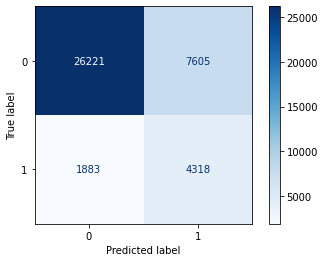

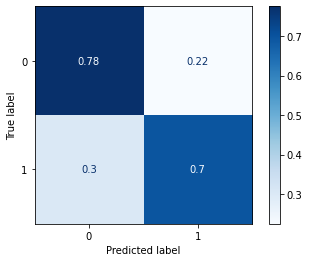

In [38]:
n = 0
df_train_2021_DP = df_train_2021 

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

train_LR_test_result2(X_train_2021_DP, y_train_2021_DP, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     "2021", "Age-30_34-DP-" + str(n), "1", df_test_2021,
                    save_dir = "Performance/")

## Model Interpretation

### Original Model

accuracy 0.7629600019986509
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33826
         1.0       0.36      0.70      0.48      6201

    accuracy                           0.76     40027
   macro avg       0.65      0.74      0.66     40027
weighted avg       0.84      0.76      0.79     40027



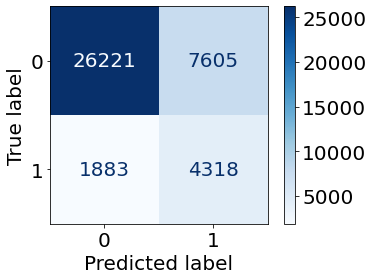

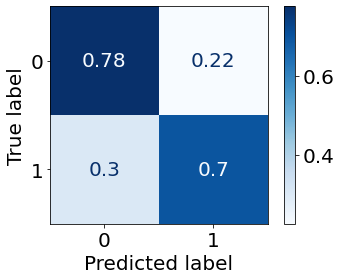

In [59]:
lr_org = LogisticRegression(solver='liblinear')
lr_org.fit(X_train_2021, y_train_2021)

pred_prob_test_lr = lr_org.predict_proba(X_test_2021)[:, 1]
pred_prob_validation_lr = lr_org.predict_proba(X_validation_2021)[:, 1]

#pred_prob_validation_lr_calibrated, pred_prob_test_lr_calibrated = isotonic(pred_prob_validation_lr, y_validation, pred_prob_test_lr)

# calibration
ir = IR(out_of_bounds='clip')
ir.fit(pred_prob_validation_lr, y_validation_2021 )
pred_prob_validation_lr_calibrated = ir.transform( pred_prob_validation_lr )
pred_prob_test_lr_calibrated = ir.transform( pred_prob_test_lr )

# thresholding
pred_test_lr = pred_label_using_threshold(pred_prob_test_lr_calibrated)

print("accuracy", accuracy_score(y_test_2021, pred_test_lr))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_lr))

cm = confusion_matrix(y_test_2021, pred_test_lr)
disp = ConfusionMatrixDisplay(cm)
disp.plot(cmap=plt.cm.Blues)

cm = confusion_matrix(y_test_2021, pred_test_lr, normalize = "true")
disp = ConfusionMatrixDisplay(cm)
disp.plot(cmap=plt.cm.Blues)

In [60]:
df = pd.DataFrame(
    {'Feature': X_train_2021.columns.to_list(),
    'Original-Co-efficient': lr_org.coef_[0]
    }
)
df

,Feature,Original-Co-efficient
0,Blood pressure,0.688723
1,Cholesterol,0.555302
2,BMI category,0.524488
3,Stroke,0.098960
4,Heart disease,0.283829
5,Consume fruits,-0.054795
6,Consume vegitables,0.011758
7,Alcoholic,-0.462305
8,Health insurance,-0.013673
9,Unaffordable healthcare,0.038384


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47]),
 [Text(0, 0, 'Blood pressure'),
  Text(1, 0, 'Kidney disease'),
  Text(2, 0, 'Cholesterol'),
  Text(3, 0, 'BMI category'),
  Text(4, 0, 'General health'),
  Text(5, 0, 'Heart disease'),
  Text(6, 0, 'Flu shot'),
  Text(7, 0, 'Difficulty seeing'),
  Text(8, 0, 'Age'),
  Text(9, 0, 'Difficulty walking'),
  Text(10, 0, 'Stroke'),
  Text(11, 0, 'Depressive disorder'),
  Text(12, 0, 'Unaffordable healthcare'),
  Text(13, 0, 'Consume vegitables'),
  Text(14, 0, 'Education'),
  Text(15, 0, 'Health insurance'),
  Text(16, 0, 'Mental health'),
  Text(17, 0, 'Income'),
  Text(18, 0, 'Physical health'),
  Text(19, 0, 'Own home'),
  Text(20, 0, 'Consume fruits'),
  Text(21, 0, 'Difficulty concentrating'),
  Text(22, 0, 'Race_American Indian'),
  Text(23, 0, 'Exercise'),
  Text(24, 0,

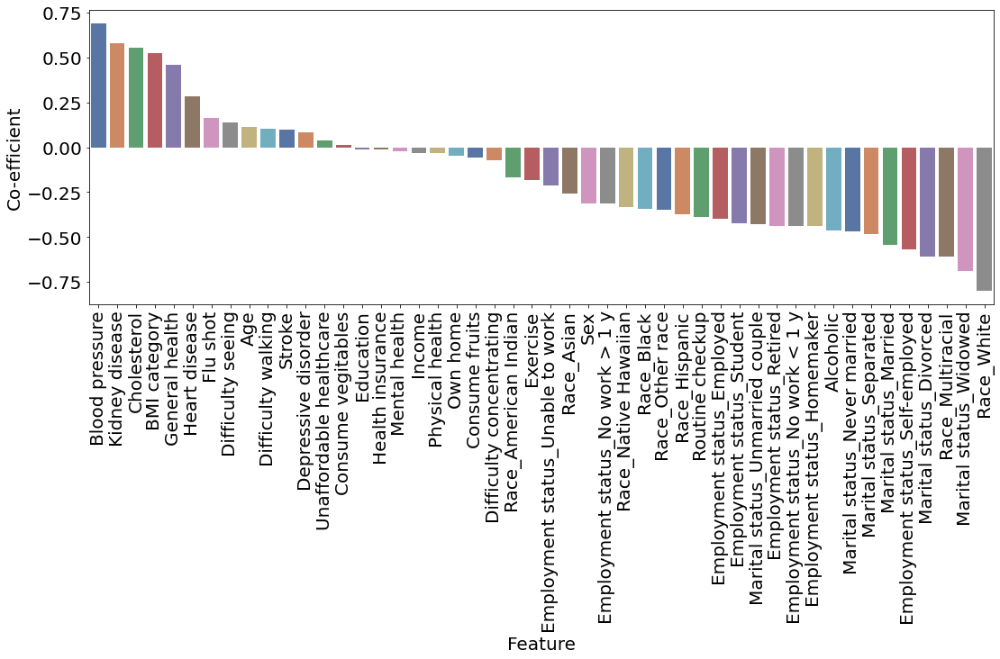

In [54]:
import seaborn as sns
x = df['Feature'] 
y = df['Co-efficient']

plt.figure(figsize=(18,6))
sns.barplot(x=x, y=y, palette="deep")
plt.xticks(rotation=90)

### DP Age 30-34

In [61]:
n = 24
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 3, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']

print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)

Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
3  group class 1:  (194, 50)
3  group class 1:  (4656, 50)  # of DP units 24
New training set:  (124737, 50)
(124737, 48) (120081, 48) (40027, 48)


accuracy 0.7636845129537562
              precision    recall  f1-score   support

         0.0       0.92      0.79      0.85     33826
         1.0       0.35      0.63      0.45      6201

    accuracy                           0.76     40027
   macro avg       0.64      0.71      0.65     40027
weighted avg       0.83      0.76      0.79     40027



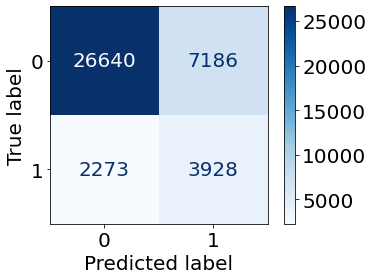

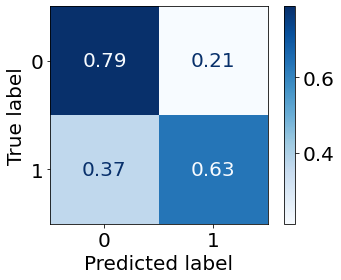

In [62]:
lr_DP_age_30_34 = LogisticRegression(solver='liblinear')
lr_DP_age_30_34.fit(X_train_2021_DP, y_train_2021_DP)

pred_prob_test_lr = lr_DP_age_30_34.predict_proba(X_test_2021)[:, 1]
pred_prob_validation_lr = lr_DP_age_30_34.predict_proba(X_validation_2021)[:, 1]

#pred_prob_validation_lr_calibrated, pred_prob_test_lr_calibrated = isotonic(pred_prob_validation_lr, y_validation, pred_prob_test_lr)

# calibration
ir = IR(out_of_bounds='clip')
ir.fit(pred_prob_validation_lr, y_validation_2021 )
pred_prob_validation_lr_calibrated = ir.transform( pred_prob_validation_lr )
pred_prob_test_lr_calibrated = ir.transform( pred_prob_test_lr )

# thresholding
pred_test_lr = pred_label_using_threshold(pred_prob_test_lr_calibrated)

print("accuracy", accuracy_score(y_test_2021, pred_test_lr))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_lr))

cm = confusion_matrix(y_test_2021, pred_test_lr)
disp = ConfusionMatrixDisplay(cm)
disp.plot(cmap=plt.cm.Blues)

cm = confusion_matrix(y_test_2021, pred_test_lr, normalize = "true")
disp = ConfusionMatrixDisplay(cm)
disp.plot(cmap=plt.cm.Blues)

In [67]:
df['DP-Age-30-34-Co-efficient'] = lr_DP_age_30_34.coef_[0]
df

,Feature,Original-Co-efficient,DP-Age-30-34-Co-efficient
0,Blood pressure,0.688723,0.668667
1,Cholesterol,0.555302,0.568744
2,BMI category,0.524488,0.460886
3,Stroke,0.098960,0.102831
4,Heart disease,0.283829,0.302623
5,Consume fruits,-0.054795,0.003341
6,Consume vegitables,0.011758,0.021243
7,Alcoholic,-0.462305,-0.429634
8,Health insurance,-0.013673,0.038021
9,Unaffordable healthcare,0.038384,0.134157


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47]),
 [Text(0, 0, 'Blood pressure'),
  Text(1, 0, 'Kidney disease'),
  Text(2, 0, 'Cholesterol'),
  Text(3, 0, 'General health'),
  Text(4, 0, 'BMI category'),
  Text(5, 0, 'Heart disease'),
  Text(6, 0, 'Difficulty seeing'),
  Text(7, 0, 'Employment status_Retired'),
  Text(8, 0, 'Flu shot'),
  Text(9, 0, 'Unaffordable healthcare'),
  Text(10, 0, 'Race_Asian'),
  Text(11, 0, 'Stroke'),
  Text(12, 0, 'Difficulty walking'),
  Text(13, 0, 'Health insurance'),
  Text(14, 0, 'Consume vegitables'),
  Text(15, 0, 'Marital status_Unmarried couple'),
  Text(16, 0, 'Consume fruits'),
  Text(17, 0, 'Depressive disorder'),
  Text(18, 0, 'Education'),
  Text(19, 0, 'Mental health'),
  Text(20, 0, 'Physical health'),
  Text(21, 0, 'Income'),
  Text(22, 0, 'Race_American Indian'),
  Text(23

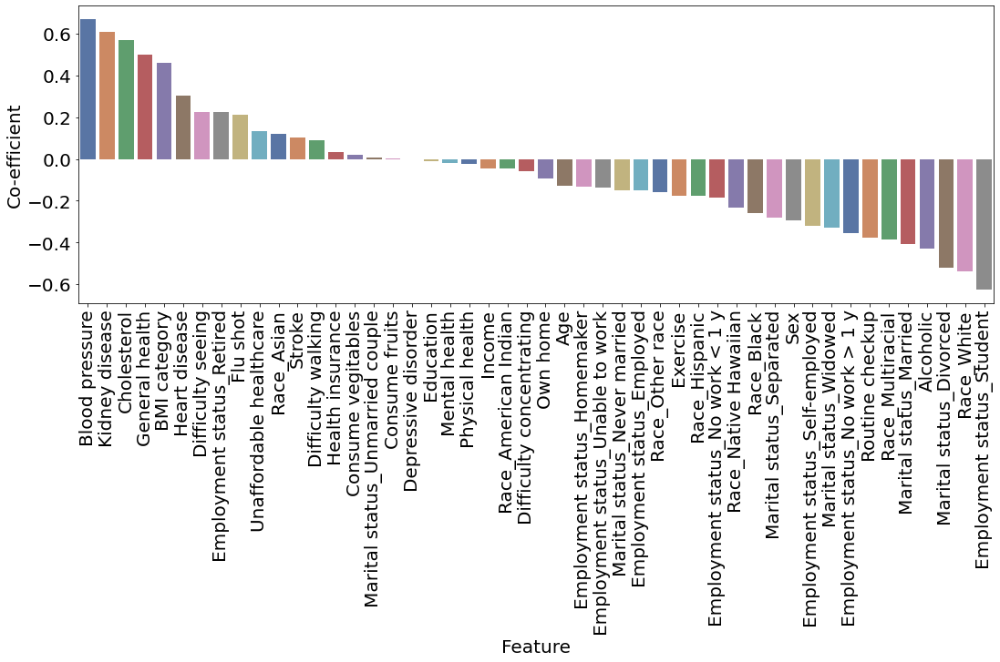

In [58]:
import seaborn as sns
x = df['Feature'] 
y = df['Co-efficient']

plt.figure(figsize=(18,6))
sns.barplot(x=x, y=y, palette="deep")
plt.xticks(rotation=90)

### DP Age 35-39

In [64]:
n = 25
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 4, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)


Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
4  group class 1:  (355, 50)
4  group class 1:  (8875, 50)  # of DP units 25
New training set:  (128956, 50)
(128956, 48) (120081, 48) (40027, 48)


accuracy 0.7525670172633473
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.84     33826
         1.0       0.34      0.63      0.44      6201

    accuracy                           0.75     40027
   macro avg       0.63      0.70      0.64     40027
weighted avg       0.83      0.75      0.78     40027



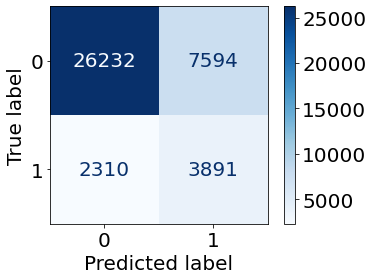

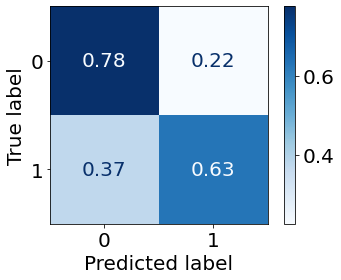

In [65]:
lr_DP_age_35_39 = LogisticRegression(solver='liblinear')
lr_DP_age_35_39.fit(X_train_2021_DP, y_train_2021_DP)

pred_prob_test_lr = lr_DP_age_35_39.predict_proba(X_test_2021)[:, 1]
pred_prob_validation_lr = lr_DP_age_35_39.predict_proba(X_validation_2021)[:, 1]

#pred_prob_validation_lr_calibrated, pred_prob_test_lr_calibrated = isotonic(pred_prob_validation_lr, y_validation, pred_prob_test_lr)

# calibration
ir = IR(out_of_bounds='clip')
ir.fit(pred_prob_validation_lr, y_validation_2021 )
pred_prob_validation_lr_calibrated = ir.transform( pred_prob_validation_lr )
pred_prob_test_lr_calibrated = ir.transform( pred_prob_test_lr )

# thresholding
pred_test_lr = pred_label_using_threshold(pred_prob_test_lr_calibrated)

print("accuracy", accuracy_score(y_test_2021, pred_test_lr))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_lr))

cm = confusion_matrix(y_test_2021, pred_test_lr)
disp = ConfusionMatrixDisplay(cm)
disp.plot(cmap=plt.cm.Blues)

cm = confusion_matrix(y_test_2021, pred_test_lr, normalize = "true")
disp = ConfusionMatrixDisplay(cm)
disp.plot(cmap=plt.cm.Blues)

In [73]:
df['DP-Age-35-39-Co-efficient'] = lr_DP_age_35_39.coef_[0]
df

,Feature,Original-Co-efficient,DP-Age-30-34-Co-efficient,DP-Age-35-39-Co-efficient
0,Blood pressure,0.688723,0.668667,0.712553
1,Cholesterol,0.555302,0.568744,0.634999
2,BMI category,0.524488,0.460886,0.484090
3,Stroke,0.098960,0.102831,0.098760
4,Heart disease,0.283829,0.302623,0.336028
5,Consume fruits,-0.054795,0.003341,-0.039744
6,Consume vegitables,0.011758,0.021243,0.046430
7,Alcoholic,-0.462305,-0.429634,-0.433749
8,Health insurance,-0.013673,0.038021,0.037947
9,Unaffordable healthcare,0.038384,0.134157,0.012524


In [70]:
n = 13
df_train_2021_DP = dp(data = df_train_2021, col = "Age", group = 5, n=n)

X_train_2021_DP = df_train_2021_DP.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_DP = df_train_2021_DP['Diabetes']
print(X_train_2021_DP.shape, X_train_2021.shape, X_test_2021.shape)


Original training dataset:  (120081, 50)
Class 1:  (18500, 50)
Class 0:  (101581, 50)
5  group class 1:  (648, 50)
5  group class 1:  (8424, 50)  # of DP units 13
New training set:  (128505, 50)
(128505, 48) (120081, 48) (40027, 48)


accuracy 0.7800484672845829
              precision    recall  f1-score   support

         0.0       0.92      0.81      0.86     33826
         1.0       0.37      0.60      0.46      6201

    accuracy                           0.78     40027
   macro avg       0.64      0.71      0.66     40027
weighted avg       0.83      0.78      0.80     40027



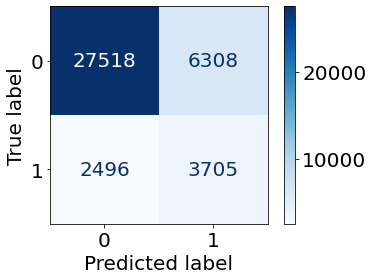

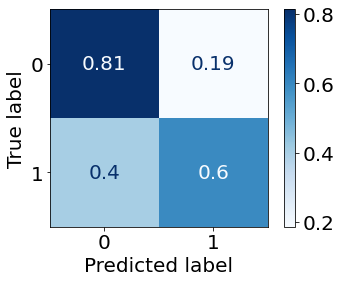

In [71]:
lr_DP_age_40_44 = LogisticRegression(solver='liblinear')
lr_DP_age_40_44.fit(X_train_2021_DP, y_train_2021_DP)

pred_prob_test_lr = lr_DP_age_40_44.predict_proba(X_test_2021)[:, 1]
pred_prob_validation_lr = lr_DP_age_40_44.predict_proba(X_validation_2021)[:, 1]

#pred_prob_validation_lr_calibrated, pred_prob_test_lr_calibrated = isotonic(pred_prob_validation_lr, y_validation, pred_prob_test_lr)

# calibration
ir = IR(out_of_bounds='clip')
ir.fit(pred_prob_validation_lr, y_validation_2021 )
pred_prob_validation_lr_calibrated = ir.transform( pred_prob_validation_lr )
pred_prob_test_lr_calibrated = ir.transform( pred_prob_test_lr )

# thresholding
pred_test_lr = pred_label_using_threshold(pred_prob_test_lr_calibrated)

print("accuracy", accuracy_score(y_test_2021, pred_test_lr))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_lr))

cm = confusion_matrix(y_test_2021, pred_test_lr)
disp = ConfusionMatrixDisplay(cm)
disp.plot(cmap=plt.cm.Blues)

cm = confusion_matrix(y_test_2021, pred_test_lr, normalize = "true")
disp = ConfusionMatrixDisplay(cm)
disp.plot(cmap=plt.cm.Blues)

In [74]:
df['DP-Age-40-44-Co-efficient'] = lr_DP_age_40_44.coef_[0]
df

,Feature,Original-Co-efficient,DP-Age-30-34-Co-efficient,DP-Age-35-39-Co-efficient,DP-Age-40-44-Co-efficient
0,Blood pressure,0.688723,0.668667,0.712553,0.709756
1,Cholesterol,0.555302,0.568744,0.634999,0.627782
2,BMI category,0.524488,0.460886,0.484090,0.544067
3,Stroke,0.098960,0.102831,0.098760,0.076973
4,Heart disease,0.283829,0.302623,0.336028,0.261839
5,Consume fruits,-0.054795,0.003341,-0.039744,-0.061141
6,Consume vegitables,0.011758,0.021243,0.046430,0.053173
7,Alcoholic,-0.462305,-0.429634,-0.433749,-0.426155
8,Health insurance,-0.013673,0.038021,0.037947,0.034167
9,Unaffordable healthcare,0.038384,0.134157,0.012524,0.045799


In [80]:
df.to_csv("LR feature importance - original and dp age.csv", index = False)

<AxesSubplot:title={'center':'Grouped Bar Graph with dataframe'}, xlabel='Feature'>

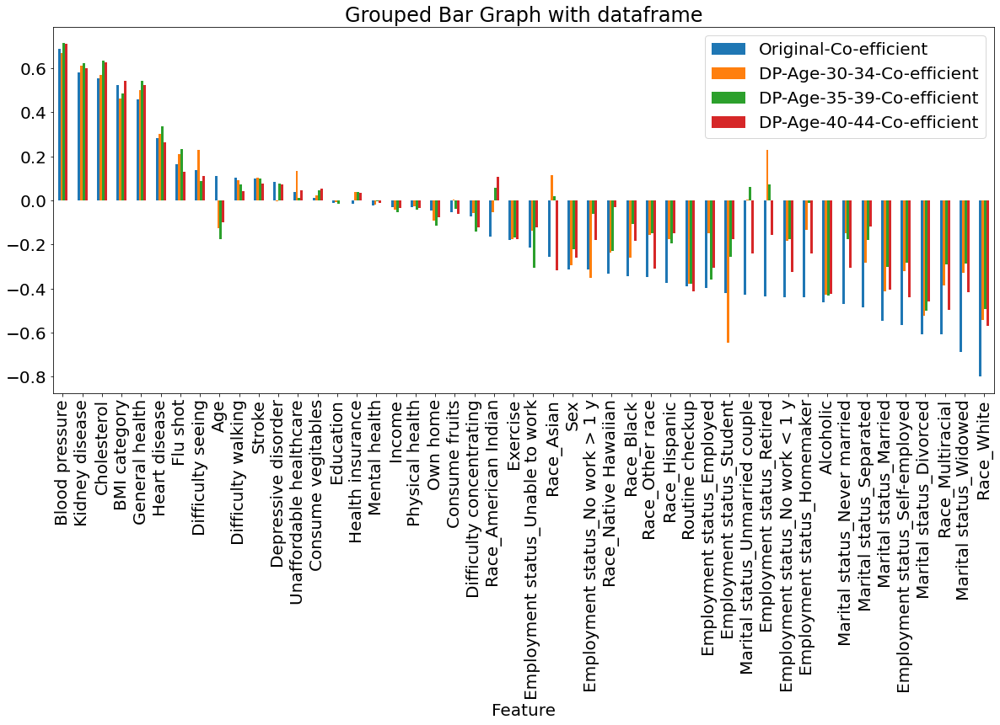

In [83]:
# plot grouped bar chart 
df = df.sort_values('Original-Co-efficient', ascending = False)
df.plot(x='Feature', 
        kind='bar', 
        stacked=False, 
        title='Grouped Bar Graph with dataframe',
        figsize=(20,8)) 

In [84]:
df

,Feature,Original-Co-efficient,DP-Age-30-34-Co-efficient,DP-Age-35-39-Co-efficient,DP-Age-40-44-Co-efficient
0,Blood pressure,0.688723,0.668667,0.712553,0.709756
20,Kidney disease,0.580904,0.611988,0.622889,0.600932
1,Cholesterol,0.555302,0.568744,0.634999,0.627782
2,BMI category,0.524488,0.460886,0.484090,0.544067
10,General health,0.457036,0.500758,0.542200,0.522876
4,Heart disease,0.283829,0.302623,0.336028,0.261839
19,Flu shot,0.165715,0.211151,0.233364,0.128906
24,Difficulty seeing,0.137158,0.228183,0.086654,0.108853
15,Age,0.111642,-0.126600,-0.175758,-0.100914
13,Difficulty walking,0.102262,0.091415,0.073379,0.043157


### Sum one hot coefficient

In [9]:
feature_importance = pd.read_csv("LR Model Coefficients/LR feature importance - original and dp age.csv")
features_list = feature_importance['Feature'].to_list()


feature_imp_org = {}
feature_imp_30_34 = {}
feature_imp_35_39 = {}
feature_imp_40_44 = {}

for i in range(len(features_list)):
  f = features_list[i]
  if '_' in f:
    temp = f.split("_")[0]

    if temp in feature_imp_org:
      feature_imp_org[temp] += feature_importance.iloc[i]['Original-Co-efficient']
      feature_imp_30_34[temp] += feature_importance.iloc[i]['DP-Age-30-34-Co-efficient']
      feature_imp_35_39[temp] += feature_importance.iloc[i]['DP-Age-35-39-Co-efficient']
      feature_imp_40_44[temp] += feature_importance.iloc[i]['DP-Age-40-44-Co-efficient']
    else:
      feature_imp_org[temp] = feature_importance.iloc[i]['Original-Co-efficient']
      feature_imp_30_34[temp] = feature_importance.iloc[i]['DP-Age-30-34-Co-efficient']
      feature_imp_35_39[temp] = feature_importance.iloc[i]['DP-Age-35-39-Co-efficient']
      feature_imp_40_44[temp] = feature_importance.iloc[i]['DP-Age-40-44-Co-efficient']
  else:
      temp = f
      feature_imp_org[temp] = feature_importance.iloc[i]['Original-Co-efficient']
      feature_imp_30_34[temp] = feature_importance.iloc[i]['DP-Age-30-34-Co-efficient']
      feature_imp_35_39[temp] = feature_importance.iloc[i]['DP-Age-35-39-Co-efficient']
      feature_imp_40_44[temp] = feature_importance.iloc[i]['DP-Age-40-44-Co-efficient']
        

feature_importance_2021_LR = pd.DataFrame({
    'Feature': feature_imp_org.keys(),
    'Original': feature_imp_org.values(),
    'DP Age 30-34': feature_imp_30_34.values(),
    'DP Age 35-39': feature_imp_35_39.values(),
    'DP Age 40-44': feature_imp_40_44.values(),}
)

feature_importance_2021_LR

,Feature,Original,DP Age 30-34,DP Age 35-39,DP Age 40-44
0,Blood pressure,0.688723,0.668667,0.712553,0.709756
1,Cholesterol,0.555302,0.568744,0.634999,0.627782
2,BMI category,0.524488,0.460886,0.484090,0.544067
3,Stroke,0.098960,0.102831,0.098760,0.076973
4,Heart disease,0.283829,0.302623,0.336028,0.261839
5,Consume fruits,-0.054795,0.003341,-0.039744,-0.061141
6,Consume vegitables,0.011758,0.021243,0.046430,0.053173
7,Alcoholic,-0.462305,-0.429634,-0.433749,-0.426155
8,Health insurance,-0.013673,0.038021,0.037947,0.034167
9,Unaffordable healthcare,0.038384,0.134157,0.012524,0.045799


In [60]:
feature_importance_2021_LR.to_csv("LR Model Coefficients/LR feature importance - original and dp age (sum).csv")

In [34]:
df = pd.read_csv("LR Model Coefficients/LR feature importance - original and dp age (sum).csv")
del df['Unnamed: 0']
df

,Feature,Original,DP Age 30-34,DP Age 35-39,DP Age 40-44
0,Blood pressure,0.688723,0.668667,0.712553,0.709756
1,Cholesterol,0.555302,0.568744,0.634999,0.627782
2,BMI category,0.524488,0.460886,0.484090,0.544067
3,Stroke,0.098960,0.102831,0.098760,0.076973
4,Heart disease,0.283829,0.302623,0.336028,0.261839
5,Consume fruits,-0.054795,0.003341,-0.039744,-0.061141
6,Consume vegitables,0.011758,0.021243,0.046430,0.053173
7,Alcoholic,-0.462305,-0.429634,-0.433749,-0.426155
8,Health insurance,-0.013673,0.038021,0.037947,0.034167
9,Unaffordable healthcare,0.038384,0.134157,0.012524,0.045799


<AxesSubplot:title={'center':'LR Coefficients'}, xlabel='Feature'>

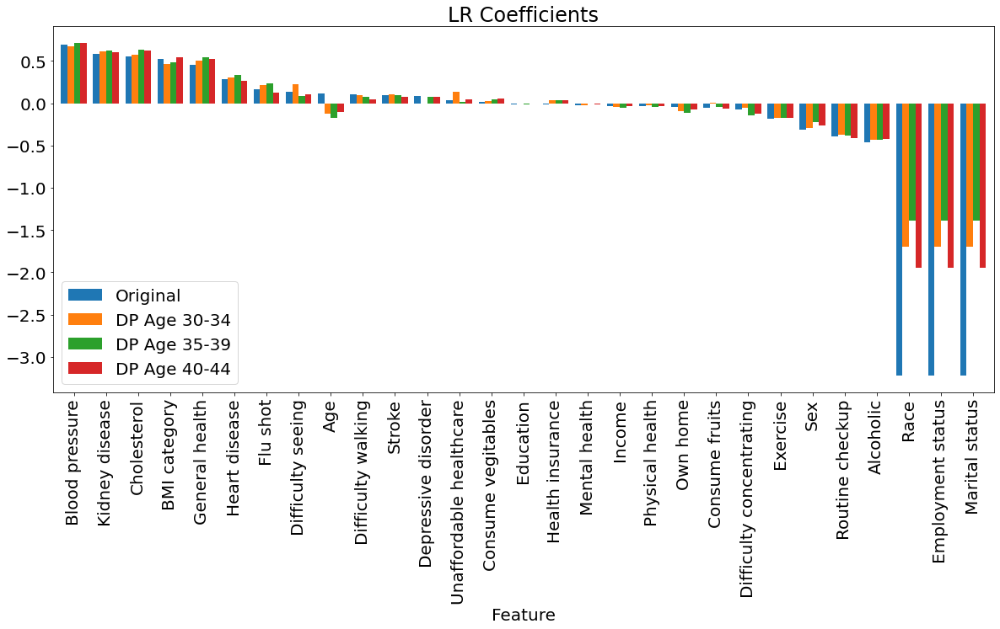

In [20]:
df = df.sort_values('Original', ascending = False)

df.plot(x='Feature', 
        kind='bar', 
        stacked=False, 
        title='LR Coefficients',
        width=0.8,
        figsize=(20,8)) 

Text(0, 0.5, 'Feature')

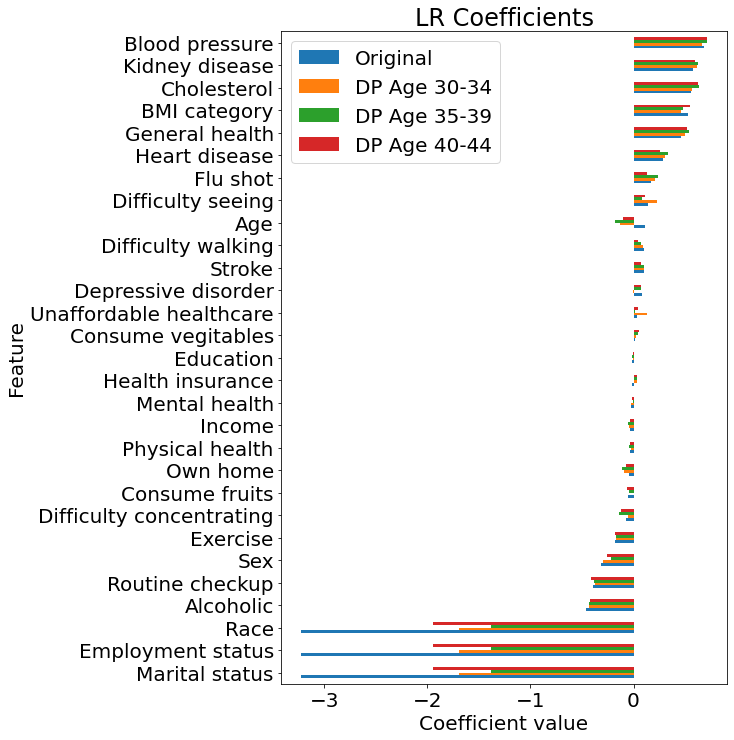

In [8]:
df = df.sort_values('Original', ascending = True)
ax = df.plot.barh(x='Feature', 
        stacked=False, 
        title='LR Coefficients',
        figsize=(8,12)) 

ax.set_xlabel("Coefficient value")
ax.set_ylabel("Feature")

Text(0, 0.5, 'Feature')

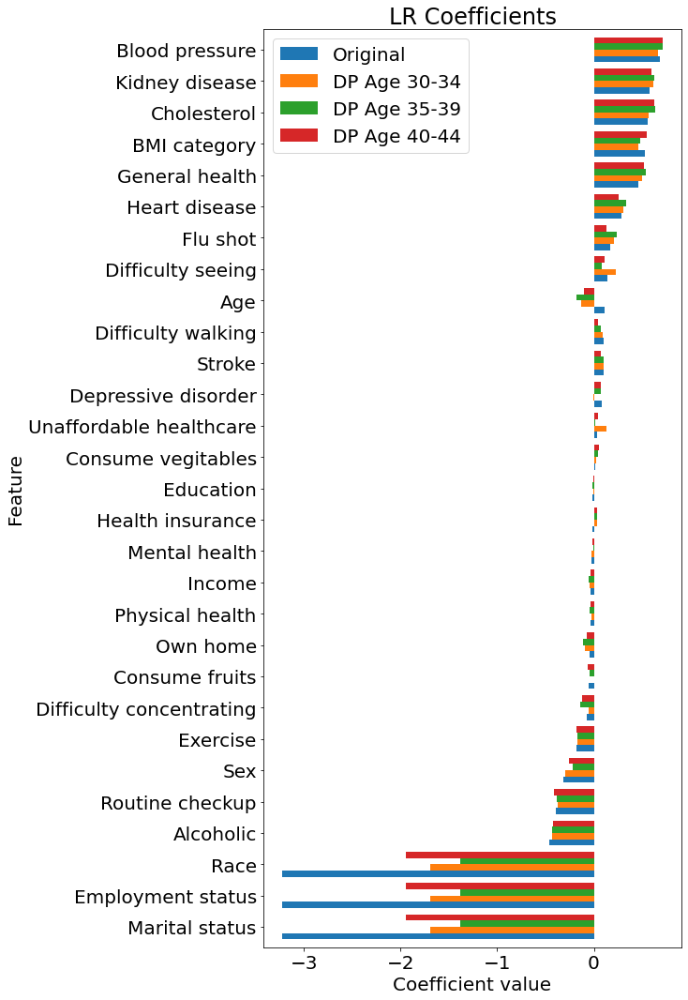

In [35]:
df = df.sort_values('Original', ascending = True)
ax = df.plot.barh(x='Feature', 
        stacked=False, 
        title='LR Coefficients',
        width=0.8,
        figsize=(8,18)) 

ax.set_xlabel("Coefficient value")
ax.set_ylabel("Feature")

In [36]:
ax.figure.savefig('LR Model Coefficients/LR feature importance - original and dp age-30-44 - sum (8x18).png', 
                  format='png', dpi=400 , bbox_inches='tight')

### Average one hot coefficients

In [38]:
#df = feature_importance_2021_LR.copy()

df.loc[df['Feature'] == 'Marital status', ['Original','DP Age 30-34', 'DP Age 35-39','DP Age 40-44']] = df.loc[df['Feature'] == 'Marital status', ['Original','DP Age 30-34', 'DP Age 35-39','DP Age 40-44']].apply(lambda x: x/6)
df.loc[df['Feature'] == 'Employment status', ['Original','DP Age 30-34', 'DP Age 35-39','DP Age 40-44']] = df.loc[df['Feature'] == 'Employment status', ['Original','DP Age 30-34', 'DP Age 35-39','DP Age 40-44']].apply(lambda x: x/8)
df.loc[df['Feature'] == 'Race', ['Original','DP Age 30-34', 'DP Age 35-39','DP Age 40-44']] = df.loc[df['Feature'] == 'Race', ['Original','DP Age 30-34', 'DP Age 35-39','DP Age 40-44']].apply(lambda x: x/8)


df

,Feature,Original,DP Age 30-34,DP Age 35-39,DP Age 40-44
28,Marital status,-0.537604,-0.282777,-0.231033,-0.324694
27,Employment status,-0.403203,-0.212082,-0.173275,-0.243521
26,Race,-0.403203,-0.212082,-0.173275,-0.243521
7,Alcoholic,-0.462305,-0.429634,-0.433749,-0.426155
18,Routine checkup,-0.389240,-0.377236,-0.380063,-0.413235
14,Sex,-0.312199,-0.292799,-0.222354,-0.260638
23,Exercise,-0.181622,-0.174292,-0.168627,-0.175080
25,Difficulty concentrating,-0.073222,-0.057122,-0.141103,-0.121150
5,Consume fruits,-0.054795,0.003341,-0.039744,-0.061141
22,Own home,-0.045414,-0.093028,-0.114650,-0.075305


Text(0, 0.5, 'Feature')

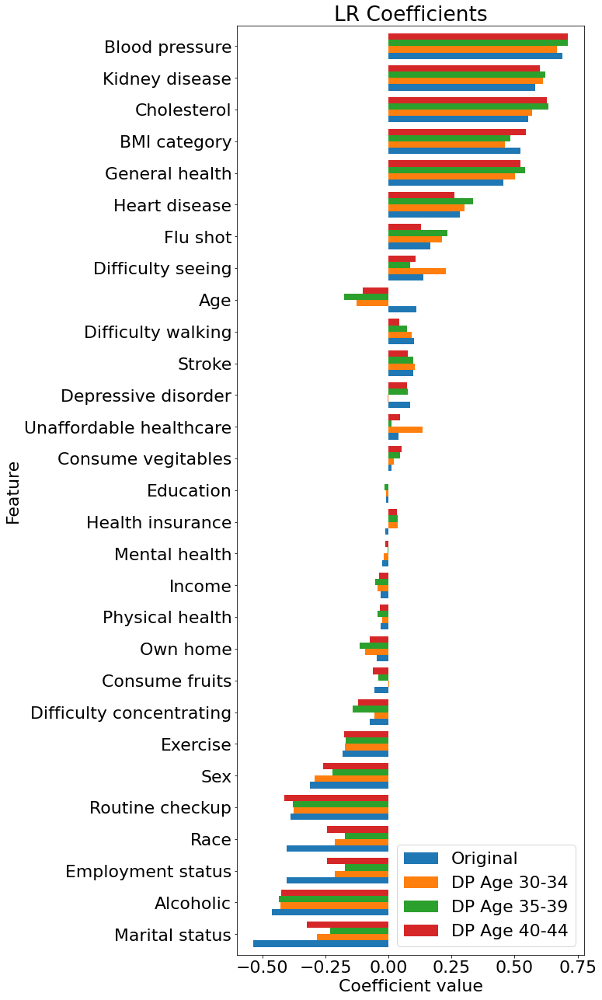

In [40]:
df = df.sort_values('Original', ascending = True)

ax = df.plot.barh(x='Feature', 
        stacked=False, 
        title='LR Coefficients',
        width = 0.8,
        figsize=(8,22)) 

ax.set_xlabel("Coefficient value")
ax.set_ylabel("Feature")

In [41]:
ax.figure.savefig('LR Model Coefficients/LR feature importance - original and dp age (avg) 8x22.png', 
                  format='png', dpi=400 , bbox_inches='tight')

In [61]:
df.to_csv("LR Model Coefficients/LR feature importance - original and dp age (avg).csv")

Text(0, 0.5, 'Feature')

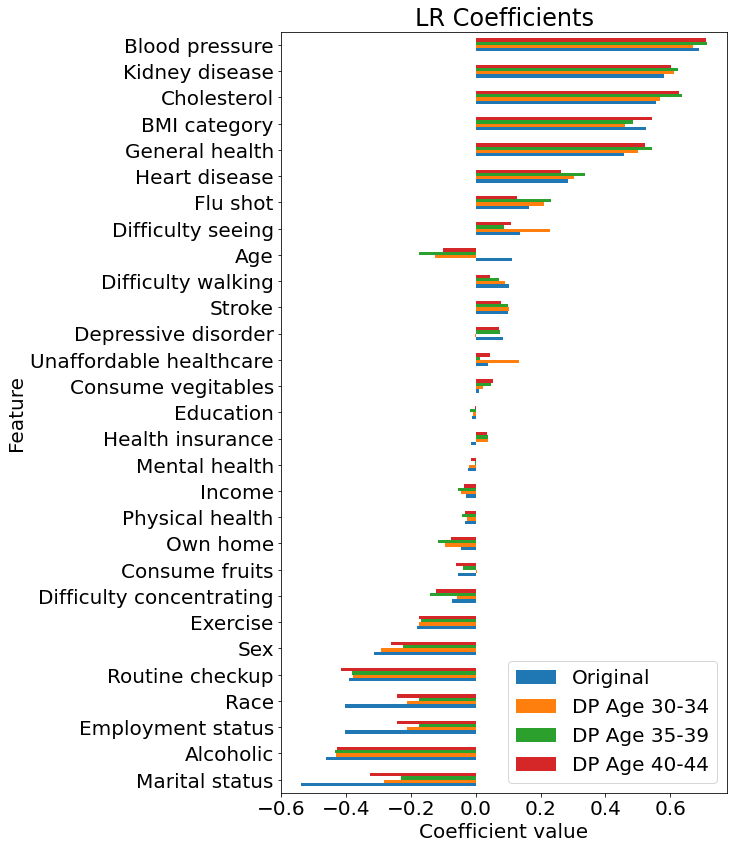

In [6]:
df = pd.read_csv("LR Model Coefficients/LR feature importance - original and dp age (avg).csv")
df.drop(['Unnamed: 0'], axis=1, inplace=True)

ax = df.plot.barh(x='Feature', 
        stacked=False, 
        title='LR Coefficients',
        figsize=(8,14)) 

ax.set_xlabel("Coefficient value")
ax.set_ylabel("Feature")

In [7]:
ax.figure.savefig('LR Model Coefficients/LR feature importance - original and dp age (avg) - 8x14.png', 
                  format='png', dpi=300 , bbox_inches='tight')

# Sampling Methods

## Slip dataset

In [8]:
random_state = 1
df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)


(200136, 50) (120081, 50) (40027, 50) (40028, 50)
(120081, 48) (40027, 48) (40028, 48)


In [ ]:
random_state = 2
df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)

In [ ]:
random_state = 3
df_train_2021, df_test_2021 = train_test_split(brfss_2021_one_hot, test_size=0.4, random_state=random_state)
df_test_2021, df_validation_2021 = train_test_split(df_test_2021, test_size=0.5, random_state=random_state)
print(brfss_2021_one_hot.shape, df_train_2021.shape, df_test_2021.shape, df_validation_2021.shape)

X_train_2021 = df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

X_test_2021 = df_test_2021.drop(['Diabetes', 'Race'],axis=1)
y_test_2021 = df_test_2021['Diabetes']
y_test_2021 = y_test_2021.to_numpy()

X_validation_2021 = df_validation_2021.drop(['Diabetes', 'Race'],axis=1)
y_validation_2021 = df_validation_2021['Diabetes']
y_validation_2021 = y_validation_2021.to_numpy()

print(X_train_2021.shape, X_test_2021.shape, X_validation_2021.shape)


## Oversampling

In [18]:
import pandas as pd
from imblearn.over_sampling import RandomOverSampler

oversampler = RandomOverSampler(sampling_strategy='minority')
X_oversampled, y_oversampled = oversampler.fit_resample(X_train_2021, y_train_2021)

print(X_oversampled.shape)
print(y_train_2021.value_counts())
print(y_oversampled.value_counts())


(203162, 48)
0.0    101581
1.0     18500
Name: Diabetes, dtype: int64
1.0    101581
0.0    101581
Name: Diabetes, dtype: int64


In [24]:
train_LR_test_result(X_oversampled, y_oversampled, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "Oversampled",
                     save_dir = "Performance-LR/")

accuracy 0.7618607439978015
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.85     33826
         1.0       0.36      0.70      0.48      6201

    accuracy                           0.76     40027
   macro avg       0.65      0.74      0.66     40027
weighted avg       0.84      0.76      0.79     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6990807934204161
Class 1 Precision: 0.36121989834180485
Class 1 Area Under Precision-Recall Curve: 0.4331638430122203
Class 1 F1-Score: 0.4763212833754532
Class 0 Recall: 0.77336959735115
Class 0 Precision: 0.9334189681010491
Class 0 Area Under Precision-Recall Curve: 0.7200326066805285
Class 0 F1-Score: 0.8458901894845761
Overall Accuracy: 0.7618607439978015
Balanced Accuracy: 0.736225195385783
Area Under ROC Curve: 0.8216410270903354
Matthews Correlation Coefficient: 0.3730981741946985
0.6990807934204161
0.36121989834180485
0.433163843012

Class 1 Recall: 0.7410881801125704
Class 1 Precision: 0.4144805876180483
Class 1 Area Under Precision-Recall Curve: 0.5060473589489272
Class 1 F1-Score: 0.531628532974428
Class 0 Recall: 0.7567567567567568
Class 0 Precision: 0.9263607257203842
Class 0 Area Under Precision-Recall Curve: 0.6637605635642971
Class 0 F1-Score: 0.8330134357005757
Overall Accuracy: 0.7538026176158472
Balanced Accuracy: 0.7489224684346636
Area Under ROC Curve: 0.8342924113970533
Matthews Correlation Coefficient: 0.4119297538676108
0.7410881801125704
0.4144805876180483
0.5060473589489272
0.531628532974428
0.7567567567567568
0.9263607257203842
0.6637605635642971
0.8330134357005757
0.7538026176158472
0.7489224684346636
0.8342924113970533
0.4119297538676108
============================  30-34 ============================ 
Class 1 Recall: 0.24561403508771928
Class 1 Precision: 0.17721518987341772
Class 1 Area Under Precision-Recall Curve: 0.17114677175651075
Class 1 F1-Score: 0.20588235294117646
Class 0 Recall: 0.9

============================  80-99 ============================ 
Class 1 Recall: 0.7912885662431942
Class 1 Precision: 0.2800256904303147
Class 1 Area Under Precision-Recall Curve: 0.36973676842731606
Class 1 F1-Score: 0.41366223908918404
Class 0 Recall: 0.5006681514476615
Class 0 Precision: 0.9071832122679581
Class 0 Area Under Precision-Recall Curve: 0.7006390296374618
Class 0 F1-Score: 0.6452353616532722
Overall Accuracy: 0.5579399141630901
Balanced Accuracy: 0.6459783588454279
Area Under ROC Curve: 0.712611206997603
Matthews Correlation Coefficient: 0.233788145025137
0.7912885662431942
0.2800256904303147
0.36973676842731606
0.41366223908918404
0.5006681514476615
0.9071832122679581
0.7006390296374618
0.6452353616532722
0.5579399141630901
0.6459783588454279
0.712611206997603
0.233788145025137


## Undersampling

In [25]:
from imblearn.under_sampling import RandomUnderSampler

undersampler = RandomUnderSampler(random_state=1)
X_undersampled, y_undersampled = undersampler.fit_resample(X_train_2021, y_train_2021)

print(X_undersampled.shape)
print(y_train_2021.value_counts())
print(y_undersampled.value_counts())

(37000, 48)
0.0    101581
1.0     18500
Name: Diabetes, dtype: int64
1.0    18500
0.0    18500
Name: Diabetes, dtype: int64


In [26]:
train_LR_test_result(X_undersampled, y_undersampled, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "Undersampled",
                     save_dir = "Performance-LR/")

accuracy 0.7597621605416344
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     33826
         1.0       0.36      0.70      0.48      6201

    accuracy                           0.76     40027
   macro avg       0.65      0.74      0.66     40027
weighted avg       0.85      0.76      0.79     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.7039187227866474
Class 1 Precision: 0.35940716344174556
Class 1 Area Under Precision-Recall Curve: 0.43311742128949027
Class 1 F1-Score: 0.47585304698571895
Class 0 Recall: 0.76999940873884
Class 0 Precision: 0.934151065203357
Class 0 Area Under Precision-Recall Curve: 0.7199385143988714
Class 0 F1-Score: 0.8441693135411941
Overall Accuracy: 0.7597621605416344
Balanced Accuracy: 0.7369590657627436
Area Under ROC Curve: 0.8214831643652724
Matthews Correlation Coefficient: 0.3729913768620111
0.7039187227866474
0.35940716344174556
0.4331174212

Class 1 Recall: 0.7485928705440901
Class 1 Precision: 0.4063136456211813
Class 1 Area Under Precision-Recall Curve: 0.5062458929464886
Class 1 F1-Score: 0.5267326732673268
Class 0 Recall: 0.7458587619877942
Class 0 Precision: 0.9273712737127371
Class 0 Area Under Precision-Recall Curve: 0.6637965163308495
Class 0 F1-Score: 0.8267697511476202
Overall Accuracy: 0.7463742483197736
Balanced Accuracy: 0.7472258162659422
Area Under ROC Curve: 0.8341370178506291
Matthews Correlation Coefficient: 0.4061909072295022
0.7485928705440901
0.4063136456211813
0.5062458929464886
0.5267326732673268
0.7458587619877942
0.9273712737127371
0.6637965163308495
0.8267697511476202
0.7463742483197736
0.7472258162659422
0.8341370178506291
0.4061909072295022
============================  30-34 ============================ 
Class 1 Recall: 0.2631578947368421
Class 1 Precision: 0.1875
Class 1 Area Under Precision-Recall Curve: 0.16989478630662186
Class 1 F1-Score: 0.21897810218978103
Class 0 Recall: 0.9697110904007

Class 1 Recall: 0.7985480943738656
Class 1 Precision: 0.2779532533164877
Class 1 Area Under Precision-Recall Curve: 0.37183571781974856
Class 1 F1-Score: 0.41237113402061853
Class 0 Recall: 0.4908685968819599
Class 0 Precision: 0.9084913437757626
Class 0 Area Under Precision-Recall Curve: 0.7001078354221602
Class 0 F1-Score: 0.6373626373626374
Overall Accuracy: 0.5515021459227468
Balanced Accuracy: 0.6447083456279128
Area Under ROC Curve: 0.7132627860258126
Matthews Correlation Coefficient: 0.2322933025142236
0.7985480943738656
0.2779532533164877
0.37183571781974856
0.41237113402061853
0.4908685968819599
0.9084913437757626
0.7001078354221602
0.6373626373626374
0.5515021459227468
0.6447083456279128
0.7132627860258126
0.2322933025142236


## SMOTE

In [27]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(sampling_strategy='auto')
X_resampled, y_resampled = smote.fit_resample(X_train_2021, y_train_2021)

print(X_resampled.shape)
print(y_train_2021.value_counts())
print(y_resampled.value_counts())

(203162, 48)
0.0    101581
1.0     18500
Name: Diabetes, dtype: int64
1.0    101581
0.0    101581
Name: Diabetes, dtype: int64


In [28]:
train_LR_test_result(X_resampled, y_resampled, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "SMOTE-auto",
                     save_dir = "Performance-LR/")

accuracy 0.761211182451845
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.85     33826
         1.0       0.35      0.64      0.45      6201

    accuracy                           0.76     40027
   macro avg       0.64      0.71      0.65     40027
weighted avg       0.83      0.76      0.79     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6379616190936945
Class 1 Precision: 0.3510515573697755
Class 1 Area Under Precision-Recall Curve: 0.3967756564033948
Class 1 F1-Score: 0.4528906697195192
Class 0 Recall: 0.7838053568261101
Class 0 Precision: 0.9219347659781626
Class 0 Area Under Precision-Recall Curve: 0.7294756840115151
Class 0 F1-Score: 0.8472772593634156
Overall Accuracy: 0.761211182451845
Balanced Accuracy: 0.7108834879599023
Area Under ROC Curve: 0.7978801256471442
Matthews Correlation Coefficient: 0.33931786876898457
0.6379616190936945
0.3510515573697755
0.396775656403

Class 1 Recall: 0.5121951219512195
Class 1 Precision: 0.4666666666666667
Class 1 Area Under Precision-Recall Curve: 0.47687725191101493
Class 1 F1-Score: 0.48837209302325585
Class 0 Recall: 0.8639930252833479
Class 0 Precision: 0.8840321141837645
Class 0 Area Under Precision-Recall Curve: 0.6719676438165609
Class 0 F1-Score: 0.8738977072310407
Overall Accuracy: 0.7976653696498055
Balanced Accuracy: 0.6880940736172837
Area Under ROC Curve: 0.8129217094598683
Matthews Correlation Coefficient: 0.3632199397135918
0.5121951219512195
0.4666666666666667
0.47687725191101493
0.48837209302325585
0.8639930252833479
0.8840321141837645
0.6719676438165609
0.8738977072310407
0.7976653696498055
0.6880940736172837
0.8129217094598683
0.3632199397135918
============================  30-34 ============================ 
Class 1 Recall: 0.19298245614035087
Class 1 Precision: 0.15942028985507245
Class 1 Area Under Precision-Recall Curve: 0.15244234420111688
Class 1 F1-Score: 0.1746031746031746
Class 0 Recall

Matthews Correlation Coefficient: 0.2886935452207578
0.7548476454293629
0.364061456245825
0.4601340208031397
0.491212257773772
0.5830048182216382
0.8826259946949602
0.6348097629378553
0.7021893959377473
0.6242928452579035
0.6689262318255005
0.7386721437385566
0.2886935452207578
============================  80-99 ============================ 
Class 1 Recall: 0.7368421052631579
Class 1 Precision: 0.2897930049964311
Class 1 Area Under Precision-Recall Curve: 0.3548747910692772
Class 1 F1-Score: 0.41598360655737704
Class 0 Recall: 0.5567928730512249
Class 0 Precision: 0.8960573476702509
Class 0 Area Under Precision-Recall Curve: 0.7071747953541381
Class 0 F1-Score: 0.6868131868131867
Overall Accuracy: 0.592274678111588
Balanced Accuracy: 0.6468174891571914
Area Under ROC Curve: 0.6964866470761806
Matthews Correlation Coefficient: 0.23360685836464984
0.7368421052631579
0.2897930049964311
0.3548747910692772
0.41598360655737704
0.5567928730512249
0.8960573476702509
0.7071747953541381
0.68681

## ADASYN

In [29]:
from imblearn.over_sampling import ADASYN

adasyn = ADASYN(sampling_strategy='auto')
X_resampled, y_resampled = adasyn.fit_resample(X_train_2021, y_train_2021)

print(X_resampled.shape)
print(y_train_2021.value_counts())
print(y_resampled.value_counts())

(203137, 48)
0.0    101581
1.0     18500
Name: Diabetes, dtype: int64
0.0    101581
1.0    101556
Name: Diabetes, dtype: int64


In [30]:
train_LR_test_result(X_resampled, y_resampled, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "ADASYN-auto",
                     save_dir = "Performance-LR/")

accuracy 0.754815499537812
              precision    recall  f1-score   support

         0.0       0.92      0.78      0.84     33826
         1.0       0.34      0.64      0.45      6201

    accuracy                           0.75     40027
   macro avg       0.63      0.71      0.65     40027
weighted avg       0.83      0.75      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6416706982744719
Class 1 Precision: 0.34387693371359435
Class 1 Area Under Precision-Recall Curve: 0.39045533910131136
Class 1 F1-Score: 0.4477830294845825
Class 0 Recall: 0.7755572636433513
Class 0 Precision: 0.9219145347202699
Class 0 Area Under Precision-Recall Curve: 0.7312982737105899
Class 0 F1-Score: 0.8424263832246878
Overall Accuracy: 0.754815499537812
Balanced Accuracy: 0.7086139809589116
Area Under ROC Curve: 0.7934223301996111
Matthews Correlation Coefficient: 0.33300995881475765
0.6416706982744719
0.34387693371359435
0.390455339

Class 1 Recall: 0.49906191369606
Class 1 Precision: 0.4642233856893543
Class 1 Area Under Precision-Recall Curve: 0.4707133610626831
Class 1 F1-Score: 0.4810126582278481
Class 0 Recall: 0.8661726242371404
Class 0 Precision: 0.8815439219165927
Class 0 Area Under Precision-Recall Curve: 0.6736026424666978
Class 0 F1-Score: 0.8737906772207564
Overall Accuracy: 0.7969579059073223
Balanced Accuracy: 0.6826172689666001
Area Under ROC Curve: 0.8091358319525117
Matthews Correlation Coefficient: 0.35536764459621933
0.49906191369606
0.4642233856893543
0.4707133610626831
0.4810126582278481
0.8661726242371404
0.8815439219165927
0.6736026424666978
0.8737906772207564
0.7969579059073223
0.6826172689666001
0.8091358319525117
0.35536764459621933
============================  30-34 ============================ 
Class 1 Recall: 0.19298245614035087
Class 1 Precision: 0.14864864864864866
Class 1 Area Under Precision-Recall Curve: 0.1474317024227138
Class 1 F1-Score: 0.16793893129770993
Class 0 Recall: 0.97

# TOMEK-LINKS

In [31]:
from imblearn.under_sampling import TomekLinks

tomek_links = TomekLinks(sampling_strategy='auto')
X_resampled, y_resampled = tomek_links.fit_resample(X_train_2021, y_train_2021)

print(X_resampled.shape)
print(y_train_2021.value_counts())
print(y_resampled.value_counts())

(117004, 48)
0.0    101581
1.0     18500
Name: Diabetes, dtype: int64
0.0    98504
1.0    18500
Name: Diabetes, dtype: int64


In [32]:
train_LR_test_result(X_resampled, y_resampled, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "Tomek-Links-auto",
                     save_dir = "Performance-LR/")

accuracy 0.7635346141354585
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85     33826
         1.0       0.36      0.69      0.48      6201

    accuracy                           0.76     40027
   macro avg       0.65      0.73      0.66     40027
weighted avg       0.84      0.76      0.79     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6926302209321077
Class 1 Precision: 0.3623249536021596
Class 1 Area Under Precision-Recall Curve: 0.4368421010273551
Class 1 F1-Score: 0.47576848518415943
Class 0 Recall: 0.776532844557441
Class 0 Precision: 0.9323465729599262
Class 0 Area Under Precision-Recall Curve: 0.7194971192554056
Class 0 F1-Score: 0.8473362473588283
Overall Accuracy: 0.7635346141354585
Balanced Accuracy: 0.7345815327447743
Area Under ROC Curve: 0.8217172612588554
Matthews Correlation Coefficient: 0.3718184996935375
0.6926302209321077
0.3623249536021596
0.43684210102

Class 1 Recall: 0.7317073170731707
Class 1 Precision: 0.4096638655462185
Class 1 Area Under Precision-Recall Curve: 0.5056965735850458
Class 1 F1-Score: 0.5252525252525252
Class 0 Recall: 0.7550130775937227
Class 0 Precision: 0.9237333333333333
Class 0 Area Under Precision-Recall Curve: 0.6641196972270696
Class 0 F1-Score: 0.8308946989685776
Overall Accuracy: 0.7506190307746728
Balanced Accuracy: 0.7433601973334467
Area Under ROC Curve: 0.832878330124593
Matthews Correlation Coefficient: 0.4028290161091828
0.7317073170731707
0.4096638655462185
0.5056965735850458
0.5252525252525252
0.7550130775937227
0.9237333333333333
0.6641196972270696
0.8308946989685776
0.7506190307746728
0.7433601973334467
0.832878330124593
0.4028290161091828
============================  30-34 ============================ 
Class 1 Recall: 0.2807017543859649
Class 1 Precision: 0.17582417582417584
Class 1 Area Under Precision-Recall Curve: 0.17192786948451672
Class 1 F1-Score: 0.2162162162162162
Class 0 Recall: 0.965

Class 1 Recall: 0.7604355716878403
Class 1 Precision: 0.2827260458839406
Class 1 Area Under Precision-Recall Curve: 0.37062717225851305
Class 1 F1-Score: 0.41219872110182
Class 0 Recall: 0.5265033407572383
Class 0 Precision: 0.8995433789954338
Class 0 Area Under Precision-Recall Curve: 0.7003884151411539
Class 0 F1-Score: 0.664231525709469
Overall Accuracy: 0.5726037195994278
Balanced Accuracy: 0.6434694562225393
Area Under ROC Curve: 0.7126524359435567
Matthews Correlation Coefficient: 0.22869234912186642
0.7604355716878403
0.2827260458839406
0.37062717225851305
0.41219872110182
0.5265033407572383
0.8995433789954338
0.7003884151411539
0.664231525709469
0.5726037195994278
0.6434694562225393
0.7126524359435567
0.22869234912186642


# ENN (Edited Nearest Neighbors) - Undersampling

In [33]:
from imblearn.under_sampling import EditedNearestNeighbours

enn_sampler = EditedNearestNeighbours(sampling_strategy='auto', n_neighbors=3)
X_resampled, y_resampled = enn_sampler.fit_resample(X_train_2021, y_train_2021)

print(X_resampled.shape)
print(y_train_2021.value_counts())
print(y_resampled.value_counts())


(92247, 48)
0.0    101581
1.0     18500
Name: Diabetes, dtype: int64
0.0    73747
1.0    18500
Name: Diabetes, dtype: int64


In [34]:
train_LR_test_result(X_resampled, y_resampled, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "ENN-3",
                     save_dir = "Performance-LR/")

accuracy 0.7534414270367502
              precision    recall  f1-score   support

         0.0       0.94      0.76      0.84     33826
         1.0       0.35      0.72      0.47      6201

    accuracy                           0.75     40027
   macro avg       0.64      0.74      0.66     40027
weighted avg       0.85      0.75      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.7150459603289792
Class 1 Precision: 0.35370134014039567
Class 1 Area Under Precision-Recall Curve: 0.4336355479036489
Class 1 F1-Score: 0.4732881464482041
Class 0 Recall: 0.7604801040619642
Class 0 Precision: 0.9357244189007311
Class 0 Area Under Precision-Recall Curve: 0.7198145164430708
Class 0 F1-Score: 0.8390495294942676
Overall Accuracy: 0.7534414270367502
Balanced Accuracy: 0.7377630321954717
Area Under ROC Curve: 0.8215778295581819
Matthews Correlation Coefficient: 0.37098449041730647
0.7150459603289792
0.35370134014039567
0.43363554

Class 1 Recall: 0.7579737335834896
Class 1 Precision: 0.4084934277047523
Class 1 Area Under Precision-Recall Curve: 0.503477156517401
Class 1 F1-Score: 0.5308804204993429
Class 0 Recall: 0.7449869224062773
Class 0 Precision: 0.9298150163220892
Class 0 Area Under Precision-Recall Curve: 0.6644820326180063
Class 0 F1-Score: 0.8272023233301065
Overall Accuracy: 0.7474354439334984
Balanced Accuracy: 0.7514803279948834
Area Under ROC Curve: 0.8322534844958133
Matthews Correlation Coefficient: 0.4124994993143841
0.7579737335834896
0.4084934277047523
0.503477156517401
0.5308804204993429
0.7449869224062773
0.9298150163220892
0.6644820326180063
0.8272023233301065
0.7474354439334984
0.7514803279948834
0.8322534844958133
0.4124994993143841
============================  30-34 ============================ 
Class 1 Recall: 0.3157894736842105
Class 1 Precision: 0.1935483870967742
Class 1 Area Under Precision-Recall Curve: 0.16989059218788277
Class 1 F1-Score: 0.24000000000000002
Class 0 Recall: 0.965

============================  80-99 ============================ 
Class 1 Recall: 0.7912885662431942
Class 1 Precision: 0.2759493670886076
Class 1 Area Under Precision-Recall Curve: 0.37105077711358725
Class 1 F1-Score: 0.40919755983106526
Class 0 Recall: 0.4904231625835189
Class 0 Precision: 0.9054276315789473
Class 0 Area Under Precision-Recall Curve: 0.7000314610235456
Class 0 F1-Score: 0.6362323028026582
Overall Accuracy: 0.5497138769670958
Balanced Accuracy: 0.6408558644133566
Area Under ROC Curve: 0.7141277854801352
Matthews Correlation Coefficient: 0.22604430509092094
0.7912885662431942
0.2759493670886076
0.37105077711358725
0.40919755983106526
0.4904231625835189
0.9054276315789473
0.7000314610235456
0.6362323028026582
0.5497138769670958
0.6408558644133566
0.7141277854801352
0.22604430509092094


# Near Miss

In [35]:
from imblearn.under_sampling import NearMiss

nearmiss_sampler = NearMiss(sampling_strategy='auto', version=1)
X_resampled, y_resampled = nearmiss_sampler.fit_resample(X_train_2021, y_train_2021)

print(X_resampled.shape)
print(y_train_2021.value_counts())
print(y_resampled.value_counts())

(37000, 48)
0.0    101581
1.0     18500
Name: Diabetes, dtype: int64
1.0    18500
0.0    18500
Name: Diabetes, dtype: int64


In [36]:
train_LR_test_result(X_resampled, y_resampled, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "Near-Miss",
                     save_dir = "Performance-LR/")

accuracy 0.720613585829565
              precision    recall  f1-score   support

         0.0       0.88      0.77      0.82     33826
         1.0       0.26      0.45      0.33      6201

    accuracy                           0.72     40027
   macro avg       0.57      0.61      0.58     40027
weighted avg       0.79      0.72      0.75     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.44686340912756006
Class 1 Precision: 0.2633029266438616
Class 1 Area Under Precision-Recall Curve: 0.26067414333336797
Class 1 F1-Score: 0.3313602391629297
Class 0 Recall: 0.7707976113049134
Class 0 Precision: 0.8837406365454361
Class 0 Area Under Precision-Recall Curve: 0.7764514398678373
Class 0 F1-Score: 0.8234142336054573
Overall Accuracy: 0.720613585829565
Balanced Accuracy: 0.6088305102162368
Area Under ROC Curve: 0.6795977417961847
Matthews Correlation Coefficient: 0.17890123535573876
0.44686340912756006
0.2633029266438616
0.260674143

Class 1 Recall: 0.7317073170731707
Class 1 Precision: 0.23522316043425814
Class 1 Area Under Precision-Recall Curve: 0.29432382899556886
Class 1 F1-Score: 0.35600182565038796
Class 0 Recall: 0.44725370531822145
Class 0 Precision: 0.8776732249786142
Class 0 Area Under Precision-Recall Curve: 0.7399917880733113
Class 0 F1-Score: 0.5925498123014727
Overall Accuracy: 0.500884329678104
Balanced Accuracy: 0.5894805111956961
Area Under ROC Curve: 0.6465786430381237
Matthews Correlation Coefficient: 0.14214096016905292
0.7317073170731707
0.23522316043425814
0.29432382899556886
0.35600182565038796
0.44725370531822145
0.8776732249786142
0.7399917880733113
0.5925498123014727
0.500884329678104
0.5894805111956961
0.6465786430381237
0.14214096016905292
============================  30-34 ============================ 
Class 1 Recall: 0.38596491228070173
Class 1 Precision: 0.030555555555555555
Class 1 Area Under Precision-Recall Curve: 0.04066184017967905
Class 1 F1-Score: 0.056628056628056624
Class 0

# SVM

In [41]:
from sklearn.svm import SVC

def train_model_test_result(lr,
                         X_train= X_train_2021, y_train = y_train_2021, 
                         X_test = X_test_2021, y_test = y_test_2021, 
                         X_validation = X_validation_2021, y_validation = y_validation_2021,
                         df_test = df_test_2021, 
                         state = "org", save_dir = "Performance-LR/"):
    
    
    lr.fit(X_train, y_train)

    pred_prob_test_lr = lr.predict_proba(X_test)[:, 1]
    pred_prob_validation_lr = lr.predict_proba(X_validation)[:, 1]
    
    #pred_prob_validation_lr_calibrated, pred_prob_test_lr_calibrated = isotonic(pred_prob_validation_lr, y_validation, pred_prob_test_lr)
    
    # calibration
    ir = IR(out_of_bounds='clip')
    ir.fit(pred_prob_validation_lr, y_validation )
    pred_prob_validation_lr_calibrated = ir.transform( pred_prob_validation_lr )
    pred_prob_test_lr_calibrated = ir.transform( pred_prob_test_lr )
    
    # thresholding
    pred_test_lr = pred_label_using_threshold(pred_prob_test_lr_calibrated)
    
    print("accuracy", accuracy_score(y_test, pred_test_lr))

    from sklearn.metrics import classification_report
    print(classification_report(y_test, pred_test_lr))
    
#     cm = confusion_matrix(y_test, pred_test_lr)
#     disp = ConfusionMatrixDisplay(cm)
#     disp.plot(cmap=plt.cm.Blues)
#     plt.savefig("Confusion Matrix/cm_lr_" + str(year) +"_" + state + "_trial_" + str(trial) + '.png', bbox_inches='tight', dpi=500)

#     cm = confusion_matrix(y_test, pred_test_lr, normalize = "true")
#     disp = ConfusionMatrixDisplay(cm)
#     disp.plot(cmap=plt.cm.Blues)
#     plt.savefig('Confusion Matrix/cm_lr_' + str(year) +"_" + state + "_trial_" + str(trial) + '_norm.png', bbox_inches='tight', dpi=500)

    performance_dict = {
        "Group ": [],
        "Class 1 Recall": [],
        "Class 1 Precision": [],
        "Class 1 AU_PRC": [],
        "Class 1 F1-Score": [],
        "Class 0 Recall": [],
        "Class 0 Precision": [],
        "Class 0 AU_PRC": [],
        "Class 0 F1-Score": [],
        "Overall Accuracy": [],
        "Balanced Accuracy": [],
        "AU_ROC": [],
        "MCC": []
    }

    print("============================ ", "Over all performance" , "============================ ")
    performance = performace_metrix(y_test, pred_test_lr, pred_prob_test_lr_calibrated, "Whole")
    performance_dict = inset_performance_dict(performance_dict, performance)

    test = df_test.copy()

    for i in range(1,3):
      if (i == 1):
        group = "Male"
        print("============================ ", "Male" , "============================ ")
      else:
        group = "Female"
        print("============================ ", "Female" , "============================ ")

      test_group = test[test.Sex == i]

      X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
      y_test_group = test_group['Diabetes']
      y_test_group = y_test_group.to_numpy()

      #pred_test_group = lr.predict(X_test_group)
      pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]
      
      #calibration
      pred_prob_test_group_calibrated = ir.transform( pred_prob_test_group )
    
      # thresholding
      pred_test_group = pred_label_using_threshold(pred_prob_test_group_calibrated)

      performance = performace_metrix(y_test_group, pred_test_group, pred_prob_test_group, group)
      performance_dict = inset_performance_dict(performance_dict, performance)


    race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
                 'Other race', 'Multiracial', 'Hispanic']

    for i in race_list:
      test_group = test[test.Race == i]
      print("============================ ", i , "============================ ")

      X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
      y_test_group = test_group['Diabetes']
      y_test_group = y_test_group.to_numpy()

      #pred_test_group = lr.predict(X_test_group)
      pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]
    
      #calibration
      pred_prob_test_group_calibrated = ir.transform( pred_prob_test_group )
    
      # thresholding
      pred_test_group = pred_label_using_threshold(pred_prob_test_group_calibrated)

      performance = performace_metrix(y_test_group, pred_test_group, pred_prob_test_group, i)
      performance_dict = inset_performance_dict(performance_dict, performance)


    age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
                 7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
                 11: '70-74', 12: '75-79', 13: '80-99'}

    for i in age_group.keys():
      test_group = test[test.Age == i]
      print("============================ ", age_group[i] , "============================ ")

      X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
      y_test_group = test_group['Diabetes']
      y_test_group = y_test_group.to_numpy()

      #pred_test_group = lr.predict(X_test_group)
      pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]
    
      #calibration
      pred_prob_test_group_calibrated = ir.transform( pred_prob_test_group )
    
      # thresholding
      pred_test_group = pred_label_using_threshold(pred_prob_test_group_calibrated)

      performace = performace_metrix(y_test_group, pred_test_group, pred_prob_test_group, age_group[i])
      performance_dict = inset_performance_dict(performance_dict, performace)

    all_performances = pd.DataFrame(performance_dict)
    all_performances.to_csv(save_dir + state +  ".csv", index=False)

    

In [42]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()

train_model_test_result(rf,
                     X_train_2021, y_train_2021, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "Original-RF",
                     save_dir = "Performance/")

accuracy 0.7555649936293002
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     33826
         1.0       0.35      0.68      0.46      6201

    accuracy                           0.76     40027
   macro avg       0.64      0.72      0.65     40027
weighted avg       0.84      0.76      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6781164328334139
Class 1 Precision: 0.35062119569749023
Class 1 Area Under Precision-Recall Curve: 0.40611881252020093
Class 1 F1-Score: 0.46224029899967023
Class 0 Recall: 0.7697629042748182
Class 0 Precision: 0.928800741956196
Class 0 Area Under Precision-Recall Curve: 0.7281880329730298
Class 0 F1-Score: 0.8418364047849983
Overall Accuracy: 0.7555649936293002
Balanced Accuracy: 0.7239396685541161
Area Under ROC Curve: 0.8025929662348115
Matthews Correlation Coefficient: 0.3537616601750828
0.6781164328334139
0.35062119569749023
0.40611881

Class 1 Recall: 0.7617260787992496
Class 1 Precision: 0.41985522233712513
Class 1 Area Under Precision-Recall Curve: 0.5166972964007979
Class 1 F1-Score: 0.5413333333333333
Class 0 Recall: 0.7554489973844812
Class 0 Precision: 0.9317204301075269
Class 0 Area Under Precision-Recall Curve: 0.667367722646327
Class 0 F1-Score: 0.8343765045739047
Overall Accuracy: 0.7566324725857799
Balanced Accuracy: 0.7585875380918654
Area Under ROC Curve: 0.831590199410813
Matthews Correlation Coefficient: 0.42641079352826866
0.7617260787992496
0.41985522233712513
0.5166972964007979
0.5413333333333333
0.7554489973844812
0.9317204301075269
0.667367722646327
0.8343765045739047
0.7566324725857799
0.7585875380918654
0.831590199410813
0.42641079352826866
============================  30-34 ============================ 
Class 1 Recall: 0.2807017543859649
Class 1 Precision: 0.1509433962264151
Class 1 Area Under Precision-Recall Curve: 0.12989491696477373
Class 1 F1-Score: 0.19631901840490798
Class 0 Recall: 0.9

Class 1 Recall: 0.6751361161524501
Class 1 Precision: 0.2950039651070579
Class 1 Area Under Precision-Recall Curve: 0.3612455803857988
Class 1 F1-Score: 0.4105960264900662
Class 0 Recall: 0.6040089086859688
Class 0 Precision: 0.8833876221498371
Class 0 Area Under Precision-Recall Curve: 0.7059186115037707
Class 0 F1-Score: 0.7174603174603175
Overall Accuracy: 0.6180257510729614
Balanced Accuracy: 0.6395725124192094
Area Under ROC Curve: 0.7002186750956956
Matthews Correlation Coefficient: 0.22315269224410209
0.6751361161524501
0.2950039651070579
0.3612455803857988
0.4105960264900662
0.6040089086859688
0.8833876221498371
0.7059186115037707
0.7174603174603175
0.6180257510729614
0.6395725124192094
0.7002186750956956
0.22315269224410209


In [45]:
from sklearn.neighbors import KNeighborsClassifier
model = KNeighborsClassifier(n_neighbors=5)

train_model_test_result(model,
                     X_train_2021, y_train_2021, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "Original-KNN-5",
                     save_dir = "Performance/")

accuracy 0.7922152547030754
              precision    recall  f1-score   support

         0.0       0.89      0.86      0.87     33826
         1.0       0.36      0.45      0.40      6201

    accuracy                           0.79     40027
   macro avg       0.63      0.65      0.64     40027
weighted avg       0.81      0.79      0.80     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.4494436381228834
Class 1 Precision: 0.3624187256176853
Class 1 Area Under Precision-Recall Curve: 0.2980373989483667
Class 1 F1-Score: 0.4012670074148729
Class 0 Recall: 0.8550523266126648
Class 0 Precision: 0.8944243436311347
Class 0 Area Under Precision-Recall Curve: 0.7851879437187114
Class 0 F1-Score: 0.8742953009990478
Overall Accuracy: 0.7922152547030754
Balanced Accuracy: 0.6522479823677741
Area Under ROC Curve: 0.7187023542406082
Matthews Correlation Coefficient: 0.27965635726111904
0.4494436381228834
0.3624187256176853
0.2980373989

Class 1 Recall: 0.4727954971857411
Class 1 Precision: 0.42567567567567566
Class 1 Area Under Precision-Recall Curve: 0.357466595972136
Class 1 F1-Score: 0.448
Class 0 Recall: 0.8517872711421098
Class 0 Precision: 0.8742729306487695
Class 0 Area Under Precision-Recall Curve: 0.7414940647423515
Class 0 F1-Score: 0.8628836387723559
Overall Accuracy: 0.7803325079589671
Balanced Accuracy: 0.6622913841639255
Area Under ROC Curve: 0.7333475368487169
Matthews Correlation Coefficient: 0.312022673850586
0.4727954971857411
0.42567567567567566
0.357466595972136
0.448
0.8517872711421098
0.8742729306487695
0.7414940647423515
0.8628836387723559
0.7803325079589671
0.6622913841639255
0.7333475368487169
0.312022673850586
============================  30-34 ============================ 
Class 1 Recall: 0.08771929824561403
Class 1 Precision: 0.1388888888888889
Class 1 Area Under Precision-Recall Curve: 0.04359565504774191
Class 1 F1-Score: 0.1075268817204301
Class 0 Recall: 0.9855545200372786
Class 0 Prec

Class 1 Recall: 0.3992740471869328
Class 1 Precision: 0.31563845050215206
Class 1 Area Under Precision-Recall Curve: 0.27217819363138285
Class 1 F1-Score: 0.3525641025641026
Class 0 Recall: 0.7875278396436526
Class 0 Precision: 0.8423058599333015
Class 0 Area Under Precision-Recall Curve: 0.7567823160998878
Class 0 F1-Score: 0.8139963167587476
Overall Accuracy: 0.7110157367668097
Balanced Accuracy: 0.5934009434152927
Area Under ROC Curve: 0.6317903467677719
Matthews Correlation Coefficient: 0.17176814373887395
0.3992740471869328
0.31563845050215206
0.27217819363138285
0.3525641025641026
0.7875278396436526
0.8423058599333015
0.7567823160998878
0.8139963167587476
0.7110157367668097
0.5934009434152927
0.6317903467677719
0.17176814373887395


In [46]:
from sklearn.neural_network import MLPClassifier
model= MLPClassifier()

train_model_test_result(model,
                     X_train_2021, y_train_2021, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "Original-MLP",
                     save_dir = "Performance/")

/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


accuracy 0.7569140829939791
              precision    recall  f1-score   support

         0.0       0.93      0.77      0.84     33826
         1.0       0.35      0.68      0.47      6201

    accuracy                           0.76     40027
   macro avg       0.64      0.73      0.65     40027
weighted avg       0.84      0.76      0.78     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6848895339461377
Class 1 Precision: 0.3532396240538967
Class 1 Area Under Precision-Recall Curve: 0.4032630685935778
Class 1 F1-Score: 0.4660886742756804
Class 0 Recall: 0.7701176609708508
Class 0 Precision: 0.930224253678046
Class 0 Area Under Precision-Recall Curve: 0.7259719079630744
Class 0 F1-Score: 0.8426330260391395
Overall Accuracy: 0.7569140829939791
Balanced Accuracy: 0.7275035974584942
Area Under ROC Curve: 0.8076598817708426
Matthews Correlation Coefficient: 0.3591352166901813
0.6848895339461377
0.3532396240538967
0.403263068593

Class 1 Recall: 0.6772983114446529
Class 1 Precision: 0.40022172949002216
Class 1 Area Under Precision-Recall Curve: 0.4846159633918844
Class 1 F1-Score: 0.5031358885017422
Class 0 Recall: 0.7641673931996512
Class 0 Precision: 0.9106493506493506
Class 0 Area Under Precision-Recall Curve: 0.67083255984162
Class 0 F1-Score: 0.8310026072529034
Overall Accuracy: 0.74778917580474
Balanced Accuracy: 0.7207328523221521
Area Under ROC Curve: 0.8137461131166875
Matthews Correlation Coefficient: 0.37045771748914097
0.6772983114446529
0.40022172949002216
0.4846159633918844
0.5031358885017422
0.7641673931996512
0.9106493506493506
0.67083255984162
0.8310026072529034
0.74778917580474
0.7207328523221521
0.8137461131166875
0.37045771748914097
============================  30-34 ============================ 
Class 1 Recall: 0.21052631578947367
Class 1 Precision: 0.16216216216216217
Class 1 Area Under Precision-Recall Curve: 0.10973860516660898
Class 1 F1-Score: 0.18320610687022904
Class 0 Recall: 0.971

In [47]:
from sklearn.svm import SVC
model = SVC(probability=True, kernel='rbf', max_iter = 500)

train_model_test_result(model,
                     X_train_2021, y_train_2021, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "Original-SVM",
                     save_dir = "Performance/")

/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/svm/_base.py:258: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


accuracy 0.8408324381042797
              precision    recall  f1-score   support

         0.0       0.85      0.99      0.91     33826
         1.0       0.20      0.01      0.02      6201

    accuracy                           0.84     40027
   macro avg       0.53      0.50      0.47     40027
weighted avg       0.75      0.84      0.77     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.009514594420254797
Class 1 Precision: 0.2048611111111111
Class 1 Area Under Precision-Recall Curve: 0.16410205936039665
Class 1 F1-Score: 0.0181846201263677
Class 0 Recall: 0.9932300597173772
Class 0 Precision: 0.8454415058255115
Class 0 Area Under Precision-Recall Curve: 0.836708394932157
Class 0 F1-Score: 0.9133963161829675
Overall Accuracy: 0.8408324381042797
Balanced Accuracy: 0.501372327068816
Area Under ROC Curve: 0.5213840144168942
Matthews Correlation Coefficient: 0.011750033434370168
0.009514594420254797
0.2048611111111111
0.164102

/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_c

Class 1 Recall: 0.0
Class 1 Precision: 0.0
Class 1 Area Under Precision-Recall Curve: 0.3247211138282502
Class 1 F1-Score: 0.0
Class 0 Recall: 1.0
Class 0 Precision: 0.7239263803680982
Class 0 Area Under Precision-Recall Curve: 0.6983442415208889
Class 0 F1-Score: 0.8398576512455517
Overall Accuracy: 0.7239263803680982
Balanced Accuracy: 0.5
Area Under ROC Curve: 0.5781544256120528
Matthews Correlation Coefficient: 0.0
0.0
0.0
0.3247211138282502
0.0
1.0
0.7239263803680982
0.6983442415208889
0.8398576512455517
0.7239263803680982
0.5
0.5781544256120528
0.0
============================  Other race ============================ 
Class 1 Recall: 0.0
Class 1 Precision: 0.0
Class 1 Area Under Precision-Recall Curve: 0.1599032761113884
Class 1 F1-Score: 0.0
Class 0 Recall: 1.0
Class 0 Precision: 0.84
Class 0 Area Under Precision-Recall Curve: 0.8508693957348586
Class 0 F1-Score: 0.9130434782608696
Overall Accuracy: 0.84
Balanced Accuracy: 0.5
Area Under ROC Curve: 0.49255952380952384
Matthews C

/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Class 1 Recall: 0.0
Class 1 Precision: 0.0
Class 1 Area Under Precision-Recall Curve: 0.019744654988300865
Class 1 F1-Score: 0.0
Class 0 Recall: 1.0
Class 0 Precision: 0.9741261915569678
Class 0 Area Under Precision-Recall Curve: 0.9835000409720849
Class 0 F1-Score: 0.986893538744539
Overall Accuracy: 0.9741261915569678
Balanced Accuracy: 0.5
Area Under ROC Curve: 0.3910089763084319
Matthews Correlation Coefficient: 0.0
0.0
0.0
0.019744654988300865
0.0
1.0
0.9741261915569678
0.9835000409720849
0.986893538744539
0.9741261915569678
0.5
0.3910089763084319
0.0
============================  35-39 ============================ 


/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Class 1 Recall: 0.0
Class 1 Precision: 0.0
Class 1 Area Under Precision-Recall Curve: 0.032977436368631596
Class 1 F1-Score: 0.0
Class 0 Recall: 1.0
Class 0 Precision: 0.9551236749116607
Class 0 Area Under Precision-Recall Curve: 0.9718727998074534
Class 0 F1-Score: 0.9770468100487981
Overall Accuracy: 0.9551236749116607
Balanced Accuracy: 0.5
Area Under ROC Curve: 0.33830739248603914
Matthews Correlation Coefficient: 0.0
0.0
0.0
0.032977436368631596
0.0
1.0
0.9551236749116607
0.9718727998074534
0.9770468100487981
0.9551236749116607
0.5
0.33830739248603914
0.0
============================  40-44 ============================ 


/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Class 1 Recall: 0.0
Class 1 Precision: 0.0
Class 1 Area Under Precision-Recall Curve: 0.04702402791652391
Class 1 F1-Score: 0.0
Class 0 Recall: 1.0
Class 0 Precision: 0.9360687022900763
Class 0 Area Under Precision-Recall Curve: 0.9583895960844074
Class 0 F1-Score: 0.9669788072942336
Overall Accuracy: 0.9360687022900763
Balanced Accuracy: 0.5
Area Under ROC Curve: 0.35653452073644687
Matthews Correlation Coefficient: 0.0
0.0
0.0
0.04702402791652391
0.0
1.0
0.9360687022900763
0.9583895960844074
0.9669788072942336
0.9360687022900763
0.5
0.35653452073644687
0.0
============================  45-49 ============================ 


/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Class 1 Recall: 0.0
Class 1 Precision: 0.0
Class 1 Area Under Precision-Recall Curve: 0.06952076107458914
Class 1 F1-Score: 0.0
Class 0 Recall: 1.0
Class 0 Precision: 0.899009268136785
Class 0 Area Under Precision-Recall Curve: 0.9435117433650679
Class 0 F1-Score: 0.9468192527768429
Overall Accuracy: 0.899009268136785
Balanced Accuracy: 0.5
Area Under ROC Curve: 0.3257333717325077
Matthews Correlation Coefficient: 0.0
0.0
0.0
0.06952076107458914
0.0
1.0
0.899009268136785
0.9435117433650679
0.9468192527768429
0.899009268136785
0.5
0.3257333717325077
0.0
============================  50-54 ============================ 


/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Class 1 Recall: 0.0
Class 1 Precision: 0.0
Class 1 Area Under Precision-Recall Curve: 0.10749481135659618
Class 1 F1-Score: 0.0
Class 0 Recall: 1.0
Class 0 Precision: 0.863139150343424
Class 0 Area Under Precision-Recall Curve: 0.8995826327112042
Class 0 F1-Score: 0.9265428727471327
Overall Accuracy: 0.863139150343424
Balanced Accuracy: 0.5
Area Under ROC Curve: 0.36393591880067977
Matthews Correlation Coefficient: 0.0
0.0
0.0
0.10749481135659618
0.0
1.0
0.863139150343424
0.8995826327112042
0.9265428727471327
0.863139150343424
0.5
0.36393591880067977
0.0
============================  55-59 ============================ 


/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Class 1 Recall: 0.0
Class 1 Precision: 0.0
Class 1 Area Under Precision-Recall Curve: 0.1292393826994982
Class 1 F1-Score: 0.0
Class 0 Recall: 1.0
Class 0 Precision: 0.8306451612903226
Class 0 Area Under Precision-Recall Curve: 0.8816454113991847
Class 0 F1-Score: 0.907488986784141
Overall Accuracy: 0.8306451612903226
Balanced Accuracy: 0.5
Area Under ROC Curve: 0.35676299923575533
Matthews Correlation Coefficient: 0.0
0.0
0.0
0.1292393826994982
0.0
1.0
0.8306451612903226
0.8816454113991847
0.907488986784141
0.8306451612903226
0.5
0.35676299923575533
0.0
============================  60-64 ============================ 


/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Class 1 Recall: 0.0
Class 1 Precision: 0.0
Class 1 Area Under Precision-Recall Curve: 0.1550693096908395
Class 1 F1-Score: 0.0
Class 0 Recall: 1.0
Class 0 Precision: 0.8118592964824121
Class 0 Area Under Precision-Recall Curve: 0.8525372288433053
Class 0 F1-Score: 0.896161526514311
Overall Accuracy: 0.8118592964824121
Balanced Accuracy: 0.5
Area Under ROC Curve: 0.3815981943148321
Matthews Correlation Coefficient: 0.0
0.0
0.0
0.1550693096908395
0.0
1.0
0.8118592964824121
0.8525372288433053
0.896161526514311
0.8118592964824121
0.5
0.3815981943148321
0.0
============================  65-69 ============================ 
Class 1 Recall: 0.005934718100890208
Class 1 Precision: 0.1
Class 1 Area Under Precision-Recall Curve: 0.16374594359825456
Class 1 F1-Score: 0.011204481792717089
Class 0 Recall: 0.9866995073891626
Class 0 Precision: 0.7994412292955498
Class 0 Area Under Precision-Recall Curve: 0.8429048491301979
Class 0 F1-Score: 0.8832543269760776
Overall Accuracy: 0.7911654506014593
Bala

/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/raid/home/tanmoysarkar/Trustworthiness/SEER/venv3.6/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


In [48]:
from sklearn.ensemble import AdaBoostClassifier
model = AdaBoostClassifier(n_estimators=100, algorithm="SAMME",)

train_model_test_result(model,
                     X_train_2021, y_train_2021, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "Original-AdaBoost",
                     save_dir = "Performance/")

accuracy 0.759112598995678
              precision    recall  f1-score   support

         0.0       0.94      0.77      0.84     33826
         1.0       0.36      0.71      0.48      6201

    accuracy                           0.76     40027
   macro avg       0.65      0.74      0.66     40027
weighted avg       0.85      0.76      0.79     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.7108530882115788
Class 1 Precision: 0.35963123113323
Class 1 Area Under Precision-Recall Curve: 0.4441252986894819
Class 1 F1-Score: 0.47762487810163606
Class 0 Recall: 0.7679595577366523
Class 0 Precision: 0.9354339214980194
Class 0 Area Under Precision-Recall Curve: 0.7191541625847381
Class 0 F1-Score: 0.8434638612896941
Overall Accuracy: 0.759112598995678
Balanced Accuracy: 0.7394063229741155
Area Under ROC Curve: 0.8245153753788956
Matthews Correlation Coefficient: 0.3758735511558205
0.7108530882115788
0.35963123113323
0.4441252986894819

Class 1 Recall: 0.15789473684210525
Class 1 Precision: 0.1875
Class 1 Area Under Precision-Recall Curve: 0.17585262883500483
Class 1 F1-Score: 0.17142857142857143
Class 0 Recall: 0.9818266542404473
Class 0 Precision: 0.9777262180974478
Class 0 Area Under Precision-Recall Curve: 0.9349066297880628
Class 0 F1-Score: 0.9797721460125551
Overall Accuracy: 0.9605083976395824
Balanced Accuracy: 0.5698606955412763
Area Under ROC Curve: 0.8466056800902536
Matthews Correlation Coefficient: 0.1519395835056969
0.15789473684210525
0.1875
0.17585262883500483
0.17142857142857143
0.9818266542404473
0.9777262180974478
0.9349066297880628
0.9797721460125551
0.9605083976395824
0.5698606955412763
0.8466056800902536
0.1519395835056969
============================  35-39 ============================ 
Class 1 Recall: 0.28346456692913385
Class 1 Precision: 0.3364485981308411
Class 1 Area Under Precision-Recall Curve: 0.2701675130894279
Class 1 F1-Score: 0.3076923076923077
Class 0 Recall: 0.973732889382168
Clas

In [49]:
from sklearn.naive_bayes import GaussianNB

model = GaussianNB()
train_model_test_result(model,
                     X_train_2021, y_train_2021, 
                     X_test_2021, y_test_2021,  
                     X_validation_2021, y_validation_2021,
                     df_test_2021, state = "Original-Gaussian-Naive-Bayes",
                     save_dir = "Performance/")

accuracy 0.7140180378244685
              precision    recall  f1-score   support

         0.0       0.92      0.73      0.81     33826
         1.0       0.30      0.65      0.41      6201

    accuracy                           0.71     40027
   macro avg       0.61      0.69      0.61     40027
weighted avg       0.82      0.71      0.75     40027

============================  Over all performance ============================ 
Class 1 Recall: 0.6494113852604418
Class 1 Precision: 0.30278195488721804
Class 1 Area Under Precision-Recall Curve: 0.3404257597106637
Class 1 F1-Score: 0.4130044613096764
Class 0 Recall: 0.7258617631407793
Class 0 Precision: 0.9186590339357205
Class 0 Area Under Precision-Recall Curve: 0.7455980920364582
Class 0 F1-Score: 0.810958994599772
Overall Accuracy: 0.7140180378244685
Balanced Accuracy: 0.6876365742006105
Area Under ROC Curve: 0.7597578996748331
Matthews Correlation Coefficient: 0.28827219265940957
0.6494113852604418
0.30278195488721804
0.340425759

Class 1 Recall: 0.4251968503937008
Class 1 Precision: 0.14673913043478262
Class 1 Area Under Precision-Recall Curve: 0.17270479799577015
Class 1 F1-Score: 0.21818181818181823
Class 0 Recall: 0.8838327783943766
Class 0 Precision: 0.970349309504468
Class 0 Area Under Precision-Recall Curve: 0.907985133610161
Class 0 F1-Score: 0.9250726040658277
Overall Accuracy: 0.8632508833922261
Balanced Accuracy: 0.6545148143940387
Area Under ROC Curve: 0.7581427460302201
Matthews Correlation Coefficient: 0.19022039094114407
0.4251968503937008
0.14673913043478262
0.17270479799577015
0.21818181818181823
0.8838327783943766
0.970349309504468
0.907985133610161
0.9250726040658277
0.8632508833922261
0.6545148143940387
0.7581427460302201
0.19022039094114407
============================  40-44 ============================ 
Class 1 Recall: 0.39303482587064675
Class 1 Precision: 0.162217659137577
Class 1 Area Under Precision-Recall Curve: 0.17537517327408872
Class 1 F1-Score: 0.22965116279069767
Class 0 Recall:

### 2019

In [10]:
df_train_2019, df_test_2019 = train_test_split(brfss_2019_one_hot, test_size=0.2, random_state=1)

print(brfss_2019_one_hot.shape, df_train_2019.shape, df_test_2019.shape)

X_train_2019 = df_train_2019.drop(['Diabetes', 'Race'],axis=1)
y_train_2019 = df_train_2019['Diabetes']

X_test_2019 = df_test_2019.drop(['Diabetes', 'Race'],axis=1)
y_test_2019 = df_test_2019['Diabetes']
y_test_2019 = y_test_2019.to_numpy()

print(X_train_2019.shape, X_test_2019.shape)

(210874, 50) (168699, 50) (42175, 50)
(168699, 48) (42175, 48)


#### Balanced

In [11]:
#Separate the 0(No Diabetes) and 1(Diabetes)
#Get the 1s
is1 = df_train_2019['Diabetes'] == 1
brfss_2019_1 = df_train_2019[is1]
print(brfss_2019_1.shape)

is0 = df_train_2019['Diabetes'] == 0
brfss_2019_0 = df_train_2019[is0]
print(brfss_2019_0.shape)

brfss_2019_0_rand = brfss_2019_0.take(np.random.permutation(len(brfss_2019_0))[:brfss_2019_1.shape[0]])
print(brfss_2019_0_rand.shape)

#Append the 39977 1s to the 39977 randomly selected 0s
df_train_2019_balanced = brfss_2019_0_rand.append(brfss_2019_1, ignore_index = True)

#See the classes are perfectly balanced now
print(df_train_2019_balanced.groupby(['Diabetes']).size())

X_train_2019_balanced = df_train_2019_balanced.drop(['Diabetes', 'Race'],axis=1)
y_train_2019_balanced = df_train_2019_balanced['Diabetes']
print(X_train_2019_balanced.shape, X_test_2019.shape)

(26271, 50)
(142428, 50)
(26271, 50)
Diabetes
0.0    26271
1.0    26271
dtype: int64
(52542, 48) (42175, 48)


### 2017

In [12]:
df_train_2017, df_test_2017 = train_test_split(brfss_2017_one_hot, test_size=0.2, random_state=1)

print(brfss_2017_one_hot.shape, df_train_2017.shape, df_test_2017.shape)

X_train_2017 = df_train_2017.drop(['Diabetes', 'Race'],axis=1)
y_train_2017 = df_train_2017['Diabetes']

X_test_2017 = df_test_2017.drop(['Diabetes', 'Race'],axis=1)
y_test_2017 = df_test_2017['Diabetes']
y_test_2017 = y_test_2017.to_numpy()

print(X_train_2017.shape, X_test_2017.shape)

(238130, 50) (190504, 50) (47626, 50)
(190504, 48) (47626, 48)


### 2015

In [13]:
df_train_2015, df_test_2015 = train_test_split(brfss_2015_one_hot, test_size=0.2, random_state=1)

print(brfss_2015_one_hot.shape, df_train_2015.shape, df_test_2015.shape)

X_train_2015 = df_train_2015.drop(['Diabetes', 'Race'],axis=1)
y_train_2015 = df_train_2015['Diabetes']

X_test_2015 = df_test_2015.drop(['Diabetes', 'Race'],axis=1)
y_test_2015 = df_test_2015['Diabetes']
y_test_2015 = y_test_2015.to_numpy()

print(X_train_2015.shape, X_test_2015.shape)

(220390, 50) (176312, 50) (44078, 50)
(176312, 48) (44078, 48)


### Combine 2019, 2017, 2015

In [14]:
# Merge dataframes by columns
brfss_one_hot_2019_17_15 = pd.concat([brfss_2019_one_hot, brfss_2017_one_hot, brfss_2015_one_hot], axis=0)
df_train_2019_17_15, df_test_2019_17_15 = train_test_split(brfss_one_hot_2019_17_15, test_size=0.2, random_state=1)

print(brfss_one_hot_2019_17_15.shape, df_train_2019_17_15.shape, df_test_2019_17_15.shape)

X_train_2019_17_15 = df_train_2019_17_15.drop(['Diabetes', 'Race'],axis=1)
y_train_2019_17_15 = df_train_2019_17_15['Diabetes']

X_test_2019_17_15 = df_test_2019_17_15.drop(['Diabetes', 'Race'],axis=1)
y_test_2019_17_15 = df_test_2019_17_15['Diabetes']
y_test_2019_17_15 = y_test_2019_17_15.to_numpy()

print(X_train_2019_17_15.shape, X_test_2019_17_15.shape)

(669394, 50) (535515, 50) (133879, 50)
(535515, 48) (133879, 48)


# Experiment on BRFSS 2021

## Normal Split (Imbalanced)

### LR

In [10]:
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression(solver='liblinear')
lr.fit(X_train_2021, y_train_2021)

pred_prob_test_2021_lr = lr.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr = lr.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr))

accuracy 0.8557010092934946
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     33912
         1.0       0.58      0.21      0.30      6116

    accuracy                           0.86     40028
   macro avg       0.72      0.59      0.61     40028
weighted avg       0.83      0.86      0.83     40028



In [41]:
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression(solver='liblinear')
lr.fit(X_train_2021, y_train_2021)

pred_prob_test_2021_lr = lr.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr = lr.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr))

accuracy 0.8558259218547017
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     33912
         1.0       0.58      0.21      0.30      6116

    accuracy                           0.86     40028
   macro avg       0.73      0.59      0.61     40028
weighted avg       0.83      0.86      0.83     40028



#### Performance analysis

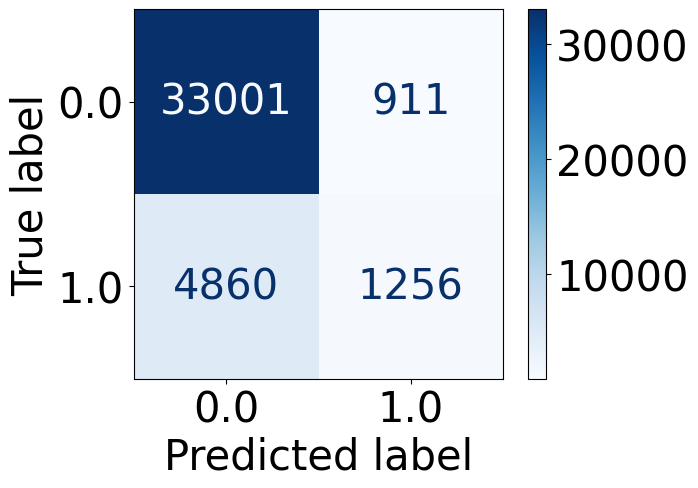

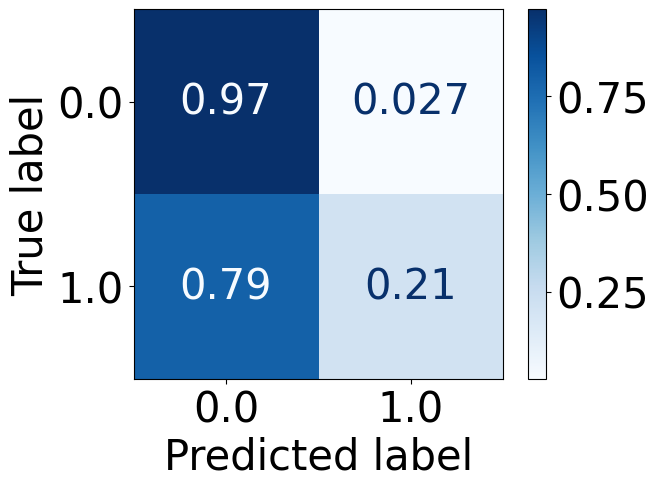

In [44]:
plt.rcParams['font.size'] = 30

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_lr, pred_prob_test_2021_lr)

Class 1 Recall: 0.2053629823413996
Class 1 Precision: 0.5796031379787725
Class 1 Area Under Precision-Recall Curve: 0.4507508031425717
Class 1 F1-Score: 0.3032717614390921
Class 0 Recall: 0.9731363529134229
Class 0 Precision: 0.871635720134175
Class 0 Area Under Precision-Recall Curve: 0.7152760233747096
Class 0 F1-Score: 0.9195937190865645
Overall Accuracy: 0.8558259218547017
Balanced Accuracy: 0.5892496676274113
Area Under ROC Curve: 0.8234227349832158
Matthews Correlation Coefficient: 0.283805983401172
0.2053629823413996
0.5796031379787725
0.4507508031425717
0.3032717614390921
0.9731363529134229
0.871635720134175
0.7152760233747096
0.9195937190865645
0.8558259218547017
0.5892496676274113
0.8234227349832158
0.283805983401172


#### Performance across different subgroups

In [ ]:
test = df_test_2021.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr.predict(X_test_group)
  pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.2262682850918145
Class 1 Precision: 0.5896188158961881
Class 1 Area Under Precision-Recall Curve: 0.4688966380371337
Class 1 F1-Score: 0.32703553756185333
Class 0 Recall: 0.9682380264892348
Class 0 Precision: 0.861202612919435
Class 0 Area Under Precision-Recall Curve: 0.6961844314993644
Class 0 F1-Score: 0.9115891495774481
Overall Accuracy: 0.8437108232344338
Balanced Accuracy: 0.5972531557905247
Area Under ROC Curve: 0.8152012853907421
Matthews Correlation Coefficient: 0.2961209437048069
0.2262682850918145
0.5896188158961881
0.4688966380371337
0.32703553756185333
0.9682380264892348
0.861202612919435
0.6961844314993644
0.9115891495774481
0.8437108232344338
0.5972531557905247
0.8152012853907421
0.2961209437048069
Class 1 Recall: 0.18222528418877024
Class 1 Precision: 0.5663811563169164
Class 1 Area Under Precision-Recall Curve: 0.42972769671648925
Class 1 F1-Score: 0.2757362522804274
Class 0 Recall: 0.9774762249040654
Class 0 Precision: 0.8810025062656641
Class 0 Area

In [ ]:
test = df_test_2021.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()

  pred_test_group = lr.predict(X_test_group)
  pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  White ============================ 
Class 1 Recall: 0.17176638020690788
Class 1 Precision: 0.5758854835749679
Class 1 Area Under Precision-Recall Curve: 0.4273018031211411
Class 1 F1-Score: 0.2646091576018214
Class 0 Recall: 0.978855391371975
Class 0 Precision: 0.8760922081644351
Class 0 Area Under Precision-Recall Curve: 0.7314747708734853
Class 0 F1-Score: 0.9246272849055789
Overall Accuracy: 0.8632686337838261
Balanced Accuracy: 0.5753108857894415
Area Under ROC Curve: 0.817351274015905
Matthews Correlation Coefficient: 0.2609169995303546
0.17176638020690788
0.5758854835749679
0.4273018031211411
0.2646091576018214
0.978855391371975
0.8760922081644351
0.7314747708734853
0.9246272849055789
0.8632686337838261
0.5753108857894415
0.817351274015905
0.2609169995303546
============================  Black ============================ 
Class 1 Recall: 0.29817212490479816
Class 1 Precision: 0.5608882521489972
Class 1 Area Under Precision-Recall Curve: 0.5011123769

In [ ]:
test = df_test_2021.copy()

age_list = test.Age.unique()
age_list

array([ 7,  9, 10,  6, 11,  4,  3, 13,  5,  8, 12])

In [ ]:
test = df_test_2021.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr.predict(X_test_group)
  pred_prob_test_group = lr.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.011583011583011582
Class 1 Precision: 0.375
Class 1 Area Under Precision-Recall Curve: 0.16003257429530796
Class 1 F1-Score: 0.022471910112359553
Class 0 Recall: 0.9994178600535569
Class 0 Precision: 0.9710407239819004
Class 0 Area Under Precision-Recall Curve: 0.9305483403064778
Class 0 F1-Score: 0.9850249584026622
Overall Accuracy: 0.970501808318264
Balanced Accuracy: 0.5055004358182843
Area Under ROC Curve: 0.8092920773675228
Matthews Correlation Coefficient: 0.061698862109038154
0.011583011583011582
0.375
0.16003257429530796
0.022471910112359553
0.9994178600535569
0.9710407239819004
0.9305483403064778
0.9850249584026622
0.970501808318264
0.5055004358182843
0.8092920773675228
0.061698862109038154
============================  35-39 ============================ 
Class 1 Recall: 0.049586776859504134
Class 1 Precision: 0.6486486486486487
Class 1 Area Under Precision-Recall Curve: 0.2721559865775869
Clas

### MLP

In [ ]:
from sklearn.neural_network import MLPClassifier

mlp_2021 = MLPClassifier()

mlp_2021 = LogisticRegression(solver='liblinear')
mlp_2021.fit(X_train_2021, y_train_2021)

pred_prob_test_2021_mlp_2021 = mlp_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_mlp_2021 = mlp_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_mlp_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_mlp_2021))

accuracy 0.8558259218547017
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     33912
         1.0       0.58      0.21      0.30      6116

    accuracy                           0.86     40028
   macro avg       0.73      0.59      0.61     40028
weighted avg       0.83      0.86      0.83     40028



#### Performance over subgroups

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_mlp_2021, pred_prob_test_2021_mlp_2021)

Class 1 Recall: 0.2053629823413996
Class 1 Precision: 0.5796031379787725
Class 1 Area Under Precision-Recall Curve: 0.4507508031425717
Class 1 F1-Score: 0.3032717614390921
Class 0 Recall: 0.9731363529134229
Class 0 Precision: 0.871635720134175
Class 0 Area Under Precision-Recall Curve: 0.7152760233747096
Class 0 F1-Score: 0.9195937190865645
Overall Accuracy: 0.8558259218547017
Balanced Accuracy: 0.5892496676274113
Area Under ROC Curve: 0.8234227349832158
Matthews Correlation Coefficient: 0.283805983401172
0.2053629823413996
0.5796031379787725
0.4507508031425717
0.3032717614390921
0.9731363529134229
0.871635720134175
0.7152760233747096
0.9195937190865645
0.8558259218547017
0.5892496676274113
0.8234227349832158
0.283805983401172


In [ ]:
test = df_test_2021.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_2021.predict(X_test_group)
  pred_prob_test_group = mlp_2021.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.2262682850918145
Class 1 Precision: 0.5896188158961881
Class 1 Area Under Precision-Recall Curve: 0.4688966380371337
Class 1 F1-Score: 0.32703553756185333
Class 0 Recall: 0.9682380264892348
Class 0 Precision: 0.861202612919435
Class 0 Area Under Precision-Recall Curve: 0.6961844314993644
Class 0 F1-Score: 0.9115891495774481
Overall Accuracy: 0.8437108232344338
Balanced Accuracy: 0.5972531557905247
Area Under ROC Curve: 0.8152012853907421
Matthews Correlation Coefficient: 0.2961209437048069
0.2262682850918145
0.5896188158961881
0.4688966380371337
0.32703553756185333
0.9682380264892348
0.861202612919435
0.6961844314993644
0.9115891495774481
0.8437108232344338
0.5972531557905247
0.8152012853907421
0.2961209437048069
Class 1 Recall: 0.18222528418877024
Class 1 Precision: 0.5663811563169164
Class 1 Area Under Precision-Recall Curve: 0.42972769671648925
Class 1 F1-Score: 0.2757362522804274
Class 0 Recall: 0.9774762249040654
Class 0 Precision: 0.8810025062656641
Class 0 Area

In [ ]:
test = df_test_2021.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_2021.predict(X_test_group)
  pred_prob_test_group = mlp_2021.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  White ============================ 
Class 1 Recall: 0.17347622237106497
Class 1 Precision: 0.5679824561403509
Class 1 Area Under Precision-Recall Curve: 0.42384376035060567
Class 1 F1-Score: 0.2657773217034377
Class 0 Recall: 0.9783278327832783
Class 0 Precision: 0.8781475264145354
Class 0 Area Under Precision-Recall Curve: 0.7338691997569736
Class 0 F1-Score: 0.9255346828329083
Overall Accuracy: 0.8647831427761504
Balanced Accuracy: 0.5759020275771716
Area Under ROC Curve: 0.8211371274807022
Matthews Correlation Coefficient: 0.26023900644939485
0.17347622237106497
0.5679824561403509
0.42384376035060567
0.2657773217034377
0.9783278327832783
0.8781475264145354
0.7338691997569736
0.9255346828329083
0.8647831427761504
0.5759020275771716
0.8211371274807022
0.26023900644939485
============================  Black ============================ 
Class 1 Recall: 0.3613312202852615
Class 1 Precision: 0.6162162162162163
Class 1 Area Under Precision-Recall Curve: 0.544

In [ ]:
test = df_test_2021.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_2021.predict(X_test_group)
  pred_prob_test_group = mlp_2021.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.046153846153846156
Class 1 Precision: 0.6
Class 1 Area Under Precision-Recall Curve: 0.2010764493206778
Class 1 F1-Score: 0.08571428571428573
Class 0 Recall: 0.9991208791208791
Class 0 Precision: 0.9734475374732334
Class 0 Area Under Precision-Recall Curve: 0.9307796442274693
Class 0 F1-Score: 0.9861171366594361
Overall Accuracy: 0.9726495726495726
Balanced Accuracy: 0.5226373626373626
Area Under ROC Curve: 0.8297886728655959
Matthews Correlation Coefficient: 0.16112938812820077
0.046153846153846156
0.6
0.2010764493206778
0.08571428571428573
0.9991208791208791
0.9734475374732334
0.9307796442274693
0.9861171366594361
0.9726495726495726
0.5226373626373626
0.8297886728655959
0.16112938812820077
============================  35-39 ============================ 
Class 1 Recall: 0.019230769230769232
Class 1 Precision: 0.25
Class 1 Area Under Precision-Recall Curve: 0.19607273793436025
Class 1 F1-Score: 0.03571

## Undersampling - Balanced Diabetes

### Train and test

In [45]:
#Separate the 0(No Diabetes) and 1(Diabetes)
#Get the 1s
is1 = df_train_2021['Diabetes'] == 1
brfss_2021_1 = df_train_2021[is1]
print(brfss_2021_1.shape)

is0 = df_train_2021['Diabetes'] == 0
brfss_2021_0 = df_train_2021[is0]
print(brfss_2021_0.shape)

brfss_2021_0_rand = brfss_2021_0.take(np.random.permutation(len(brfss_2021_0))[:brfss_2021_1.shape[0]])
print(brfss_2021_0_rand.shape)

#Append the 39977 1s to the 39977 randomly selected 0s
df_train_2021_balanced = brfss_2021_0_rand.append(brfss_2021_1, ignore_index = True)

#See the classes are perfectly balanced now
df_train_2021_balanced.groupby(['Diabetes']).size()


(24724, 50)
(135384, 50)
(24724, 50)


<ipython-input-45-363c6ba69832>:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_train_2021_balanced = brfss_2021_0_rand.append(brfss_2021_1, ignore_index = True)


Diabetes
0.0    24724
1.0    24724
dtype: int64

In [46]:
X_train_2021_balanced = df_train_2021_balanced.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_balanced = df_train_2021_balanced['Diabetes']
X_train_2021_balanced.shape, X_test_2021.shape

((49448, 48), (40028, 48))

In [47]:
from sklearn.linear_model import LogisticRegression

lr_balanced = LogisticRegression(solver='liblinear')
lr_balanced.fit(X_train_2021_balanced, y_train_2021_balanced)

pred_prob_test_2021_lr_balanced = lr_balanced.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_balanced = lr_balanced.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_balanced))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_balanced))

accuracy 0.7335864894573798
              precision    recall  f1-score   support

         0.0       0.94      0.73      0.82     33912
         1.0       0.34      0.76      0.47      6116

    accuracy                           0.73     40028
   macro avg       0.64      0.75      0.64     40028
weighted avg       0.85      0.73      0.77     40028



In [ ]:
conf_matrix = confusion_matrix(y_test_2021, pred_test_2021_lr_balanced)
conf_matrix

array([[24696,  9216],
       [ 1454,  4662]])

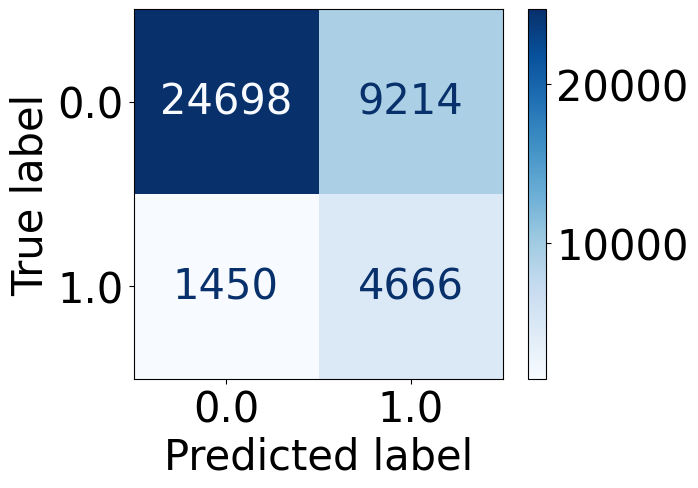

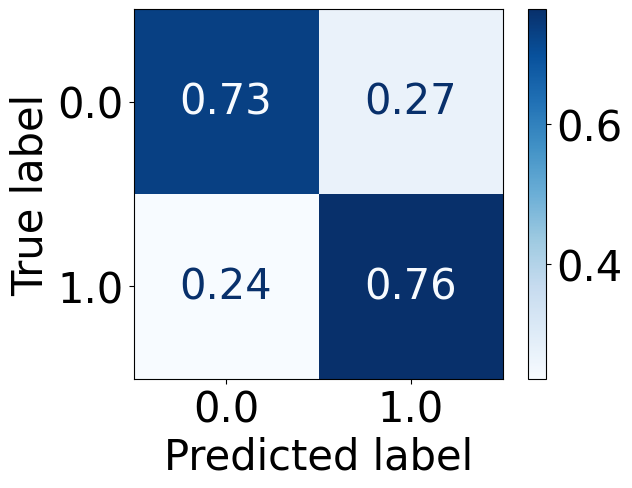

In [48]:
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_balanced,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_balanced,cmap=plt.cm.Blues, normalize="true")

In [ ]:
# Calculate AUROC
auroc = roc_auc_score(y_test_2021, pred_prob_test_2021_lr_balanced)

print("AUROC:", auroc)

AUROC: 0.8234555016669929


### Performance over subgroups

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_lr_balanced, pred_prob_test_2021_lr_balanced)

Class 1 Recall: 0.7656965336821452
Class 1 Precision: 0.33481089583184387
Class 1 Area Under Precision-Recall Curve: 0.4485605673065076
Class 1 F1-Score: 0.4659006118489777
Class 0 Recall: 0.7256428402925218
Class 0 Precision: 0.9449713912676164
Class 0 Area Under Precision-Recall Curve: 0.7155259651861691
Class 0 F1-Score: 0.8209097126082098
Overall Accuracy: 0.7317627660637553
Balanced Accuracy: 0.7456696869873335
Area Under ROC Curve: 0.8234555016669929
Matthews Correlation Coefficient: 0.37076684559524653
0.7656965336821452
0.33481089583184387
0.4485605673065076
0.4659006118489777
0.7256428402925218
0.9449713912676164
0.7155259651861691
0.8209097126082098
0.7317627660637553
0.7456696869873335
0.8234555016669929
0.37076684559524653


In [ ]:
test = df_train_2021_balanced.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced.predict(X_test_group)
  pred_prob_test_group = lr_balanced.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.7780527414739773
Class 1 Precision: 0.7371776084407972
Class 1 Area Under Precision-Recall Curve: 0.8068363141176736
Class 1 F1-Score: 0.757063847398322
Class 0 Recall: 0.69096235030585
Class 0 Precision: 0.736455463728191
Class 0 Area Under Precision-Recall Curve: 0.317509758391401
Class 0 F1-Score: 0.7129839534160112
Overall Accuracy: 0.7368571195696471
Balanced Accuracy: 0.7345075458899136
Area Under ROC Curve: 0.8113800191121179
Matthews Correlation Coefficient: 0.4713184261338607
0.7780527414739773
0.7371776084407972
0.8068363141176736
0.757063847398322
0.69096235030585
0.736455463728191
0.317509758391401
0.7129839534160112
0.7368571195696471
0.7345075458899136
0.8113800191121179
0.4713184261338607
Class 1 Recall: 0.7401848554227084
Class 1 Precision: 0.7314395843807608
Class 1 Area Under Precision-Recall Curve: 0.7847475529005412
Class 1 F1-Score: 0.7357862350908249
Class 0 Recall: 0.7556605931234276
Class 0 Precision: 0.7638717632552404
Class 0 Area Under Preci

In [ ]:
test = df_test_2021.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced.predict(X_test_group)
  pred_prob_test_group = lr_balanced.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.7868036103330222
Class 1 Precision: 0.33860166086257704
Class 1 Area Under Precision-Recall Curve: 0.4672753971514427
Class 1 F1-Score: 0.47345257046539946
Class 0 Recall: 0.6900382901261691
Class 0 Precision: 0.9413426956670663
Class 0 Area Under Precision-Recall Curve: 0.6963976724240295
Class 0 F1-Score: 0.7963345285957477
Overall Accuracy: 0.7062787296280819
Balanced Accuracy: 0.7384209502295956
Area Under ROC Curve: 0.8153479261825181
Matthews Correlation Coefficient: 0.3653617371734765
0.7868036103330222
0.33860166086257704
0.4672753971514427
0.47345257046539946
0.6900382901261691
0.9413426956670663
0.6963976724240295
0.7963345285957477
0.7062787296280819
0.7384209502295956
0.8153479261825181
0.3653617371734765
Class 1 Recall: 0.7344126765415088
Class 1 Precision: 0.33131313131313134
Class 1 Area Under Precision-Recall Curve: 0.4272006897611026
Class 1 F1-Score: 0.45662882844292146
Class 0 Recall: 0.760691841388132
Class 0 Precision: 0.9466399058758391
Class 0 A

In [ ]:
test = df_train_2021_balanced.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced.predict(X_test_group)
  pred_prob_test_group = lr_balanced.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  White ============================ 
Class 1 Recall: 0.7378619519404456
Class 1 Precision: 0.7241471931238249
Class 1 Area Under Precision-Recall Curve: 0.7834080361504454
Class 1 F1-Score: 0.7309402450927232
Class 0 Recall: 0.7423869964380675
Class 0 Precision: 0.7555010976668198
Class 0 Area Under Precision-Recall Curve: 0.35653092424915805
Class 0 F1-Score: 0.7488866396761132
Overall Accuracy: 0.7402230249725146
Balanced Accuracy: 0.7401244741892565
Area Under ROC Curve: 0.8197285156739307
Matthews Correlation Coefficient: 0.4799485256189025
0.7378619519404456
0.7241471931238249
0.7834080361504454
0.7309402450927232
0.7423869964380675
0.7555010976668198
0.35653092424915805
0.7488866396761132
0.7402230249725146
0.7401244741892565
0.8197285156739307
0.4799485256189025
============================  Black ============================ 
Class 1 Recall: 0.8575780654988576
Class 1 Precision: 0.7649456521739131
Class 1 Area Under Precision-Recall Curve: 0.8278799

In [ ]:
test = df_test_2021.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced.predict(X_test_group)
  pred_prob_test_group = lr_balanced.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  White ============================ 
Class 1 Recall: 0.7378879214110292
Class 1 Precision: 0.32134175984443364
Class 1 Area Under Precision-Recall Curve: 0.42165305623264315
Class 1 F1-Score: 0.447710647520997
Class 0 Recall: 0.744041070773744
Class 0 Precision: 0.945303764442788
Class 0 Area Under Precision-Recall Curve: 0.7342041024729863
Class 0 F1-Score: 0.832683547420692
Overall Accuracy: 0.7431730133232543
Balanced Accuracy: 0.7409644960923867
Area Under ROC Curve: 0.8209178750724667
Matthews Correlation Coefficient: 0.35847483703925603
0.7378879214110292
0.32134175984443364
0.42165305623264315
0.447710647520997
0.744041070773744
0.945303764442788
0.7342041024729863
0.832683547420692
0.7431730133232543
0.7409644960923867
0.8209178750724667
0.35847483703925603
============================  Black ============================ 
Class 1 Recall: 0.866877971473851
Class 1 Precision: 0.3658862876254181
Class 1 Area Under Precision-Recall Curve: 0.543964970730

In [ ]:
test = df_train_2021_balanced.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced.predict(X_test_group)
  pred_prob_test_group = lr_balanced.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.305019305019305
Class 1 Precision: 0.5563380281690141
Class 1 Area Under Precision-Recall Curve: 0.44894440323894685
Class 1 F1-Score: 0.39401496259351626
Class 0 Recall: 0.9618413082980012
Class 0 Precision: 0.8981900452488688
Class 0 Area Under Precision-Recall Curve: 0.739771623266396
Class 0 F1-Score: 0.9289265867212635
Overall Accuracy: 0.8727748691099476
Balanced Accuracy: 0.6334303066586531
Area Under ROC Curve: 0.8142882867292317
Matthews Correlation Coefficient: 0.34827523661930054
0.305019305019305
0.5563380281690141
0.44894440323894685
0.39401496259351626
0.9618413082980012
0.8981900452488688
0.739771623266396
0.9289265867212635
0.8727748691099476
0.6334303066586531
0.8142882867292317
0.34827523661930054
============================  35-39 ============================ 
Class 1 Recall: 0.44214876033057854
Class 1 Precision: 0.6524390243902439
Class 1 Area Under Precision-Recall Curve: 0.620607

In [ ]:
test = df_test_2021.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced.predict(X_test_group)
  pred_prob_test_group = lr_balanced.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.3230769230769231
Class 1 Precision: 0.1640625
Class 1 Area Under Precision-Recall Curve: 0.19624989343640553
Class 1 F1-Score: 0.21761658031088085
Class 0 Recall: 0.952967032967033
Class 0 Precision: 0.9801084990958409
Class 0 Area Under Precision-Recall Curve: 0.9313565085498097
Class 0 F1-Score: 0.9663472253175841
Overall Accuracy: 0.9354700854700855
Balanced Accuracy: 0.638021978021978
Area Under ROC Curve: 0.8272392223161454
Matthews Correlation Coefficient: 0.19949319020263706
0.3230769230769231
0.1640625
0.19624989343640553
0.21761658031088085
0.952967032967033
0.9801084990958409
0.9313565085498097
0.9663472253175841
0.9354700854700855
0.638021978021978
0.8272392223161454
0.19949319020263706
============================  35-39 ============================ 
Class 1 Recall: 0.47115384615384615
Class 1 Precision: 0.2076271186440678
Class 1 Area Under Precision-Recall Curve: 0.19013652320853464
Class 

### Oversampling minority subgroups
Age 3: 30-34, 4: 35-39, 5: 40-44, 6: 45-49, 7: 50-54

In [ ]:
df_train_2021_AGE_3 = df_train_2021_balanced[ (df_train_2021_balanced['Age'] == 3)]
df_train_2021_AGE_4 = df_train_2021_balanced[ (df_train_2021_balanced['Age'] == 4)]
df_train_2021_AGE_5 = df_train_2021_balanced[ (df_train_2021_balanced['Age'] == 5)]
df_train_2021_AGE_6 = df_train_2021_balanced[ (df_train_2021_balanced['Age'] == 6)]
df_train_2021_AGE_7 = df_train_2021_balanced[ (df_train_2021_balanced['Age'] == 7)]

l = [df_train_2021_AGE_3, df_train_2021_AGE_4, df_train_2021_AGE_5, df_train_2021_AGE_6, df_train_2021_AGE_7]

In [ ]:
df_train_2021_AGE_3.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       3      1527
1.0       3       259
dtype: int64

In [ ]:

from imblearn.over_sampling import RandomOverSampler
X_train = df_train_2021_AGE_3.drop(['Diabetes'], axis=1)
y_train = df_train_2021_AGE_3['Diabetes']
oversampler = RandomOverSampler(sampling_strategy='minority')
X_resampled, y_resampled = oversampler.fit_resample(X_train, y_train)
df_train_2021_AGE_3_oversampled = pd.concat([X_resampled, y_resampled], axis=1)
df_train_2021_AGE_3_oversampled.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       3      1527
1.0       3      1527
dtype: int64

In [ ]:
X_train = df_train_2021_AGE_4.drop(['Diabetes'], axis=1)
y_train = df_train_2021_AGE_4['Diabetes']
oversampler = RandomOverSampler(sampling_strategy='minority')
X_resampled, y_resampled = oversampler.fit_resample(X_train, y_train)
df_train_2021_AGE_4_oversampled = pd.concat([X_resampled, y_resampled], axis=1)
df_train_2021_AGE_4_oversampled.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       4      1955
1.0       4      1955
dtype: int64

In [ ]:
X_train = df_train_2021_AGE_5.drop(['Diabetes'], axis=1)
y_train = df_train_2021_AGE_5['Diabetes']
oversampler = RandomOverSampler(sampling_strategy='minority')
X_resampled, y_resampled = oversampler.fit_resample(X_train, y_train)
df_train_2021_AGE_5_oversampled = pd.concat([X_resampled, y_resampled], axis=1)
df_train_2021_AGE_5_oversampled.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       5      2147
1.0       5      2147
dtype: int64

In [ ]:
X_train = df_train_2021_AGE_6.drop(['Diabetes'], axis=1)
y_train = df_train_2021_AGE_6['Diabetes']
oversampler = RandomOverSampler(sampling_strategy='minority')
X_resampled, y_resampled = oversampler.fit_resample(X_train, y_train)
df_train_2021_AGE_6_oversampled = pd.concat([X_resampled, y_resampled], axis=1)
df_train_2021_AGE_6_oversampled.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       6      2134
1.0       6      2134
dtype: int64

In [ ]:
X_train = df_train_2021_AGE_7.drop(['Diabetes'], axis=1)
y_train = df_train_2021_AGE_7['Diabetes']
oversampler = RandomOverSampler(sampling_strategy='minority')
X_resampled, y_resampled = oversampler.fit_resample(X_train, y_train)
df_train_2021_AGE_7_oversampled = pd.concat([X_resampled, y_resampled], axis=1)
df_train_2021_AGE_7_oversampled.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       7      2487
1.0       7      2487
dtype: int64

In [ ]:
df_train_2021_bal_over_minority = df_train_2021_balanced.copy()
for i in range(3, 8):
  df_train_2021_bal_over_minority = df_train_2021_bal_over_minority[df_train_2021_balanced.Age != i]

<ipython-input-101-c565a282382a>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_train_2021_bal_over_minority = df_train_2021_bal_over_minority[df_train_2021_balanced.Age != i]


In [ ]:
df_train_2021_bal_over_minority.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       8      2632
          9      2948
          10     2874
          11     2635
          12     1682
          13     1703
1.0       8      2873
          9      3608
          10     4144
          11     4187
          12     2769
          13     2242
dtype: int64

In [ ]:
df_train_2021_bal_over_minority = df_train_2021_bal_over_minority.append(df_train_2021_AGE_3_oversampled, ignore_index = True)
df_train_2021_bal_over_minority = df_train_2021_bal_over_minority.append(df_train_2021_AGE_4_oversampled, ignore_index = True)
df_train_2021_bal_over_minority = df_train_2021_bal_over_minority.append(df_train_2021_AGE_5_oversampled, ignore_index = True)
df_train_2021_bal_over_minority = df_train_2021_bal_over_minority.append(df_train_2021_AGE_6_oversampled, ignore_index = True)
df_train_2021_bal_over_minority = df_train_2021_bal_over_minority.append(df_train_2021_AGE_7_oversampled, ignore_index = True)

<ipython-input-103-6499e13b57f1>:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_train_2021_bal_over_minority = df_train_2021_bal_over_minority.append(df_train_2021_AGE_3_oversampled, ignore_index = True)
<ipython-input-103-6499e13b57f1>:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_train_2021_bal_over_minority = df_train_2021_bal_over_minority.append(df_train_2021_AGE_4_oversampled, ignore_index = True)
<ipython-input-103-6499e13b57f1>:3: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_train_2021_bal_over_minority = df_train_2021_bal_over_minority.append(df_train_2021_AGE_5_oversampled, ignore_index = True)
<ipython-input-103-6499e13b57f1>:4: FutureWarning: The frame.append method is deprecated and will be remov

In [ ]:
df_train_2021_bal_over_minority.groupby(['Diabetes', 'Age']).size()

Diabetes  Age
0.0       3      1527
          4      1955
          5      2147
          6      2134
          7      2487
          8      2632
          9      2948
          10     2874
          11     2635
          12     1682
          13     1703
1.0       3      1527
          4      1955
          5      2147
          6      2134
          7      2487
          8      2873
          9      3608
          10     4144
          11     4187
          12     2769
          13     2242
dtype: int64

### Train and test balanced - oversampled minority group

In [ ]:
X_train_2021_balanced_over_minority = df_train_2021_bal_over_minority.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_balanced_over_minority = df_train_2021_bal_over_minority['Diabetes']

#### LR

accuracy 0.6863445588088338
              precision    recall  f1-score   support

         0.0       0.95      0.67      0.78     33912
         1.0       0.30      0.80      0.44      6116

    accuracy                           0.69     40028
   macro avg       0.62      0.73      0.61     40028
weighted avg       0.85      0.69      0.73     40028



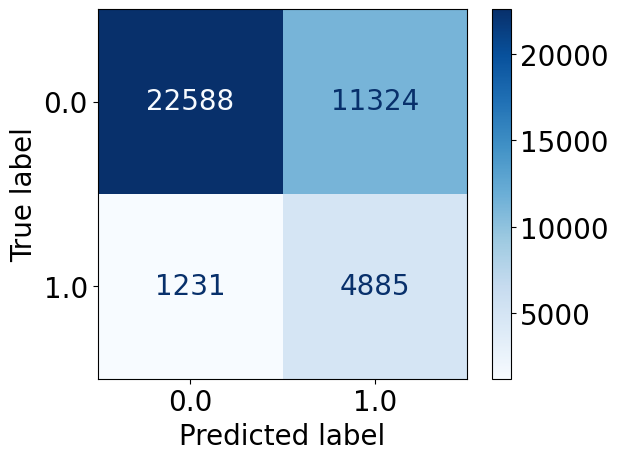

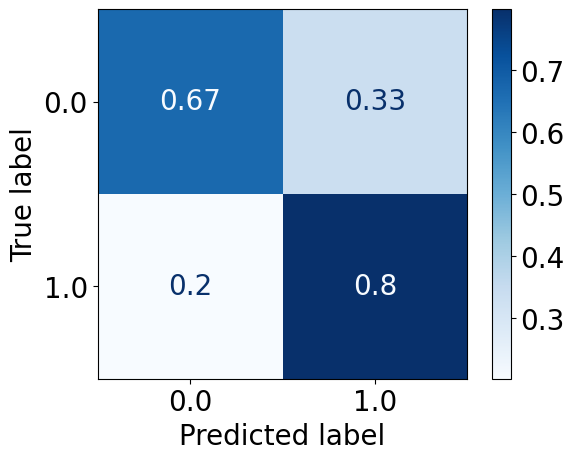

In [ ]:
from sklearn.linear_model import LogisticRegression

lr_balanced_over_minority = LogisticRegression(solver='liblinear')
lr_balanced_over_minority.fit(X_train_2021_balanced_over_minority, y_train_2021_balanced_over_minority)

pred_prob_test_2021_lr_balanced_over_minority = lr_balanced_over_minority.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_balanced_over_minority = lr_balanced_over_minority.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_balanced_over_minority))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_balanced_over_minority))

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_balanced_over_minority,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_balanced_over_minority,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_lr_balanced_over_minority, pred_prob_test_2021_lr_balanced_over_minority)

Class 1 Recall: 0.8001962066710269
Class 1 Precision: 0.3026218154835518
Class 1 Area Under Precision-Recall Curve: 0.4422909081382978
Class 1 F1-Score: 0.4391600861450108
Class 0 Recall: 0.6674333569238028
Class 0 Precision: 0.948775989268947
Class 0 Area Under Precision-Recall Curve: 0.7180277002573797
Class 0 F1-Score: 0.7836172275308129
Overall Accuracy: 0.6877185969821126
Balanced Accuracy: 0.7338147817974148
Area Under ROC Curve: 0.8139400152335188
Matthews Correlation Coefficient: 0.34287176279931425
0.8001962066710269
0.3026218154835518
0.4422909081382978
0.4391600861450108
0.6674333569238028
0.948775989268947
0.7180277002573797
0.7836172275308129
0.6877185969821126
0.7338147817974148
0.8139400152335188
0.34287176279931425


In [ ]:
test = df_train_2021_balanced.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = lr_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.8070528188075168
Class 1 Precision: 0.7053257637199243
Class 1 Area Under Precision-Recall Curve: 0.7906289228540045
Class 1 F1-Score: 0.7527680600137051
Class 0 Recall: 0.625783194575573
Class 0 Precision: 0.7450439403229103
Class 0 Area Under Precision-Recall Curve: 0.32379862791950087
Class 0 F1-Score: 0.6802257778607081
Overall Accuracy: 0.7211374176226507
Balanced Accuracy: 0.7164180066915449
Area Under ROC Curve: 0.7913820276123946
Matthews Correlation Coefficient: 0.44151582898739034
0.8070528188075168
0.7053257637199243
0.7906289228540045
0.7527680600137051
0.625783194575573
0.7450439403229103
0.32379862791950087
0.6802257778607081
0.7211374176226507
0.7164180066915449
0.7913820276123946
0.44151582898739034
Class 1 Recall: 0.7936063766641228
Class 1 Precision: 0.7103605313092979
Class 1 Area Under Precision-Recall Curve: 0.7906898608685067
Class 1 F1-Score: 0.7496795898750401
Class 0 Recall: 0.7081006654937658
Class 0 Precision: 0.7918056624754084
Class 0 Area

In [ ]:
test = df_test_2021.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = lr_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.8163709928415811
Class 1 Precision: 0.3071788265604872
Class 1 Area Under Precision-Recall Curve: 0.45040791595475793
Class 1 F1-Score: 0.44639210347174946
Class 0 Recall: 0.6286485468583265
Class 0 Precision: 0.9443658651579444
Class 0 Area Under Precision-Recall Curve: 0.7010752515845996
Class 0 F1-Score: 0.7548236358154959
Overall Accuracy: 0.6601546176347681
Balanced Accuracy: 0.7225097698499539
Area Under ROC Curve: 0.8012067017225292
Matthews Correlation Coefficient: 0.3345777980118997
0.8163709928415811
0.3071788265604872
0.45040791595475793
0.44639210347174946
0.6286485468583265
0.9443658651579444
0.7010752515845996
0.7548236358154959
0.6601546176347681
0.7225097698499539
0.8012067017225292
0.3345777980118997
Class 1 Recall: 0.7791939373062349
Class 1 Precision: 0.29491525423728815
Class 1 Area Under Precision-Recall Curve: 0.4276614612614782
Class 1 F1-Score: 0.42788234181405466
Class 0 Recall: 0.699238084644903
Class 0 Precision: 0.951490843045255
Class 0 Ar

In [ ]:
test = df_train_2021_balanced.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = lr_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  White ============================ 
Class 1 Recall: 0.7739339865345668
Class 1 Precision: 0.7017569982132221
Class 1 Area Under Precision-Recall Curve: 0.7802139184642833
Class 1 F1-Score: 0.7360803810812923
Class 0 Recall: 0.6986005918643727
Class 0 Precision: 0.7712925019381991
Class 0 Area Under Precision-Recall Curve: 0.35852199450003686
Class 0 F1-Score: 0.7331490985656007
Overall Accuracy: 0.7346228341098257
Balanced Accuracy: 0.7362672891994697
Area Under ROC Curve: 0.8118686141712039
Matthews Correlation Coefficient: 0.4727919691744784
0.7739339865345668
0.7017569982132221
0.7802139184642833
0.7360803810812923
0.6986005918643727
0.7712925019381991
0.35852199450003686
0.7331490985656007
0.7346228341098257
0.7362672891994697
0.8118686141712039
0.4727919691744784
============================  Black ============================ 
Class 1 Recall: 0.900990099009901
Class 1 Precision: 0.7444933920704846
Class 1 Area Under Precision-Recall Curve: 0.83926796

In [ ]:
test = df_test_2021.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = lr_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  White ============================ 
Class 1 Recall: 0.7722705961152043
Class 1 Precision: 0.295312900196363
Class 1 Area Under Precision-Recall Curve: 0.41764422184089
Class 1 F1-Score: 0.42724802371541504
Class 0 Recall: 0.6973230656398973
Class 0 Precision: 0.9490916350568975
Class 0 Area Under Precision-Recall Curve: 0.7359020827568052
Class 0 F1-Score: 0.8039572147296326
Overall Accuracy: 0.7078963116948566
Balanced Accuracy: 0.7347968308775508
Area Under ROC Curve: 0.8134866757495129
Matthews Correlation Coefficient: 0.3387784241346141
0.7722705961152043
0.295312900196363
0.41764422184089
0.42724802371541504
0.6973230656398973
0.9490916350568975
0.7359020827568052
0.8039572147296326
0.7078963116948566
0.7347968308775508
0.8134866757495129
0.3387784241346141
============================  Black ============================ 
Class 1 Recall: 0.8811410459587956
Class 1 Precision: 0.31899024670109005
Class 1 Area Under Precision-Recall Curve: 0.519673113709

In [ ]:
test = df_train_2021_balanced.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = lr_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.6911196911196911
Class 1 Precision: 0.3675564681724846
Class 1 Area Under Precision-Recall Curve: 0.4724315698648164
Class 1 F1-Score: 0.4798927613941019
Class 0 Recall: 0.8010335917312662
Class 0 Precision: 0.9393939393939394
Class 0 Area Under Precision-Recall Curve: 0.7281711330924077
Class 0 F1-Score: 0.8647140864714088
Overall Accuracy: 0.7852794687327062
Balanced Accuracy: 0.7460766414254787
Area Under ROC Curve: 0.8115241487334511
Matthews Correlation Coefficient: 0.38867293545634857
0.6911196911196911
0.3675564681724846
0.4724315698648164
0.4798927613941019
0.8010335917312662
0.9393939393939394
0.7281711330924077
0.8647140864714088
0.7852794687327062
0.7460766414254787
0.8115241487334511
0.38867293545634857
============================  35-39 ============================ 
Class 1 Recall: 0.78099173553719
Class 1 Precision: 0.45652173913043476
Class 1 Area Under Precision-Recall Curve: 0.60014849

In [ ]:
test = df_test_2021.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = lr_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.7076923076923077
Class 1 Precision: 0.08745247148288973
Class 1 Area Under Precision-Recall Curve: 0.19476988578654653
Class 1 F1-Score: 0.155668358714044
Class 0 Recall: 0.789010989010989
Class 0 Precision: 0.9895259095920618
Class 0 Area Under Precision-Recall Curve: 0.931452573425491
Class 0 F1-Score: 0.8779652726828076
Overall Accuracy: 0.7867521367521367
Balanced Accuracy: 0.7483516483516484
Area Under ROC Curve: 0.8268064243448859
Matthews Correlation Coefficient: 0.19553878299409316
0.7076923076923077
0.08745247148288973
0.19476988578654653
0.155668358714044
0.789010989010989
0.9895259095920618
0.931452573425491
0.8779652726828076
0.7867521367521367
0.7483516483516484
0.8268064243448859
0.19553878299409316
============================  35-39 ============================ 
Class 1 Recall: 0.7307692307692307
Class 1 Precision: 0.11343283582089553
Class 1 Area Under Precision-Recall Curve: 0.19133966

#### MLP

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


accuracy 0.6814479864095133
              precision    recall  f1-score   support

         0.0       0.95      0.66      0.78     33912
         1.0       0.30      0.79      0.43      6116

    accuracy                           0.68     40028
   macro avg       0.62      0.72      0.60     40028
weighted avg       0.85      0.68      0.73     40028



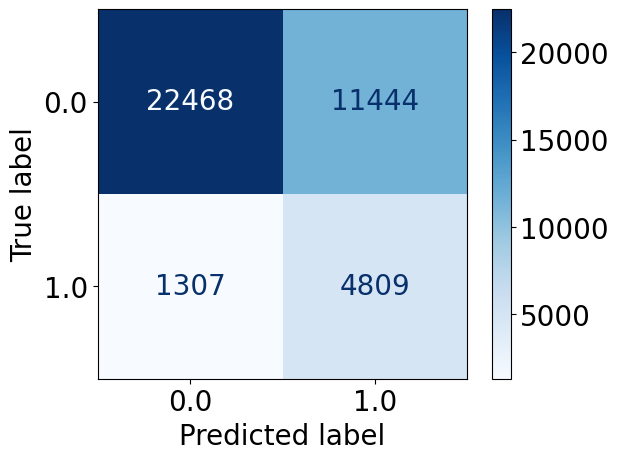

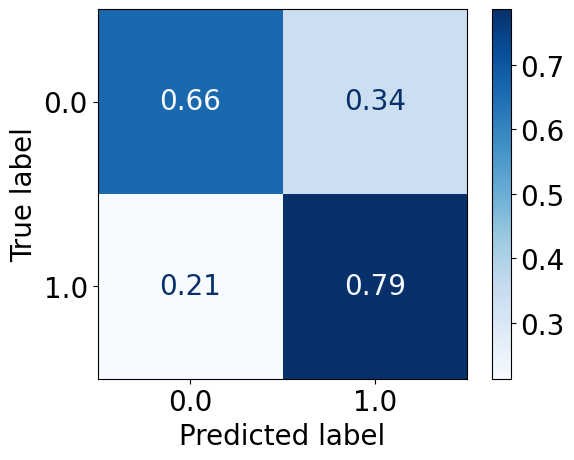

In [ ]:
from sklearn.neural_network import MLPClassifier

mlp_balanced_over_minority = MLPClassifier()
mlp_balanced_over_minority.fit(X_train_2021_balanced_over_minority, y_train_2021_balanced_over_minority)

pred_prob_test_2021_mlp_balanced_over_minority = mlp_balanced_over_minority.predict_proba(X_test_2021)[:, 1]
pred_test_2021_mlp_balanced_over_minority = mlp_balanced_over_minority.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_mlp_balanced_over_minority))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_mlp_balanced_over_minority))

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_mlp_balanced_over_minority,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_mlp_balanced_over_minority,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_mlp_balanced_over_minority, pred_prob_test_2021_mlp_balanced_over_minority)

Class 1 Recall: 0.7244931327665141
Class 1 Precision: 0.3191443388072602
Class 1 Area Under Precision-Recall Curve: 0.37139539997271664
Class 1 F1-Score: 0.4431
Class 0 Recall: 0.7212491153573957
Class 0 Precision: 0.9355492656058751
Class 0 Area Under Precision-Recall Curve: 0.7317220560356364
Class 0 F1-Score: 0.8145397628879713
Overall Accuracy: 0.7217447786549416
Balanced Accuracy: 0.7228711240619549
Area Under ROC Curve: 0.7949704630235206
Matthews Correlation Coefficient: 0.33693871818758475
0.7244931327665141
0.3191443388072602
0.37139539997271664
0.4431
0.7212491153573957
0.9355492656058751
0.7317220560356364
0.8145397628879713
0.7217447786549416
0.7228711240619549
0.7949704630235206
0.33693871818758475


In [ ]:
test = df_train_2021_balanced.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.7881061016162709
Class 1 Precision: 0.7692481884057971
Class 1 Area Under Precision-Recall Curve: 0.8485040188643206
Class 1 F1-Score: 0.778562970319722
Class 0 Recall: 0.7376190884902584
Class 0 Precision: 0.7582495147344274
Class 0 Area Under Precision-Recall Curve: 0.30889251572132226
Class 0 F1-Score: 0.7477920382858385
Overall Accuracy: 0.76417704011065
Balanced Accuracy: 0.7628625950532646
Area Under ROC Curve: 0.8464610108699654
Matthews Correlation Coefficient: 0.5266107008636951
0.7881061016162709
0.7692481884057971
0.8485040188643206
0.778562970319722
0.7376190884902584
0.7582495147344274
0.30889251572132226
0.7477920382858385
0.76417704011065
0.7628625950532646
0.8464610108699654
0.5266107008636951
Class 1 Recall: 0.7524802849147799
Class 1 Precision: 0.7773981603153745
Class 1 Area Under Precision-Recall Curve: 0.8491699835490158
Class 1 F1-Score: 0.7647362978283351
Class 0 Recall: 0.805629924271399
Class 0 Precision: 0.7829901122593116
Class 0 Area Under 

In [ ]:
test = df_test_2021.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.8073451602863367
Class 1 Precision: 0.3022957697238084
Class 1 Area Under Precision-Recall Curve: 0.3999259132024382
Class 1 F1-Score: 0.43988468712904866
Class 0 Recall: 0.6241918272550373
Class 0 Precision: 0.9413992237053868
Class 0 Area Under Precision-Recall Curve: 0.7103787751283352
Class 0 F1-Score: 0.7506605269117537
Overall Accuracy: 0.6549310488926035
Balanced Accuracy: 0.715768493770687
Area Under ROC Curve: 0.7901890081805674
Matthews Correlation Coefficient: 0.3242890737341452
0.8073451602863367
0.3022957697238084
0.3999259132024382
0.43988468712904866
0.6241918272550373
0.9413992237053868
0.7103787751283352
0.7506605269117537
0.6549310488926035
0.715768493770687
0.7901890081805674
0.3242890737341452
Class 1 Recall: 0.7630037891836031
Class 1 Precision: 0.2887122002085506
Class 1 Area Under Precision-Recall Curve: 0.36403086464310475
Class 1 F1-Score: 0.4189125295508274
Class 0 Recall: 0.6965129859295923
Class 0 Precision: 0.9479261277626401
Class 0 Area 

In [ ]:
test = df_train_2021_balanced.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  White ============================ 
Class 1 Recall: 0.7319502983195577
Class 1 Precision: 0.7632420091324201
Class 1 Area Under Precision-Recall Curve: 0.8266137588404405
Class 1 F1-Score: 0.7472687138506245
Class 0 Recall: 0.7919446255705472
Class 0 Precision: 0.7632698443391666
Class 0 Area Under Precision-Recall Curve: 0.34784341237418703
Class 0 F1-Score: 0.777342884572779
Overall Accuracy: 0.7632570800397843
Balanced Accuracy: 0.7619474619450525
Area Under ROC Curve: 0.8491319183700594
Matthews Correlation Coefficient: 0.525201758757275
0.7319502983195577
0.7632420091324201
0.8266137588404405
0.7472687138506245
0.7919446255705472
0.7632698443391666
0.34784341237418703
0.777342884572779
0.7632570800397843
0.7619474619450525
0.8491319183700594
0.525201758757275
============================  Black ============================ 
Class 1 Recall: 0.8823305407463823
Class 1 Precision: 0.7953999313422588
Class 1 Area Under Precision-Recall Curve: 0.89764031719

In [ ]:
test = df_test_2021.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

============================  White ============================ 
Class 1 Recall: 0.7649028801071668
Class 1 Precision: 0.2866945606694561
Class 1 Area Under Precision-Recall Curve: 0.3660809342979029
Class 1 F1-Score: 0.4170673808509343
Class 0 Recall: 0.6874220755408874
Class 0 Precision: 0.9468154957321077
Class 0 Area Under Precision-Recall Curve: 0.745320638937998
Class 0 F1-Score: 0.7965327497928573
Overall Accuracy: 0.698352704022174
Balanced Accuracy: 0.7261624778240271
Area Under ROC Curve: 0.7999414699228351
Matthews Correlation Coefficient: 0.32499603983004466
0.7649028801071668
0.2866945606694561
0.3660809342979029
0.4170673808509343
0.6874220755408874
0.9468154957321077
0.745320638937998
0.7965327497928573
0.698352704022174
0.7261624778240271
0.7999414699228351
0.32499603983004466
============================  Black ============================ 
Class 1 Recall: 0.8938193343898574
Class 1 Precision: 0.32582322357019067
Class 1 Area Under Precision-Recall Curve: 0.4416462861

In [ ]:
test = df_train_2021_balanced.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()

  pred_test_group = mlp_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.8841698841698842
Class 1 Precision: 0.6106666666666667
Class 1 Area Under Precision-Recall Curve: 0.8337098350482858
Class 1 F1-Score: 0.722397476340694
Class 0 Recall: 0.9056847545219638
Class 0 Precision: 0.979050279329609
Class 0 Area Under Precision-Recall Curve: 0.68163833011781
Class 0 F1-Score: 0.9409395973154364
Overall Accuracy: 0.902600996126176
Balanced Accuracy: 0.894927319345924
Area Under ROC Curve: 0.9648593776500753
Matthews Correlation Coefficient: 0.6824885825494433
0.8841698841698842
0.6106666666666667
0.8337098350482858
0.722397476340694
0.9056847545219638
0.979050279329609
0.68163833011781
0.9409395973154364
0.902600996126176
0.894927319345924
0.9648593776500753
0.6824885825494433
============================  35-39 ============================ 
Class 1 Recall: 0.8925619834710744
Class 1 Precision: 0.6343612334801763
Class 1 Area Under Precision-Recall Curve: 0.8306616399110557
Clas

In [ ]:
test = df_test_2021.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()

  pred_test_group = mlp_balanced_over_minority.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_over_minority.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.6923076923076923
Class 1 Precision: 0.0891089108910891
Class 1 Area Under Precision-Recall Curve: 0.1409876290791641
Class 1 F1-Score: 0.15789473684210525
Class 0 Recall: 0.7978021978021979
Class 0 Precision: 0.989100817438692
Class 0 Area Under Precision-Recall Curve: 0.9381981233104536
Class 0 F1-Score: 0.8832116788321167
Overall Accuracy: 0.7948717948717948
Balanced Accuracy: 0.7450549450549451
Area Under ROC Curve: 0.799526627218935
Matthews Correlation Coefficient: 0.19578396603714368
0.6923076923076923
0.0891089108910891
0.1409876290791641
0.15789473684210525
0.7978021978021979
0.989100817438692
0.9381981233104536
0.8832116788321167
0.7948717948717948
0.7450549450549451
0.799526627218935
0.19578396603714368
============================  35-39 ============================ 
Class 1 Recall: 0.5769230769230769
Class 1 Precision: 0.09273570324574962
Class 1 Area Under Precision-Recall Curve: 0.19673420

## Random Oversampling

### Train and test

In [49]:
import pandas as pd
from imblearn.over_sampling import RandomOverSampler

# Assuming you have your trainset DataFrame with 'Diabetes' column as labels
# X_train: Features, y_train: Labels
X_train = df_train_2021.drop(['Diabetes'], axis=1)
y_train = df_train_2021['Diabetes']

# Create an instance of RandomOverSampler
oversampler = RandomOverSampler(sampling_strategy='minority')

# Oversample the minority class
X_resampled, y_resampled = oversampler.fit_resample(X_train, y_train)

# Create a new DataFrame with the resampled data
df_train_2021_oversampled = pd.concat([X_resampled, y_resampled], axis=1)

# Now resampled_trainset contains the oversampled data
df_train_2021_oversampled.shape

(270768, 50)

In [ ]:
df_train_2021_oversampled.groupby(['Diabetes']).size(), df_train_2021.groupby(['Diabetes']).size()

(Diabetes
 0.0    135384
 1.0    135384
 dtype: int64,
 Diabetes
 0.0    135384
 1.0     24724
 dtype: int64)

In [50]:
X_train_2021_oversampled = df_train_2021_oversampled.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_oversampled = df_train_2021_oversampled['Diabetes']
X_train_2021_oversampled.shape, X_test_2021.shape

((270768, 48), (40028, 48))

In [51]:
lr_oversampled = LogisticRegression(solver='liblinear')
lr_oversampled.fit(X_train_2021_oversampled, y_train_2021_oversampled)

pred_prob_test_2021_lr_oversampled = lr_oversampled.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_oversampled = lr_oversampled.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_oversampled))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_oversampled))

accuracy 0.7333866293594484
              precision    recall  f1-score   support

         0.0       0.94      0.73      0.82     33912
         1.0       0.34      0.76      0.47      6116

    accuracy                           0.73     40028
   macro avg       0.64      0.75      0.64     40028
weighted avg       0.85      0.73      0.77     40028



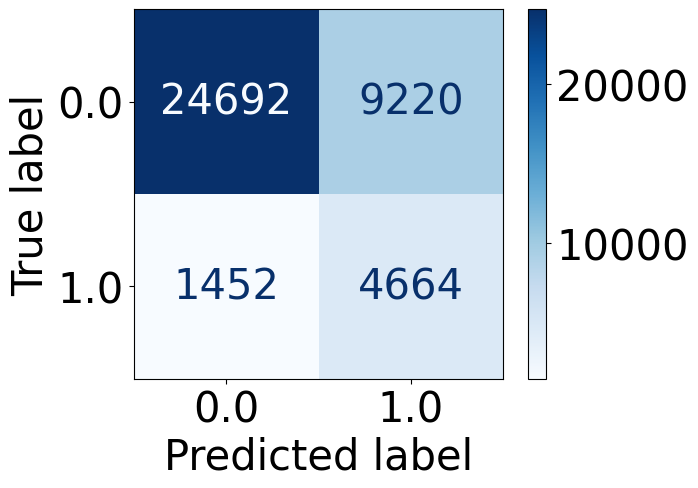

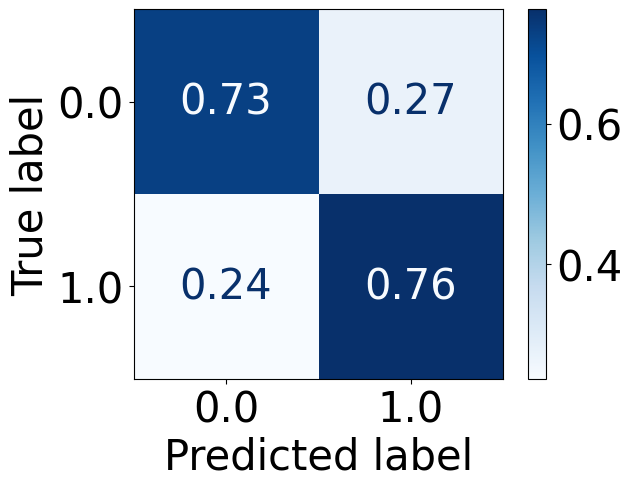

In [53]:
plt.rcParams['font.size'] = 30
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_oversampled,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_oversampled,cmap=plt.cm.Blues, normalize="true")

In [ ]:
# Calculate AUROC
auroc = roc_auc_score(y_test_2021, pred_prob_test_2021_lr_oversampled)

print("AUROC:", auroc)

AUROC: 0.8236350000293144


### Performance over subgroups

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_lr_balanced, pred_prob_test_2021_lr_oversampled)

Class 1 Recall: 0.7656965336821452
Class 1 Precision: 0.33481089583184387
Class 1 Area Under Precision-Recall Curve: 0.44915839003435265
Class 1 F1-Score: 0.4659006118489777
Class 0 Recall: 0.7256428402925218
Class 0 Precision: 0.9449713912676164
Class 0 Area Under Precision-Recall Curve: 0.7154255403205335
Class 0 F1-Score: 0.8209097126082098
Overall Accuracy: 0.7317627660637553
Balanced Accuracy: 0.7456696869873335
Area Under ROC Curve: 0.8236350000293144
Matthews Correlation Coefficient: 0.37076684559524653
0.7656965336821452
0.33481089583184387
0.44915839003435265
0.4659006118489777
0.7256428402925218
0.9449713912676164
0.7154255403205335
0.8209097126082098
0.7317627660637553
0.7456696869873335
0.8236350000293144
0.37076684559524653


In [ ]:
test = df_train_2021_oversampled.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_oversampled.predict(X_test_group)
  pred_prob_test_group = lr_oversampled.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.7755730125493613
Class 1 Precision: 0.734834363016617
Class 1 Area Under Precision-Recall Curve: 0.8031417562615066
Class 1 F1-Score: 0.7546542871402885
Class 0 Recall: 0.6884045499350679
Class 0 Precision: 0.7336913020277481
Class 0 Area Under Precision-Recall Curve: 0.3186677558872919
Class 0 F1-Score: 0.7103268459247182
Overall Accuracy: 0.7343268775171761
Balanced Accuracy: 0.7319887812422146
Area Under ROC Curve: 0.807628531014512
Matthews Correlation Coefficient: 0.4662460681106927
0.7755730125493613
0.734834363016617
0.8031417562615066
0.7546542871402885
0.6884045499350679
0.7336913020277481
0.3186677558872919
0.7103268459247182
0.7343268775171761
0.7319887812422146
0.807628531014512
0.4662460681106927
Class 1 Recall: 0.738933437135072
Class 1 Precision: 0.7331005931784479
Class 1 Area Under Precision-Recall Curve: 0.7866857263760259
Class 1 F1-Score: 0.7360054590147409
Class 0 Recall: 0.758251598550461
Class 0 Precision: 0.7637119503945885
Class 0 Area Under P

In [ ]:
test = df_train_2021_oversampled.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_oversampled.predict(X_test_group)
  pred_prob_test_group = lr_oversampled.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  White ============================ 
Class 1 Recall: 0.7357925922970263
Class 1 Precision: 0.7236081816844068
Class 1 Area Under Precision-Recall Curve: 0.7813818978952589
Class 1 F1-Score: 0.7296495236964715
Class 0 Recall: 0.7422205956356649
Class 0 Precision: 0.7538635962344458
Class 0 Area Under Precision-Recall Curve: 0.3569661484507965
Class 0 F1-Score: 0.7479967911775824
Overall Accuracy: 0.7391453741970584
Balanced Accuracy: 0.7390065939663456
Area Under ROC Curve: 0.8175415901551113
Matthews Correlation Coefficient: 0.47774240623047126
0.7357925922970263
0.7236081816844068
0.7813818978952589
0.7296495236964715
0.7422205956356649
0.7538635962344458
0.3569661484507965
0.7479967911775824
0.7391453741970584
0.7390065939663456
0.8175415901551113
0.47774240623047126
============================  Black ============================ 
Class 1 Recall: 0.8628287632904309
Class 1 Precision: 0.7686316051844466
Class 1 Area Under Precision-Recall Curve: 0.8371042

In [ ]:
test = df_train_2021_oversampled.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = lr_oversampled.predict(X_test_group)
  pred_prob_test_group = lr_oversampled.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.30058651026392963
Class 1 Precision: 0.5631868131868132
Class 1 Area Under Precision-Recall Curve: 0.45123885143924314
Class 1 F1-Score: 0.39196940726577445
Class 0 Recall: 0.9629758994062173
Class 0 Precision: 0.8965853658536586
Class 0 Area Under Precision-Recall Curve: 0.7387660507354322
Class 0 F1-Score: 0.9285954866958572
Overall Accuracy: 0.8721993368833517
Balanced Accuracy: 0.6317812048350735
Area Under ROC Curve: 0.8072893139933126
Matthews Correlation Coefficient: 0.34810725848106205
0.30058651026392963
0.5631868131868132
0.45123885143924314
0.39196940726577445
0.9629758994062173
0.8965853658536586
0.7387660507354322
0.9285954866958572
0.8721993368833517
0.6317812048350735
0.8072893139933126
0.34810725848106205
============================  35-39 ============================ 
Class 1 Recall: 0.44624669935873257
Class 1 Precision: 0.6489303346132749
Class 1 Area Under Precision-Recall Curve: 0.

## SMOTE

### Train and test

Note: The SMOTE requires all the column values to be in number (not string). So the race is reverse mapped to numbers for this case.

In [54]:
race_dict = {1: 'White', 2: 'Black', 3: 'American Indian', 4: 'Asian', 5: 'Native Hawaiian', 6: 'Other race',  7: 'Multiracial', 8: 'Hispanic'}
race_dict_rev = {v: k for k, v in race_dict.items()}

df_train_2021['Race'] = df_train_2021['Race'].replace(race_dict_rev)
df_train_2021

,Blood pressure,Cholesterol,BMI category,Stroke,Heart disease,Consume fruits,Consume vegitables,Alcoholic,Health insurance,Unaffordable healthcare,...,Employment status_Self-employed,Employment status_Student,Employment status_Unable to work,Marital status_Divorced,Marital status_Married,Marital status_Never married,Marital status_Separated,Marital status_Unmarried couple,Marital status_Widowed,Race
99749,0.0,0.0,4.0,0.0,0.0,1,1,0,1,0.0,...,0,0,1,0,1,0,0,0,0,8
85033,0.0,0.0,2.0,0.0,0.0,0,1,1,1,0.0,...,0,0,0,0,0,0,0,0,1,1
19523,0.0,1.0,4.0,0.0,0.0,1,1,1,1,0.0,...,0,0,0,0,1,0,0,0,0,5
172614,0.0,1.0,3.0,0.0,0.0,0,1,0,1,0.0,...,0,0,1,0,1,0,0,0,0,8
27291,1.0,1.0,2.0,0.0,0.0,1,1,1,1,0.0,...,0,0,0,1,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73349,0.0,0.0,4.0,0.0,0.0,1,1,1,1,0.0,...,0,0,0,0,0,0,0,1,0,1
109259,1.0,1.0,3.0,1.0,0.0,1,1,1,1,0.0,...,0,0,0,0,1,0,0,0,0,1
50057,1.0,0.0,4.0,1.0,0.0,0,1,1,1,1.0,...,0,0,0,1,0,0,0,0,0,2
5192,1.0,0.0,2.0,0.0,0.0,0,0,0,1,0.0,...,0,0,0,0,0,0,0,0,1,1


In [ ]:
df_train_2021['Race'] = df_train_2021['Race'].replace(race_dict_rev)
df_train_2021

,Blood pressure,Cholesterol,BMI category,Stroke,Heart disease,Consume fruits,Consume vegitables,Alcoholic,Health insurance,Unaffordable healthcare,...,Employment status_Self-employed,Employment status_Student,Employment status_Unable to work,Marital status_Divorced,Marital status_Married,Marital status_Never married,Marital status_Separated,Marital status_Unmarried couple,Marital status_Widowed,Race
99749,0.0,0.0,4.0,0.0,0.0,1,1,0,1,0.0,...,0,0,1,0,1,0,0,0,0,8
85033,0.0,0.0,2.0,0.0,0.0,0,1,1,1,0.0,...,0,0,0,0,0,0,0,0,1,1
19523,0.0,1.0,4.0,0.0,0.0,1,1,1,1,0.0,...,0,0,0,0,1,0,0,0,0,5
172614,0.0,1.0,3.0,0.0,0.0,0,1,0,1,0.0,...,0,0,1,0,1,0,0,0,0,8
27291,1.0,1.0,2.0,0.0,0.0,1,1,1,1,0.0,...,0,0,0,1,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73349,0.0,0.0,4.0,0.0,0.0,1,1,1,1,0.0,...,0,0,0,0,0,0,0,1,0,1
109259,1.0,1.0,3.0,1.0,0.0,1,1,1,1,0.0,...,0,0,0,0,1,0,0,0,0,1
50057,1.0,0.0,4.0,1.0,0.0,0,1,1,1,1.0,...,0,0,0,1,0,0,0,0,0,2
5192,1.0,0.0,2.0,0.0,0.0,0,0,0,1,0.0,...,0,0,0,0,0,0,0,0,1,1


In [55]:
import pandas as pd
from imblearn.over_sampling import SMOTE

# Assuming you have your trainset DataFrame with 'Diabetes' column as labels
# X_train: Features, y_train: Labels
X_train = df_train_2021.drop('Diabetes', axis=1)
y_train = df_train_2021['Diabetes']

# Create an instance of SMOTE
smote = SMOTE(sampling_strategy='auto')

# Oversample the minority class using SMOTE
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

# Create a new DataFrame with the resampled data
df_train_2021_SMOTE = pd.concat([X_resampled, y_resampled], axis=1)

# Now resampled_trainset contains the oversampled data using SMOTE
df_train_2021_SMOTE.shape, df_train_2021_SMOTE.groupby(['Diabetes']).size()

((270768, 50),
 Diabetes
 0.0    135384
 1.0    135384
 dtype: int64)

In [56]:
X_train_2021_SMOTE = df_train_2021_SMOTE.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_SMOTE = df_train_2021_SMOTE['Diabetes']
X_train_2021_SMOTE.shape, X_test_2021.shape

((270768, 48), (40028, 48))

In [57]:
lr_SMOTE = LogisticRegression(solver='liblinear')
lr_SMOTE.fit(X_train_2021_SMOTE, y_train_2021_SMOTE)

pred_prob_test_2021_lr_SMOTE = lr_SMOTE.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_SMOTE = lr_SMOTE.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_SMOTE))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_SMOTE))

accuracy 0.7823523533526532
              precision    recall  f1-score   support

         0.0       0.92      0.81      0.86     33912
         1.0       0.37      0.61      0.46      6116

    accuracy                           0.78     40028
   macro avg       0.65      0.71      0.66     40028
weighted avg       0.84      0.78      0.80     40028



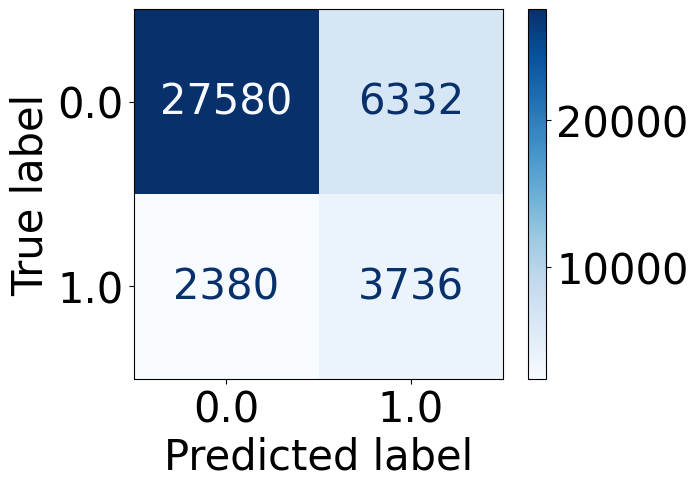

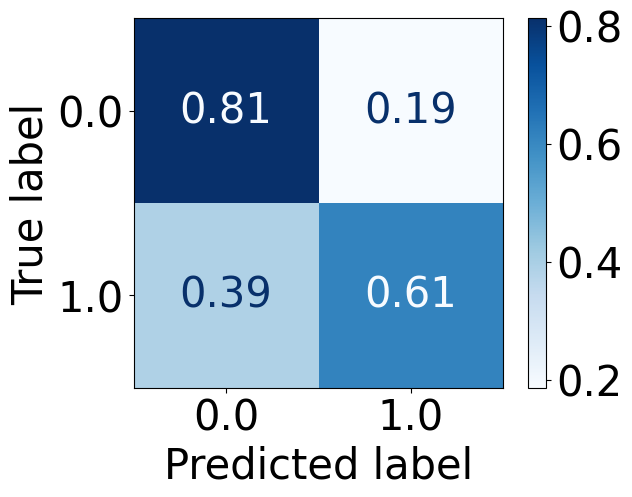

In [58]:
plt.rcParams['font.size'] = 30
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_SMOTE,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_SMOTE,cmap=plt.cm.Blues, normalize="true")

### Performance over subgroups

## ADASYN (Adaptive Synthetic Sampling)

### Train and test

In [59]:
race_dict = {1: 'White', 2: 'Black', 3: 'American Indian', 4: 'Asian', 5: 'Native Hawaiian', 6: 'Other race',  7: 'Multiracial', 8: 'Hispanic'}
race_dict_rev = {v: k for k, v in race_dict.items()}

df_train_2021['Race'] = df_train_2021['Race'].replace(race_dict_rev)
df_train_2021

,Blood pressure,Cholesterol,BMI category,Stroke,Heart disease,Consume fruits,Consume vegitables,Alcoholic,Health insurance,Unaffordable healthcare,...,Employment status_Self-employed,Employment status_Student,Employment status_Unable to work,Marital status_Divorced,Marital status_Married,Marital status_Never married,Marital status_Separated,Marital status_Unmarried couple,Marital status_Widowed,Race
99749,0.0,0.0,4.0,0.0,0.0,1,1,0,1,0.0,...,0,0,1,0,1,0,0,0,0,8
85033,0.0,0.0,2.0,0.0,0.0,0,1,1,1,0.0,...,0,0,0,0,0,0,0,0,1,1
19523,0.0,1.0,4.0,0.0,0.0,1,1,1,1,0.0,...,0,0,0,0,1,0,0,0,0,5
172614,0.0,1.0,3.0,0.0,0.0,0,1,0,1,0.0,...,0,0,1,0,1,0,0,0,0,8
27291,1.0,1.0,2.0,0.0,0.0,1,1,1,1,0.0,...,0,0,0,1,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73349,0.0,0.0,4.0,0.0,0.0,1,1,1,1,0.0,...,0,0,0,0,0,0,0,1,0,1
109259,1.0,1.0,3.0,1.0,0.0,1,1,1,1,0.0,...,0,0,0,0,1,0,0,0,0,1
50057,1.0,0.0,4.0,1.0,0.0,0,1,1,1,1.0,...,0,0,0,1,0,0,0,0,0,2
5192,1.0,0.0,2.0,0.0,0.0,0,0,0,1,0.0,...,0,0,0,0,0,0,0,0,1,1


In [60]:
import pandas as pd
from imblearn.over_sampling import ADASYN

# Assuming you have your trainset DataFrame with 'Diabetes' column as labels
# X_train: Features, y_train: Labels
X_train = df_train_2021.drop('Diabetes', axis=1)
y_train = df_train_2021['Diabetes']

# Create an instance of ADASYN
adasyn = ADASYN(sampling_strategy='auto')

# Oversample the minority class using ADASYN
X_resampled, y_resampled = adasyn.fit_resample(X_train, y_train)

# Create a new DataFrame with the resampled data
resampled_trainset = pd.concat([X_resampled, y_resampled], axis=1)



In [61]:
df_train_2021_ADASYN = resampled_trainset
# Now resampled_trainset contains the oversampled data using ADASYN
df_train_2021.shape, df_train_2021_ADASYN.shape, df_train_2021_ADASYN.groupby(['Diabetes']).size()

((160108, 50),
 (270190, 50),
 Diabetes
 0.0    135384
 1.0    134806
 dtype: int64)

In [62]:
X_train_2021_ADASYN = df_train_2021_ADASYN.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_ADASYN = df_train_2021_ADASYN['Diabetes']
X_train_2021_ADASYN.shape, X_test_2021.shape

((270190, 48), (40028, 48))

In [63]:
lr_ADASYN = LogisticRegression(solver='liblinear')
lr_ADASYN.fit(X_train_2021_ADASYN, y_train_2021_ADASYN)

pred_prob_test_2021_lr_ADASYN = lr_ADASYN.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_ADASYN = lr_ADASYN.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_ADASYN))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_ADASYN))

accuracy 0.776606375537124
              precision    recall  f1-score   support

         0.0       0.92      0.81      0.86     33912
         1.0       0.36      0.62      0.46      6116

    accuracy                           0.78     40028
   macro avg       0.64      0.71      0.66     40028
weighted avg       0.84      0.78      0.80     40028



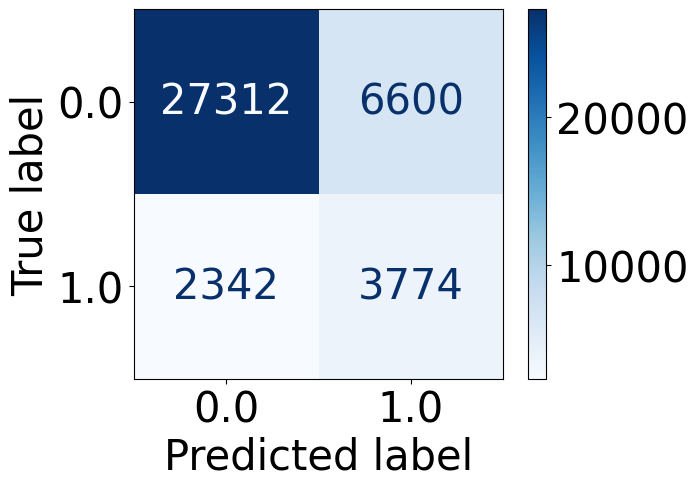

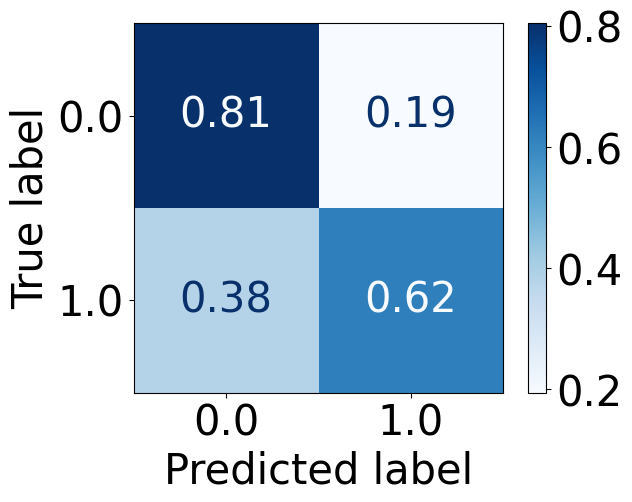

In [64]:
plt.rcParams['font.size'] = 30
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_ADASYN,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_ADASYN,cmap=plt.cm.Blues, normalize="true")

### Performance over subgroups

## TomekLinks
Note: Removing instances from the majority class that are close to instances in the minority class

### Train and test

In [65]:
import pandas as pd
from imblearn.under_sampling import TomekLinks

# Assuming you have your trainset DataFrame with 'Diabetes' column as labels
# X_train: Features, y_train: Labels
X_train = df_train_2021.drop('Diabetes', axis=1)
y_train = df_train_2021['Diabetes']

# Create an instance of TomekLinks
tomek_links = TomekLinks(sampling_strategy='auto')

# Undersample the majority class using TomekLinks
X_resampled, y_resampled = tomek_links.fit_resample(X_train, y_train)

# Create a new DataFrame with the undersampled data
df_train_2021_TomekLinks = pd.concat([X_resampled, y_resampled], axis=1)

# Now undersampled_trainset contains the undersampled data using TomekLinks
df_train_2021.shape, df_train_2021_TomekLinks.shape, df_train_2021_TomekLinks.groupby(['Diabetes']).size()

((160108, 50),
 (155761, 50),
 Diabetes
 0.0    131037
 1.0     24724
 dtype: int64)

In [66]:
X_train_2021_TomekLinks = df_train_2021_TomekLinks.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_TomekLinks = df_train_2021_TomekLinks['Diabetes']
X_train_2021_TomekLinks.shape, X_test_2021.shape

((155761, 48), (40028, 48))

In [67]:
lr_TomekLinks = LogisticRegression(solver='liblinear')
lr_TomekLinks.fit(X_train_2021_TomekLinks, y_train_2021_TomekLinks)

pred_prob_test_2021_lr_TomekLinks = lr_TomekLinks.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_TomekLinks = lr_TomekLinks.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_TomekLinks))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_TomekLinks))

accuracy 0.8553512541221145
              precision    recall  f1-score   support

         0.0       0.88      0.97      0.92     33912
         1.0       0.56      0.24      0.34      6116

    accuracy                           0.86     40028
   macro avg       0.72      0.60      0.63     40028
weighted avg       0.83      0.86      0.83     40028



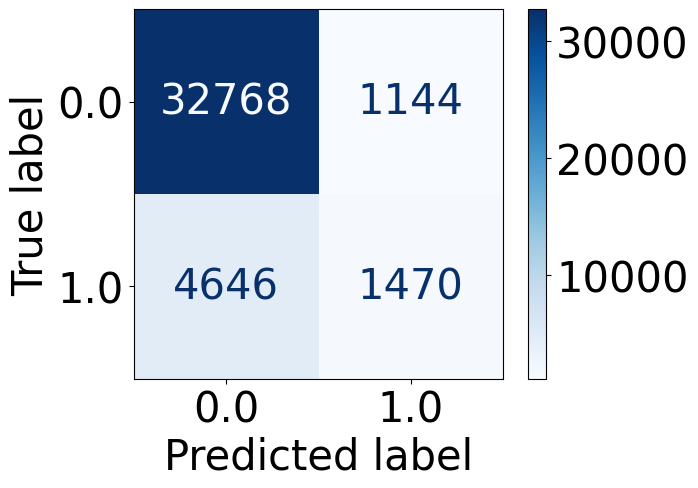

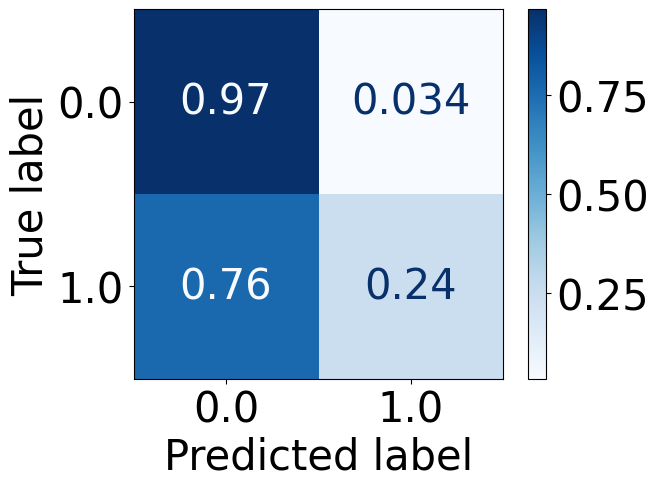

In [68]:
plt.rcParams['font.size'] = 30
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_TomekLinks,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_TomekLinks,cmap=plt.cm.Blues, normalize="true")

### Performance over subgroups

## ENN (Edited Nearest Neighbors) - Undersampling
Removing instances from the majority class that are misclassified based on the nearest neighbors from both classes.


In [69]:

from imblearn.under_sampling import EditedNearestNeighbours

# Assuming you have your trainset DataFrame with 'Diabetes' column as labels
# X_train: Features, y_train: Labels
X_train = df_train_2021.drop('Diabetes', axis=1)
y_train = df_train_2021['Diabetes']

# Create an instance of EditedNearestNeighbours with adjusted parameters
enn_sampler = EditedNearestNeighbours(sampling_strategy='auto', n_neighbors=3)

# Apply Edited Nearest Neighbors under-sampling
X_resampled, y_resampled = enn_sampler.fit_resample(X_train, y_train)

# Create a new DataFrame with the resampled data
df_train_2021_ENN = pd.concat([X_resampled, y_resampled], axis=1)



In [70]:
# Now resampled_trainset contains the resampled data using Edited Nearest Neighbors under-sampling
df_train_2021.shape, df_train_2021.groupby(['Diabetes']).size(), df_train_2021_ENN.shape, df_train_2021_ENN.groupby(['Diabetes']).size()

((160108, 50),
 Diabetes
 0.0    135384
 1.0     24724
 dtype: int64,
 (122593, 50),
 Diabetes
 0.0    97869
 1.0    24724
 dtype: int64)

In [71]:
X_train_2021_ENN = df_train_2021_ENN.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_ENN = df_train_2021_ENN['Diabetes']
X_train_2021_ENN.shape, X_test_2021.shape

((122593, 48), (40028, 48))

In [72]:
lr_ENN = LogisticRegression(solver='liblinear')
lr_ENN.fit(X_train_2021_ENN, y_train_2021_ENN)

pred_prob_test_2021_lr_ENN = lr_ENN.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_ENN = lr_ENN.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_ENN))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_ENN))

accuracy 0.8200259818127311
              precision    recall  f1-score   support

         0.0       0.91      0.87      0.89     33912
         1.0       0.43      0.53      0.47      6116

    accuracy                           0.82     40028
   macro avg       0.67      0.70      0.68     40028
weighted avg       0.84      0.82      0.83     40028



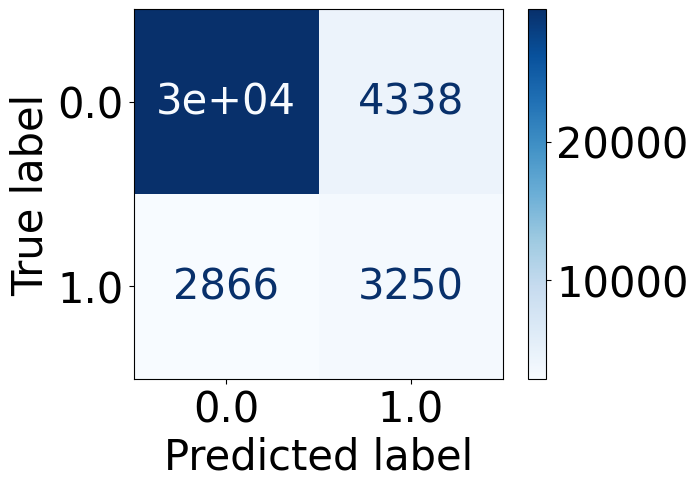

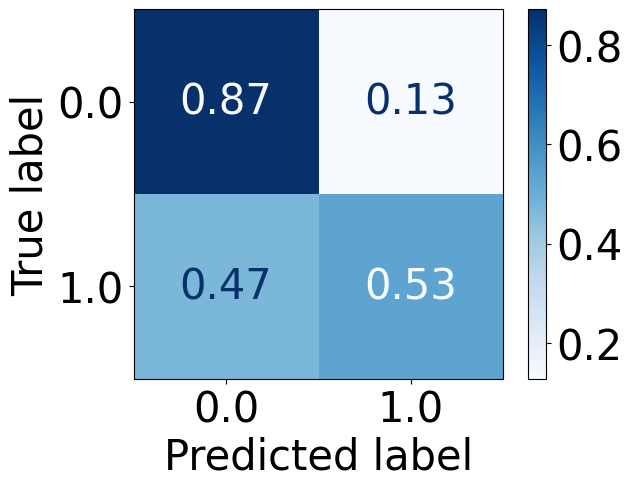

In [73]:
plt.rcParams['font.size'] = 30
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_ENN,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_ENN,cmap=plt.cm.Blues, normalize="true")

## Near Miss

### Train and test

In [74]:
import pandas as pd
from imblearn.under_sampling import NearMiss

# Assuming you have your trainset DataFrame with 'Diabetes' column as labels
# X_train: Features, y_train: Labels
X_train = df_train_2021.drop('Diabetes', axis=1)
y_train = df_train_2021['Diabetes']

# Create an instance of NearMiss with adjusted parameters
nearmiss_sampler = NearMiss(sampling_strategy='auto', version=1)

# Apply NearMiss under-sampling
X_resampled, y_resampled = nearmiss_sampler.fit_resample(X_train, y_train)

# Create a new DataFrame with the resampled data
df_train_2021_NearMiss = pd.concat([X_resampled, y_resampled], axis=1)



In [75]:
# Now resampled_trainset contains the resampled data using NearMiss under-sampling
df_train_2021.shape, df_train_2021.groupby(['Diabetes']).size(), df_train_2021_NearMiss.shape, df_train_2021_NearMiss.groupby(['Diabetes']).size()

((160108, 50),
 Diabetes
 0.0    135384
 1.0     24724
 dtype: int64,
 (49448, 50),
 Diabetes
 0.0    24724
 1.0    24724
 dtype: int64)

In [76]:
X_train_2021_NearMiss = df_train_2021_NearMiss.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_NearMiss = df_train_2021_NearMiss['Diabetes']
X_train_2021_NearMiss.shape, X_test_2021.shape

((49448, 48), (40028, 48))

In [77]:
lr_NearMiss = LogisticRegression(solver='liblinear')
lr_NearMiss.fit(X_train_2021_ENN, y_train_2021_ENN)

pred_prob_test_2021_lr_NearMiss = lr_NearMiss.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_NearMiss = lr_NearMiss.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_NearMiss))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_NearMiss))

accuracy 0.8200259818127311
              precision    recall  f1-score   support

         0.0       0.91      0.87      0.89     33912
         1.0       0.43      0.53      0.47      6116

    accuracy                           0.82     40028
   macro avg       0.67      0.70      0.68     40028
weighted avg       0.84      0.82      0.83     40028



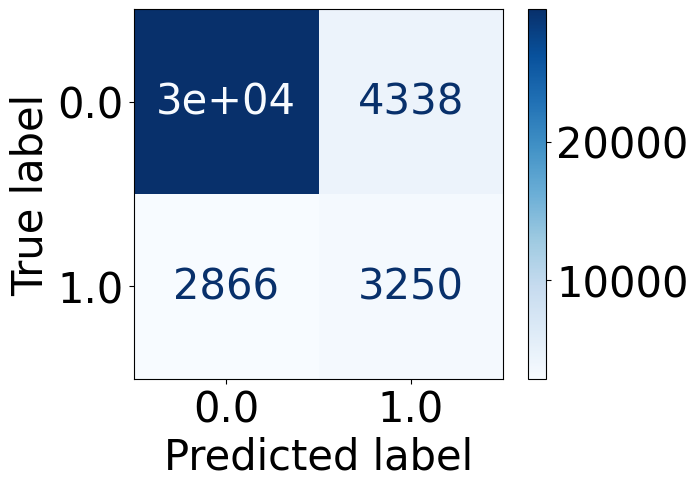

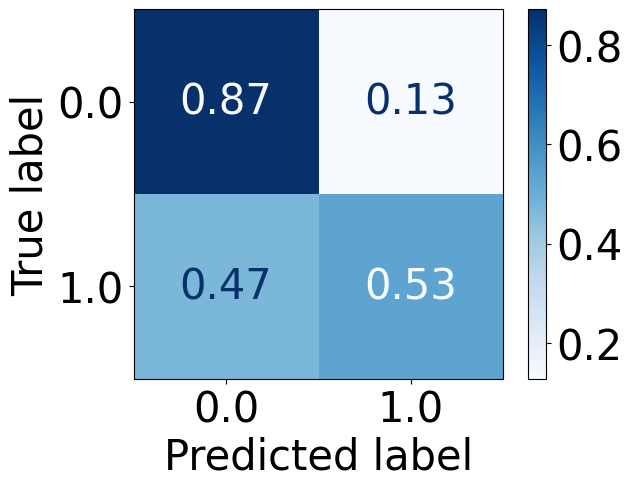

In [78]:
plt.rcParams['font.size'] = 30
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_ENN,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_ENN,cmap=plt.cm.Blues, normalize="true")

### Performance over subgroups

## Combined - Random SMOTE

### Train and test

In [79]:
import pandas as pd
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTEENN
from imblearn.under_sampling import RandomUnderSampler

# Assuming you have your trainset DataFrame with 'Diabetes' column as labels
# X_train: Features, y_train: Labels
X_train = df_train_2021.drop('Diabetes', axis=1)
y_train = df_train_2021['Diabetes']

# Create an instance of SMOTE to oversample the minority class
smote = SMOTE(sampling_strategy='auto', random_state=42)

# Create an instance of RandomUnderSampler to undersample the majority class
rus = RandomUnderSampler(sampling_strategy='auto', random_state=42)

# Combine SMOTE and RandomUnderSampler using SMOTEENN
random_smote_sampler = SMOTEENN(sampling_strategy='auto', smote=smote, random_state=42)

# Apply Random-SMOTE under-sampling and over-sampling
X_resampled, y_resampled = random_smote_sampler.fit_resample(X_train, y_train)

# Create a new DataFrame with the resampled data
df_train_2021_combined = pd.concat([X_resampled, y_resampled], axis=1)


In [80]:
# Now resampled_trainset contains the resampled data using Random-SMOTE
df_train_2021.shape, df_train_2021.groupby(['Diabetes']).size(), df_train_2021_combined.shape, df_train_2021_combined.groupby(['Diabetes']).size()

((160108, 50),
 Diabetes
 0.0    135384
 1.0     24724
 dtype: int64,
 (204234, 50),
 Diabetes
 0.0     76253
 1.0    127981
 dtype: int64)

In [81]:
X_train_2021_combined = df_train_2021_combined.drop(['Diabetes', 'Race'],axis=1)
y_train_2021_combined = df_train_2021_combined['Diabetes']
X_train_2021_combined.shape, X_test_2021.shape

((204234, 48), (40028, 48))

In [82]:
lr_combined = LogisticRegression(solver='liblinear')
lr_combined.fit(X_train_2021_ENN, y_train_2021_ENN)

pred_prob_test_2021_lr_combined = lr_combined.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_combined = lr_combined.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_combined))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_combined))

accuracy 0.8200259818127311
              precision    recall  f1-score   support

         0.0       0.91      0.87      0.89     33912
         1.0       0.43      0.53      0.47      6116

    accuracy                           0.82     40028
   macro avg       0.67      0.70      0.68     40028
weighted avg       0.84      0.82      0.83     40028



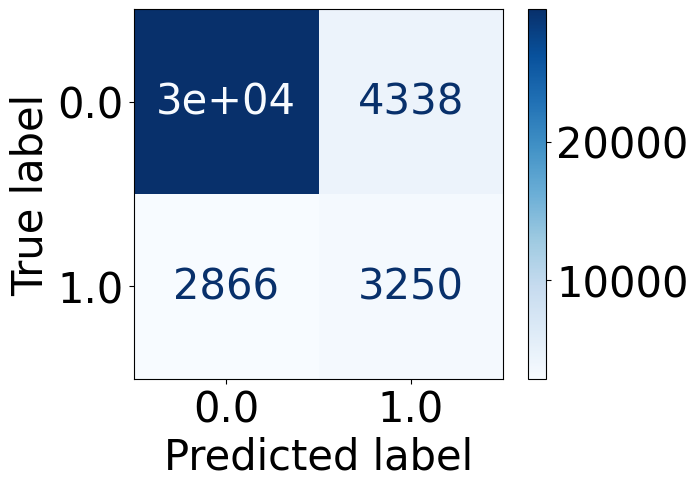

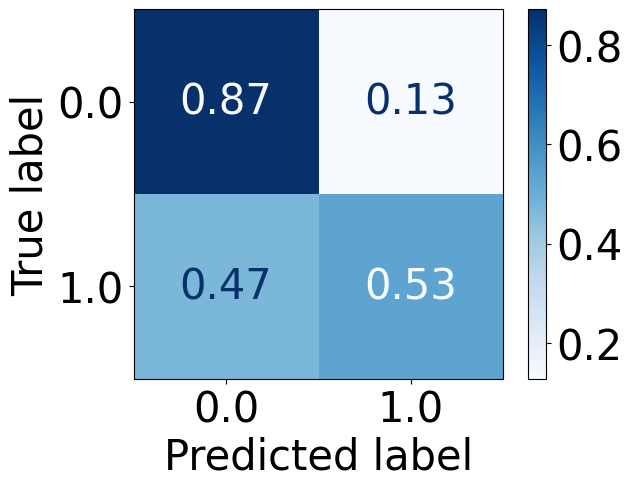

In [83]:
plt.rcParams['font.size'] = 30
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_combined,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_combined,cmap=plt.cm.Blues, normalize="true")

### Performance over subgroups

## Cost-sensitive learning

### Train and test

In [84]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report

# Load your dataset and create X_train, X_test, y_train, y_test
# X_train: Features for training, y_train: Labels for training
# X_test: Features for testing, y_test: Labels for testing

X_train_2021= df_train_2021.drop(['Diabetes', 'Race'],axis=1)
y_train_2021 = df_train_2021['Diabetes']

# Create a LogisticRegression classifier with class_weight parameter
# Set class_weight='balanced' to automatically adjust class weights
# Alternatively, you can set class_weight manually based on your preference
clf = LogisticRegression(class_weight='balanced', random_state=42)

# Fit the classifier to the training data
clf.fit(X_train_2021, y_train_2021)

# Predict on the test data
y_pred = clf.predict(X_test_2021)

# Print classification report
print(classification_report(y_test_2021, y_pred))


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


              precision    recall  f1-score   support

         0.0       0.94      0.73      0.82     33912
         1.0       0.34      0.76      0.47      6116

    accuracy                           0.73     40028
   macro avg       0.64      0.74      0.64     40028
weighted avg       0.85      0.73      0.77     40028



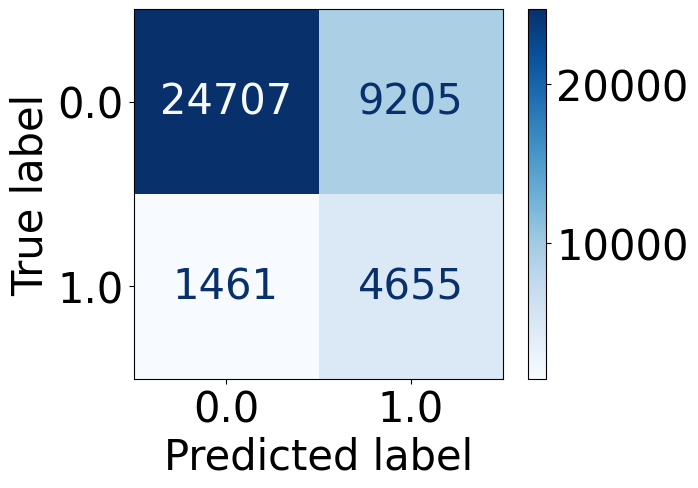

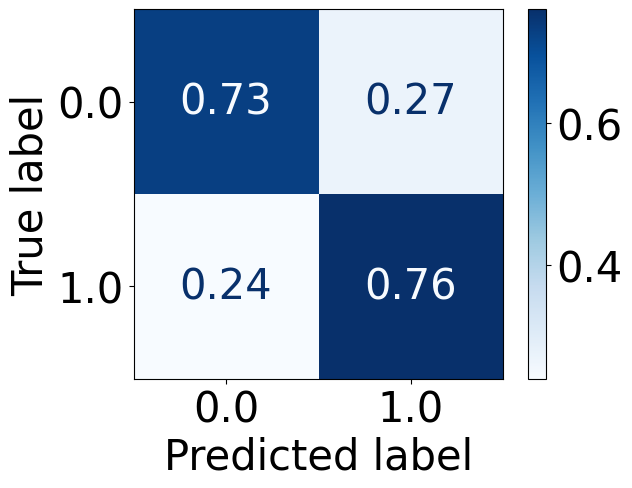

In [85]:
plt.rcParams['font.size'] = 30
ConfusionMatrixDisplay.from_predictions(y_test_2021, y_pred,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, y_pred,cmap=plt.cm.Blues, normalize="true")

In [ ]:
# Define class weights
class_weights = {0: 1, 1: 5}  # 1 for majority class, 5 for minority class

# Create a LogisticRegression classifier with custom class weights
clf = LogisticRegression(class_weight=class_weights, random_state=42)

# Fit the classifier to the training data
clf.fit(X_train_2021, y_train_2021)

# Predict on the test data
y_pred = clf.predict(X_test_2021)

# Print classification report
print(classification_report(y_test_2021, y_pred))

              precision    recall  f1-score   support

         0.0       0.94      0.75      0.83     33912
         1.0       0.35      0.74      0.47      6116

    accuracy                           0.75     40028
   macro avg       0.64      0.74      0.65     40028
weighted avg       0.85      0.75      0.78     40028



/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


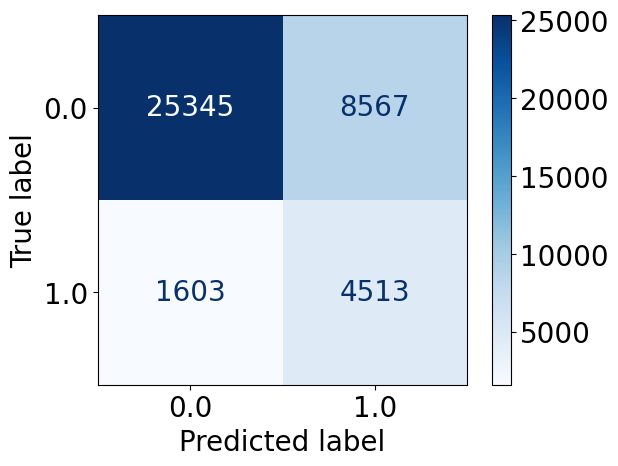

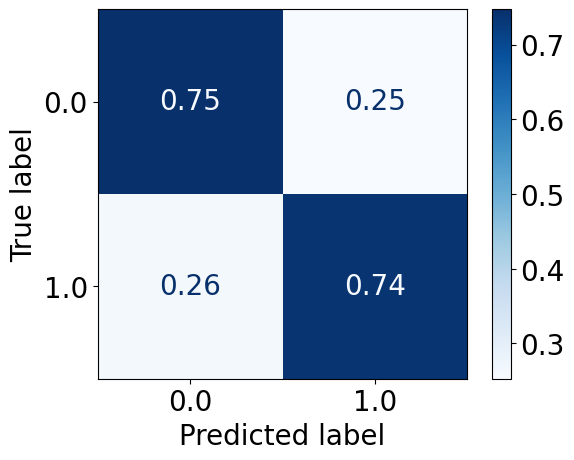

In [ ]:
plt.rcParams['font.size'] = 20
ConfusionMatrixDisplay.from_predictions(y_test_2021, y_pred,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, y_pred,cmap=plt.cm.Blues, normalize="true")

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


              precision    recall  f1-score   support

         0.0       0.93      0.80      0.86     33912
         1.0       0.37      0.67      0.48      6116

    accuracy                           0.78     40028
   macro avg       0.65      0.73      0.67     40028
weighted avg       0.85      0.78      0.80     40028



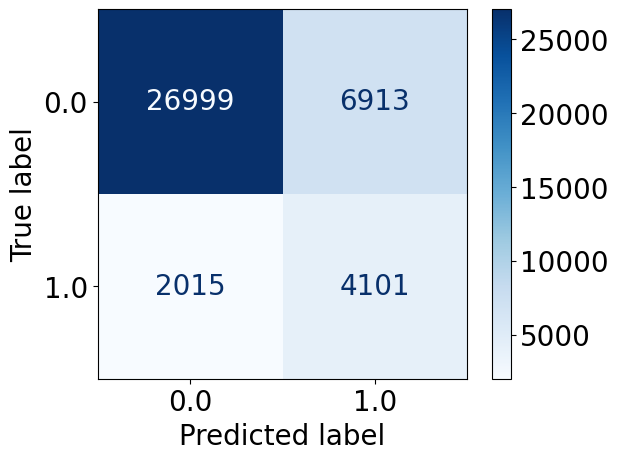

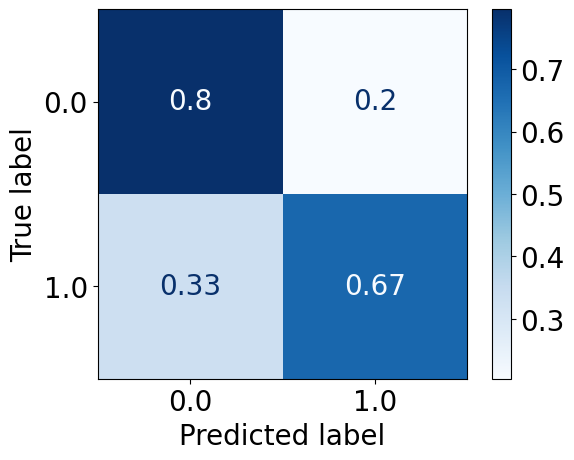

In [ ]:
# Define class weights
class_weights = {0: 1, 1: 4}  # 1 for majority class, 5 for minority class

# Create a LogisticRegression classifier with custom class weights
clf = LogisticRegression(class_weight=class_weights, random_state=42)

# Fit the classifier to the training data
clf.fit(X_train_2021, y_train_2021)

# Predict on the test data
y_pred = clf.predict(X_test_2021)

# Print classification report
print(classification_report(y_test_2021, y_pred))

plt.rcParams['font.size'] = 20
ConfusionMatrixDisplay.from_predictions(y_test_2021, y_pred,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, y_pred,cmap=plt.cm.Blues, normalize="true")

# Multi year analysis


## Train on 2021 (Imbalanced) and test on other years

### Train on 2021 and test on 2021

#### LR

accuracy 0.8558259218547017
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     33912
         1.0       0.58      0.21      0.30      6116

    accuracy                           0.86     40028
   macro avg       0.73      0.59      0.61     40028
weighted avg       0.83      0.86      0.83     40028



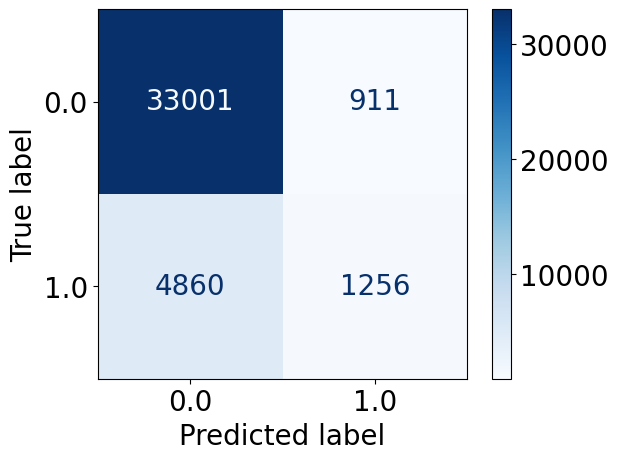

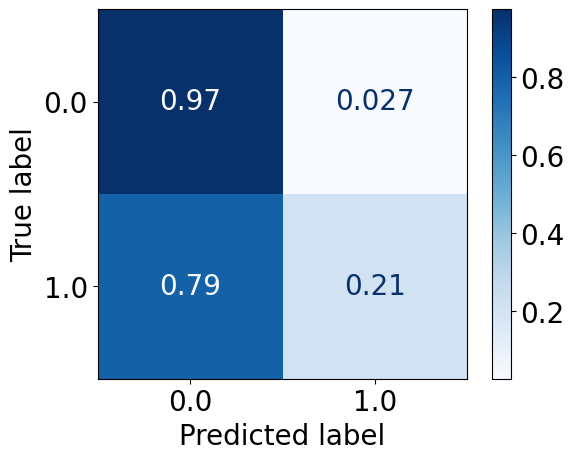

In [ ]:
lr_2021 = LogisticRegression(solver='liblinear')
lr_2021.fit(X_train_2021, y_train_2021)

pred_prob_test_2021_lr = lr_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr = lr_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_lr, pred_prob_test_2021_lr)

Class 1 Recall: 0.2053629823413996
Class 1 Precision: 0.5796031379787725
Class 1 Area Under Precision-Recall Curve: 0.4507508031425717
Class 1 F1-Score: 0.3032717614390921
Class 0 Recall: 0.9731363529134229
Class 0 Precision: 0.871635720134175
Class 0 Area Under Precision-Recall Curve: 0.7152760233747096
Class 0 F1-Score: 0.9195937190865645
Overall Accuracy: 0.8558259218547017
Balanced Accuracy: 0.5892496676274113
Area Under ROC Curve: 0.8234227349832158
Matthews Correlation Coefficient: 0.283805983401172
0.2053629823413996
0.5796031379787725
0.4507508031425717
0.3032717614390921
0.9731363529134229
0.871635720134175
0.7152760233747096
0.9195937190865645
0.8558259218547017
0.5892496676274113
0.8234227349832158
0.283805983401172


#### RF

accuracy 0.85212851004297
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     33912
         1.0       0.55      0.18      0.27      6116

    accuracy                           0.85     40028
   macro avg       0.71      0.58      0.60     40028
weighted avg       0.82      0.85      0.82     40028



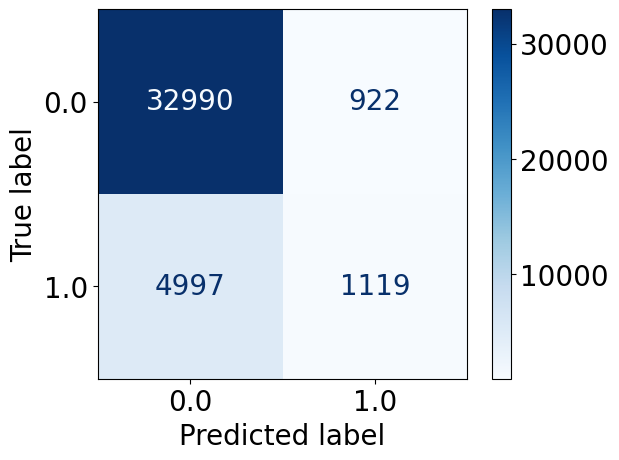

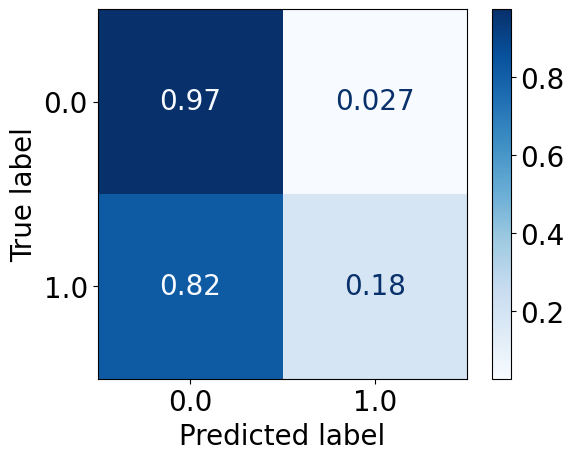

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rf_2021 = RandomForestClassifier()
rf_2021.fit(X_train_2021, y_train_2021)

pred_prob_test_2021_rf = rf_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_rf = rf_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_rf))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_rf))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_rf,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_rf,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_rf, pred_prob_test_2021_rf)

Class 1 Recall: 0.1829627207325049
Class 1 Precision: 0.5482606565409113
Class 1 Area Under Precision-Recall Curve: 0.40947052577934157
Class 1 F1-Score: 0.27436557557925706
Class 0 Recall: 0.9728119839584808
Class 0 Precision: 0.8684549977623924
Class 0 Area Under Precision-Recall Curve: 0.7282019763438848
Class 0 F1-Score: 0.9176761846479089
Overall Accuracy: 0.85212851004297
Balanced Accuracy: 0.5778873523454928
Area Under ROC Curve: 0.802528258227234
Matthews Correlation Coefficient: 0.25478178504203947
0.1829627207325049
0.5482606565409113
0.40947052577934157
0.27436557557925706
0.9728119839584808
0.8684549977623924
0.7282019763438848
0.9176761846479089
0.85212851004297
0.5778873523454928
0.802528258227234
0.25478178504203947


#### SVM

/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=100).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


accuracy 0.723393624462876
              precision    recall  f1-score   support

         0.0       0.90      0.76      0.82     33912
         1.0       0.29      0.55      0.38      6116

    accuracy                           0.72     40028
   macro avg       0.59      0.65      0.60     40028
weighted avg       0.81      0.72      0.75     40028



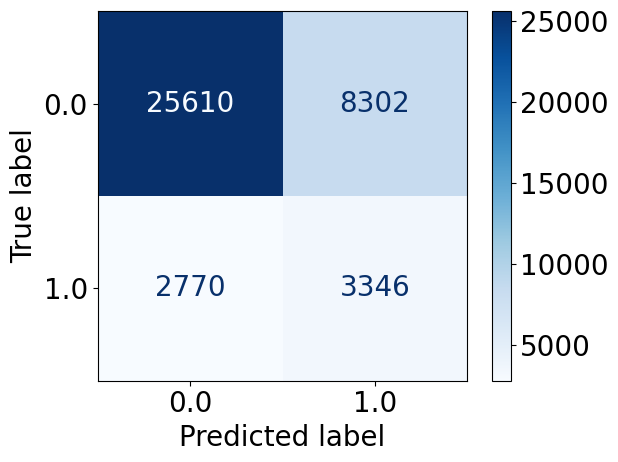

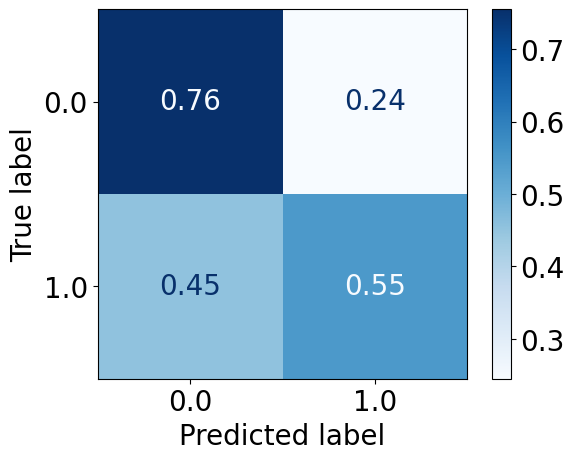

In [ ]:
from sklearn.svm import SVC
svm_2021 = SVC(probability=True, kernel='rbf', max_iter = 100)
svm_2021.fit(X_train_2021, y_train_2021)

pred_prob_test_2021_svm = svm_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_svm = svm_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_svm))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_svm))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_svm,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_svm,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_svm, pred_prob_test_2021_svm)

Class 1 Recall: 0.5470896010464356
Class 1 Precision: 0.28725961538461536
Class 1 Area Under Precision-Recall Curve: 0.2981258725983937
Class 1 F1-Score: 0.3767169556406215
Class 0 Recall: 0.7551899032790752
Class 0 Precision: 0.9023960535588442
Class 0 Area Under Precision-Recall Curve: 0.7577194689564379
Class 0 F1-Score: 0.8222564695305977
Overall Accuracy: 0.723393624462876
Balanced Accuracy: 0.6511397521627553
Area Under ROC Curve: 0.7284595649093542
Matthews Correlation Coefficient: 0.23943479613613422
0.5470896010464356
0.28725961538461536
0.2981258725983937
0.3767169556406215
0.7551899032790752
0.9023960535588442
0.7577194689564379
0.8222564695305977
0.723393624462876
0.6511397521627553
0.7284595649093542
0.23943479613613422


#### KNN

accuracy 0.8385630058958728
              precision    recall  f1-score   support

         0.0       0.87      0.95      0.91     33912
         1.0       0.44      0.20      0.27      6116

    accuracy                           0.84     40028
   macro avg       0.65      0.58      0.59     40028
weighted avg       0.80      0.84      0.81     40028



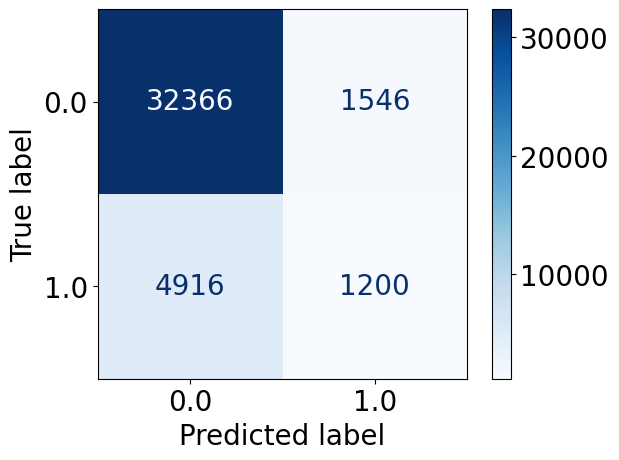

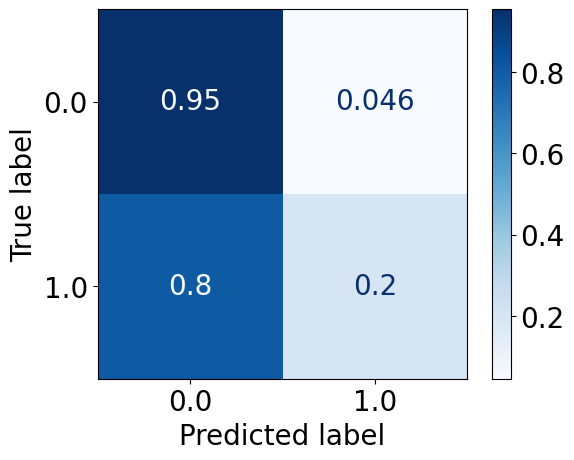

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn_2021 = KNeighborsClassifier(n_neighbors=5)
knn_2021.fit(X_train_2021, y_train_2021)

pred_prob_test_2021_knn = knn_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_knn = knn_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_knn))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_knn))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_knn,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_knn,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_knn, pred_prob_test_2021_knn)

Class 1 Recall: 0.1962066710268149
Class 1 Precision: 0.43699927166788055
Class 1 Area Under Precision-Recall Curve: 0.299207842470238
Class 1 F1-Score: 0.2708192281651997
Class 0 Recall: 0.954411417787214
Class 0 Precision: 0.868140121238131
Class 0 Area Under Precision-Recall Curve: 0.7871629279277313
Class 0 F1-Score: 0.909233924207096
Overall Accuracy: 0.8385630058958728
Balanced Accuracy: 0.5753090444070145
Area Under ROC Curve: 0.720919196894945
Matthews Correlation Coefficient: 0.2143816974029651
0.1962066710268149
0.43699927166788055
0.299207842470238
0.2708192281651997
0.954411417787214
0.868140121238131
0.7871629279277313
0.909233924207096
0.8385630058958728
0.5753090444070145
0.720919196894945
0.2143816974029651


#### MLP

accuracy 0.8547766563405617
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     33912
         1.0       0.56      0.23      0.33      6116

    accuracy                           0.85     40028
   macro avg       0.72      0.60      0.62     40028
weighted avg       0.83      0.85      0.83     40028



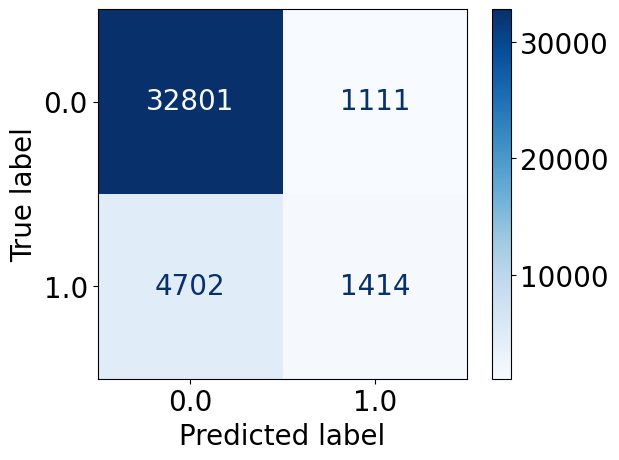

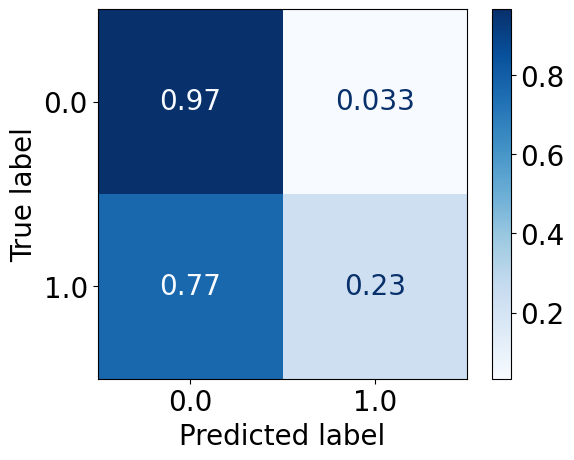

In [ ]:
from sklearn.neural_network import MLPClassifier
mlp_2021= MLPClassifier()
mlp_2021.fit(X_train_2021, y_train_2021)

pred_prob_test_2021_mlp = mlp_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_mlp = mlp_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_mlp))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_mlp))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_mlp,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_mlp,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_mlp, pred_prob_test_2021_mlp)

Class 1 Recall: 0.23119686069326356
Class 1 Precision: 0.56
Class 1 Area Under Precision-Recall Curve: 0.4362794333230925
Class 1 F1-Score: 0.3272769355398681
Class 0 Recall: 0.9672387355508375
Class 0 Precision: 0.8746233634642562
Class 0 Area Under Precision-Recall Curve: 0.7177046438843466
Class 0 F1-Score: 0.9186025344815514
Overall Accuracy: 0.8547766563405617
Balanced Accuracy: 0.5992177981220506
Area Under ROC Curve: 0.8186972883573087
Matthews Correlation Coefficient: 0.29367455843270845
0.23119686069326356
0.56
0.4362794333230925
0.3272769355398681
0.9672387355508375
0.8746233634642562
0.7177046438843466
0.9186025344815514
0.8547766563405617
0.5992177981220506
0.8186972883573087
0.29367455843270845


### Test on 2019

#### LR

accuracy 0.8536573799644339
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     35675
         1.0       0.56      0.22      0.32      6500

    accuracy                           0.85     42175
   macro avg       0.72      0.59      0.62     42175
weighted avg       0.82      0.85      0.83     42175



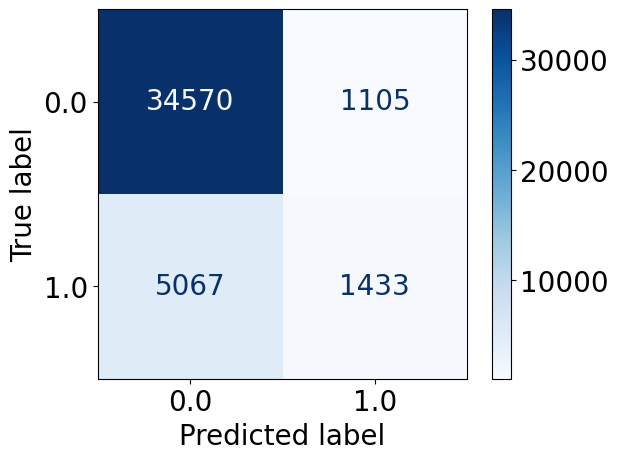

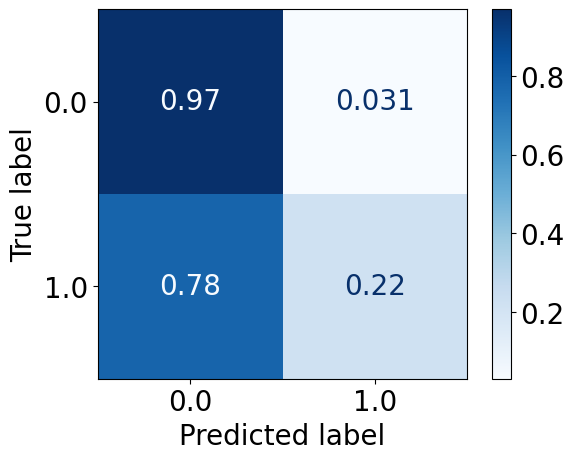

In [ ]:
pred_prob_test_2019_lr_2021 = lr_2021.predict_proba(X_test_2019)[:, 1]
pred_test_2019_lr_2021 = lr_2021.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_lr_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_lr_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_lr_2021, pred_prob_test_2019_lr_2021)

Class 1 Recall: 0.22046153846153846
Class 1 Precision: 0.5646178092986603
Class 1 Area Under Precision-Recall Curve: 0.4513267780756198
Class 1 F1-Score: 0.3171055543261783
Class 0 Recall: 0.9690259285213735
Class 0 Precision: 0.8721648964351489
Class 0 Area Under Precision-Recall Curve: 0.71365884930005
Class 0 F1-Score: 0.9180475886976843
Overall Accuracy: 0.8536573799644339
Balanced Accuracy: 0.5947437334914559
Area Under ROC Curve: 0.8230189380626382
Matthews Correlation Coefficient: 0.28768880501584027
0.22046153846153846
0.5646178092986603
0.4513267780756198
0.3171055543261783
0.9690259285213735
0.8721648964351489
0.71365884930005
0.9180475886976843
0.8536573799644339
0.5947437334914559
0.8230189380626382
0.28768880501584027


#### RF

accuracy 0.8502904564315352
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     35675
         1.0       0.54      0.18      0.27      6500

    accuracy                           0.85     42175
   macro avg       0.70      0.58      0.59     42175
weighted avg       0.82      0.85      0.82     42175



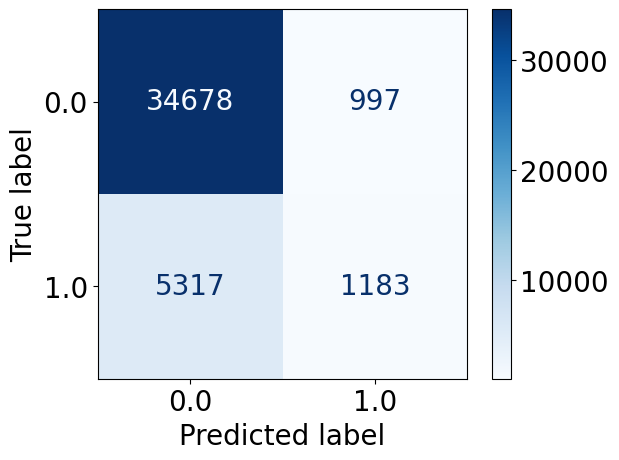

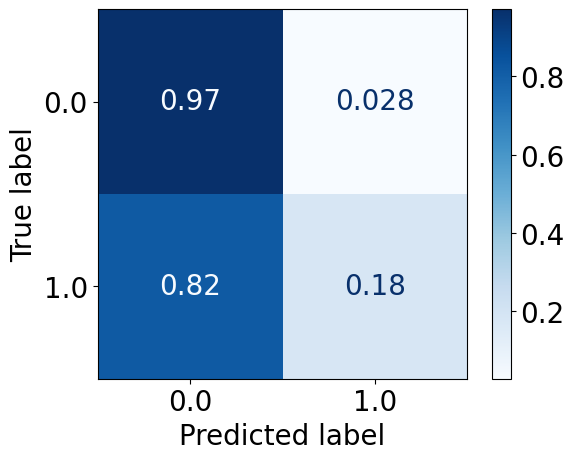

In [ ]:
pred_prob_test_2019_rf_2021 = rf_2021.predict_proba(X_test_2019)[:, 1]
pred_test_2019_rf_2021 = rf_2021.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_rf_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_rf_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_rf_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_rf_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_rf_2021, pred_prob_test_2019_rf_2021)

Class 1 Recall: 0.182
Class 1 Precision: 0.5426605504587156
Class 1 Area Under Precision-Recall Curve: 0.4108681944557388
Class 1 F1-Score: 0.2725806451612903
Class 0 Recall: 0.9720532585844429
Class 0 Precision: 0.8670583822977872
Class 0 Area Under Precision-Recall Curve: 0.7249800938973293
Class 0 F1-Score: 0.9165587419056429
Overall Accuracy: 0.8502904564315352
Balanced Accuracy: 0.5770266292922215
Area Under ROC Curve: 0.8050738159667943
Matthews Correlation Coefficient: 0.25123402774082876
0.182
0.5426605504587156
0.4108681944557388
0.2725806451612903
0.9720532585844429
0.8670583822977872
0.7249800938973293
0.9165587419056429
0.8502904564315352
0.5770266292922215
0.8050738159667943
0.25123402774082876


#### SVM

accuracy 0.7366212211025489
              precision    recall  f1-score   support

         0.0       0.89      0.78      0.83     35675
         1.0       0.29      0.49      0.36      6500

    accuracy                           0.74     42175
   macro avg       0.59      0.64      0.60     42175
weighted avg       0.80      0.74      0.76     42175



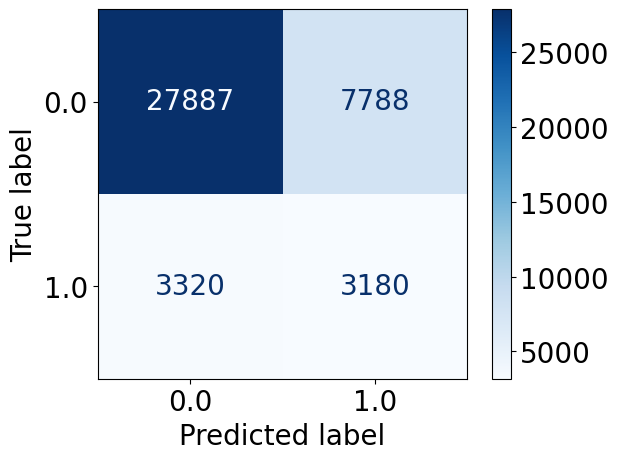

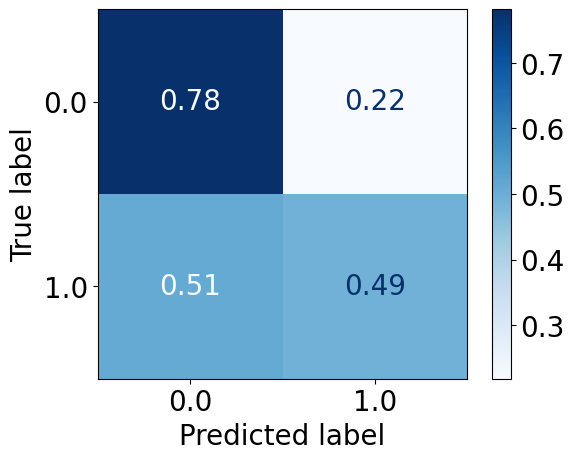

In [ ]:
pred_prob_test_2019_svm_2021 = svm_2021.predict_proba(X_test_2019)[:, 1]
pred_test_2019_svm_2021 = svm_2021.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_svm_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_svm_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_svm_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_svm_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_svm_2021, pred_prob_test_2019_svm_2021)

Class 1 Recall: 0.48923076923076925
Class 1 Precision: 0.2899343544857768
Class 1 Area Under Precision-Recall Curve: 0.28615473267983504
Class 1 F1-Score: 0.36409434394321044
Class 0 Recall: 0.7816958654519972
Class 0 Precision: 0.8936136123305669
Class 0 Area Under Precision-Recall Curve: 0.7614174831022416
Class 0 F1-Score: 0.8339164498669298
Overall Accuracy: 0.7366212211025489
Balanced Accuracy: 0.6354633173413833
Area Under ROC Curve: 0.7161007320360089
Matthews Correlation Coefficient: 0.22299783172133328
0.48923076923076925
0.2899343544857768
0.28615473267983504
0.36409434394321044
0.7816958654519972
0.8936136123305669
0.7614174831022416
0.8339164498669298
0.7366212211025489
0.6354633173413833
0.7161007320360089
0.22299783172133328


#### KNN

accuracy 0.8317486662714878
              precision    recall  f1-score   support

         0.0       0.87      0.94      0.90     35675
         1.0       0.41      0.21      0.28      6500

    accuracy                           0.83     42175
   macro avg       0.64      0.58      0.59     42175
weighted avg       0.80      0.83      0.81     42175



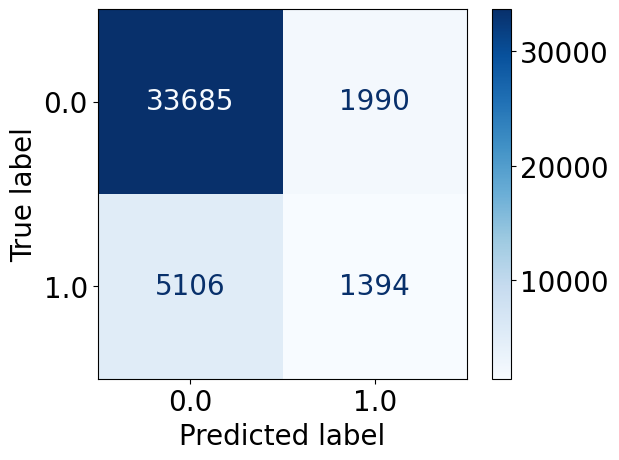

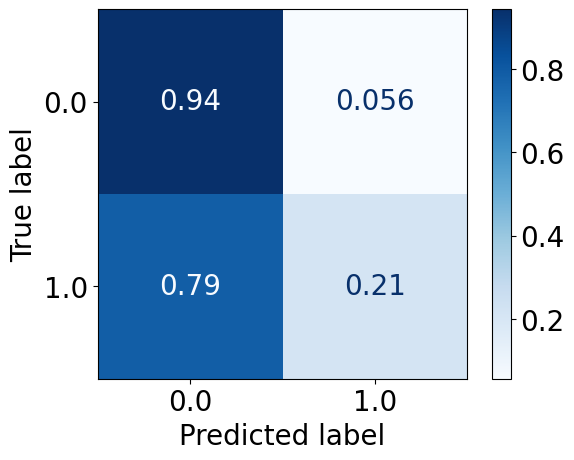

In [ ]:
pred_prob_test_2019_knn_2021 = knn_2021.predict_proba(X_test_2019)[:, 1]
pred_test_2019_knn_2021 = knn_2021.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_knn_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_knn_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_knn_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_knn_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_knn_2021, pred_prob_test_2019_knn_2021)

Class 1 Recall: 0.21446153846153845
Class 1 Precision: 0.4119385342789598
Class 1 Area Under Precision-Recall Curve: 0.2879842365909992
Class 1 F1-Score: 0.2820720356131121
Class 0 Recall: 0.9442186405045551
Class 0 Precision: 0.8683715294784873
Class 0 Area Under Precision-Recall Curve: 0.7865095968638111
Class 0 F1-Score: 0.9047081889721484
Overall Accuracy: 0.8317486662714878
Balanced Accuracy: 0.5793400894830467
Area Under ROC Curve: 0.7098754309740715
Matthews Correlation Coefficient: 0.21090199402335857
0.21446153846153845
0.4119385342789598
0.2879842365909992
0.2820720356131121
0.9442186405045551
0.8683715294784873
0.7865095968638111
0.9047081889721484
0.8317486662714878
0.5793400894830467
0.7098754309740715
0.21090199402335857


#### MLP

accuracy 0.8476111440426793
              precision    recall  f1-score   support

         0.0       0.87      0.96      0.91     35675
         1.0       0.51      0.24      0.33      6500

    accuracy                           0.85     42175
   macro avg       0.69      0.60      0.62     42175
weighted avg       0.82      0.85      0.82     42175



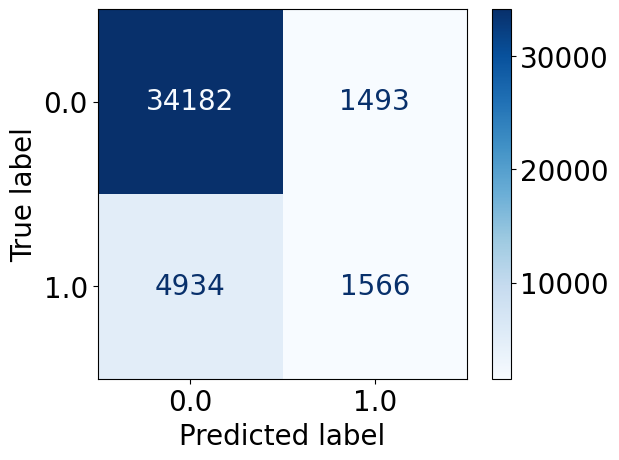

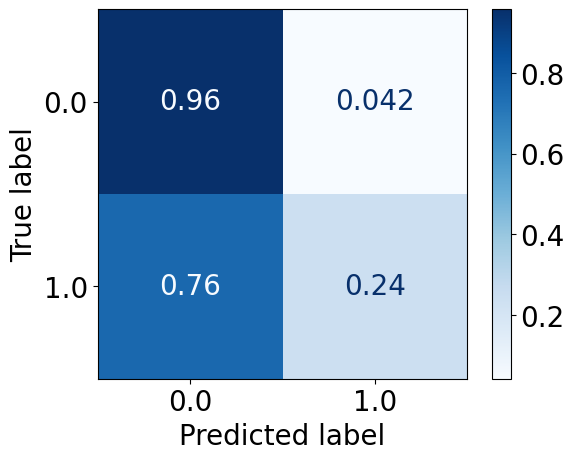

In [ ]:
pred_prob_test_2019_mlp_2021 = mlp_2021.predict_proba(X_test_2019)[:, 1]
pred_test_2019_mlp_2021 = mlp_2021.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_mlp_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_mlp_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_mlp_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_mlp_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_mlp_2021, pred_prob_test_2019_mlp_2021)

Class 1 Recall: 0.24092307692307693
Class 1 Precision: 0.5119320039228507
Class 1 Area Under Precision-Recall Curve: 0.41253146479766234
Class 1 F1-Score: 0.3276493357045716
Class 0 Recall: 0.9581499649614577
Class 0 Precision: 0.8738623581143267
Class 0 Area Under Precision-Recall Curve: 0.7212320948272943
Class 0 F1-Score: 0.9140672005990026
Overall Accuracy: 0.8476111440426793
Balanced Accuracy: 0.5995365209422673
Area Under ROC Curve: 0.8071790846854617
Matthews Correlation Coefficient: 0.2771303974533365
0.24092307692307693
0.5119320039228507
0.41253146479766234
0.3276493357045716
0.9581499649614577
0.8738623581143267
0.7212320948272943
0.9140672005990026
0.8476111440426793
0.5995365209422673
0.8071790846854617
0.2771303974533365


### Test on 2017

#### LR

accuracy 0.8562129929030362
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     40340
         1.0       0.58      0.22      0.32      7286

    accuracy                           0.86     47626
   macro avg       0.73      0.59      0.62     47626
weighted avg       0.83      0.86      0.83     47626



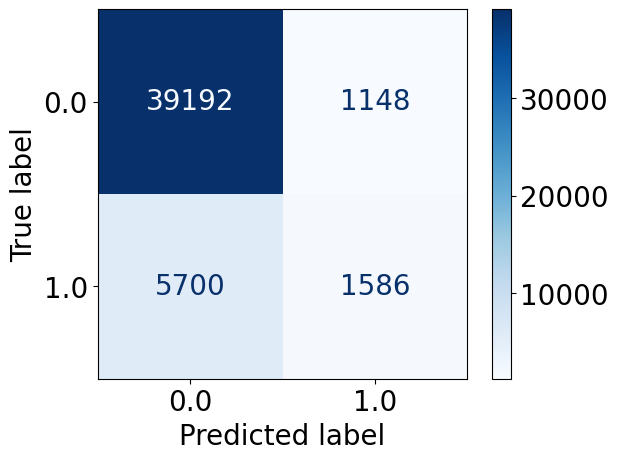

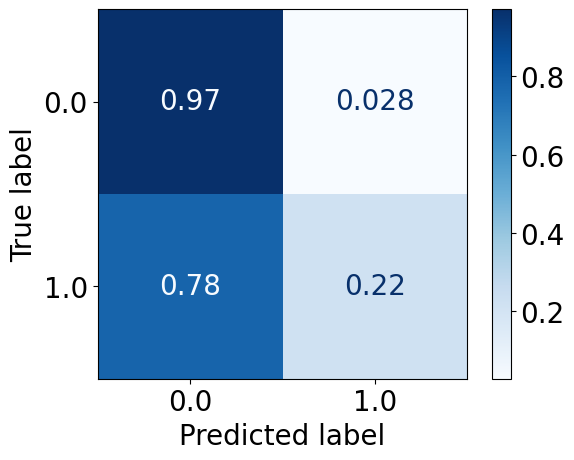

In [ ]:
pred_prob_test_2017_lr_2021 = lr_2021.predict_proba(X_test_2017)[:, 1]
pred_test_2017_lr_2021 = lr_2021.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_lr_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_lr_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_lr_2021, pred_prob_test_2017_lr_2021)

Class 1 Recall: 0.21767773812791655
Class 1 Precision: 0.5801024140453548
Class 1 Area Under Precision-Recall Curve: 0.45858829696761627
Class 1 F1-Score: 0.316566866267465
Class 0 Recall: 0.9715418939018344
Class 0 Precision: 0.8730286019780807
Class 0 Area Under Precision-Recall Curve: 0.7136599985344328
Class 0 F1-Score: 0.9196545898254177
Overall Accuracy: 0.8562129929030362
Balanced Accuracy: 0.5946098160148755
Area Under ROC Curve: 0.8259692473296225
Matthews Correlation Coefficient: 0.2928161267984085
0.21767773812791655
0.5801024140453548
0.45858829696761627
0.316566866267465
0.9715418939018344
0.8730286019780807
0.7136599985344328
0.9196545898254177
0.8562129929030362
0.5946098160148755
0.8259692473296225
0.2928161267984085


#### RF

accuracy 0.8518456305379415
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     40340
         1.0       0.55      0.18      0.27      7286

    accuracy                           0.85     47626
   macro avg       0.71      0.58      0.60     47626
weighted avg       0.82      0.85      0.82     47626



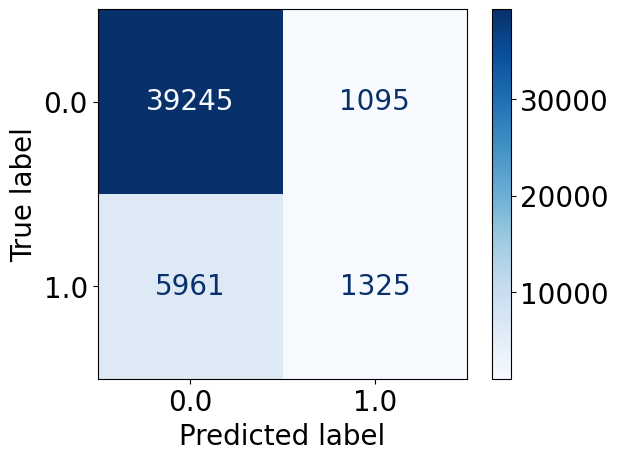

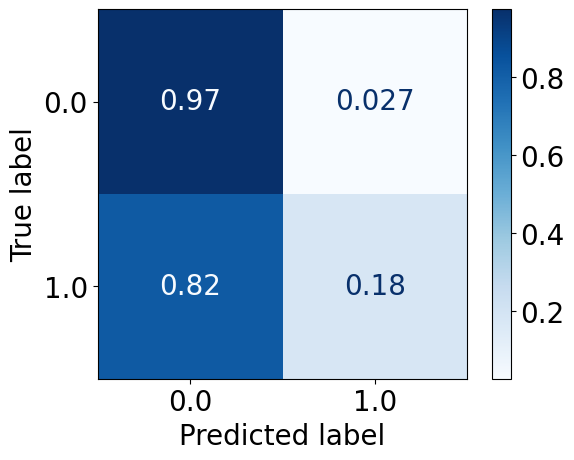

In [ ]:
pred_prob_test_2017_rf_2021 = rf_2021.predict_proba(X_test_2017)[:, 1]
pred_test_2017_rf_2021 = rf_2021.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_rf_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_rf_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_rf_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_rf_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_rf_2021, pred_prob_test_2017_rf_2021)

Class 1 Recall: 0.18185561350535273
Class 1 Precision: 0.5475206611570248
Class 1 Area Under Precision-Recall Curve: 0.4216278169589296
Class 1 F1-Score: 0.2730269936121986
Class 0 Recall: 0.9728557263262271
Class 0 Precision: 0.86813697296819
Class 0 Area Under Precision-Recall Curve: 0.7246335739466886
Class 0 F1-Score: 0.9175180604587007
Overall Accuracy: 0.8518456305379415
Balanced Accuracy: 0.5773556699157899
Area Under ROC Curve: 0.8085928780496169
Matthews Correlation Coefficient: 0.25358814934207113
0.18185561350535273
0.5475206611570248
0.4216278169589296
0.2730269936121986
0.9728557263262271
0.86813697296819
0.7246335739466886
0.9175180604587007
0.8518456305379415
0.5773556699157899
0.8085928780496169
0.25358814934207113


#### SVM

accuracy 0.7455801452987864
              precision    recall  f1-score   support

         0.0       0.89      0.79      0.84     40340
         1.0       0.30      0.48      0.36      7286

    accuracy                           0.75     47626
   macro avg       0.59      0.64      0.60     47626
weighted avg       0.80      0.75      0.77     47626



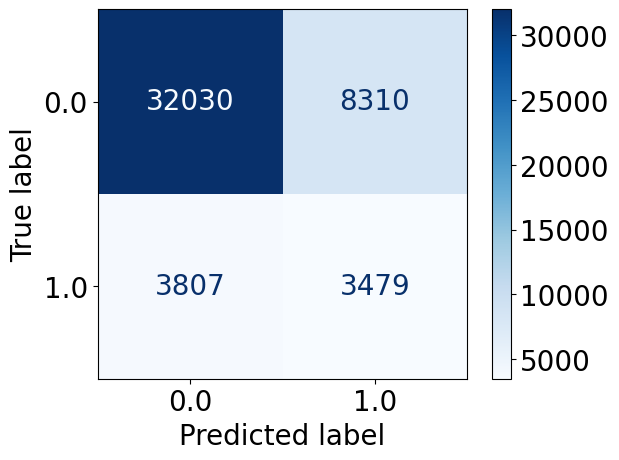

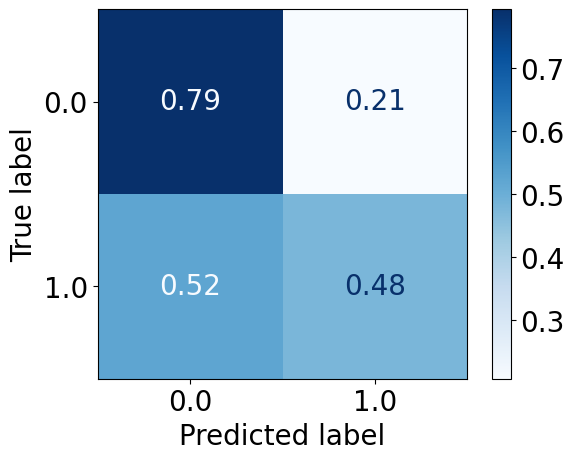

In [ ]:
pred_prob_test_2017_svm_2021 = svm_2021.predict_proba(X_test_2017)[:, 1]
pred_test_2017_svm_2021 = svm_2021.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_svm_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_svm_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_svm_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_svm_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_svm_2021, pred_prob_test_2017_svm_2021)

Class 1 Recall: 0.47749107878122427
Class 1 Precision: 0.2951056069217067
Class 1 Area Under Precision-Recall Curve: 0.29280981782215443
Class 1 F1-Score: 0.3647706422018349
Class 0 Recall: 0.7940009915716411
Class 0 Precision: 0.8937690096827301
Class 0 Area Under Precision-Recall Curve: 0.7598620988068179
Class 0 F1-Score: 0.8409362405975556
Overall Accuracy: 0.7455801452987864
Balanced Accuracy: 0.6357460351764327
Area Under ROC Curve: 0.7215349412644185
Matthews Correlation Coefficient: 0.22644637488606925
0.47749107878122427
0.2951056069217067
0.29280981782215443
0.3647706422018349
0.7940009915716411
0.8937690096827301
0.7598620988068179
0.8409362405975556
0.7455801452987864
0.6357460351764327
0.7215349412644185
0.22644637488606925


#### KNN

accuracy 0.8351110737832277
              precision    recall  f1-score   support

         0.0       0.87      0.95      0.91     40340
         1.0       0.42      0.21      0.28      7286

    accuracy                           0.84     47626
   macro avg       0.65      0.58      0.60     47626
weighted avg       0.80      0.84      0.81     47626



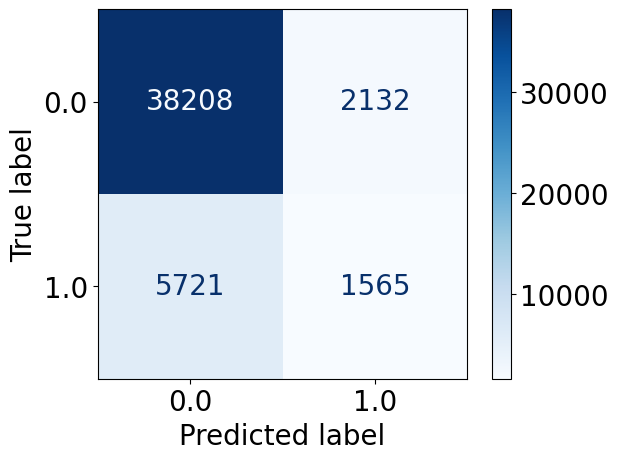

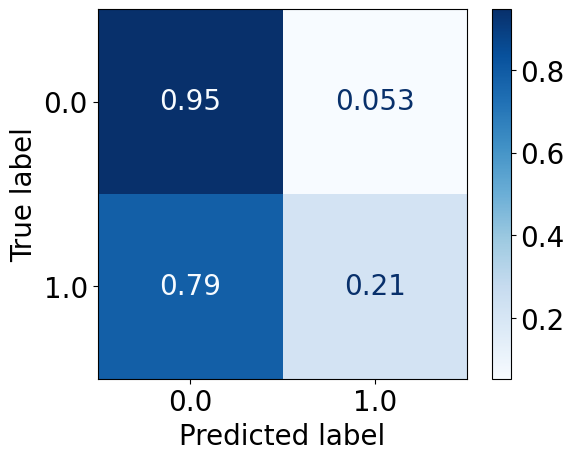

In [ ]:
pred_prob_test_2017_knn_2021 = knn_2021.predict_proba(X_test_2017)[:, 1]
pred_test_2017_knn_2021 = knn_2021.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_knn_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_knn_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_knn_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_knn_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_knn_2021, pred_prob_test_2017_knn_2021)

Class 1 Recall: 0.21479549821575625
Class 1 Precision: 0.4233162023262104
Class 1 Area Under Precision-Recall Curve: 0.2957071248343888
Class 1 F1-Score: 0.28498588728034235
Class 0 Recall: 0.9471492315319782
Class 0 Precision: 0.8697671242231783
Class 0 Area Under Precision-Recall Curve: 0.7865811250619564
Class 0 F1-Score: 0.906810333574624
Overall Accuracy: 0.8351110737832277
Balanced Accuracy: 0.5809723648738672
Area Under ROC Curve: 0.7167160116228638
Matthews Correlation Coefficient: 0.21786073558952232
0.21479549821575625
0.4233162023262104
0.2957071248343888
0.28498588728034235
0.9471492315319782
0.8697671242231783
0.7865811250619564
0.906810333574624
0.8351110737832277
0.5809723648738672
0.7167160116228638
0.21786073558952232


#### MLP

accuracy 0.849032041321967
              precision    recall  f1-score   support

         0.0       0.87      0.96      0.92     40340
         1.0       0.51      0.23      0.32      7286

    accuracy                           0.85     47626
   macro avg       0.69      0.60      0.62     47626
weighted avg       0.82      0.85      0.82     47626



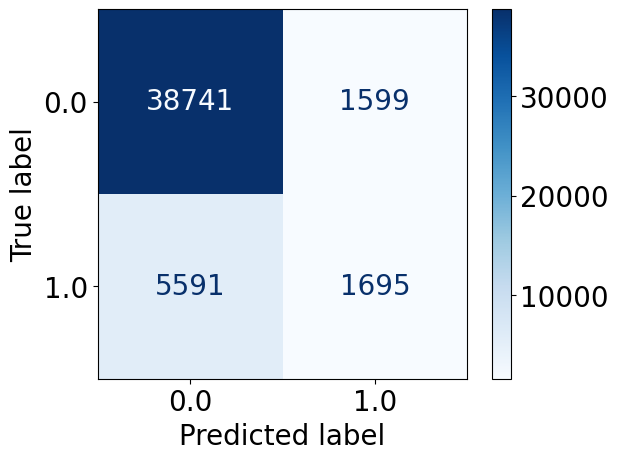

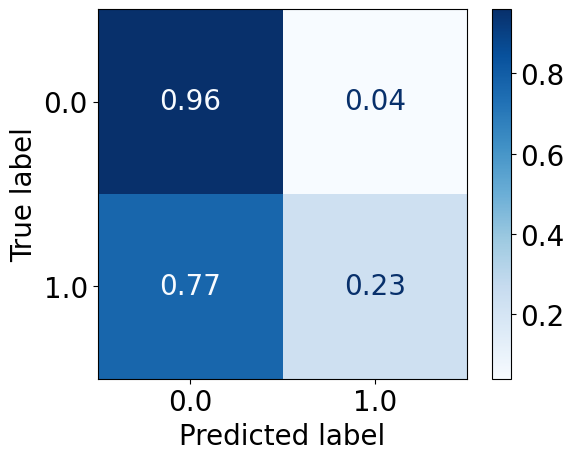

In [ ]:
pred_prob_test_2017_mlp_2021 = mlp_2021.predict_proba(X_test_2017)[:, 1]
pred_test_2017_mlp_2021 = mlp_2021.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_mlp_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_mlp_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_mlp_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_mlp_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_mlp_2021, pred_prob_test_2017_mlp_2021)

Class 1 Recall: 0.2326379357672248
Class 1 Precision: 0.5145719489981785
Class 1 Area Under Precision-Recall Curve: 0.4224983558195785
Class 1 F1-Score: 0.3204158790170132
Class 0 Recall: 0.9603619236489837
Class 0 Precision: 0.8738834250654155
Class 0 Area Under Precision-Recall Curve: 0.7204408937052572
Class 0 F1-Score: 0.915084089191232
Overall Accuracy: 0.849032041321967
Balanced Accuracy: 0.5964999297081042
Area Under ROC Curve: 0.8119484671943709
Matthews Correlation Coefficient: 0.2738098474922776
0.2326379357672248
0.5145719489981785
0.4224983558195785
0.3204158790170132
0.9603619236489837
0.8738834250654155
0.7204408937052572
0.915084089191232
0.849032041321967
0.5964999297081042
0.8119484671943709
0.2738098474922776


### Test on 2015

#### LR

accuracy 0.8562321339443714
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     37411
         1.0       0.57      0.21      0.30      6667

    accuracy                           0.86     44078
   macro avg       0.72      0.59      0.61     44078
weighted avg       0.83      0.86      0.83     44078



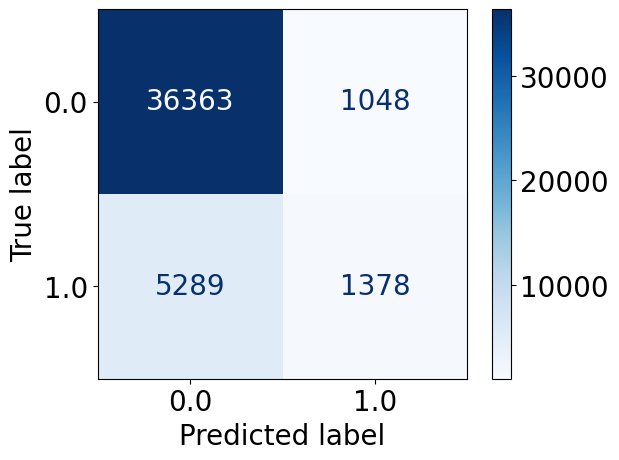

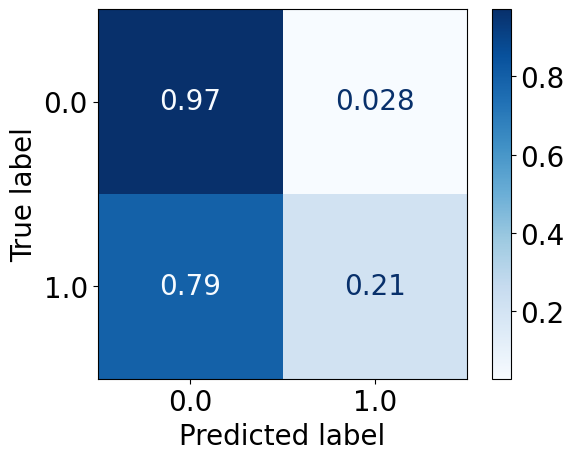

In [ ]:
pred_prob_test_2015_lr_2021 = lr_2021.predict_proba(X_test_2015)[:, 1]
pred_test_2015_lr_2021 = lr_2021.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_lr_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_lr_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_lr_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_lr_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_lr_2021, pred_prob_test_2015_lr_2021)

Class 1 Recall: 0.20668966551672416
Class 1 Precision: 0.5680131904369332
Class 1 Area Under Precision-Recall Curve: 0.44733113244550254
Class 1 F1-Score: 0.30309028923347625
Class 0 Recall: 0.9719868487877897
Class 0 Precision: 0.8730193027945837
Class 0 Area Under Precision-Recall Curve: 0.7178678763342189
Class 0 F1-Score: 0.9198487282293867
Overall Accuracy: 0.8562321339443714
Balanced Accuracy: 0.589338257152257
Area Under ROC Curve: 0.8225278760386378
Matthews Correlation Coefficient: 0.2807172039359835
0.20668966551672416
0.5680131904369332
0.44733113244550254
0.30309028923347625
0.9719868487877897
0.8730193027945837
0.7178678763342189
0.9198487282293867
0.8562321339443714
0.589338257152257
0.8225278760386378
0.2807172039359835


#### RF

accuracy 0.8526248922364899
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     37411
         1.0       0.54      0.19      0.28      6667

    accuracy                           0.85     44078
   macro avg       0.70      0.58      0.60     44078
weighted avg       0.82      0.85      0.82     44078



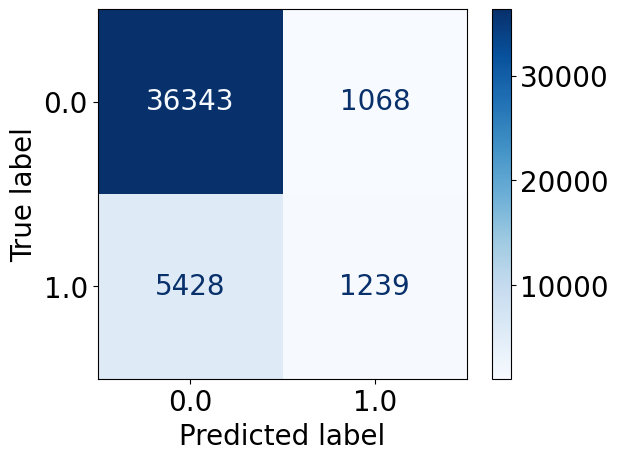

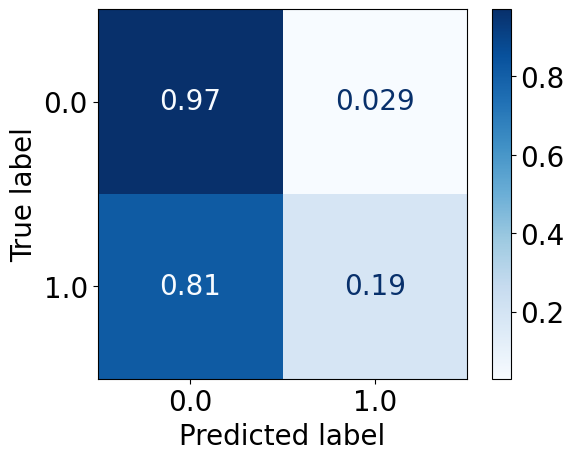

In [ ]:
pred_prob_test_2015_rf_2021 = rf_2021.predict_proba(X_test_2015)[:, 1]
pred_test_2015_rf_2021 = rf_2021.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_rf_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_rf_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_rf_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_rf_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_rf_2021, pred_prob_test_2015_rf_2021)

Class 1 Recall: 0.18584070796460178
Class 1 Precision: 0.5370611183355006
Class 1 Area Under Precision-Recall Curve: 0.40957529769743
Class 1 F1-Score: 0.2761310452418097
Class 0 Recall: 0.9714522466654193
Class 0 Precision: 0.8700533863206531
Class 0 Area Under Precision-Recall Curve: 0.7301441050450077
Class 0 F1-Score: 0.9179611527872497
Overall Accuracy: 0.8526248922364899
Balanced Accuracy: 0.5786464773150105
Area Under ROC Curve: 0.8018766479013195
Matthews Correlation Coefficient: 0.2530538348061611
0.18584070796460178
0.5370611183355006
0.40957529769743
0.2761310452418097
0.9714522466654193
0.8700533863206531
0.7301441050450077
0.9179611527872497
0.8526248922364899
0.5786464773150105
0.8018766479013195
0.2530538348061611


#### SVM

accuracy 0.7163664413085893
              precision    recall  f1-score   support

         0.0       0.91      0.74      0.82     37411
         1.0       0.28      0.57      0.38      6667

    accuracy                           0.72     44078
   macro avg       0.59      0.66      0.60     44078
weighted avg       0.81      0.72      0.75     44078



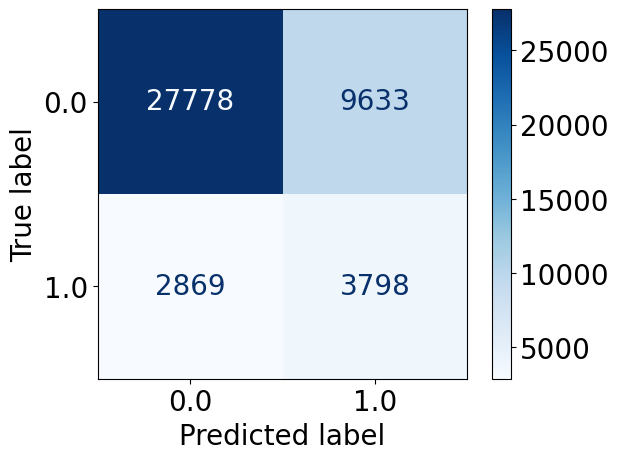

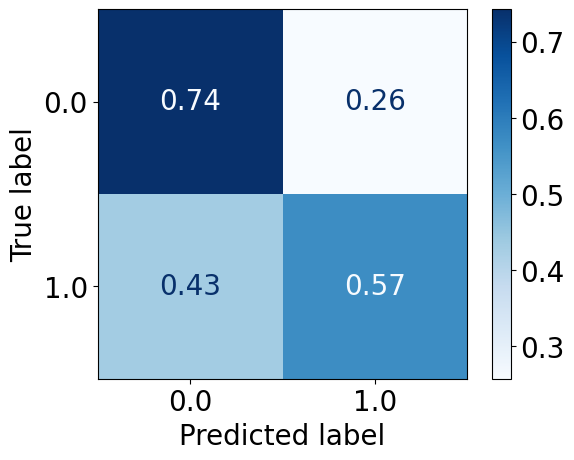

In [ ]:
pred_prob_test_2015_svm_2021 = svm_2021.predict_proba(X_test_2015)[:, 1]
pred_test_2015_svm_2021 = svm_2021.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_svm_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_svm_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_svm_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_svm_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_svm_2021, pred_prob_test_2015_svm_2021)

Class 1 Recall: 0.5696715164241788
Class 1 Precision: 0.28277864641501005
Class 1 Area Under Precision-Recall Curve: 0.2927913430071329
Class 1 F1-Score: 0.3779480545327893
Class 0 Recall: 0.7425088877602845
Class 0 Precision: 0.9063856168629882
Class 0 Area Under Precision-Recall Curve: 0.7604984119727378
Class 0 F1-Score: 0.8163037409268565
Overall Accuracy: 0.7163664413085893
Balanced Accuracy: 0.6560902020922317
Area Under ROC Curve: 0.7295331412360713
Matthews Correlation Coefficient: 0.24300900429280745
0.5696715164241788
0.28277864641501005
0.2927913430071329
0.3779480545327893
0.7425088877602845
0.9063856168629882
0.7604984119727378
0.8163037409268565
0.7163664413085893
0.6560902020922317
0.7295331412360713
0.24300900429280745


#### KNN

accuracy 0.8393756522528245
              precision    recall  f1-score   support

         0.0       0.87      0.95      0.91     37411
         1.0       0.44      0.21      0.28      6667

    accuracy                           0.84     44078
   macro avg       0.65      0.58      0.60     44078
weighted avg       0.81      0.84      0.81     44078



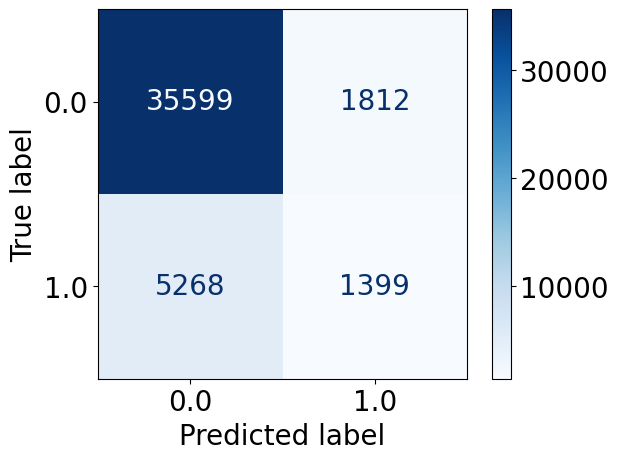

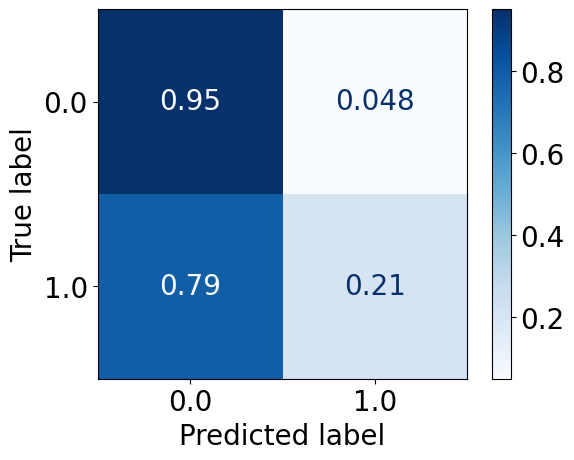

In [ ]:
pred_prob_test_2015_knn_2021 = knn_2021.predict_proba(X_test_2015)[:, 1]
pred_test_2015_knn_2021 = knn_2021.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_knn_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_knn_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_knn_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_knn_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_knn_2021, pred_prob_test_2015_knn_2021)

Class 1 Recall: 0.20983950802459878
Class 1 Precision: 0.4356898162566179
Class 1 Area Under Precision-Recall Curve: 0.2957372033188697
Class 1 F1-Score: 0.2832557197813323
Class 0 Recall: 0.9515650477132395
Class 0 Precision: 0.8710940367533707
Class 0 Area Under Precision-Recall Curve: 0.7891603983407813
Class 0 F1-Score: 0.9095531311479599
Overall Accuracy: 0.8393756522528245
Balanced Accuracy: 0.5807022778689191
Area Under ROC Curve: 0.7173394658165304
Matthews Correlation Coefficient: 0.22252260896955944
0.20983950802459878
0.4356898162566179
0.2957372033188697
0.2832557197813323
0.9515650477132395
0.8710940367533707
0.7891603983407813
0.9095531311479599
0.8393756522528245
0.5807022778689191
0.7173394658165304
0.22252260896955944


#### MLP

accuracy 0.8521711511411588
              precision    recall  f1-score   support

         0.0       0.87      0.96      0.92     37411
         1.0       0.53      0.23      0.32      6667

    accuracy                           0.85     44078
   macro avg       0.70      0.60      0.62     44078
weighted avg       0.82      0.85      0.83     44078



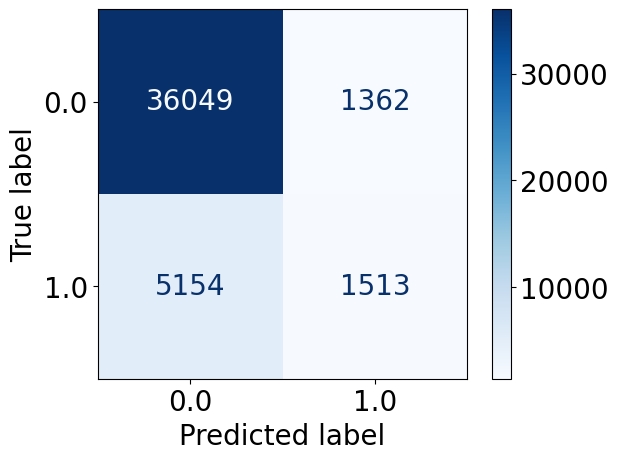

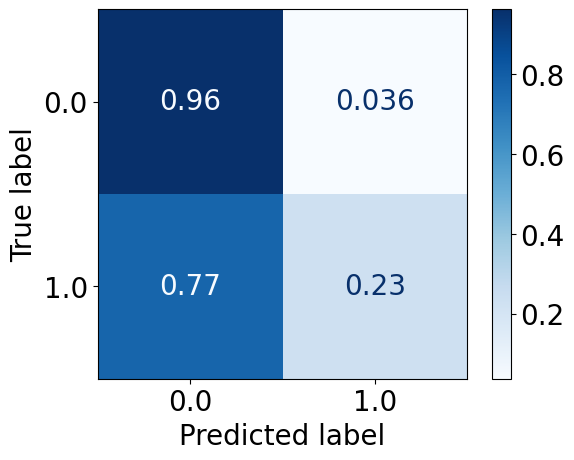

In [ ]:
pred_prob_test_2015_mlp_2021 = mlp_2021.predict_proba(X_test_2015)[:, 1]
pred_test_2015_mlp_2021 = mlp_2021.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_mlp_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_mlp_2021))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_mlp_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_mlp_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_mlp_2021, pred_prob_test_2015_mlp_2021)

Class 1 Recall: 0.22693865306734665
Class 1 Precision: 0.5262608695652173
Class 1 Area Under Precision-Recall Curve: 0.4182056911342247
Class 1 F1-Score: 0.31712429260113184
Class 0 Recall: 0.963593595466574
Class 0 Precision: 0.8749120209693468
Class 0 Area Under Precision-Recall Curve: 0.7231695941750107
Class 0 F1-Score: 0.9171140000508814
Overall Accuracy: 0.8521711511411588
Balanced Accuracy: 0.5952661242669604
Area Under ROC Curve: 0.8115892446536691
Matthews Correlation Coefficient: 0.2764712876311082
0.22693865306734665
0.5262608695652173
0.4182056911342247
0.31712429260113184
0.963593595466574
0.8749120209693468
0.7231695941750107
0.9171140000508814
0.8521711511411588
0.5952661242669604
0.8115892446536691
0.2764712876311082


## Train on balanced (undersampled) 2021 and test on other years

### Train on 2021 and test on 2021

#### LR

accuracy 0.7334865594084141
              precision    recall  f1-score   support

         0.0       0.94      0.73      0.82     33912
         1.0       0.34      0.76      0.47      6116

    accuracy                           0.73     40028
   macro avg       0.64      0.74      0.64     40028
weighted avg       0.85      0.73      0.77     40028



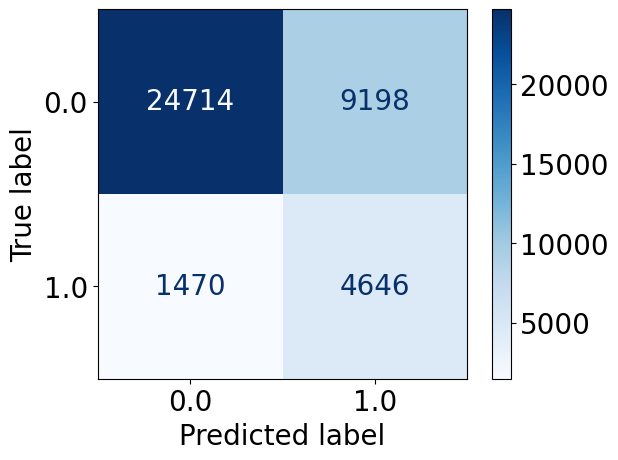

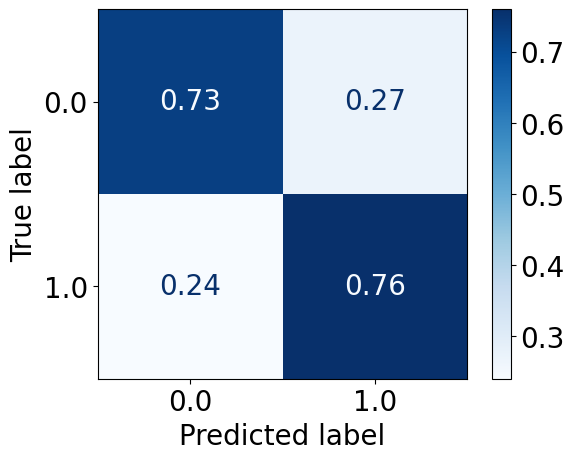

In [ ]:
lr_balanced_2021 = LogisticRegression(solver='liblinear')
lr_balanced_2021.fit(X_train_2021_balanced, y_train_2021_balanced)

pred_prob_test_2021_lr_balanced_2021 = lr_balanced_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_balanced_2021 = lr_balanced_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_lr_balanced_2021, pred_prob_test_2021_lr_balanced_2021)

Class 1 Recall: 0.7596468279921518
Class 1 Precision: 0.33559664836752384
Class 1 Area Under Precision-Recall Curve: 0.4491619364217376
Class 1 F1-Score: 0.4655310621242485
Class 0 Recall: 0.7287685774946921
Class 0 Precision: 0.943858845096242
Class 0 Area Under Precision-Recall Curve: 0.7154309094608715
Class 0 F1-Score: 0.8224840255591054
Overall Accuracy: 0.7334865594084141
Balanced Accuracy: 0.744207702743422
Area Under ROC Curve: 0.8235753536718975
Matthews Correlation Coefficient: 0.36944602874524346
0.7596468279921518
0.33559664836752384
0.4491619364217376
0.4655310621242485
0.7287685774946921
0.943858845096242
0.7154309094608715
0.8224840255591054
0.7334865594084141
0.744207702743422
0.8235753536718975
0.36944602874524346


#### RF

accuracy 0.7124013190766464
              precision    recall  f1-score   support

         0.0       0.94      0.70      0.81     33912
         1.0       0.32      0.77      0.45      6116

    accuracy                           0.71     40028
   macro avg       0.63      0.74      0.63     40028
weighted avg       0.85      0.71      0.75     40028



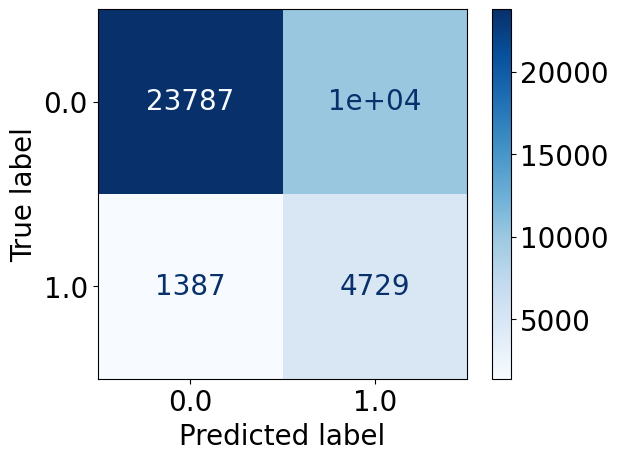

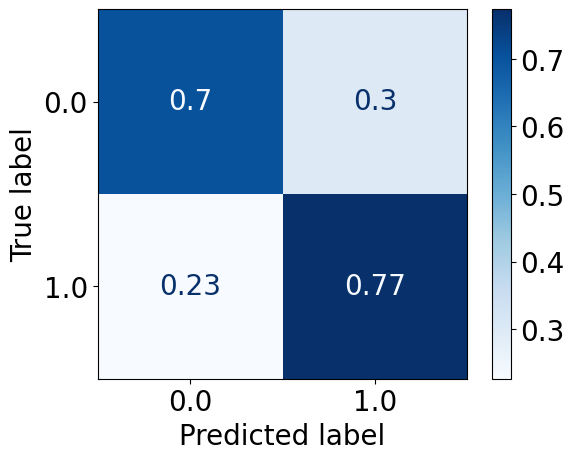

In [ ]:
from sklearn.ensemble import RandomForestClassifier

rf_balanced_2021 = RandomForestClassifier()
rf_balanced_2021.fit(X_train_2021_balanced, y_train_2021_balanced)

pred_prob_test_2021_rf_balanced_2021 = rf_balanced_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_rf_balanced_2021 = rf_balanced_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_rf_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_rf_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_rf_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_rf_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_rf_balanced_2021, pred_prob_test_2021_rf_balanced_2021)

Class 1 Recall: 0.7732177894048398
Class 1 Precision: 0.3183654234549616
Class 1 Area Under Precision-Recall Curve: 0.41797545088346455
Class 1 F1-Score: 0.4510252742012399
Class 0 Recall: 0.7014331210191083
Class 0 Precision: 0.9449034718360213
Class 0 Area Under Precision-Recall Curve: 0.7224291341015076
Class 0 F1-Score: 0.8051653521984903
Overall Accuracy: 0.7124013190766464
Balanced Accuracy: 0.737325455211974
Area Under ROC Curve: 0.8122708308936715
Matthews Correlation Coefficient: 0.3534979785460903
0.7732177894048398
0.3183654234549616
0.41797545088346455
0.4510252742012399
0.7014331210191083
0.9449034718360213
0.7224291341015076
0.8051653521984903
0.7124013190766464
0.737325455211974
0.8122708308936715
0.3534979785460903


#### SVM

/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=200).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


accuracy 0.33129309483361646
              precision    recall  f1-score   support

         0.0       0.86      0.25      0.39     33912
         1.0       0.16      0.78      0.26      6116

    accuracy                           0.33     40028
   macro avg       0.51      0.52      0.33     40028
weighted avg       0.76      0.33      0.37     40028



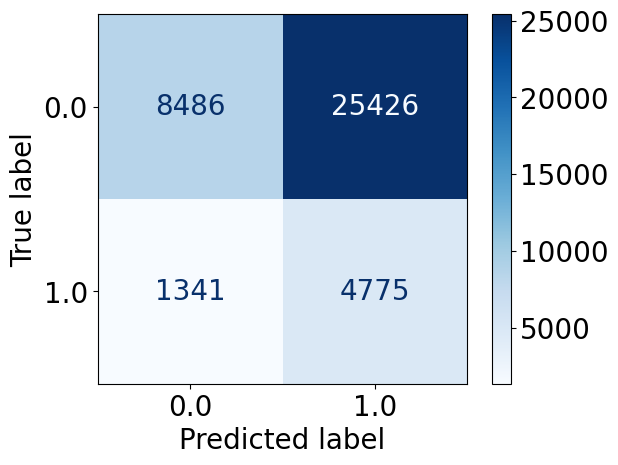

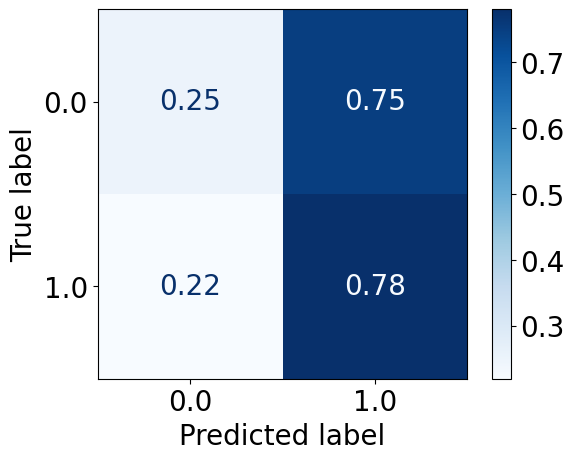

In [ ]:
from sklearn.svm import SVC

svm_balanced_2021 = SVC(probability=True, kernel='rbf', max_iter = 200)
svm_balanced_2021.fit(X_train_2021_balanced, y_train_2021_balanced)

pred_prob_test_2021_svm_balanced_2021 = svm_balanced_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_svm_balanced_2021 = svm_balanced_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_svm_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_svm_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_svm_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_svm_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_svm_balanced_2021, pred_prob_test_2021_svm_balanced_2021)

Class 1 Recall: 0.7807390451275343
Class 1 Precision: 0.15810734743882654
Class 1 Area Under Precision-Recall Curve: 0.18312080731790964
Class 1 F1-Score: 0.26296224908445087
Class 0 Recall: 0.2502359046945034
Class 0 Precision: 0.8635392286557444
Class 0 Area Under Precision-Recall Curve: 0.8224810430441313
Class 0 F1-Score: 0.3880289901460939
Overall Accuracy: 0.33129309483361646
Balanced Accuracy: 0.5154874749110189
Area Under ROC Curve: 0.5444720222663791
Matthews Correlation Coefficient: 0.025894045808800444
0.7807390451275343
0.15810734743882654
0.18312080731790964
0.26296224908445087
0.2502359046945034
0.8635392286557444
0.8224810430441313
0.3880289901460939
0.33129309483361646
0.5154874749110189
0.5444720222663791
0.025894045808800444


#### KNN

accuracy 0.7718097331867693
              precision    recall  f1-score   support

         0.0       0.91      0.81      0.86     33912
         1.0       0.34      0.53      0.42      6116

    accuracy                           0.77     40028
   macro avg       0.62      0.67      0.64     40028
weighted avg       0.82      0.77      0.79     40028



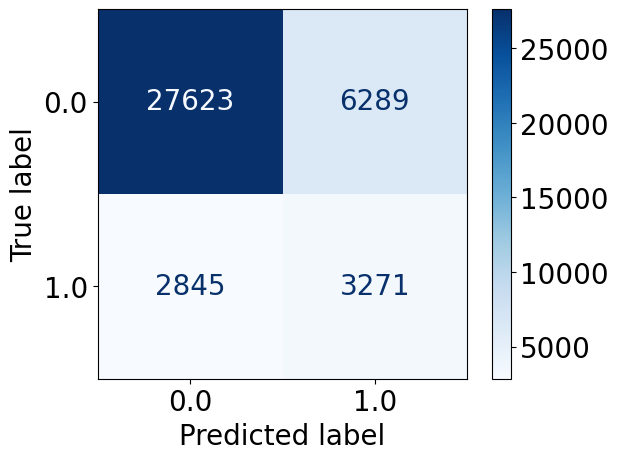

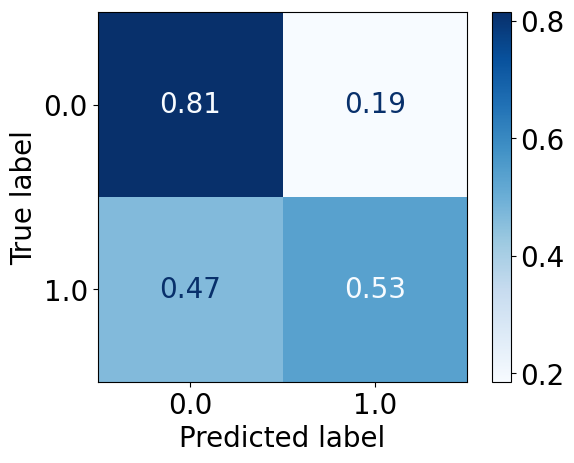

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

knn_balanced_2021 = KNeighborsClassifier(n_neighbors=5)
knn_balanced_2021.fit(X_train_2021_balanced, y_train_2021_balanced)

pred_prob_test_2021_knn_balanced_2021 = knn_balanced_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_knn_balanced_2021 = knn_balanced_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_knn_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_knn_balanced_2021))


ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_knn_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_knn_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_knn_balanced_2021, pred_prob_test_2021_knn_balanced_2021)

Class 1 Recall: 0.5348266841072596
Class 1 Precision: 0.3421548117154812
Class 1 Area Under Precision-Recall Curve: 0.31648718286092736
Class 1 F1-Score: 0.4173258484307221
Class 0 Recall: 0.8145494220334984
Class 0 Precision: 0.9066233425233031
Class 0 Area Under Precision-Recall Curve: 0.7704007621790431
Class 0 F1-Score: 0.8581236408822616
Overall Accuracy: 0.7718097331867693
Balanced Accuracy: 0.674688053070379
Area Under ROC Curve: 0.7495796308330676
Matthews Correlation Coefficient: 0.2948171345441635
0.5348266841072596
0.3421548117154812
0.31648718286092736
0.4173258484307221
0.8145494220334984
0.9066233425233031
0.7704007621790431
0.8581236408822616
0.7718097331867693
0.674688053070379
0.7495796308330676
0.2948171345441635


#### MLP

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


accuracy 0.7159488358149295
              precision    recall  f1-score   support

         0.0       0.94      0.71      0.81     33912
         1.0       0.32      0.74      0.44      6116

    accuracy                           0.72     40028
   macro avg       0.63      0.73      0.63     40028
weighted avg       0.84      0.72      0.75     40028



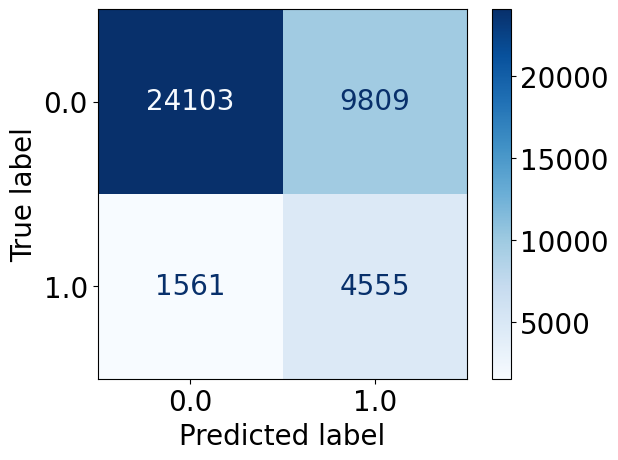

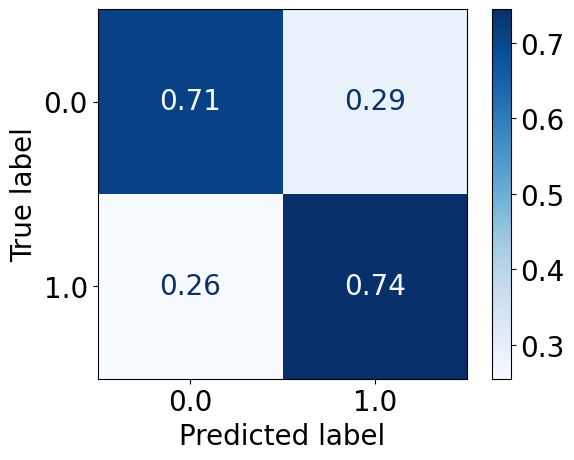

In [ ]:
from sklearn.neural_network import MLPClassifier

mlp_balanced_2021= MLPClassifier()
mlp_balanced_2021.fit(X_train_2021_balanced, y_train_2021_balanced)

pred_prob_test_2021_mlp_balanced_2021 = mlp_balanced_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_mlp_balanced_2021 = mlp_balanced_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_mlp_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_mlp_balanced_2021))

plt.rcParams['font.size'] = 20
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_mlp_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_mlp_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_mlp_balanced_2021, pred_prob_test_2021_mlp_balanced_2021)

Class 1 Recall: 0.763407455853499
Class 1 Precision: 0.3177919956438878
Class 1 Area Under Precision-Recall Curve: 0.4053216247665401
Class 1 F1-Score: 0.44876970396001536
Class 0 Recall: 0.7044409058740269
Class 0 Precision: 0.9428875907799179
Class 0 Area Under Precision-Recall Curve: 0.7242334895962029
Class 0 F1-Score: 0.8064069673237915
Overall Accuracy: 0.7134505845907865
Balanced Accuracy: 0.7339241808637629
Area Under ROC Curve: 0.8059274183625499
Matthews Correlation Coefficient: 0.3492255967769065
0.763407455853499
0.3177919956438878
0.4053216247665401
0.44876970396001536
0.7044409058740269
0.9428875907799179
0.7242334895962029
0.8064069673237915
0.7134505845907865
0.7339241808637629
0.8059274183625499
0.3492255967769065


#### Feature Importance

##### Subgroup performance

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_mlp_balanced_2021, pred_prob_test_2021_mlp_balanced_2021)

Class 1 Recall: 0.7205689993459777
Class 1 Precision: 0.32969252637091345
Class 1 Area Under Precision-Recall Curve: 0.39554524964794013
Class 1 F1-Score: 0.45239439511368884
Class 0 Recall: 0.7357867421561689
Class 0 Precision: 0.9358988785116837
Class 0 Area Under Precision-Recall Curve: 0.7255480912806686
Class 0 F1-Score: 0.8238654185858385
Overall Accuracy: 0.7334615768961726
Balanced Accuracy: 0.7281778707510733
Area Under ROC Curve: 0.8071202442601024
Matthews Correlation Coefficient: 0.34814388191061824
0.7205689993459777
0.32969252637091345
0.39554524964794013
0.45239439511368884
0.7357867421561689
0.9358988785116837
0.7255480912806686
0.8238654185858385
0.7334615768961726
0.7281778707510733
0.8071202442601024
0.34814388191061824


In [ ]:
test = df_train_2021_balanced.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_balanced_2021.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_2021.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.7859407625087
Class 1 Precision: 0.775150636869804
Class 1 Area Under Precision-Recall Curve: 0.8580251514394005
Class 1 F1-Score: 0.7805084094923586
Class 0 Recall: 0.746974508625869
Class 0 Precision: 0.7586958416877343
Class 0 Area Under Precision-Recall Curve: 0.30742562189092815
Class 0 F1-Score: 0.7527895510768965
Overall Accuracy: 0.7674721340818486
Balanced Accuracy: 0.7664576355672845
Area Under ROC Curve: 0.8527972037742617
Matthews Correlation Coefficient: 0.5333806716264898
0.7859407625087
0.775150636869804
0.8580251514394005
0.7805084094923586
0.746974508625869
0.7586958416877343
0.30742562189092815
0.7527895510768965
0.7674721340818486
0.7664576355672845
0.8527972037742617
0.5333806716264898
Class 1 Recall: 0.742983125582973
Class 1 Precision: 0.7911512415349887
Class 1 Area Under Precision-Recall Curve: 0.8575870594529214
Class 1 F1-Score: 0.76631100227392
Class 0 Recall: 0.8230704505469287
Class 0 Precision: 0.7802189833949678
Class 0 Area Under Precis

In [ ]:
test = df_test_2021.copy()

for i in range(1,3):
  test_group = test[test.Sex == i]

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()

  pred_test_group = mlp_balanced_2021.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_2021.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)

Class 1 Recall: 0.7647058823529411
Class 1 Precision: 0.32269503546099293
Class 1 Area Under Precision-Recall Curve: 0.40586716584151616
Class 1 F1-Score: 0.4538653366583541
Class 0 Recall: 0.6762915071244743
Class 0 Precision: 0.9344319167389419
Class 0 Area Under Precision-Recall Curve: 0.7087521129016203
Class 0 F1-Score: 0.7846764502385201
Overall Accuracy: 0.6911303802758044
Balanced Accuracy: 0.7204986947387078
Area Under ROC Curve: 0.7943025695760837
Matthews Correlation Coefficient: 0.336737753577551
0.7647058823529411
0.32269503546099293
0.40586716584151616
0.4538653366583541
0.6762915071244743
0.9344319167389419
0.7087521129016203
0.7846764502385201
0.6911303802758044
0.7204986947387078
0.7943025695760837
0.336737753577551
Class 1 Recall: 0.7227006544953496
Class 1 Precision: 0.3108148148148148
Class 1 Area Under Precision-Recall Curve: 0.3859638407246647
Class 1 F1-Score: 0.43468351807728167
Class 0 Recall: 0.7412824648239809
Class 0 Precision: 0.943045139380218
Class 0 Area

In [ ]:
test = df_train_2021_balanced.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_balanced_2021.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_2021.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  White ============================ 
Class 1 Recall: 0.7346871749958946
Class 1 Precision: 0.7693454086896709
Class 1 Area Under Precision-Recall Curve: 0.8360634796251487
Class 1 F1-Score: 0.7516169676606467
Class 0 Recall: 0.798164217284446
Class 0 Precision: 0.7665221579961464
Class 0 Area Under Precision-Recall Curve: 0.3463144560678306
Class 0 F1-Score: 0.7820232449566307
Overall Accuracy: 0.7678113385332147
Balanced Accuracy: 0.7664256961401703
Area Under ROC Curve: 0.8550670077930329
Matthews Correlation Coefficient: 0.5343573513917592
0.7346871749958946
0.7693454086896709
0.8360634796251487
0.7516169676606467
0.798164217284446
0.7665221579961464
0.3463144560678306
0.7820232449566307
0.7678113385332147
0.7664256961401703
0.8550670077930329
0.5343573513917592
============================  Black ============================ 
Class 1 Recall: 0.8701447067783702
Class 1 Precision: 0.8045774647887324
Class 1 Area Under Precision-Recall Curve: 0.90348675088

In [ ]:
test = df_test_2021.copy()

race_list = ['White', 'Black','American Indian', 'Asian', 'Native Hawaiian',
             'Other race', 'Multiracial', 'Hispanic']

for i in race_list:
  test_group = test[test.Race == i]
  print("============================ ", i , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_balanced_2021.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_2021.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  White ============================ 
Class 1 Recall: 0.7267247153382451
Class 1 Precision: 0.304946599213041
Class 1 Area Under Precision-Recall Curve: 0.3814120002347199
Class 1 F1-Score: 0.4296178974460502
Class 0 Recall: 0.727942794279428
Class 0 Precision: 0.9419217081850534
Class 0 Area Under Precision-Recall Curve: 0.7419704909919059
Class 0 F1-Score: 0.8212224635432828
Overall Accuracy: 0.7277709534158556
Balanced Accuracy: 0.7273337548088366
Area Under ROC Curve: 0.8059973147720368
Matthews Correlation Coefficient: 0.3350268623979602
0.7267247153382451
0.304946599213041
0.3814120002347199
0.4296178974460502
0.727942794279428
0.9419217081850534
0.7419704909919059
0.8212224635432828
0.7277709534158556
0.7273337548088366
0.8059973147720368
0.3350268623979602
============================  Black ============================ 
Class 1 Recall: 0.8541996830427893
Class 1 Precision: 0.35909393737508327
Class 1 Area Under Precision-Recall Curve: 0.465972743451

In [ ]:
test = df_train_2021_balanced.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_balanced_2021.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_2021.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.5057915057915058
Class 1 Precision: 0.7987804878048781
Class 1 Area Under Precision-Recall Curve: 0.7159789878795442
Class 1 F1-Score: 0.619385342789598
Class 0 Recall: 0.9786821705426356
Class 0 Precision: 0.9220937309799148
Class 0 Area Under Precision-Recall Curve: 0.6969567444223885
Class 0 F1-Score: 0.9495455969915387
Overall Accuracy: 0.9109020475926951
Balanced Accuracy: 0.7422368381670708
Area Under ROC Curve: 0.9036918978779444
Matthews Correlation Coefficient: 0.5909691895092085
0.5057915057915058
0.7987804878048781
0.7159789878795442
0.619385342789598
0.9786821705426356
0.9220937309799148
0.6969567444223885
0.9495455969915387
0.9109020475926951
0.7422368381670708
0.9036918978779444
0.5909691895092085
============================  35-39 ============================ 
Class 1 Recall: 0.5785123966942148
Class 1 Precision: 0.8259587020648967
Class 1 Area Under Precision-Recall Curve: 0.79675177805

In [ ]:
test = df_test_2021.copy()

age_group = {3: '30-34', 4: '35-39', 5: '40-44', 6: '45-49',
             7: '50-54', 8: '55-59', 9: '60-64', 10: '65-69',
             11: '70-74', 12: '75-79', 13: '80-99'}

for i in age_group.keys():
  test_group = test[test.Age == i]
  print("============================ ", age_group[i] , "============================ ")

  X_test_group = test_group.drop(['Diabetes', 'Race'],axis=1)
  y_test_group = test_group['Diabetes']
  y_test_group = y_test_group.to_numpy()


  pred_test_group = mlp_balanced_2021.predict(X_test_group)
  pred_prob_test_group = mlp_balanced_2021.predict_proba(X_test_group)[:, 1]

  performace_metrix(y_test_group, pred_test_group, pred_prob_test_group)


============================  30-34 ============================ 
Class 1 Recall: 0.38461538461538464
Class 1 Precision: 0.15060240963855423
Class 1 Area Under Precision-Recall Curve: 0.14867526793412525
Class 1 F1-Score: 0.21645021645021645
Class 0 Recall: 0.9380219780219781
Class 0 Precision: 0.9816007359705612
Class 0 Area Under Precision-Recall Curve: 0.9335329547371757
Class 0 F1-Score: 0.9593167003821084
Overall Accuracy: 0.9226495726495727
Balanced Accuracy: 0.6613186813186813
Area Under ROC Curve: 0.8257852916314455
Matthews Correlation Coefficient: 0.20652765972549106
0.38461538461538464
0.15060240963855423
0.14867526793412525
0.21645021645021645
0.9380219780219781
0.9816007359705612
0.9335329547371757
0.9593167003821084
0.9226495726495727
0.6613186813186813
0.8257852916314455
0.20652765972549106
============================  35-39 ============================ 
Class 1 Recall: 0.4326923076923077
Class 1 Precision: 0.1485148514851485
Class 1 Area Under Precision-Recall Curve: 0

### Test on 2019

#### LR

accuracy 0.7228215767634855
              precision    recall  f1-score   support

         0.0       0.95      0.71      0.81     35675
         1.0       0.33      0.78      0.46      6500

    accuracy                           0.72     42175
   macro avg       0.64      0.74      0.64     42175
weighted avg       0.85      0.72      0.76     42175



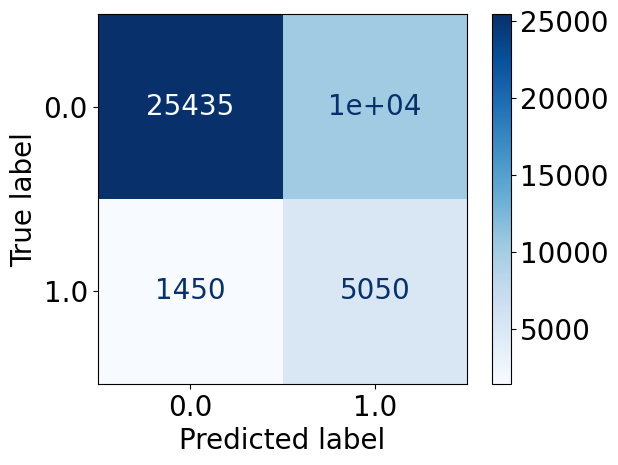

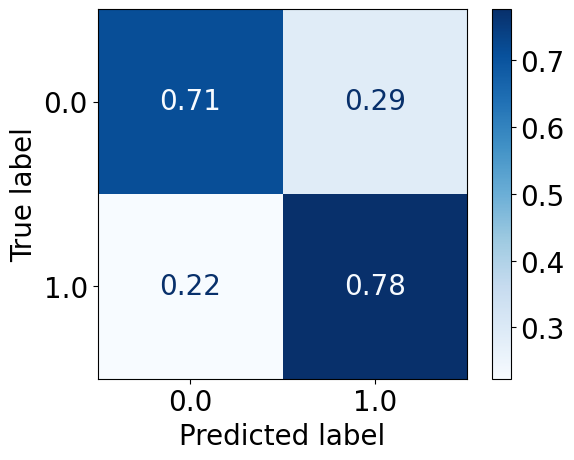

In [ ]:
pred_prob_test_2019_lr_balanced_2021 = lr_balanced_2021.predict_proba(X_test_2019)[:, 1]
pred_test_2019_lr_balanced_2021 = lr_balanced_2021.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_lr_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_lr_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_lr_balanced_2021, pred_prob_test_2019_lr_balanced_2021)

Class 1 Recall: 0.7769230769230769
Class 1 Precision: 0.3302812295618051
Class 1 Area Under Precision-Recall Curve: 0.4484897089029282
Class 1 F1-Score: 0.46351537402478205
Class 0 Recall: 0.7129642606867554
Class 0 Precision: 0.946066579877255
Class 0 Area Under Precision-Recall Curve: 0.7140716755314573
Class 0 F1-Score: 0.8131393861892584
Overall Accuracy: 0.7228215767634855
Balanced Accuracy: 0.7449436688049162
Area Under ROC Curve: 0.8226803169640451
Matthews Correlation Coefficient: 0.36793925126358895
0.7769230769230769
0.3302812295618051
0.4484897089029282
0.46351537402478205
0.7129642606867554
0.946066579877255
0.7140716755314573
0.8131393861892584
0.7228215767634855
0.7449436688049162
0.8226803169640451
0.36793925126358895


#### RF

accuracy 0.6980438648488441
              precision    recall  f1-score   support

         0.0       0.95      0.68      0.79     35675
         1.0       0.31      0.80      0.45      6500

    accuracy                           0.70     42175
   macro avg       0.63      0.74      0.62     42175
weighted avg       0.85      0.70      0.74     42175



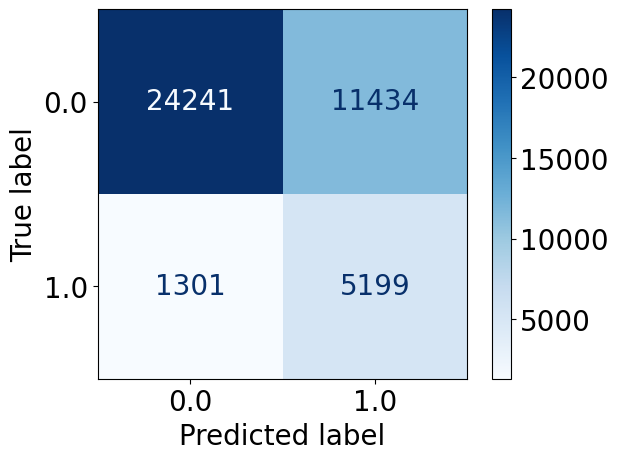

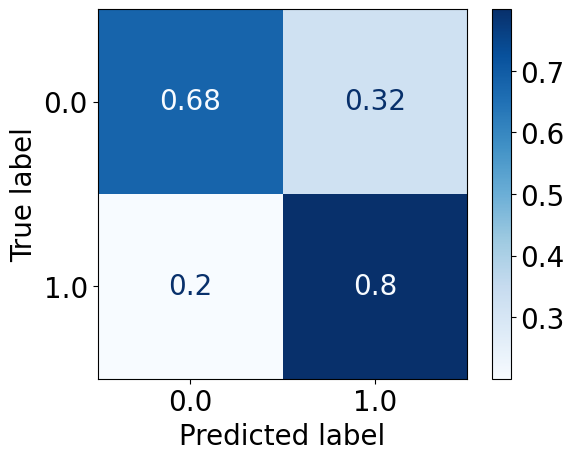

In [ ]:
pred_prob_test_2019_rf_balanced_2021 = rf_balanced_2021.predict_proba(X_test_2019)[:, 1]

pred_test_2019_rf_balanced_2021 = rf_balanced_2021.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_rf_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_rf_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_rf_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_rf_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_rf_balanced_2021, pred_prob_test_2019_rf_balanced_2021)

Class 1 Recall: 0.7998461538461539
Class 1 Precision: 0.31257139421631697
Class 1 Area Under Precision-Recall Curve: 0.414432212904678
Class 1 F1-Score: 0.4494877447801842
Class 0 Recall: 0.6794954449894884
Class 0 Precision: 0.9490642862735886
Class 0 Area Under Precision-Recall Curve: 0.7215523792270384
Class 0 F1-Score: 0.7919695509417318
Overall Accuracy: 0.6980438648488441
Balanced Accuracy: 0.7396707994178211
Area Under ROC Curve: 0.8118887369953102
Matthews Correlation Coefficient: 0.3541367891062472
0.7998461538461539
0.31257139421631697
0.414432212904678
0.4494877447801842
0.6794954449894884
0.9490642862735886
0.7215523792270384
0.7919695509417318
0.6980438648488441
0.7396707994178211
0.8118887369953102
0.3541367891062472


#### SVM

accuracy 0.4105275637225845
              precision    recall  f1-score   support

         0.0       0.85      0.37      0.51     35675
         1.0       0.16      0.64      0.25      6500

    accuracy                           0.41     42175
   macro avg       0.50      0.50      0.38     42175
weighted avg       0.74      0.41      0.47     42175



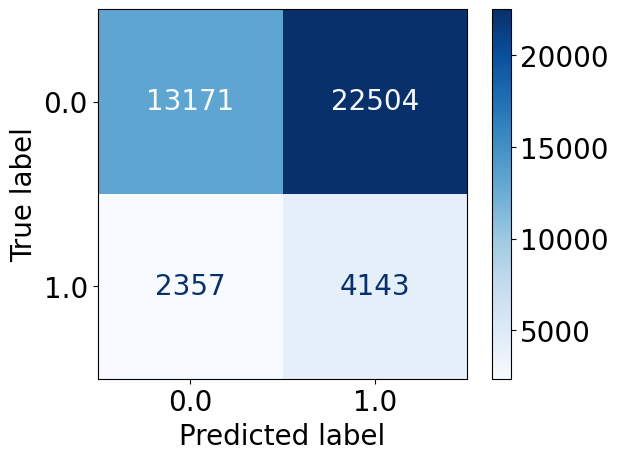

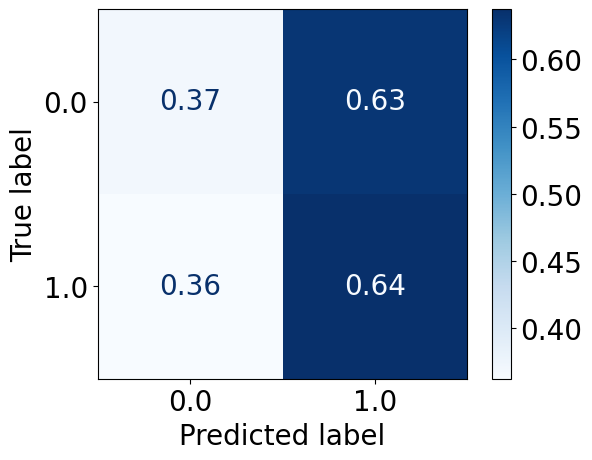

In [ ]:
pred_prob_test_2019_svm_balanced_2021 = svm_balanced_2021.predict_proba(X_test_2019)[:, 1]
pred_test_2019_svm_balanced_2021 = svm_balanced_2021.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_svm_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_svm_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_svm_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_svm_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_svm_balanced_2021, pred_prob_test_2019_svm_balanced_2021)

Class 1 Recall: 0.6373846153846154
Class 1 Precision: 0.15547716440875145
Class 1 Area Under Precision-Recall Curve: 0.1756159739432656
Class 1 F1-Score: 0.2499773735179654
Class 0 Recall: 0.36919411352487735
Class 0 Precision: 0.8482096857290057
Class 0 Area Under Precision-Recall Curve: 0.8296720144531345
Class 0 F1-Score: 0.5144620432396539
Overall Accuracy: 0.4105275637225845
Balanced Accuracy: 0.5032893644547464
Area Under ROC Curve: 0.5157659619427524
Matthews Correlation Coefficient: 0.004924914982639812
0.6373846153846154
0.15547716440875145
0.1756159739432656
0.2499773735179654
0.36919411352487735
0.8482096857290057
0.8296720144531345
0.5144620432396539
0.4105275637225845
0.5032893644547464
0.5157659619427524
0.004924914982639812


#### KNN

accuracy 0.736597510373444
              precision    recall  f1-score   support

         0.0       0.91      0.76      0.83     35675
         1.0       0.31      0.59      0.41      6500

    accuracy                           0.74     42175
   macro avg       0.61      0.68      0.62     42175
weighted avg       0.82      0.74      0.77     42175



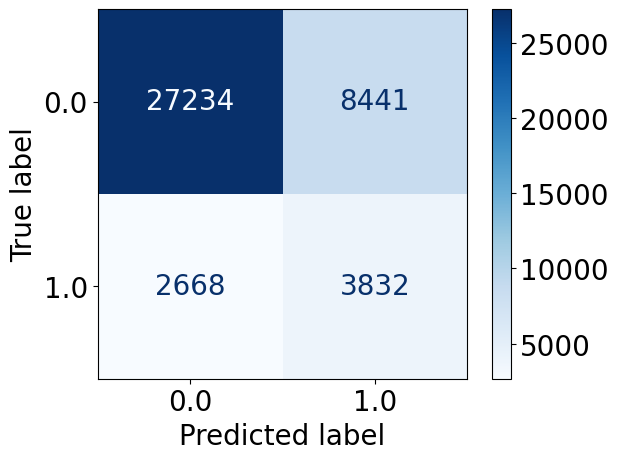

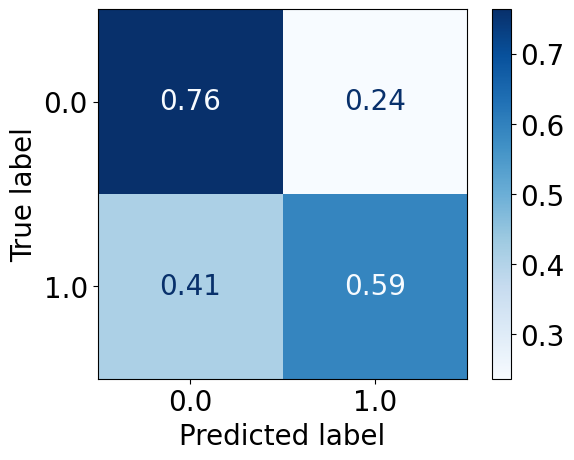

In [ ]:
pred_prob_test_2019_knn_balanced_2021 = knn_balanced_2021.predict_proba(X_test_2019)[:, 1]
pred_test_2019_knn_balanced_2021 = knn_balanced_2021.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_knn_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_knn_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_knn_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_knn_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_knn_balanced_2021, pred_prob_test_2019_knn_balanced_2021)

Class 1 Recall: 0.5895384615384616
Class 1 Precision: 0.3122300985904017
Class 1 Area Under Precision-Recall Curve: 0.300671781930901
Class 1 F1-Score: 0.4082458850476749
Class 0 Recall: 0.7633917309039944
Class 0 Precision: 0.9107751989833456
Class 0 Area Under Precision-Recall Curve: 0.7704586513790015
Class 0 F1-Score: 0.8305960931424127
Overall Accuracy: 0.736597510373444
Balanced Accuracy: 0.676465096221228
Area Under ROC Curve: 0.7408540132607406
Matthews Correlation Coefficient: 0.2805446534660566
0.5895384615384616
0.3122300985904017
0.300671781930901
0.4082458850476749
0.7633917309039944
0.9107751989833456
0.7704586513790015
0.8305960931424127
0.736597510373444
0.676465096221228
0.7408540132607406
0.2805446534660566


#### MLP

accuracy 0.6925666864256076
              precision    recall  f1-score   support

         0.0       0.94      0.68      0.79     35675
         1.0       0.30      0.76      0.43      6500

    accuracy                           0.69     42175
   macro avg       0.62      0.72      0.61     42175
weighted avg       0.84      0.69      0.73     42175



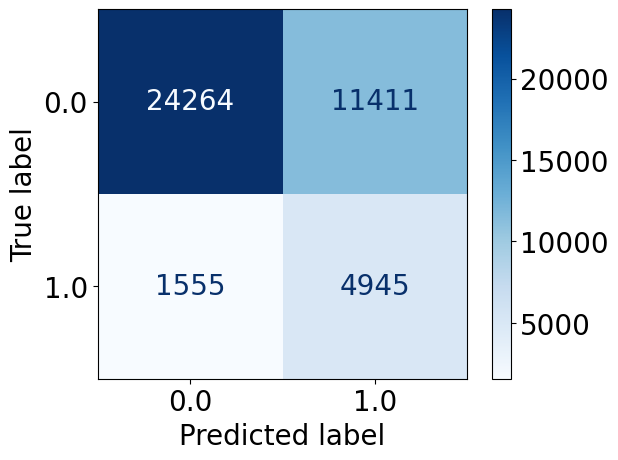

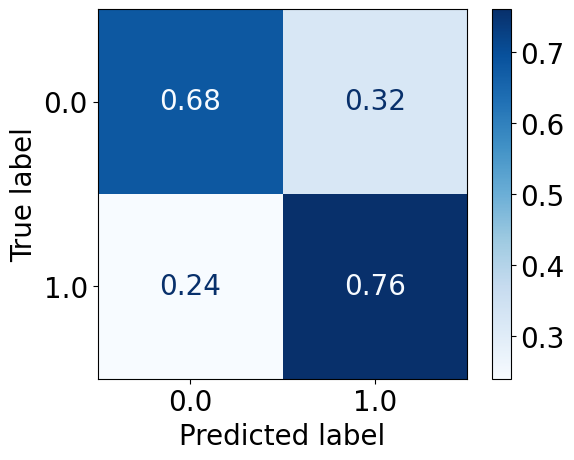

In [ ]:
pred_prob_test_2019_mlp_balanced_2021 = mlp_balanced_2021.predict_proba(X_test_2019)[:, 1]
pred_test_2019_mlp_balanced_2021 = mlp_balanced_2021.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_mlp_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_mlp_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_mlp_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_mlp_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_mlp_balanced_2021, pred_prob_test_2019_mlp_balanced_2021)

Class 1 Recall: 0.7607692307692308
Class 1 Precision: 0.30233553436047933
Class 1 Area Under Precision-Recall Curve: 0.36885078570109836
Class 1 F1-Score: 0.43270913545677286
Class 0 Recall: 0.6801401541695865
Class 0 Precision: 0.9397730353615554
Class 0 Area Under Precision-Recall Curve: 0.7310911363524575
Class 0 F1-Score: 0.7891501609913163
Overall Accuracy: 0.6925666864256076
Balanced Accuracy: 0.7204546924694086
Area Under ROC Curve: 0.7920938342946472
Matthews Correlation Coefficient: 0.3267230334160099
0.7607692307692308
0.30233553436047933
0.36885078570109836
0.43270913545677286
0.6801401541695865
0.9397730353615554
0.7310911363524575
0.7891501609913163
0.6925666864256076
0.7204546924694086
0.7920938342946472
0.3267230334160099


### Test on 2017

#### LR

accuracy 0.7358795615840087
              precision    recall  f1-score   support

         0.0       0.95      0.73      0.82     40340
         1.0       0.34      0.77      0.47      7286

    accuracy                           0.74     47626
   macro avg       0.64      0.75      0.65     47626
weighted avg       0.85      0.74      0.77     47626



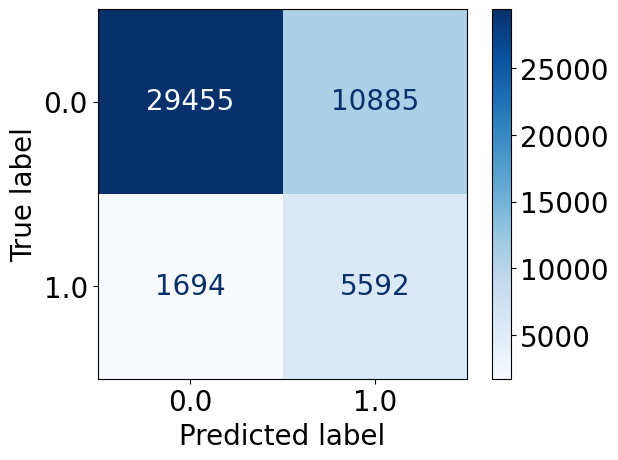

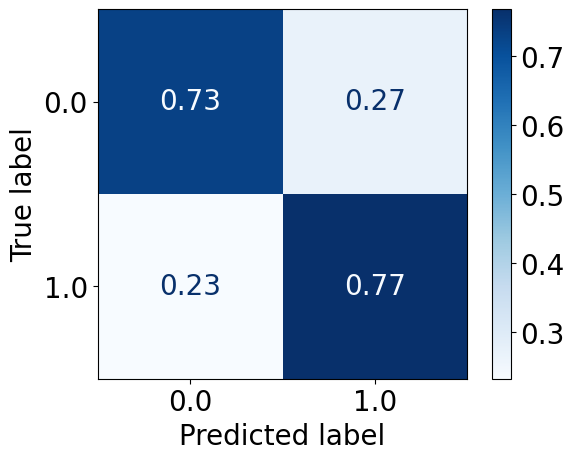

In [ ]:
pred_prob_test_2017_lr_balanced_2021 = lr_balanced_2021.predict_proba(X_test_2017)[:, 1]
pred_test_2017_lr_balanced_2021 = lr_balanced_2021.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_lr_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_lr_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_lr_balanced_2021, pred_prob_test_2017_lr_balanced_2021)

Class 1 Recall: 0.7674993137524019
Class 1 Precision: 0.33938216908417795
Class 1 Area Under Precision-Recall Curve: 0.4556889836805019
Class 1 F1-Score: 0.4706476454993057
Class 0 Recall: 0.7301685671789787
Class 0 Precision: 0.9456162316607275
Class 0 Area Under Precision-Recall Curve: 0.714006432599249
Class 0 F1-Score: 0.8240428597406595
Overall Accuracy: 0.7358795615840087
Balanced Accuracy: 0.7488339404656903
Area Under ROC Curve: 0.8258647995605838
Matthews Correlation Coefficient: 0.3766092805117121
0.7674993137524019
0.33938216908417795
0.4556889836805019
0.4706476454993057
0.7301685671789787
0.9456162316607275
0.714006432599249
0.8240428597406595
0.7358795615840087
0.7488339404656903
0.8258647995605838
0.3766092805117121


#### RF

accuracy 0.7066308318985428
              precision    recall  f1-score   support

         0.0       0.95      0.69      0.80     40340
         1.0       0.32      0.79      0.45      7286

    accuracy                           0.71     47626
   macro avg       0.63      0.74      0.63     47626
weighted avg       0.85      0.71      0.75     47626



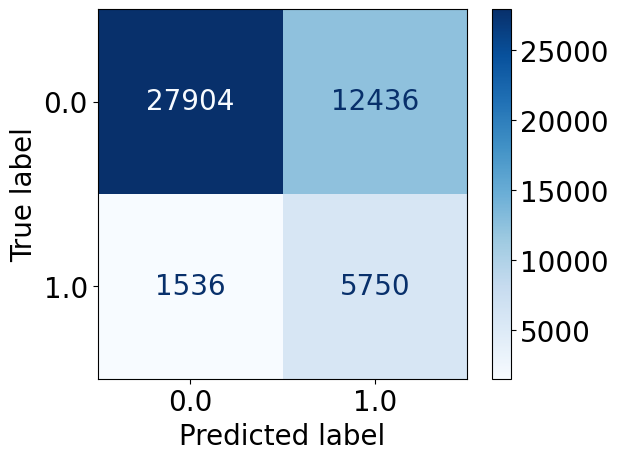

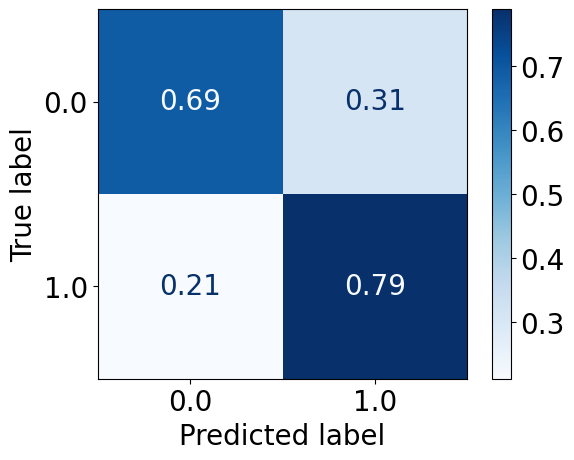

In [ ]:
pred_prob_test_2017_rf_balanced_2021 = rf_balanced_2021.predict_proba(X_test_2017)[:, 1]
pred_test_2017_rf_balanced_2021 = rf_balanced_2021.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_rf_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_rf_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_rf_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_rf_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_rf_balanced_2021, pred_prob_test_2017_rf_balanced_2021)

Class 1 Recall: 0.7891847378534175
Class 1 Precision: 0.3161772792257781
Class 1 Area Under Precision-Recall Curve: 0.42645496388928694
Class 1 F1-Score: 0.45147613065326636
Class 0 Recall: 0.6917203767972236
Class 0 Precision: 0.9478260869565217
Class 0 Area Under Precision-Recall Curve: 0.7207797784409757
Class 0 F1-Score: 0.7997707079392377
Overall Accuracy: 0.7066308318985428
Balanced Accuracy: 0.7404525573253206
Area Under ROC Curve: 0.8162755526011336
Matthews Correlation Coefficient: 0.3563152664173317
0.7891847378534175
0.3161772792257781
0.42645496388928694
0.45147613065326636
0.6917203767972236
0.9478260869565217
0.7207797784409757
0.7997707079392377
0.7066308318985428
0.7404525573253206
0.8162755526011336
0.3563152664173317


#### SVM

accuracy 0.4123587956158401
              precision    recall  f1-score   support

         0.0       0.85      0.37      0.52     40340
         1.0       0.15      0.63      0.25      7286

    accuracy                           0.41     47626
   macro avg       0.50      0.50      0.38     47626
weighted avg       0.74      0.41      0.48     47626



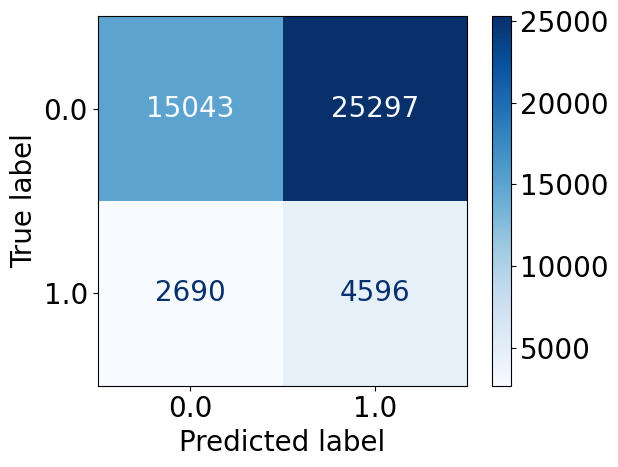

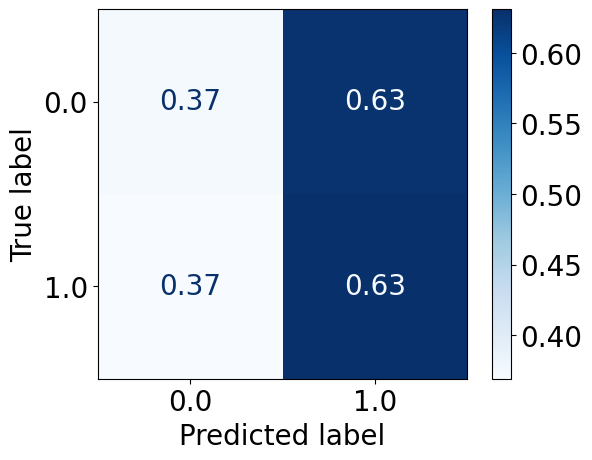

In [ ]:
pred_prob_test_2017_svm_balanced_2021 = svm_balanced_2021.predict_proba(X_test_2017)[:, 1]
pred_test_2017_svm_balanced_2021 = svm_balanced_2021.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_svm_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_svm_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_svm_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_svm_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_svm_balanced_2021, pred_prob_test_2017_svm_balanced_2021)

Class 1 Recall: 0.6307987922042273
Class 1 Precision: 0.15374836918342086
Class 1 Area Under Precision-Recall Curve: 0.17322854447168812
Class 1 F1-Score: 0.24723634309690956
Class 0 Recall: 0.3729053049082796
Class 0 Precision: 0.8483054192747984
Class 0 Area Under Precision-Recall Curve: 0.8313334882771058
Class 0 F1-Score: 0.5180720816902864
Overall Accuracy: 0.4123587956158401
Balanced Accuracy: 0.5018520485562534
Area Under ROC Curve: 0.51503995648571
Matthews Correlation Coefficient: 0.0027581573373884963
0.6307987922042273
0.15374836918342086
0.17322854447168812
0.24723634309690956
0.3729053049082796
0.8483054192747984
0.8313334882771058
0.5180720816902864
0.4123587956158401
0.5018520485562534
0.51503995648571
0.0027581573373884963


#### KNN

accuracy 0.7438583966740856
              precision    recall  f1-score   support

         0.0       0.91      0.77      0.84     40340
         1.0       0.32      0.59      0.41      7286

    accuracy                           0.74     47626
   macro avg       0.62      0.68      0.63     47626
weighted avg       0.82      0.74      0.77     47626



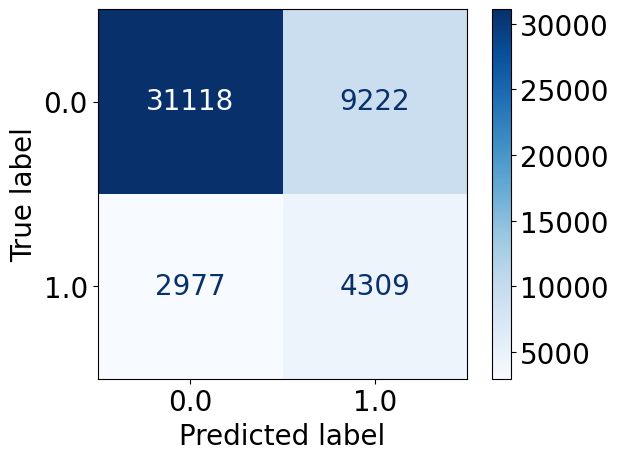

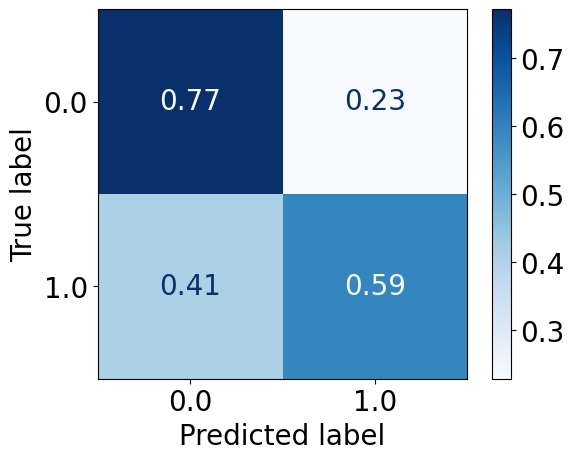

In [ ]:
pred_prob_test_2017_knn_balanced_2021 = knn_balanced_2021.predict_proba(X_test_2017)[:, 1]
pred_test_2017_knn_balanced_2021 = knn_balanced_2021.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_knn_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_knn_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_knn_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_knn_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_knn_balanced_2021, pred_prob_test_2017_knn_balanced_2021)

Class 1 Recall: 0.5914081800713697
Class 1 Precision: 0.318453920626709
Class 1 Area Under Precision-Recall Curve: 0.30701286056039573
Class 1 F1-Score: 0.4139885670365567
Class 0 Recall: 0.7713931581556768
Class 0 Precision: 0.9126851444493328
Class 0 Area Under Precision-Recall Curve: 0.7698731521689386
Class 0 F1-Score: 0.8361120440652919
Overall Accuracy: 0.7438583966740856
Balanced Accuracy: 0.6814006691135233
Area Under ROC Curve: 0.7487078012164241
Matthews Correlation Coefficient: 0.28958170198777466
0.5914081800713697
0.318453920626709
0.30701286056039573
0.4139885670365567
0.7713931581556768
0.9126851444493328
0.7698731521689386
0.8361120440652919
0.7438583966740856
0.6814006691135233
0.7487078012164241
0.28958170198777466


#### MLP

accuracy 0.7092974425733843
              precision    recall  f1-score   support

         0.0       0.94      0.70      0.80     40340
         1.0       0.31      0.76      0.44      7286

    accuracy                           0.71     47626
   macro avg       0.63      0.73      0.62     47626
weighted avg       0.84      0.71      0.75     47626



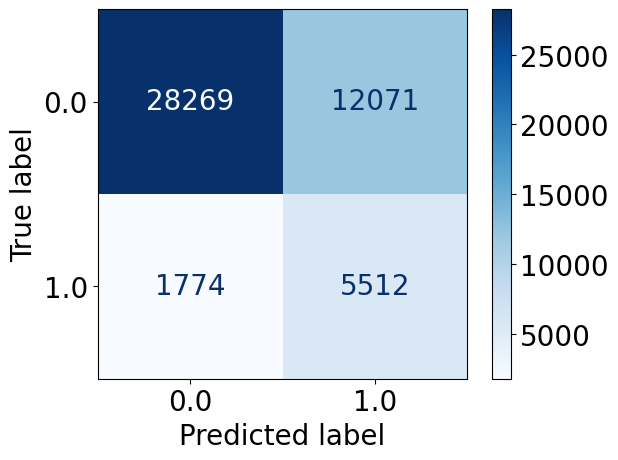

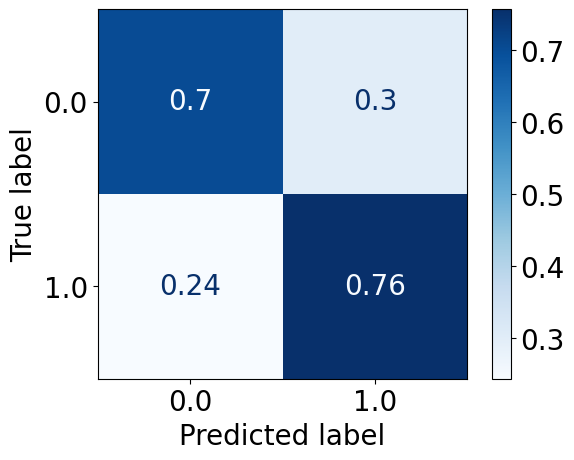

In [ ]:
pred_prob_test_2017_mlp_balanced_2021 = mlp_balanced_2021.predict_proba(X_test_2017)[:, 1]
pred_test_2017_mlp_balanced_2021 = mlp_balanced_2021.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_mlp_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_mlp_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_mlp_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_mlp_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_mlp_balanced_2021, pred_prob_test_2017_mlp_balanced_2021)

Class 1 Recall: 0.7565193521822674
Class 1 Precision: 0.3134846158221009
Class 1 Area Under Precision-Recall Curve: 0.3833493151927209
Class 1 F1-Score: 0.443282801881861
Class 0 Recall: 0.7007684680218146
Class 0 Precision: 0.9409513031321772
Class 0 Area Under Precision-Recall Curve: 0.7285643179346679
Class 0 F1-Score: 0.8032905673244959
Overall Accuracy: 0.7092974425733843
Balanced Accuracy: 0.728643910102041
Area Under ROC Curve: 0.7992618313236747
Matthews Correlation Coefficient: 0.3411018128949541
0.7565193521822674
0.3134846158221009
0.3833493151927209
0.443282801881861
0.7007684680218146
0.9409513031321772
0.7285643179346679
0.8032905673244959
0.7092974425733843
0.728643910102041
0.7992618313236747
0.3411018128949541


### Test on 2015

#### LR

accuracy 0.7367167294341849
              precision    recall  f1-score   support

         0.0       0.95      0.73      0.83     37411
         1.0       0.34      0.76      0.47      6667

    accuracy                           0.74     44078
   macro avg       0.64      0.75      0.65     44078
weighted avg       0.85      0.74      0.77     44078



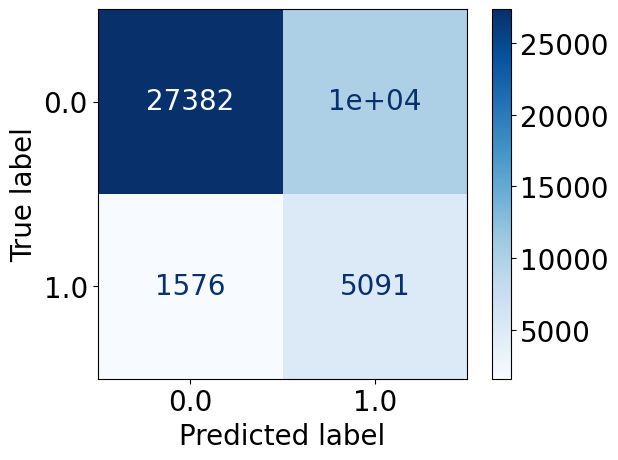

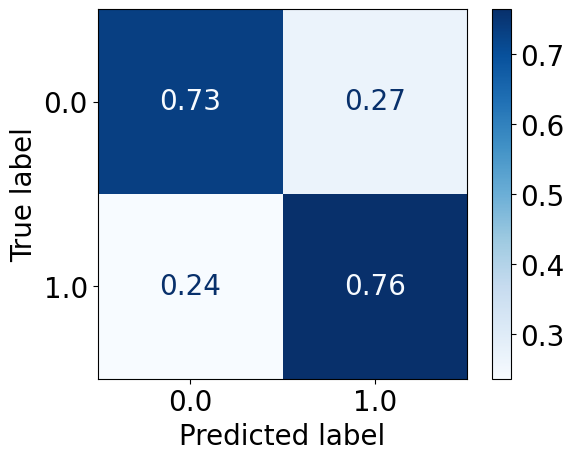

In [ ]:
pred_prob_test_2015_lr_balanced_2021 = lr_balanced_2021.predict_proba(X_test_2015)[:, 1]
pred_test_2015_lr_balanced_2021 = lr_balanced_2021.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_lr_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_lr_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_lr_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_lr_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_lr_balanced_2021, pred_prob_test_2015_lr_balanced_2021)

Class 1 Recall: 0.7636118194090296
Class 1 Precision: 0.33670634920634923
Class 1 Area Under Precision-Recall Curve: 0.4450809549624265
Class 1 F1-Score: 0.4673429109101759
Class 0 Recall: 0.73192376573735
Class 0 Precision: 0.9455763519580082
Class 0 Area Under Precision-Recall Curve: 0.7182112860228249
Class 0 F1-Score: 0.8251442691618075
Overall Accuracy: 0.7367167294341849
Balanced Accuracy: 0.7477677925731898
Area Under ROC Curve: 0.822180180184009
Matthews Correlation Coefficient: 0.37400684953377583
0.7636118194090296
0.33670634920634923
0.4450809549624265
0.4673429109101759
0.73192376573735
0.9455763519580082
0.7182112860228249
0.8251442691618075
0.7367167294341849
0.7477677925731898
0.822180180184009
0.37400684953377583


#### RF

accuracy 0.7072235582376696
              precision    recall  f1-score   support

         0.0       0.95      0.69      0.80     37411
         1.0       0.31      0.78      0.45      6667

    accuracy                           0.71     44078
   macro avg       0.63      0.74      0.62     44078
weighted avg       0.85      0.71      0.75     44078



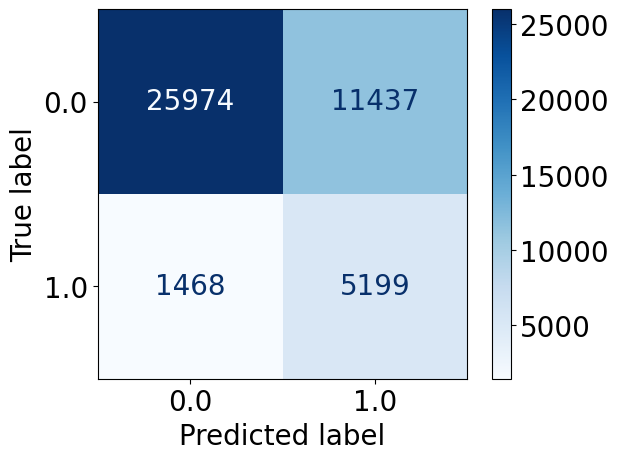

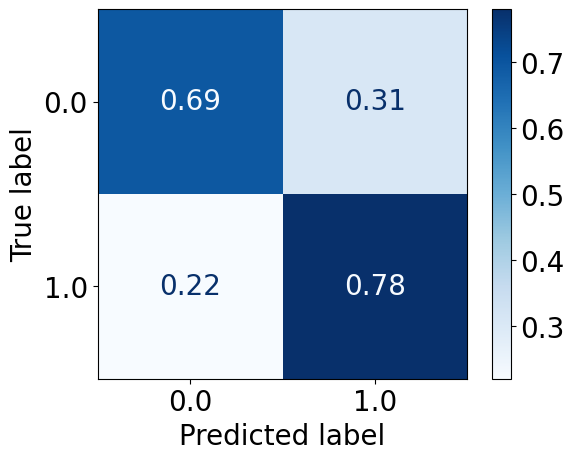

In [ ]:
pred_prob_test_2015_rf_balanced_2021 = rf_balanced_2021.predict_proba(X_test_2015)[:, 1]
pred_test_2015_rf_balanced_2021 = rf_balanced_2021.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_rf_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_rf_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_rf_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_rf_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_rf_balanced_2021, pred_prob_test_2015_rf_balanced_2021)

Class 1 Recall: 0.7798110094495275
Class 1 Precision: 0.31251502765087763
Class 1 Area Under Precision-Recall Curve: 0.4076882427882028
Class 1 F1-Score: 0.4462086426640347
Class 0 Recall: 0.694287776322472
Class 0 Precision: 0.9465053567524233
Class 0 Area Under Precision-Recall Curve: 0.7262464552941594
Class 0 F1-Score: 0.8010115183568994
Overall Accuracy: 0.7072235582376696
Balanced Accuracy: 0.7370493928859998
Area Under ROC Curve: 0.8089859039164263
Matthews Correlation Coefficient: 0.3504300925089076
0.7798110094495275
0.31251502765087763
0.4076882427882028
0.4462086426640347
0.694287776322472
0.9465053567524233
0.7262464552941594
0.8010115183568994
0.7072235582376696
0.7370493928859998
0.8089859039164263
0.3504300925089076


#### SVM

accuracy 0.3242660737783021
              precision    recall  f1-score   support

         0.0       0.84      0.25      0.39     37411
         1.0       0.15      0.72      0.24      6667

    accuracy                           0.32     44078
   macro avg       0.49      0.49      0.32     44078
weighted avg       0.73      0.32      0.37     44078



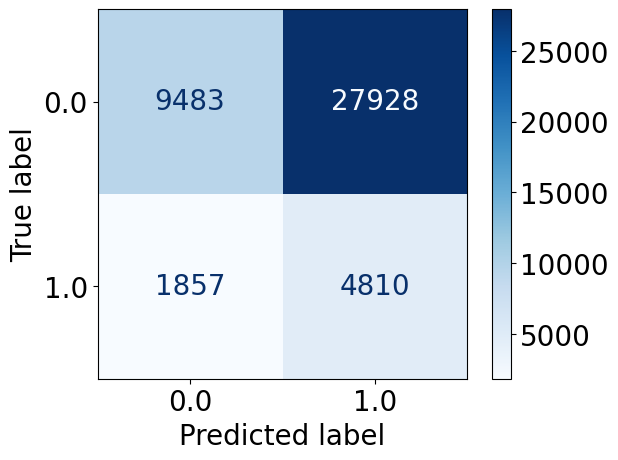

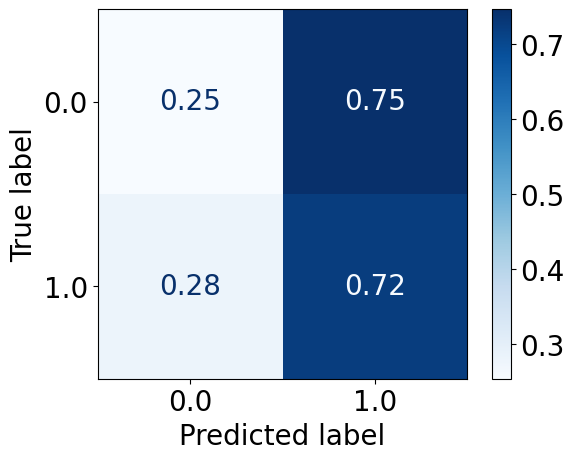

In [ ]:
pred_prob_test_2015_svm_balanced_2021 = svm_balanced_2021.predict_proba(X_test_2015)[:, 1]
pred_test_2015_svm_balanced_2021 = svm_balanced_2021.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_svm_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_svm_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_svm_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_svm_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_svm_balanced_2021, pred_prob_test_2015_svm_balanced_2021)

Class 1 Recall: 0.7214639268036598
Class 1 Precision: 0.14692406377909464
Class 1 Area Under Precision-Recall Curve: 0.17144574348243935
Class 1 F1-Score: 0.24413145539906106
Class 0 Recall: 0.2534815963219374
Class 0 Precision: 0.8362433862433862
Class 0 Area Under Precision-Recall Curve: 0.8332019600603457
Class 0 F1-Score: 0.3890381735759266
Overall Accuracy: 0.3242660737783021
Balanced Accuracy: 0.4874727615627986
Area Under ROC Curve: 0.5097928953222222
Matthews Correlation Coefficient: -0.0205360837101182
0.7214639268036598
0.14692406377909464
0.17144574348243935
0.24413145539906106
0.2534815963219374
0.8362433862433862
0.8332019600603457
0.3890381735759266
0.3242660737783021
0.4874727615627986
0.5097928953222222
-0.0205360837101182


#### KNN

accuracy 0.7610826262534598
              precision    recall  f1-score   support

         0.0       0.91      0.80      0.85     37411
         1.0       0.33      0.55      0.41      6667

    accuracy                           0.76     44078
   macro avg       0.62      0.67      0.63     44078
weighted avg       0.82      0.76      0.78     44078



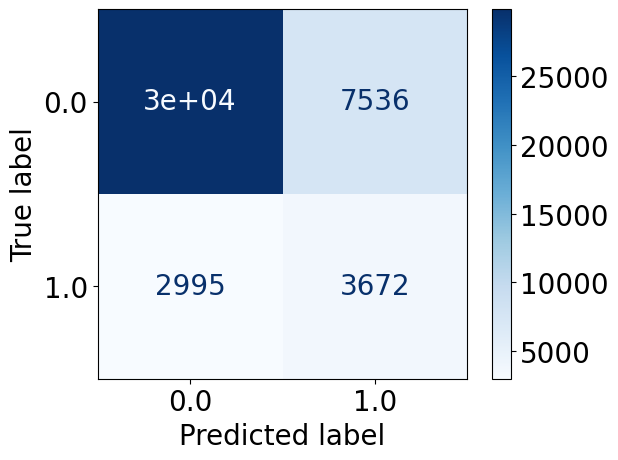

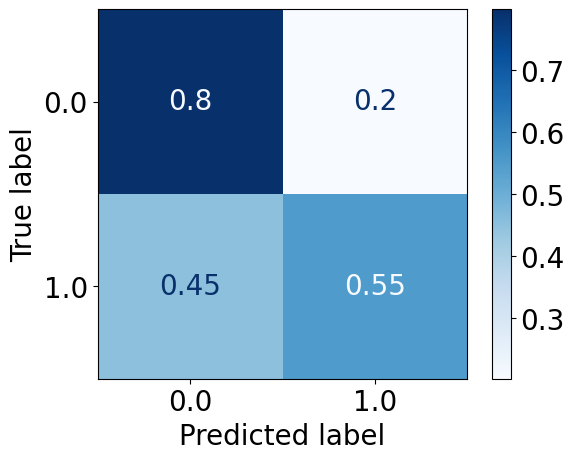

In [ ]:
pred_prob_test_2015_knn_balanced_2021 = knn_balanced_2021.predict_proba(X_test_2015)[:, 1]
pred_test_2015_knn_balanced_2021 = knn_balanced_2021.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_knn_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_knn_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_knn_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_knn_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_knn_balanced_2021, pred_prob_test_2015_knn_balanced_2021)

Class 1 Recall: 0.5507724613769311
Class 1 Precision: 0.32762312633832974
Class 1 Area Under Precision-Recall Curve: 0.3085143799443198
Class 1 F1-Score: 0.41085314685314683
Class 0 Recall: 0.7985619202908235
Class 0 Precision: 0.9088834803772436
Class 0 Area Under Precision-Recall Curve: 0.7730100227682494
Class 0 F1-Score: 0.8501586488524637
Overall Accuracy: 0.7610826262534598
Balanced Accuracy: 0.6746671908338773
Area Under ROC Curve: 0.7473356284606181
Matthews Correlation Coefficient: 0.2874367569002331
0.5507724613769311
0.32762312633832974
0.3085143799443198
0.41085314685314683
0.7985619202908235
0.9088834803772436
0.7730100227682494
0.8501586488524637
0.7610826262534598
0.6746671908338773
0.7473356284606181
0.2874367569002331


#### MLP

accuracy 0.7135759335723036
              precision    recall  f1-score   support

         0.0       0.94      0.71      0.81     37411
         1.0       0.31      0.76      0.44      6667

    accuracy                           0.71     44078
   macro avg       0.63      0.73      0.63     44078
weighted avg       0.85      0.71      0.75     44078



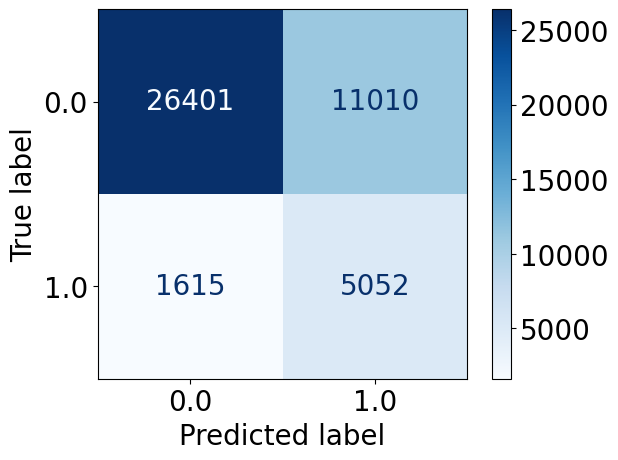

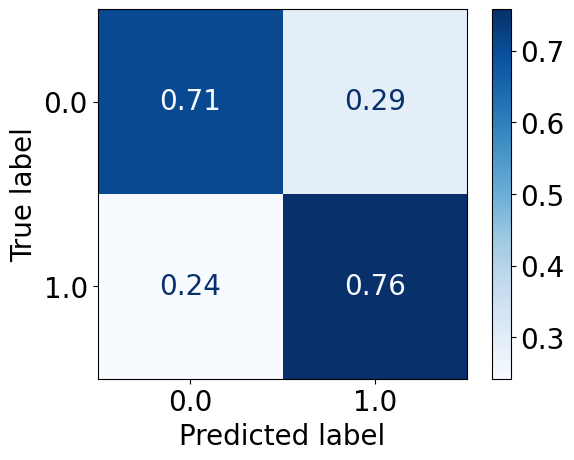

In [ ]:
pred_prob_test_2015_mlp_balanced_2021 = mlp_balanced_2021.predict_proba(X_test_2015)[:, 1]
pred_test_2015_mlp_balanced_2021 = mlp_balanced_2021.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_mlp_balanced_2021))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_mlp_balanced_2021))

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_mlp_balanced_2021,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_mlp_balanced_2021,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_mlp_balanced_2021, pred_prob_test_2015_mlp_balanced_2021)

Class 1 Recall: 0.7577621118944052
Class 1 Precision: 0.3145311916324244
Class 1 Area Under Precision-Recall Curve: 0.39010168403875695
Class 1 F1-Score: 0.4445422147916758
Class 0 Recall: 0.7057015316350805
Class 0 Precision: 0.9423543689320388
Class 0 Area Under Precision-Recall Curve: 0.7287210883324493
Class 0 F1-Score: 0.8070368502300274
Overall Accuracy: 0.7135759335723036
Balanced Accuracy: 0.7317318217647428
Area Under ROC Curve: 0.8032399775322774
Matthews Correlation Coefficient: 0.34504654449700045
0.7577621118944052
0.3145311916324244
0.39010168403875695
0.4445422147916758
0.7057015316350805
0.9423543689320388
0.7287210883324493
0.8070368502300274
0.7135759335723036
0.7317318217647428
0.8032399775322774
0.34504654449700045


# Train on 2019 and test on each of 2021 and 2017
See effect of new and previous year

## Train model on imbalanced dataset 2019

### Train and test on 2019

accuracy 0.853633669235329
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     35675
         1.0       0.57      0.21      0.31      6500

    accuracy                           0.85     42175
   macro avg       0.72      0.59      0.61     42175
weighted avg       0.82      0.85      0.82     42175



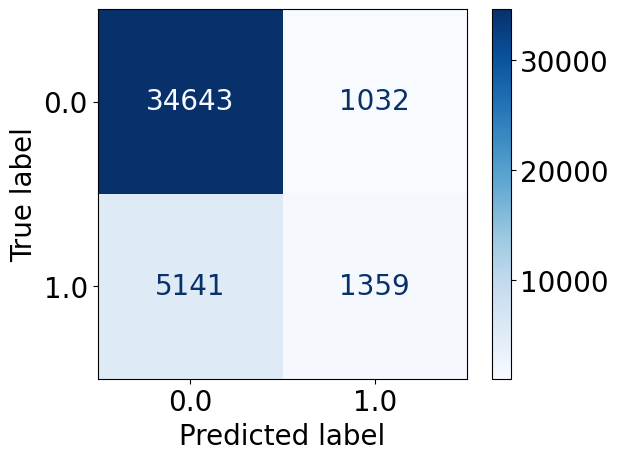

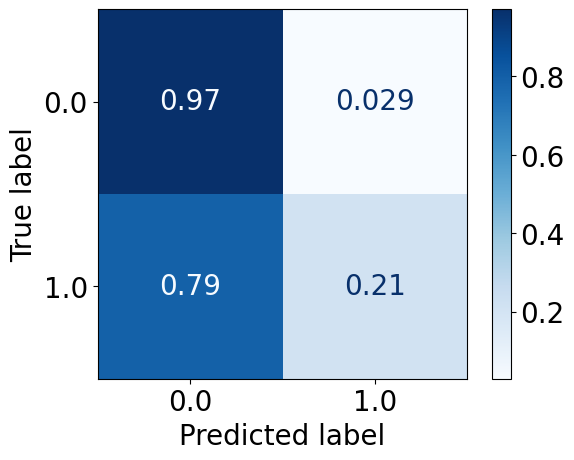

In [ ]:
lr_2019 = LogisticRegression(solver='liblinear')
lr_2019.fit(X_train_2019, y_train_2019)

pred_prob_test_2019_lr_2019 = lr_2019.predict_proba(X_test_2019)[:, 1]
pred_test_2019_lr_2019 = lr_2019.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_lr_2019))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_lr_2019))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_2019,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_2019,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_lr_2019, pred_prob_test_2019_lr_2019)

Class 1 Recall: 0.20907692307692308
Class 1 Precision: 0.5683814303638645
Class 1 Area Under Precision-Recall Curve: 0.4526396127737961
Class 1 F1-Score: 0.30570239568102575
Class 0 Recall: 0.971072179397337
Class 0 Precision: 0.8707771968630605
Class 0 Area Under Precision-Recall Curve: 0.7133998863519367
Class 0 F1-Score: 0.9181939861381677
Overall Accuracy: 0.853633669235329
Balanced Accuracy: 0.59007455123713
Area Under ROC Curve: 0.8236011557328446
Matthews Correlation Coefficient: 0.2812721680841507
0.20907692307692308
0.5683814303638645
0.4526396127737961
0.30570239568102575
0.971072179397337
0.8707771968630605
0.7133998863519367
0.9181939861381677
0.853633669235329
0.59007455123713
0.8236011557328446
0.2812721680841507


### Test on 2021

accuracy 0.8557759568302189
              precision    recall  f1-score   support

         0.0       0.87      0.98      0.92     33912
         1.0       0.59      0.19      0.28      6116

    accuracy                           0.86     40028
   macro avg       0.73      0.58      0.60     40028
weighted avg       0.83      0.86      0.82     40028



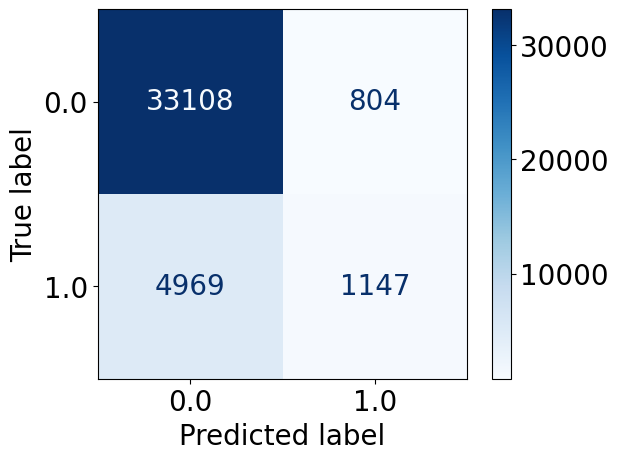

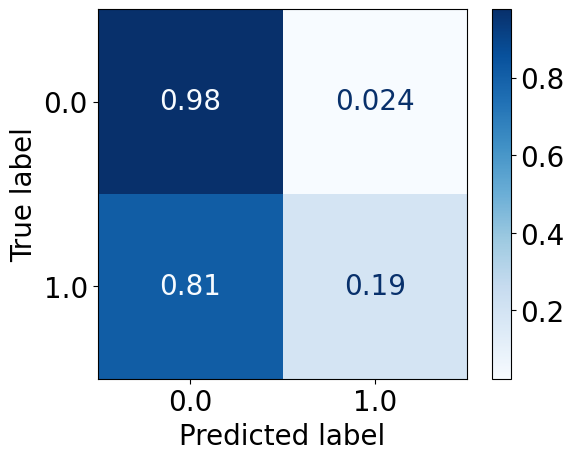

In [ ]:
pred_prob_test_2021_lr_2019 = lr_2019.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_2019 = lr_2019.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_2019))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_2019))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_2019,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_2019,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_lr_2019, pred_prob_test_2021_lr_2019)

Class 1 Recall: 0.18754087638979725
Class 1 Precision: 0.5879036391594055
Class 1 Area Under Precision-Recall Curve: 0.44929956018005834
Class 1 F1-Score: 0.2843684145283253
Class 0 Recall: 0.9762915782024062
Class 0 Precision: 0.8695012737348006
Class 0 Area Under Precision-Recall Curve: 0.715464681932781
Class 0 F1-Score: 0.9198071927655614
Overall Accuracy: 0.8557759568302189
Balanced Accuracy: 0.5819162272961017
Area Under ROC Curve: 0.8232579324496396
Matthews Correlation Coefficient: 0.27374763856879347
0.18754087638979725
0.5879036391594055
0.44929956018005834
0.2843684145283253
0.9762915782024062
0.8695012737348006
0.715464681932781
0.9198071927655614
0.8557759568302189
0.5819162272961017
0.8232579324496396
0.27374763856879347


### Test on 2017

accuracy 0.856905891739806
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     40340
         1.0       0.59      0.21      0.31      7286

    accuracy                           0.86     47626
   macro avg       0.73      0.59      0.61     47626
weighted avg       0.83      0.86      0.83     47626



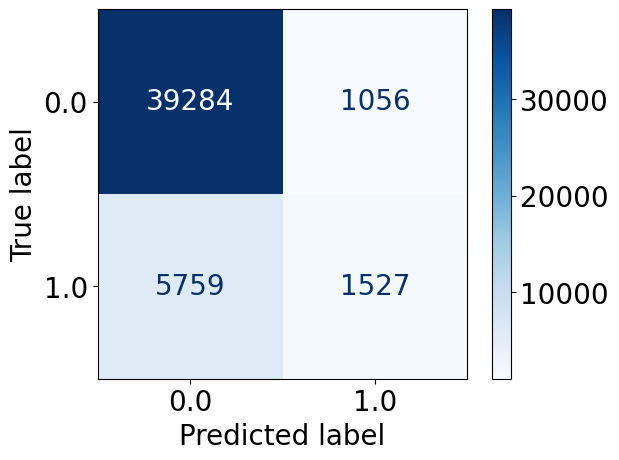

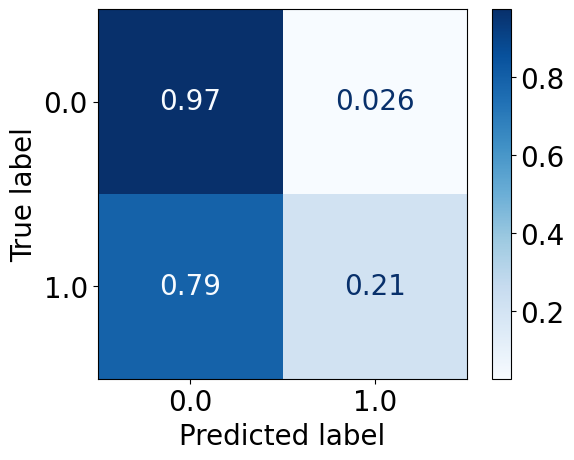

In [ ]:
pred_prob_test_2017_lr_2019 = lr_2019.predict_proba(X_test_2017)[:, 1]
pred_test_2017_lr_2019 = lr_2019.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_lr_2019))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_lr_2019))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_2019,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_2019,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_lr_2019, pred_prob_test_2017_lr_2019)

Class 1 Recall: 0.20958001646994234
Class 1 Precision: 0.5911730545876888
Class 1 Area Under Precision-Recall Curve: 0.4593127913105355
Class 1 F1-Score: 0.3094538453744047
Class 0 Recall: 0.9738225086762519
Class 0 Precision: 0.8721443953555491
Class 0 Area Under Precision-Recall Curve: 0.7132876495235959
Class 0 F1-Score: 0.9201831746366372
Overall Accuracy: 0.856905891739806
Balanced Accuracy: 0.5917012625730971
Area Under ROC Curve: 0.8275537171620146
Matthews Correlation Coefficient: 0.29150229889982904
0.20958001646994234
0.5911730545876888
0.4593127913105355
0.3094538453744047
0.9738225086762519
0.8721443953555491
0.7132876495235959
0.9201831746366372
0.856905891739806
0.5917012625730971
0.8275537171620146
0.29150229889982904


## Train model on balanced (undersampling) dataset 2019

### Train and test on 2019

accuracy 0.7362418494368702
              precision    recall  f1-score   support

         0.0       0.94      0.73      0.82     35675
         1.0       0.34      0.76      0.47      6500

    accuracy                           0.74     42175
   macro avg       0.64      0.75      0.65     42175
weighted avg       0.85      0.74      0.77     42175



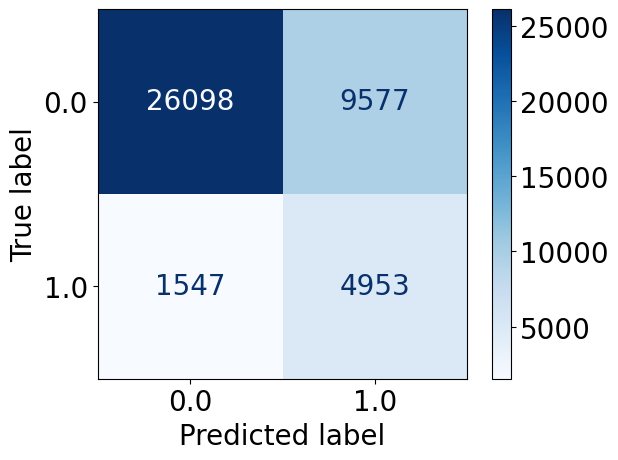

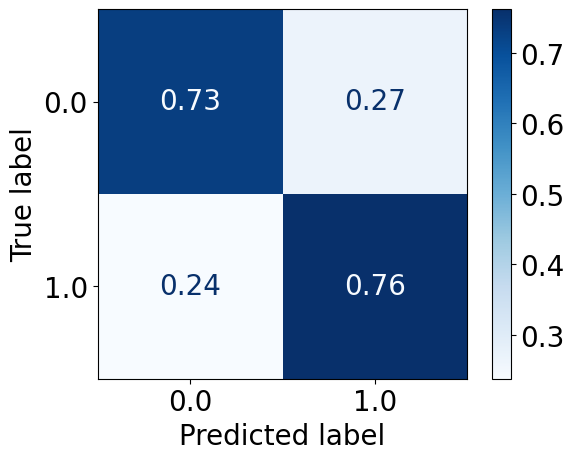

In [ ]:
lr_2019_balanced = LogisticRegression(solver='liblinear')
lr_2019_balanced.fit(X_train_2019_balanced, y_train_2019_balanced)

pred_prob_test_2019_lr_2019_balanced = lr_2019_balanced.predict_proba(X_test_2019)[:, 1]
pred_test_2019_lr_2019_balanced = lr_2019_balanced.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_lr_2019_balanced))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_lr_2019_balanced))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_2019_balanced,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_2019_balanced,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_lr_2019_balanced, pred_prob_test_2019_lr_2019_balanced)

Class 1 Recall: 0.762
Class 1 Precision: 0.34088093599449415
Class 1 Area Under Precision-Recall Curve: 0.4510411595421777
Class 1 F1-Score: 0.4710413694721826
Class 0 Recall: 0.7315487035739313
Class 0 Precision: 0.9440405136552722
Class 0 Area Under Precision-Recall Curve: 0.7136129240976766
Class 0 F1-Score: 0.8243209096651927
Overall Accuracy: 0.7362418494368702
Balanced Accuracy: 0.7467743517869656
Area Under ROC Curve: 0.8235556854077948
Matthews Correlation Coefficient: 0.37499681611321356
0.762
0.34088093599449415
0.4510411595421777
0.4710413694721826
0.7315487035739313
0.9440405136552722
0.7136129240976766
0.8243209096651927
0.7362418494368702
0.7467743517869656
0.8235556854077948
0.37499681611321356


### Test on 2021

accuracy 0.7509243529529329
              precision    recall  f1-score   support

         0.0       0.94      0.75      0.84     33912
         1.0       0.35      0.73      0.47      6116

    accuracy                           0.75     40028
   macro avg       0.64      0.74      0.65     40028
weighted avg       0.85      0.75      0.78     40028



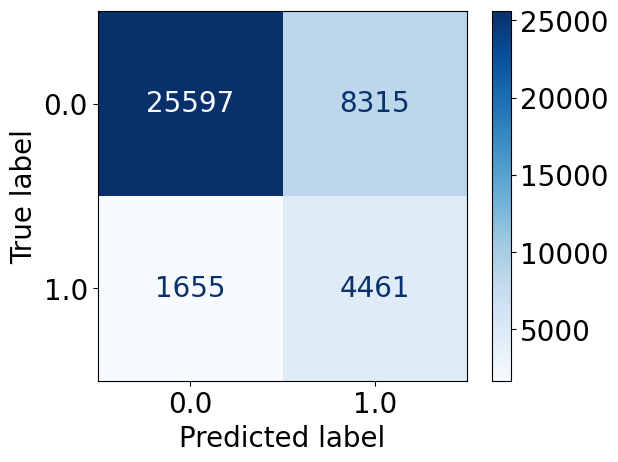

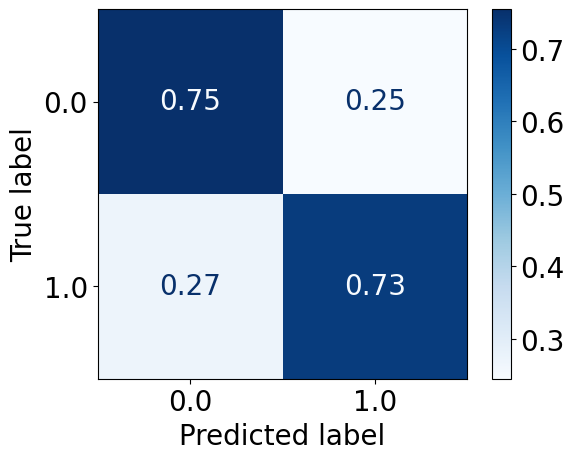

In [ ]:
pred_prob_test_2021_lr_2019_balanced = lr_2019_balanced.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_2019_balanced = lr_2019_balanced.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_2019_balanced))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_2019_balanced))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_2019_balanced,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_2019_balanced,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_lr_2019_balanced, pred_prob_test_2021_lr_2019_balanced)

Class 1 Recall: 0.7293982995421844
Class 1 Precision: 0.34917031934877896
Class 1 Area Under Precision-Recall Curve: 0.4483805826254744
Class 1 F1-Score: 0.47226339191192035
Class 0 Recall: 0.7548065581505072
Class 0 Precision: 0.9392705122559812
Class 0 Area Under Precision-Recall Curve: 0.7155548618459694
Class 0 F1-Score: 0.8369956183375843
Overall Accuracy: 0.7509243529529329
Balanced Accuracy: 0.7421024288463458
Area Under ROC Curve: 0.8234442001503989
Matthews Correlation Coefficient: 0.3737170745630236
0.7293982995421844
0.34917031934877896
0.4483805826254744
0.47226339191192035
0.7548065581505072
0.9392705122559812
0.7155548618459694
0.8369956183375843
0.7509243529529329
0.7421024288463458
0.8234442001503989
0.3737170745630236


### Test on 2017

accuracy 0.7482047621047327
              precision    recall  f1-score   support

         0.0       0.94      0.75      0.83     40340
         1.0       0.35      0.75      0.48      7286

    accuracy                           0.75     47626
   macro avg       0.65      0.75      0.66     47626
weighted avg       0.85      0.75      0.78     47626



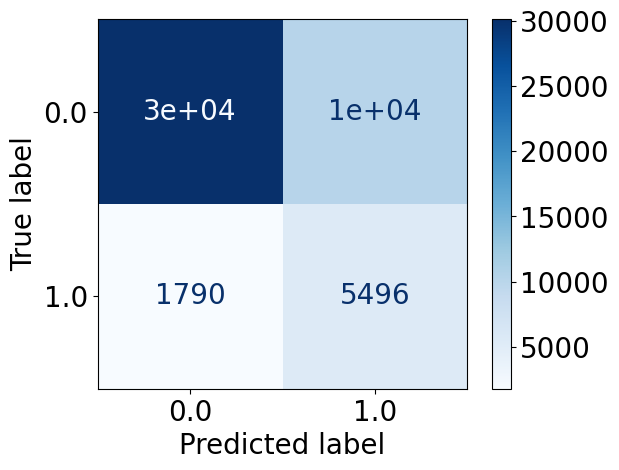

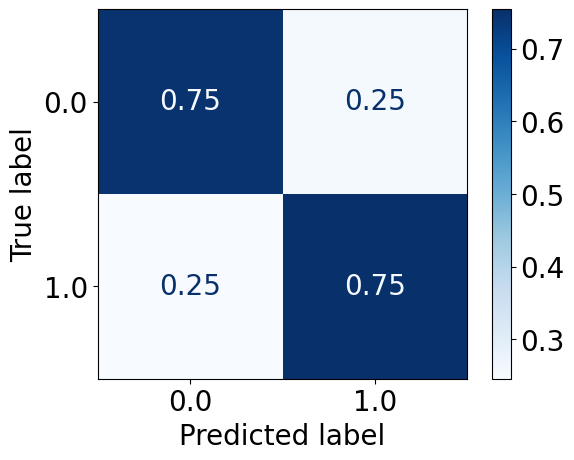

In [ ]:
pred_prob_test_2017_lr_2019_balanced = lr_2019_balanced.predict_proba(X_test_2017)[:, 1]
pred_test_2017_lr_2019_balanced = lr_2019_balanced.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_lr_2019_balanced))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_lr_2019_balanced))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_2019_balanced,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_2019_balanced,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_lr_2019_balanced, pred_prob_test_2017_lr_2019_balanced)

Class 1 Recall: 0.7543233598682405
Class 1 Precision: 0.3501082940501975
Class 1 Area Under Precision-Recall Curve: 0.4580693948033064
Class 1 F1-Score: 0.4782457361642882
Class 0 Recall: 0.7470996529499256
Class 0 Precision: 0.9439363568028063
Class 0 Area Under Precision-Recall Curve: 0.7133594030851582
Class 0 F1-Score: 0.8340621021752366
Overall Accuracy: 0.7482047621047327
Balanced Accuracy: 0.750711506409083
Area Under ROC Curve: 0.8279611651905823
Matthews Correlation Coefficient: 0.3839801488798332
0.7543233598682405
0.3501082940501975
0.4580693948033064
0.4782457361642882
0.7470996529499256
0.9439363568028063
0.7133594030851582
0.8340621021752366
0.7482047621047327
0.750711506409083
0.8279611651905823
0.3839801488798332


# Train on 2019, 2017, 2015 and test on other

## Train with raw (imbalanced) dataset

### Train and test on 2019, 2017, 2015 combinedly

accuracy 0.8571396559579919
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92    113681
         1.0       0.57      0.21      0.31     20198

    accuracy                           0.86    133879
   macro avg       0.72      0.59      0.61    133879
weighted avg       0.83      0.86      0.83    133879



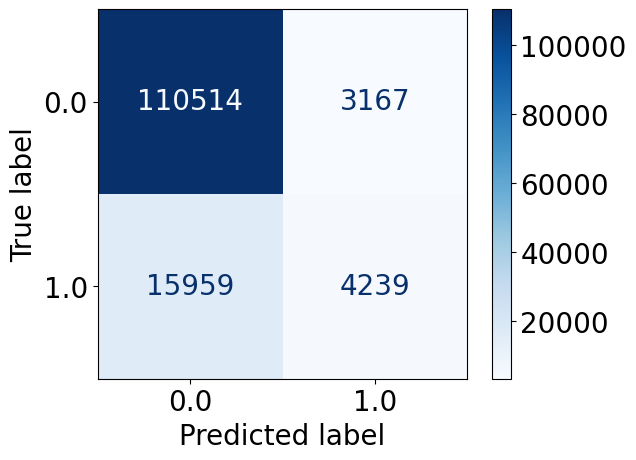

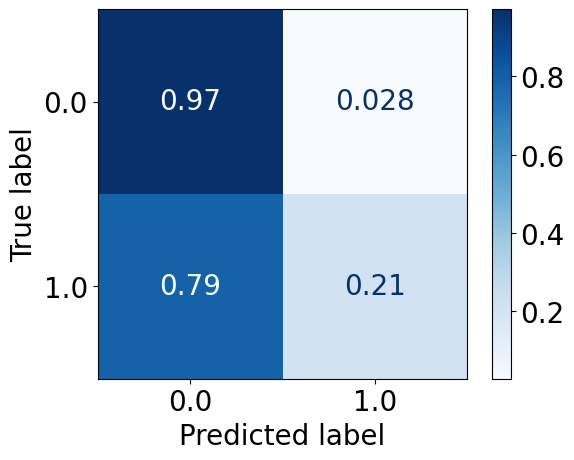

In [ ]:
lr_2019_17_15 = LogisticRegression(solver='liblinear')
lr_2019_17_15.fit(X_train_2019_17_15, y_train_2019_17_15)

pred_prob_test_2019_17_15_lr = lr_2019_17_15.predict_proba(X_test_2019_17_15)[:, 1]
pred_test_2019_17_15_lr = lr_2019_17_15.predict(X_test_2019_17_15)

print("accuracy", accuracy_score(y_test_2019_17_15, pred_test_2019_17_15_lr))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019_17_15, pred_test_2019_17_15_lr))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019_17_15, pred_test_2019_17_15_lr,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019_17_15, pred_test_2019_17_15_lr,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019_17_15, pred_test_2019_17_15_lr, pred_prob_test_2019_17_15_lr)

Class 1 Recall: 0.20987226458065156
Class 1 Precision: 0.5723737510126924
Class 1 Area Under Precision-Recall Curve: 0.4508559411588719
Class 1 F1-Score: 0.3071294015360093
Class 0 Recall: 0.9721413428805166
Class 0 Precision: 0.8738149644588173
Class 0 Area Under Precision-Recall Curve: 0.717361131397904
Class 0 F1-Score: 0.9203594360285484
Overall Accuracy: 0.8571396559579919
Balanced Accuracy: 0.591006803730584
Area Under ROC Curve: 0.8256201364341734
Matthews Correlation Coefficient: 0.284977924954608
0.20987226458065156
0.5723737510126924
0.4508559411588719
0.3071294015360093
0.9721413428805166
0.8738149644588173
0.717361131397904
0.9203594360285484
0.8571396559579919
0.591006803730584
0.8256201364341734
0.284977924954608


### Test on 2021

accuracy 0.8556760267812531
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     33912
         1.0       0.58      0.20      0.30      6116

    accuracy                           0.86     40028
   macro avg       0.73      0.59      0.61     40028
weighted avg       0.83      0.86      0.82     40028



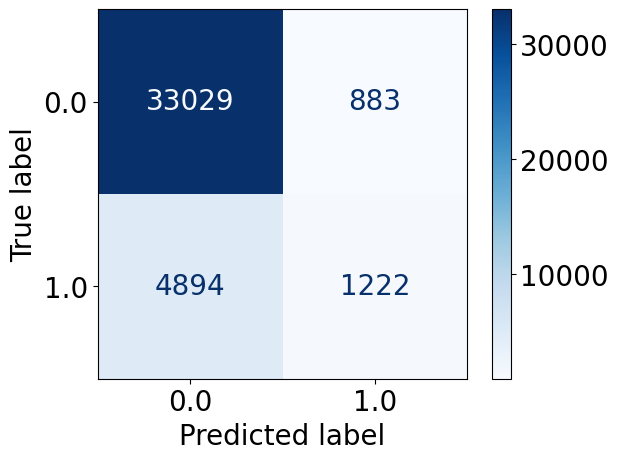

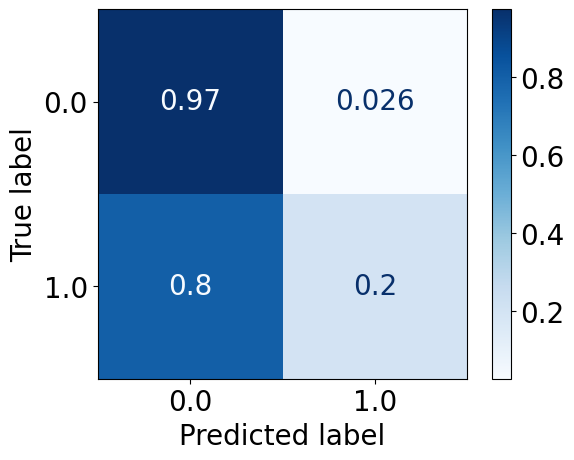

In [ ]:
pred_prob_test_2021_lr_2019_17_15 = lr_2019_17_15.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_2019_17_15 = lr_2019_17_15.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_2019_17_15))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_2019_17_15))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_2019_17_15,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_2019_17_15,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_lr_2019_17_15, pred_prob_test_2021_lr_2019_17_15)

Class 1 Recall: 0.1998037933289732
Class 1 Precision: 0.580522565320665
Class 1 Area Under Precision-Recall Curve: 0.44836588313497766
Class 1 F1-Score: 0.2972874346186595
Class 0 Recall: 0.9739620193441849
Class 0 Precision: 0.8709490282941751
Class 0 Area Under Precision-Recall Curve: 0.7156990085382033
Class 0 F1-Score: 0.9195795921208325
Overall Accuracy: 0.8556760267812531
Balanced Accuracy: 0.586882906336579
Area Under ROC Curve: 0.8225400450726081
Matthews Correlation Coefficient: 0.28008985765880295
0.1998037933289732
0.580522565320665
0.44836588313497766
0.2972874346186595
0.9739620193441849
0.8709490282941751
0.7156990085382033
0.9195795921208325
0.8556760267812531
0.586882906336579
0.8225400450726081
0.28008985765880295


### Test on 2019

accuracy 0.8537048014226437
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     35675
         1.0       0.57      0.22      0.31      6500

    accuracy                           0.85     42175
   macro avg       0.72      0.59      0.61     42175
weighted avg       0.82      0.85      0.82     42175



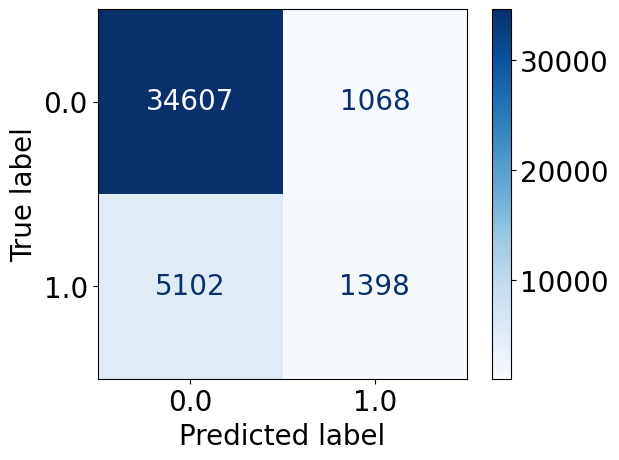

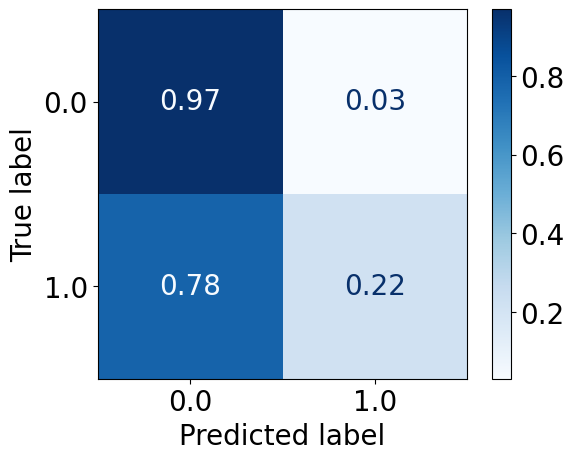

In [ ]:
pred_prob_test_2019_lr_2019_17_15 = lr_2019_17_15.predict_proba(X_test_2019)[:, 1]
pred_test_2019_lr_2019_17_15 = lr_2019_17_15.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_lr_2019_17_15))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_lr_2019_17_15))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_2019_17_15,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_2019_17_15,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_lr_2019_17_15, pred_prob_test_2019_lr_2019_17_15)

Class 1 Recall: 0.21507692307692308
Class 1 Precision: 0.5669099756690997
Class 1 Area Under Precision-Recall Curve: 0.45311809008581966
Class 1 F1-Score: 0.311844746821325
Class 0 Recall: 0.9700630693763139
Class 0 Precision: 0.8715152736155531
Class 0 Area Under Precision-Recall Curve: 0.7134529650411126
Class 0 F1-Score: 0.9181523930807598
Overall Accuracy: 0.8537048014226437
Balanced Accuracy: 0.5925699962266185
Area Under ROC Curve: 0.8230536661096437
Matthews Correlation Coefficient: 0.2849035755196294
0.21507692307692308
0.5669099756690997
0.45311809008581966
0.311844746821325
0.9700630693763139
0.8715152736155531
0.7134529650411126
0.9181523930807598
0.8537048014226437
0.5925699962266185
0.8230536661096437
0.2849035755196294


### Test on 2017

accuracy 0.8568638978709109
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     40340
         1.0       0.59      0.21      0.31      7286

    accuracy                           0.86     47626
   macro avg       0.73      0.59      0.62     47626
weighted avg       0.83      0.86      0.83     47626



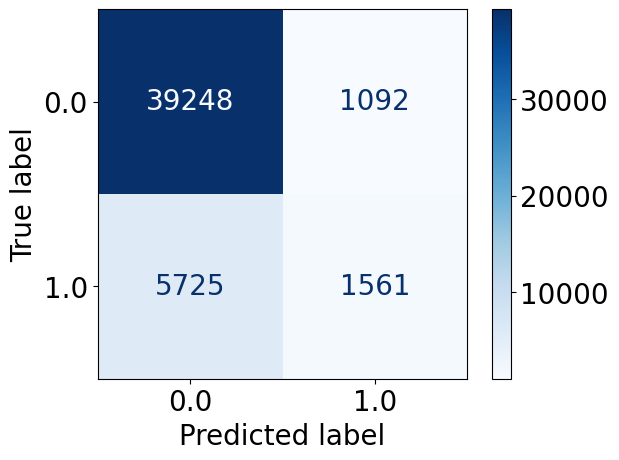

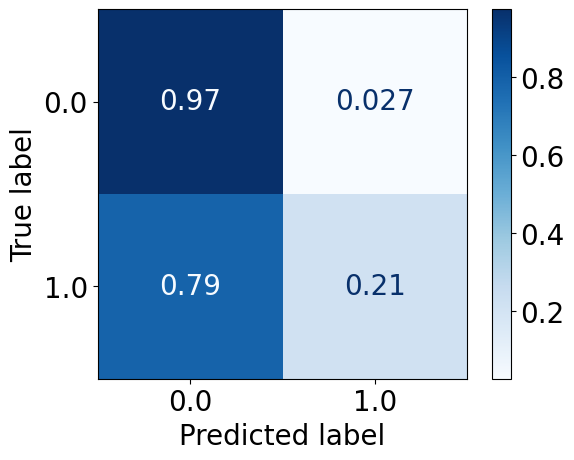

In [ ]:
pred_prob_test_2017_lr_2019_17_15 = lr_2019_17_15.predict_proba(X_test_2017)[:, 1]
pred_test_2017_lr_2019_17_15 = lr_2019_17_15.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_lr_2019_17_15))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_lr_2019_17_15))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_2019_17_15,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_2019_17_15,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_lr_2019_17_15, pred_prob_test_2017_lr_2019_17_15)

Class 1 Recall: 0.21424650013724952
Class 1 Precision: 0.5883905013192612
Class 1 Area Under Precision-Recall Curve: 0.4618387411369352
Class 1 F1-Score: 0.3141161082603884
Class 0 Recall: 0.9729300941993059
Class 0 Precision: 0.872701398616948
Class 0 Area Under Precision-Recall Curve: 0.7127150173927715
Class 0 F1-Score: 0.9200942412059123
Overall Accuracy: 0.8568638978709109
Balanced Accuracy: 0.5935882971682777
Area Under ROC Curve: 0.8291400004300531
Matthews Correlation Coefficient: 0.29377816717079475
0.21424650013724952
0.5883905013192612
0.4618387411369352
0.3141161082603884
0.9729300941993059
0.872701398616948
0.7127150173927715
0.9200942412059123
0.8568638978709109
0.5935882971682777
0.8291400004300531
0.29377816717079475


### Test on 2015

accuracy 0.8565724397658696
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     37411
         1.0       0.57      0.20      0.30      6667

    accuracy                           0.86     44078
   macro avg       0.72      0.59      0.61     44078
weighted avg       0.83      0.86      0.83     44078



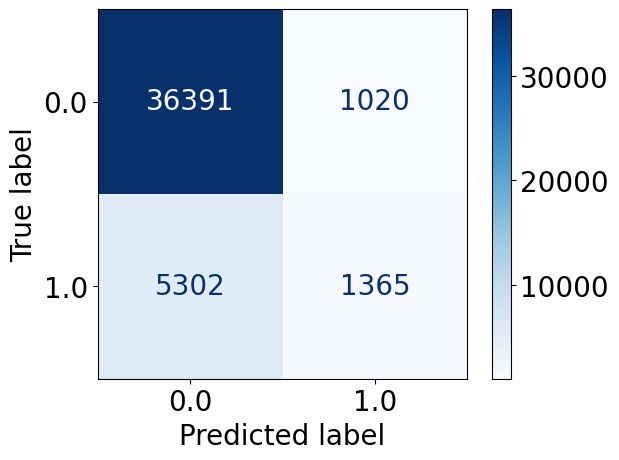

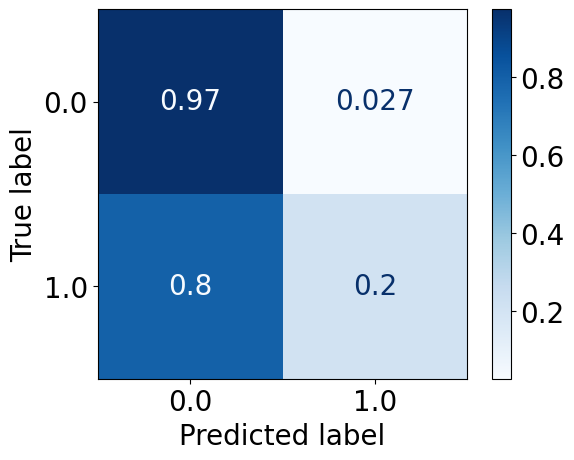

In [ ]:
pred_prob_test_2015_lr_2019_17_15 = lr_2019_17_15.predict_proba(X_test_2015)[:, 1]
pred_test_2015_lr_2019_17_15 = lr_2019_17_15.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_lr_2019_17_15))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_lr_2019_17_15))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_lr_2019_17_15,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_lr_2019_17_15,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_lr_2019_17_15, pred_prob_test_2015_lr_2019_17_15)

Class 1 Recall: 0.2047397630118494
Class 1 Precision: 0.5723270440251572
Class 1 Area Under Precision-Recall Curve: 0.45105708399634226
Class 1 F1-Score: 0.30159080866106935
Class 0 Recall: 0.9727352917591083
Class 0 Precision: 0.8728323699421965
Class 0 Area Under Precision-Recall Curve: 0.7169045786716716
Class 0 F1-Score: 0.9200798948220065
Overall Accuracy: 0.8565724397658696
Balanced Accuracy: 0.5887375273854789
Area Under ROC Curve: 0.8255171534812904
Matthews Correlation Coefficient: 0.2810777319099888
0.2047397630118494
0.5723270440251572
0.45105708399634226
0.30159080866106935
0.9727352917591083
0.8728323699421965
0.7169045786716716
0.9200798948220065
0.8565724397658696
0.5887375273854789
0.8255171534812904
0.2810777319099888


## Train with balanced (Undersampling) dataset

### Create balanced (undersampled) dataset

In [ ]:
#Separate the 0(No Diabetes) and 1(Diabetes)
#Get the 1s
is1 = df_train_2019_17_15['Diabetes'] == 1
brfss_2019_17_15_1 = df_train_2019_17_15[is1]
print(brfss_2019_17_15_1.shape)

is0 = df_train_2019_17_15['Diabetes'] == 0
brfss_2019_17_15_0 = df_train_2019_17_15[is0]
print(brfss_2019_17_15_0.shape)

brfss_2019_17_15_0_rand = brfss_2019_17_15_0.take(np.random.permutation(len(brfss_2019_17_15_0))[:brfss_2019_17_15_1.shape[0]])
print(brfss_2019_17_15_0_rand.shape)

#Append the 39977 1s to the 39977 randomly selected 0s
df_train_2019_17_15_balanced = brfss_2019_17_15_0_rand.append(brfss_2019_17_15_1, ignore_index = True)

#See the classes are perfectly balanced now
print(df_train_2019_17_15_balanced.groupby(['Diabetes']).size())

X_train_2019_17_15_balanced = df_train_2019_17_15_balanced.drop(['Diabetes', 'Race'],axis=1)
y_train_2019_17_15_balanced = df_train_2019_17_15_balanced['Diabetes']
print(X_train_2019_17_15_balanced.shape, X_test_2019_17_15.shape)

(81275, 50)
(454240, 50)
(81275, 50)
Diabetes
0.0    81275
1.0    81275
dtype: int64


<ipython-input-36-8e60e6a99a4f>:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_train_2019_17_15_balanced = brfss_2019_17_15_0_rand.append(brfss_2019_17_15_1, ignore_index = True)


(162550, 48) (133879, 48)


### Train and test on 2019, 2017, 2015 combinedly

accuracy 0.7341554687441645
              precision    recall  f1-score   support

         0.0       0.95      0.73      0.82    113681
         1.0       0.33      0.77      0.47     20198

    accuracy                           0.73    133879
   macro avg       0.64      0.75      0.64    133879
weighted avg       0.85      0.73      0.77    133879



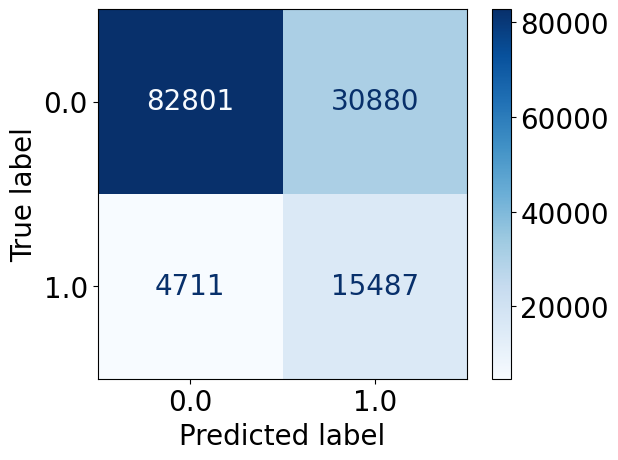

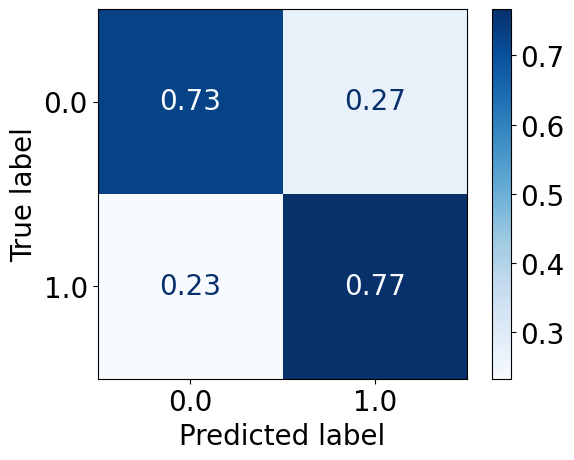

In [ ]:
lr_2019_17_15_balanced = LogisticRegression(solver='liblinear')
lr_2019_17_15_balanced.fit(X_train_2019_17_15_balanced, y_train_2019_17_15_balanced)

pred_prob_test_2019_17_15_lr_balanced = lr_2019_17_15_balanced.predict_proba(X_test_2019_17_15)[:, 1]
pred_test_2019_17_15_lr_balanced = lr_2019_17_15_balanced.predict(X_test_2019_17_15)

print("accuracy", accuracy_score(y_test_2019_17_15, pred_test_2019_17_15_lr_balanced))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019_17_15, pred_test_2019_17_15_lr_balanced))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019_17_15, pred_test_2019_17_15_lr_balanced,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019_17_15, pred_test_2019_17_15_lr_balanced,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019_17_15, pred_test_2019_17_15_lr_balanced, pred_prob_test_2019_17_15_lr_balanced)

Class 1 Recall: 0.7667590850579266
Class 1 Precision: 0.3340091013004939
Class 1 Area Under Precision-Recall Curve: 0.4484830457027431
Class 1 F1-Score: 0.4653196124089236
Class 0 Recall: 0.7283626991317811
Class 0 Precision: 0.946167382758936
Class 0 Area Under Precision-Recall Curve: 0.7176241609839873
Class 0 F1-Score: 0.8231002072636722
Overall Accuracy: 0.7341554687441645
Balanced Accuracy: 0.7475608920948538
Area Under ROC Curve: 0.8256623065417028
Matthews Correlation Coefficient: 0.3724533268417723
0.7667590850579266
0.3340091013004939
0.4484830457027431
0.4653196124089236
0.7283626991317811
0.946167382758936
0.7176241609839873
0.8231002072636722
0.7341554687441645
0.7475608920948538
0.8256623065417028
0.3724533268417723


### Test on 2021

accuracy 0.7378085340261816
              precision    recall  f1-score   support

         0.0       0.94      0.73      0.83     33912
         1.0       0.34      0.76      0.47      6116

    accuracy                           0.74     40028
   macro avg       0.64      0.75      0.65     40028
weighted avg       0.85      0.74      0.77     40028



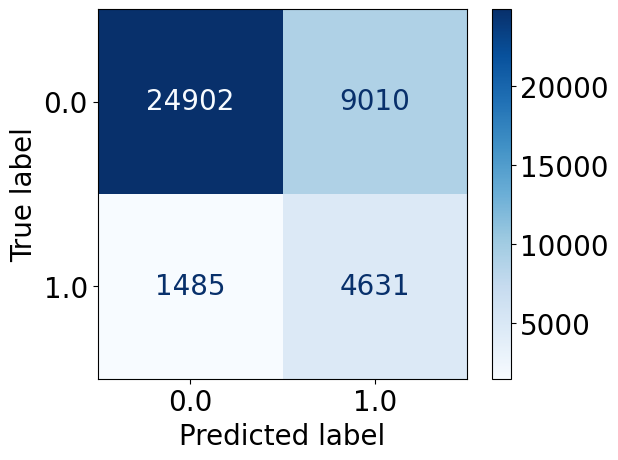

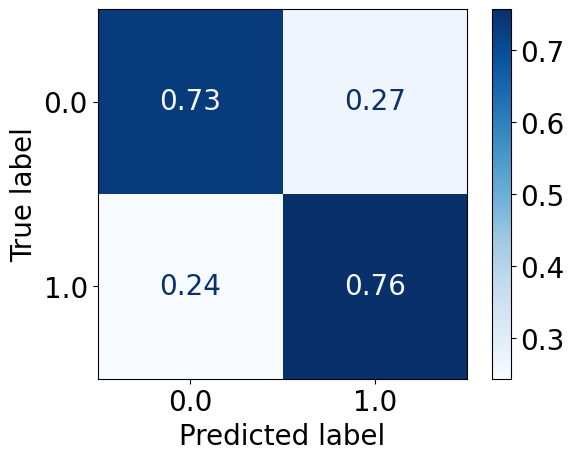

In [ ]:
lr_2019_17_15_balanced = LogisticRegression(solver='liblinear')
lr_2019_17_15_balanced.fit(X_train_2019_17_15_balanced, y_train_2019_17_15_balanced)

pred_prob_test_2021_lr_2019_17_15_balanced = lr_2019_17_15_balanced.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_2019_17_15_balanced = lr_2019_17_15_balanced.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_2019_17_15_balanced))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr_2019_17_15_balanced))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_2019_17_15_balanced,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2021, pred_test_2021_lr_2019_17_15_balanced,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2021, pred_test_2021_lr_2019_17_15_balanced, pred_prob_test_2021_lr_2019_17_15_balanced)

Class 1 Recall: 0.7571942446043165
Class 1 Precision: 0.3394912396451873
Class 1 Area Under Precision-Recall Curve: 0.44655844506677805
Class 1 F1-Score: 0.46879586981829224
Class 0 Recall: 0.7343123378155225
Class 0 Precision: 0.9437222874900519
Class 0 Area Under Precision-Recall Curve: 0.7158844729793931
Class 0 F1-Score: 0.8259506791157398
Overall Accuracy: 0.7378085340261816
Balanced Accuracy: 0.7457532912099195
Area Under ROC Curve: 0.8227282365383509
Matthews Correlation Coefficient: 0.37309692147927165
0.7571942446043165
0.3394912396451873
0.44655844506677805
0.46879586981829224
0.7343123378155225
0.9437222874900519
0.7158844729793931
0.8259506791157398
0.7378085340261816
0.7457532912099195
0.8227282365383509
0.37309692147927165


### Test on 2019

accuracy 0.7292234736218138
              precision    recall  f1-score   support

         0.0       0.95      0.72      0.82     35675
         1.0       0.34      0.77      0.47      6500

    accuracy                           0.73     42175
   macro avg       0.64      0.75      0.64     42175
weighted avg       0.85      0.73      0.76     42175



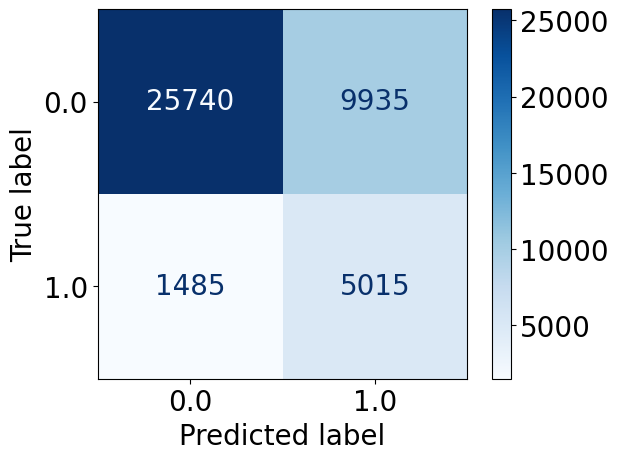

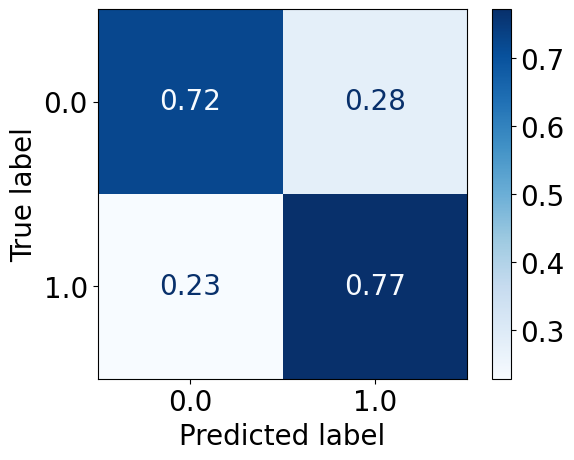

In [ ]:
lr_2019_17_15_balanced = LogisticRegression(solver='liblinear')
lr_2019_17_15_balanced.fit(X_train_2019_17_15_balanced, y_train_2019_17_15_balanced)

pred_prob_test_2019_lr_2019_17_15_balanced = lr_2019_17_15_balanced.predict_proba(X_test_2019)[:, 1]
pred_test_2019_lr_2019_17_15_balanced = lr_2019_17_15_balanced.predict(X_test_2019)

print("accuracy", accuracy_score(y_test_2019, pred_test_2019_lr_2019_17_15_balanced))

from sklearn.metrics import classification_report
print(classification_report(y_test_2019, pred_test_2019_lr_2019_17_15_balanced))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_2019_17_15_balanced,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2019, pred_test_2019_lr_2019_17_15_balanced,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2019, pred_test_2019_lr_2019_17_15_balanced, pred_prob_test_2019_lr_2019_17_15_balanced)

Class 1 Recall: 0.7715384615384615
Class 1 Precision: 0.3354515050167224
Class 1 Area Under Precision-Recall Curve: 0.4513413543143402
Class 1 F1-Score: 0.46759906759906755
Class 0 Recall: 0.7215136650315347
Class 0 Precision: 0.9454545454545454
Class 0 Area Under Precision-Recall Curve: 0.7136028182947657
Class 0 F1-Score: 0.8184419713831479
Overall Accuracy: 0.7292234736218138
Balanced Accuracy: 0.7465260632849982
Area Under ROC Curve: 0.8233700609131582
Matthews Correlation Coefficient: 0.3721576622229311
0.7715384615384615
0.3354515050167224
0.4513413543143402
0.46759906759906755
0.7215136650315347
0.9454545454545454
0.7136028182947657
0.8184419713831479
0.7292234736218138
0.7465260632849982
0.8233700609131582
0.3721576622229311


### Test on 2017

accuracy 0.740414899424684
              precision    recall  f1-score   support

         0.0       0.95      0.74      0.83     40340
         1.0       0.34      0.77      0.48      7286

    accuracy                           0.74     47626
   macro avg       0.65      0.75      0.65     47626
weighted avg       0.85      0.74      0.77     47626



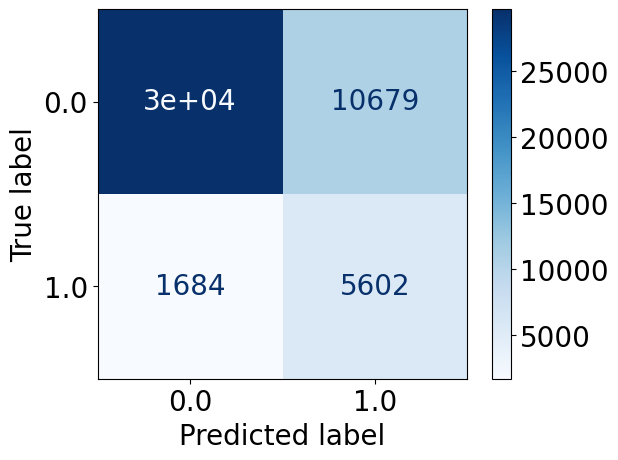

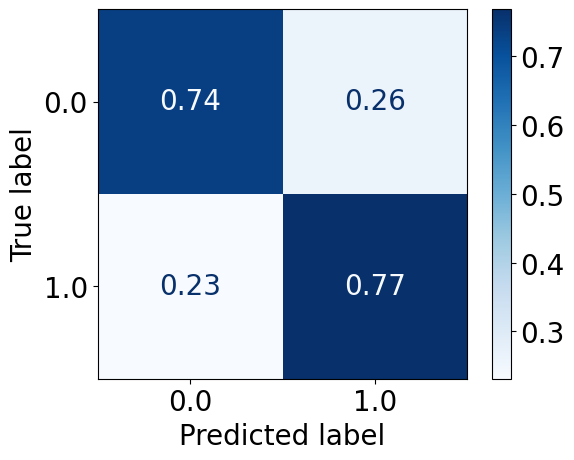

In [ ]:
lr_2019_17_15_balanced = LogisticRegression(solver='liblinear')
lr_2019_17_15_balanced.fit(X_train_2019_17_15_balanced, y_train_2019_17_15_balanced)

pred_prob_test_2017_lr_2019_17_15_balanced = lr_2019_17_15_balanced.predict_proba(X_test_2017)[:, 1]
pred_test_2017_lr_2019_17_15_balanced = lr_2019_17_15_balanced.predict(X_test_2017)

print("accuracy", accuracy_score(y_test_2017, pred_test_2017_lr_2019_17_15_balanced))

from sklearn.metrics import classification_report
print(classification_report(y_test_2017, pred_test_2017_lr_2019_17_15_balanced))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_2019_17_15_balanced,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2017, pred_test_2017_lr_2019_17_15_balanced,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2017, pred_test_2017_lr_2019_17_15_balanced, pred_prob_test_2017_lr_2019_17_15_balanced)

Class 1 Recall: 0.7688718089486687
Class 1 Precision: 0.3440820588415945
Class 1 Area Under Precision-Recall Curve: 0.4599139546748426
Class 1 F1-Score: 0.4754105316756481
Class 0 Recall: 0.7352751611303917
Class 0 Precision: 0.9462753230180252
Class 0 Area Under Precision-Recall Curve: 0.7128945108356023
Class 0 F1-Score: 0.8275371416614354
Overall Accuracy: 0.740414899424684
Balanced Accuracy: 0.7520734850395302
Area Under ROC Curve: 0.8293552821195518
Matthews Correlation Coefficient: 0.38260004483091214
0.7688718089486687
0.3440820588415945
0.4599139546748426
0.4754105316756481
0.7352751611303917
0.9462753230180252
0.7128945108356023
0.8275371416614354
0.740414899424684
0.7520734850395302
0.8293552821195518
0.38260004483091214


### Test on 2015

accuracy 0.7398702300467354
              precision    recall  f1-score   support

         0.0       0.95      0.74      0.83     37411
         1.0       0.34      0.76      0.47      6667

    accuracy                           0.74     44078
   macro avg       0.64      0.75      0.65     44078
weighted avg       0.85      0.74      0.77     44078



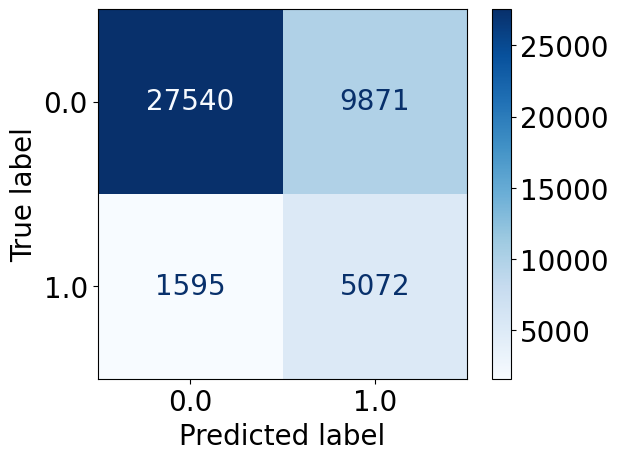

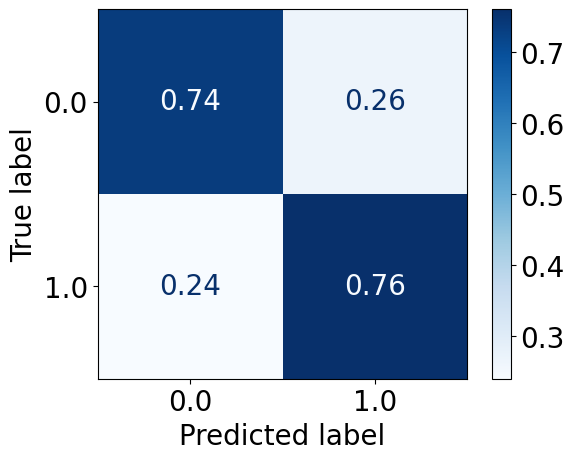

In [ ]:
lr_2019_17_15_balanced = LogisticRegression(solver='liblinear')
lr_2019_17_15_balanced.fit(X_train_2019_17_15_balanced, y_train_2019_17_15_balanced)

pred_prob_test_2015_lr_2019_17_15_balanced = lr_2019_17_15_balanced.predict_proba(X_test_2015)[:, 1]
pred_test_2015_lr_2019_17_15_balanced = lr_2019_17_15_balanced.predict(X_test_2015)

print("accuracy", accuracy_score(y_test_2015, pred_test_2015_lr_2019_17_15_balanced))

from sklearn.metrics import classification_report
print(classification_report(y_test_2015, pred_test_2015_lr_2019_17_15_balanced))

plt.rcParams['font.size'] = 20

ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_lr_2019_17_15_balanced,cmap=plt.cm.Blues)
ConfusionMatrixDisplay.from_predictions(y_test_2015, pred_test_2015_lr_2019_17_15_balanced,cmap=plt.cm.Blues, normalize="true")

In [ ]:
performace_metrix(y_test_2015, pred_test_2015_lr_2019_17_15_balanced, pred_prob_test_2015_lr_2019_17_15_balanced)

Class 1 Recall: 0.7607619619019049
Class 1 Precision: 0.33942314127015993
Class 1 Area Under Precision-Recall Curve: 0.44894411653249755
Class 1 F1-Score: 0.4694123091161499
Class 0 Recall: 0.7361471225040763
Class 0 Precision: 0.9452548481208168
Class 0 Area Under Precision-Recall Curve: 0.7171804437486408
Class 0 F1-Score: 0.8276981336218556
Overall Accuracy: 0.7398702300467354
Balanced Accuracy: 0.7484545422029907
Area Under ROC Curve: 0.8253833946991805
Matthews Correlation Coefficient: 0.376110461246169
0.7607619619019049
0.33942314127015993
0.44894411653249755
0.4694123091161499
0.7361471225040763
0.9452548481208168
0.7171804437486408
0.8276981336218556
0.7398702300467354
0.7484545422029907
0.8253833946991805
0.376110461246169


# Feature Importance

## Train on 2021 (Imbalanced)

In [ ]:
lr_2021 = LogisticRegression(solver='liblinear')
lr_2021.fit(X_train_2021, y_train_2021)

pred_prob_test_2021_lr = lr_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr = lr_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr))

from sklearn.metrics import classification_report
print(classification_report(y_test_2021, pred_test_2021_lr))

accuracy 0.8558259218547017
              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     33912
         1.0       0.58      0.21      0.30      6116

    accuracy                           0.86     40028
   macro avg       0.73      0.59      0.61     40028
weighted avg       0.83      0.86      0.83     40028



In [ ]:
feature_importance_2021 = {}
for feature, importance in zip(X_train_2021.columns.to_list(), lr_2021.coef_[0]):
    print(f"{feature}: {importance}")
    feature_importance_2021[feature] = importance

Blood pressure: 0.6744105674059406
Cholesterol: 0.5513133656892957
BMI category: 0.5365479573173915
Stroke: 0.10695381835179549
Heart disease: 0.26416091284564247
Consume fruits: -0.04101763175699941
Consume vegitables: 0.013694572687583046
Alcoholic: -0.4658873399660836
Health insurance: 0.004951482818959693
Unaffordable healthcare: 0.04681261454791388
General health: 0.46188247301965807
Mental health: -0.02361284712837076
Physical health: -0.03689754317246505
Difficulty walking: 0.07556521059907154
Sex: -0.29264849753091504
Age: 0.11142405405617538
Education: -0.010505609379131012
Income: -0.02893719877181773
Routine checkup: -0.4061371867757926
Flu shot: 0.18359811206616325
Kidney disease: 0.5960445949455168
Depressive disorder: 0.06837379768019358
Own home: -0.06403470704884792
Exercise: -0.19157711672991096
Difficulty seeing: 0.18414483762192208
Difficulty concentrating: -0.05458371365455407
Race_American Indian: -0.16252112996758486
Race_Asian: -0.22292645170830322
Race_Black: -0

In [ ]:
feature_importance_2021 = {}
for feature, importance in zip(X_train_2021.columns.to_list(), lr_2021.coef_[0]):
    print(feature)
for feature, importance in zip(X_train_2021.columns.to_list(), lr_2021.coef_[0]):
    print(importance)

Blood pressure
Cholesterol
BMI category
Stroke
Heart disease
Consume fruits
Consume vegitables
Alcoholic
Health insurance
Unaffordable healthcare
General health
Mental health
Physical health
Difficulty walking
Sex
Age
Education
Income
Routine checkup
Flu shot
Kidney disease
Depressive disorder
Own home
Exercise
Difficulty seeing
Difficulty concentrating
Race_American Indian
Race_Asian
Race_Black
Race_Hispanic
Race_Multiracial
Race_Native Hawaiian
Race_Other race
Race_White
Employment status_Employed
Employment status_Homemaker
Employment status_No work < 1 y
Employment status_No work > 1 y
Employment status_Retired
Employment status_Self-employed
Employment status_Student
Employment status_Unable to work
Marital status_Divorced
Marital status_Married
Marital status_Never married
Marital status_Separated
Marital status_Unmarried couple
Marital status_Widowed
0.6744105674059406
0.5513133656892957
0.5365479573173915
0.10695381835179549
0.26416091284564247
-0.04101763175699941
0.0136945726

## Train on balanced 2021 dataset

In [ ]:
lr_balanced_2021 = LogisticRegression(solver='liblinear')
lr_balanced_2021.fit(X_train_2021_balanced, y_train_2021_balanced)

pred_prob_test_2021_lr_balanced_2021 = lr_balanced_2021.predict_proba(X_test_2021)[:, 1]
pred_test_2021_lr_balanced_2021 = lr_balanced_2021.predict(X_test_2021)

print("accuracy", accuracy_score(y_test_2021, pred_test_2021_lr_balanced_2021))
print(classification_report(y_test_2021, pred_test_2021_lr_balanced_2021))

accuracy 0.7332367342859998
              precision    recall  f1-score   support

         0.0       0.94      0.73      0.82     33912
         1.0       0.34      0.76      0.47      6116

    accuracy                           0.73     40028
   macro avg       0.64      0.75      0.64     40028
weighted avg       0.85      0.73      0.77     40028



In [ ]:
feature_importance_2021_balanced = {}
for feature, importance in zip(X_train_2021_balanced.columns.to_list(), lr_balanced_2021.coef_[0]):
    print(f"{feature}: {importance}")
    feature_importance_2021_balanced[feature] = importance

Blood pressure: 0.6664950711373897
Cholesterol: 0.5692297529655252
BMI category: 0.5458911394495213
Stroke: 0.14655838861873288
Heart disease: 0.275736385263974
Consume fruits: -0.03894198046401055
Consume vegitables: 0.04388333536831669
Alcoholic: -0.4753886662030416
Health insurance: -0.1114476645629351
Unaffordable healthcare: 0.061583524408414525
General health: 0.50198176877115
Mental health: -0.021745532013797142
Physical health: -0.027335450790229844
Difficulty walking: 0.0510617529017359
Sex: -0.31822811694830205
Age: 0.14436304038401188
Education: -0.01811435697710108
Income: -0.03420930233752063
Routine checkup: -0.40128942208149865
Flu shot: 0.17394515118227258
Kidney disease: 0.6356839188643623
Depressive disorder: 0.10314557877990767
Own home: -0.031583645055106434
Exercise: -0.20641779075342154
Difficulty seeing: 0.2380003430560299
Difficulty concentrating: -0.08448488003138449
Race_American Indian: -0.08971253651820757
Race_Asian: -0.06969315662850706
Race_Black: -0.1839

In [ ]:
feature_importance_2021_balanced = {}
for feature, importance in zip(X_train_2021_balanced.columns.to_list(), lr_balanced_2021.coef_[0]):
    print(feature)
for feature, importance in zip(X_train_2021_balanced.columns.to_list(), lr_balanced_2021.coef_[0]):
    print(importance)

Blood pressure
Cholesterol
BMI category
Stroke
Heart disease
Consume fruits
Consume vegitables
Alcoholic
Health insurance
Unaffordable healthcare
General health
Mental health
Physical health
Difficulty walking
Sex
Age
Education
Income
Routine checkup
Flu shot
Kidney disease
Depressive disorder
Own home
Exercise
Difficulty seeing
Difficulty concentrating
Race_American Indian
Race_Asian
Race_Black
Race_Hispanic
Race_Multiracial
Race_Native Hawaiian
Race_Other race
Race_White
Employment status_Employed
Employment status_Homemaker
Employment status_No work < 1 y
Employment status_No work > 1 y
Employment status_Retired
Employment status_Self-employed
Employment status_Student
Employment status_Unable to work
Marital status_Divorced
Marital status_Married
Marital status_Never married
Marital status_Separated
Marital status_Unmarried couple
Marital status_Widowed
0.6674699811480668
0.5554948765056231
0.5395281967370507
0.18377351472862777
0.251373825479409
-0.03746882534026504
-0.02542085581

In [ ]:

# Create a dataframe using the lists
feature_importance_2021_balanced_df = pd.DataFrame({'FI-2021-balanced': feature_importance_2021_balanced.values()}, index=feature_importance_2021_balanced.keys())

# Display the dataframe
feature_importance_2021_balanced_df


,FI-2021-balanced
Blood pressure,0.666495
Cholesterol,0.569230
BMI category,0.545891
Stroke,0.146558
Heart disease,0.275736
Consume fruits,-0.038942
Consume vegitables,0.043883
Alcoholic,-0.475389
Health insurance,-0.111448
Unaffordable healthcare,0.061584


In [ ]:

# Create a dataframe using the lists
feature_importance_2021_df = pd.DataFrame({'FI-2021-imbalanced': feature_importance_2021.values()}, index=feature_importance_2021.keys())

# Display the dataframe
feature_importance_2021_df


,FI-2021-imbalanced
Blood pressure,0.674411
Cholesterol,0.551313
BMI category,0.536548
Stroke,0.106954
Heart disease,0.264161
Consume fruits,-0.041018
Consume vegitables,0.013695
Alcoholic,-0.465887
Health insurance,0.004951
Unaffordable healthcare,0.046813


In [ ]:
df = pd.concat([feature_importance_2021_balanced_df, feature_importance_2021_df], axis=1)
df

,FI-2021-balanced,FI-2021-imbalanced
Blood pressure,0.666495,0.674411
Cholesterol,0.569230,0.551313
BMI category,0.545891,0.536548
Stroke,0.146558,0.106954
Heart disease,0.275736,0.264161
Consume fruits,-0.038942,-0.041018
Consume vegitables,0.043883,0.013695
Alcoholic,-0.475389,-0.465887
Health insurance,-0.111448,0.004951
Unaffordable healthcare,0.061584,0.046813


import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(df, *['FI-2021-balanced'], **{})
chart

import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(df, *['FI-2021-imbalanced'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(df, *['FI-2021-balanced'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(df, *['FI-2021-imbalanced'], **{})
chart

import numpy as np
from google.colab import autoviz

def scatter_plots(df, colname_pairs, figscale=1, alpha=.8):
  from matplotlib import pyplot as plt
  plt.figure(figsize=(len(colname_pairs) * 6 * figscale, 6 * figscale))
  for plot_i, (x_colname, y_colname) in enumerate(colname_pairs, start=1):
    ax = plt.subplot(1, len(colname_pairs), plot_i)
    df.plot(kind='scatter', x=x_colname, y=y_colname, s=(32 * figscale), alpha=alpha, ax=ax)
    ax.spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = scatter_plots(df, *[[['FI-2021-balanced', 'FI-2021-imbalanced']]], **{})
chart

<Axes: >

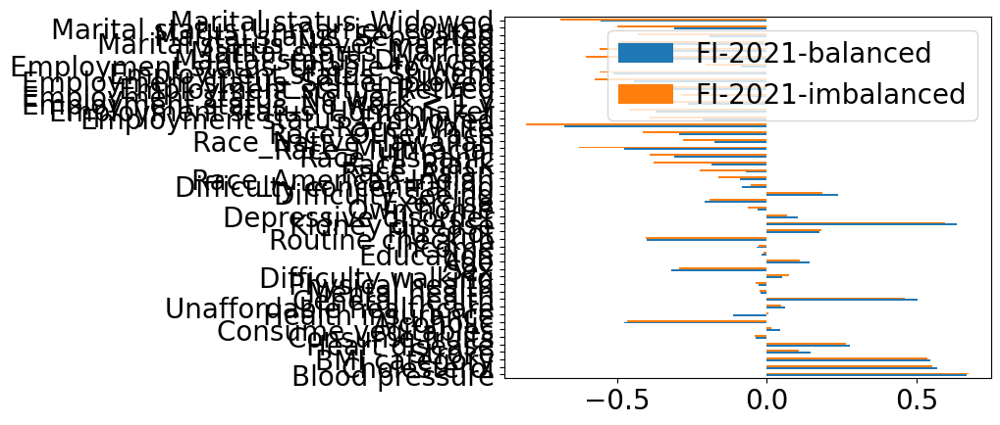

In [ ]:
df.plot.barh()

In [ ]:
feature_importance = pd.read_csv('../ML4H - Diabetes BRFSS 2021 - Feature Importance - LR.csv')
feature_importance

,Features,LR - Balanced (undersampled) (2021),LR - Imbalanced (2021)
0,Blood pressure,0.667470,0.674411
1,Kidney disease,0.607233,0.596045
2,Cholesterol,0.555495,0.551313
3,BMI category,0.539528,0.536548
4,General health,0.509590,0.461882
5,Heart disease,0.251374,0.264161
6,Difficulty seeing,0.233664,0.184145
7,Flu shot,0.204564,0.183598
8,Stroke,0.183774,0.106954
9,Age,0.139380,0.111424


In [ ]:
feature_importance.iloc[0]['LR - Balanced (undersampled) (2021)']

0.6674699811

In [ ]:
features_list = feature_importance['Features'].to_list()
features_list

In [ ]:
feature_imp_bal = {}
feature_imp_imbal = {}

for i in range(len(features_list)):
  f = features_list[i]
  if '_' in f:
    temp = f.split("_")[0]

    if temp in feature_imp_bal:
      feature_imp_bal[temp] += feature_importance.iloc[i]['LR - Balanced (undersampled) (2021)']
      feature_imp_imbal[temp] += feature_importance.iloc[i]['LR - Imbalanced (2021)']
    else:
      feature_imp_bal[temp] = float(feature_importance.iloc[i]['LR - Balanced (undersampled) (2021)'])
      feature_imp_imbal[temp] = float(feature_importance.iloc[i]['LR - Imbalanced (2021)'])
  else:
    temp = f
    if temp in feature_imp_bal:
      feature_imp_bal[temp] += feature_importance.iloc[i]['LR - Balanced (undersampled) (2021)']
      feature_imp_imbal[temp] += feature_importance.iloc[i]['LR - Imbalanced (2021)']
    else:
      feature_imp_bal[temp] = float(feature_importance.iloc[i]['LR - Balanced (undersampled) (2021)'])
      feature_imp_imbal[temp] = float(feature_importance.iloc[i]['LR - Imbalanced (2021)'])
feature_imp_bal, feature_imp_imbal

In [ ]:
feature_importance_2021_LR = pd.DataFrame({
    'features': feature_imp_bal.keys(),
    'Balanced - LR': feature_imp_bal.values(),
    'Imbalanced - LR': feature_imp_imbal.values(),
}
)

feature_importance_2021_LR

In [ ]:
df = feature_importance_2021_LR.copy()
df = df.sort_values('Balanced - LR', ascending=False)
df

In [ ]:
import seaborn as sns

# Generate some sequential data
x = np.array(list("ABCDEFGHIJ"))
y1 = np.arange(1, 11)
y1 = y1 - 5.5
sns.barplot(x=x, y=y1, palette="deep")


In [ ]:
x = df['features']
y = df['Balanced - LR']

sns.barplot(x=x, y=y, palette="deep")
plt.xticks(rotation=45)


### Average Feature Importance - Balanced LR

In [ ]:
one_hot_feature_list = []

for i in range(len(features_list)):
  f = features_list[i]
  if '_' in f:
    temp = f.split("_")[0]
    one_hot_feature_list.append(temp)
one_hot_feature_list = set(one_hot_feature_list)
one_hot_feature_list

{'Employment status', 'Marital status', 'Race'}

In [ ]:
Employment_status_imp = 0
count = 0

for i in range(len(features_list)):
  f = features_list[i]
  if '_' in f:
    temp = f.split("_")[0]
    if temp == 'Employment status':
      Employment_status_imp += feature_importance.iloc[i]['LR - Balanced (undersampled) (2021)']
      count += 1
Employment_status_imp/count

-0.28201314445625003

In [ ]:
Marital_status_imp = 0
count = 0

for i in range(len(features_list)):
  f = features_list[i]
  if '_' in f:
    temp = f.split("_")[0]
    if temp == 'Marital status':
      print(f, feature_importance.iloc[i]['LR - Balanced (undersampled) (2021)'])
      Marital_status_imp += feature_importance.iloc[i]['LR - Balanced (undersampled) (2021)']
      count += 1
Marital_status_imp/count

Marital status_Separated -0.1742148709
Marital status_Never married -0.3580021965
Marital status_Unmarried couple -0.3668157106
Marital status_Married -0.3951790954
Marital status_Divorced -0.4156031524
Marital status_Widowed -0.54629013


-0.3760175259666667

In [ ]:
Race = 0
count = 0

for i in range(len(features_list)):
  f = features_list[i]
  if '_' in f:
    temp = f.split("_")[0]
    if temp == 'Race':
      Race += feature_importance.iloc[i]['LR - Balanced (undersampled) (2021)']
      count += 1
Race/count

-0.28201314445750003

In [ ]:
feature_imp_bal = {}
feature_imp_imbal = {}

for i in range(len(features_list)):
  f = features_list[i]
  if '_' not in f:
    temp = f
    if temp in feature_imp_bal:
      feature_imp_bal[temp] += feature_importance.iloc[i]['LR - Balanced (undersampled) (2021)']
      feature_imp_imbal[temp] += feature_importance.iloc[i]['LR - Imbalanced (2021)']
    else:
      feature_imp_bal[temp] = float(feature_importance.iloc[i]['LR - Balanced (undersampled) (2021)'])
      feature_imp_imbal[temp] = float(feature_importance.iloc[i]['LR - Imbalanced (2021)'])
feature_imp_bal

{'Blood pressure': 0.6674699811,
 'Kidney disease': 0.6072330414,
 'Cholesterol': 0.5554948765,
 'BMI category': 0.5395281967,
 'General health': 0.5095895249,
 'Heart disease': 0.2513738255,
 'Difficulty seeing': 0.2336636953,
 'Flu shot': 0.2045639877,
 'Stroke': 0.1837735147,
 'Age': 0.1393799388,
 'Unaffordable healthcare': 0.1116065423,
 'Difficulty walking': 0.1082821069,
 'Depressive disorder': 0.05939270173,
 'Education': -0.02141075722,
 'Mental health': -0.02520830722,
 'Consume vegitables': -0.02542085581,
 'Income': -0.03139739171,
 'Own home': -0.03474384479,
 'Consume fruits': -0.03746882534,
 'Physical health': -0.03990484686,
 'Difficulty concentrating': -0.04292785136,
 'Health insurance': -0.09051612698,
 'Exercise': -0.2070094744,
 'Sex': -0.3159192483,
 'Routine checkup': -0.4029502566,
 'Alcoholic': -0.4605760278}

In [ ]:
feature_imp_bal['Race'] = -0.28201314445750003
feature_imp_bal['Marital status'] = -0.3760175259666667
feature_imp_bal['Employment status'] = -0.28201314445625003
feature_imp_bal

{'Blood pressure': 0.6674699811,
 'Kidney disease': 0.6072330414,
 'Cholesterol': 0.5554948765,
 'BMI category': 0.5395281967,
 'General health': 0.5095895249,
 'Heart disease': 0.2513738255,
 'Difficulty seeing': 0.2336636953,
 'Flu shot': 0.2045639877,
 'Stroke': 0.1837735147,
 'Age': 0.1393799388,
 'Unaffordable healthcare': 0.1116065423,
 'Difficulty walking': 0.1082821069,
 'Depressive disorder': 0.05939270173,
 'Education': -0.02141075722,
 'Mental health': -0.02520830722,
 'Consume vegitables': -0.02542085581,
 'Income': -0.03139739171,
 'Own home': -0.03474384479,
 'Consume fruits': -0.03746882534,
 'Physical health': -0.03990484686,
 'Difficulty concentrating': -0.04292785136,
 'Health insurance': -0.09051612698,
 'Exercise': -0.2070094744,
 'Sex': -0.3159192483,
 'Routine checkup': -0.4029502566,
 'Alcoholic': -0.4605760278,
 'Race': -0.28201314445750003,
 'Marital status': -0.3760175259666667,
 'Employment status': -0.28201314445625003}

In [ ]:
df = pd.DataFrame(
    {
        "features": feature_imp_bal.keys(),
        "Balanced - LR": feature_imp_bal.values()
    }
)
df

,features,Balanced - LR
0,Blood pressure,0.667470
1,Kidney disease,0.607233
2,Cholesterol,0.555495
3,BMI category,0.539528
4,General health,0.509590
5,Heart disease,0.251374
6,Difficulty seeing,0.233664
7,Flu shot,0.204564
8,Stroke,0.183774
9,Age,0.139380


In [ ]:
for i in df['features'].to_list():
  print(i)

Blood pressure
Kidney disease
Cholesterol
BMI category
General health
Heart disease
Difficulty seeing
Flu shot
Stroke
Age
Unaffordable healthcare
Difficulty walking
Depressive disorder
Education
Mental health
Consume vegitables
Income
Own home
Consume fruits
Physical health
Difficulty concentrating
Health insurance
Exercise
Sex
Routine checkup
Alcoholic
Race
Marital status
Employment status


In [ ]:
for i in df['Balanced - LR'].to_list():
  print(i)

0.6674699811
0.6072330414
0.5554948765
0.5395281967
0.5095895249
0.2513738255
0.2336636953
0.2045639877
0.1837735147
0.1393799388
0.1116065423
0.1082821069
0.05939270173
-0.02141075722
-0.02520830722
-0.02542085581
-0.03139739171
-0.03474384479
-0.03746882534
-0.03990484686
-0.04292785136
-0.09051612698
-0.2070094744
-0.3159192483
-0.4029502566
-0.4605760278
-0.28201314445750003
-0.3760175259666667
-0.28201314445625003


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28]),
 [Text(0, 0, 'Blood pressure'),
  Text(1, 0, 'Kidney disease'),
  Text(2, 0, 'Cholesterol'),
  Text(3, 0, 'BMI category'),
  Text(4, 0, 'General health'),
  Text(5, 0, 'Heart disease'),
  Text(6, 0, 'Difficulty seeing'),
  Text(7, 0, 'Flu shot'),
  Text(8, 0, 'Stroke'),
  Text(9, 0, 'Age'),
  Text(10, 0, 'Unaffordable healthcare'),
  Text(11, 0, 'Difficulty walking'),
  Text(12, 0, 'Depressive disorder'),
  Text(13, 0, 'Education'),
  Text(14, 0, 'Mental health'),
  Text(15, 0, 'Consume vegitables'),
  Text(16, 0, 'Income'),
  Text(17, 0, 'Own home'),
  Text(18, 0, 'Consume fruits'),
  Text(19, 0, 'Physical health'),
  Text(20, 0, 'Difficulty concentrating'),
  Text(21, 0, 'Health insurance'),
  Text(22, 0, 'Exercise'),
  Text(23, 0, 'Sex'),
  Text(24, 0, 'Routine checkup'),
  Text(25, 0, 'Alcoholic'),
  Text(26, 0, 'Race'),
  Text(27, 0, 'Marital status

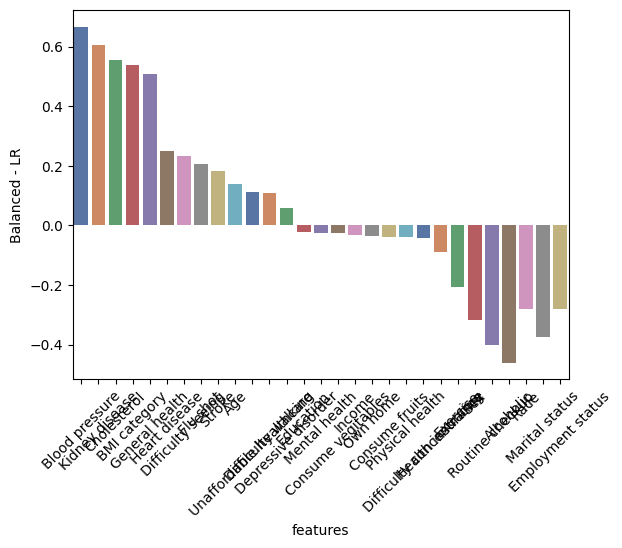

In [ ]:
x = df['features']
y = df['Balanced - LR']

sns.barplot(x=x, y=y, palette="deep")
plt.xticks(rotation=45)

# Temporary

In [5]:
c = 1
for i in range(1, 30, 5):
  print(i, "-", i+4, " days:", c)
  c+=1

1 - 5  days: 1
6 - 10  days: 2
11 - 15  days: 3
16 - 20  days: 4
21 - 25  days: 5
26 - 30  days: 6
